In [37]:
import torch
import numpy as np
from matplotlib import pyplot as plt
import pandas as pd
import os

In [38]:
# TEST_SPLIT = 0.1
# VAL_SPLIT = 0.1
# BATCH_SIZE = 16
# NUM_BLOCKS=7
# HIDDEN_CHANNELS = 120
# LEARNING_RATE = 0.001
# # attention = 'soft_attention_NEW'
# # attention = 'NO_ATTENTION_NEW'
# data_augmentation = True

In [39]:
TEST_SPLIT = 0.1
BATCH_SIZE = 16
HIDDEN_CHANNELS = 64
LEARNING_RATE = 0.001
architecture = '1D_CNN_LSTM'
WEIGHT_DECAY = 0.005
LR_PATIENCE = 5
LR_DROP_FACTOR = 0.1

In [40]:
# Mount Google Drive
from google.colab import drive
import os

drive.mount('/content/gdrive')
# Define base folder path
base_path = '/content/gdrive/MyDrive/yoga_proj'
!ls /content/gdrive/MyDrive/yoga_proj
# base_path = '../'

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).
120_h_d_LR_0.01_FEB_4_NEW_STSAE_GCN
Adaptive_avg_pooling_BLOCKSIZE_7__RC_attention_january_31_stsaegcn
Adaptive_avg_pooling_RC_attention_january_31_stsaegcn
CROSS_FOLD_1D_CNN_LSTM_2025-02-09_HC256_LR0.001
CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention
CROSS_FOLD_STSAE_GCN_2025-02-09_B7_HC120_LR0.001_NO_ATTENTION
CROSS_FOLD_STSAE_GCN_2025-02-09_B7_HC120_LR0.001_soft_attention
CROSS_FOLD_STSAE_GCN_2025-02-22_B7_HC120_LR0.001_NO_ATTENTION_DA_True
CROSS_FOLD_STSAE_GCN_2025-02-23_B7_HC120_LR0.001_soft_attention_DA_True
CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_2nd_DA_True
CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True
CROSS_FOLD_STSAE_GCN_2025-02-25_B7_HC120_LR0.001_NO_ATTENTION_NEW_DA_True_VAL_SPLIT_0.1
CROSS_FOLD_STSAE_GCN_2025-02-25_B7_HC120_LR0.001_soft_attention_NEW_DA_True
data
DATA_BN_CROSS_F

In [41]:
# Define SAVE_PATH with a more structured and readable name
today = datetime.today().strftime('%Y-%m-%d')
nbase_path = '/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/'
SAVE_PATH = os.path.join(
    nbase_path,
    f"HC_MAIN_{architecture}_{today}_HC{HIDDEN_CHANNELS}_LR{LEARNING_RATE}_WD{WEIGHT_DECAY}_VS{TEST_SPLIT}"
)
os.makedirs(SAVE_PATH, exist_ok=True)

# Create checkpoint path
FOLD_CHECKPOINT_PATH = os.path.join(SAVE_PATH, 'FOLD_CHECKPOINT')
os.makedirs(FOLD_CHECKPOINT_PATH, exist_ok=True)

# Save hyperparameters to a new file
hyperparams_path = os.path.join(SAVE_PATH, 'hyperparameters.txt')
with open(hyperparams_path, 'w') as f:
    f.write(f"TEST_SPLIT: {TEST_SPLIT}\n")
    f.write(f"BATCH_SIZE: {BATCH_SIZE}\n")
    f.write(f"HIDDEN_CHANNELS: {HIDDEN_CHANNELS}\n")
    f.write(f"LEARNING_RATE: {LEARNING_RATE}\n")
    f.write(f"ARCHITECTURE: {architecture}\n")
    f.write(f"WEIGHT_DECAY: {WEIGHT_DECAY}\n")
    f.write(f"LR_PATIENCE: {LR_PATIENCE}\n")
    f.write(f"LR_DROP_FACTOR: {LR_DROP_FACTOR}\n")

print(f"Hyperparameters saved at: {hyperparams_path}")
print(f"Model save path: {SAVE_PATH}")

Hyperparameters saved at: /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/hyperparameters.txt
Model save path: /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1


In [42]:
import os
from datetime import datetime

pose_list = ['downward-dog','standing-forward-bend','half-way-lift',
             'mountain','chair','cobra','cockerel','extended-triangle',
             'extended-side-angle','corpse','staff','wind-relieving','fish'
            ]
NUM_CLASSES = len(pose_list)

dataset_dir = os.path.join(base_path, 'official_dataset')
assert os.path.isdir(dataset_dir), f"Directory '{dataset_dir}' does not exist."

In [43]:
print(torch.__version__)
device = 'cuda' if torch.cuda.is_available() else 'cpu'

2.5.1+cu124


In [44]:
meta_info_path = os.path.join(base_path, 'data')
pose_index = pd.read_csv(f'{meta_info_path}/pose-index.csv')
sequence_index = pd.read_csv(f'{meta_info_path}/3DYoga90_corrected.csv')

What does each file tell?

1.) pose-index.csv -> Shows Heirarchical organization (THEN NOTHING MORE)

2.) 3DYoga90.csv -> Total Main Info(i.e. along with RGB stream){
    SequneceID: Parquet_FILE_NAME,
    URL,
    Frame Start and Frame Stop,
    Pose Name, Training Test Split
} `Difference between train and test? where to get the validation set from? How to do data augmentation?

3.) Parquet Files -> {
    Frame Number {
        33 Landmarks
    },
    row-id: FrameNumber-TYPE-Landmark_index,
    Coordinates: {x, y, z}
}

`PLEASE NOTE: The landmark coordinates are all normalized`

# Getting the data ready

In [45]:
subset_of_poses = pose_list

In [46]:
# Keep only relevant columns
def read_meta_data():
    meta_info_path = os.path.join(base_path, 'data')
    pose_index = pd.read_csv(f'{meta_info_path}/pose-index.csv')
    sequence_index = pd.read_csv(f'{meta_info_path}/3DYoga90_corrected.csv')
    parquet_index = sequence_index[['sequence_id', 'l3_pose', 'split']]
    return parquet_index

In [47]:
import torch
import torch.nn.functional as F
import numpy as np

def AddGaussianNoise(data, mean=0., std=0.01):
    noise = torch.randn_like(data) * std + mean
    return data + noise

def RandomRotate(data, max_angle=30):
    angle = torch.rand(1) * 2 * max_angle - max_angle  # Range: [-max_angle, max_angle] in degrees
    angle_rad = torch.deg2rad(angle)
    cos_theta = torch.cos(angle_rad)
    sin_theta = torch.sin(angle_rad)

    rotation_matrix = torch.tensor([
        [cos_theta, 0, sin_theta],
        [0, 1, 0],
        [-sin_theta, 0, cos_theta]
    ]).squeeze()

    # print(data.shape)
    # print(rotation_matrix.shape)
    # data = torch.matmul(rotation_matrix, data)
    data = torch.einsum('ij, jkl -> ikl', rotation_matrix, data)
    return data

def RandomScale(data, scale_range=(0.9, 1.1)):
    scale =  scale_range[0] + torch.rand(1) * (scale_range[1] - scale_range[0]) # 0.9 + 0.2 * percentage
    return data * scale

def RandomTranslate(data, max_translate=0.1):
    translate = torch.rand(3) * 2 * max_translate - max_translate  # Range: [-max_translate, max_translate]
    return data + translate.unsqueeze(1).unsqueeze(2)

def TimeReverse(data, p=0.5):
    if torch.rand(1) < p:
        return torch.flip(data, [1])
    else:
        return data

In [48]:
import torch
from torch.utils.data import Dataset
import pandas as pd
import numpy as np

class Yoga3DDataset(Dataset):
    def __init__(self, parquet_index, root_dir =  dataset_dir,subset_of_poses= subset_of_poses, sub_sampling_length = 20, transform=None, max_frames=None):
        self.parquet_index = parquet_index
        self.parquet_index = self.parquet_index[self.parquet_index['l3_pose'].isin(subset_of_poses)]
        self.root_dir = root_dir
        self.transform = transform
        self.max_frames = max_frames
        self.sub_sampling_length = sub_sampling_length
        self.pose_to_label = {pose: i for i, pose in enumerate(subset_of_poses)}
        self.use_augmentation = False

        self.cache = dict()
        self.idx_to_seq = dict()
        self.train_idx = []
        self.test_idx = []
        for idx in range(len(self.parquet_index)):
            fname, pose_name, split = self.parquet_index.iloc[idx]
            if split == 'train':
                self.train_idx.append(idx)
            elif split == 'test':
                self.test_idx.append(idx)

    def __len__(self):
        return len(self.parquet_index)

    def __getitem__(self, idx):
        if idx in self.cache:
            data, label = self.cache[idx]
        else:
            fname, pose_name, _ = self.parquet_index.iloc[idx]
            label = self.pose_to_label[pose_name]
            path = os.path.join(self.root_dir, f'{fname}.parquet')

            df = pd.read_parquet(path)
            df = df.drop(columns=['frame', 'row_id', 'type','landmark_index'])

            data = self.to_tensor(df)
            data = self.sub_sample(data)
            data = data.permute(1,0,2)
            self.cache[idx] = (data, label)
            self.idx_to_seq[idx] = fname

        if self.transform and self.use_augmentation:
            data = self.transform(data.clone())

        return data, label # C, T , V

    def sub_sample(self, data):
        # data(Number_of_frames, 3, 33)
        total_frames = data.shape[0]
        indices = torch.linspace(0, total_frames -1 , self.sub_sampling_length, dtype= int)
        return data[indices]

    def to_tensor(self, df):
        # Reshape the data to (num_frames, num_landmarks, 3)  ## WHAT WHAT? this doesn't make sense remove this line you are doing (number of frames, 3 , 33)
        num_frames = len(df) // 33  # Assuming 33 landmarks per frame
        data = df.values.reshape(num_frames, 33, 3)
        return torch.FloatTensor(data).permute(0, 2, 1)

In [49]:
class Compose:
    def __init__(self, transforms):
        self.transforms = transforms

    def __call__(self, data):
        for transform in self.transforms:
            data = transform(data)
        return data

In [50]:
class RandomApply:
    def __init__(self, transform, p=0.5):
        self.transform = transform
        self.p = p

    def __call__(self, data):
        if torch.rand(1) < self.p:
            return self.transform(data)
        else:
            return data

In [51]:
import torch
import torch.nn as nn

class ResBlock(nn.Module):
    def __init__(self, in_channels, out_channels, stride=1):
        super(ResBlock, self).__init__()
        self.conv1 = nn.Conv1d(in_channels, out_channels, kernel_size=3,
                              stride=stride, padding=1)
        self.bn1 = nn.BatchNorm1d(out_channels)
        self.relu = nn.ReLU(inplace=True)
        self.conv2 = nn.Conv1d(out_channels, out_channels, kernel_size=3,
                              padding=1)
        self.bn2 = nn.BatchNorm1d(out_channels)

        # Shortcut connection
        self.shortcut = nn.Sequential()
        if stride != 1 or in_channels != out_channels:
            self.shortcut = nn.Sequential(
                nn.Conv1d(in_channels, out_channels, kernel_size=1, stride=stride),
                nn.BatchNorm1d(out_channels)
            )

    def forward(self, x):
        residual = x

        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)

        out = self.conv2(out)
        out = self.bn2(out)

        out += self.shortcut(residual)
        out = self.relu(out)

        return out

class CNNLSTM(nn.Module):
    def __init__(self, input_channels,hidden_size=256, num_classes=NUM_CLASSES, num_nodes=33):
        super(CNNLSTM, self).__init__()

        self.batch_norm = nn.BatchNorm1d(input_channels * num_nodes)
        # CNN layers
        self.conv1 = nn.Sequential(
            nn.Conv1d(input_channels, 32, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm1d(32),
            nn.ReLU(inplace=True)
        )

        self.blk1 = ResBlock(32, 64, stride=2)
        self.blk2 = ResBlock(64, 128, stride=2)
        self.blk3 = ResBlock(128, 256, stride=2)
        self.blk4 = ResBlock(256, 512, stride=2)

        self.V_downsampled = 3
        self.lstm = nn.LSTM(512 * self.V_downsampled, hidden_size, batch_first=True)
        self.fc = nn.Linear(hidden_size, num_classes)

    def forward(self, x):
        N, C, T, V = x.size()

        # BATCH NORM
        x = x.permute(0, 3, 1, 2).contiguous()
        x = x.view(N, V * C, T)
        x = self.batch_norm(x)
        x = x.view(N, V, C, T).permute(0, 2, 3, 1).contiguous()

        # CNN LAYER APPLICATION
        x = x.view(N*T, C, V)
        x = self.conv1(x)
        x = self.blk1(x)
        x = self.blk2(x)
        x = self.blk3(x)
        x = self.blk4(x)

        # Current shape: (N*T, 512, V_downsampled)
        _, C_out, V_down = x.size()
        x = x.view(N, T, C_out, V_down)

        # no interleaving (x0,y0,z0, x1,y1,z1,..) instead (x0,x1,..x32, y1, y2,...)
        x = x.view(N, T, -1)
        x, _ = self.lstm(x)
        x = x[:, -1, :]

        x = self.fc(x)
        return x
    # def count_parameters(self):
    #     total_params = 0
    #     for name, parameter in self.named_parameters():
    #         if parameter.requires_grad:
    #             params = parameter.numel()
    #             print(f"{name}: {params}")
    #             total_params += params
    #     print(f"Total Trainable Params: {total_params}")

    def count_parameters(self):
        total_params = 0
        param_str = ""
        for name, parameter in self.named_parameters():
            if parameter.requires_grad:
                params = parameter.numel()
                print(f"{name}: {params}")
                param_str += f"{name}: {params}\n"
                total_params += params
        param_str += f"Total Trainable Params: {total_params}"
        return param_str, total_params

In [52]:
import os
import torch
def save_checkpoint(model, optimizer, epoch, history, save_path = SAVE_PATH, best_path=None):
    if best_path is not None:
        # chk_path = os.path.join(save_path, f'best_model.pth')
        chk_path = best_path
        print(f"Saving checkpoint to {chk_path}")
    else:
        chk_path = os.path.join(save_path, f'checkpath_model.pth')
        print(f"Saving checkpoint to {chk_path}")

    # Combine model, optimizer, and history into one dictionary
    checkpoint = {
        'epoch': epoch + 1,  # Save the next epoch number for resuming
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
        'history': history  # Save history along with the model and optimizer
    }

    # Save everything in a single file using torch.save
    torch.save(checkpoint, chk_path)
    print(f"Checkpoint saved at epoch {epoch + 1}")

In [53]:
def load_checkpoint(model, optimizer, checkpoint_path):
    """
    Load model and training state from a checkpoint
    """
    print(f"Loading checkpoint from {checkpoint_path}")
    checkpoint = torch.load(checkpoint_path, weights_only = False)

    # Load model and optimizer states
    model.load_state_dict(checkpoint['model_state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])

    # Get the epoch number to resume from
    start_epoch = checkpoint['epoch']

    # Load training history with new metrics
    history = checkpoint.get('history', {
        'train_loss': [], 'val_loss': [],
        'train_acc': [], 'val_acc': [],
        'train_precision': [], 'train_recall': [], 'train_f1': [],
        'val_precision': [], 'val_recall': [], 'val_f1': [],
        'learning_rates': []
    })

    return model, optimizer, start_epoch, history


In [54]:
class EarlyStopping:
    """Early stopping to prevent overfitting"""
    def __init__(self, patience=7, min_delta=0):
        self.patience = patience
        self.min_delta = min_delta
        self.counter = 0
        self.best_loss = None
        self.early_stop = False

    def __call__(self, val_loss):
        if self.best_loss is None:
            self.best_loss = val_loss
        # on default = 7 successive val_loss increase stop
        elif val_loss > self.best_loss - self.min_delta:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_loss = val_loss
            self.counter = 0

In [55]:
from sklearn.metrics import precision_score, recall_score, f1_score
import os
import matplotlib.pyplot as plt

def plot_per_class_metric(precision, recall, f1, epoch=0, pose_list=None, master_save_path=SAVE_PATH, fold=None):
    """
    Plots and saves per-class metrics (Precision, Recall, F1-score) for the given epoch.

    Args:
        precision (list): Per-class precision values.
        recall (list): Per-class recall values.
        f1 (list): Per-class F1-score values.
        epoch (int): Current epoch number.
        pose_list (list): List of class names (strings) corresponding to class indices.
        master_save_path (str): Directory to save the plot.
    """
    if pose_list is None:
        pose_list = [str(i) for i in range(len(precision))]  # Default to numeric labels

    save_dir = os.path.join(master_save_path, f'per_class_metric_fold_{fold}')
    os.makedirs(save_dir, exist_ok=True)

    save_file_path = os.path.join(save_dir, f'per_class_metric_epoch_{epoch}.png')

    # Adjust x-axis positions for grouped bars
    x = range(len(pose_list))

    plt.bar([i - 0.2 for i in x], precision, width=0.2, label='Precision', align='center')
    plt.bar(x, recall, width=0.2, label='Recall', align='center')
    plt.bar([i + 0.2 for i in x], f1, width=0.2, label='F1-Score', align='center')

    plt.xlabel('Class')
    plt.ylabel('Score')
    plt.title(f'Per-Class Metrics - Epoch {epoch}')
    plt.xticks(x, pose_list, rotation=45, ha='right')  # Use pose_list for x-axis labels
    plt.legend()
    plt.tight_layout()  # Adjust layout to fit rotated labels
    plt.savefig(save_file_path)
    plt.show()

def per_class_metric(true, pred, epoch, pose_list=pose_list, average=None, fold=None):
    """
    Computes and logs per-class metrics (Precision, Recall, F1-score).

    Args:
        true (list): Ground-truth labels.
        pred (list): Predicted labels.
        epoch (int): Current epoch number.
        pose_list (list): List of class names (strings) corresponding to class indices.
        average (str or None): Averaging method for sklearn metrics (None for per-class).
    """
    per_class_precision = precision_score(true, pred, average=average, zero_division=0)
    per_class_recall = recall_score(true, pred, average=average, zero_division=0)
    per_class_f1 = f1_score(true, pred, average=average, zero_division=0)

    print(f"Per-Class Metrics for Epoch {epoch}:")
    for i, (prec, rec, f1) in enumerate(zip(per_class_precision, per_class_recall, per_class_f1)):
        class_name = pose_list[i] if pose_list else f"Class {i}"
        print(f"{class_name}: Precision={prec:.2f}, Recall={rec:.2f}, F1-Score={f1:.2f}")

    plot_per_class_metric(per_class_precision, per_class_recall, per_class_f1, epoch, pose_list, fold=fold)


In [56]:
import os
import torch
from torch.optim import lr_scheduler
from sklearn.metrics import precision_score, recall_score, f1_score
from tqdm import tqdm

def train_model(model, train_loader, val_loader, criterion, optimizer, dataset,fold, num_epochs=50, patience=18, log_interval=10, checkpoint_path=None, unfreeze_epoch=5, num_layers_unfreeze=3):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model = model.to(device)
    print("Using device:", device)

    # Initialize scheduler
    scheduler = lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=LR_DROP_FACTOR, patience=LR_PATIENCE)

    # Initialize early stopping
    early_stopping = EarlyStopping(patience=patience, min_delta=1e-4)

    start_epoch = 0
    best_val_loss = float('inf')

    # Initialize history for loss, accuracy, precision, recall, and F1
    history = {
        'train_loss': [], 'val_loss': [],
        'train_acc': [], 'val_acc': [],
        'train_precision': [], 'train_recall': [], 'train_f1': [],
        'val_precision': [], 'val_recall': [], 'val_f1': [],
        'learning_rates': []
    }

    # Check for checkpoint and load if available
    if checkpoint_path and os.path.exists(checkpoint_path):
        model, optimizer, start_epoch, history = load_checkpoint(model, optimizer, checkpoint_path)
        print(f"Resuming training from epoch {start_epoch}")
        torch.cuda.empty_cache()

    for epoch in range(start_epoch, num_epochs):
        dataset.use_augmentation = True #############
        print(f'\nEpoch {epoch + 1}/{num_epochs}')

        current_lr = optimizer.param_groups[0]['lr']
        history['learning_rates'].append(current_lr)
        print(f"Current Learning Rate: {current_lr}")

        # Training phase
        model.train()
        train_loss, train_correct, train_total = 0.0, 0, 0
        train_true, train_pred = [], []

        train_loader_tqdm = tqdm(enumerate(train_loader), total=len(train_loader), desc="Training")
        for batch_idx, (inputs, labels) in train_loader_tqdm:
            inputs, labels = inputs.to(device), labels.to(device)
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()

            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
            optimizer.step()

            train_loss += loss.item() * inputs.size(0)
            _, predicted = torch.max(outputs, 1)
            train_correct += (predicted == labels).sum().item()
            train_total += labels.size(0)

            # Collect true and predicted labels for precision/recall
            train_true.extend(labels.cpu().numpy())
            train_pred.extend(predicted.cpu().numpy())

            # Log batch-level updates
            if batch_idx % log_interval == 0:
                train_loader_tqdm.set_postfix({
                    'loss': train_loss / (BATCH_SIZE * (batch_idx + 1)),
                    'accuracy': 100.0 * train_correct / train_total
                })

        # Calculate training metrics
        train_loss /= len(train_loader.dataset)
        train_acc = 100.0 * train_correct / train_total
        train_precision = precision_score(train_true, train_pred, average='macro')
        train_recall = recall_score(train_true, train_pred, average='macro')
        train_f1 = f1_score(train_true, train_pred, average='macro')

        per_class_metric(train_true, train_pred, epoch, fold=fold)

        dataset.use_augmentation = False
        # Validation phase
        model.eval()
        val_loss, val_correct, val_total = 0.0, 0, 0
        val_true, val_pred = [], []

        val_loader_tqdm = tqdm(enumerate(val_loader), total=len(val_loader), desc="Validation")
        with torch.no_grad():
            for batch_idx, (inputs, labels) in val_loader_tqdm:
                inputs, labels = inputs.to(device), labels.to(device)
                outputs = model(inputs)  # Pass sequence lengths to model forward function
                loss = criterion(outputs, labels)

                val_loss += loss.item() * inputs.size(0)
                _, predicted = torch.max(outputs, 1)
                val_correct += (predicted == labels).sum().item()
                val_total += labels.size(0)

                # Collect true and predicted labels for precision/recall
                val_true.extend(labels.cpu().numpy())
                val_pred.extend(predicted.cpu().numpy())

                # Log batch-level updates for validation
                if batch_idx % log_interval == 0:
                    val_loader_tqdm.set_postfix({
                        'loss': val_loss / (BATCH_SIZE * (batch_idx + 1)),
                        'accuracy': 100.0 * val_correct / val_total
                    })

        # Calculate validation metrics
        val_loss /= len(val_loader.dataset)
        val_acc = 100.0 * val_correct / val_total
        val_precision = precision_score(val_true, val_pred, average='macro')
        val_recall = recall_score(val_true, val_pred, average='macro')
        val_f1 = f1_score(val_true, val_pred, average='macro')
        # Per-class metrics for validation
        # per_class_metric(val_true, val_pred, epoch)
        per_class_metric(train_true, train_pred, epoch, fold=fold)
        # Update history
        history['train_loss'].append(train_loss)
        history['val_loss'].append(val_loss)
        history['train_acc'].append(train_acc)
        history['val_acc'].append(val_acc)
        history['train_precision'].append(train_precision)
        history['train_recall'].append(train_recall)
        history['train_f1'].append(train_f1)
        history['val_precision'].append(val_precision)
        history['val_recall'].append(val_recall)
        history['val_f1'].append(val_f1)

        # Print metrics at the end of the epoch
        print(f'\nEpoch {epoch + 1}/{num_epochs} Summary:')
        print(f'Train Loss: {train_loss:.4f} | Train Acc: {train_acc:.2f}% | Train Precision: {train_precision:.2f} | Train Recall: {train_recall:.2f} | Train F1: {train_f1:.2f}')
        print(f'Val Loss: {val_loss:.4f} | Val Acc: {val_acc:.2f}% | Val Precision: {val_precision:.2f} | Val Recall: {val_recall:.2f} | Val F1: {val_f1:.2f}')

        # Save the best model checkpoint
        if val_loss < best_val_loss:
            best_val_loss = val_loss
            best_model_path = os.path.join(SAVE_PATH, f'best_model_fold_{fold}.pth')
            if best_model_path is not None:
                print(best_model_path)
            save_checkpoint(model, optimizer, epoch, history, SAVE_PATH, best_model_path)
            print(f"New best model saved! Validation Loss: {best_val_loss:.4f}")

        # Adjust learning rate based on validation loss
        scheduler.step(val_loss)

        # Check for early stopping
        # early_stopping(val_loss)
        # if early_stopping.early_stop:
        #     print("Early stopping triggered")
        #     break
    dataset.use_augmentation = False
    return model, history

In [57]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, precision_score, recall_score, f1_score
import seaborn as sns
import torch
import numpy as np
import os
from tqdm import tqdm

def evaluate_model(model, test_loader, criterion, class_names, spath=SAVE_PATH, fsave='confusion_matrix.png', fold=None):
    """
    Evaluate model on test set

    Args:
        model: PyTorch model
        test_loader: DataLoader for test data
        criterion: Loss function
        class_names: List of class names
        spath: Directory to save the plot
        fsave: Filename for confusion matrix plot

    Returns:
        test_loss: Average test loss
        accuracy: Test accuracy
        precision: Macro precision score
        recall: Macro recall score
        f1: Macro F1 score
    """
    # ffsave = f'{fsave}_fold_{fold}'
    ffsave = f'fold_{fold}_{fsave}'
    # csave = os.path.join(spath, fsave)
    csave = os.path.join(spath, ffsave)

    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model = model.to(device)
    model.eval()

    test_loss = 0.0
    test_correct = 0
    test_total = 0
    all_predictions = []
    all_labels = []

    test_loader_tqdm = tqdm(test_loader, desc="Testing")

    with torch.no_grad():
        for inputs, labels in test_loader_tqdm:
            inputs = inputs.to(device)
            labels = labels.to(device)
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            test_loss += loss.item() * inputs.size(0)

            _, predicted = torch.max(outputs, 1)
            test_correct += (predicted == labels).sum().item()
            test_total += labels.size(0)

            all_predictions.extend(predicted.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())

    test_loss = test_loss / len(test_loader.dataset)
    accuracy = 100 * test_correct / test_total

        # Calculate metrics with weighted averaging
    precision = precision_score(all_labels, all_predictions, average='weighted')
    recall = recall_score(all_labels, all_predictions, average='weighted')
    f1 = f1_score(all_labels, all_predictions, average='weighted')

    plt.figure(figsize=(12, 10))  # Increased figure size
    plt.subplot(111, position=[0.1, 0.2, 0.8, 0.7])  # Adjust main plot position to leave room for text
    cm = confusion_matrix(all_labels, all_predictions)

    # plt.figure(figsize=(10, 8))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=class_names, yticklabels=class_names)
    plt.title('Confusion Matrix')
    plt.xlabel('Predicted')
    plt.ylabel('True')

    # Prepare metrics text
    metrics_text = (f'Test Loss: {test_loss:.4f}\n'
                    f'Test Accuracy: {accuracy:.2f}%\n'
                    f'Precision (Weighted): {precision:.4f}\n'
                    f'Recall (Weighted): {recall:.4f}\n'
                    f'F1 Score (Weighted): {f1:.4f}')

    # Add metrics text to the figure
    plt.gcf().text(0, 0.01, metrics_text, fontsize=12, ha='left', va='bottom')

    plt.tight_layout()
    plt.subplots_adjust(bottom=0.2)  # Leave space at bottom for metrics
    # Save with tight layout to include all elements
    plt.savefig(csave, bbox_inches='tight')
    plt.show()
    plt.close()

    print(f'Test Loss: {test_loss:.4f}')
    print(f'Test Accuracy: {accuracy:.2f}%')
    print(f'Precision (Weighted): {precision:.4f}')
    print(f'Recall (Weighted): {recall:.4f}')
    print(f'F1 Score (Weighted): {f1:.4f}')

    # return test_loss, accuracy, precision, recall, f1
    metrics = {
    'loss': test_loss,       # Test loss value
    'accuracy': accuracy,    # Test accuracy percentage
    'precision': precision,  # Weighted-averaged precision
    'recall': recall,        # Weighted-averaged recall
    'f1': f1                 # Weighted-averaged F1 score
    }

    # return test_loss, accuracy, precision, recall, f1
    return metrics

In [58]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, precision_score, recall_score, f1_score
import seaborn as sns
import torch
import numpy as np
import os
from tqdm import tqdm

def evaluate_model_normalized(model, test_loader, criterion, class_names, spath=SAVE_PATH, fsave='confusion_matrix_normalized.png', fold=None):
    """
    Evaluate model on test set with normalized confusion matrix

    Args:
        model: PyTorch model
        test_loader: DataLoader for test data
        criterion: Loss function
        class_names: List of class names
        spath: Directory to save the plot
        fsave: Filename for confusion matrix plot

    Returns:
        test_loss: Average test loss
        accuracy: Test accuracy
        precision: Macro precision score
        recall: Macro recall score
        f1: Macro F1 score
    """
    ffsave = f'fold_{fold}_{fsave}'
    # csave = os.path.join(spath, fsave)
    csave = os.path.join(spath, ffsave)
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model = model.to(device)
    model.eval()

    test_loss = 0.0
    test_correct = 0
    test_total = 0
    all_predictions = []
    all_labels = []

    test_loader_tqdm = tqdm(test_loader, desc="Testing")

    with torch.no_grad():
        for inputs, labels in test_loader_tqdm:
            inputs = inputs.to(device)
            labels = labels.to(device)
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            test_loss += loss.item() * inputs.size(0)

            _, predicted = torch.max(outputs, 1)
            test_correct += (predicted == labels).sum().item()
            test_total += labels.size(0)

            all_predictions.extend(predicted.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())

    test_loss = test_loss / len(test_loader.dataset)
    accuracy = 100 * test_correct / test_total

    # Calculate metrics with macro averaging
    precision = precision_score(all_labels, all_predictions, average='macro')
    recall = recall_score(all_labels, all_predictions, average='macro')
    f1 = f1_score(all_labels, all_predictions, average='macro')

    plt.figure(figsize=(12, 10))  # Increased figure size
    plt.subplot(111, position=[0.1, 0.2, 0.8, 0.7])  # Adjust main plot position to leave room for text

    # Calculate confusion matrix and normalize it
    cm = confusion_matrix(all_labels, all_predictions)
    cm_normalized = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
    # Replace NaN values (from division by zero) with 0
    cm_normalized = np.nan_to_num(cm_normalized)

    # plt.figure(figsize=(10, 8))
    sns.heatmap(cm_normalized, annot=True, fmt='.2f', cmap='Blues',
                xticklabels=class_names, yticklabels=class_names)
    plt.title('Normalized Confusion Matrix')
    plt.xlabel('Predicted')
    plt.ylabel('True')

    # Prepare metrics text
    metrics_text = (f'Test Loss: {test_loss:.4f}\n'
                    f'Test Accuracy: {accuracy:.2f}%\n'
                    f'Precision (Macro): {precision:.4f}\n'
                    f'Recall (Macro): {recall:.4f}\n'
                    f'F1 Score (Macro): {f1:.4f}')

    # Add metrics text to the figure
    # plt.gcf().text(0, 0, metrics_text, fontsize=12, ha='left', va='bottom')
    plt.tight_layout()
    plt.subplots_adjust(bottom=0.2)  # Leave space at bottom for metrics

    # Save with tight layout to include all elements
    plt.savefig(csave, bbox_inches='tight')
    plt.show()
    plt.close()

    print(f'Test Loss: {test_loss:.4f}')
    print(f'Test Accuracy: {accuracy:.2f}%')
    print(f'Precision (Macro): {precision:.4f}')
    print(f'Recall (Macro): {recall:.4f}')
    print(f'F1 Score (Macro): {f1:.4f}')

    metrics = {
    'loss': test_loss,       # Test loss value
    'accuracy': accuracy,    # Test accuracy percentage
    'precision': precision,  # Macro-averaged precision
    'recall': recall,        # Macro-averaged recall
    'f1': f1                 # Macro-averaged F1 score
    }

    # return test_loss, accuracy, precision, recall, f1
    return metrics

In [59]:
from torch.utils.data import random_split, DataLoader

def train_val_test_split(dataset, test_split = TEST_SPLIT):
    total_size = len(dataset)
    test_size = int(test_split * total_size)
    train_size = total_size - test_size

    train_dataset, test_dataset = random_split(
        dataset,
        [train_size, test_size],
        generator=torch.Generator().manual_seed(42)  # For reproducibility
    )

    return train_dataset, test_dataset

def create_data_loaders(train_dataset, test_dataset, batch_size = BATCH_SIZE):
    train_loader = DataLoader(
        train_dataset,
        batch_size=batch_size,
        shuffle=True,
        num_workers=2,
        pin_memory= True
    )

    test_loader = DataLoader(
        test_dataset,
        batch_size=batch_size,
        shuffle=False,
        num_workers=2
    )

    return train_loader, test_loader

In [60]:

def plot_training_curves(history, fold):
    fsave=f'training_curves_fold_{fold}.png'
    tsave = os.path.join(SAVE_PATH, fsave)
    # plt.style.use('seaborn')
    fig, axs = plt.subplots(2, 3, figsize=(18, 10))

    # Loss curves
    axs[0, 0].plot(history['train_loss'], label='Train Loss', marker='o')
    axs[0, 0].plot(history['val_loss'], label='Validation Loss', marker='o')
    axs[0, 0].set_title('Loss')
    axs[0, 0].legend()

    # Accuracy curves
    axs[0, 1].plot(history['train_acc'], label='Train Accuracy', marker='o')
    axs[0, 1].plot(history['val_acc'], label='Validation Accuracy', marker='o')
    axs[0, 1].set_title('Accuracy')
    axs[0, 1].legend()

    # Learning rate
    axs[0, 2].plot(history['learning_rates'], label='Learning Rate', marker='o')
    axs[0, 2].set_title('Learning Rate')
    axs[0, 2].set_yscale('log')
    axs[0, 2].legend()

    # Precision
    axs[1, 0].plot(history['train_precision'], label='Train Precision', marker='o')
    axs[1, 0].plot(history['val_precision'], label='Validation Precision', marker='o')
    axs[1, 0].set_title('Precision')
    axs[1, 0].legend()

    # Recall
    axs[1, 1].plot(history['train_recall'], label='Train Recall', marker='o')
    axs[1, 1].plot(history['val_recall'], label='Validation Recall', marker='o')
    axs[1, 1].set_title('Recall')
    axs[1, 1].legend()

    # F1 Score
    axs[1, 2].plot(history['train_f1'], label='Train F1', marker='o')
    axs[1, 2].plot(history['val_f1'], label='Validation F1', marker='o')
    axs[1, 2].set_title('F1 Score')
    axs[1, 2].legend()

    for ax in axs.flat:
        ax.set_xlabel('Epoch')
        ax.grid(True)

    plt.tight_layout()
    plt.savefig(tsave)
    plt.show()
    plt.close()


In [61]:
import numpy as np
import torch
from collections import Counter
from sklearn.utils.class_weight import compute_class_weight

def get_class_weights(pose_list, num_classes, strategy='balanced'):
    """
    Calculate class weights with proper class index alignment.

    Args:
        pose_list: List of labels/poses in the dataset
        num_classes: Total number of classes
        strategy: Weighting strategy ('balanced', 'inverse', 'effective_samples', 'sqrt_inverse')

    Returns:
        torch.Tensor: Class weights tensor aligned with class indices
    """
    # Count samples per class
    class_counts = Counter(pose_list)
    total_samples = len(pose_list)

    # Initialize weights array with zeros for all possible classes
    weights = np.zeros(num_classes)

    if strategy == 'balanced':
        # Use sklearn's balanced weighting
        unique_classes = sorted(class_counts.keys())
        sklearn_weights = compute_class_weight(
            class_weight='balanced',
            classes=np.array(unique_classes),
            y=pose_list
        )
        # Map weights to correct indices
        for idx, class_label in enumerate(unique_classes):
            weights[class_label] = sklearn_weights[idx]

    elif strategy == 'inverse':
        # Inverse of sample frequency
        for class_label, count in class_counts.items():
            weights[class_label] = total_samples / (num_classes * count)

    elif strategy == 'effective_samples':
        # Effective number of samples weighting
        beta = 0.9999
        for class_label, count in class_counts.items():
            weights[class_label] = (1 - beta) / (1 - beta ** count)

    elif strategy == 'sqrt_inverse':
        # Square root of inverse frequency
        for class_label, count in class_counts.items():
            weights[class_label] = np.sqrt(total_samples / (num_classes * count))

    else:
        raise ValueError(f"Unknown weighting strategy: {strategy}")

    # Convert to tensor and normalize
    weights = torch.FloatTensor(weights)
    weights = weights / weights.sum() * len(weights)

    return weights

def create_weighted_criterion(pose_list, num_classes, strategy='balanced'):
    """
    Create a weighted CrossEntropyLoss criterion.

    Args:
        pose_list: List of labels/poses in the dataset
        num_classes: Total number of classes
        strategy: Weighting strategy for calculating class weights

    Returns:
        nn.CrossEntropyLoss: Weighted loss criterion
    """
    weights = get_class_weights(pose_list, num_classes, strategy)
    print("Class weights aligned with indices:", weights)
    if torch.cuda.is_available():
        weights = weights.cuda()
    return nn.CrossEntropyLoss(weight=weights)

def analyze_class_distribution(pose_list):
    """
    Analyze and print class distribution information.

    Args:
        pose_list: List of labels/poses in the dataset
    """
    class_counts = Counter(pose_list)
    total_samples = len(pose_list)

    print("\nClass Distribution Analysis:")
    print("-" * 50)
    for class_idx, count in sorted(class_counts.items()):
        percentage = (count / total_samples) * 100
        print(f"Class {class_idx}: {count} samples ({percentage:.2f}%)")

    # Calculate imbalance metrics
    max_count = max(class_counts.values())
    min_count = min(class_counts.values())
    imbalance_ratio = max_count / min_count

    print("\nImbalance Statistics:")
    print(f"Imbalance Ratio (max/min): {imbalance_ratio:.2f}")
    print(f"Maximum class size: {max_count}")
    print(f"Minimum class size: {min_count}")
    print(f"Average class size: {total_samples/len(class_counts):.2f}")

In [62]:
from torch.utils.data import Subset

def create_data_loaders(train_idx, val_idx, dataset, batch_size=BATCH_SIZE):
    # Create subsets for this fold
    train_subset = Subset(dataset, train_idx)
    val_subset = Subset(dataset, val_idx)

    # Create data loaders
    train_loader = DataLoader(
        train_subset,
        batch_size=batch_size,
        shuffle=True,
        pin_memory=True
    )
    val_loader = DataLoader(
        val_subset,
        batch_size=batch_size,
        shuffle=False,
        pin_memory=True
    )

    return train_loader, val_loader


In [63]:
def compute_average_history(histories):
    """
    Compute the average history across multiple folds.

    Args:
        histories (list of dict): List of history dictionaries from all folds. Each dictionary contains
                                  metrics like 'train_loss', 'val_loss', 'train_accuracy', etc., as lists.

    Returns:
        dict: Averaged history containing the same keys as the input histories.
    """
    avg_history = {}
    num_folds = len(histories)

    for key in histories[0]:  # Iterate over metric names
        # Initialize a list for each metric
        avg_history[key] = [0.0] * len(histories[0][key])  # Assume all folds have same length histories

        # Sum across all folds
        for fold_history in histories:
            for i, value in enumerate(fold_history[key]):
                avg_history[key][i] += value

        # Divide by the number of folds to compute the average
        avg_history[key] = [val / num_folds for val in avg_history[key]]

    return avg_history

In [64]:
import os
import pickle
from sklearn.model_selection import StratifiedKFold

def save_folds(meta_info_path, skf, folds):
    folds_path = os.path.join(meta_info_path, "folds_new.pkl")
    skf_path = os.path.join(meta_info_path, "skf_new.pkl")

    with open(folds_path, "wb") as f:
        pickle.dump(folds, f)

    with open(skf_path, "wb") as f:
        pickle.dump(skf, f)

def load_folds(meta_info_path):
    folds_path = os.path.join(meta_info_path, "folds_new.pkl")
    skf_path = os.path.join(meta_info_path, "skf_new.pkl")

    if os.path.exists(folds_path) and os.path.exists(skf_path):
        with open(folds_path, "rb") as f:
            folds = pickle.load(f)
        with open(skf_path, "rb") as f:
            skf = pickle.load(f)
        return skf, folds
    return None, None

In [65]:
import torch
import os
import json
import pickle

def get_weighted_loss_criterion(train_dataset, train_indices=None, meta_info_path=None, fold=None):
    """
    Get or compute weighted loss criterion, with caching support.

    Args:
        train_dataset: The training dataset
        train_indices: Optional indices for cross-validation fold
        meta_info_path: Path to save/load cached criteria
        fold: Current fold number (required if using caching)

    Returns:
        torch.nn.CrossEntropyLoss with computed weights
    """
    if meta_info_path and fold is not None:
        criterion_cache_path = os.path.join(meta_info_path, f'new_criterion_fold_{fold}.pkl')

        # Try to load cached criterion
        if os.path.exists(criterion_cache_path):
            try:
                with open(criterion_cache_path, 'rb') as f:
                    cached_data = pickle.load(f)

                # Verify the cached criterion matches current data
                if verify_criterion_cache(cached_data, train_indices):
                    print(f"Loading cached criterion for fold {fold}")
                    return cached_data['criterion']
                else:
                    print(f"Cached criterion for fold {fold} is invalid, recomputing...")
            except Exception as e:
                print(f"Error loading cached criterion: {e}, recomputing...")

    # Compute criterion if no cache exists or verification failed
    if train_indices is not None:
        labels = [train_dataset[i][1] for i in train_indices]
    else:
        labels = [train_dataset[i][1] for i in range(len(train_dataset))]

    analyze_class_distribution(labels)
    criterion = create_weighted_criterion(
        labels,
        num_classes=NUM_CLASSES,
        strategy='effective_samples'
    )

    # Cache the computed criterion if path is provided
    if meta_info_path and fold is not None:
        os.makedirs(meta_info_path, exist_ok=True)
        cache_data = {
            'criterion': criterion,
            'train_indices': train_indices,
            'fold': fold
        }
        with open(criterion_cache_path, 'wb') as f:
            pickle.dump(cache_data, f)
        print(f"Cached criterion for fold {fold}")

    return criterion

def verify_criterion_cache(cached_data, current_train_indices):
    """
    Verify that cached criterion matches current training indices.

    Args:
        cached_data: Dictionary containing cached criterion and metadata
        current_train_indices: Current training indices to verify against

    Returns:
        bool: True if cache is valid, False otherwise
    """
    cached_indices = cached_data['train_indices']
    if cached_indices is None and current_train_indices is None:
        return True
    if cached_indices is None or current_train_indices is None:
        return False
    return len(cached_indices) == len(current_train_indices) and all(
        a == b for a, b in zip(sorted(cached_indices), sorted(current_train_indices))
    )

In [66]:
import os
import torch
from torch.optim import lr_scheduler
from sklearn.metrics import precision_score, recall_score, f1_score
from tqdm import tqdm

def train_model_final(model, train_loader, criterion, optimizer, dataset, fold, num_epochs, log_interval=10, writer=None, save_path=None):
    """
    Train the final model on the full dataset without a validation set.
    Logs training metrics to TensorBoard and saves the model.
    """
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model = model.to(device)
    print("Using device:", device)

    # Initialize scheduler (optional, based on training loss since no validation)
    scheduler = lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.1, patience=4)

    # Initialize history for training metrics only
    history = {
        'train_loss': [],
        'train_acc': [],
        'train_precision': [],
        'train_recall': [],
        'train_f1': [],
        'learning_rates': []
    }

    for epoch in range(num_epochs):
        dataset.use_augmentation = True  # Enable augmentation
        print(f'\nEpoch {epoch + 1}/{num_epochs}')

        current_lr = optimizer.param_groups[0]['lr']
        history['learning_rates'].append(current_lr)
        print(f"Current Learning Rate: {current_lr}")

        # Training phase
        model.train()
        train_loss, train_correct, train_total = 0.0, 0, 0
        train_true, train_pred = [], []

        train_loader_tqdm = tqdm(enumerate(train_loader), total=len(train_loader), desc="Training")
        for batch_idx, (inputs, labels) in train_loader_tqdm:
            inputs, labels = inputs.to(device), labels.to(device)
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()

            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
            optimizer.step()

            train_loss += loss.item() * inputs.size(0)
            _, predicted = torch.max(outputs, 1)
            train_correct += (predicted == labels).sum().item()
            train_total += labels.size(0)

            # Collect true and predicted labels for precision/recall
            train_true.extend(labels.cpu().numpy())
            train_pred.extend(predicted.cpu().numpy())

            if batch_idx % log_interval == 0:
                train_loader_tqdm.set_postfix({
                    'loss': train_loss / (BATCH_SIZE * (batch_idx + 1)),
                    'accuracy': 100.0 * train_correct / train_total
                })

        # Calculate training metrics
        train_loss /= len(train_loader.dataset)
        train_acc = 100.0 * train_correct / train_total
        train_precision = precision_score(train_true, train_pred, average='macro')
        train_recall = recall_score(train_true, train_pred, average='macro')
        train_f1 = f1_score(train_true, train_pred, average='macro')

        # Store metrics in history
        history['train_loss'].append(train_loss)
        history['train_acc'].append(train_acc)
        history['train_precision'].append(train_precision)
        history['train_recall'].append(train_recall)
        history['train_f1'].append(train_f1)

        # Log metrics to TensorBoard if writer is provided
        if writer:
            writer.add_scalar(f'Final/train_loss', train_loss, epoch)
            writer.add_scalar(f'Final/train_acc', train_acc, epoch)
            writer.add_scalar(f'Final/train_precision', train_precision, epoch)
            writer.add_scalar(f'Final/train_recall', train_recall, epoch)
            writer.add_scalar(f'Final/train_f1', train_f1, epoch)
            writer.add_scalar(f'Final/learning_rate', current_lr, epoch)

        # Print metrics
        print(f'\nEpoch {epoch + 1}/{num_epochs} Summary:')
        print(f'Train Loss: {train_loss:.4f} | Train Acc: {train_acc:.2f}% | Train Precision: {train_precision:.2f} | Train Recall: {train_recall:.2f} | Train F1: {train_f1:.2f}')

        # Adjust learning rate based on training loss (since no validation)
        scheduler.step(train_loss)

    # Save the final model
    if save_path:
        model_save_path = os.path.join(save_path, f'final_model_fold_{fold}.pth')
        torch.save(model.state_dict(), model_save_path)
        print(f"Final model saved at {model_save_path}")

    return model, history

In [67]:
import matplotlib.pyplot as plt
import os

def plot_test_metrics(avg_test_loss, avg_test_acc, avg_test_precision, avg_test_recall, avg_test_f1, save_path=SAVE_PATH, filename='test_metrics_average.png'):
    """
    Plot average test metrics as text and save to a PNG file.

    Args:
        avg_test_loss (float): Average test loss across folds
        avg_test_acc (float): Average test accuracy across folds (percentage)
        avg_test_precision (float): Average macro precision across folds
        avg_test_recall (float): Average macro recall across folds
        avg_test_f1 (float): Average macro F1 score across folds
        save_path (str): Directory to save the plot
        filename (str): Filename for the plot (default: 'test_metrics_average.png')
    """
    # Create figure without axes
    fig, ax = plt.subplots(figsize=(8, 4))  # Adjust size as needed
    ax.axis('off')  # Hide axes

    # Define the text to display
    metrics_text = (
        f'Average Test Metrics Across Folds:\n\n'
        f'Test Loss: {avg_test_loss:.4f}\n'
        f'Test Accuracy: {avg_test_acc:.2f}%\n'
        f'Precision (Macro): {avg_test_precision:.4f}\n'
        f'Recall (Macro): {avg_test_recall:.4f}\n'
        f'F1 Score (Macro): {avg_test_f1:.4f}'
    )

    # Place text in the center of the figure
    ax.text(0.5, 0.5, metrics_text, ha='center', va='center', fontsize=12, fontfamily='monospace')

    # Construct the full save path
    save_file = os.path.join(save_path, filename)

    # Ensure the directory exists
    os.makedirs(save_path, exist_ok=True)

    # Save the plot
    plt.savefig(save_file, bbox_inches='tight', dpi=300)
    print(f"Saved test metrics plot to {save_file}")
    plt.show()
    # Close the figure to free memory
    plt.close(fig)

In [68]:
from sklearn.model_selection import StratifiedKFold, train_test_split
from torch.utils.data import DataLoader, Subset
from torch.utils.tensorboard import SummaryWriter
import torch
import os
import numpy as np

def main(in_channels=3, hidden_channels=HIDDEN_CHANNELS, num_classes=NUM_CLASSES, num_frames=20, LR=LEARNING_RATE, Epochs=50):
    """
    Main function implementing the new action plan with 5-fold CV on the entire dataset,
    per-fold validation splits, and a final model trained on all data.
    """
    # Create TensorBoard log directory
    tensorboard_dir = os.path.join(SAVE_PATH, 'tensorboard_logs')
    os.makedirs(tensorboard_dir, exist_ok=True)
    writer = SummaryWriter(log_dir=tensorboard_dir)

    # Define augmentation configurations
    transforms = Compose([
        RandomApply(AddGaussianNoise, p=0.5),
        RandomApply(RandomRotate, p=0.5),
        RandomApply(RandomScale, p=0.5),
        RandomApply(RandomTranslate, p=0.5),
    ])

    # Load the entire dataset without initial train-test split
    dataset = prepare_dataset(transforms)
    labels = get_all_the_labels(dataset)
    print("Finding Folds")
    skf, folds = load_folds(meta_info_path)
    if folds is None:
        k_folds = 5
        skf = StratifiedKFold(n_splits=k_folds, shuffle=True, random_state=42)
        folds = list(skf.split(np.arange(len(dataset)), labels))
        save_folds(meta_info_path, skf, folds)


    all_metrics = []  # Store training history for each fold
    all_test_metrics = []  # Store test metrics for each fold

    print('Starting cross-validation...')

    # Ensure checkpoint directory exists
    os.makedirs(FOLD_CHECKPOINT_PATH, exist_ok=True)

    for fold, (train_idx, test_idx) in enumerate(folds):
        checkpoint_path = os.path.join(FOLD_CHECKPOINT_PATH, f'fold_{fold}_checkpoint_new.pth')
        if os.path.exists(checkpoint_path):
            print(f"Loading checkpoint for fold {fold + 1}")
            checkpoint = torch.load(checkpoint_path)
            history = checkpoint['history']
            test_metrics = checkpoint['test_metrics']
            all_metrics.append(history)
            all_test_metrics.append(test_metrics)
            continue

        print(f"Fold {fold + 1}/{len(folds)}")

        # Further split train_idx into actual_train_idx and val_idx (90-10 split)
        train_labels = [labels[i] for i in train_idx]
        actual_train_idx, val_idx = train_test_split(
            train_idx,
            test_size=0.1,
            stratify=train_labels,
            random_state=42
        )

        # Create data loaders for actual training, validation, and test sets
        train_sub_dataset = Subset(dataset, actual_train_idx)
        val_sub_dataset = Subset(dataset, val_idx)
        test_sub_dataset = Subset(dataset, test_idx)

        train_loader = DataLoader(train_sub_dataset, batch_size=BATCH_SIZE, shuffle=True)
        val_loader = DataLoader(val_sub_dataset, batch_size=BATCH_SIZE, shuffle=False)
        test_loader = DataLoader(test_sub_dataset, batch_size=BATCH_SIZE, shuffle=False)

        # Define loss criterion based on actual training indices
        criterion = get_weighted_loss_criterion(
            dataset,
            actual_train_idx,
            meta_info_path=meta_info_path,
            fold=fold
        ).to(device)

        # model = STSAE_GCN(in_channels, hidden_channels, num_classes, num_frames).to(device)
        # optimizer = torch.optim.Adam(model.parameters(), lr=LR, weight_decay=0.01)
        model = CNNLSTM(in_channels, hidden_channels, num_classes).to(device)
        optimizer = torch.optim.Adam(model.parameters(), lr=LR, weight_decay=WEIGHT_DECAY)

        param_count, trainable_count = model.count_parameters()
        model_param_save_path = os.path.join(SAVE_PATH, 'model_parameters.txt')
        with open(model_param_save_path, "w") as f:
          f.write(f"Total Params: {param_count}\n")
          f.write(f"Total Trainable Params: {trainable_count}\n")

        # Train the model
        model, history = train_model(
            model,
            train_loader,
            val_loader,
            criterion,
            optimizer,
            dataset,
            fold=fold,
            num_epochs=Epochs,
            patience=10,
            log_interval=1,
            checkpoint_path=None
        )

        # Log training and validation metrics to TensorBoard
        for epoch in range(len(history['train_loss'])):
            writer.add_scalar(f'Fold_{fold}/train_loss', history['train_loss'][epoch], epoch)
            writer.add_scalar(f'Fold_{fold}/val_loss', history['val_loss'][epoch], epoch)
            writer.add_scalar(f'Fold_{fold}/train_acc', history['train_acc'][epoch], epoch)
            writer.add_scalar(f'Fold_{fold}/val_acc', history['val_acc'][epoch], epoch)
            writer.add_scalar(f'Fold_{fold}/train_precision', history['train_precision'][epoch], epoch)
            writer.add_scalar(f'Fold_{fold}/train_recall', history['train_recall'][epoch], epoch)
            writer.add_scalar(f'Fold_{fold}/train_f1', history['train_f1'][epoch], epoch)
            writer.add_scalar(f'Fold_{fold}/val_precision', history['val_precision'][epoch], epoch)
            writer.add_scalar(f'Fold_{fold}/val_recall', history['val_recall'][epoch], epoch)
            writer.add_scalar(f'Fold_{fold}/val_f1', history['val_f1'][epoch], epoch)

        plot_training_curves(history, fold)
        all_metrics.append(history)

        # Evaluate on the fold's test set
        evaluate_model(model, test_loader, criterion, pose_list, fold=fold)
        test_metrics = evaluate_model_normalized(model, test_loader, criterion, pose_list, fold=fold)

        all_test_metrics.append(test_metrics)

        # Log test metrics to TensorBoard
        writer.add_scalar(f'Fold_{fold}/test_loss', test_metrics['loss'], 0)
        writer.add_scalar(f'Fold_{fold}/test_acc', test_metrics['accuracy'], 0)
        writer.add_scalar(f'Fold_{fold}/test_precision', test_metrics['precision'], 0)
        writer.add_scalar(f'Fold_{fold}/test_recall', test_metrics['recall'], 0)
        writer.add_scalar(f'Fold_{fold}/test_f1', test_metrics['f1'], 0)

        # # Save checkpoint
        checkpoint = {
            # 'model': model,
            # 'optimizer': optimizer,
            'history': history,
            'test_metrics': test_metrics,
            'fold': fold
        }
        torch.save(checkpoint, checkpoint_path)
        print(f"Saved checkpoint for fold {fold + 1}")

    # Compute and log average metrics across folds
    avg_history = compute_average_history(all_metrics)
    for epoch in range(len(avg_history['train_loss'])):
        writer.add_scalar('Average/train_loss', avg_history['train_loss'][epoch], epoch)
        writer.add_scalar('Average/val_loss', avg_history['val_loss'][epoch], epoch)
        writer.add_scalar('Average/train_acc', avg_history['train_acc'][epoch], epoch)
        writer.add_scalar('Average/val_acc', avg_history['val_acc'][epoch], epoch)
        writer.add_scalar('Average/train_precision', avg_history['train_precision'][epoch], epoch)
        writer.add_scalar('Average/train_recall', avg_history['train_recall'][epoch], epoch)
        writer.add_scalar('Average/train_f1', avg_history['train_f1'][epoch], epoch)
        writer.add_scalar('Average/val_precision', avg_history['val_precision'][epoch], epoch)
        writer.add_scalar('Average/val_recall', avg_history['val_recall'][epoch], epoch)
        writer.add_scalar('Average/val_f1', avg_history['val_f1'][epoch], epoch)

    plot_training_curves(avg_history, 'average')

    # Compute average test metrics
    avg_test_loss = np.mean([m['loss'] for m in all_test_metrics])
    avg_test_acc = np.mean([m['accuracy'] for m in all_test_metrics])
    avg_test_precision = np.mean([m['precision'] for m in all_test_metrics])
    avg_test_recall = np.mean([m['recall'] for m in all_test_metrics])
    avg_test_f1 = np.mean([m['f1'] for m in all_test_metrics])

    # Log to TensorBoard
    writer.add_scalar('Average/test_loss', avg_test_loss, 0)
    writer.add_scalar('Average/test_acc', avg_test_acc, 0)
    writer.add_scalar('Average/test_precision', avg_test_precision, 0)
    writer.add_scalar('Average/test_recall', avg_test_recall, 0)
    writer.add_scalar('Average/test_f1', avg_test_f1, 0)
    plot_test_metrics(
      avg_test_loss,
      avg_test_acc,
      avg_test_precision,
      avg_test_recall,
      avg_test_f1,
      save_path=SAVE_PATH,
      filename='test_metrics_average.png'
    )
    # Add other average test metrics as needed


    # Close TensorBoard writer
    writer.close()
    print("Training completed.")
    # Create DataFrame
    folds = [f'Fold {i+1}' for i in range(len(all_test_metrics))] + ['Average']
    metrics = all_test_metrics + [{'loss': avg_test_loss, 'accuracy': avg_test_acc, 'precision': avg_test_precision, 'recall': avg_test_recall, 'f1': avg_test_f1}]
    df = pd.DataFrame(metrics, index=folds)

    # Print table
    print(df)
    text_save_path = os.path.join(SAVE_PATH, "average_test_metrics.txt")
    df.to_csv(text_save_path, sep='\t', index=True)

    # Plot results
    import matplotlib.pyplot as plt

    df[:-1].plot(kind='bar', figsize=(10, 5))  # Exclude last row (Average) for bar chart
    plt.title("Cross-Validation Metrics Per Fold")
    plt.ylabel("Value")
    plt.xlabel("Folds")
    plt.legend(title="Metrics")
    plt.savefig(os.path.join(SAVE_PATH, 'average_test_metrics.png'))
    plt.show()


def get_all_the_labels(dataset):
    return [label for _, label in dataset]

def prepare_dataset(transforms=None):
    if transforms is None:
      print("NO DATA AUGMENTATION BEING USED")
    dataset = Yoga3DDataset(read_meta_data(), transform= transforms)
    print(len(dataset))
    return dataset

1818
Finding Folds
Starting cross-validation...
Fold 1/5
Loading cached criterion for fold 0
batch_norm.weight: 99
batch_norm.bias: 99
conv1.0.weight: 288
conv1.0.bias: 32
conv1.1.weight: 32
conv1.1.bias: 32
blk1.conv1.weight: 6144
blk1.conv1.bias: 64
blk1.bn1.weight: 64
blk1.bn1.bias: 64
blk1.conv2.weight: 12288
blk1.conv2.bias: 64
blk1.bn2.weight: 64
blk1.bn2.bias: 64
blk1.shortcut.0.weight: 2048
blk1.shortcut.0.bias: 64
blk1.shortcut.1.weight: 64
blk1.shortcut.1.bias: 64
blk2.conv1.weight: 24576
blk2.conv1.bias: 128
blk2.bn1.weight: 128
blk2.bn1.bias: 128
blk2.conv2.weight: 49152
blk2.conv2.bias: 128
blk2.bn2.weight: 128
blk2.bn2.bias: 128
blk2.shortcut.0.weight: 8192
blk2.shortcut.0.bias: 128
blk2.shortcut.1.weight: 128
blk2.shortcut.1.bias: 128
blk3.conv1.weight: 98304
blk3.conv1.bias: 256
blk3.bn1.weight: 256
blk3.bn1.bias: 256
blk3.conv2.weight: 196608
blk3.conv2.bias: 256
blk3.bn2.weight: 256
blk3.bn2.bias: 256
blk3.shortcut.0.weight: 32768
blk3.shortcut.0.bias: 256
blk3.shortc

Training: 100%|██████████| 82/82 [00:01<00:00, 45.26it/s, loss=2.29, accuracy=24]


Per-Class Metrics for Epoch 0:
downward-dog: Precision=0.19, Recall=0.11, F1-Score=0.14
standing-forward-bend: Precision=0.28, Recall=0.27, F1-Score=0.27
half-way-lift: Precision=0.24, Recall=0.27, F1-Score=0.25
mountain: Precision=0.26, Recall=0.27, F1-Score=0.26
chair: Precision=0.21, Recall=0.19, F1-Score=0.20
cobra: Precision=0.09, Recall=0.11, F1-Score=0.10
cockerel: Precision=0.39, Recall=0.44, F1-Score=0.42
extended-triangle: Precision=0.31, Recall=0.47, F1-Score=0.38
extended-side-angle: Precision=0.17, Recall=0.12, F1-Score=0.14
corpse: Precision=0.19, Recall=0.22, F1-Score=0.21
staff: Precision=0.25, Recall=0.34, F1-Score=0.29
wind-relieving: Precision=0.29, Recall=0.31, F1-Score=0.30
fish: Precision=0.18, Recall=0.13, F1-Score=0.15


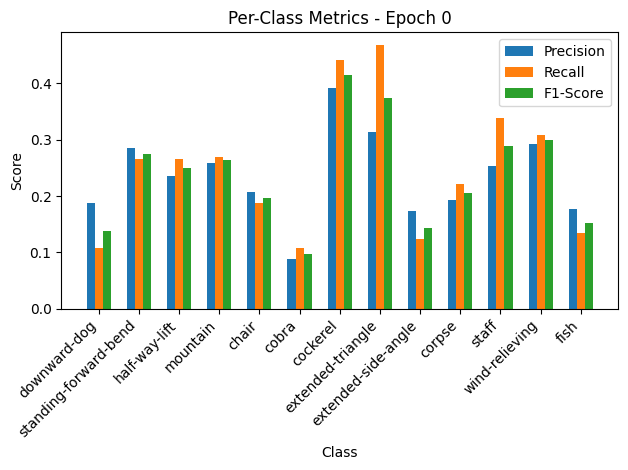

Validation: 100%|██████████| 10/10 [00:00<00:00, 177.41it/s, loss=1.69, accuracy=43.8]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 0:
downward-dog: Precision=0.19, Recall=0.11, F1-Score=0.14
standing-forward-bend: Precision=0.28, Recall=0.27, F1-Score=0.27
half-way-lift: Precision=0.24, Recall=0.27, F1-Score=0.25
mountain: Precision=0.26, Recall=0.27, F1-Score=0.26
chair: Precision=0.21, Recall=0.19, F1-Score=0.20
cobra: Precision=0.09, Recall=0.11, F1-Score=0.10
cockerel: Precision=0.39, Recall=0.44, F1-Score=0.42
extended-triangle: Precision=0.31, Recall=0.47, F1-Score=0.38
extended-side-angle: Precision=0.17, Recall=0.12, F1-Score=0.14
corpse: Precision=0.19, Recall=0.22, F1-Score=0.21
staff: Precision=0.25, Recall=0.34, F1-Score=0.29
wind-relieving: Precision=0.29, Recall=0.31, F1-Score=0.30
fish: Precision=0.18, Recall=0.13, F1-Score=0.15


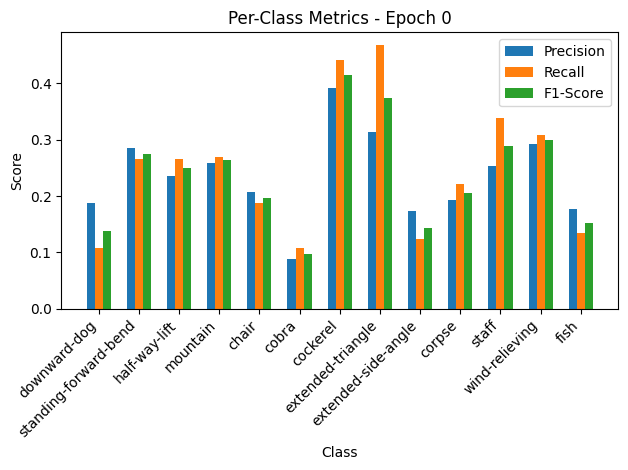


Epoch 1/50 Summary:
Train Loss: 2.2934 | Train Acc: 24.01% | Train Precision: 0.23 | Train Recall: 0.25 | Train F1: 0.24
Val Loss: 1.8510 | Val Acc: 43.84% | Val Precision: 0.46 | Val Recall: 0.48 | Val F1: 0.43
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_0.pth
Checkpoint saved at epoch 1
New best model saved! Validation Loss: 1.8510

Epoch 2/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 40.42it/s, loss=1.65, accuracy=48.2]


Per-Class Metrics for Epoch 1:
downward-dog: Precision=0.79, Recall=0.44, F1-Score=0.57
standing-forward-bend: Precision=0.65, Recall=0.41, F1-Score=0.50
half-way-lift: Precision=0.58, Recall=0.69, F1-Score=0.63
mountain: Precision=0.38, Recall=0.54, F1-Score=0.44
chair: Precision=0.35, Recall=0.36, F1-Score=0.35
cobra: Precision=0.41, Recall=0.35, F1-Score=0.38
cockerel: Precision=0.54, Recall=0.73, F1-Score=0.62
extended-triangle: Precision=0.45, Recall=0.58, F1-Score=0.51
extended-side-angle: Precision=0.43, Recall=0.41, F1-Score=0.42
corpse: Precision=0.43, Recall=0.26, F1-Score=0.33
staff: Precision=0.25, Recall=0.40, F1-Score=0.31
wind-relieving: Precision=0.53, Recall=0.72, F1-Score=0.61
fish: Precision=0.39, Recall=0.27, F1-Score=0.32


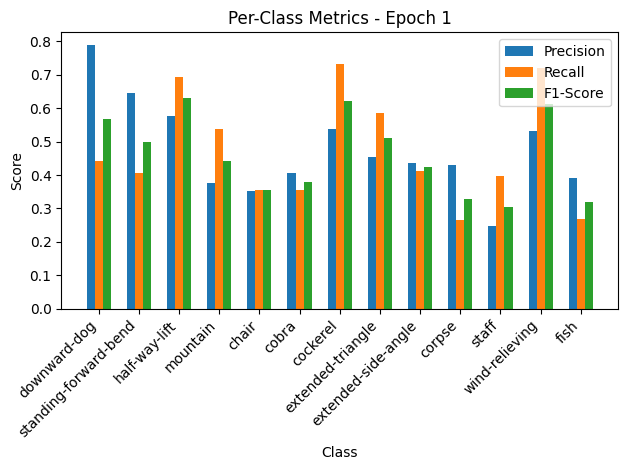

Validation: 100%|██████████| 10/10 [00:00<00:00, 139.84it/s, loss=1.29, accuracy=57.5]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 1:
downward-dog: Precision=0.79, Recall=0.44, F1-Score=0.57
standing-forward-bend: Precision=0.65, Recall=0.41, F1-Score=0.50
half-way-lift: Precision=0.58, Recall=0.69, F1-Score=0.63
mountain: Precision=0.38, Recall=0.54, F1-Score=0.44
chair: Precision=0.35, Recall=0.36, F1-Score=0.35
cobra: Precision=0.41, Recall=0.35, F1-Score=0.38
cockerel: Precision=0.54, Recall=0.73, F1-Score=0.62
extended-triangle: Precision=0.45, Recall=0.58, F1-Score=0.51
extended-side-angle: Precision=0.43, Recall=0.41, F1-Score=0.42
corpse: Precision=0.43, Recall=0.26, F1-Score=0.33
staff: Precision=0.25, Recall=0.40, F1-Score=0.31
wind-relieving: Precision=0.53, Recall=0.72, F1-Score=0.61
fish: Precision=0.39, Recall=0.27, F1-Score=0.32


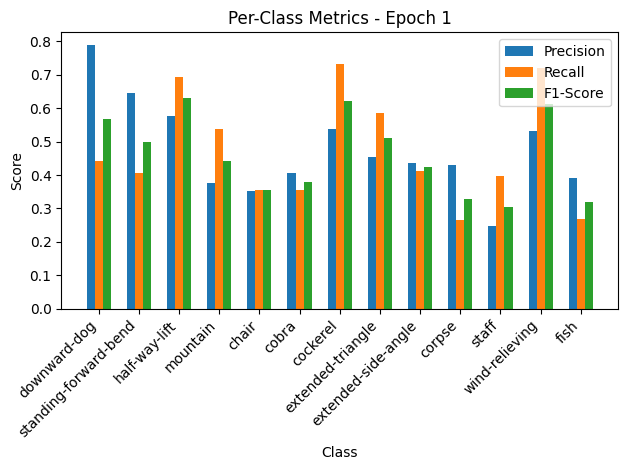


Epoch 2/50 Summary:
Train Loss: 1.6535 | Train Acc: 48.24% | Train Precision: 0.48 | Train Recall: 0.47 | Train F1: 0.46
Val Loss: 1.4132 | Val Acc: 57.53% | Val Precision: 0.59 | Val Recall: 0.54 | Val F1: 0.50
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_0.pth
Checkpoint saved at epoch 2
New best model saved! Validation Loss: 1.4132

Epoch 3/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:01<00:00, 44.95it/s, loss=1.3, accuracy=61.5]


Per-Class Metrics for Epoch 2:
downward-dog: Precision=0.86, Recall=0.70, F1-Score=0.77
standing-forward-bend: Precision=0.79, Recall=0.56, F1-Score=0.66
half-way-lift: Precision=0.67, Recall=0.91, F1-Score=0.77
mountain: Precision=0.63, Recall=0.65, F1-Score=0.64
chair: Precision=0.64, Recall=0.61, F1-Score=0.63
cobra: Precision=0.47, Recall=0.51, F1-Score=0.49
cockerel: Precision=0.74, Recall=0.80, F1-Score=0.77
extended-triangle: Precision=0.50, Recall=0.71, F1-Score=0.59
extended-side-angle: Precision=0.52, Recall=0.36, F1-Score=0.42
corpse: Precision=0.30, Recall=0.24, F1-Score=0.26
staff: Precision=0.36, Recall=0.41, F1-Score=0.39
wind-relieving: Precision=0.68, Recall=0.71, F1-Score=0.69
fish: Precision=0.35, Recall=0.37, F1-Score=0.36


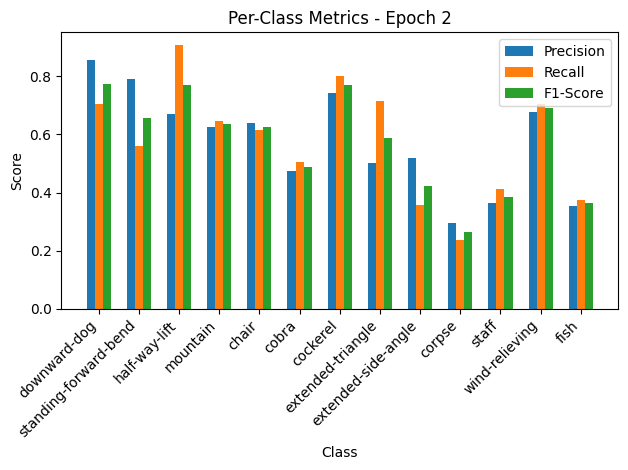

Validation: 100%|██████████| 10/10 [00:00<00:00, 169.71it/s, loss=1.04, accuracy=70.5]


Per-Class Metrics for Epoch 2:
downward-dog: Precision=0.86, Recall=0.70, F1-Score=0.77
standing-forward-bend: Precision=0.79, Recall=0.56, F1-Score=0.66
half-way-lift: Precision=0.67, Recall=0.91, F1-Score=0.77
mountain: Precision=0.63, Recall=0.65, F1-Score=0.64
chair: Precision=0.64, Recall=0.61, F1-Score=0.63
cobra: Precision=0.47, Recall=0.51, F1-Score=0.49
cockerel: Precision=0.74, Recall=0.80, F1-Score=0.77
extended-triangle: Precision=0.50, Recall=0.71, F1-Score=0.59
extended-side-angle: Precision=0.52, Recall=0.36, F1-Score=0.42
corpse: Precision=0.30, Recall=0.24, F1-Score=0.26
staff: Precision=0.36, Recall=0.41, F1-Score=0.39
wind-relieving: Precision=0.68, Recall=0.71, F1-Score=0.69
fish: Precision=0.35, Recall=0.37, F1-Score=0.36


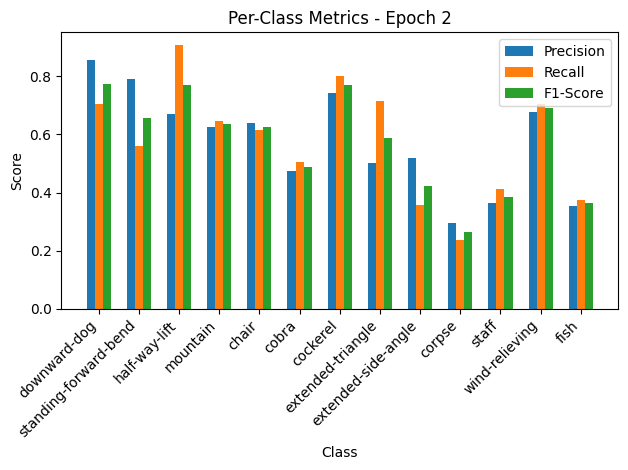


Epoch 3/50 Summary:
Train Loss: 1.2992 | Train Acc: 61.47% | Train Precision: 0.58 | Train Recall: 0.58 | Train F1: 0.57
Val Loss: 1.1361 | Val Acc: 70.55% | Val Precision: 0.78 | Val Recall: 0.71 | Val F1: 0.70
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_0.pth
Checkpoint saved at epoch 3
New best model saved! Validation Loss: 1.1361

Epoch 4/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:01<00:00, 42.57it/s, loss=1.11, accuracy=68.2]


Per-Class Metrics for Epoch 3:
downward-dog: Precision=0.94, Recall=0.83, F1-Score=0.88
standing-forward-bend: Precision=0.91, Recall=0.66, F1-Score=0.76
half-way-lift: Precision=0.72, Recall=0.91, F1-Score=0.81
mountain: Precision=0.78, Recall=0.77, F1-Score=0.78
chair: Precision=0.69, Recall=0.70, F1-Score=0.70
cobra: Precision=0.61, Recall=0.45, F1-Score=0.52
cockerel: Precision=0.71, Recall=0.90, F1-Score=0.79
extended-triangle: Precision=0.56, Recall=0.64, F1-Score=0.59
extended-side-angle: Precision=0.50, Recall=0.52, F1-Score=0.51
corpse: Precision=0.39, Recall=0.35, F1-Score=0.37
staff: Precision=0.50, Recall=0.47, F1-Score=0.48
wind-relieving: Precision=0.69, Recall=0.72, F1-Score=0.71
fish: Precision=0.33, Recall=0.42, F1-Score=0.37


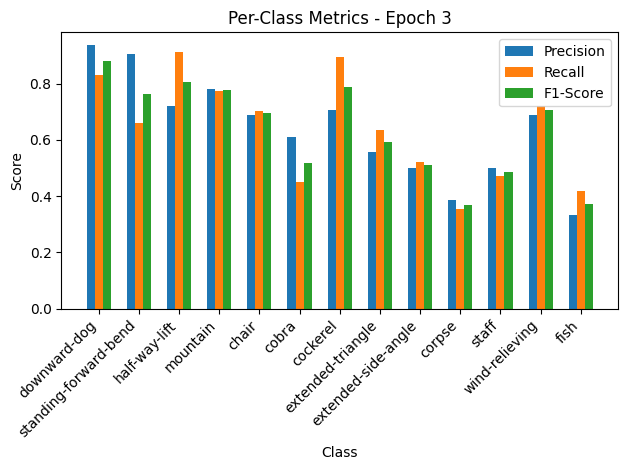

Validation: 100%|██████████| 10/10 [00:00<00:00, 177.61it/s, loss=0.876, accuracy=79.5]


Per-Class Metrics for Epoch 3:
downward-dog: Precision=0.94, Recall=0.83, F1-Score=0.88
standing-forward-bend: Precision=0.91, Recall=0.66, F1-Score=0.76
half-way-lift: Precision=0.72, Recall=0.91, F1-Score=0.81
mountain: Precision=0.78, Recall=0.77, F1-Score=0.78
chair: Precision=0.69, Recall=0.70, F1-Score=0.70
cobra: Precision=0.61, Recall=0.45, F1-Score=0.52
cockerel: Precision=0.71, Recall=0.90, F1-Score=0.79
extended-triangle: Precision=0.56, Recall=0.64, F1-Score=0.59
extended-side-angle: Precision=0.50, Recall=0.52, F1-Score=0.51
corpse: Precision=0.39, Recall=0.35, F1-Score=0.37
staff: Precision=0.50, Recall=0.47, F1-Score=0.48
wind-relieving: Precision=0.69, Recall=0.72, F1-Score=0.71
fish: Precision=0.33, Recall=0.42, F1-Score=0.37


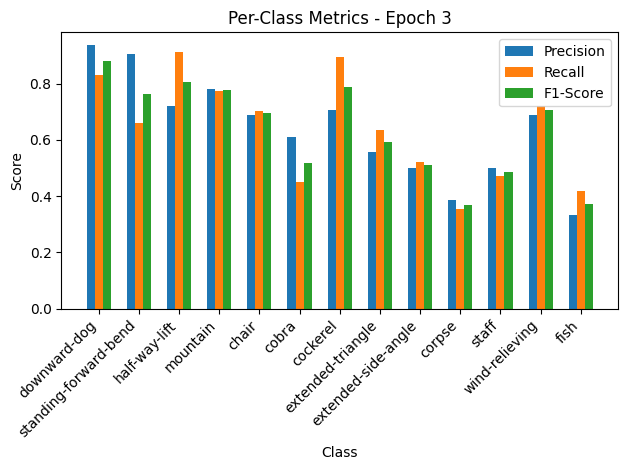


Epoch 4/50 Summary:
Train Loss: 1.1166 | Train Acc: 68.20% | Train Precision: 0.64 | Train Recall: 0.64 | Train F1: 0.64
Val Loss: 0.9597 | Val Acc: 79.45% | Val Precision: 0.82 | Val Recall: 0.76 | Val F1: 0.75
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_0.pth
Checkpoint saved at epoch 4
New best model saved! Validation Loss: 0.9597

Epoch 5/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:01<00:00, 42.77it/s, loss=0.958, accuracy=72.9]


Per-Class Metrics for Epoch 4:
downward-dog: Precision=0.91, Recall=0.85, F1-Score=0.88
standing-forward-bend: Precision=0.87, Recall=0.63, F1-Score=0.73
half-way-lift: Precision=0.72, Recall=0.87, F1-Score=0.79
mountain: Precision=0.81, Recall=0.77, F1-Score=0.79
chair: Precision=0.73, Recall=0.79, F1-Score=0.76
cobra: Precision=0.71, Recall=0.65, F1-Score=0.68
cockerel: Precision=0.72, Recall=0.87, F1-Score=0.79
extended-triangle: Precision=0.59, Recall=0.57, F1-Score=0.58
extended-side-angle: Precision=0.56, Recall=0.67, F1-Score=0.61
corpse: Precision=0.64, Recall=0.56, F1-Score=0.60
staff: Precision=0.61, Recall=0.60, F1-Score=0.61
wind-relieving: Precision=0.77, Recall=0.81, F1-Score=0.79
fish: Precision=0.52, Recall=0.57, F1-Score=0.54


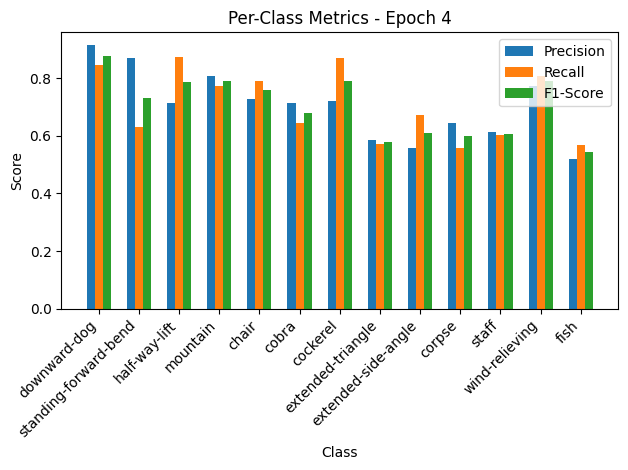

Validation: 100%|██████████| 10/10 [00:00<00:00, 170.55it/s, loss=0.758, accuracy=77.4]


Per-Class Metrics for Epoch 4:
downward-dog: Precision=0.91, Recall=0.85, F1-Score=0.88
standing-forward-bend: Precision=0.87, Recall=0.63, F1-Score=0.73
half-way-lift: Precision=0.72, Recall=0.87, F1-Score=0.79
mountain: Precision=0.81, Recall=0.77, F1-Score=0.79
chair: Precision=0.73, Recall=0.79, F1-Score=0.76
cobra: Precision=0.71, Recall=0.65, F1-Score=0.68
cockerel: Precision=0.72, Recall=0.87, F1-Score=0.79
extended-triangle: Precision=0.59, Recall=0.57, F1-Score=0.58
extended-side-angle: Precision=0.56, Recall=0.67, F1-Score=0.61
corpse: Precision=0.64, Recall=0.56, F1-Score=0.60
staff: Precision=0.61, Recall=0.60, F1-Score=0.61
wind-relieving: Precision=0.77, Recall=0.81, F1-Score=0.79
fish: Precision=0.52, Recall=0.57, F1-Score=0.54


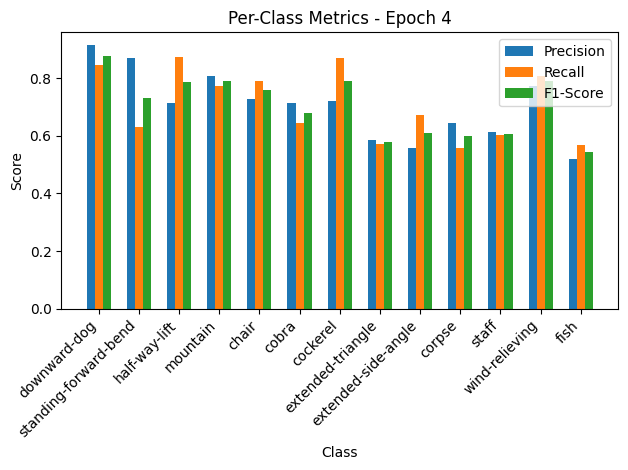


Epoch 5/50 Summary:
Train Loss: 0.9607 | Train Acc: 72.94% | Train Precision: 0.71 | Train Recall: 0.71 | Train F1: 0.70
Val Loss: 0.8307 | Val Acc: 77.40% | Val Precision: 0.78 | Val Recall: 0.75 | Val F1: 0.73
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_0.pth
Checkpoint saved at epoch 5
New best model saved! Validation Loss: 0.8307

Epoch 6/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 38.56it/s, loss=0.755, accuracy=78.2]


Per-Class Metrics for Epoch 5:
downward-dog: Precision=0.93, Recall=0.88, F1-Score=0.91
standing-forward-bend: Precision=0.86, Recall=0.74, F1-Score=0.79
half-way-lift: Precision=0.80, Recall=0.87, F1-Score=0.83
mountain: Precision=0.79, Recall=0.80, F1-Score=0.79
chair: Precision=0.75, Recall=0.75, F1-Score=0.75
cobra: Precision=0.82, Recall=0.78, F1-Score=0.80
cockerel: Precision=0.82, Recall=0.94, F1-Score=0.88
extended-triangle: Precision=0.57, Recall=0.71, F1-Score=0.64
extended-side-angle: Precision=0.56, Recall=0.47, F1-Score=0.51
corpse: Precision=0.68, Recall=0.62, F1-Score=0.65
staff: Precision=0.79, Recall=0.87, F1-Score=0.83
wind-relieving: Precision=0.88, Recall=0.88, F1-Score=0.88
fish: Precision=0.65, Recall=0.64, F1-Score=0.65


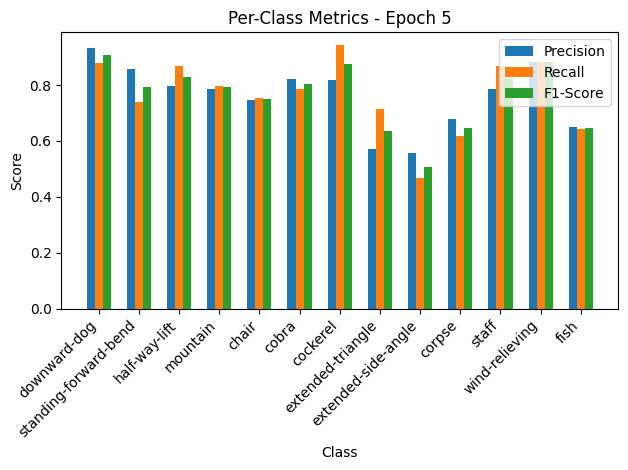

Validation: 100%|██████████| 10/10 [00:00<00:00, 140.79it/s, loss=0.6, accuracy=85.6]


Per-Class Metrics for Epoch 5:
downward-dog: Precision=0.93, Recall=0.88, F1-Score=0.91
standing-forward-bend: Precision=0.86, Recall=0.74, F1-Score=0.79
half-way-lift: Precision=0.80, Recall=0.87, F1-Score=0.83
mountain: Precision=0.79, Recall=0.80, F1-Score=0.79
chair: Precision=0.75, Recall=0.75, F1-Score=0.75
cobra: Precision=0.82, Recall=0.78, F1-Score=0.80
cockerel: Precision=0.82, Recall=0.94, F1-Score=0.88
extended-triangle: Precision=0.57, Recall=0.71, F1-Score=0.64
extended-side-angle: Precision=0.56, Recall=0.47, F1-Score=0.51
corpse: Precision=0.68, Recall=0.62, F1-Score=0.65
staff: Precision=0.79, Recall=0.87, F1-Score=0.83
wind-relieving: Precision=0.88, Recall=0.88, F1-Score=0.88
fish: Precision=0.65, Recall=0.64, F1-Score=0.65


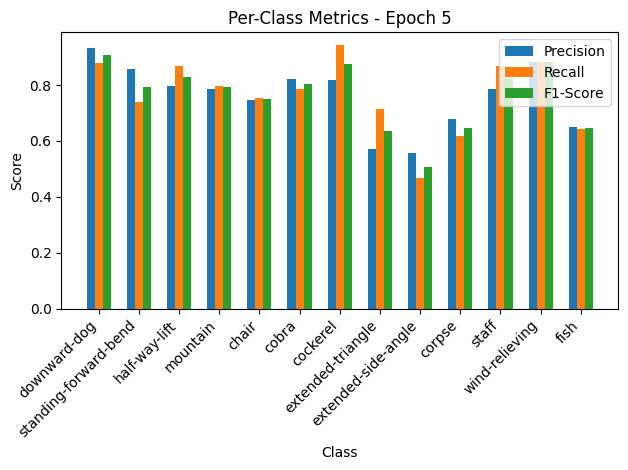


Epoch 6/50 Summary:
Train Loss: 0.7577 | Train Acc: 78.21% | Train Precision: 0.76 | Train Recall: 0.77 | Train F1: 0.76
Val Loss: 0.6575 | Val Acc: 85.62% | Val Precision: 0.88 | Val Recall: 0.84 | Val F1: 0.83
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_0.pth
Checkpoint saved at epoch 6
New best model saved! Validation Loss: 0.6575

Epoch 7/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 37.11it/s, loss=0.671, accuracy=82.6]


Per-Class Metrics for Epoch 6:
downward-dog: Precision=0.94, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=0.94, Recall=0.73, F1-Score=0.82
half-way-lift: Precision=0.79, Recall=0.91, F1-Score=0.84
mountain: Precision=0.81, Recall=0.81, F1-Score=0.81
chair: Precision=0.74, Recall=0.82, F1-Score=0.78
cobra: Precision=0.85, Recall=0.91, F1-Score=0.88
cockerel: Precision=0.91, Recall=0.87, F1-Score=0.89
extended-triangle: Precision=0.66, Recall=0.74, F1-Score=0.70
extended-side-angle: Precision=0.71, Recall=0.67, F1-Score=0.69
corpse: Precision=0.79, Recall=0.71, F1-Score=0.74
staff: Precision=0.77, Recall=0.84, F1-Score=0.80
wind-relieving: Precision=0.91, Recall=0.94, F1-Score=0.93
fish: Precision=0.77, Recall=0.81, F1-Score=0.79


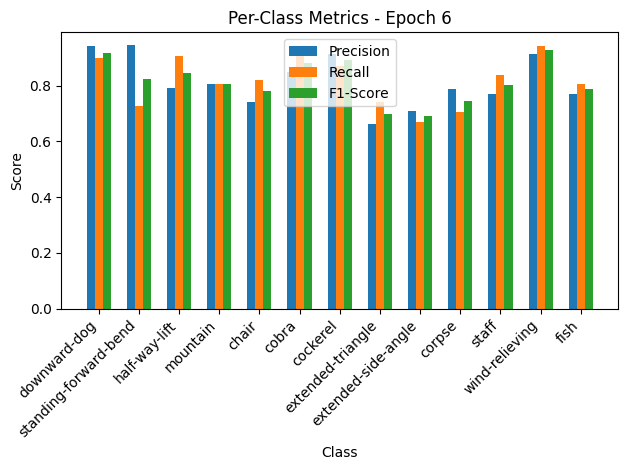

Validation: 100%|██████████| 10/10 [00:00<00:00, 171.20it/s, loss=0.546, accuracy=85.6]


Per-Class Metrics for Epoch 6:
downward-dog: Precision=0.94, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=0.94, Recall=0.73, F1-Score=0.82
half-way-lift: Precision=0.79, Recall=0.91, F1-Score=0.84
mountain: Precision=0.81, Recall=0.81, F1-Score=0.81
chair: Precision=0.74, Recall=0.82, F1-Score=0.78
cobra: Precision=0.85, Recall=0.91, F1-Score=0.88
cockerel: Precision=0.91, Recall=0.87, F1-Score=0.89
extended-triangle: Precision=0.66, Recall=0.74, F1-Score=0.70
extended-side-angle: Precision=0.71, Recall=0.67, F1-Score=0.69
corpse: Precision=0.79, Recall=0.71, F1-Score=0.74
staff: Precision=0.77, Recall=0.84, F1-Score=0.80
wind-relieving: Precision=0.91, Recall=0.94, F1-Score=0.93
fish: Precision=0.77, Recall=0.81, F1-Score=0.79


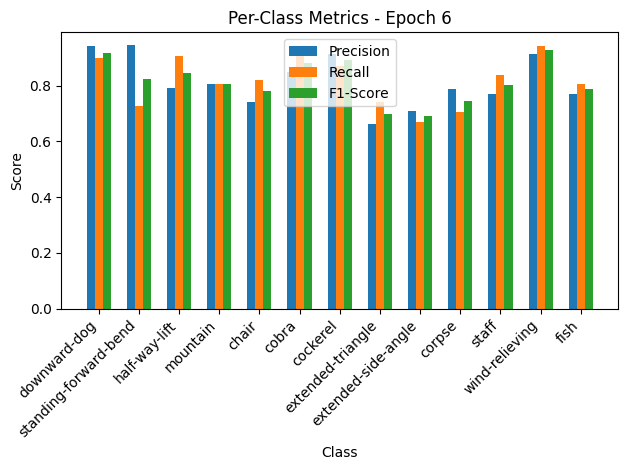


Epoch 7/50 Summary:
Train Loss: 0.6728 | Train Acc: 82.57% | Train Precision: 0.82 | Train Recall: 0.82 | Train F1: 0.82
Val Loss: 0.5983 | Val Acc: 85.62% | Val Precision: 0.88 | Val Recall: 0.84 | Val F1: 0.83
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_0.pth
Checkpoint saved at epoch 7
New best model saved! Validation Loss: 0.5983

Epoch 8/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:01<00:00, 41.81it/s, loss=0.578, accuracy=84.3]


Per-Class Metrics for Epoch 7:
downward-dog: Precision=0.92, Recall=0.90, F1-Score=0.91
standing-forward-bend: Precision=0.94, Recall=0.71, F1-Score=0.81
half-way-lift: Precision=0.80, Recall=0.95, F1-Score=0.87
mountain: Precision=0.85, Recall=0.85, F1-Score=0.85
chair: Precision=0.81, Recall=0.85, F1-Score=0.83
cobra: Precision=0.89, Recall=0.96, F1-Score=0.92
cockerel: Precision=0.93, Recall=0.90, F1-Score=0.91
extended-triangle: Precision=0.74, Recall=0.74, F1-Score=0.74
extended-side-angle: Precision=0.72, Recall=0.79, F1-Score=0.76
corpse: Precision=0.75, Recall=0.72, F1-Score=0.74
staff: Precision=0.87, Recall=0.90, F1-Score=0.88
wind-relieving: Precision=0.87, Recall=0.90, F1-Score=0.88
fish: Precision=0.72, Recall=0.72, F1-Score=0.72


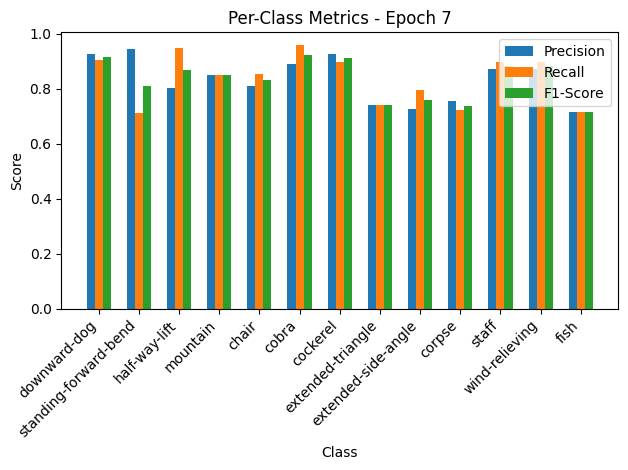

Validation: 100%|██████████| 10/10 [00:00<00:00, 172.56it/s, loss=0.542, accuracy=84.9]


Per-Class Metrics for Epoch 7:
downward-dog: Precision=0.92, Recall=0.90, F1-Score=0.91
standing-forward-bend: Precision=0.94, Recall=0.71, F1-Score=0.81
half-way-lift: Precision=0.80, Recall=0.95, F1-Score=0.87
mountain: Precision=0.85, Recall=0.85, F1-Score=0.85
chair: Precision=0.81, Recall=0.85, F1-Score=0.83
cobra: Precision=0.89, Recall=0.96, F1-Score=0.92
cockerel: Precision=0.93, Recall=0.90, F1-Score=0.91
extended-triangle: Precision=0.74, Recall=0.74, F1-Score=0.74
extended-side-angle: Precision=0.72, Recall=0.79, F1-Score=0.76
corpse: Precision=0.75, Recall=0.72, F1-Score=0.74
staff: Precision=0.87, Recall=0.90, F1-Score=0.88
wind-relieving: Precision=0.87, Recall=0.90, F1-Score=0.88
fish: Precision=0.72, Recall=0.72, F1-Score=0.72


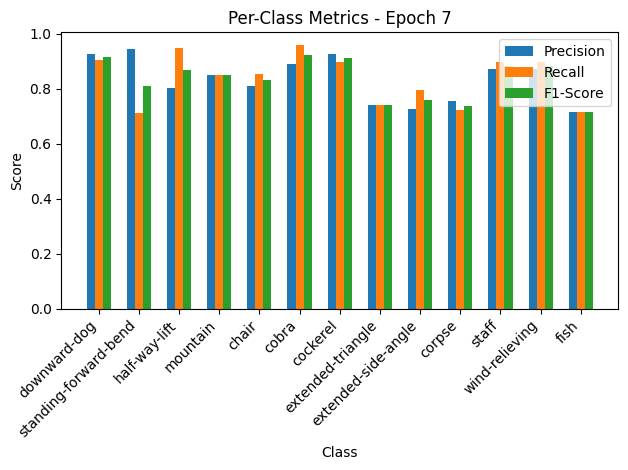


Epoch 8/50 Summary:
Train Loss: 0.5797 | Train Acc: 84.33% | Train Precision: 0.83 | Train Recall: 0.84 | Train F1: 0.83
Val Loss: 0.5945 | Val Acc: 84.93% | Val Precision: 0.87 | Val Recall: 0.84 | Val F1: 0.82
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_0.pth
Checkpoint saved at epoch 8
New best model saved! Validation Loss: 0.5945

Epoch 9/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:01<00:00, 42.43it/s, loss=0.556, accuracy=85.2]


Per-Class Metrics for Epoch 8:
downward-dog: Precision=0.92, Recall=0.91, F1-Score=0.91
standing-forward-bend: Precision=0.95, Recall=0.76, F1-Score=0.85
half-way-lift: Precision=0.82, Recall=0.93, F1-Score=0.87
mountain: Precision=0.86, Recall=0.87, F1-Score=0.87
chair: Precision=0.81, Recall=0.84, F1-Score=0.83
cobra: Precision=0.85, Recall=0.97, F1-Score=0.90
cockerel: Precision=0.89, Recall=0.88, F1-Score=0.89
extended-triangle: Precision=0.83, Recall=0.82, F1-Score=0.82
extended-side-angle: Precision=0.82, Recall=0.86, F1-Score=0.84
corpse: Precision=0.82, Recall=0.66, F1-Score=0.73
staff: Precision=0.82, Recall=0.81, F1-Score=0.81
wind-relieving: Precision=0.95, Recall=0.84, F1-Score=0.89
fish: Precision=0.65, Recall=0.81, F1-Score=0.72


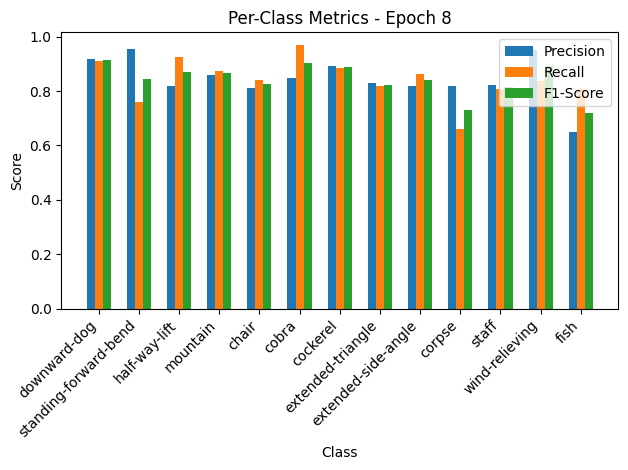

Validation: 100%|██████████| 10/10 [00:00<00:00, 178.10it/s, loss=0.471, accuracy=88.4]


Per-Class Metrics for Epoch 8:
downward-dog: Precision=0.92, Recall=0.91, F1-Score=0.91
standing-forward-bend: Precision=0.95, Recall=0.76, F1-Score=0.85
half-way-lift: Precision=0.82, Recall=0.93, F1-Score=0.87
mountain: Precision=0.86, Recall=0.87, F1-Score=0.87
chair: Precision=0.81, Recall=0.84, F1-Score=0.83
cobra: Precision=0.85, Recall=0.97, F1-Score=0.90
cockerel: Precision=0.89, Recall=0.88, F1-Score=0.89
extended-triangle: Precision=0.83, Recall=0.82, F1-Score=0.82
extended-side-angle: Precision=0.82, Recall=0.86, F1-Score=0.84
corpse: Precision=0.82, Recall=0.66, F1-Score=0.73
staff: Precision=0.82, Recall=0.81, F1-Score=0.81
wind-relieving: Precision=0.95, Recall=0.84, F1-Score=0.89
fish: Precision=0.65, Recall=0.81, F1-Score=0.72


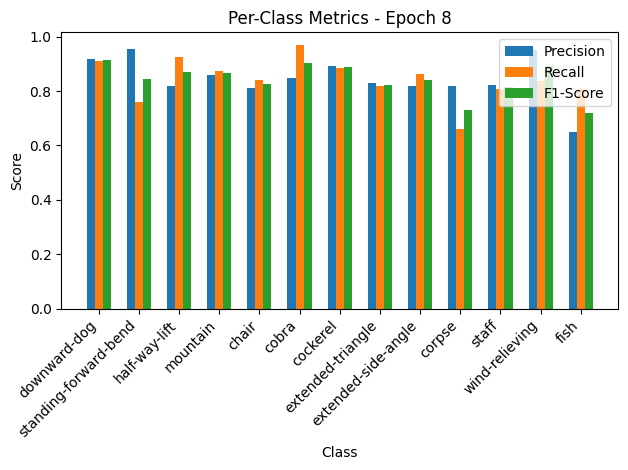


Epoch 9/50 Summary:
Train Loss: 0.5579 | Train Acc: 85.17% | Train Precision: 0.85 | Train Recall: 0.84 | Train F1: 0.84
Val Loss: 0.5159 | Val Acc: 88.36% | Val Precision: 0.90 | Val Recall: 0.89 | Val F1: 0.88
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_0.pth
Checkpoint saved at epoch 9
New best model saved! Validation Loss: 0.5159

Epoch 10/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 40.37it/s, loss=0.524, accuracy=85.2]


Per-Class Metrics for Epoch 9:
downward-dog: Precision=0.96, Recall=0.89, F1-Score=0.92
standing-forward-bend: Precision=0.95, Recall=0.78, F1-Score=0.86
half-way-lift: Precision=0.81, Recall=0.94, F1-Score=0.87
mountain: Precision=0.85, Recall=0.89, F1-Score=0.87
chair: Precision=0.83, Recall=0.82, F1-Score=0.83
cobra: Precision=0.91, Recall=0.94, F1-Score=0.92
cockerel: Precision=0.83, Recall=0.92, F1-Score=0.87
extended-triangle: Precision=0.73, Recall=0.81, F1-Score=0.77
extended-side-angle: Precision=0.74, Recall=0.70, F1-Score=0.72
corpse: Precision=0.82, Recall=0.72, F1-Score=0.77
staff: Precision=0.87, Recall=0.90, F1-Score=0.88
wind-relieving: Precision=0.89, Recall=0.91, F1-Score=0.90
fish: Precision=0.75, Recall=0.78, F1-Score=0.76


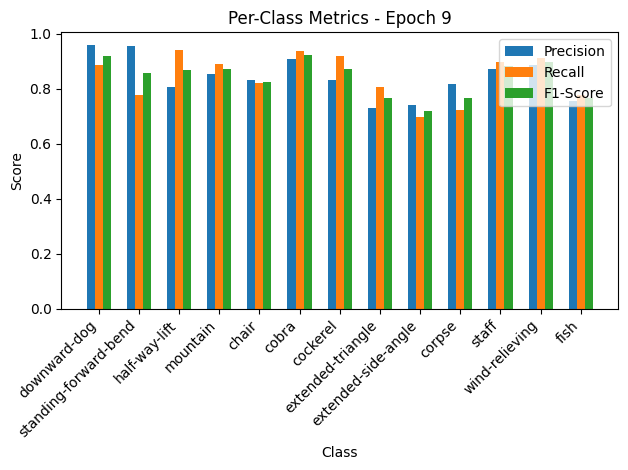

Validation: 100%|██████████| 10/10 [00:00<00:00, 182.65it/s, loss=0.423, accuracy=89.7]


Per-Class Metrics for Epoch 9:
downward-dog: Precision=0.96, Recall=0.89, F1-Score=0.92
standing-forward-bend: Precision=0.95, Recall=0.78, F1-Score=0.86
half-way-lift: Precision=0.81, Recall=0.94, F1-Score=0.87
mountain: Precision=0.85, Recall=0.89, F1-Score=0.87
chair: Precision=0.83, Recall=0.82, F1-Score=0.83
cobra: Precision=0.91, Recall=0.94, F1-Score=0.92
cockerel: Precision=0.83, Recall=0.92, F1-Score=0.87
extended-triangle: Precision=0.73, Recall=0.81, F1-Score=0.77
extended-side-angle: Precision=0.74, Recall=0.70, F1-Score=0.72
corpse: Precision=0.82, Recall=0.72, F1-Score=0.77
staff: Precision=0.87, Recall=0.90, F1-Score=0.88
wind-relieving: Precision=0.89, Recall=0.91, F1-Score=0.90
fish: Precision=0.75, Recall=0.78, F1-Score=0.76


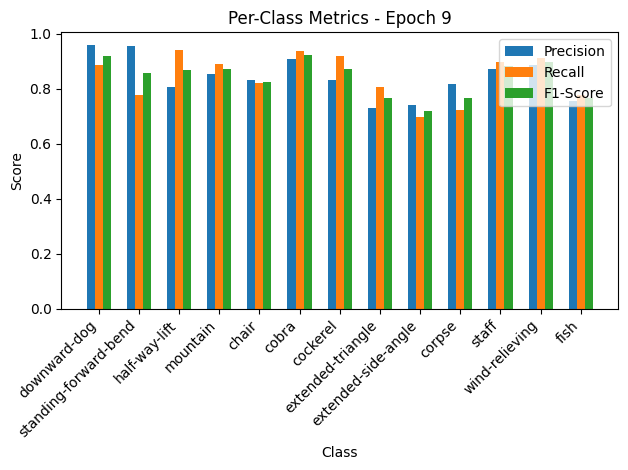


Epoch 10/50 Summary:
Train Loss: 0.5257 | Train Acc: 85.24% | Train Precision: 0.84 | Train Recall: 0.84 | Train F1: 0.84
Val Loss: 0.4635 | Val Acc: 89.73% | Val Precision: 0.92 | Val Recall: 0.90 | Val F1: 0.89
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_0.pth
Checkpoint saved at epoch 10
New best model saved! Validation Loss: 0.4635

Epoch 11/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 35.14it/s, loss=0.469, accuracy=85.8]


Per-Class Metrics for Epoch 10:
downward-dog: Precision=0.95, Recall=0.88, F1-Score=0.91
standing-forward-bend: Precision=0.92, Recall=0.77, F1-Score=0.84
half-way-lift: Precision=0.81, Recall=0.91, F1-Score=0.86
mountain: Precision=0.88, Recall=0.89, F1-Score=0.88
chair: Precision=0.82, Recall=0.80, F1-Score=0.81
cobra: Precision=0.92, Recall=0.94, F1-Score=0.93
cockerel: Precision=0.83, Recall=0.95, F1-Score=0.89
extended-triangle: Precision=0.82, Recall=0.86, F1-Score=0.84
extended-side-angle: Precision=0.80, Recall=0.81, F1-Score=0.80
corpse: Precision=0.75, Recall=0.79, F1-Score=0.77
staff: Precision=0.86, Recall=0.87, F1-Score=0.86
wind-relieving: Precision=0.96, Recall=0.94, F1-Score=0.95
fish: Precision=0.74, Recall=0.72, F1-Score=0.73


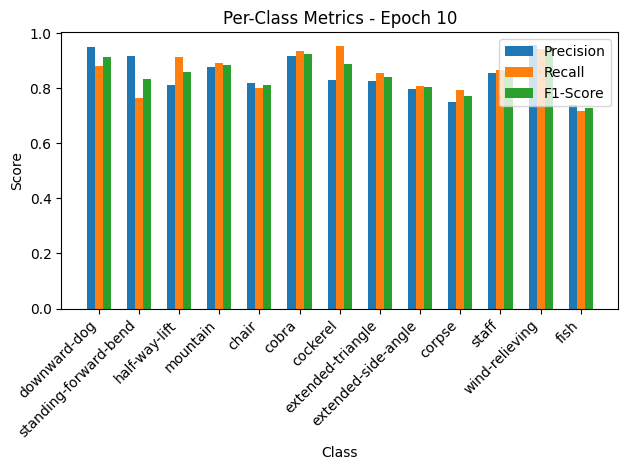

Validation: 100%|██████████| 10/10 [00:00<00:00, 178.45it/s, loss=0.464, accuracy=82.9]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 10:
downward-dog: Precision=0.95, Recall=0.88, F1-Score=0.91
standing-forward-bend: Precision=0.92, Recall=0.77, F1-Score=0.84
half-way-lift: Precision=0.81, Recall=0.91, F1-Score=0.86
mountain: Precision=0.88, Recall=0.89, F1-Score=0.88
chair: Precision=0.82, Recall=0.80, F1-Score=0.81
cobra: Precision=0.92, Recall=0.94, F1-Score=0.93
cockerel: Precision=0.83, Recall=0.95, F1-Score=0.89
extended-triangle: Precision=0.82, Recall=0.86, F1-Score=0.84
extended-side-angle: Precision=0.80, Recall=0.81, F1-Score=0.80
corpse: Precision=0.75, Recall=0.79, F1-Score=0.77
staff: Precision=0.86, Recall=0.87, F1-Score=0.86
wind-relieving: Precision=0.96, Recall=0.94, F1-Score=0.95
fish: Precision=0.74, Recall=0.72, F1-Score=0.73


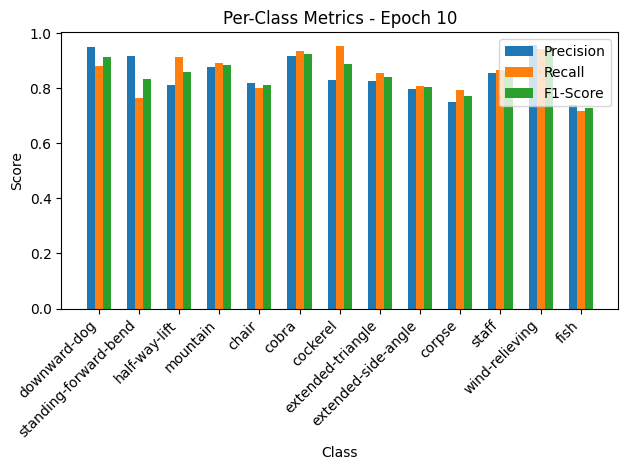


Epoch 11/50 Summary:
Train Loss: 0.4709 | Train Acc: 85.78% | Train Precision: 0.85 | Train Recall: 0.86 | Train F1: 0.85
Val Loss: 0.5081 | Val Acc: 82.88% | Val Precision: 0.78 | Val Recall: 0.82 | Val F1: 0.79

Epoch 12/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:01<00:00, 42.68it/s, loss=0.424, accuracy=87.8]


Per-Class Metrics for Epoch 11:
downward-dog: Precision=0.96, Recall=0.91, F1-Score=0.93
standing-forward-bend: Precision=0.94, Recall=0.76, F1-Score=0.84
half-way-lift: Precision=0.79, Recall=0.95, F1-Score=0.86
mountain: Precision=0.89, Recall=0.94, F1-Score=0.91
chair: Precision=0.89, Recall=0.84, F1-Score=0.87
cobra: Precision=0.93, Recall=0.97, F1-Score=0.95
cockerel: Precision=0.91, Recall=0.94, F1-Score=0.93
extended-triangle: Precision=0.86, Recall=0.74, F1-Score=0.80
extended-side-angle: Precision=0.79, Recall=0.90, F1-Score=0.84
corpse: Precision=0.82, Recall=0.78, F1-Score=0.80
staff: Precision=0.93, Recall=0.93, F1-Score=0.93
wind-relieving: Precision=0.90, Recall=0.93, F1-Score=0.91
fish: Precision=0.77, Recall=0.81, F1-Score=0.79


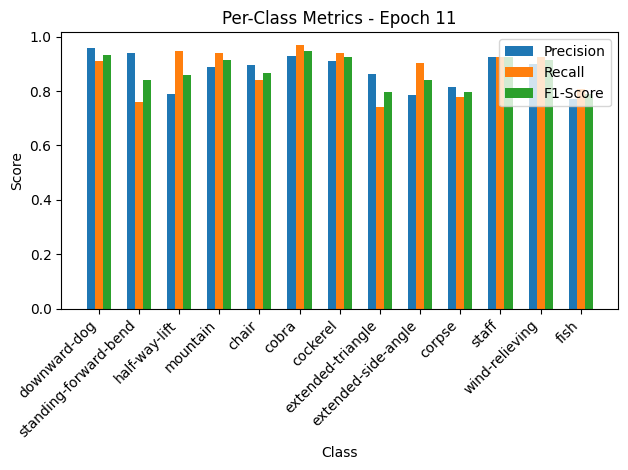

Validation: 100%|██████████| 10/10 [00:00<00:00, 179.13it/s, loss=0.385, accuracy=89.7]


Per-Class Metrics for Epoch 11:
downward-dog: Precision=0.96, Recall=0.91, F1-Score=0.93
standing-forward-bend: Precision=0.94, Recall=0.76, F1-Score=0.84
half-way-lift: Precision=0.79, Recall=0.95, F1-Score=0.86
mountain: Precision=0.89, Recall=0.94, F1-Score=0.91
chair: Precision=0.89, Recall=0.84, F1-Score=0.87
cobra: Precision=0.93, Recall=0.97, F1-Score=0.95
cockerel: Precision=0.91, Recall=0.94, F1-Score=0.93
extended-triangle: Precision=0.86, Recall=0.74, F1-Score=0.80
extended-side-angle: Precision=0.79, Recall=0.90, F1-Score=0.84
corpse: Precision=0.82, Recall=0.78, F1-Score=0.80
staff: Precision=0.93, Recall=0.93, F1-Score=0.93
wind-relieving: Precision=0.90, Recall=0.93, F1-Score=0.91
fish: Precision=0.77, Recall=0.81, F1-Score=0.79


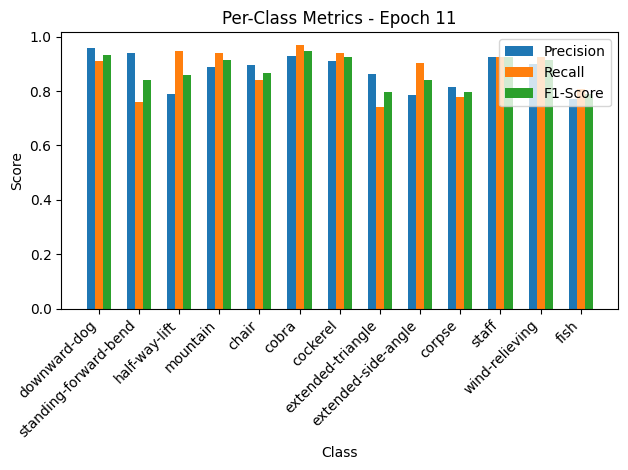


Epoch 12/50 Summary:
Train Loss: 0.4257 | Train Acc: 87.84% | Train Precision: 0.87 | Train Recall: 0.88 | Train F1: 0.87
Val Loss: 0.4220 | Val Acc: 89.73% | Val Precision: 0.91 | Val Recall: 0.90 | Val F1: 0.89
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_0.pth
Checkpoint saved at epoch 12
New best model saved! Validation Loss: 0.4220

Epoch 13/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:01<00:00, 41.75it/s, loss=0.371, accuracy=89.9]


Per-Class Metrics for Epoch 12:
downward-dog: Precision=0.96, Recall=0.91, F1-Score=0.94
standing-forward-bend: Precision=0.94, Recall=0.83, F1-Score=0.89
half-way-lift: Precision=0.83, Recall=0.93, F1-Score=0.88
mountain: Precision=0.89, Recall=0.88, F1-Score=0.89
chair: Precision=0.87, Recall=0.88, F1-Score=0.88
cobra: Precision=0.95, Recall=0.96, F1-Score=0.95
cockerel: Precision=0.92, Recall=0.94, F1-Score=0.93
extended-triangle: Precision=0.93, Recall=0.90, F1-Score=0.91
extended-side-angle: Precision=0.88, Recall=0.95, F1-Score=0.91
corpse: Precision=0.82, Recall=0.78, F1-Score=0.80
staff: Precision=0.89, Recall=0.96, F1-Score=0.92
wind-relieving: Precision=0.96, Recall=0.94, F1-Score=0.95
fish: Precision=0.81, Recall=0.84, F1-Score=0.82


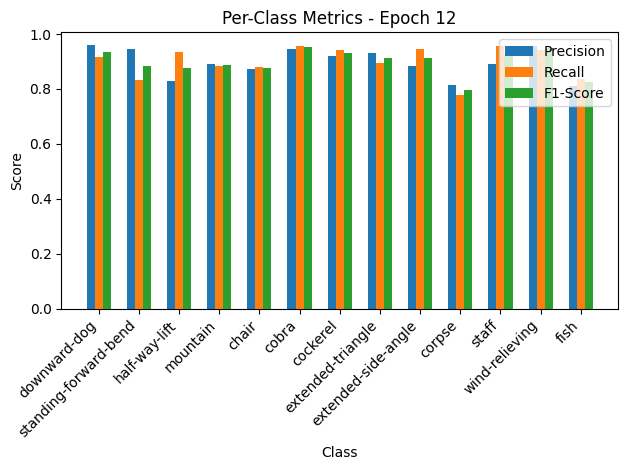

Validation: 100%|██████████| 10/10 [00:00<00:00, 173.33it/s, loss=0.404, accuracy=87.7]


Per-Class Metrics for Epoch 12:
downward-dog: Precision=0.96, Recall=0.91, F1-Score=0.94
standing-forward-bend: Precision=0.94, Recall=0.83, F1-Score=0.89
half-way-lift: Precision=0.83, Recall=0.93, F1-Score=0.88
mountain: Precision=0.89, Recall=0.88, F1-Score=0.89
chair: Precision=0.87, Recall=0.88, F1-Score=0.88
cobra: Precision=0.95, Recall=0.96, F1-Score=0.95
cockerel: Precision=0.92, Recall=0.94, F1-Score=0.93
extended-triangle: Precision=0.93, Recall=0.90, F1-Score=0.91
extended-side-angle: Precision=0.88, Recall=0.95, F1-Score=0.91
corpse: Precision=0.82, Recall=0.78, F1-Score=0.80
staff: Precision=0.89, Recall=0.96, F1-Score=0.92
wind-relieving: Precision=0.96, Recall=0.94, F1-Score=0.95
fish: Precision=0.81, Recall=0.84, F1-Score=0.82


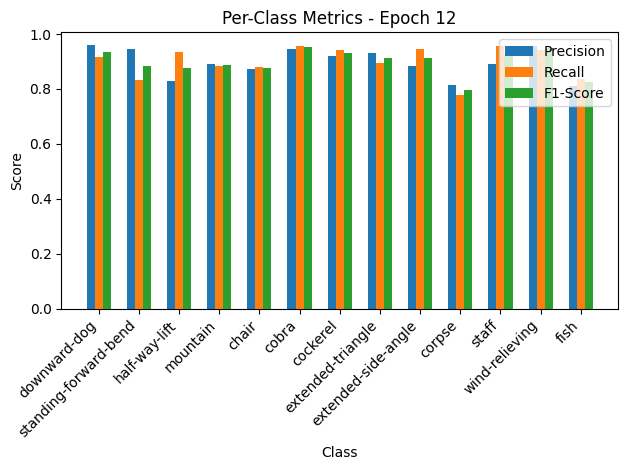


Epoch 13/50 Summary:
Train Loss: 0.3716 | Train Acc: 89.91% | Train Precision: 0.90 | Train Recall: 0.90 | Train F1: 0.90
Val Loss: 0.4425 | Val Acc: 87.67% | Val Precision: 0.90 | Val Recall: 0.87 | Val F1: 0.85

Epoch 14/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:01<00:00, 42.08it/s, loss=0.417, accuracy=87.7]


Per-Class Metrics for Epoch 13:
downward-dog: Precision=0.94, Recall=0.87, F1-Score=0.90
standing-forward-bend: Precision=0.93, Recall=0.79, F1-Score=0.86
half-way-lift: Precision=0.82, Recall=0.91, F1-Score=0.86
mountain: Precision=0.88, Recall=0.94, F1-Score=0.91
chair: Precision=0.90, Recall=0.83, F1-Score=0.87
cobra: Precision=0.86, Recall=0.96, F1-Score=0.91
cockerel: Precision=0.88, Recall=0.98, F1-Score=0.92
extended-triangle: Precision=0.84, Recall=0.90, F1-Score=0.87
extended-side-angle: Precision=0.87, Recall=0.81, F1-Score=0.84
corpse: Precision=0.76, Recall=0.76, F1-Score=0.76
staff: Precision=0.90, Recall=0.97, F1-Score=0.94
wind-relieving: Precision=0.97, Recall=0.94, F1-Score=0.96
fish: Precision=0.77, Recall=0.76, F1-Score=0.77


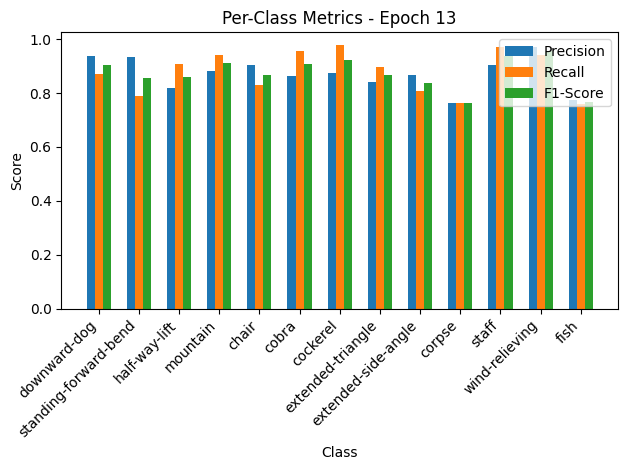

Validation: 100%|██████████| 10/10 [00:00<00:00, 174.28it/s, loss=0.402, accuracy=87.7]


Per-Class Metrics for Epoch 13:
downward-dog: Precision=0.94, Recall=0.87, F1-Score=0.90
standing-forward-bend: Precision=0.93, Recall=0.79, F1-Score=0.86
half-way-lift: Precision=0.82, Recall=0.91, F1-Score=0.86
mountain: Precision=0.88, Recall=0.94, F1-Score=0.91
chair: Precision=0.90, Recall=0.83, F1-Score=0.87
cobra: Precision=0.86, Recall=0.96, F1-Score=0.91
cockerel: Precision=0.88, Recall=0.98, F1-Score=0.92
extended-triangle: Precision=0.84, Recall=0.90, F1-Score=0.87
extended-side-angle: Precision=0.87, Recall=0.81, F1-Score=0.84
corpse: Precision=0.76, Recall=0.76, F1-Score=0.76
staff: Precision=0.90, Recall=0.97, F1-Score=0.94
wind-relieving: Precision=0.97, Recall=0.94, F1-Score=0.96
fish: Precision=0.77, Recall=0.76, F1-Score=0.77


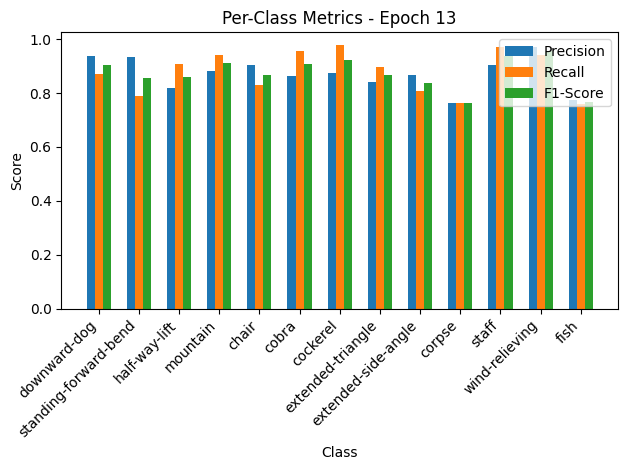


Epoch 14/50 Summary:
Train Loss: 0.4184 | Train Acc: 87.69% | Train Precision: 0.87 | Train Recall: 0.88 | Train F1: 0.87
Val Loss: 0.4405 | Val Acc: 87.67% | Val Precision: 0.91 | Val Recall: 0.87 | Val F1: 0.86

Epoch 15/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 35.42it/s, loss=0.419, accuracy=87.5]


Per-Class Metrics for Epoch 14:
downward-dog: Precision=0.95, Recall=0.93, F1-Score=0.94
standing-forward-bend: Precision=0.94, Recall=0.81, F1-Score=0.87
half-way-lift: Precision=0.83, Recall=0.94, F1-Score=0.88
mountain: Precision=0.89, Recall=0.91, F1-Score=0.90
chair: Precision=0.84, Recall=0.85, F1-Score=0.85
cobra: Precision=0.94, Recall=0.96, F1-Score=0.95
cockerel: Precision=0.88, Recall=0.88, F1-Score=0.88
extended-triangle: Precision=0.88, Recall=0.90, F1-Score=0.89
extended-side-angle: Precision=0.89, Recall=0.88, F1-Score=0.88
corpse: Precision=0.77, Recall=0.59, F1-Score=0.67
staff: Precision=0.85, Recall=0.93, F1-Score=0.89
wind-relieving: Precision=0.94, Recall=0.91, F1-Score=0.93
fish: Precision=0.64, Recall=0.78, F1-Score=0.70


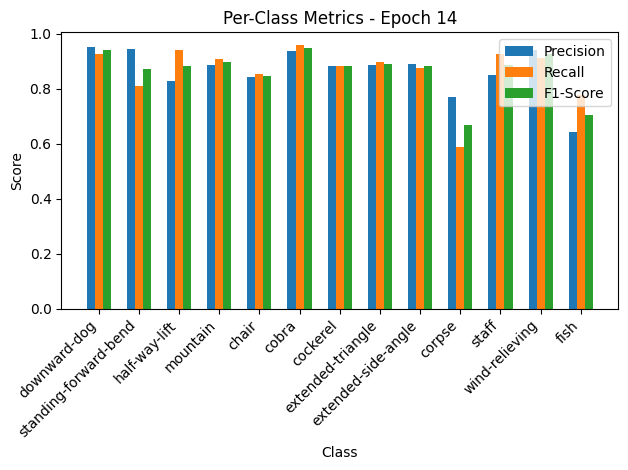

Validation: 100%|██████████| 10/10 [00:00<00:00, 163.15it/s, loss=0.353, accuracy=88.4]


Per-Class Metrics for Epoch 14:
downward-dog: Precision=0.95, Recall=0.93, F1-Score=0.94
standing-forward-bend: Precision=0.94, Recall=0.81, F1-Score=0.87
half-way-lift: Precision=0.83, Recall=0.94, F1-Score=0.88
mountain: Precision=0.89, Recall=0.91, F1-Score=0.90
chair: Precision=0.84, Recall=0.85, F1-Score=0.85
cobra: Precision=0.94, Recall=0.96, F1-Score=0.95
cockerel: Precision=0.88, Recall=0.88, F1-Score=0.88
extended-triangle: Precision=0.88, Recall=0.90, F1-Score=0.89
extended-side-angle: Precision=0.89, Recall=0.88, F1-Score=0.88
corpse: Precision=0.77, Recall=0.59, F1-Score=0.67
staff: Precision=0.85, Recall=0.93, F1-Score=0.89
wind-relieving: Precision=0.94, Recall=0.91, F1-Score=0.93
fish: Precision=0.64, Recall=0.78, F1-Score=0.70


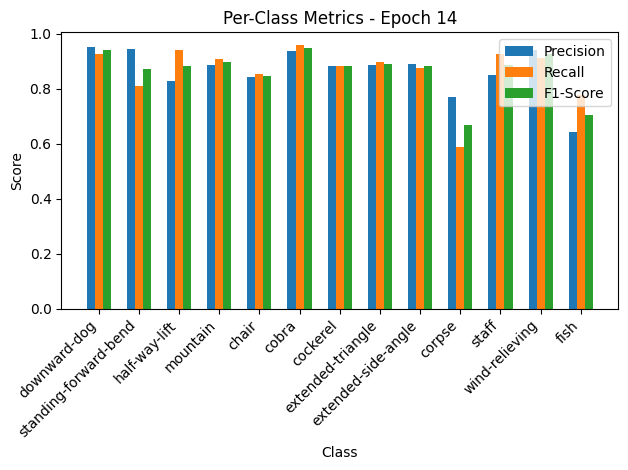


Epoch 15/50 Summary:
Train Loss: 0.4203 | Train Acc: 87.46% | Train Precision: 0.87 | Train Recall: 0.87 | Train F1: 0.86
Val Loss: 0.3872 | Val Acc: 88.36% | Val Precision: 0.90 | Val Recall: 0.88 | Val F1: 0.87
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_0.pth
Checkpoint saved at epoch 15
New best model saved! Validation Loss: 0.3872

Epoch 16/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 35.32it/s, loss=0.428, accuracy=86.3]


Per-Class Metrics for Epoch 15:
downward-dog: Precision=0.96, Recall=0.90, F1-Score=0.93
standing-forward-bend: Precision=0.94, Recall=0.80, F1-Score=0.86
half-way-lift: Precision=0.83, Recall=0.93, F1-Score=0.88
mountain: Precision=0.83, Recall=0.81, F1-Score=0.82
chair: Precision=0.77, Recall=0.84, F1-Score=0.80
cobra: Precision=0.97, Recall=0.95, F1-Score=0.96
cockerel: Precision=0.88, Recall=0.88, F1-Score=0.88
extended-triangle: Precision=0.87, Recall=0.86, F1-Score=0.86
extended-side-angle: Precision=0.81, Recall=0.86, F1-Score=0.83
corpse: Precision=0.74, Recall=0.71, F1-Score=0.72
staff: Precision=0.85, Recall=0.97, F1-Score=0.90
wind-relieving: Precision=0.96, Recall=0.94, F1-Score=0.95
fish: Precision=0.71, Recall=0.72, F1-Score=0.71


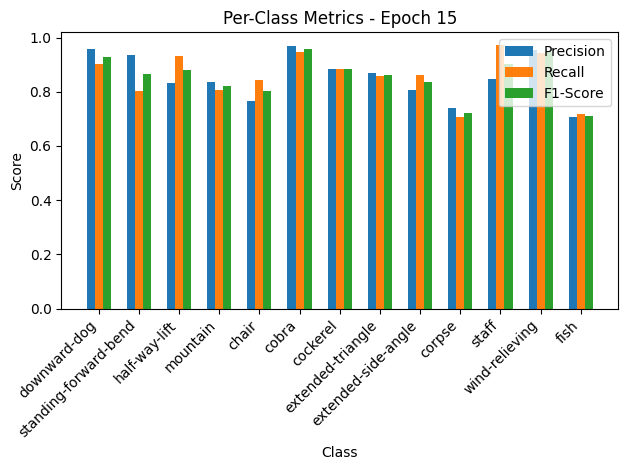

Validation: 100%|██████████| 10/10 [00:00<00:00, 156.78it/s, loss=0.324, accuracy=89.7]


Per-Class Metrics for Epoch 15:
downward-dog: Precision=0.96, Recall=0.90, F1-Score=0.93
standing-forward-bend: Precision=0.94, Recall=0.80, F1-Score=0.86
half-way-lift: Precision=0.83, Recall=0.93, F1-Score=0.88
mountain: Precision=0.83, Recall=0.81, F1-Score=0.82
chair: Precision=0.77, Recall=0.84, F1-Score=0.80
cobra: Precision=0.97, Recall=0.95, F1-Score=0.96
cockerel: Precision=0.88, Recall=0.88, F1-Score=0.88
extended-triangle: Precision=0.87, Recall=0.86, F1-Score=0.86
extended-side-angle: Precision=0.81, Recall=0.86, F1-Score=0.83
corpse: Precision=0.74, Recall=0.71, F1-Score=0.72
staff: Precision=0.85, Recall=0.97, F1-Score=0.90
wind-relieving: Precision=0.96, Recall=0.94, F1-Score=0.95
fish: Precision=0.71, Recall=0.72, F1-Score=0.71


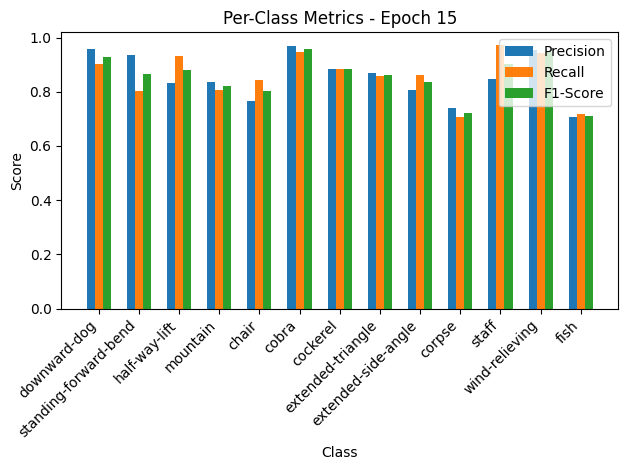


Epoch 16/50 Summary:
Train Loss: 0.4294 | Train Acc: 86.31% | Train Precision: 0.85 | Train Recall: 0.86 | Train F1: 0.86
Val Loss: 0.3547 | Val Acc: 89.73% | Val Precision: 0.92 | Val Recall: 0.91 | Val F1: 0.90
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_0.pth
Checkpoint saved at epoch 16
New best model saved! Validation Loss: 0.3547

Epoch 17/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:01<00:00, 42.82it/s, loss=0.38, accuracy=87.5]


Per-Class Metrics for Epoch 16:
downward-dog: Precision=0.95, Recall=0.89, F1-Score=0.91
standing-forward-bend: Precision=0.92, Recall=0.80, F1-Score=0.85
half-way-lift: Precision=0.81, Recall=0.92, F1-Score=0.86
mountain: Precision=0.87, Recall=0.93, F1-Score=0.90
chair: Precision=0.85, Recall=0.83, F1-Score=0.84
cobra: Precision=0.95, Recall=0.94, F1-Score=0.94
cockerel: Precision=0.93, Recall=0.91, F1-Score=0.92
extended-triangle: Precision=0.89, Recall=0.87, F1-Score=0.88
extended-side-angle: Precision=0.84, Recall=0.90, F1-Score=0.87
corpse: Precision=0.78, Recall=0.74, F1-Score=0.76
staff: Precision=0.85, Recall=0.94, F1-Score=0.90
wind-relieving: Precision=0.93, Recall=0.97, F1-Score=0.95
fish: Precision=0.74, Recall=0.72, F1-Score=0.73


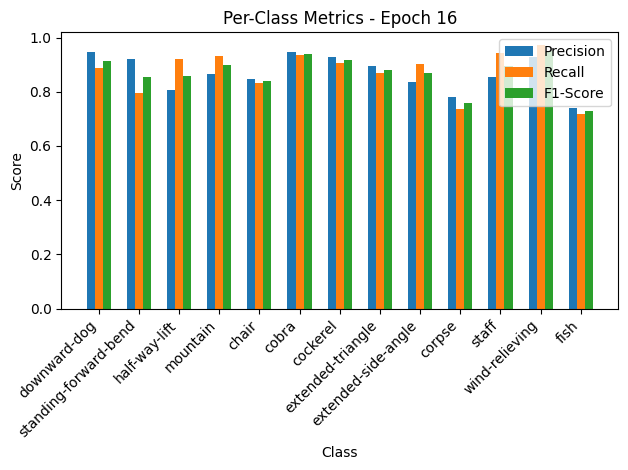

Validation: 100%|██████████| 10/10 [00:00<00:00, 176.33it/s, loss=0.443, accuracy=80.8]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 16:
downward-dog: Precision=0.95, Recall=0.89, F1-Score=0.91
standing-forward-bend: Precision=0.92, Recall=0.80, F1-Score=0.85
half-way-lift: Precision=0.81, Recall=0.92, F1-Score=0.86
mountain: Precision=0.87, Recall=0.93, F1-Score=0.90
chair: Precision=0.85, Recall=0.83, F1-Score=0.84
cobra: Precision=0.95, Recall=0.94, F1-Score=0.94
cockerel: Precision=0.93, Recall=0.91, F1-Score=0.92
extended-triangle: Precision=0.89, Recall=0.87, F1-Score=0.88
extended-side-angle: Precision=0.84, Recall=0.90, F1-Score=0.87
corpse: Precision=0.78, Recall=0.74, F1-Score=0.76
staff: Precision=0.85, Recall=0.94, F1-Score=0.90
wind-relieving: Precision=0.93, Recall=0.97, F1-Score=0.95
fish: Precision=0.74, Recall=0.72, F1-Score=0.73


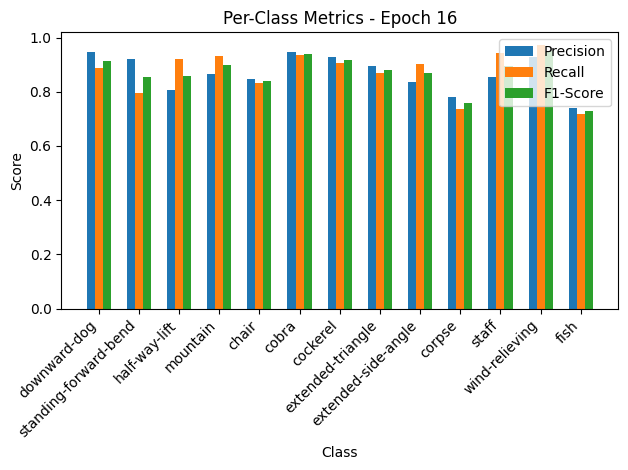


Epoch 17/50 Summary:
Train Loss: 0.3807 | Train Acc: 87.46% | Train Precision: 0.87 | Train Recall: 0.87 | Train F1: 0.87
Val Loss: 0.4857 | Val Acc: 80.82% | Val Precision: 0.82 | Val Recall: 0.81 | Val F1: 0.78

Epoch 18/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:01<00:00, 41.73it/s, loss=0.381, accuracy=87.7]


Per-Class Metrics for Epoch 17:
downward-dog: Precision=0.96, Recall=0.93, F1-Score=0.95
standing-forward-bend: Precision=0.92, Recall=0.80, F1-Score=0.86
half-way-lift: Precision=0.82, Recall=0.92, F1-Score=0.87
mountain: Precision=0.89, Recall=0.86, F1-Score=0.88
chair: Precision=0.81, Recall=0.85, F1-Score=0.83
cobra: Precision=0.95, Recall=0.97, F1-Score=0.96
cockerel: Precision=0.93, Recall=0.94, F1-Score=0.94
extended-triangle: Precision=0.92, Recall=0.87, F1-Score=0.89
extended-side-angle: Precision=0.83, Recall=0.89, F1-Score=0.86
corpse: Precision=0.73, Recall=0.69, F1-Score=0.71
staff: Precision=0.89, Recall=0.97, F1-Score=0.93
wind-relieving: Precision=0.94, Recall=0.93, F1-Score=0.93
fish: Precision=0.69, Recall=0.72, F1-Score=0.70


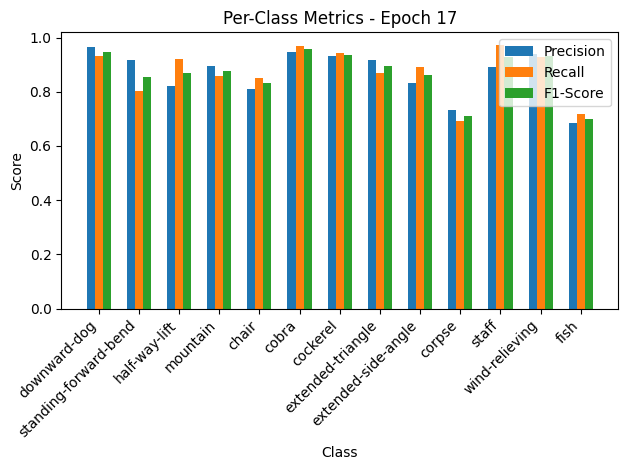

Validation: 100%|██████████| 10/10 [00:00<00:00, 151.36it/s, loss=0.36, accuracy=87.7]


Per-Class Metrics for Epoch 17:
downward-dog: Precision=0.96, Recall=0.93, F1-Score=0.95
standing-forward-bend: Precision=0.92, Recall=0.80, F1-Score=0.86
half-way-lift: Precision=0.82, Recall=0.92, F1-Score=0.87
mountain: Precision=0.89, Recall=0.86, F1-Score=0.88
chair: Precision=0.81, Recall=0.85, F1-Score=0.83
cobra: Precision=0.95, Recall=0.97, F1-Score=0.96
cockerel: Precision=0.93, Recall=0.94, F1-Score=0.94
extended-triangle: Precision=0.92, Recall=0.87, F1-Score=0.89
extended-side-angle: Precision=0.83, Recall=0.89, F1-Score=0.86
corpse: Precision=0.73, Recall=0.69, F1-Score=0.71
staff: Precision=0.89, Recall=0.97, F1-Score=0.93
wind-relieving: Precision=0.94, Recall=0.93, F1-Score=0.93
fish: Precision=0.69, Recall=0.72, F1-Score=0.70


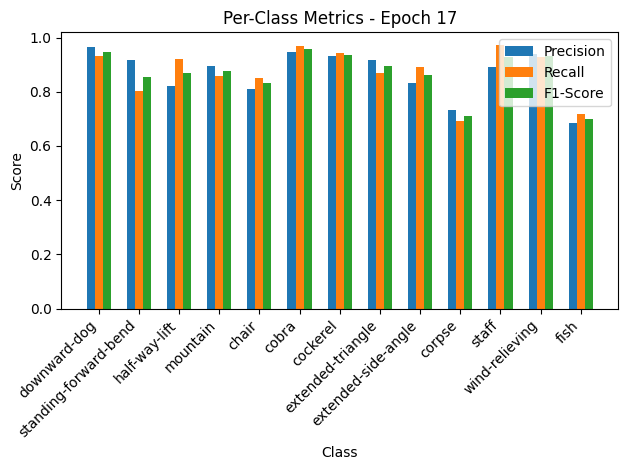


Epoch 18/50 Summary:
Train Loss: 0.3817 | Train Acc: 87.69% | Train Precision: 0.87 | Train Recall: 0.87 | Train F1: 0.87
Val Loss: 0.3948 | Val Acc: 87.67% | Val Precision: 0.90 | Val Recall: 0.87 | Val F1: 0.86

Epoch 19/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 40.69it/s, loss=0.392, accuracy=88.1]


Per-Class Metrics for Epoch 18:
downward-dog: Precision=0.97, Recall=0.92, F1-Score=0.94
standing-forward-bend: Precision=0.90, Recall=0.79, F1-Score=0.84
half-way-lift: Precision=0.83, Recall=0.93, F1-Score=0.88
mountain: Precision=0.86, Recall=0.89, F1-Score=0.88
chair: Precision=0.88, Recall=0.81, F1-Score=0.85
cobra: Precision=0.93, Recall=0.94, F1-Score=0.93
cockerel: Precision=0.92, Recall=0.99, F1-Score=0.96
extended-triangle: Precision=0.86, Recall=0.86, F1-Score=0.86
extended-side-angle: Precision=0.87, Recall=0.90, F1-Score=0.89
corpse: Precision=0.77, Recall=0.72, F1-Score=0.74
staff: Precision=0.89, Recall=1.00, F1-Score=0.94
wind-relieving: Precision=0.93, Recall=0.93, F1-Score=0.93
fish: Precision=0.75, Recall=0.76, F1-Score=0.76


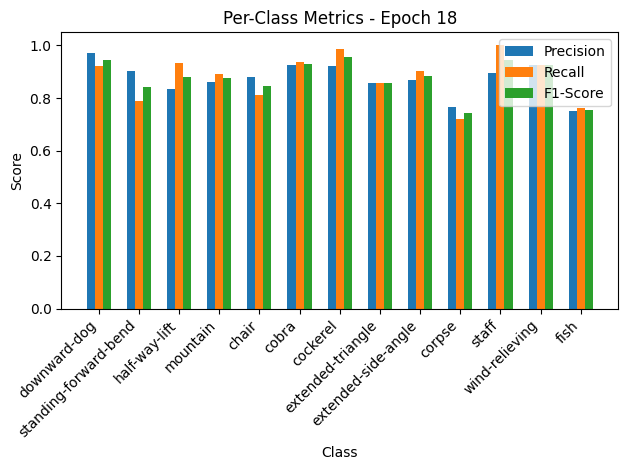

Validation: 100%|██████████| 10/10 [00:00<00:00, 179.00it/s, loss=0.366, accuracy=91.8]


Per-Class Metrics for Epoch 18:
downward-dog: Precision=0.97, Recall=0.92, F1-Score=0.94
standing-forward-bend: Precision=0.90, Recall=0.79, F1-Score=0.84
half-way-lift: Precision=0.83, Recall=0.93, F1-Score=0.88
mountain: Precision=0.86, Recall=0.89, F1-Score=0.88
chair: Precision=0.88, Recall=0.81, F1-Score=0.85
cobra: Precision=0.93, Recall=0.94, F1-Score=0.93
cockerel: Precision=0.92, Recall=0.99, F1-Score=0.96
extended-triangle: Precision=0.86, Recall=0.86, F1-Score=0.86
extended-side-angle: Precision=0.87, Recall=0.90, F1-Score=0.89
corpse: Precision=0.77, Recall=0.72, F1-Score=0.74
staff: Precision=0.89, Recall=1.00, F1-Score=0.94
wind-relieving: Precision=0.93, Recall=0.93, F1-Score=0.93
fish: Precision=0.75, Recall=0.76, F1-Score=0.76


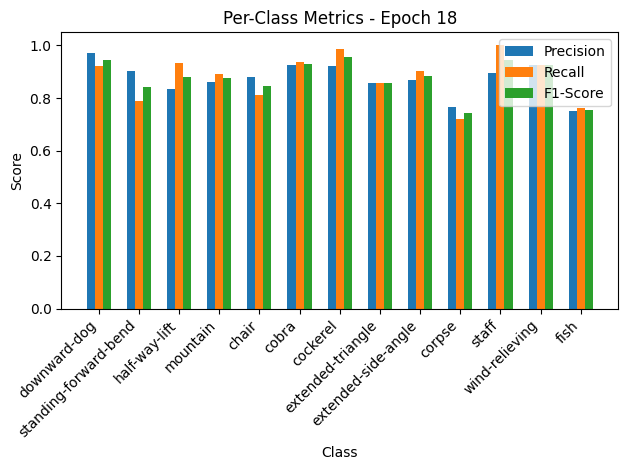


Epoch 19/50 Summary:
Train Loss: 0.3930 | Train Acc: 88.15% | Train Precision: 0.87 | Train Recall: 0.88 | Train F1: 0.88
Val Loss: 0.4007 | Val Acc: 91.78% | Val Precision: 0.94 | Val Recall: 0.92 | Val F1: 0.92

Epoch 20/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 34.74it/s, loss=0.398, accuracy=87.7]


Per-Class Metrics for Epoch 19:
downward-dog: Precision=0.94, Recall=0.89, F1-Score=0.91
standing-forward-bend: Precision=0.90, Recall=0.77, F1-Score=0.83
half-way-lift: Precision=0.81, Recall=0.92, F1-Score=0.86
mountain: Precision=0.85, Recall=0.91, F1-Score=0.88
chair: Precision=0.88, Recall=0.83, F1-Score=0.86
cobra: Precision=0.89, Recall=0.91, F1-Score=0.90
cockerel: Precision=0.88, Recall=0.97, F1-Score=0.92
extended-triangle: Precision=0.95, Recall=0.92, F1-Score=0.93
extended-side-angle: Precision=0.90, Recall=0.90, F1-Score=0.90
corpse: Precision=0.75, Recall=0.74, F1-Score=0.74
staff: Precision=0.91, Recall=0.99, F1-Score=0.94
wind-relieving: Precision=0.96, Recall=0.96, F1-Score=0.96
fish: Precision=0.78, Recall=0.73, F1-Score=0.75


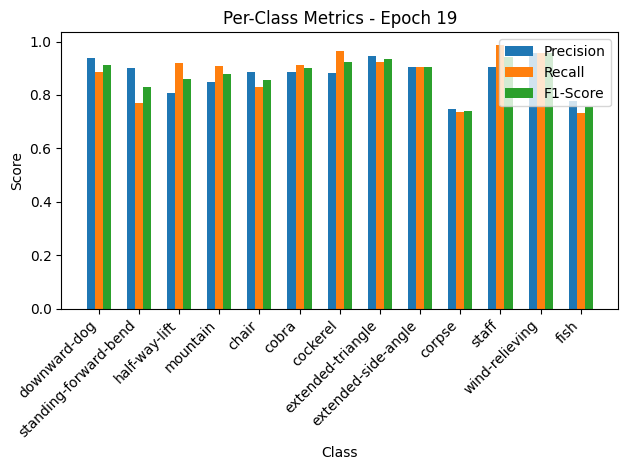

Validation: 100%|██████████| 10/10 [00:00<00:00, 140.69it/s, loss=0.345, accuracy=89]


Per-Class Metrics for Epoch 19:
downward-dog: Precision=0.94, Recall=0.89, F1-Score=0.91
standing-forward-bend: Precision=0.90, Recall=0.77, F1-Score=0.83
half-way-lift: Precision=0.81, Recall=0.92, F1-Score=0.86
mountain: Precision=0.85, Recall=0.91, F1-Score=0.88
chair: Precision=0.88, Recall=0.83, F1-Score=0.86
cobra: Precision=0.89, Recall=0.91, F1-Score=0.90
cockerel: Precision=0.88, Recall=0.97, F1-Score=0.92
extended-triangle: Precision=0.95, Recall=0.92, F1-Score=0.93
extended-side-angle: Precision=0.90, Recall=0.90, F1-Score=0.90
corpse: Precision=0.75, Recall=0.74, F1-Score=0.74
staff: Precision=0.91, Recall=0.99, F1-Score=0.94
wind-relieving: Precision=0.96, Recall=0.96, F1-Score=0.96
fish: Precision=0.78, Recall=0.73, F1-Score=0.75


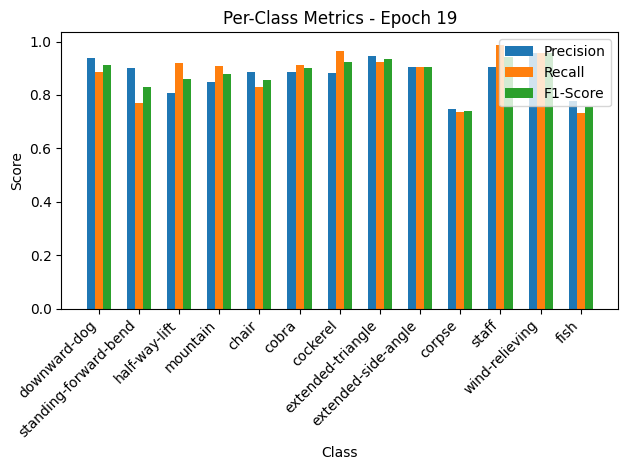


Epoch 20/50 Summary:
Train Loss: 0.3989 | Train Acc: 87.69% | Train Precision: 0.88 | Train Recall: 0.88 | Train F1: 0.88
Val Loss: 0.3786 | Val Acc: 89.04% | Val Precision: 0.90 | Val Recall: 0.90 | Val F1: 0.90

Epoch 21/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 40.34it/s, loss=0.425, accuracy=86.5]


Per-Class Metrics for Epoch 20:
downward-dog: Precision=0.93, Recall=0.88, F1-Score=0.91
standing-forward-bend: Precision=0.86, Recall=0.81, F1-Score=0.83
half-way-lift: Precision=0.85, Recall=0.89, F1-Score=0.87
mountain: Precision=0.89, Recall=0.92, F1-Score=0.91
chair: Precision=0.87, Recall=0.85, F1-Score=0.86
cobra: Precision=0.97, Recall=0.95, F1-Score=0.96
cockerel: Precision=0.89, Recall=0.93, F1-Score=0.91
extended-triangle: Precision=0.88, Recall=0.83, F1-Score=0.85
extended-side-angle: Precision=0.81, Recall=0.92, F1-Score=0.86
corpse: Precision=0.71, Recall=0.60, F1-Score=0.65
staff: Precision=0.85, Recall=0.94, F1-Score=0.90
wind-relieving: Precision=0.94, Recall=0.96, F1-Score=0.95
fish: Precision=0.66, Recall=0.70, F1-Score=0.68


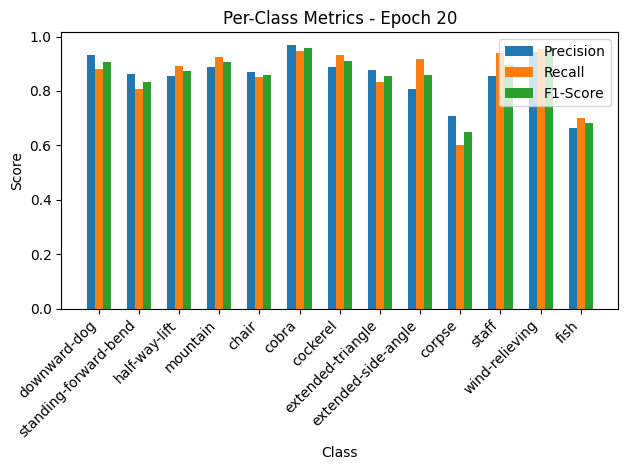

Validation: 100%|██████████| 10/10 [00:00<00:00, 54.69it/s, loss=0.34, accuracy=88.4]


Per-Class Metrics for Epoch 20:
downward-dog: Precision=0.93, Recall=0.88, F1-Score=0.91
standing-forward-bend: Precision=0.86, Recall=0.81, F1-Score=0.83
half-way-lift: Precision=0.85, Recall=0.89, F1-Score=0.87
mountain: Precision=0.89, Recall=0.92, F1-Score=0.91
chair: Precision=0.87, Recall=0.85, F1-Score=0.86
cobra: Precision=0.97, Recall=0.95, F1-Score=0.96
cockerel: Precision=0.89, Recall=0.93, F1-Score=0.91
extended-triangle: Precision=0.88, Recall=0.83, F1-Score=0.85
extended-side-angle: Precision=0.81, Recall=0.92, F1-Score=0.86
corpse: Precision=0.71, Recall=0.60, F1-Score=0.65
staff: Precision=0.85, Recall=0.94, F1-Score=0.90
wind-relieving: Precision=0.94, Recall=0.96, F1-Score=0.95
fish: Precision=0.66, Recall=0.70, F1-Score=0.68


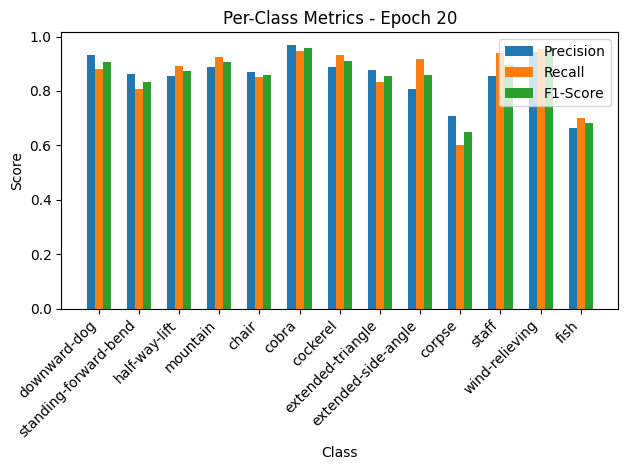


Epoch 21/50 Summary:
Train Loss: 0.4261 | Train Acc: 86.54% | Train Precision: 0.85 | Train Recall: 0.86 | Train F1: 0.86
Val Loss: 0.3730 | Val Acc: 88.36% | Val Precision: 0.90 | Val Recall: 0.89 | Val F1: 0.87

Epoch 22/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 40.01it/s, loss=0.388, accuracy=88.1]


Per-Class Metrics for Epoch 21:
downward-dog: Precision=0.96, Recall=0.93, F1-Score=0.94
standing-forward-bend: Precision=0.93, Recall=0.83, F1-Score=0.88
half-way-lift: Precision=0.86, Recall=0.91, F1-Score=0.88
mountain: Precision=0.88, Recall=0.89, F1-Score=0.89
chair: Precision=0.83, Recall=0.85, F1-Score=0.84
cobra: Precision=0.92, Recall=0.94, F1-Score=0.93
cockerel: Precision=0.89, Recall=0.95, F1-Score=0.92
extended-triangle: Precision=0.93, Recall=0.87, F1-Score=0.90
extended-side-angle: Precision=0.85, Recall=0.92, F1-Score=0.88
corpse: Precision=0.69, Recall=0.68, F1-Score=0.68
staff: Precision=0.87, Recall=0.96, F1-Score=0.91
wind-relieving: Precision=0.96, Recall=0.97, F1-Score=0.96
fish: Precision=0.73, Recall=0.70, F1-Score=0.72


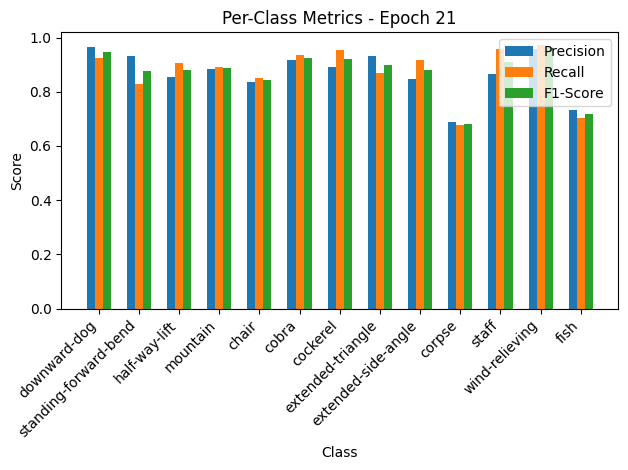

Validation: 100%|██████████| 10/10 [00:00<00:00, 156.29it/s, loss=0.492, accuracy=82.9]


Per-Class Metrics for Epoch 21:
downward-dog: Precision=0.96, Recall=0.93, F1-Score=0.94
standing-forward-bend: Precision=0.93, Recall=0.83, F1-Score=0.88
half-way-lift: Precision=0.86, Recall=0.91, F1-Score=0.88
mountain: Precision=0.88, Recall=0.89, F1-Score=0.89
chair: Precision=0.83, Recall=0.85, F1-Score=0.84
cobra: Precision=0.92, Recall=0.94, F1-Score=0.93
cockerel: Precision=0.89, Recall=0.95, F1-Score=0.92
extended-triangle: Precision=0.93, Recall=0.87, F1-Score=0.90
extended-side-angle: Precision=0.85, Recall=0.92, F1-Score=0.88
corpse: Precision=0.69, Recall=0.68, F1-Score=0.68
staff: Precision=0.87, Recall=0.96, F1-Score=0.91
wind-relieving: Precision=0.96, Recall=0.97, F1-Score=0.96
fish: Precision=0.73, Recall=0.70, F1-Score=0.72


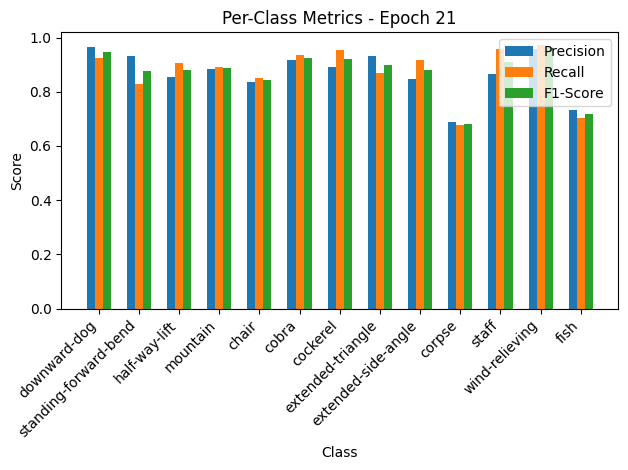


Epoch 22/50 Summary:
Train Loss: 0.3893 | Train Acc: 88.07% | Train Precision: 0.87 | Train Recall: 0.88 | Train F1: 0.87
Val Loss: 0.5391 | Val Acc: 82.88% | Val Precision: 0.87 | Val Recall: 0.85 | Val F1: 0.84

Epoch 23/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:02<00:00, 38.42it/s, loss=0.272, accuracy=91.7]


Per-Class Metrics for Epoch 22:
downward-dog: Precision=0.98, Recall=0.93, F1-Score=0.95
standing-forward-bend: Precision=0.93, Recall=0.83, F1-Score=0.88
half-way-lift: Precision=0.87, Recall=0.94, F1-Score=0.90
mountain: Precision=0.90, Recall=0.96, F1-Score=0.93
chair: Precision=0.90, Recall=0.88, F1-Score=0.89
cobra: Precision=0.92, Recall=0.97, F1-Score=0.94
cockerel: Precision=0.94, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.93, Recall=0.91, F1-Score=0.92
extended-side-angle: Precision=0.92, Recall=0.93, F1-Score=0.93
corpse: Precision=0.91, Recall=0.76, F1-Score=0.83
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.94, Recall=0.97, F1-Score=0.96
fish: Precision=0.78, Recall=0.90, F1-Score=0.83


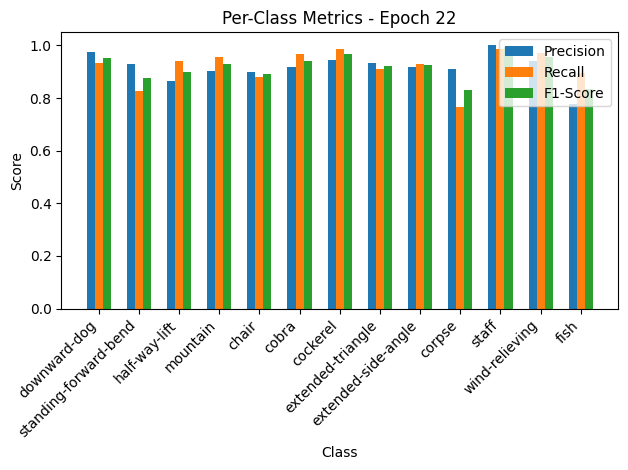

Validation: 100%|██████████| 10/10 [00:00<00:00, 167.03it/s, loss=0.286, accuracy=91.1]


Per-Class Metrics for Epoch 22:
downward-dog: Precision=0.98, Recall=0.93, F1-Score=0.95
standing-forward-bend: Precision=0.93, Recall=0.83, F1-Score=0.88
half-way-lift: Precision=0.87, Recall=0.94, F1-Score=0.90
mountain: Precision=0.90, Recall=0.96, F1-Score=0.93
chair: Precision=0.90, Recall=0.88, F1-Score=0.89
cobra: Precision=0.92, Recall=0.97, F1-Score=0.94
cockerel: Precision=0.94, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.93, Recall=0.91, F1-Score=0.92
extended-side-angle: Precision=0.92, Recall=0.93, F1-Score=0.93
corpse: Precision=0.91, Recall=0.76, F1-Score=0.83
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.94, Recall=0.97, F1-Score=0.96
fish: Precision=0.78, Recall=0.90, F1-Score=0.83


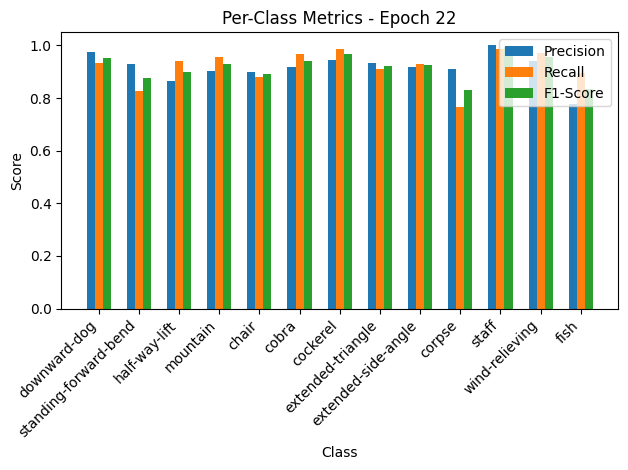


Epoch 23/50 Summary:
Train Loss: 0.2729 | Train Acc: 91.74% | Train Precision: 0.92 | Train Recall: 0.92 | Train F1: 0.92
Val Loss: 0.3134 | Val Acc: 91.10% | Val Precision: 0.93 | Val Recall: 0.91 | Val F1: 0.90
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_0.pth
Checkpoint saved at epoch 23
New best model saved! Validation Loss: 0.3134

Epoch 24/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:02<00:00, 36.27it/s, loss=0.245, accuracy=92.3]


Per-Class Metrics for Epoch 23:
downward-dog: Precision=0.98, Recall=0.93, F1-Score=0.95
standing-forward-bend: Precision=0.94, Recall=0.85, F1-Score=0.89
half-way-lift: Precision=0.86, Recall=0.95, F1-Score=0.90
mountain: Precision=0.93, Recall=0.96, F1-Score=0.94
chair: Precision=0.93, Recall=0.90, F1-Score=0.91
cobra: Precision=0.94, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.95, Recall=0.98, F1-Score=0.97
extended-triangle: Precision=0.95, Recall=0.91, F1-Score=0.93
extended-side-angle: Precision=0.90, Recall=0.96, F1-Score=0.93
corpse: Precision=0.86, Recall=0.75, F1-Score=0.80
staff: Precision=0.99, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.78, Recall=0.90, F1-Score=0.83


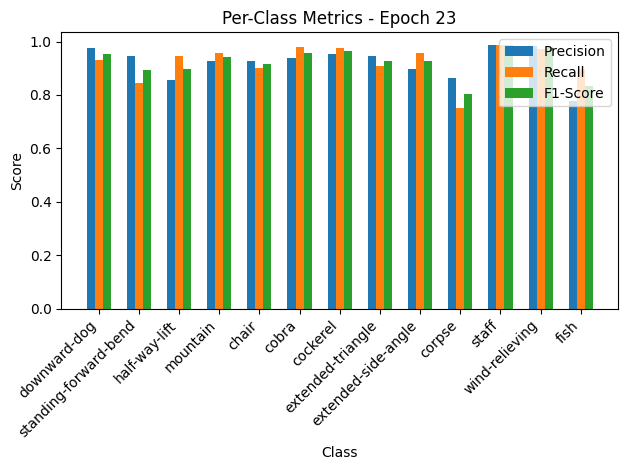

Validation: 100%|██████████| 10/10 [00:00<00:00, 165.38it/s, loss=0.267, accuracy=91.8]


Per-Class Metrics for Epoch 23:
downward-dog: Precision=0.98, Recall=0.93, F1-Score=0.95
standing-forward-bend: Precision=0.94, Recall=0.85, F1-Score=0.89
half-way-lift: Precision=0.86, Recall=0.95, F1-Score=0.90
mountain: Precision=0.93, Recall=0.96, F1-Score=0.94
chair: Precision=0.93, Recall=0.90, F1-Score=0.91
cobra: Precision=0.94, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.95, Recall=0.98, F1-Score=0.97
extended-triangle: Precision=0.95, Recall=0.91, F1-Score=0.93
extended-side-angle: Precision=0.90, Recall=0.96, F1-Score=0.93
corpse: Precision=0.86, Recall=0.75, F1-Score=0.80
staff: Precision=0.99, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.78, Recall=0.90, F1-Score=0.83


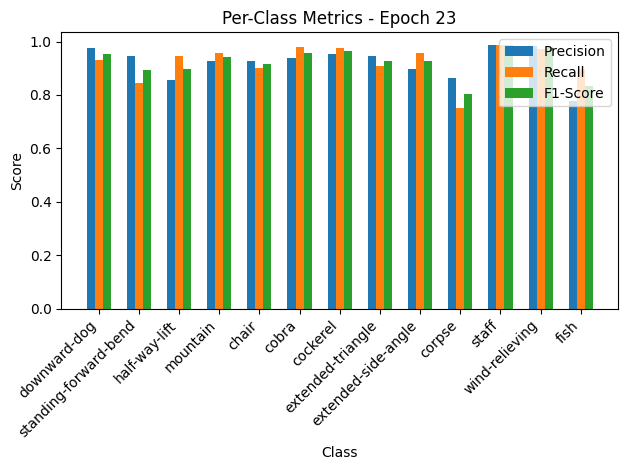


Epoch 24/50 Summary:
Train Loss: 0.2462 | Train Acc: 92.28% | Train Precision: 0.92 | Train Recall: 0.92 | Train F1: 0.92
Val Loss: 0.2928 | Val Acc: 91.78% | Val Precision: 0.93 | Val Recall: 0.92 | Val F1: 0.92
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_0.pth
Checkpoint saved at epoch 24
New best model saved! Validation Loss: 0.2928

Epoch 25/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:02<00:00, 39.75it/s, loss=0.235, accuracy=92.4]


Per-Class Metrics for Epoch 24:
downward-dog: Precision=0.98, Recall=0.92, F1-Score=0.95
standing-forward-bend: Precision=0.94, Recall=0.86, F1-Score=0.90
half-way-lift: Precision=0.86, Recall=0.93, F1-Score=0.89
mountain: Precision=0.91, Recall=0.97, F1-Score=0.93
chair: Precision=0.94, Recall=0.90, F1-Score=0.92
cobra: Precision=0.93, Recall=0.99, F1-Score=0.96
cockerel: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=0.92, F1-Score=0.93
extended-side-angle: Precision=0.91, Recall=0.95, F1-Score=0.93
corpse: Precision=0.84, Recall=0.82, F1-Score=0.83
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.96, Recall=0.97, F1-Score=0.96
fish: Precision=0.85, Recall=0.82, F1-Score=0.83


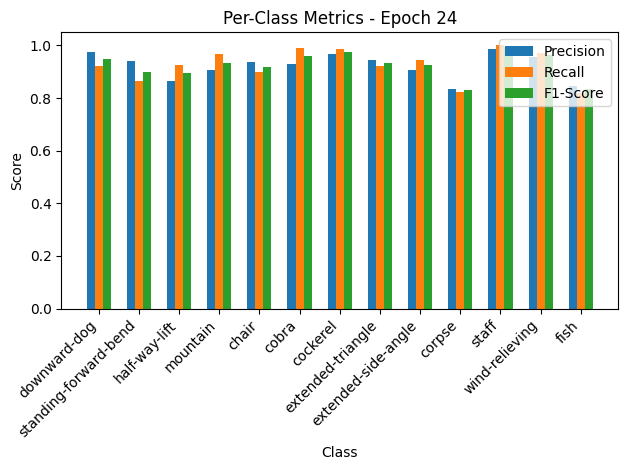

Validation: 100%|██████████| 10/10 [00:00<00:00, 161.75it/s, loss=0.244, accuracy=91.8]


Per-Class Metrics for Epoch 24:
downward-dog: Precision=0.98, Recall=0.92, F1-Score=0.95
standing-forward-bend: Precision=0.94, Recall=0.86, F1-Score=0.90
half-way-lift: Precision=0.86, Recall=0.93, F1-Score=0.89
mountain: Precision=0.91, Recall=0.97, F1-Score=0.93
chair: Precision=0.94, Recall=0.90, F1-Score=0.92
cobra: Precision=0.93, Recall=0.99, F1-Score=0.96
cockerel: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=0.92, F1-Score=0.93
extended-side-angle: Precision=0.91, Recall=0.95, F1-Score=0.93
corpse: Precision=0.84, Recall=0.82, F1-Score=0.83
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.96, Recall=0.97, F1-Score=0.96
fish: Precision=0.85, Recall=0.82, F1-Score=0.83


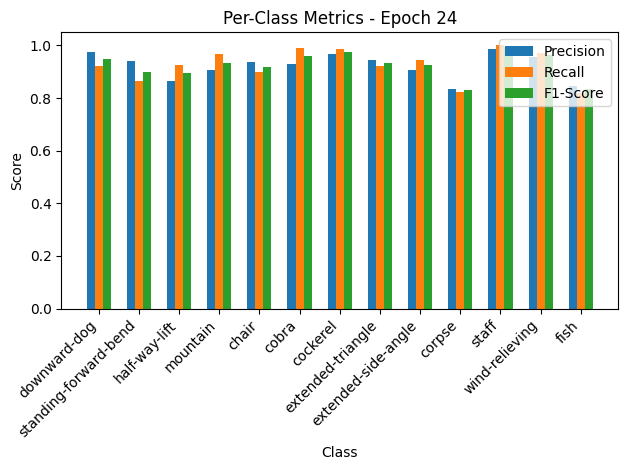


Epoch 25/50 Summary:
Train Loss: 0.2357 | Train Acc: 92.43% | Train Precision: 0.92 | Train Recall: 0.93 | Train F1: 0.92
Val Loss: 0.2673 | Val Acc: 91.78% | Val Precision: 0.94 | Val Recall: 0.93 | Val F1: 0.93
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_0.pth
Checkpoint saved at epoch 25
New best model saved! Validation Loss: 0.2673

Epoch 26/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:01<00:00, 41.83it/s, loss=0.21, accuracy=94.6]


Per-Class Metrics for Epoch 25:
downward-dog: Precision=0.97, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.89, F1-Score=0.92
half-way-lift: Precision=0.90, Recall=0.93, F1-Score=0.92
mountain: Precision=0.93, Recall=0.98, F1-Score=0.96
chair: Precision=0.96, Recall=0.90, F1-Score=0.93
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.95, Recall=1.00, F1-Score=0.97
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.88, Recall=0.87, F1-Score=0.87
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.87, Recall=0.87, F1-Score=0.87


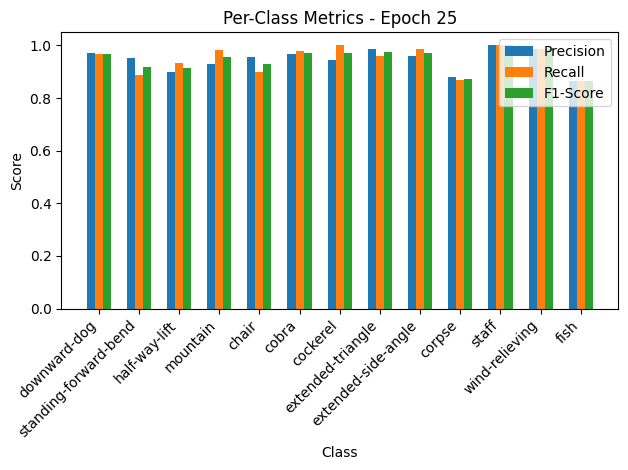

Validation: 100%|██████████| 10/10 [00:00<00:00, 179.56it/s, loss=0.256, accuracy=92.5]


Per-Class Metrics for Epoch 25:
downward-dog: Precision=0.97, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.89, F1-Score=0.92
half-way-lift: Precision=0.90, Recall=0.93, F1-Score=0.92
mountain: Precision=0.93, Recall=0.98, F1-Score=0.96
chair: Precision=0.96, Recall=0.90, F1-Score=0.93
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.95, Recall=1.00, F1-Score=0.97
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.88, Recall=0.87, F1-Score=0.87
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.87, Recall=0.87, F1-Score=0.87


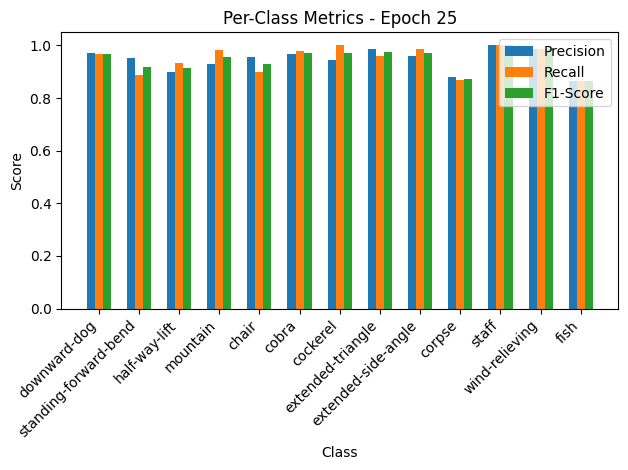


Epoch 26/50 Summary:
Train Loss: 0.2108 | Train Acc: 94.57% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.2801 | Val Acc: 92.47% | Val Precision: 0.94 | Val Recall: 0.93 | Val F1: 0.93

Epoch 27/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:01<00:00, 42.78it/s, loss=0.228, accuracy=92.9]


Per-Class Metrics for Epoch 26:
downward-dog: Precision=0.99, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.92, Recall=0.88, F1-Score=0.90
half-way-lift: Precision=0.88, Recall=0.92, F1-Score=0.90
mountain: Precision=0.92, Recall=0.97, F1-Score=0.94
chair: Precision=0.94, Recall=0.90, F1-Score=0.92
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.92, Recall=0.98, F1-Score=0.95
extended-triangle: Precision=0.97, Recall=0.91, F1-Score=0.94
extended-side-angle: Precision=0.92, Recall=0.99, F1-Score=0.95
corpse: Precision=0.83, Recall=0.81, F1-Score=0.82
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.96, Recall=0.97, F1-Score=0.96
fish: Precision=0.82, Recall=0.82, F1-Score=0.82


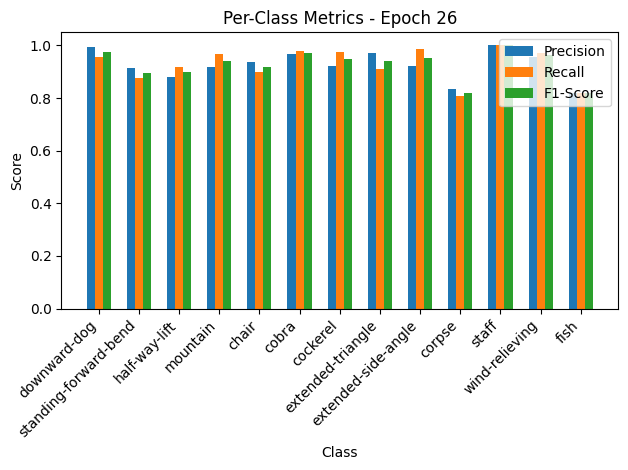

Validation: 100%|██████████| 10/10 [00:00<00:00, 136.18it/s, loss=0.248, accuracy=92.5]


Per-Class Metrics for Epoch 26:
downward-dog: Precision=0.99, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.92, Recall=0.88, F1-Score=0.90
half-way-lift: Precision=0.88, Recall=0.92, F1-Score=0.90
mountain: Precision=0.92, Recall=0.97, F1-Score=0.94
chair: Precision=0.94, Recall=0.90, F1-Score=0.92
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.92, Recall=0.98, F1-Score=0.95
extended-triangle: Precision=0.97, Recall=0.91, F1-Score=0.94
extended-side-angle: Precision=0.92, Recall=0.99, F1-Score=0.95
corpse: Precision=0.83, Recall=0.81, F1-Score=0.82
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.96, Recall=0.97, F1-Score=0.96
fish: Precision=0.82, Recall=0.82, F1-Score=0.82


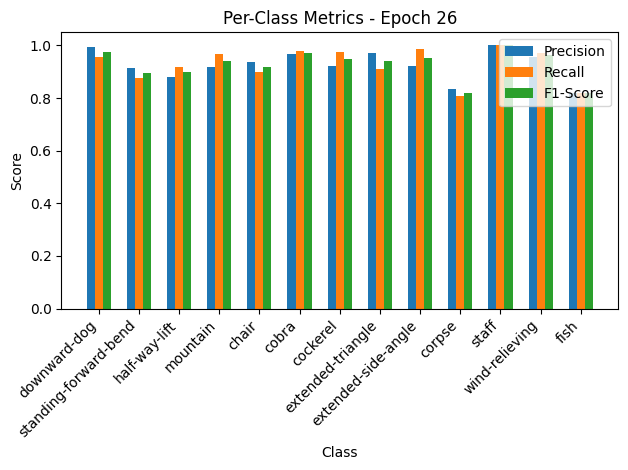


Epoch 27/50 Summary:
Train Loss: 0.2282 | Train Acc: 92.89% | Train Precision: 0.93 | Train Recall: 0.93 | Train F1: 0.93
Val Loss: 0.2713 | Val Acc: 92.47% | Val Precision: 0.94 | Val Recall: 0.93 | Val F1: 0.93

Epoch 28/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:02<00:00, 33.55it/s, loss=0.221, accuracy=92.3]


Per-Class Metrics for Epoch 27:
downward-dog: Precision=0.96, Recall=0.95, F1-Score=0.95
standing-forward-bend: Precision=0.94, Recall=0.85, F1-Score=0.89
half-way-lift: Precision=0.89, Recall=0.93, F1-Score=0.91
mountain: Precision=0.91, Recall=0.97, F1-Score=0.93
chair: Precision=0.91, Recall=0.89, F1-Score=0.90
cobra: Precision=0.95, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.94, Recall=0.97, F1-Score=0.95
extended-triangle: Precision=0.99, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.92, Recall=0.99, F1-Score=0.95
corpse: Precision=0.86, Recall=0.72, F1-Score=0.78
staff: Precision=0.99, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=0.97, F1-Score=0.97
fish: Precision=0.75, Recall=0.85, F1-Score=0.80


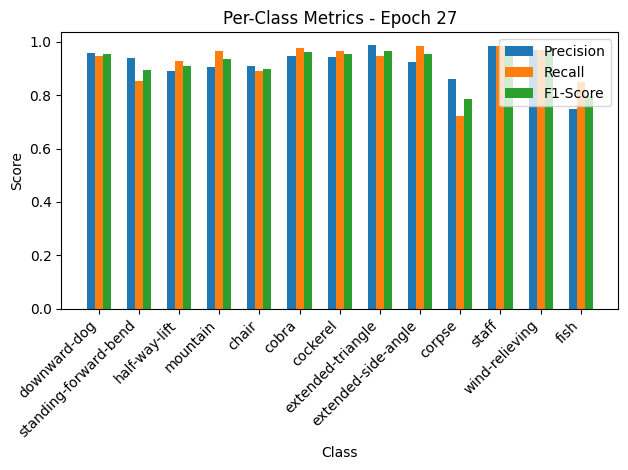

Validation: 100%|██████████| 10/10 [00:00<00:00, 156.85it/s, loss=0.235, accuracy=95.2]


Per-Class Metrics for Epoch 27:
downward-dog: Precision=0.96, Recall=0.95, F1-Score=0.95
standing-forward-bend: Precision=0.94, Recall=0.85, F1-Score=0.89
half-way-lift: Precision=0.89, Recall=0.93, F1-Score=0.91
mountain: Precision=0.91, Recall=0.97, F1-Score=0.93
chair: Precision=0.91, Recall=0.89, F1-Score=0.90
cobra: Precision=0.95, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.94, Recall=0.97, F1-Score=0.95
extended-triangle: Precision=0.99, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.92, Recall=0.99, F1-Score=0.95
corpse: Precision=0.86, Recall=0.72, F1-Score=0.78
staff: Precision=0.99, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=0.97, F1-Score=0.97
fish: Precision=0.75, Recall=0.85, F1-Score=0.80


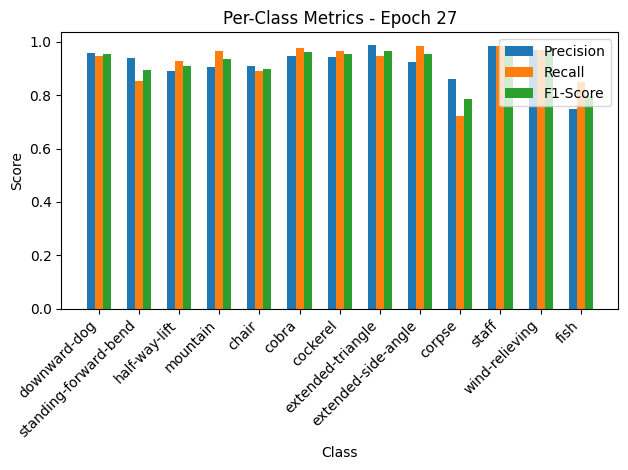


Epoch 28/50 Summary:
Train Loss: 0.2220 | Train Acc: 92.28% | Train Precision: 0.92 | Train Recall: 0.92 | Train F1: 0.92
Val Loss: 0.2572 | Val Acc: 95.21% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_0.pth
Checkpoint saved at epoch 28
New best model saved! Validation Loss: 0.2572

Epoch 29/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:02<00:00, 39.23it/s, loss=0.204, accuracy=94.2]


Per-Class Metrics for Epoch 28:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.94, Recall=0.90, F1-Score=0.92
half-way-lift: Precision=0.92, Recall=0.93, F1-Score=0.92
mountain: Precision=0.91, Recall=0.97, F1-Score=0.94
chair: Precision=0.94, Recall=0.91, F1-Score=0.92
cobra: Precision=0.98, Recall=0.97, F1-Score=0.97
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.86, Recall=0.81, F1-Score=0.83
staff: Precision=0.96, Recall=1.00, F1-Score=0.98
wind-relieving: Precision=1.00, Recall=0.97, F1-Score=0.99
fish: Precision=0.84, Recall=0.88, F1-Score=0.86


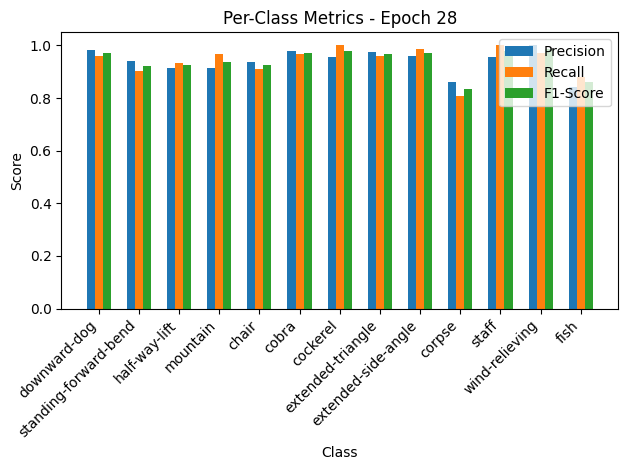

Validation: 100%|██████████| 10/10 [00:00<00:00, 165.20it/s, loss=0.264, accuracy=92.5]


Per-Class Metrics for Epoch 28:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.94, Recall=0.90, F1-Score=0.92
half-way-lift: Precision=0.92, Recall=0.93, F1-Score=0.92
mountain: Precision=0.91, Recall=0.97, F1-Score=0.94
chair: Precision=0.94, Recall=0.91, F1-Score=0.92
cobra: Precision=0.98, Recall=0.97, F1-Score=0.97
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.86, Recall=0.81, F1-Score=0.83
staff: Precision=0.96, Recall=1.00, F1-Score=0.98
wind-relieving: Precision=1.00, Recall=0.97, F1-Score=0.99
fish: Precision=0.84, Recall=0.88, F1-Score=0.86


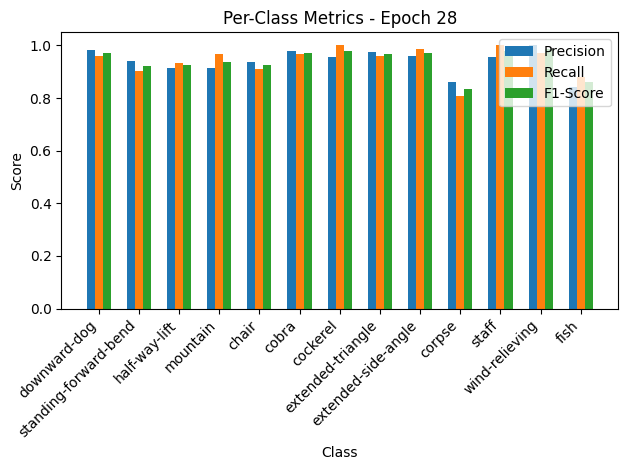


Epoch 29/50 Summary:
Train Loss: 0.2042 | Train Acc: 94.19% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.2895 | Val Acc: 92.47% | Val Precision: 0.94 | Val Recall: 0.93 | Val F1: 0.93

Epoch 30/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:01<00:00, 42.33it/s, loss=0.222, accuracy=93]


Per-Class Metrics for Epoch 29:
downward-dog: Precision=0.97, Recall=0.94, F1-Score=0.96
standing-forward-bend: Precision=0.93, Recall=0.88, F1-Score=0.90
half-way-lift: Precision=0.88, Recall=0.91, F1-Score=0.90
mountain: Precision=0.92, Recall=0.94, F1-Score=0.93
chair: Precision=0.91, Recall=0.93, F1-Score=0.92
cobra: Precision=0.96, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.94, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.97, Recall=0.94, F1-Score=0.95
extended-side-angle: Precision=0.93, Recall=0.96, F1-Score=0.95
corpse: Precision=0.86, Recall=0.82, F1-Score=0.84
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=0.97, F1-Score=0.97
fish: Precision=0.84, Recall=0.85, F1-Score=0.84


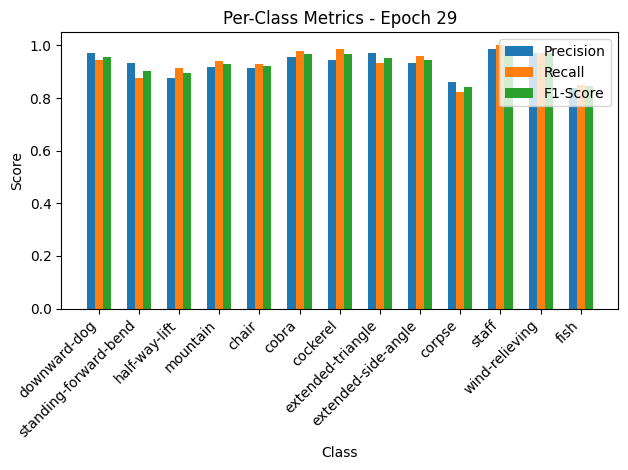

Validation: 100%|██████████| 10/10 [00:00<00:00, 164.54it/s, loss=0.229, accuracy=94.5]


Per-Class Metrics for Epoch 29:
downward-dog: Precision=0.97, Recall=0.94, F1-Score=0.96
standing-forward-bend: Precision=0.93, Recall=0.88, F1-Score=0.90
half-way-lift: Precision=0.88, Recall=0.91, F1-Score=0.90
mountain: Precision=0.92, Recall=0.94, F1-Score=0.93
chair: Precision=0.91, Recall=0.93, F1-Score=0.92
cobra: Precision=0.96, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.94, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.97, Recall=0.94, F1-Score=0.95
extended-side-angle: Precision=0.93, Recall=0.96, F1-Score=0.95
corpse: Precision=0.86, Recall=0.82, F1-Score=0.84
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=0.97, F1-Score=0.97
fish: Precision=0.84, Recall=0.85, F1-Score=0.84


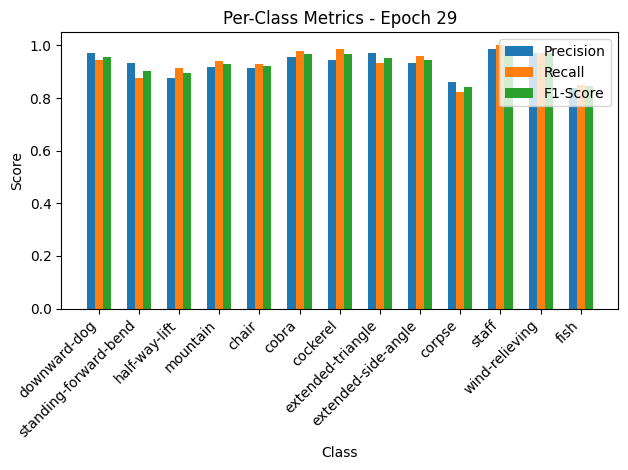


Epoch 30/50 Summary:
Train Loss: 0.2229 | Train Acc: 92.97% | Train Precision: 0.93 | Train Recall: 0.93 | Train F1: 0.93
Val Loss: 0.2511 | Val Acc: 94.52% | Val Precision: 0.96 | Val Recall: 0.95 | Val F1: 0.95
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_0.pth
Checkpoint saved at epoch 30
New best model saved! Validation Loss: 0.2511

Epoch 31/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:01<00:00, 41.39it/s, loss=0.215, accuracy=93.7]


Per-Class Metrics for Epoch 30:
downward-dog: Precision=0.98, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.92, Recall=0.90, F1-Score=0.91
half-way-lift: Precision=0.92, Recall=0.91, F1-Score=0.92
mountain: Precision=0.92, Recall=0.97, F1-Score=0.94
chair: Precision=0.93, Recall=0.92, F1-Score=0.93
cobra: Precision=0.95, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.92, F1-Score=0.96
extended-side-angle: Precision=0.91, Recall=1.00, F1-Score=0.95
corpse: Precision=0.86, Recall=0.84, F1-Score=0.85
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=0.97, F1-Score=0.97
fish: Precision=0.84, Recall=0.84, F1-Score=0.84


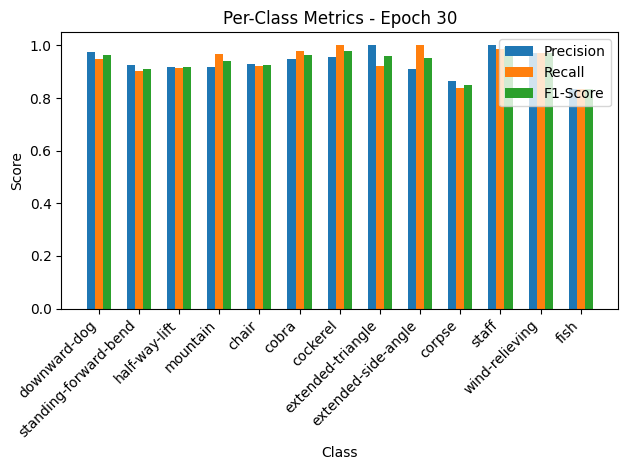

Validation: 100%|██████████| 10/10 [00:00<00:00, 164.66it/s, loss=0.243, accuracy=93.8]


Per-Class Metrics for Epoch 30:
downward-dog: Precision=0.98, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.92, Recall=0.90, F1-Score=0.91
half-way-lift: Precision=0.92, Recall=0.91, F1-Score=0.92
mountain: Precision=0.92, Recall=0.97, F1-Score=0.94
chair: Precision=0.93, Recall=0.92, F1-Score=0.93
cobra: Precision=0.95, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.92, F1-Score=0.96
extended-side-angle: Precision=0.91, Recall=1.00, F1-Score=0.95
corpse: Precision=0.86, Recall=0.84, F1-Score=0.85
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=0.97, F1-Score=0.97
fish: Precision=0.84, Recall=0.84, F1-Score=0.84


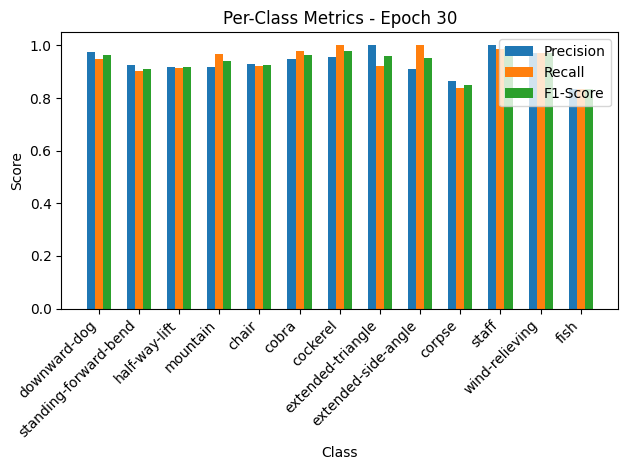


Epoch 31/50 Summary:
Train Loss: 0.2161 | Train Acc: 93.65% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.2663 | Val Acc: 93.84% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 32/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:02<00:00, 30.66it/s, loss=0.209, accuracy=93.8]


Per-Class Metrics for Epoch 31:
downward-dog: Precision=0.97, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.95, Recall=0.89, F1-Score=0.92
half-way-lift: Precision=0.91, Recall=0.94, F1-Score=0.92
mountain: Precision=0.91, Recall=0.96, F1-Score=0.93
chair: Precision=0.94, Recall=0.90, F1-Score=0.92
cobra: Precision=0.95, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.97, F1-Score=0.97
corpse: Precision=0.87, Recall=0.81, F1-Score=0.84
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.82, Recall=0.87, F1-Score=0.84


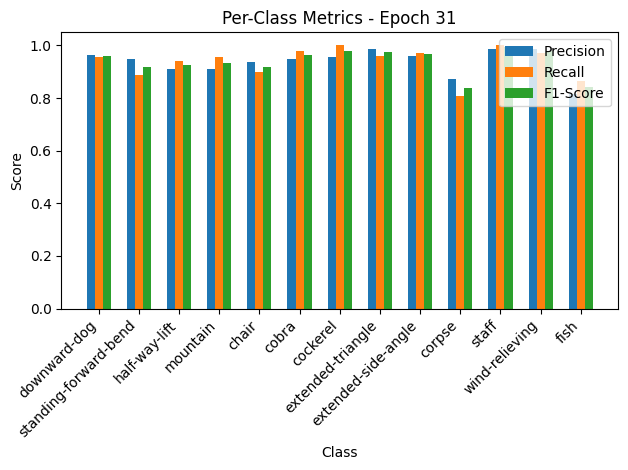

Validation: 100%|██████████| 10/10 [00:00<00:00, 181.57it/s, loss=0.247, accuracy=93.8]


Per-Class Metrics for Epoch 31:
downward-dog: Precision=0.97, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.95, Recall=0.89, F1-Score=0.92
half-way-lift: Precision=0.91, Recall=0.94, F1-Score=0.92
mountain: Precision=0.91, Recall=0.96, F1-Score=0.93
chair: Precision=0.94, Recall=0.90, F1-Score=0.92
cobra: Precision=0.95, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.97, F1-Score=0.97
corpse: Precision=0.87, Recall=0.81, F1-Score=0.84
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.82, Recall=0.87, F1-Score=0.84


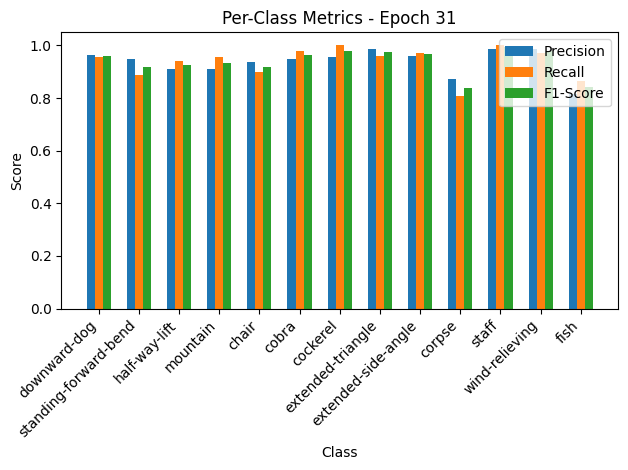


Epoch 32/50 Summary:
Train Loss: 0.2097 | Train Acc: 93.81% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.2705 | Val Acc: 93.84% | Val Precision: 0.95 | Val Recall: 0.94 | Val F1: 0.94

Epoch 33/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:02<00:00, 37.29it/s, loss=0.196, accuracy=94.4]


Per-Class Metrics for Epoch 32:
downward-dog: Precision=0.98, Recall=0.94, F1-Score=0.96
standing-forward-bend: Precision=0.94, Recall=0.91, F1-Score=0.93
half-way-lift: Precision=0.92, Recall=0.95, F1-Score=0.93
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.94, Recall=0.90, F1-Score=0.92
cobra: Precision=0.98, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.91, Recall=0.99, F1-Score=0.95
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.88, Recall=0.85, F1-Score=0.87
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.85, Recall=0.87, F1-Score=0.86


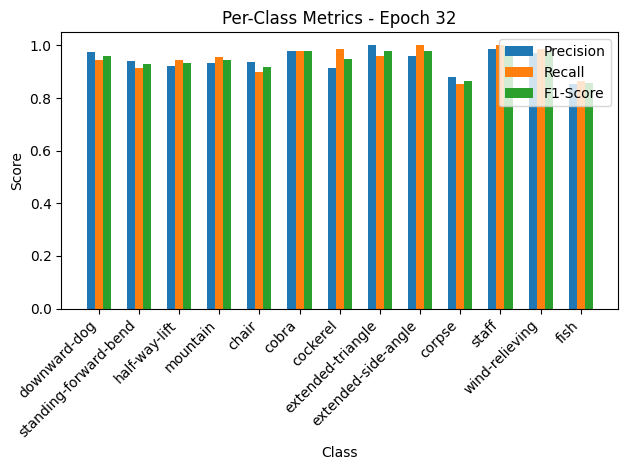

Validation: 100%|██████████| 10/10 [00:00<00:00, 184.03it/s, loss=0.287, accuracy=89.7]


Per-Class Metrics for Epoch 32:
downward-dog: Precision=0.98, Recall=0.94, F1-Score=0.96
standing-forward-bend: Precision=0.94, Recall=0.91, F1-Score=0.93
half-way-lift: Precision=0.92, Recall=0.95, F1-Score=0.93
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.94, Recall=0.90, F1-Score=0.92
cobra: Precision=0.98, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.91, Recall=0.99, F1-Score=0.95
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.88, Recall=0.85, F1-Score=0.87
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.85, Recall=0.87, F1-Score=0.86


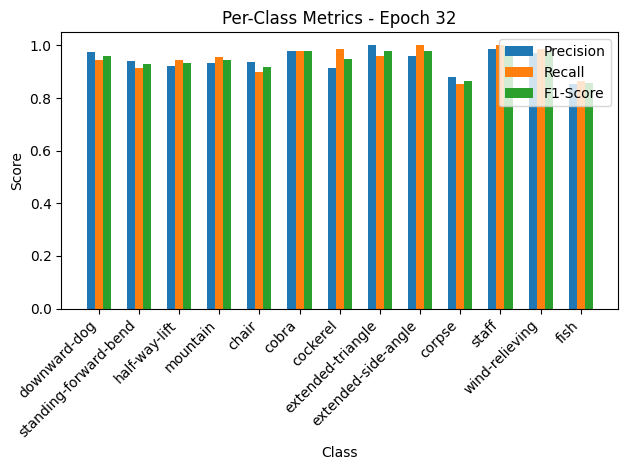


Epoch 33/50 Summary:
Train Loss: 0.1962 | Train Acc: 94.42% | Train Precision: 0.94 | Train Recall: 0.95 | Train F1: 0.94
Val Loss: 0.3150 | Val Acc: 89.73% | Val Precision: 0.92 | Val Recall: 0.91 | Val F1: 0.90

Epoch 34/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:01<00:00, 43.46it/s, loss=0.208, accuracy=94]


Per-Class Metrics for Epoch 33:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.94, Recall=0.88, F1-Score=0.91
half-way-lift: Precision=0.88, Recall=0.94, F1-Score=0.91
mountain: Precision=0.94, Recall=0.97, F1-Score=0.96
chair: Precision=0.95, Recall=0.92, F1-Score=0.93
cobra: Precision=0.98, Recall=0.97, F1-Score=0.97
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.95, Recall=0.96, F1-Score=0.95
extended-side-angle: Precision=0.94, Recall=0.93, F1-Score=0.94
corpse: Precision=0.84, Recall=0.85, F1-Score=0.85
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.86, Recall=0.82, F1-Score=0.84


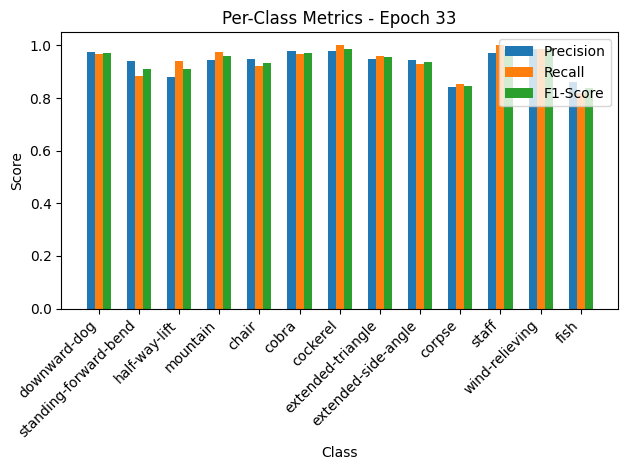

Validation: 100%|██████████| 10/10 [00:00<00:00, 186.06it/s, loss=0.243, accuracy=92.5]


Per-Class Metrics for Epoch 33:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.94, Recall=0.88, F1-Score=0.91
half-way-lift: Precision=0.88, Recall=0.94, F1-Score=0.91
mountain: Precision=0.94, Recall=0.97, F1-Score=0.96
chair: Precision=0.95, Recall=0.92, F1-Score=0.93
cobra: Precision=0.98, Recall=0.97, F1-Score=0.97
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.95, Recall=0.96, F1-Score=0.95
extended-side-angle: Precision=0.94, Recall=0.93, F1-Score=0.94
corpse: Precision=0.84, Recall=0.85, F1-Score=0.85
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.86, Recall=0.82, F1-Score=0.84


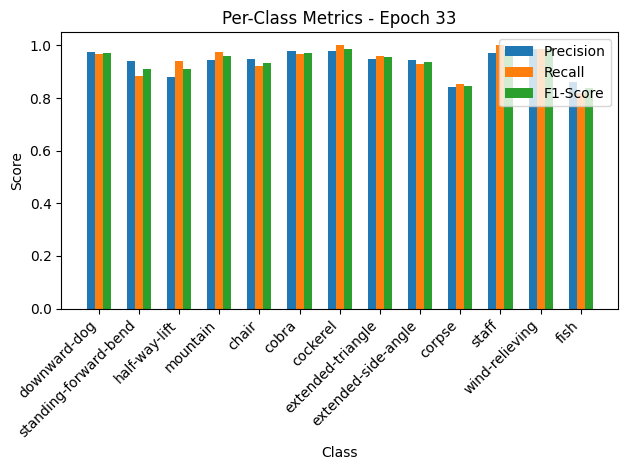


Epoch 34/50 Summary:
Train Loss: 0.2087 | Train Acc: 93.96% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.2665 | Val Acc: 92.47% | Val Precision: 0.94 | Val Recall: 0.93 | Val F1: 0.93

Epoch 35/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:01<00:00, 42.19it/s, loss=0.215, accuracy=93.2]


Per-Class Metrics for Epoch 34:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.96, Recall=0.88, F1-Score=0.92
half-way-lift: Precision=0.88, Recall=0.95, F1-Score=0.91
mountain: Precision=0.89, Recall=0.96, F1-Score=0.92
chair: Precision=0.95, Recall=0.87, F1-Score=0.91
cobra: Precision=0.96, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.96, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.97, Recall=0.95, F1-Score=0.96
extended-side-angle: Precision=0.95, Recall=0.97, F1-Score=0.96
corpse: Precision=0.81, Recall=0.84, F1-Score=0.83
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.96, Recall=0.97, F1-Score=0.96
fish: Precision=0.84, Recall=0.79, F1-Score=0.82


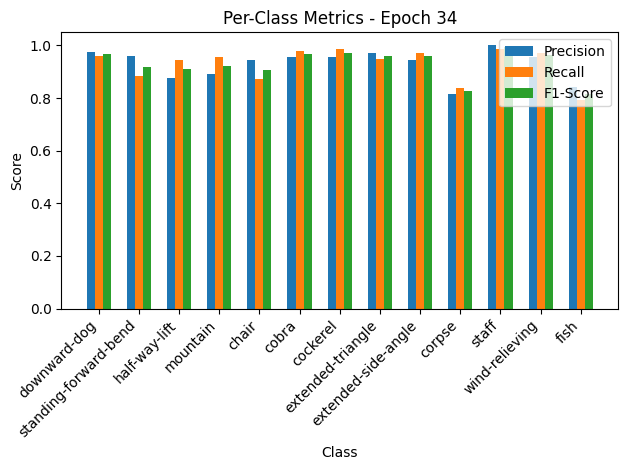

Validation: 100%|██████████| 10/10 [00:00<00:00, 151.91it/s, loss=0.283, accuracy=91.1]


Per-Class Metrics for Epoch 34:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.96, Recall=0.88, F1-Score=0.92
half-way-lift: Precision=0.88, Recall=0.95, F1-Score=0.91
mountain: Precision=0.89, Recall=0.96, F1-Score=0.92
chair: Precision=0.95, Recall=0.87, F1-Score=0.91
cobra: Precision=0.96, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.96, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.97, Recall=0.95, F1-Score=0.96
extended-side-angle: Precision=0.95, Recall=0.97, F1-Score=0.96
corpse: Precision=0.81, Recall=0.84, F1-Score=0.83
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.96, Recall=0.97, F1-Score=0.96
fish: Precision=0.84, Recall=0.79, F1-Score=0.82


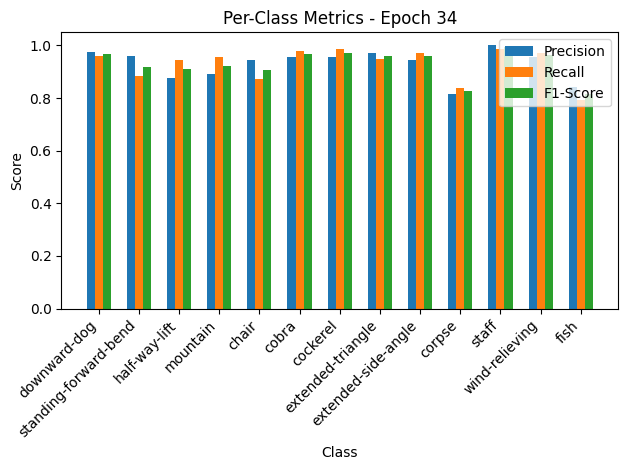


Epoch 35/50 Summary:
Train Loss: 0.2161 | Train Acc: 93.20% | Train Precision: 0.93 | Train Recall: 0.93 | Train F1: 0.93
Val Loss: 0.3102 | Val Acc: 91.10% | Val Precision: 0.92 | Val Recall: 0.91 | Val F1: 0.91

Epoch 36/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:02<00:00, 38.77it/s, loss=0.225, accuracy=93.8]


Per-Class Metrics for Epoch 35:
downward-dog: Precision=0.97, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.87, F1-Score=0.91
half-way-lift: Precision=0.88, Recall=0.94, F1-Score=0.91
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.94, Recall=0.93, F1-Score=0.94
cobra: Precision=0.97, Recall=0.94, F1-Score=0.95
cockerel: Precision=0.92, Recall=0.98, F1-Score=0.95
extended-triangle: Precision=0.94, Recall=0.96, F1-Score=0.95
extended-side-angle: Precision=0.96, Recall=0.93, F1-Score=0.94
corpse: Precision=0.92, Recall=0.84, F1-Score=0.88
staff: Precision=0.97, Recall=0.99, F1-Score=0.98
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.85, Recall=0.93, F1-Score=0.89


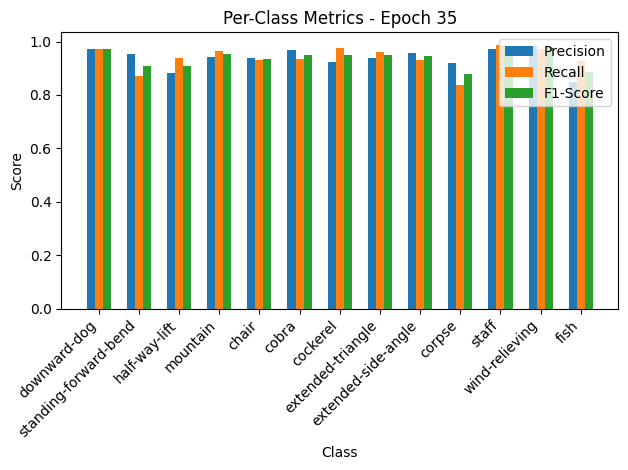

Validation: 100%|██████████| 10/10 [00:00<00:00, 145.11it/s, loss=0.261, accuracy=91.8]


Per-Class Metrics for Epoch 35:
downward-dog: Precision=0.97, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.87, F1-Score=0.91
half-way-lift: Precision=0.88, Recall=0.94, F1-Score=0.91
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.94, Recall=0.93, F1-Score=0.94
cobra: Precision=0.97, Recall=0.94, F1-Score=0.95
cockerel: Precision=0.92, Recall=0.98, F1-Score=0.95
extended-triangle: Precision=0.94, Recall=0.96, F1-Score=0.95
extended-side-angle: Precision=0.96, Recall=0.93, F1-Score=0.94
corpse: Precision=0.92, Recall=0.84, F1-Score=0.88
staff: Precision=0.97, Recall=0.99, F1-Score=0.98
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.85, Recall=0.93, F1-Score=0.89


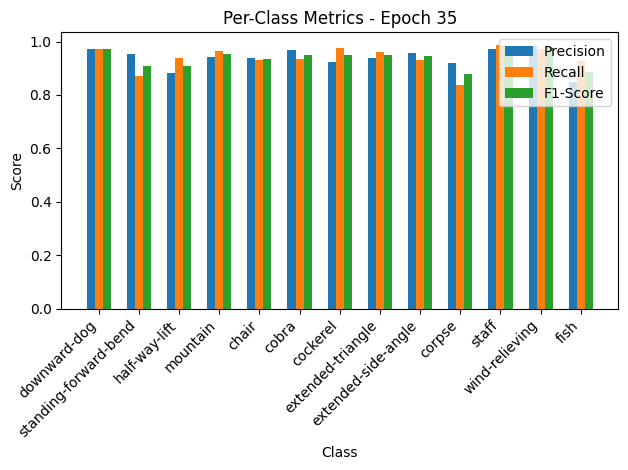


Epoch 36/50 Summary:
Train Loss: 0.2252 | Train Acc: 93.81% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.2858 | Val Acc: 91.78% | Val Precision: 0.94 | Val Recall: 0.93 | Val F1: 0.92

Epoch 37/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:02<00:00, 33.71it/s, loss=0.183, accuracy=95.1]


Per-Class Metrics for Epoch 36:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.96, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.92, Recall=0.95, F1-Score=0.93
mountain: Precision=0.93, Recall=0.99, F1-Score=0.96
chair: Precision=0.98, Recall=0.92, F1-Score=0.95
cobra: Precision=0.98, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.96, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.97, Recall=0.95, F1-Score=0.96
extended-side-angle: Precision=0.95, Recall=0.97, F1-Score=0.96
corpse: Precision=0.93, Recall=0.79, F1-Score=0.86
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.84, Recall=0.96, F1-Score=0.90


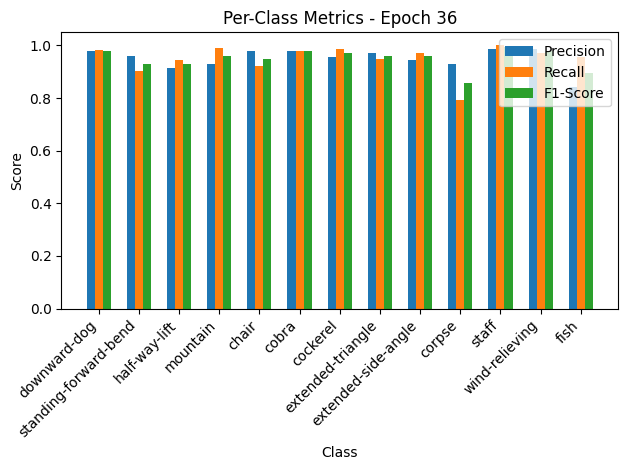

Validation: 100%|██████████| 10/10 [00:00<00:00, 152.11it/s, loss=0.246, accuracy=92.5]


Per-Class Metrics for Epoch 36:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.96, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.92, Recall=0.95, F1-Score=0.93
mountain: Precision=0.93, Recall=0.99, F1-Score=0.96
chair: Precision=0.98, Recall=0.92, F1-Score=0.95
cobra: Precision=0.98, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.96, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.97, Recall=0.95, F1-Score=0.96
extended-side-angle: Precision=0.95, Recall=0.97, F1-Score=0.96
corpse: Precision=0.93, Recall=0.79, F1-Score=0.86
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.84, Recall=0.96, F1-Score=0.90


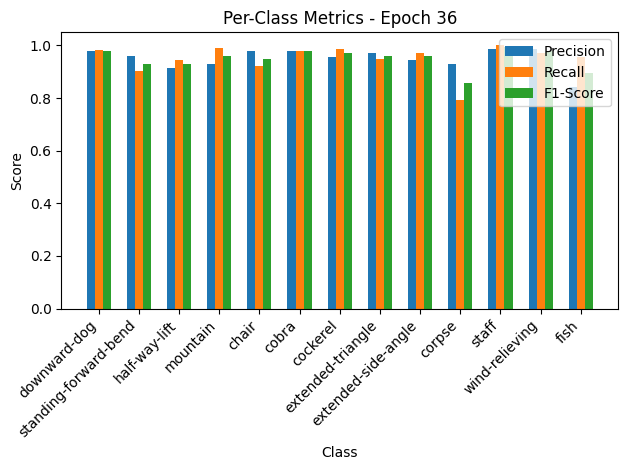


Epoch 37/50 Summary:
Train Loss: 0.1837 | Train Acc: 95.11% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.2698 | Val Acc: 92.47% | Val Precision: 0.94 | Val Recall: 0.93 | Val F1: 0.93

Epoch 38/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:01<00:00, 41.69it/s, loss=0.176, accuracy=95]


Per-Class Metrics for Epoch 37:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.94, Recall=0.92, F1-Score=0.93
half-way-lift: Precision=0.93, Recall=0.93, F1-Score=0.93
mountain: Precision=0.93, Recall=0.99, F1-Score=0.96
chair: Precision=0.99, Recall=0.92, F1-Score=0.95
cobra: Precision=0.95, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.87, Recall=0.85, F1-Score=0.86
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.85, Recall=0.84, F1-Score=0.84


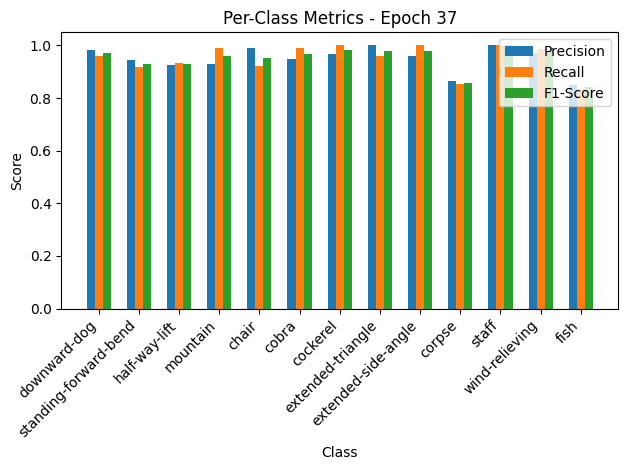

Validation: 100%|██████████| 10/10 [00:00<00:00, 177.28it/s, loss=0.249, accuracy=91.8]


Per-Class Metrics for Epoch 37:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.94, Recall=0.92, F1-Score=0.93
half-way-lift: Precision=0.93, Recall=0.93, F1-Score=0.93
mountain: Precision=0.93, Recall=0.99, F1-Score=0.96
chair: Precision=0.99, Recall=0.92, F1-Score=0.95
cobra: Precision=0.95, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.87, Recall=0.85, F1-Score=0.86
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.85, Recall=0.84, F1-Score=0.84


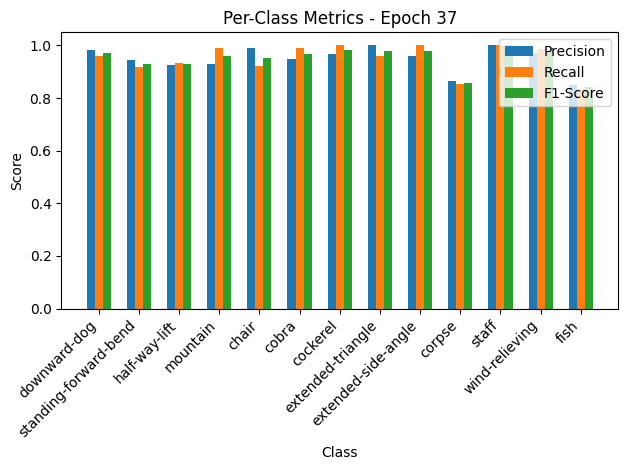


Epoch 38/50 Summary:
Train Loss: 0.1768 | Train Acc: 95.03% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.2726 | Val Acc: 91.78% | Val Precision: 0.93 | Val Recall: 0.93 | Val F1: 0.93

Epoch 39/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:01<00:00, 41.05it/s, loss=0.172, accuracy=95]


Per-Class Metrics for Epoch 38:
downward-dog: Precision=0.97, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.88, F1-Score=0.92
half-way-lift: Precision=0.89, Recall=0.93, F1-Score=0.91
mountain: Precision=0.94, Recall=0.97, F1-Score=0.96
chair: Precision=0.96, Recall=0.95, F1-Score=0.96
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.89, Recall=0.87, F1-Score=0.88
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.88, Recall=0.88, F1-Score=0.88


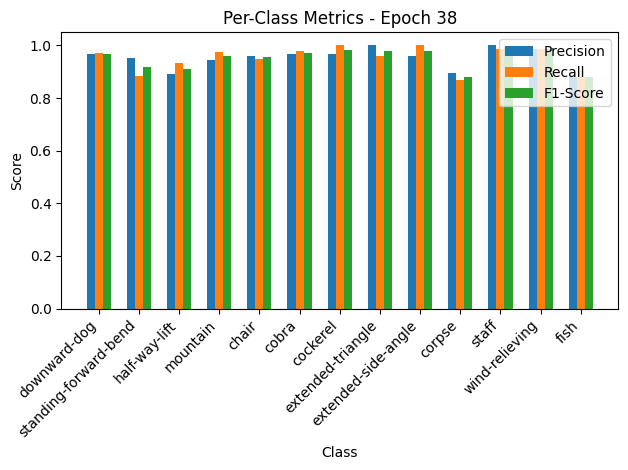

Validation: 100%|██████████| 10/10 [00:00<00:00, 145.92it/s, loss=0.249, accuracy=91.8]


Per-Class Metrics for Epoch 38:
downward-dog: Precision=0.97, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.88, F1-Score=0.92
half-way-lift: Precision=0.89, Recall=0.93, F1-Score=0.91
mountain: Precision=0.94, Recall=0.97, F1-Score=0.96
chair: Precision=0.96, Recall=0.95, F1-Score=0.96
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.89, Recall=0.87, F1-Score=0.88
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.88, Recall=0.88, F1-Score=0.88


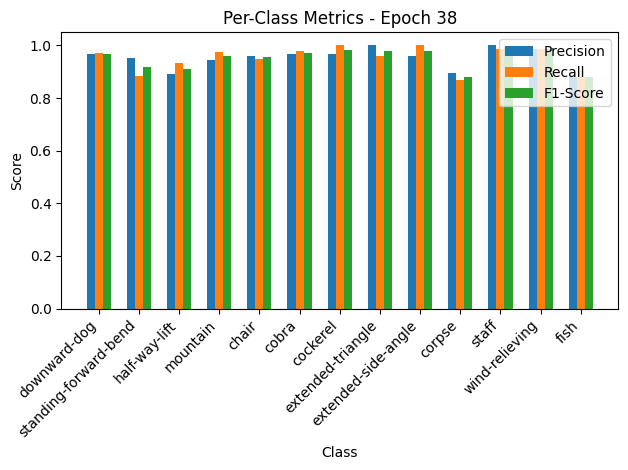


Epoch 39/50 Summary:
Train Loss: 0.1724 | Train Acc: 94.95% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.2724 | Val Acc: 91.78% | Val Precision: 0.94 | Val Recall: 0.93 | Val F1: 0.93

Epoch 40/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:02<00:00, 40.95it/s, loss=0.173, accuracy=95.5]


Per-Class Metrics for Epoch 39:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.96, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.94, Recall=0.96, F1-Score=0.95
mountain: Precision=0.96, Recall=0.98, F1-Score=0.97
chair: Precision=0.96, Recall=0.96, F1-Score=0.96
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.96, Recall=0.96, F1-Score=0.96
extended-side-angle: Precision=0.96, Recall=0.96, F1-Score=0.96
corpse: Precision=0.85, Recall=0.84, F1-Score=0.84
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.86, Recall=0.85, F1-Score=0.86


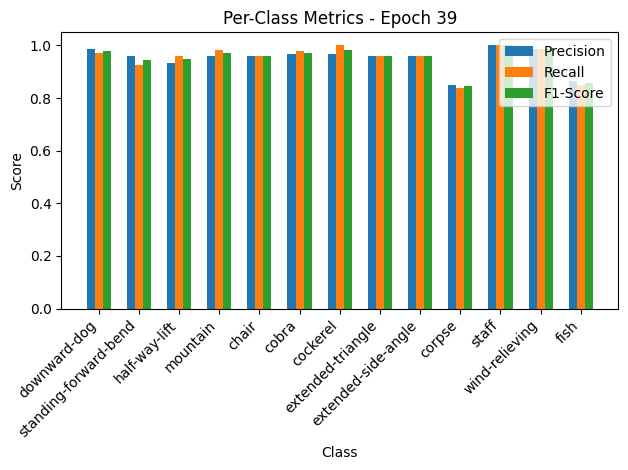

Validation: 100%|██████████| 10/10 [00:00<00:00, 129.30it/s, loss=0.228, accuracy=91.8]


Per-Class Metrics for Epoch 39:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.96, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.94, Recall=0.96, F1-Score=0.95
mountain: Precision=0.96, Recall=0.98, F1-Score=0.97
chair: Precision=0.96, Recall=0.96, F1-Score=0.96
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.96, Recall=0.96, F1-Score=0.96
extended-side-angle: Precision=0.96, Recall=0.96, F1-Score=0.96
corpse: Precision=0.85, Recall=0.84, F1-Score=0.84
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.86, Recall=0.85, F1-Score=0.86


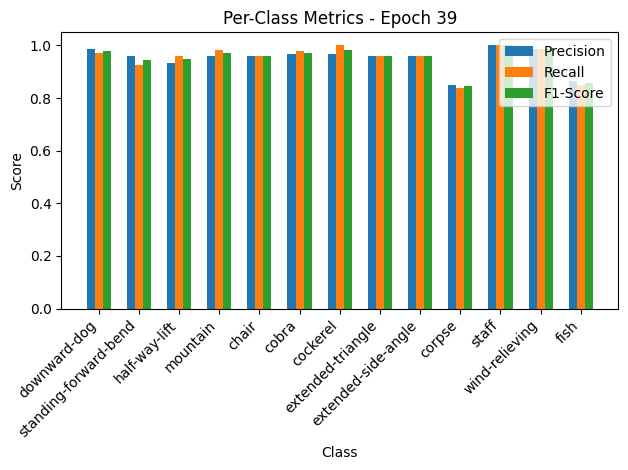


Epoch 40/50 Summary:
Train Loss: 0.1736 | Train Acc: 95.49% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.2502 | Val Acc: 91.78% | Val Precision: 0.94 | Val Recall: 0.93 | Val F1: 0.93
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_0.pth
Checkpoint saved at epoch 40
New best model saved! Validation Loss: 0.2502

Epoch 41/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:02<00:00, 36.72it/s, loss=0.172, accuracy=95.3]


Per-Class Metrics for Epoch 40:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.96, Recall=0.91, F1-Score=0.93
half-way-lift: Precision=0.93, Recall=0.95, F1-Score=0.94
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.95, Recall=0.94, F1-Score=0.95
cobra: Precision=0.98, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.94, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.91, Recall=0.88, F1-Score=0.90
staff: Precision=0.99, Recall=0.97, F1-Score=0.98
wind-relieving: Precision=0.96, Recall=0.97, F1-Score=0.96
fish: Precision=0.88, Recall=0.90, F1-Score=0.89


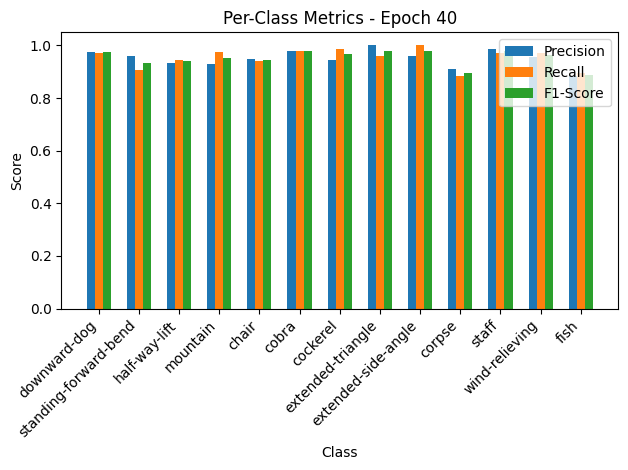

Validation: 100%|██████████| 10/10 [00:00<00:00, 134.92it/s, loss=0.228, accuracy=93.2]


Per-Class Metrics for Epoch 40:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.96, Recall=0.91, F1-Score=0.93
half-way-lift: Precision=0.93, Recall=0.95, F1-Score=0.94
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.95, Recall=0.94, F1-Score=0.95
cobra: Precision=0.98, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.94, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.91, Recall=0.88, F1-Score=0.90
staff: Precision=0.99, Recall=0.97, F1-Score=0.98
wind-relieving: Precision=0.96, Recall=0.97, F1-Score=0.96
fish: Precision=0.88, Recall=0.90, F1-Score=0.89


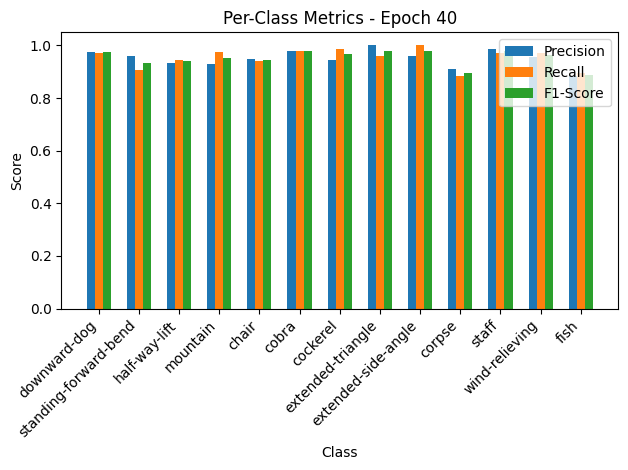


Epoch 41/50 Summary:
Train Loss: 0.1730 | Train Acc: 95.26% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.2501 | Val Acc: 93.15% | Val Precision: 0.94 | Val Recall: 0.94 | Val F1: 0.94
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_0.pth
Checkpoint saved at epoch 41
New best model saved! Validation Loss: 0.2501

Epoch 42/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:02<00:00, 38.05it/s, loss=0.161, accuracy=95.6]


Per-Class Metrics for Epoch 41:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.93, Recall=0.93, F1-Score=0.93
half-way-lift: Precision=0.93, Recall=0.94, F1-Score=0.94
mountain: Precision=0.94, Recall=0.99, F1-Score=0.97
chair: Precision=0.99, Recall=0.94, F1-Score=0.96
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.91, Recall=0.87, F1-Score=0.89
staff: Precision=0.96, Recall=1.00, F1-Score=0.98
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.87, Recall=0.90, F1-Score=0.88


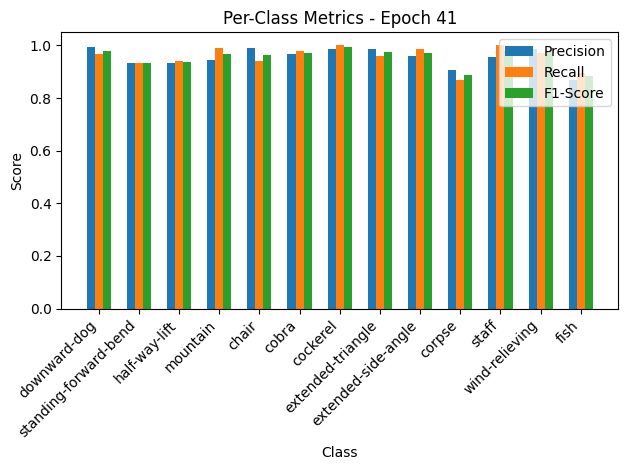

Validation: 100%|██████████| 10/10 [00:00<00:00, 149.42it/s, loss=0.238, accuracy=91.8]


Per-Class Metrics for Epoch 41:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.93, Recall=0.93, F1-Score=0.93
half-way-lift: Precision=0.93, Recall=0.94, F1-Score=0.94
mountain: Precision=0.94, Recall=0.99, F1-Score=0.97
chair: Precision=0.99, Recall=0.94, F1-Score=0.96
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.91, Recall=0.87, F1-Score=0.89
staff: Precision=0.96, Recall=1.00, F1-Score=0.98
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.87, Recall=0.90, F1-Score=0.88


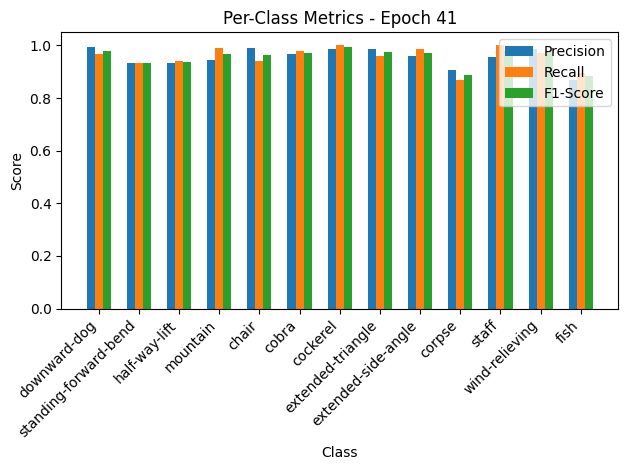


Epoch 42/50 Summary:
Train Loss: 0.1611 | Train Acc: 95.64% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.2614 | Val Acc: 91.78% | Val Precision: 0.94 | Val Recall: 0.93 | Val F1: 0.93

Epoch 43/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:02<00:00, 40.11it/s, loss=0.171, accuracy=95.7]


Per-Class Metrics for Epoch 42:
downward-dog: Precision=0.98, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.91, F1-Score=0.93
half-way-lift: Precision=0.92, Recall=0.93, F1-Score=0.93
mountain: Precision=0.95, Recall=0.99, F1-Score=0.97
chair: Precision=0.98, Recall=0.93, F1-Score=0.95
cobra: Precision=0.99, Recall=0.99, F1-Score=0.99
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=0.96, F1-Score=0.95
extended-side-angle: Precision=0.96, Recall=0.95, F1-Score=0.95
corpse: Precision=0.89, Recall=0.94, F1-Score=0.91
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.94, Recall=0.87, F1-Score=0.90


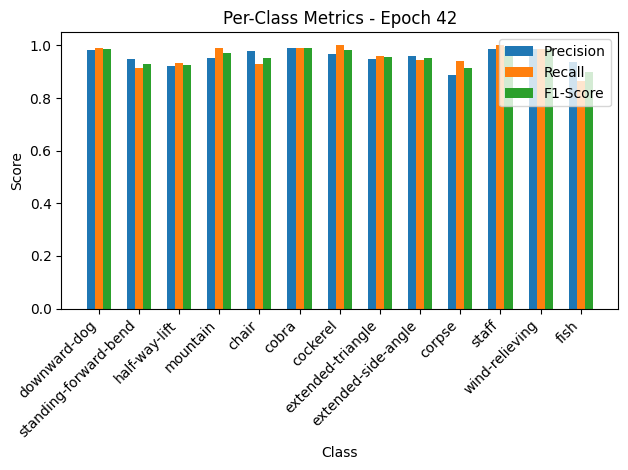

Validation: 100%|██████████| 10/10 [00:00<00:00, 167.04it/s, loss=0.227, accuracy=91.8]


Per-Class Metrics for Epoch 42:
downward-dog: Precision=0.98, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.91, F1-Score=0.93
half-way-lift: Precision=0.92, Recall=0.93, F1-Score=0.93
mountain: Precision=0.95, Recall=0.99, F1-Score=0.97
chair: Precision=0.98, Recall=0.93, F1-Score=0.95
cobra: Precision=0.99, Recall=0.99, F1-Score=0.99
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=0.96, F1-Score=0.95
extended-side-angle: Precision=0.96, Recall=0.95, F1-Score=0.95
corpse: Precision=0.89, Recall=0.94, F1-Score=0.91
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.94, Recall=0.87, F1-Score=0.90


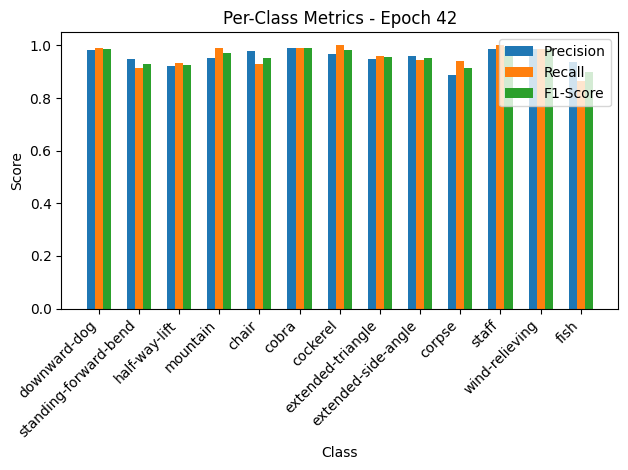


Epoch 43/50 Summary:
Train Loss: 0.1720 | Train Acc: 95.72% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.2486 | Val Acc: 91.78% | Val Precision: 0.94 | Val Recall: 0.92 | Val F1: 0.92
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_0.pth
Checkpoint saved at epoch 43
New best model saved! Validation Loss: 0.2486

Epoch 44/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:02<00:00, 40.15it/s, loss=0.163, accuracy=95.7]


Per-Class Metrics for Epoch 43:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.96, Recall=0.91, F1-Score=0.93
half-way-lift: Precision=0.92, Recall=0.97, F1-Score=0.94
mountain: Precision=0.94, Recall=0.99, F1-Score=0.97
chair: Precision=0.97, Recall=0.94, F1-Score=0.95
cobra: Precision=0.98, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.93, Recall=0.81, F1-Score=0.87
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.97, Recall=0.97, F1-Score=0.97
fish: Precision=0.82, Recall=0.91, F1-Score=0.87


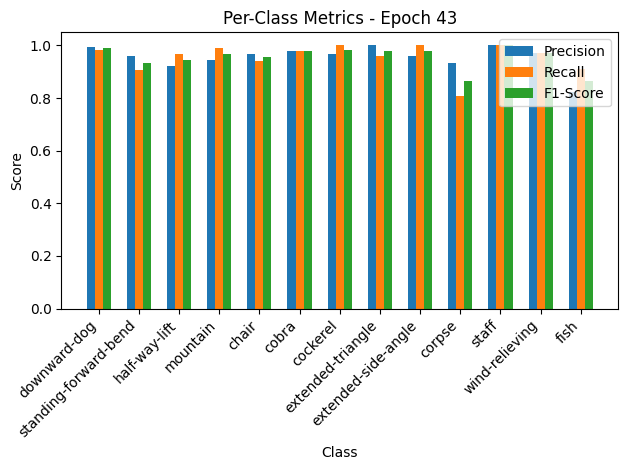

Validation: 100%|██████████| 10/10 [00:00<00:00, 163.52it/s, loss=0.241, accuracy=93.2]


Per-Class Metrics for Epoch 43:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.96, Recall=0.91, F1-Score=0.93
half-way-lift: Precision=0.92, Recall=0.97, F1-Score=0.94
mountain: Precision=0.94, Recall=0.99, F1-Score=0.97
chair: Precision=0.97, Recall=0.94, F1-Score=0.95
cobra: Precision=0.98, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.93, Recall=0.81, F1-Score=0.87
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.97, Recall=0.97, F1-Score=0.97
fish: Precision=0.82, Recall=0.91, F1-Score=0.87


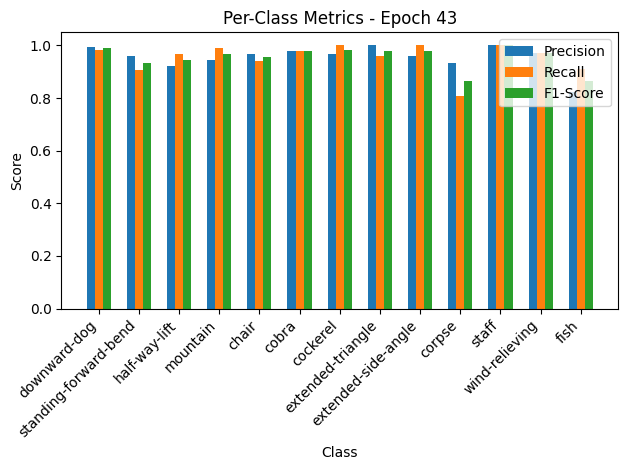


Epoch 44/50 Summary:
Train Loss: 0.1631 | Train Acc: 95.72% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.95
Val Loss: 0.2637 | Val Acc: 93.15% | Val Precision: 0.94 | Val Recall: 0.94 | Val F1: 0.94

Epoch 45/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:02<00:00, 37.75it/s, loss=0.178, accuracy=94.8]


Per-Class Metrics for Epoch 44:
downward-dog: Precision=0.98, Recall=0.99, F1-Score=0.98
standing-forward-bend: Precision=0.94, Recall=0.92, F1-Score=0.93
half-way-lift: Precision=0.93, Recall=0.93, F1-Score=0.93
mountain: Precision=0.94, Recall=0.98, F1-Score=0.96
chair: Precision=0.96, Recall=0.91, F1-Score=0.93
cobra: Precision=0.96, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.97, F1-Score=0.97
corpse: Precision=0.88, Recall=0.82, F1-Score=0.85
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.96, Recall=0.99, F1-Score=0.97
fish: Precision=0.85, Recall=0.84, F1-Score=0.84


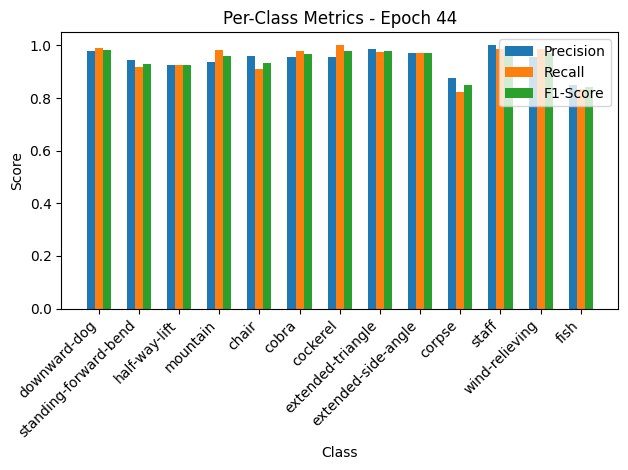

Validation: 100%|██████████| 10/10 [00:00<00:00, 103.00it/s, loss=0.22, accuracy=92.5]


Per-Class Metrics for Epoch 44:
downward-dog: Precision=0.98, Recall=0.99, F1-Score=0.98
standing-forward-bend: Precision=0.94, Recall=0.92, F1-Score=0.93
half-way-lift: Precision=0.93, Recall=0.93, F1-Score=0.93
mountain: Precision=0.94, Recall=0.98, F1-Score=0.96
chair: Precision=0.96, Recall=0.91, F1-Score=0.93
cobra: Precision=0.96, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.97, F1-Score=0.97
corpse: Precision=0.88, Recall=0.82, F1-Score=0.85
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.96, Recall=0.99, F1-Score=0.97
fish: Precision=0.85, Recall=0.84, F1-Score=0.84


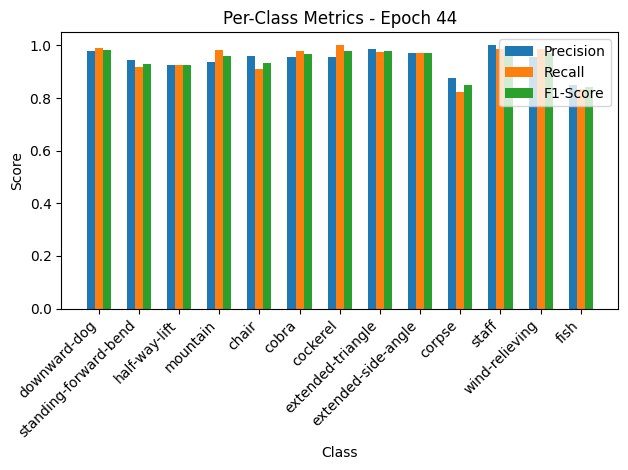


Epoch 45/50 Summary:
Train Loss: 0.1783 | Train Acc: 94.80% | Train Precision: 0.95 | Train Recall: 0.94 | Train F1: 0.95
Val Loss: 0.2414 | Val Acc: 92.47% | Val Precision: 0.94 | Val Recall: 0.93 | Val F1: 0.93
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_0.pth
Checkpoint saved at epoch 45
New best model saved! Validation Loss: 0.2414

Epoch 46/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:02<00:00, 35.44it/s, loss=0.171, accuracy=95]


Per-Class Metrics for Epoch 45:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.94, Recall=0.90, F1-Score=0.92
half-way-lift: Precision=0.92, Recall=0.95, F1-Score=0.93
mountain: Precision=0.94, Recall=0.96, F1-Score=0.95
chair: Precision=0.93, Recall=0.94, F1-Score=0.94
cobra: Precision=0.99, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.87, Recall=0.87, F1-Score=0.87
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.86, Recall=0.82, F1-Score=0.84


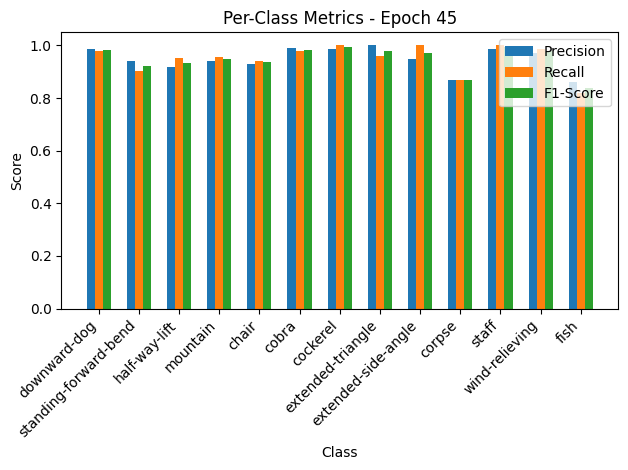

Validation: 100%|██████████| 10/10 [00:00<00:00, 182.70it/s, loss=0.24, accuracy=91.1]


Per-Class Metrics for Epoch 45:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.94, Recall=0.90, F1-Score=0.92
half-way-lift: Precision=0.92, Recall=0.95, F1-Score=0.93
mountain: Precision=0.94, Recall=0.96, F1-Score=0.95
chair: Precision=0.93, Recall=0.94, F1-Score=0.94
cobra: Precision=0.99, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.87, Recall=0.87, F1-Score=0.87
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.86, Recall=0.82, F1-Score=0.84


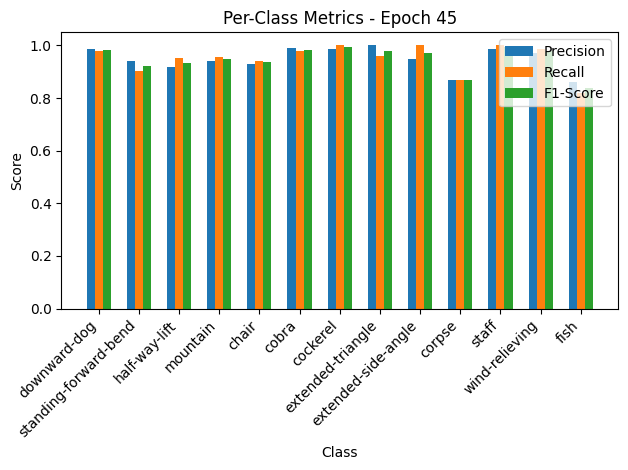


Epoch 46/50 Summary:
Train Loss: 0.1713 | Train Acc: 95.03% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.2625 | Val Acc: 91.10% | Val Precision: 0.93 | Val Recall: 0.92 | Val F1: 0.92

Epoch 47/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:01<00:00, 42.28it/s, loss=0.167, accuracy=95.5]


Per-Class Metrics for Epoch 46:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.98, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.92, Recall=0.98, F1-Score=0.95
mountain: Precision=0.92, Recall=0.99, F1-Score=0.96
chair: Precision=0.98, Recall=0.92, F1-Score=0.95
cobra: Precision=0.98, Recall=0.97, F1-Score=0.97
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.96, Recall=0.95, F1-Score=0.95
extended-side-angle: Precision=0.95, Recall=0.96, F1-Score=0.95
corpse: Precision=0.94, Recall=0.87, F1-Score=0.90
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.96, Recall=0.99, F1-Score=0.97
fish: Precision=0.88, Recall=0.90, F1-Score=0.89


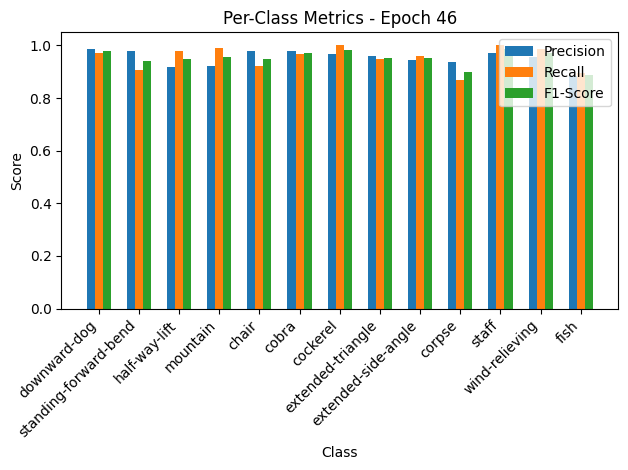

Validation: 100%|██████████| 10/10 [00:00<00:00, 153.87it/s, loss=0.233, accuracy=91.8]


Per-Class Metrics for Epoch 46:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.98, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.92, Recall=0.98, F1-Score=0.95
mountain: Precision=0.92, Recall=0.99, F1-Score=0.96
chair: Precision=0.98, Recall=0.92, F1-Score=0.95
cobra: Precision=0.98, Recall=0.97, F1-Score=0.97
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.96, Recall=0.95, F1-Score=0.95
extended-side-angle: Precision=0.95, Recall=0.96, F1-Score=0.95
corpse: Precision=0.94, Recall=0.87, F1-Score=0.90
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.96, Recall=0.99, F1-Score=0.97
fish: Precision=0.88, Recall=0.90, F1-Score=0.89


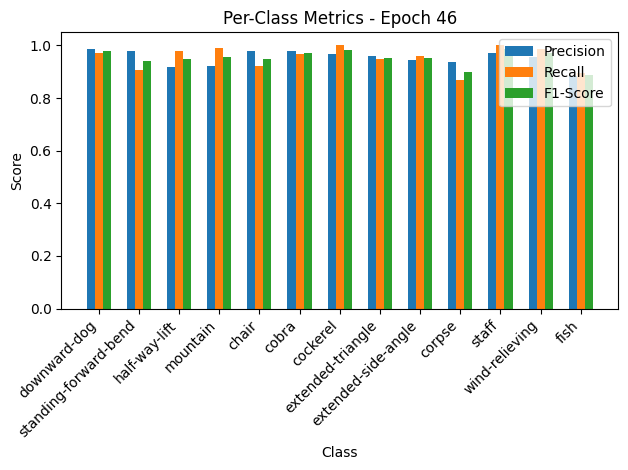


Epoch 47/50 Summary:
Train Loss: 0.1673 | Train Acc: 95.49% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.2551 | Val Acc: 91.78% | Val Precision: 0.94 | Val Recall: 0.93 | Val F1: 0.93

Epoch 48/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:01<00:00, 42.91it/s, loss=0.171, accuracy=95.4]


Per-Class Metrics for Epoch 47:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.92, F1-Score=0.94
half-way-lift: Precision=0.93, Recall=0.95, F1-Score=0.94
mountain: Precision=0.94, Recall=0.98, F1-Score=0.96
chair: Precision=0.96, Recall=0.93, F1-Score=0.94
cobra: Precision=0.98, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.99, F1-Score=0.97
corpse: Precision=0.86, Recall=0.87, F1-Score=0.86
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.86, Recall=0.85, F1-Score=0.86


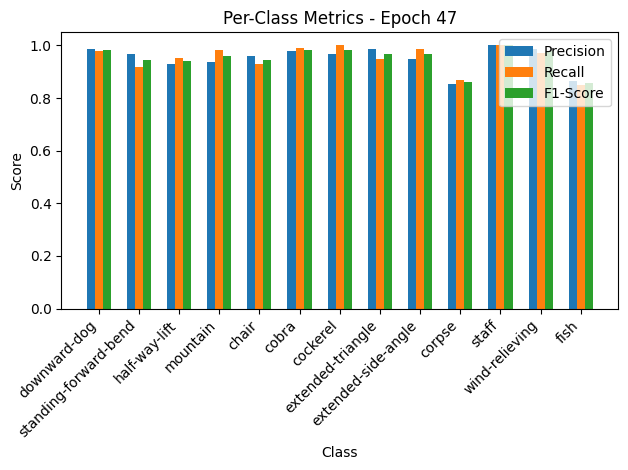

Validation: 100%|██████████| 10/10 [00:00<00:00, 90.78it/s, loss=0.239, accuracy=91.8]


Per-Class Metrics for Epoch 47:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.92, F1-Score=0.94
half-way-lift: Precision=0.93, Recall=0.95, F1-Score=0.94
mountain: Precision=0.94, Recall=0.98, F1-Score=0.96
chair: Precision=0.96, Recall=0.93, F1-Score=0.94
cobra: Precision=0.98, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.99, F1-Score=0.97
corpse: Precision=0.86, Recall=0.87, F1-Score=0.86
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.86, Recall=0.85, F1-Score=0.86


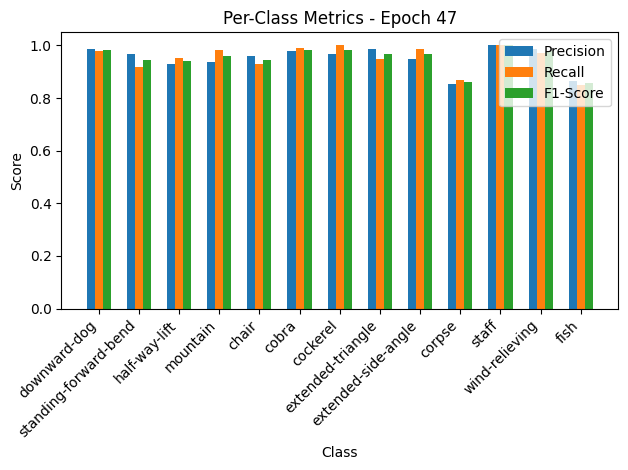


Epoch 48/50 Summary:
Train Loss: 0.1712 | Train Acc: 95.41% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.2618 | Val Acc: 91.78% | Val Precision: 0.93 | Val Recall: 0.92 | Val F1: 0.92

Epoch 49/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:02<00:00, 38.45it/s, loss=0.162, accuracy=95.8]


Per-Class Metrics for Epoch 48:
downward-dog: Precision=0.99, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.97, Recall=0.92, F1-Score=0.94
half-way-lift: Precision=0.93, Recall=0.97, F1-Score=0.95
mountain: Precision=0.95, Recall=0.98, F1-Score=0.97
chair: Precision=0.97, Recall=0.95, F1-Score=0.96
cobra: Precision=0.95, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.95, F1-Score=0.96
extended-side-angle: Precision=0.95, Recall=0.97, F1-Score=0.96
corpse: Precision=0.97, Recall=0.88, F1-Score=0.92
staff: Precision=0.99, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.96, Recall=0.99, F1-Score=0.97
fish: Precision=0.90, Recall=0.94, F1-Score=0.92


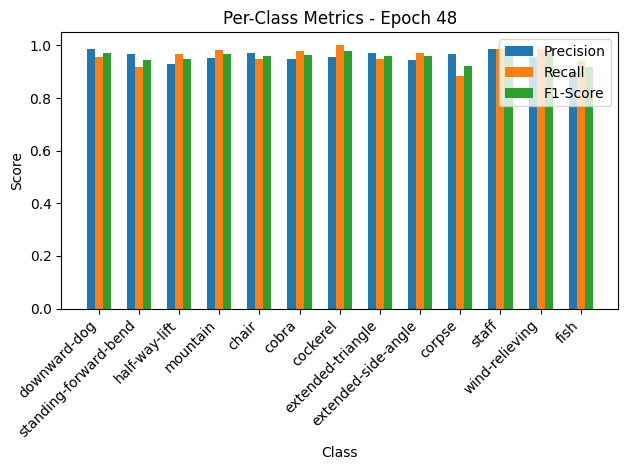

Validation: 100%|██████████| 10/10 [00:00<00:00, 142.23it/s, loss=0.223, accuracy=93.2]


Per-Class Metrics for Epoch 48:
downward-dog: Precision=0.99, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.97, Recall=0.92, F1-Score=0.94
half-way-lift: Precision=0.93, Recall=0.97, F1-Score=0.95
mountain: Precision=0.95, Recall=0.98, F1-Score=0.97
chair: Precision=0.97, Recall=0.95, F1-Score=0.96
cobra: Precision=0.95, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.95, F1-Score=0.96
extended-side-angle: Precision=0.95, Recall=0.97, F1-Score=0.96
corpse: Precision=0.97, Recall=0.88, F1-Score=0.92
staff: Precision=0.99, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.96, Recall=0.99, F1-Score=0.97
fish: Precision=0.90, Recall=0.94, F1-Score=0.92


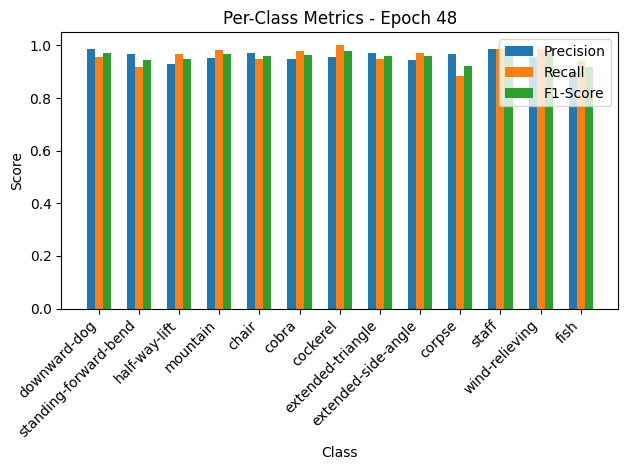


Epoch 49/50 Summary:
Train Loss: 0.1622 | Train Acc: 95.80% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.2449 | Val Acc: 93.15% | Val Precision: 0.94 | Val Recall: 0.94 | Val F1: 0.94

Epoch 50/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:02<00:00, 33.73it/s, loss=0.166, accuracy=95.5]


Per-Class Metrics for Epoch 49:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.96, Recall=0.92, F1-Score=0.94
half-way-lift: Precision=0.93, Recall=0.95, F1-Score=0.94
mountain: Precision=0.95, Recall=0.97, F1-Score=0.96
chair: Precision=0.95, Recall=0.95, F1-Score=0.95
cobra: Precision=0.98, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.98, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.90, Recall=0.81, F1-Score=0.85
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.96, Recall=0.97, F1-Score=0.96
fish: Precision=0.85, Recall=0.90, F1-Score=0.87


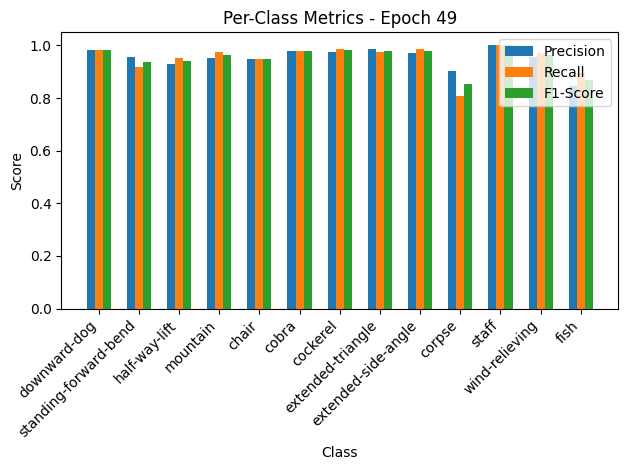

Validation: 100%|██████████| 10/10 [00:00<00:00, 151.32it/s, loss=0.222, accuracy=93.2]


Per-Class Metrics for Epoch 49:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.96, Recall=0.92, F1-Score=0.94
half-way-lift: Precision=0.93, Recall=0.95, F1-Score=0.94
mountain: Precision=0.95, Recall=0.97, F1-Score=0.96
chair: Precision=0.95, Recall=0.95, F1-Score=0.95
cobra: Precision=0.98, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.98, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.90, Recall=0.81, F1-Score=0.85
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.96, Recall=0.97, F1-Score=0.96
fish: Precision=0.85, Recall=0.90, F1-Score=0.87


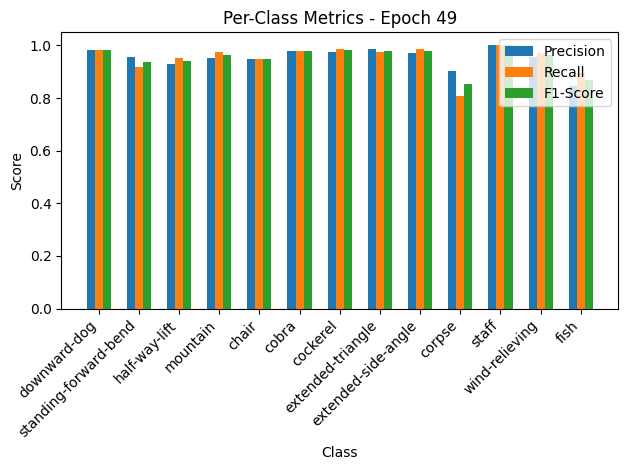


Epoch 50/50 Summary:
Train Loss: 0.1666 | Train Acc: 95.49% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.2434 | Val Acc: 93.15% | Val Precision: 0.95 | Val Recall: 0.94 | Val F1: 0.94


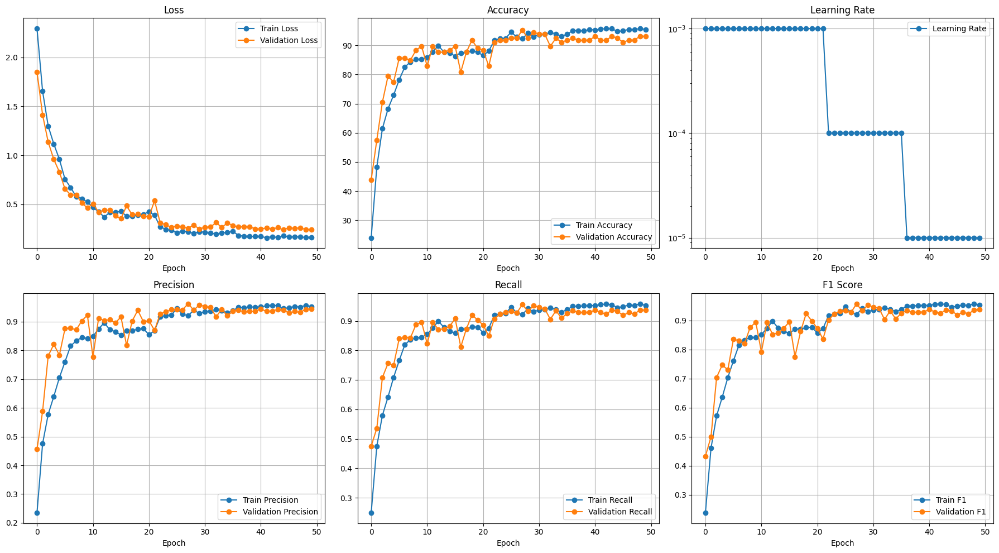

Testing: 100%|██████████| 23/23 [00:00<00:00, 120.69it/s]


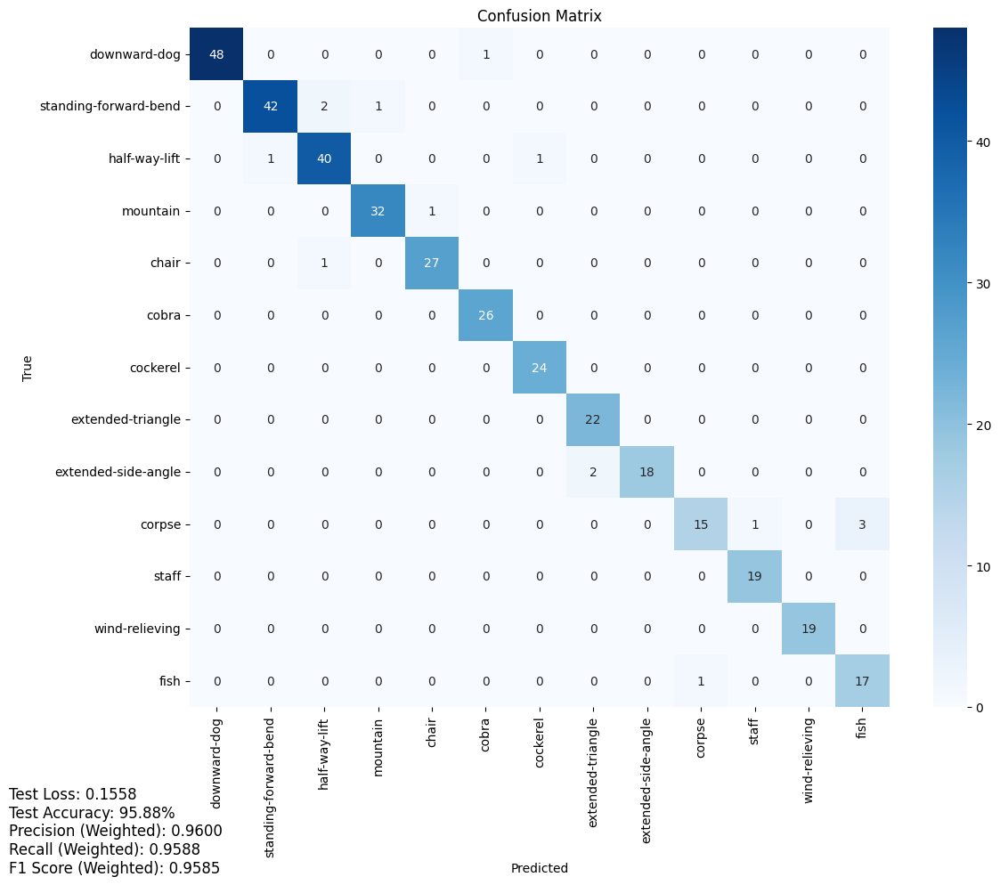

Test Loss: 0.1558
Test Accuracy: 95.88%
Precision (Weighted): 0.9600
Recall (Weighted): 0.9588
F1 Score (Weighted): 0.9585


Testing: 100%|██████████| 23/23 [00:00<00:00, 135.15it/s]


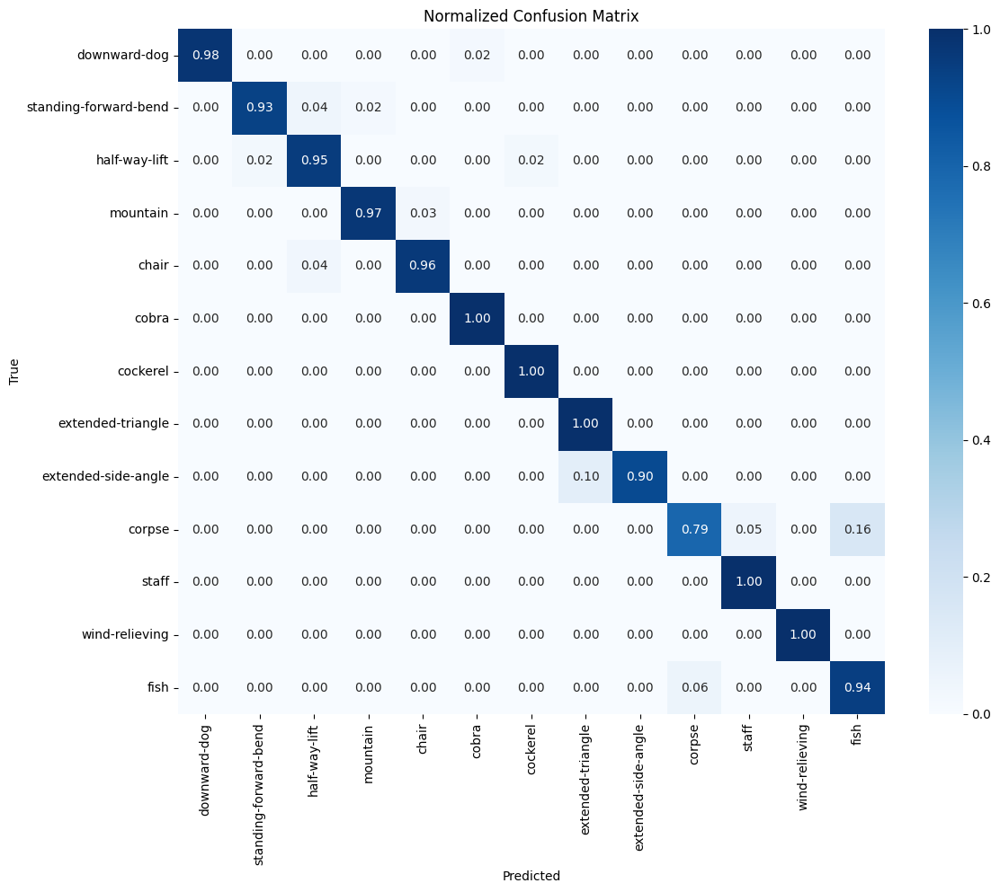

Test Loss: 0.1558
Test Accuracy: 95.88%
Precision (Macro): 0.9552
Recall (Macro): 0.9564
F1 Score (Macro): 0.9546
Saved checkpoint for fold 1
Fold 2/5
Loading cached criterion for fold 1
batch_norm.weight: 99
batch_norm.bias: 99
conv1.0.weight: 288
conv1.0.bias: 32
conv1.1.weight: 32
conv1.1.bias: 32
blk1.conv1.weight: 6144
blk1.conv1.bias: 64
blk1.bn1.weight: 64
blk1.bn1.bias: 64
blk1.conv2.weight: 12288
blk1.conv2.bias: 64
blk1.bn2.weight: 64
blk1.bn2.bias: 64
blk1.shortcut.0.weight: 2048
blk1.shortcut.0.bias: 64
blk1.shortcut.1.weight: 64
blk1.shortcut.1.bias: 64
blk2.conv1.weight: 24576
blk2.conv1.bias: 128
blk2.bn1.weight: 128
blk2.bn1.bias: 128
blk2.conv2.weight: 49152
blk2.conv2.bias: 128
blk2.bn2.weight: 128
blk2.bn2.bias: 128
blk2.shortcut.0.weight: 8192
blk2.shortcut.0.bias: 128
blk2.shortcut.1.weight: 128
blk2.shortcut.1.bias: 128
blk3.conv1.weight: 98304
blk3.conv1.bias: 256
blk3.bn1.weight: 256
blk3.bn1.bias: 256
blk3.conv2.weight: 196608
blk3.conv2.bias: 256
blk3.bn2.weig

Training: 100%|██████████| 82/82 [00:02<00:00, 40.83it/s, loss=2.31, accuracy=22.9]


Per-Class Metrics for Epoch 0:
downward-dog: Precision=0.30, Recall=0.17, F1-Score=0.22
standing-forward-bend: Precision=0.30, Recall=0.36, F1-Score=0.33
half-way-lift: Precision=0.20, Recall=0.11, F1-Score=0.15
mountain: Precision=0.30, Recall=0.11, F1-Score=0.16
chair: Precision=0.21, Recall=0.15, F1-Score=0.18
cobra: Precision=0.10, Recall=0.10, F1-Score=0.10
cockerel: Precision=0.32, Recall=0.59, F1-Score=0.42
extended-triangle: Precision=0.25, Recall=0.26, F1-Score=0.25
extended-side-angle: Precision=0.17, Recall=0.33, F1-Score=0.22
corpse: Precision=0.24, Recall=0.25, F1-Score=0.24
staff: Precision=0.13, Recall=0.19, F1-Score=0.16
wind-relieving: Precision=0.35, Recall=0.40, F1-Score=0.37
fish: Precision=0.04, Recall=0.06, F1-Score=0.05


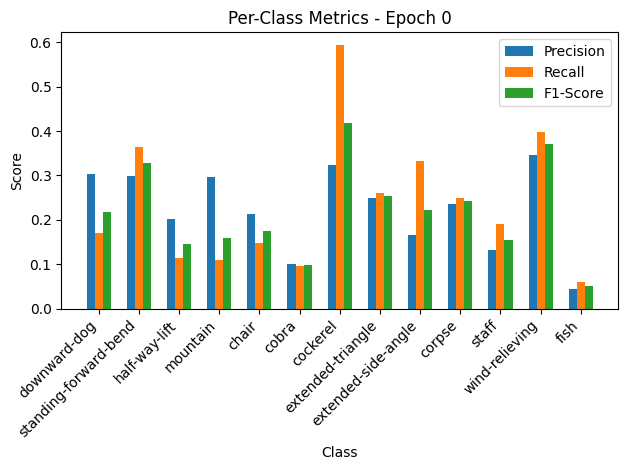

Validation: 100%|██████████| 10/10 [00:00<00:00, 143.71it/s, loss=1.81, accuracy=37]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 0:
downward-dog: Precision=0.30, Recall=0.17, F1-Score=0.22
standing-forward-bend: Precision=0.30, Recall=0.36, F1-Score=0.33
half-way-lift: Precision=0.20, Recall=0.11, F1-Score=0.15
mountain: Precision=0.30, Recall=0.11, F1-Score=0.16
chair: Precision=0.21, Recall=0.15, F1-Score=0.18
cobra: Precision=0.10, Recall=0.10, F1-Score=0.10
cockerel: Precision=0.32, Recall=0.59, F1-Score=0.42
extended-triangle: Precision=0.25, Recall=0.26, F1-Score=0.25
extended-side-angle: Precision=0.17, Recall=0.33, F1-Score=0.22
corpse: Precision=0.24, Recall=0.25, F1-Score=0.24
staff: Precision=0.13, Recall=0.19, F1-Score=0.16
wind-relieving: Precision=0.35, Recall=0.40, F1-Score=0.37
fish: Precision=0.04, Recall=0.06, F1-Score=0.05


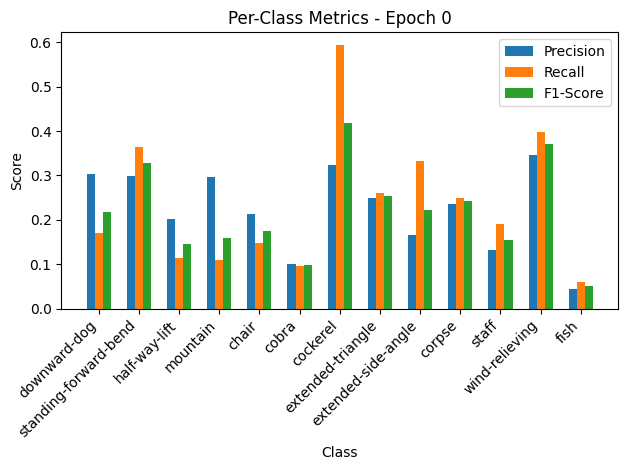


Epoch 1/50 Summary:
Train Loss: 2.3154 | Train Acc: 22.86% | Train Precision: 0.22 | Train Recall: 0.24 | Train F1: 0.22
Val Loss: 1.9798 | Val Acc: 36.99% | Val Precision: 0.35 | Val Recall: 0.36 | Val F1: 0.29
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_1.pth
Checkpoint saved at epoch 1
New best model saved! Validation Loss: 1.9798

Epoch 2/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 37.96it/s, loss=1.75, accuracy=46.3]


Per-Class Metrics for Epoch 1:
downward-dog: Precision=0.61, Recall=0.41, F1-Score=0.49
standing-forward-bend: Precision=0.48, Recall=0.65, F1-Score=0.55
half-way-lift: Precision=0.38, Recall=0.36, F1-Score=0.37
mountain: Precision=0.60, Recall=0.73, F1-Score=0.66
chair: Precision=0.54, Recall=0.30, F1-Score=0.38
cobra: Precision=0.39, Recall=0.26, F1-Score=0.31
cockerel: Precision=0.54, Recall=0.72, F1-Score=0.62
extended-triangle: Precision=0.38, Recall=0.55, F1-Score=0.45
extended-side-angle: Precision=0.36, Recall=0.35, F1-Score=0.35
corpse: Precision=0.29, Recall=0.31, F1-Score=0.30
staff: Precision=0.25, Recall=0.25, F1-Score=0.25
wind-relieving: Precision=0.61, Recall=0.82, F1-Score=0.70
fish: Precision=0.24, Recall=0.13, F1-Score=0.17


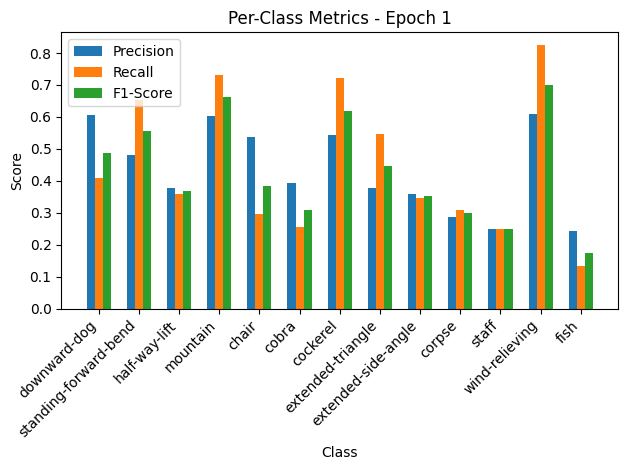

Validation: 100%|██████████| 10/10 [00:00<00:00, 177.40it/s, loss=1.28, accuracy=58.9]


Per-Class Metrics for Epoch 1:
downward-dog: Precision=0.61, Recall=0.41, F1-Score=0.49
standing-forward-bend: Precision=0.48, Recall=0.65, F1-Score=0.55
half-way-lift: Precision=0.38, Recall=0.36, F1-Score=0.37
mountain: Precision=0.60, Recall=0.73, F1-Score=0.66
chair: Precision=0.54, Recall=0.30, F1-Score=0.38
cobra: Precision=0.39, Recall=0.26, F1-Score=0.31
cockerel: Precision=0.54, Recall=0.72, F1-Score=0.62
extended-triangle: Precision=0.38, Recall=0.55, F1-Score=0.45
extended-side-angle: Precision=0.36, Recall=0.35, F1-Score=0.35
corpse: Precision=0.29, Recall=0.31, F1-Score=0.30
staff: Precision=0.25, Recall=0.25, F1-Score=0.25
wind-relieving: Precision=0.61, Recall=0.82, F1-Score=0.70
fish: Precision=0.24, Recall=0.13, F1-Score=0.17


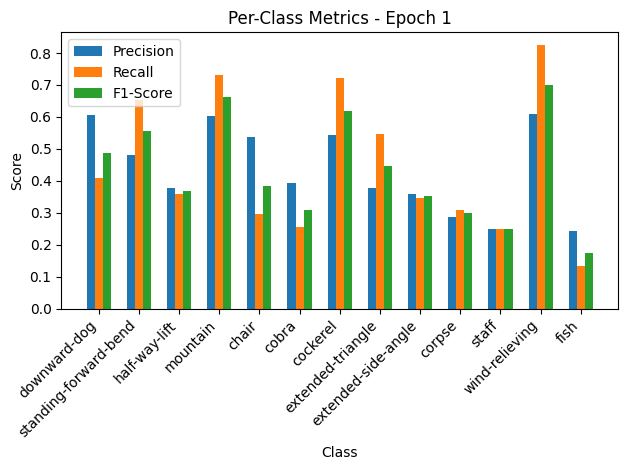


Epoch 2/50 Summary:
Train Loss: 1.7523 | Train Acc: 46.25% | Train Precision: 0.44 | Train Recall: 0.45 | Train F1: 0.43
Val Loss: 1.4018 | Val Acc: 58.90% | Val Precision: 0.61 | Val Recall: 0.59 | Val F1: 0.57
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_1.pth
Checkpoint saved at epoch 2
New best model saved! Validation Loss: 1.4018

Epoch 3/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 36.94it/s, loss=1.27, accuracy=63.4]


Per-Class Metrics for Epoch 2:
downward-dog: Precision=0.78, Recall=0.64, F1-Score=0.71
standing-forward-bend: Precision=0.70, Recall=0.62, F1-Score=0.66
half-way-lift: Precision=0.61, Recall=0.70, F1-Score=0.65
mountain: Precision=0.69, Recall=0.82, F1-Score=0.75
chair: Precision=0.72, Recall=0.61, F1-Score=0.66
cobra: Precision=0.63, Recall=0.33, F1-Score=0.43
cockerel: Precision=0.69, Recall=0.84, F1-Score=0.76
extended-triangle: Precision=0.57, Recall=0.56, F1-Score=0.57
extended-side-angle: Precision=0.46, Recall=0.56, F1-Score=0.50
corpse: Precision=0.44, Recall=0.54, F1-Score=0.49
staff: Precision=0.49, Recall=0.59, F1-Score=0.54
wind-relieving: Precision=0.79, Recall=0.87, F1-Score=0.83
fish: Precision=0.44, Recall=0.42, F1-Score=0.43


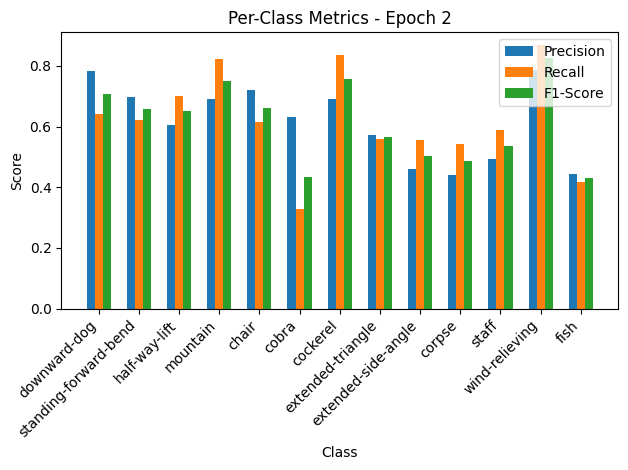

Validation: 100%|██████████| 10/10 [00:00<00:00, 170.03it/s, loss=0.975, accuracy=72.6]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 2:
downward-dog: Precision=0.78, Recall=0.64, F1-Score=0.71
standing-forward-bend: Precision=0.70, Recall=0.62, F1-Score=0.66
half-way-lift: Precision=0.61, Recall=0.70, F1-Score=0.65
mountain: Precision=0.69, Recall=0.82, F1-Score=0.75
chair: Precision=0.72, Recall=0.61, F1-Score=0.66
cobra: Precision=0.63, Recall=0.33, F1-Score=0.43
cockerel: Precision=0.69, Recall=0.84, F1-Score=0.76
extended-triangle: Precision=0.57, Recall=0.56, F1-Score=0.57
extended-side-angle: Precision=0.46, Recall=0.56, F1-Score=0.50
corpse: Precision=0.44, Recall=0.54, F1-Score=0.49
staff: Precision=0.49, Recall=0.59, F1-Score=0.54
wind-relieving: Precision=0.79, Recall=0.87, F1-Score=0.83
fish: Precision=0.44, Recall=0.42, F1-Score=0.43


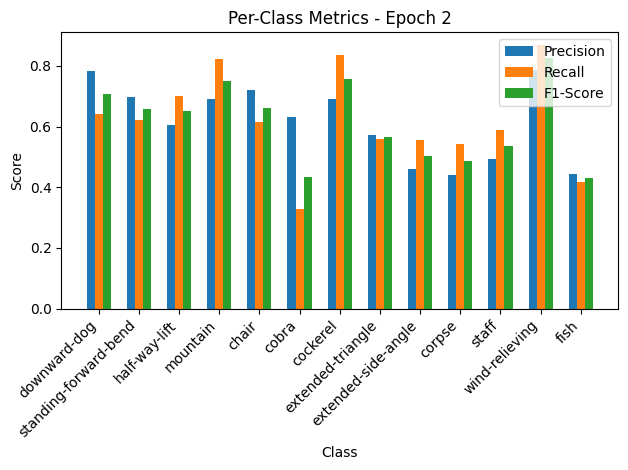


Epoch 3/50 Summary:
Train Loss: 1.2761 | Train Acc: 63.38% | Train Precision: 0.62 | Train Recall: 0.62 | Train F1: 0.61
Val Loss: 1.0680 | Val Acc: 72.60% | Val Precision: 0.72 | Val Recall: 0.68 | Val F1: 0.64
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_1.pth
Checkpoint saved at epoch 3
New best model saved! Validation Loss: 1.0680

Epoch 4/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:01<00:00, 41.58it/s, loss=1.04, accuracy=73.7]


Per-Class Metrics for Epoch 3:
downward-dog: Precision=0.85, Recall=0.78, F1-Score=0.82
standing-forward-bend: Precision=0.83, Recall=0.69, F1-Score=0.75
half-way-lift: Precision=0.74, Recall=0.85, F1-Score=0.79
mountain: Precision=0.79, Recall=0.86, F1-Score=0.82
chair: Precision=0.76, Recall=0.75, F1-Score=0.76
cobra: Precision=0.83, Recall=0.59, F1-Score=0.69
cockerel: Precision=0.78, Recall=0.80, F1-Score=0.79
extended-triangle: Precision=0.59, Recall=0.73, F1-Score=0.65
extended-side-angle: Precision=0.57, Recall=0.44, F1-Score=0.50
corpse: Precision=0.64, Recall=0.57, F1-Score=0.60
staff: Precision=0.56, Recall=0.81, F1-Score=0.66
wind-relieving: Precision=0.79, Recall=0.93, F1-Score=0.85
fish: Precision=0.62, Recall=0.60, F1-Score=0.61


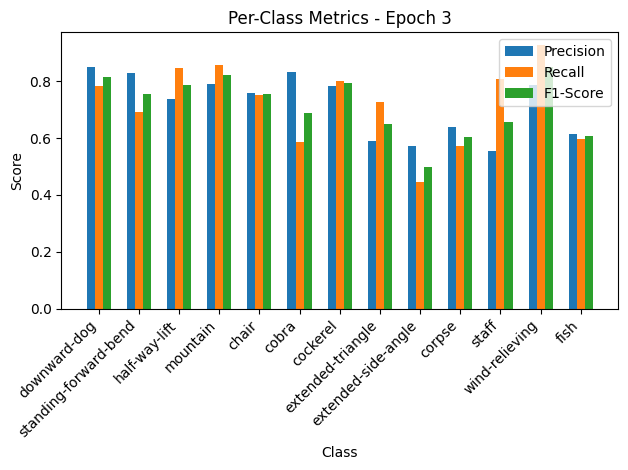

Validation: 100%|██████████| 10/10 [00:00<00:00, 170.97it/s, loss=0.782, accuracy=82.9]


Per-Class Metrics for Epoch 3:
downward-dog: Precision=0.85, Recall=0.78, F1-Score=0.82
standing-forward-bend: Precision=0.83, Recall=0.69, F1-Score=0.75
half-way-lift: Precision=0.74, Recall=0.85, F1-Score=0.79
mountain: Precision=0.79, Recall=0.86, F1-Score=0.82
chair: Precision=0.76, Recall=0.75, F1-Score=0.76
cobra: Precision=0.83, Recall=0.59, F1-Score=0.69
cockerel: Precision=0.78, Recall=0.80, F1-Score=0.79
extended-triangle: Precision=0.59, Recall=0.73, F1-Score=0.65
extended-side-angle: Precision=0.57, Recall=0.44, F1-Score=0.50
corpse: Precision=0.64, Recall=0.57, F1-Score=0.60
staff: Precision=0.56, Recall=0.81, F1-Score=0.66
wind-relieving: Precision=0.79, Recall=0.93, F1-Score=0.85
fish: Precision=0.62, Recall=0.60, F1-Score=0.61


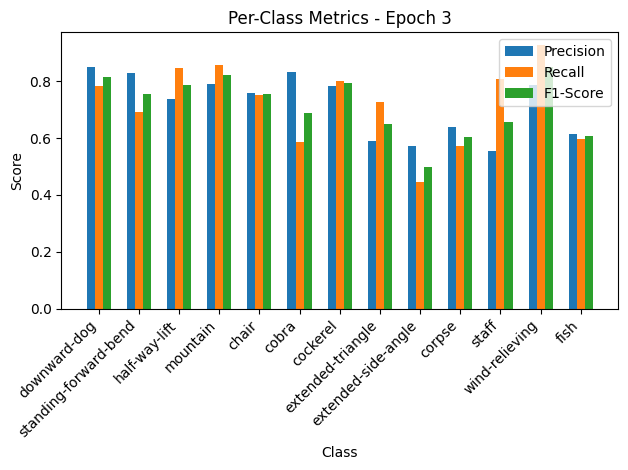


Epoch 4/50 Summary:
Train Loss: 1.0477 | Train Acc: 73.70% | Train Precision: 0.72 | Train Recall: 0.72 | Train F1: 0.71
Val Loss: 0.8575 | Val Acc: 82.88% | Val Precision: 0.82 | Val Recall: 0.79 | Val F1: 0.79
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_1.pth
Checkpoint saved at epoch 4
New best model saved! Validation Loss: 0.8575

Epoch 5/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 40.93it/s, loss=0.881, accuracy=77.5]


Per-Class Metrics for Epoch 4:
downward-dog: Precision=0.92, Recall=0.82, F1-Score=0.87
standing-forward-bend: Precision=0.88, Recall=0.71, F1-Score=0.78
half-way-lift: Precision=0.75, Recall=0.90, F1-Score=0.82
mountain: Precision=0.76, Recall=0.84, F1-Score=0.80
chair: Precision=0.73, Recall=0.71, F1-Score=0.72
cobra: Precision=0.76, Recall=0.84, F1-Score=0.80
cockerel: Precision=0.89, Recall=0.88, F1-Score=0.89
extended-triangle: Precision=0.66, Recall=0.56, F1-Score=0.61
extended-side-angle: Precision=0.58, Recall=0.68, F1-Score=0.63
corpse: Precision=0.64, Recall=0.66, F1-Score=0.65
staff: Precision=0.76, Recall=0.81, F1-Score=0.79
wind-relieving: Precision=0.84, Recall=0.93, F1-Score=0.88
fish: Precision=0.69, Recall=0.57, F1-Score=0.62


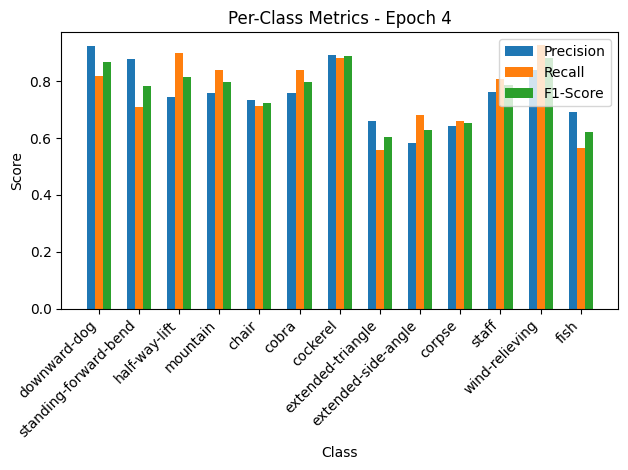

Validation: 100%|██████████| 10/10 [00:00<00:00, 146.35it/s, loss=0.692, accuracy=80.8]


Per-Class Metrics for Epoch 4:
downward-dog: Precision=0.92, Recall=0.82, F1-Score=0.87
standing-forward-bend: Precision=0.88, Recall=0.71, F1-Score=0.78
half-way-lift: Precision=0.75, Recall=0.90, F1-Score=0.82
mountain: Precision=0.76, Recall=0.84, F1-Score=0.80
chair: Precision=0.73, Recall=0.71, F1-Score=0.72
cobra: Precision=0.76, Recall=0.84, F1-Score=0.80
cockerel: Precision=0.89, Recall=0.88, F1-Score=0.89
extended-triangle: Precision=0.66, Recall=0.56, F1-Score=0.61
extended-side-angle: Precision=0.58, Recall=0.68, F1-Score=0.63
corpse: Precision=0.64, Recall=0.66, F1-Score=0.65
staff: Precision=0.76, Recall=0.81, F1-Score=0.79
wind-relieving: Precision=0.84, Recall=0.93, F1-Score=0.88
fish: Precision=0.69, Recall=0.57, F1-Score=0.62


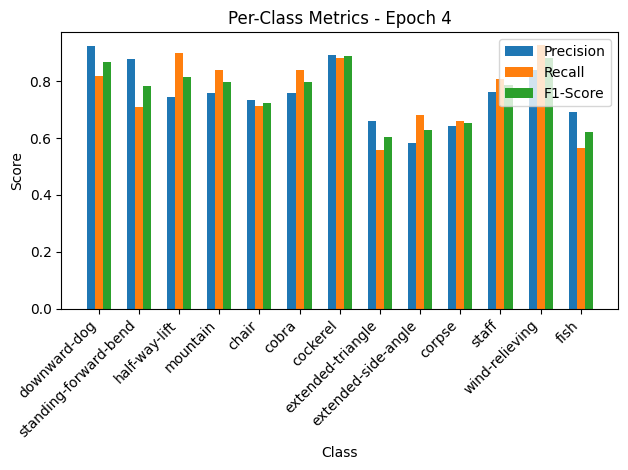


Epoch 5/50 Summary:
Train Loss: 0.8836 | Train Acc: 77.52% | Train Precision: 0.76 | Train Recall: 0.76 | Train F1: 0.76
Val Loss: 0.7582 | Val Acc: 80.82% | Val Precision: 0.83 | Val Recall: 0.79 | Val F1: 0.78
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_1.pth
Checkpoint saved at epoch 5
New best model saved! Validation Loss: 0.7582

Epoch 6/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 34.38it/s, loss=0.68, accuracy=83.4]


Per-Class Metrics for Epoch 5:
downward-dog: Precision=0.94, Recall=0.87, F1-Score=0.90
standing-forward-bend: Precision=0.90, Recall=0.73, F1-Score=0.81
half-way-lift: Precision=0.80, Recall=0.91, F1-Score=0.85
mountain: Precision=0.82, Recall=0.87, F1-Score=0.85
chair: Precision=0.86, Recall=0.82, F1-Score=0.84
cobra: Precision=0.87, Recall=0.93, F1-Score=0.90
cockerel: Precision=0.85, Recall=0.92, F1-Score=0.88
extended-triangle: Precision=0.70, Recall=0.78, F1-Score=0.74
extended-side-angle: Precision=0.79, Recall=0.68, F1-Score=0.73
corpse: Precision=0.66, Recall=0.79, F1-Score=0.72
staff: Precision=0.83, Recall=0.91, F1-Score=0.87
wind-relieving: Precision=0.94, Recall=0.94, F1-Score=0.94
fish: Precision=0.77, Recall=0.61, F1-Score=0.68


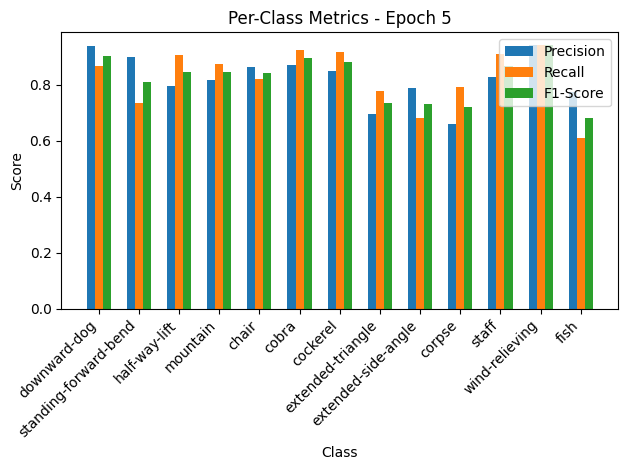

Validation: 100%|██████████| 10/10 [00:00<00:00, 133.59it/s, loss=0.511, accuracy=90.4]


Per-Class Metrics for Epoch 5:
downward-dog: Precision=0.94, Recall=0.87, F1-Score=0.90
standing-forward-bend: Precision=0.90, Recall=0.73, F1-Score=0.81
half-way-lift: Precision=0.80, Recall=0.91, F1-Score=0.85
mountain: Precision=0.82, Recall=0.87, F1-Score=0.85
chair: Precision=0.86, Recall=0.82, F1-Score=0.84
cobra: Precision=0.87, Recall=0.93, F1-Score=0.90
cockerel: Precision=0.85, Recall=0.92, F1-Score=0.88
extended-triangle: Precision=0.70, Recall=0.78, F1-Score=0.74
extended-side-angle: Precision=0.79, Recall=0.68, F1-Score=0.73
corpse: Precision=0.66, Recall=0.79, F1-Score=0.72
staff: Precision=0.83, Recall=0.91, F1-Score=0.87
wind-relieving: Precision=0.94, Recall=0.94, F1-Score=0.94
fish: Precision=0.77, Recall=0.61, F1-Score=0.68


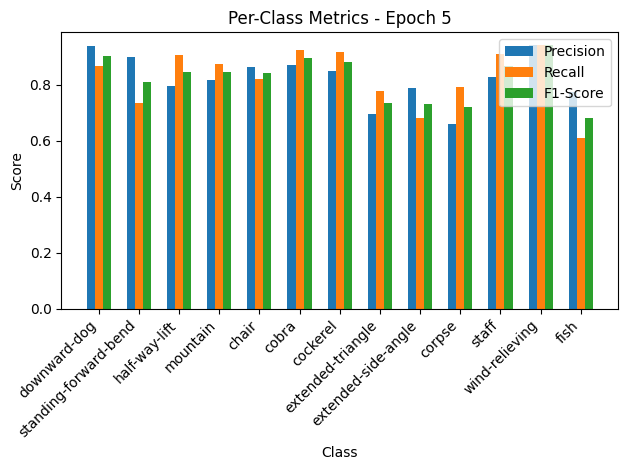


Epoch 6/50 Summary:
Train Loss: 0.6824 | Train Acc: 83.41% | Train Precision: 0.83 | Train Recall: 0.83 | Train F1: 0.82
Val Loss: 0.5602 | Val Acc: 90.41% | Val Precision: 0.91 | Val Recall: 0.90 | Val F1: 0.90
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_1.pth
Checkpoint saved at epoch 6
New best model saved! Validation Loss: 0.5602

Epoch 7/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 36.54it/s, loss=0.587, accuracy=84.8]


Per-Class Metrics for Epoch 6:
downward-dog: Precision=0.96, Recall=0.89, F1-Score=0.92
standing-forward-bend: Precision=0.91, Recall=0.77, F1-Score=0.83
half-way-lift: Precision=0.80, Recall=0.90, F1-Score=0.85
mountain: Precision=0.85, Recall=0.87, F1-Score=0.86
chair: Precision=0.82, Recall=0.84, F1-Score=0.83
cobra: Precision=0.92, Recall=0.99, F1-Score=0.95
cockerel: Precision=0.89, Recall=0.91, F1-Score=0.90
extended-triangle: Precision=0.76, Recall=0.71, F1-Score=0.74
extended-side-angle: Precision=0.71, Recall=0.79, F1-Score=0.75
corpse: Precision=0.75, Recall=0.60, F1-Score=0.67
staff: Precision=0.91, Recall=0.94, F1-Score=0.93
wind-relieving: Precision=0.89, Recall=0.96, F1-Score=0.92
fish: Precision=0.69, Recall=0.76, F1-Score=0.72


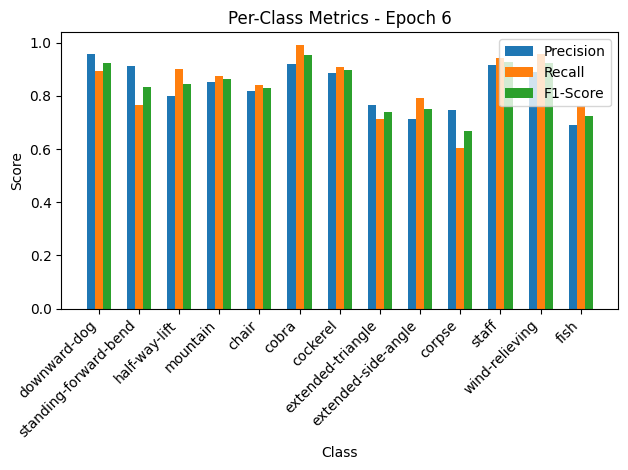

Validation: 100%|██████████| 10/10 [00:00<00:00, 150.67it/s, loss=0.387, accuracy=91.8]


Per-Class Metrics for Epoch 6:
downward-dog: Precision=0.96, Recall=0.89, F1-Score=0.92
standing-forward-bend: Precision=0.91, Recall=0.77, F1-Score=0.83
half-way-lift: Precision=0.80, Recall=0.90, F1-Score=0.85
mountain: Precision=0.85, Recall=0.87, F1-Score=0.86
chair: Precision=0.82, Recall=0.84, F1-Score=0.83
cobra: Precision=0.92, Recall=0.99, F1-Score=0.95
cockerel: Precision=0.89, Recall=0.91, F1-Score=0.90
extended-triangle: Precision=0.76, Recall=0.71, F1-Score=0.74
extended-side-angle: Precision=0.71, Recall=0.79, F1-Score=0.75
corpse: Precision=0.75, Recall=0.60, F1-Score=0.67
staff: Precision=0.91, Recall=0.94, F1-Score=0.93
wind-relieving: Precision=0.89, Recall=0.96, F1-Score=0.92
fish: Precision=0.69, Recall=0.76, F1-Score=0.72


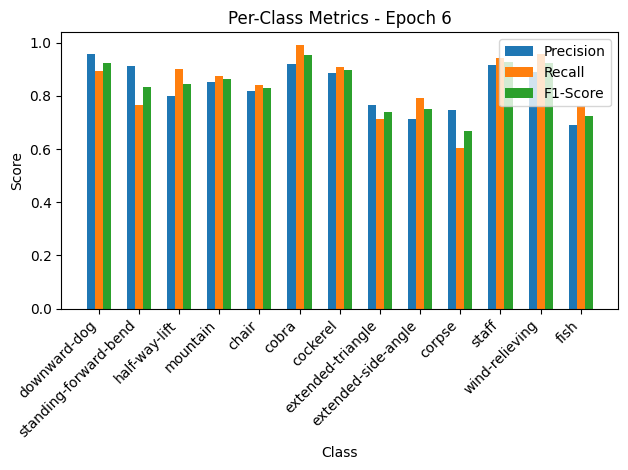


Epoch 7/50 Summary:
Train Loss: 0.5892 | Train Acc: 84.79% | Train Precision: 0.84 | Train Recall: 0.84 | Train F1: 0.84
Val Loss: 0.4245 | Val Acc: 91.78% | Val Precision: 0.92 | Val Recall: 0.92 | Val F1: 0.91
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_1.pth
Checkpoint saved at epoch 7
New best model saved! Validation Loss: 0.4245

Epoch 8/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:01<00:00, 41.28it/s, loss=0.503, accuracy=87.4]


Per-Class Metrics for Epoch 7:
downward-dog: Precision=0.94, Recall=0.86, F1-Score=0.90
standing-forward-bend: Precision=0.94, Recall=0.78, F1-Score=0.86
half-way-lift: Precision=0.82, Recall=0.93, F1-Score=0.87
mountain: Precision=0.86, Recall=0.91, F1-Score=0.89
chair: Precision=0.84, Recall=0.84, F1-Score=0.84
cobra: Precision=0.93, Recall=0.96, F1-Score=0.94
cockerel: Precision=0.91, Recall=0.95, F1-Score=0.93
extended-triangle: Precision=0.93, Recall=0.83, F1-Score=0.88
extended-side-angle: Precision=0.80, Recall=0.92, F1-Score=0.85
corpse: Precision=0.73, Recall=0.68, F1-Score=0.70
staff: Precision=0.90, Recall=0.97, F1-Score=0.94
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.71, Recall=0.75, F1-Score=0.73


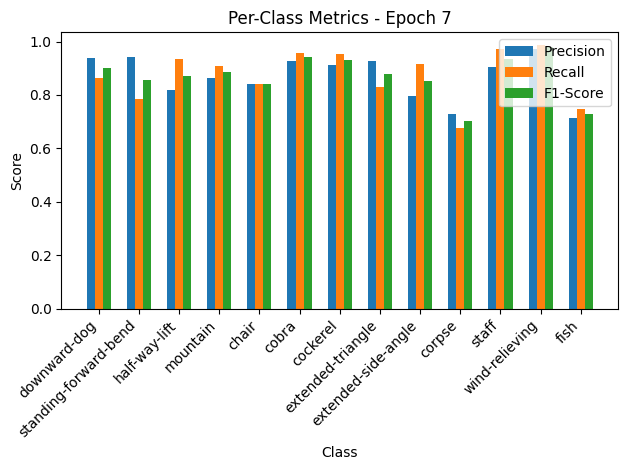

Validation: 100%|██████████| 10/10 [00:00<00:00, 180.49it/s, loss=0.424, accuracy=87.7]


Per-Class Metrics for Epoch 7:
downward-dog: Precision=0.94, Recall=0.86, F1-Score=0.90
standing-forward-bend: Precision=0.94, Recall=0.78, F1-Score=0.86
half-way-lift: Precision=0.82, Recall=0.93, F1-Score=0.87
mountain: Precision=0.86, Recall=0.91, F1-Score=0.89
chair: Precision=0.84, Recall=0.84, F1-Score=0.84
cobra: Precision=0.93, Recall=0.96, F1-Score=0.94
cockerel: Precision=0.91, Recall=0.95, F1-Score=0.93
extended-triangle: Precision=0.93, Recall=0.83, F1-Score=0.88
extended-side-angle: Precision=0.80, Recall=0.92, F1-Score=0.85
corpse: Precision=0.73, Recall=0.68, F1-Score=0.70
staff: Precision=0.90, Recall=0.97, F1-Score=0.94
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.71, Recall=0.75, F1-Score=0.73


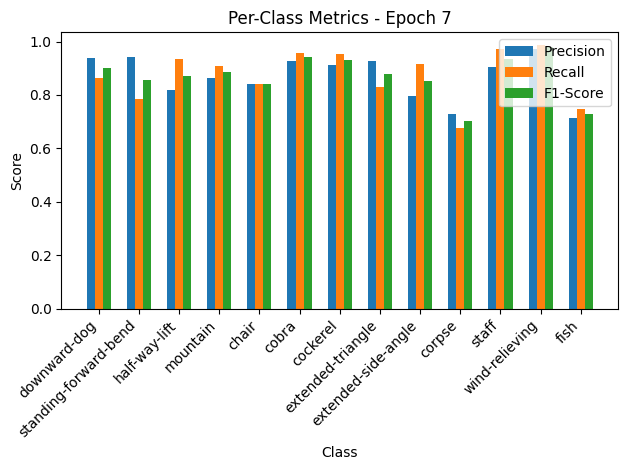


Epoch 8/50 Summary:
Train Loss: 0.5046 | Train Acc: 87.39% | Train Precision: 0.87 | Train Recall: 0.87 | Train F1: 0.87
Val Loss: 0.4648 | Val Acc: 87.67% | Val Precision: 0.89 | Val Recall: 0.88 | Val F1: 0.88

Epoch 9/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:01<00:00, 41.25it/s, loss=0.455, accuracy=87.8]


Per-Class Metrics for Epoch 8:
downward-dog: Precision=0.94, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=0.96, Recall=0.80, F1-Score=0.87
half-way-lift: Precision=0.83, Recall=0.91, F1-Score=0.87
mountain: Precision=0.87, Recall=0.91, F1-Score=0.89
chair: Precision=0.81, Recall=0.87, F1-Score=0.84
cobra: Precision=0.92, Recall=0.94, F1-Score=0.93
cockerel: Precision=0.93, Recall=0.92, F1-Score=0.92
extended-triangle: Precision=0.90, Recall=0.91, F1-Score=0.90
extended-side-angle: Precision=0.89, Recall=0.88, F1-Score=0.88
corpse: Precision=0.75, Recall=0.72, F1-Score=0.74
staff: Precision=0.88, Recall=0.94, F1-Score=0.91
wind-relieving: Precision=0.93, Recall=1.00, F1-Score=0.96
fish: Precision=0.72, Recall=0.72, F1-Score=0.72


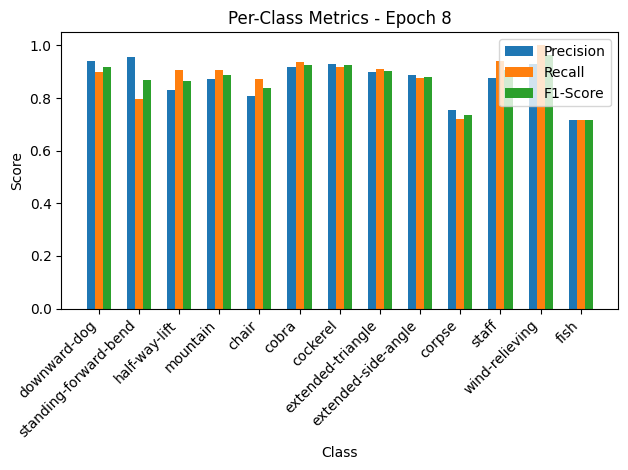

Validation: 100%|██████████| 10/10 [00:00<00:00, 173.47it/s, loss=0.408, accuracy=87.7]


Per-Class Metrics for Epoch 8:
downward-dog: Precision=0.94, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=0.96, Recall=0.80, F1-Score=0.87
half-way-lift: Precision=0.83, Recall=0.91, F1-Score=0.87
mountain: Precision=0.87, Recall=0.91, F1-Score=0.89
chair: Precision=0.81, Recall=0.87, F1-Score=0.84
cobra: Precision=0.92, Recall=0.94, F1-Score=0.93
cockerel: Precision=0.93, Recall=0.92, F1-Score=0.92
extended-triangle: Precision=0.90, Recall=0.91, F1-Score=0.90
extended-side-angle: Precision=0.89, Recall=0.88, F1-Score=0.88
corpse: Precision=0.75, Recall=0.72, F1-Score=0.74
staff: Precision=0.88, Recall=0.94, F1-Score=0.91
wind-relieving: Precision=0.93, Recall=1.00, F1-Score=0.96
fish: Precision=0.72, Recall=0.72, F1-Score=0.72


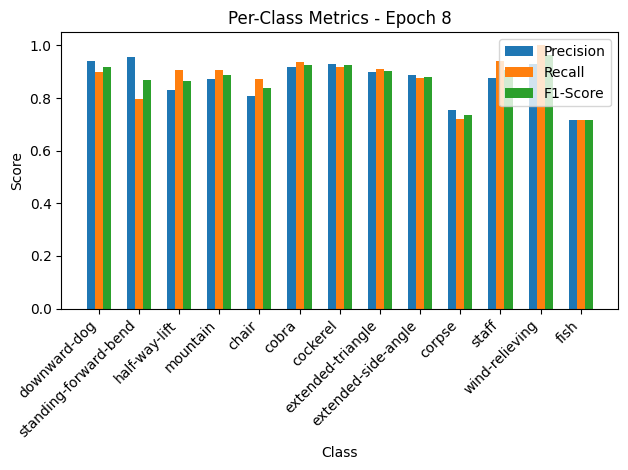


Epoch 9/50 Summary:
Train Loss: 0.4561 | Train Acc: 87.77% | Train Precision: 0.87 | Train Recall: 0.88 | Train F1: 0.87
Val Loss: 0.4472 | Val Acc: 87.67% | Val Precision: 0.87 | Val Recall: 0.86 | Val F1: 0.85

Epoch 10/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 34.63it/s, loss=0.478, accuracy=86.6]


Per-Class Metrics for Epoch 9:
downward-dog: Precision=0.92, Recall=0.87, F1-Score=0.89
standing-forward-bend: Precision=0.88, Recall=0.80, F1-Score=0.83
half-way-lift: Precision=0.82, Recall=0.91, F1-Score=0.86
mountain: Precision=0.83, Recall=0.92, F1-Score=0.87
chair: Precision=0.86, Recall=0.78, F1-Score=0.82
cobra: Precision=0.93, Recall=0.94, F1-Score=0.93
cockerel: Precision=0.90, Recall=0.93, F1-Score=0.91
extended-triangle: Precision=0.80, Recall=0.88, F1-Score=0.84
extended-side-angle: Precision=0.86, Recall=0.78, F1-Score=0.82
corpse: Precision=0.80, Recall=0.75, F1-Score=0.77
staff: Precision=0.91, Recall=0.94, F1-Score=0.93
wind-relieving: Precision=0.94, Recall=0.94, F1-Score=0.94
fish: Precision=0.79, Recall=0.84, F1-Score=0.81


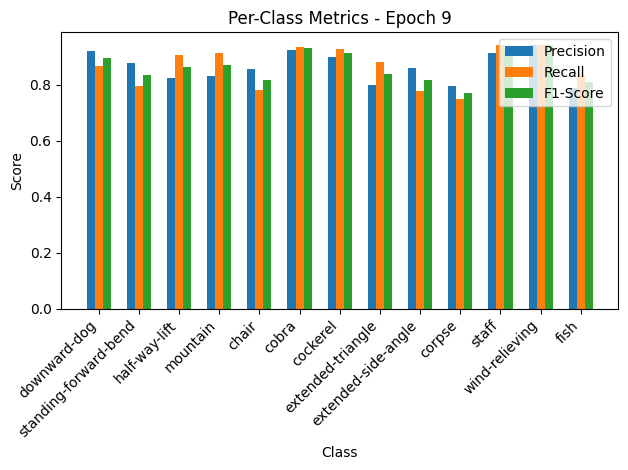

Validation: 100%|██████████| 10/10 [00:00<00:00, 148.75it/s, loss=0.289, accuracy=93.2]


Per-Class Metrics for Epoch 9:
downward-dog: Precision=0.92, Recall=0.87, F1-Score=0.89
standing-forward-bend: Precision=0.88, Recall=0.80, F1-Score=0.83
half-way-lift: Precision=0.82, Recall=0.91, F1-Score=0.86
mountain: Precision=0.83, Recall=0.92, F1-Score=0.87
chair: Precision=0.86, Recall=0.78, F1-Score=0.82
cobra: Precision=0.93, Recall=0.94, F1-Score=0.93
cockerel: Precision=0.90, Recall=0.93, F1-Score=0.91
extended-triangle: Precision=0.80, Recall=0.88, F1-Score=0.84
extended-side-angle: Precision=0.86, Recall=0.78, F1-Score=0.82
corpse: Precision=0.80, Recall=0.75, F1-Score=0.77
staff: Precision=0.91, Recall=0.94, F1-Score=0.93
wind-relieving: Precision=0.94, Recall=0.94, F1-Score=0.94
fish: Precision=0.79, Recall=0.84, F1-Score=0.81


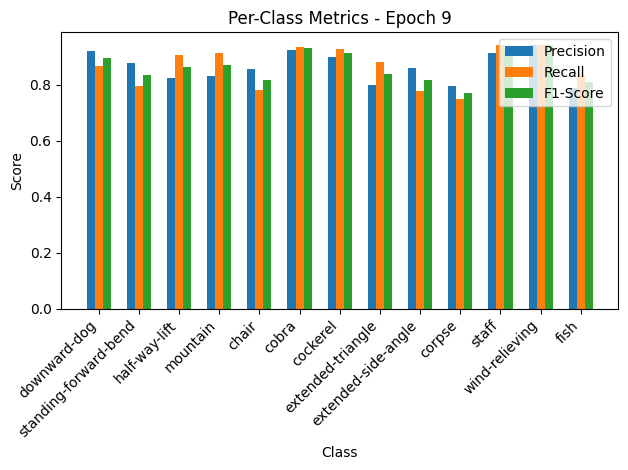


Epoch 10/50 Summary:
Train Loss: 0.4798 | Train Acc: 86.62% | Train Precision: 0.86 | Train Recall: 0.87 | Train F1: 0.86
Val Loss: 0.3164 | Val Acc: 93.15% | Val Precision: 0.94 | Val Recall: 0.94 | Val F1: 0.94
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_1.pth
Checkpoint saved at epoch 10
New best model saved! Validation Loss: 0.3164

Epoch 11/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 36.00it/s, loss=0.403, accuracy=88.1]


Per-Class Metrics for Epoch 10:
downward-dog: Precision=0.94, Recall=0.88, F1-Score=0.91
standing-forward-bend: Precision=0.90, Recall=0.82, F1-Score=0.86
half-way-lift: Precision=0.86, Recall=0.92, F1-Score=0.89
mountain: Precision=0.88, Recall=0.95, F1-Score=0.91
chair: Precision=0.90, Recall=0.87, F1-Score=0.88
cobra: Precision=0.89, Recall=0.98, F1-Score=0.93
cockerel: Precision=0.90, Recall=0.93, F1-Score=0.91
extended-triangle: Precision=0.88, Recall=0.87, F1-Score=0.88
extended-side-angle: Precision=0.83, Recall=0.83, F1-Score=0.83
corpse: Precision=0.73, Recall=0.75, F1-Score=0.74
staff: Precision=0.96, Recall=0.96, F1-Score=0.96
wind-relieving: Precision=0.91, Recall=0.93, F1-Score=0.92
fish: Precision=0.76, Recall=0.72, F1-Score=0.74


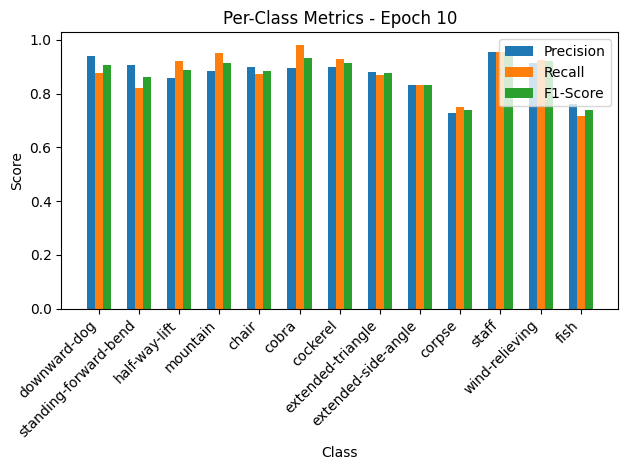

Validation: 100%|██████████| 10/10 [00:00<00:00, 168.57it/s, loss=0.33, accuracy=88.4]


Per-Class Metrics for Epoch 10:
downward-dog: Precision=0.94, Recall=0.88, F1-Score=0.91
standing-forward-bend: Precision=0.90, Recall=0.82, F1-Score=0.86
half-way-lift: Precision=0.86, Recall=0.92, F1-Score=0.89
mountain: Precision=0.88, Recall=0.95, F1-Score=0.91
chair: Precision=0.90, Recall=0.87, F1-Score=0.88
cobra: Precision=0.89, Recall=0.98, F1-Score=0.93
cockerel: Precision=0.90, Recall=0.93, F1-Score=0.91
extended-triangle: Precision=0.88, Recall=0.87, F1-Score=0.88
extended-side-angle: Precision=0.83, Recall=0.83, F1-Score=0.83
corpse: Precision=0.73, Recall=0.75, F1-Score=0.74
staff: Precision=0.96, Recall=0.96, F1-Score=0.96
wind-relieving: Precision=0.91, Recall=0.93, F1-Score=0.92
fish: Precision=0.76, Recall=0.72, F1-Score=0.74


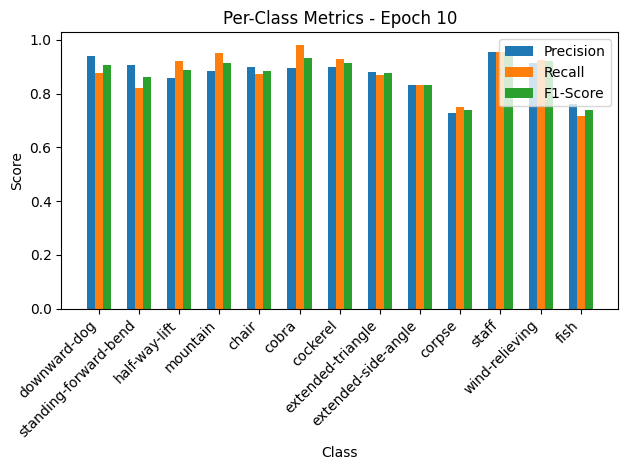


Epoch 11/50 Summary:
Train Loss: 0.4046 | Train Acc: 88.07% | Train Precision: 0.87 | Train Recall: 0.88 | Train F1: 0.87
Val Loss: 0.3620 | Val Acc: 88.36% | Val Precision: 0.92 | Val Recall: 0.86 | Val F1: 0.85

Epoch 12/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:01<00:00, 41.96it/s, loss=0.399, accuracy=88.7]


Per-Class Metrics for Epoch 11:
downward-dog: Precision=0.96, Recall=0.91, F1-Score=0.94
standing-forward-bend: Precision=0.90, Recall=0.81, F1-Score=0.85
half-way-lift: Precision=0.84, Recall=0.89, F1-Score=0.86
mountain: Precision=0.89, Recall=0.92, F1-Score=0.91
chair: Precision=0.85, Recall=0.84, F1-Score=0.85
cobra: Precision=0.90, Recall=0.95, F1-Score=0.92
cockerel: Precision=0.90, Recall=0.98, F1-Score=0.94
extended-triangle: Precision=0.92, Recall=0.92, F1-Score=0.92
extended-side-angle: Precision=0.90, Recall=0.92, F1-Score=0.91
corpse: Precision=0.77, Recall=0.71, F1-Score=0.74
staff: Precision=0.93, Recall=0.96, F1-Score=0.94
wind-relieving: Precision=0.94, Recall=0.97, F1-Score=0.96
fish: Precision=0.74, Recall=0.78, F1-Score=0.76


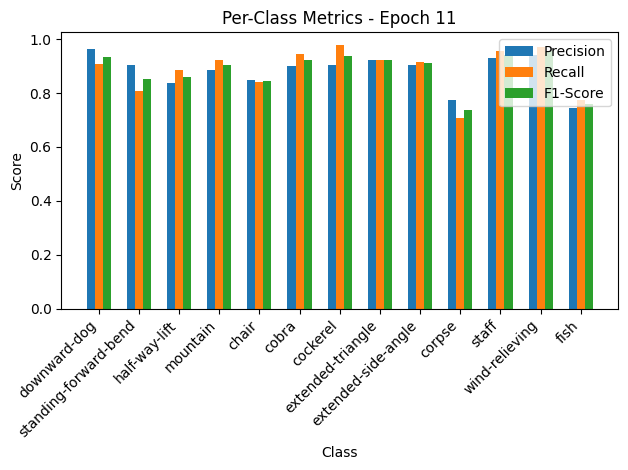

Validation: 100%|██████████| 10/10 [00:00<00:00, 174.31it/s, loss=0.322, accuracy=91.1]


Per-Class Metrics for Epoch 11:
downward-dog: Precision=0.96, Recall=0.91, F1-Score=0.94
standing-forward-bend: Precision=0.90, Recall=0.81, F1-Score=0.85
half-way-lift: Precision=0.84, Recall=0.89, F1-Score=0.86
mountain: Precision=0.89, Recall=0.92, F1-Score=0.91
chair: Precision=0.85, Recall=0.84, F1-Score=0.85
cobra: Precision=0.90, Recall=0.95, F1-Score=0.92
cockerel: Precision=0.90, Recall=0.98, F1-Score=0.94
extended-triangle: Precision=0.92, Recall=0.92, F1-Score=0.92
extended-side-angle: Precision=0.90, Recall=0.92, F1-Score=0.91
corpse: Precision=0.77, Recall=0.71, F1-Score=0.74
staff: Precision=0.93, Recall=0.96, F1-Score=0.94
wind-relieving: Precision=0.94, Recall=0.97, F1-Score=0.96
fish: Precision=0.74, Recall=0.78, F1-Score=0.76


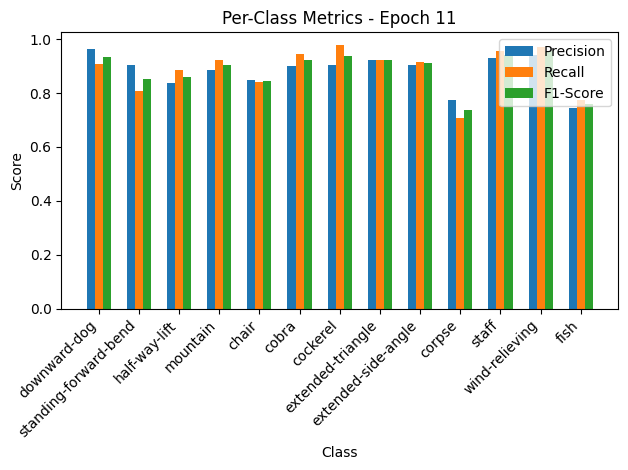


Epoch 12/50 Summary:
Train Loss: 0.4000 | Train Acc: 88.69% | Train Precision: 0.88 | Train Recall: 0.89 | Train F1: 0.88
Val Loss: 0.3531 | Val Acc: 91.10% | Val Precision: 0.93 | Val Recall: 0.93 | Val F1: 0.93

Epoch 13/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 38.69it/s, loss=0.387, accuracy=89.1]


Per-Class Metrics for Epoch 12:
downward-dog: Precision=0.96, Recall=0.89, F1-Score=0.92
standing-forward-bend: Precision=0.93, Recall=0.81, F1-Score=0.86
half-way-lift: Precision=0.86, Recall=0.93, F1-Score=0.89
mountain: Precision=0.89, Recall=0.97, F1-Score=0.93
chair: Precision=0.94, Recall=0.90, F1-Score=0.92
cobra: Precision=0.90, Recall=0.99, F1-Score=0.94
cockerel: Precision=0.93, Recall=0.97, F1-Score=0.95
extended-triangle: Precision=0.88, Recall=0.84, F1-Score=0.86
extended-side-angle: Precision=0.82, Recall=0.85, F1-Score=0.84
corpse: Precision=0.73, Recall=0.75, F1-Score=0.74
staff: Precision=0.96, Recall=0.97, F1-Score=0.96
wind-relieving: Precision=0.92, Recall=0.96, F1-Score=0.94
fish: Precision=0.73, Recall=0.69, F1-Score=0.71


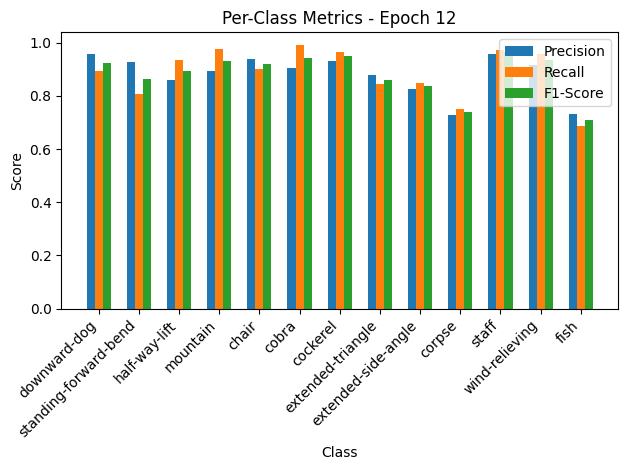

Validation: 100%|██████████| 10/10 [00:00<00:00, 162.11it/s, loss=0.418, accuracy=87]


Per-Class Metrics for Epoch 12:
downward-dog: Precision=0.96, Recall=0.89, F1-Score=0.92
standing-forward-bend: Precision=0.93, Recall=0.81, F1-Score=0.86
half-way-lift: Precision=0.86, Recall=0.93, F1-Score=0.89
mountain: Precision=0.89, Recall=0.97, F1-Score=0.93
chair: Precision=0.94, Recall=0.90, F1-Score=0.92
cobra: Precision=0.90, Recall=0.99, F1-Score=0.94
cockerel: Precision=0.93, Recall=0.97, F1-Score=0.95
extended-triangle: Precision=0.88, Recall=0.84, F1-Score=0.86
extended-side-angle: Precision=0.82, Recall=0.85, F1-Score=0.84
corpse: Precision=0.73, Recall=0.75, F1-Score=0.74
staff: Precision=0.96, Recall=0.97, F1-Score=0.96
wind-relieving: Precision=0.92, Recall=0.96, F1-Score=0.94
fish: Precision=0.73, Recall=0.69, F1-Score=0.71


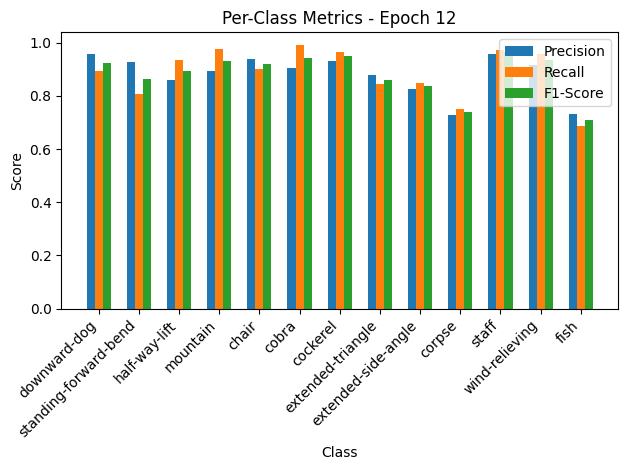


Epoch 13/50 Summary:
Train Loss: 0.3881 | Train Acc: 89.07% | Train Precision: 0.88 | Train Recall: 0.89 | Train F1: 0.88
Val Loss: 0.4579 | Val Acc: 86.99% | Val Precision: 0.88 | Val Recall: 0.88 | Val F1: 0.87

Epoch 14/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 39.93it/s, loss=0.38, accuracy=88.4]


Per-Class Metrics for Epoch 13:
downward-dog: Precision=0.96, Recall=0.91, F1-Score=0.93
standing-forward-bend: Precision=0.88, Recall=0.79, F1-Score=0.83
half-way-lift: Precision=0.83, Recall=0.87, F1-Score=0.85
mountain: Precision=0.84, Recall=0.96, F1-Score=0.90
chair: Precision=0.85, Recall=0.85, F1-Score=0.85
cobra: Precision=0.92, Recall=0.95, F1-Score=0.93
cockerel: Precision=0.91, Recall=0.98, F1-Score=0.94
extended-triangle: Precision=0.91, Recall=0.88, F1-Score=0.89
extended-side-angle: Precision=0.87, Recall=0.86, F1-Score=0.87
corpse: Precision=0.74, Recall=0.82, F1-Score=0.78
staff: Precision=0.97, Recall=0.97, F1-Score=0.97
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.82, Recall=0.69, F1-Score=0.75


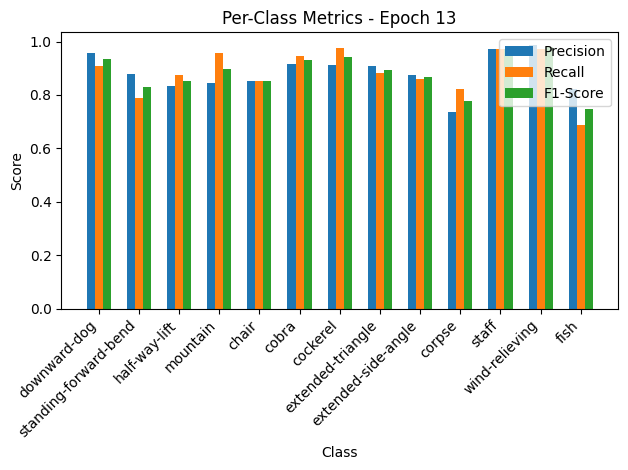

Validation: 100%|██████████| 10/10 [00:00<00:00, 151.25it/s, loss=0.298, accuracy=87.7]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 13:
downward-dog: Precision=0.96, Recall=0.91, F1-Score=0.93
standing-forward-bend: Precision=0.88, Recall=0.79, F1-Score=0.83
half-way-lift: Precision=0.83, Recall=0.87, F1-Score=0.85
mountain: Precision=0.84, Recall=0.96, F1-Score=0.90
chair: Precision=0.85, Recall=0.85, F1-Score=0.85
cobra: Precision=0.92, Recall=0.95, F1-Score=0.93
cockerel: Precision=0.91, Recall=0.98, F1-Score=0.94
extended-triangle: Precision=0.91, Recall=0.88, F1-Score=0.89
extended-side-angle: Precision=0.87, Recall=0.86, F1-Score=0.87
corpse: Precision=0.74, Recall=0.82, F1-Score=0.78
staff: Precision=0.97, Recall=0.97, F1-Score=0.97
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.82, Recall=0.69, F1-Score=0.75


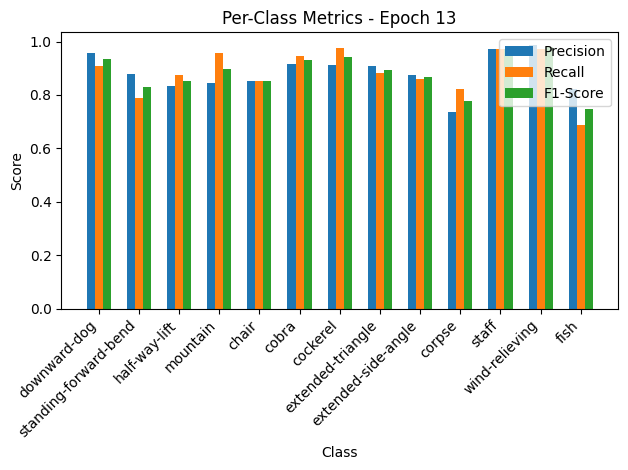


Epoch 14/50 Summary:
Train Loss: 0.3813 | Train Acc: 88.38% | Train Precision: 0.88 | Train Recall: 0.88 | Train F1: 0.88
Val Loss: 0.3267 | Val Acc: 87.67% | Val Precision: 0.83 | Val Recall: 0.86 | Val F1: 0.84

Epoch 15/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 34.20it/s, loss=0.39, accuracy=87.8]


Per-Class Metrics for Epoch 14:
downward-dog: Precision=0.94, Recall=0.87, F1-Score=0.91
standing-forward-bend: Precision=0.91, Recall=0.83, F1-Score=0.87
half-way-lift: Precision=0.82, Recall=0.91, F1-Score=0.86
mountain: Precision=0.88, Recall=0.95, F1-Score=0.91
chair: Precision=0.88, Recall=0.90, F1-Score=0.89
cobra: Precision=0.90, Recall=0.95, F1-Score=0.92
cockerel: Precision=0.92, Recall=0.92, F1-Score=0.92
extended-triangle: Precision=0.89, Recall=0.95, F1-Score=0.92
extended-side-angle: Precision=0.94, Recall=0.85, F1-Score=0.89
corpse: Precision=0.68, Recall=0.72, F1-Score=0.70
staff: Precision=0.94, Recall=0.91, F1-Score=0.93
wind-relieving: Precision=0.93, Recall=0.96, F1-Score=0.94
fish: Precision=0.68, Recall=0.63, F1-Score=0.65


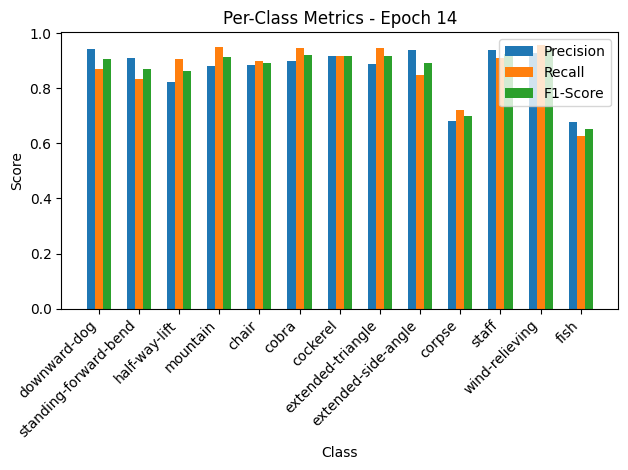

Validation: 100%|██████████| 10/10 [00:00<00:00, 126.17it/s, loss=0.27, accuracy=92.5]


Per-Class Metrics for Epoch 14:
downward-dog: Precision=0.94, Recall=0.87, F1-Score=0.91
standing-forward-bend: Precision=0.91, Recall=0.83, F1-Score=0.87
half-way-lift: Precision=0.82, Recall=0.91, F1-Score=0.86
mountain: Precision=0.88, Recall=0.95, F1-Score=0.91
chair: Precision=0.88, Recall=0.90, F1-Score=0.89
cobra: Precision=0.90, Recall=0.95, F1-Score=0.92
cockerel: Precision=0.92, Recall=0.92, F1-Score=0.92
extended-triangle: Precision=0.89, Recall=0.95, F1-Score=0.92
extended-side-angle: Precision=0.94, Recall=0.85, F1-Score=0.89
corpse: Precision=0.68, Recall=0.72, F1-Score=0.70
staff: Precision=0.94, Recall=0.91, F1-Score=0.93
wind-relieving: Precision=0.93, Recall=0.96, F1-Score=0.94
fish: Precision=0.68, Recall=0.63, F1-Score=0.65


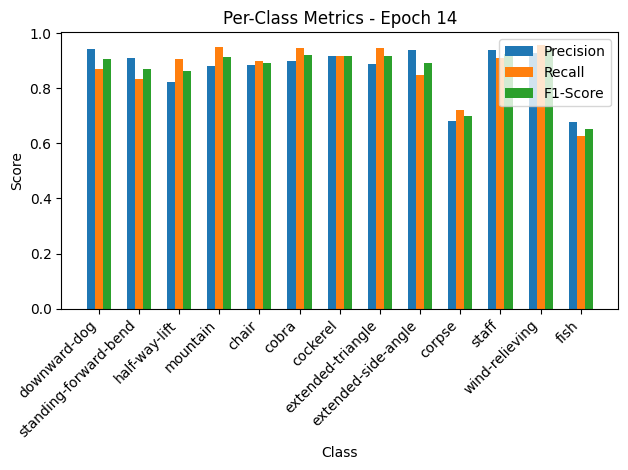


Epoch 15/50 Summary:
Train Loss: 0.3916 | Train Acc: 87.77% | Train Precision: 0.87 | Train Recall: 0.87 | Train F1: 0.87
Val Loss: 0.2956 | Val Acc: 92.47% | Val Precision: 0.94 | Val Recall: 0.94 | Val F1: 0.94
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_1.pth
Checkpoint saved at epoch 15
New best model saved! Validation Loss: 0.2956

Epoch 16/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 38.42it/s, loss=0.367, accuracy=89.7]


Per-Class Metrics for Epoch 15:
downward-dog: Precision=0.95, Recall=0.88, F1-Score=0.91
standing-forward-bend: Precision=0.88, Recall=0.85, F1-Score=0.87
half-way-lift: Precision=0.89, Recall=0.90, F1-Score=0.90
mountain: Precision=0.91, Recall=0.97, F1-Score=0.94
chair: Precision=0.89, Recall=0.91, F1-Score=0.90
cobra: Precision=0.94, Recall=0.95, F1-Score=0.94
cockerel: Precision=0.92, Recall=0.95, F1-Score=0.94
extended-triangle: Precision=0.90, Recall=0.96, F1-Score=0.93
extended-side-angle: Precision=0.93, Recall=0.86, F1-Score=0.89
corpse: Precision=0.80, Recall=0.69, F1-Score=0.74
staff: Precision=0.94, Recall=0.99, F1-Score=0.96
wind-relieving: Precision=0.90, Recall=0.94, F1-Score=0.92
fish: Precision=0.72, Recall=0.79, F1-Score=0.75


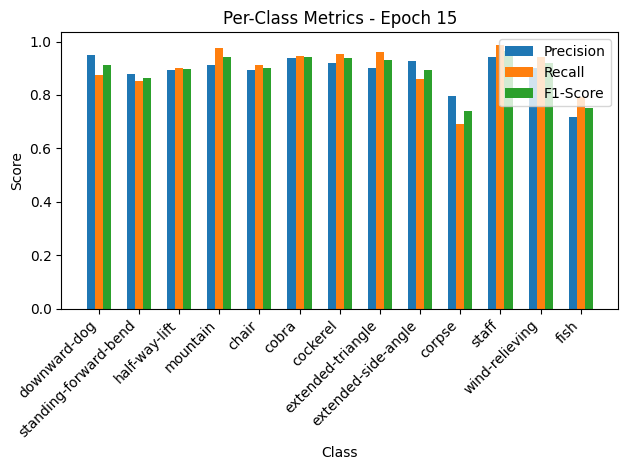

Validation: 100%|██████████| 10/10 [00:00<00:00, 177.45it/s, loss=0.235, accuracy=91.8]


Per-Class Metrics for Epoch 15:
downward-dog: Precision=0.95, Recall=0.88, F1-Score=0.91
standing-forward-bend: Precision=0.88, Recall=0.85, F1-Score=0.87
half-way-lift: Precision=0.89, Recall=0.90, F1-Score=0.90
mountain: Precision=0.91, Recall=0.97, F1-Score=0.94
chair: Precision=0.89, Recall=0.91, F1-Score=0.90
cobra: Precision=0.94, Recall=0.95, F1-Score=0.94
cockerel: Precision=0.92, Recall=0.95, F1-Score=0.94
extended-triangle: Precision=0.90, Recall=0.96, F1-Score=0.93
extended-side-angle: Precision=0.93, Recall=0.86, F1-Score=0.89
corpse: Precision=0.80, Recall=0.69, F1-Score=0.74
staff: Precision=0.94, Recall=0.99, F1-Score=0.96
wind-relieving: Precision=0.90, Recall=0.94, F1-Score=0.92
fish: Precision=0.72, Recall=0.79, F1-Score=0.75


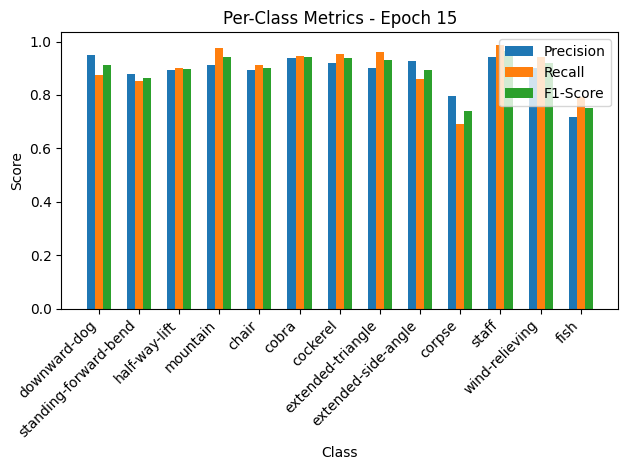


Epoch 16/50 Summary:
Train Loss: 0.3680 | Train Acc: 89.68% | Train Precision: 0.89 | Train Recall: 0.90 | Train F1: 0.89
Val Loss: 0.2577 | Val Acc: 91.78% | Val Precision: 0.94 | Val Recall: 0.91 | Val F1: 0.91
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_1.pth
Checkpoint saved at epoch 16
New best model saved! Validation Loss: 0.2577

Epoch 17/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 40.65it/s, loss=0.394, accuracy=88.4]


Per-Class Metrics for Epoch 16:
downward-dog: Precision=0.96, Recall=0.90, F1-Score=0.93
standing-forward-bend: Precision=0.88, Recall=0.84, F1-Score=0.86
half-way-lift: Precision=0.88, Recall=0.89, F1-Score=0.88
mountain: Precision=0.90, Recall=0.93, F1-Score=0.92
chair: Precision=0.87, Recall=0.88, F1-Score=0.88
cobra: Precision=0.88, Recall=0.91, F1-Score=0.90
cockerel: Precision=0.90, Recall=0.98, F1-Score=0.94
extended-triangle: Precision=0.88, Recall=0.84, F1-Score=0.86
extended-side-angle: Precision=0.84, Recall=0.85, F1-Score=0.84
corpse: Precision=0.81, Recall=0.69, F1-Score=0.75
staff: Precision=0.90, Recall=0.94, F1-Score=0.92
wind-relieving: Precision=0.96, Recall=0.99, F1-Score=0.97
fish: Precision=0.74, Recall=0.81, F1-Score=0.77


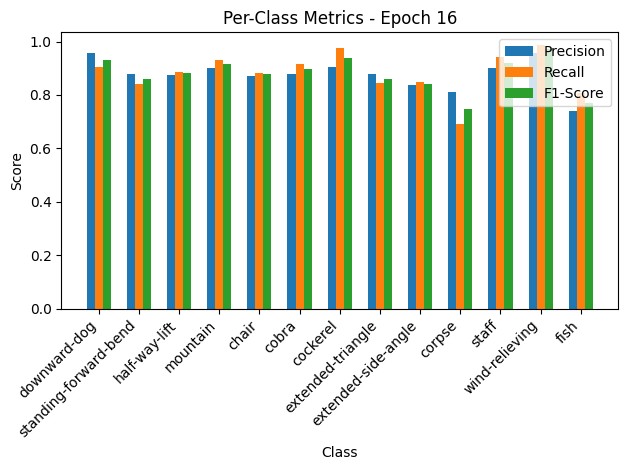

Validation: 100%|██████████| 10/10 [00:00<00:00, 157.65it/s, loss=0.333, accuracy=90.4]


Per-Class Metrics for Epoch 16:
downward-dog: Precision=0.96, Recall=0.90, F1-Score=0.93
standing-forward-bend: Precision=0.88, Recall=0.84, F1-Score=0.86
half-way-lift: Precision=0.88, Recall=0.89, F1-Score=0.88
mountain: Precision=0.90, Recall=0.93, F1-Score=0.92
chair: Precision=0.87, Recall=0.88, F1-Score=0.88
cobra: Precision=0.88, Recall=0.91, F1-Score=0.90
cockerel: Precision=0.90, Recall=0.98, F1-Score=0.94
extended-triangle: Precision=0.88, Recall=0.84, F1-Score=0.86
extended-side-angle: Precision=0.84, Recall=0.85, F1-Score=0.84
corpse: Precision=0.81, Recall=0.69, F1-Score=0.75
staff: Precision=0.90, Recall=0.94, F1-Score=0.92
wind-relieving: Precision=0.96, Recall=0.99, F1-Score=0.97
fish: Precision=0.74, Recall=0.81, F1-Score=0.77


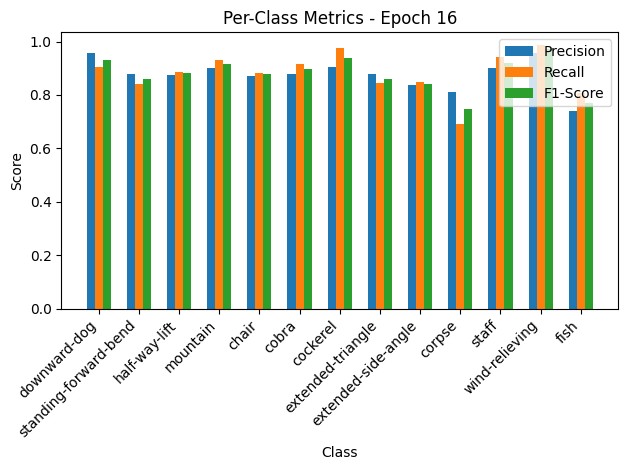


Epoch 17/50 Summary:
Train Loss: 0.3951 | Train Acc: 88.38% | Train Precision: 0.88 | Train Recall: 0.88 | Train F1: 0.88
Val Loss: 0.3648 | Val Acc: 90.41% | Val Precision: 0.91 | Val Recall: 0.90 | Val F1: 0.90

Epoch 18/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 39.67it/s, loss=0.382, accuracy=88.3]


Per-Class Metrics for Epoch 17:
downward-dog: Precision=0.93, Recall=0.88, F1-Score=0.90
standing-forward-bend: Precision=0.87, Recall=0.84, F1-Score=0.86
half-way-lift: Precision=0.87, Recall=0.87, F1-Score=0.87
mountain: Precision=0.88, Recall=0.95, F1-Score=0.91
chair: Precision=0.88, Recall=0.86, F1-Score=0.87
cobra: Precision=0.88, Recall=0.97, F1-Score=0.92
cockerel: Precision=0.91, Recall=0.95, F1-Score=0.93
extended-triangle: Precision=0.88, Recall=0.86, F1-Score=0.87
extended-side-angle: Precision=0.84, Recall=0.88, F1-Score=0.86
corpse: Precision=0.81, Recall=0.71, F1-Score=0.76
staff: Precision=0.96, Recall=0.97, F1-Score=0.96
wind-relieving: Precision=0.96, Recall=0.99, F1-Score=0.97
fish: Precision=0.75, Recall=0.76, F1-Score=0.76


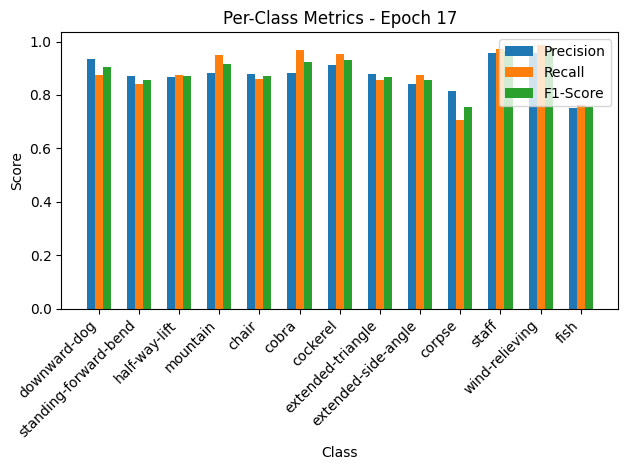

Validation: 100%|██████████| 10/10 [00:00<00:00, 127.32it/s, loss=0.361, accuracy=84.2]


Per-Class Metrics for Epoch 17:
downward-dog: Precision=0.93, Recall=0.88, F1-Score=0.90
standing-forward-bend: Precision=0.87, Recall=0.84, F1-Score=0.86
half-way-lift: Precision=0.87, Recall=0.87, F1-Score=0.87
mountain: Precision=0.88, Recall=0.95, F1-Score=0.91
chair: Precision=0.88, Recall=0.86, F1-Score=0.87
cobra: Precision=0.88, Recall=0.97, F1-Score=0.92
cockerel: Precision=0.91, Recall=0.95, F1-Score=0.93
extended-triangle: Precision=0.88, Recall=0.86, F1-Score=0.87
extended-side-angle: Precision=0.84, Recall=0.88, F1-Score=0.86
corpse: Precision=0.81, Recall=0.71, F1-Score=0.76
staff: Precision=0.96, Recall=0.97, F1-Score=0.96
wind-relieving: Precision=0.96, Recall=0.99, F1-Score=0.97
fish: Precision=0.75, Recall=0.76, F1-Score=0.76


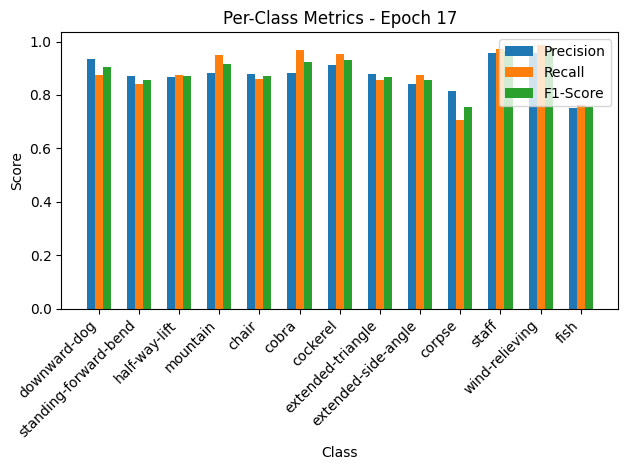


Epoch 18/50 Summary:
Train Loss: 0.3834 | Train Acc: 88.30% | Train Precision: 0.88 | Train Recall: 0.88 | Train F1: 0.88
Val Loss: 0.3960 | Val Acc: 84.25% | Val Precision: 0.87 | Val Recall: 0.86 | Val F1: 0.85

Epoch 19/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 32.90it/s, loss=0.358, accuracy=88.9]


Per-Class Metrics for Epoch 18:
downward-dog: Precision=0.93, Recall=0.90, F1-Score=0.91
standing-forward-bend: Precision=0.89, Recall=0.83, F1-Score=0.86
half-way-lift: Precision=0.88, Recall=0.86, F1-Score=0.87
mountain: Precision=0.90, Recall=0.95, F1-Score=0.93
chair: Precision=0.89, Recall=0.90, F1-Score=0.90
cobra: Precision=0.91, Recall=0.96, F1-Score=0.93
cockerel: Precision=0.93, Recall=0.99, F1-Score=0.96
extended-triangle: Precision=0.94, Recall=0.94, F1-Score=0.94
extended-side-angle: Precision=0.92, Recall=0.94, F1-Score=0.93
corpse: Precision=0.70, Recall=0.66, F1-Score=0.68
staff: Precision=0.97, Recall=0.99, F1-Score=0.98
wind-relieving: Precision=0.92, Recall=0.96, F1-Score=0.94
fish: Precision=0.67, Recall=0.67, F1-Score=0.67


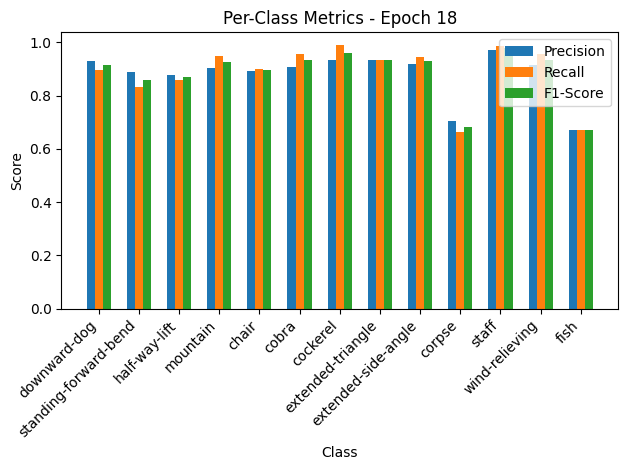

Validation: 100%|██████████| 10/10 [00:00<00:00, 128.92it/s, loss=0.398, accuracy=93.2]


Per-Class Metrics for Epoch 18:
downward-dog: Precision=0.93, Recall=0.90, F1-Score=0.91
standing-forward-bend: Precision=0.89, Recall=0.83, F1-Score=0.86
half-way-lift: Precision=0.88, Recall=0.86, F1-Score=0.87
mountain: Precision=0.90, Recall=0.95, F1-Score=0.93
chair: Precision=0.89, Recall=0.90, F1-Score=0.90
cobra: Precision=0.91, Recall=0.96, F1-Score=0.93
cockerel: Precision=0.93, Recall=0.99, F1-Score=0.96
extended-triangle: Precision=0.94, Recall=0.94, F1-Score=0.94
extended-side-angle: Precision=0.92, Recall=0.94, F1-Score=0.93
corpse: Precision=0.70, Recall=0.66, F1-Score=0.68
staff: Precision=0.97, Recall=0.99, F1-Score=0.98
wind-relieving: Precision=0.92, Recall=0.96, F1-Score=0.94
fish: Precision=0.67, Recall=0.67, F1-Score=0.67


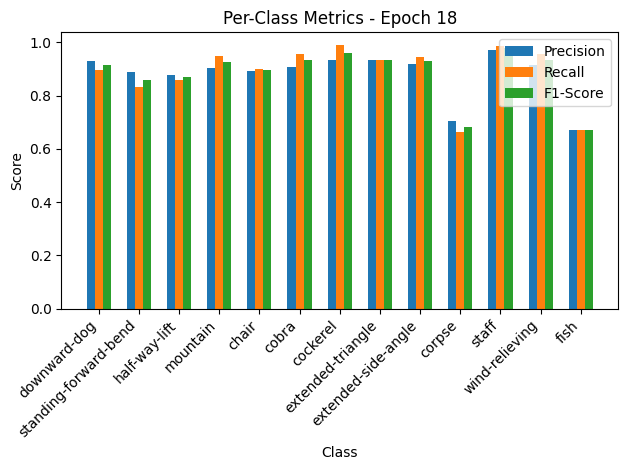


Epoch 19/50 Summary:
Train Loss: 0.3595 | Train Acc: 88.91% | Train Precision: 0.88 | Train Recall: 0.89 | Train F1: 0.88
Val Loss: 0.4357 | Val Acc: 93.15% | Val Precision: 0.93 | Val Recall: 0.92 | Val F1: 0.92

Epoch 20/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 38.32it/s, loss=0.378, accuracy=88.8]


Per-Class Metrics for Epoch 19:
downward-dog: Precision=0.94, Recall=0.88, F1-Score=0.91
standing-forward-bend: Precision=0.92, Recall=0.82, F1-Score=0.87
half-way-lift: Precision=0.84, Recall=0.91, F1-Score=0.87
mountain: Precision=0.87, Recall=0.91, F1-Score=0.89
chair: Precision=0.87, Recall=0.86, F1-Score=0.87
cobra: Precision=0.93, Recall=0.95, F1-Score=0.94
cockerel: Precision=0.91, Recall=0.95, F1-Score=0.93
extended-triangle: Precision=0.90, Recall=0.91, F1-Score=0.90
extended-side-angle: Precision=0.89, Recall=0.90, F1-Score=0.90
corpse: Precision=0.80, Recall=0.72, F1-Score=0.76
staff: Precision=0.96, Recall=0.99, F1-Score=0.97
wind-relieving: Precision=0.93, Recall=0.94, F1-Score=0.93
fish: Precision=0.74, Recall=0.82, F1-Score=0.78


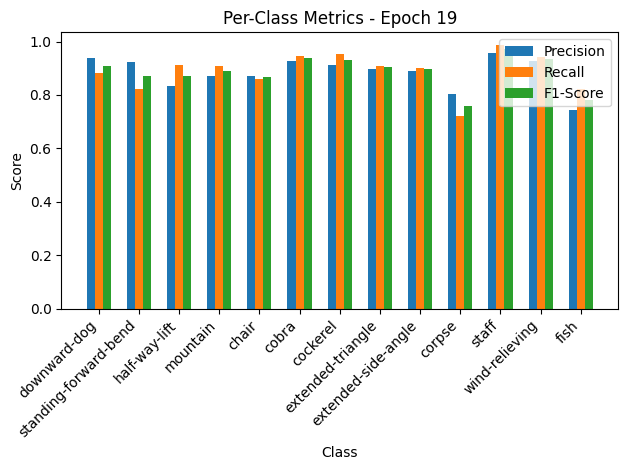

Validation: 100%|██████████| 10/10 [00:00<00:00, 169.55it/s, loss=0.317, accuracy=91.1]


Per-Class Metrics for Epoch 19:
downward-dog: Precision=0.94, Recall=0.88, F1-Score=0.91
standing-forward-bend: Precision=0.92, Recall=0.82, F1-Score=0.87
half-way-lift: Precision=0.84, Recall=0.91, F1-Score=0.87
mountain: Precision=0.87, Recall=0.91, F1-Score=0.89
chair: Precision=0.87, Recall=0.86, F1-Score=0.87
cobra: Precision=0.93, Recall=0.95, F1-Score=0.94
cockerel: Precision=0.91, Recall=0.95, F1-Score=0.93
extended-triangle: Precision=0.90, Recall=0.91, F1-Score=0.90
extended-side-angle: Precision=0.89, Recall=0.90, F1-Score=0.90
corpse: Precision=0.80, Recall=0.72, F1-Score=0.76
staff: Precision=0.96, Recall=0.99, F1-Score=0.97
wind-relieving: Precision=0.93, Recall=0.94, F1-Score=0.93
fish: Precision=0.74, Recall=0.82, F1-Score=0.78


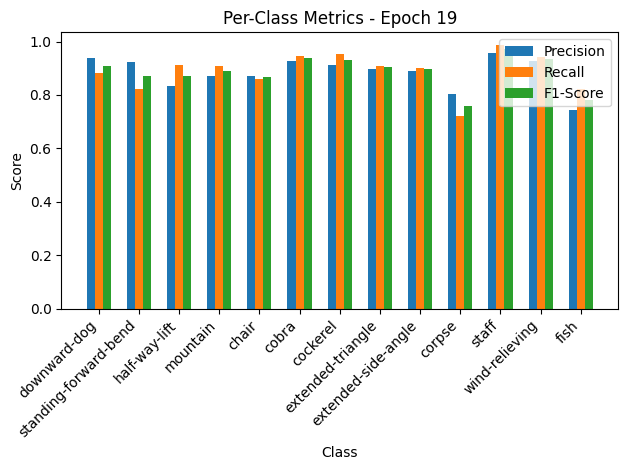


Epoch 20/50 Summary:
Train Loss: 0.3793 | Train Acc: 88.76% | Train Precision: 0.88 | Train Recall: 0.89 | Train F1: 0.89
Val Loss: 0.3472 | Val Acc: 91.10% | Val Precision: 0.92 | Val Recall: 0.90 | Val F1: 0.90

Epoch 21/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 40.12it/s, loss=0.419, accuracy=86.7]


Per-Class Metrics for Epoch 20:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=0.82, Recall=0.82, F1-Score=0.82
half-way-lift: Precision=0.86, Recall=0.85, F1-Score=0.86
mountain: Precision=0.90, Recall=0.92, F1-Score=0.91
chair: Precision=0.87, Recall=0.88, F1-Score=0.88
cobra: Precision=0.88, Recall=0.96, F1-Score=0.92
cockerel: Precision=0.94, Recall=0.94, F1-Score=0.94
extended-triangle: Precision=0.85, Recall=0.88, F1-Score=0.87
extended-side-angle: Precision=0.83, Recall=0.81, F1-Score=0.82
corpse: Precision=0.76, Recall=0.57, F1-Score=0.66
staff: Precision=0.96, Recall=0.96, F1-Score=0.96
wind-relieving: Precision=0.90, Recall=0.94, F1-Score=0.92
fish: Precision=0.65, Recall=0.76, F1-Score=0.70


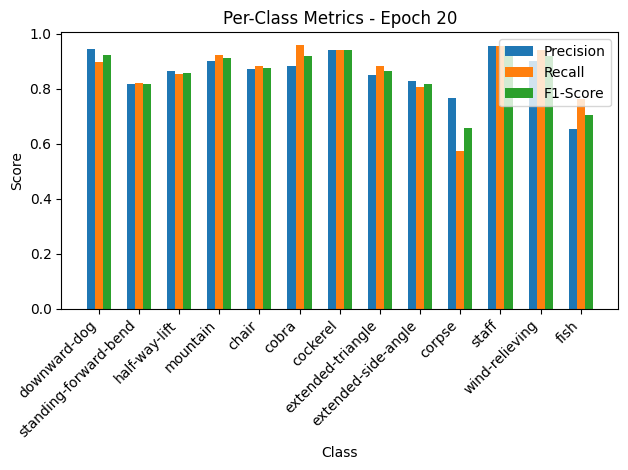

Validation: 100%|██████████| 10/10 [00:00<00:00, 177.06it/s, loss=0.336, accuracy=89.7]


Per-Class Metrics for Epoch 20:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=0.82, Recall=0.82, F1-Score=0.82
half-way-lift: Precision=0.86, Recall=0.85, F1-Score=0.86
mountain: Precision=0.90, Recall=0.92, F1-Score=0.91
chair: Precision=0.87, Recall=0.88, F1-Score=0.88
cobra: Precision=0.88, Recall=0.96, F1-Score=0.92
cockerel: Precision=0.94, Recall=0.94, F1-Score=0.94
extended-triangle: Precision=0.85, Recall=0.88, F1-Score=0.87
extended-side-angle: Precision=0.83, Recall=0.81, F1-Score=0.82
corpse: Precision=0.76, Recall=0.57, F1-Score=0.66
staff: Precision=0.96, Recall=0.96, F1-Score=0.96
wind-relieving: Precision=0.90, Recall=0.94, F1-Score=0.92
fish: Precision=0.65, Recall=0.76, F1-Score=0.70


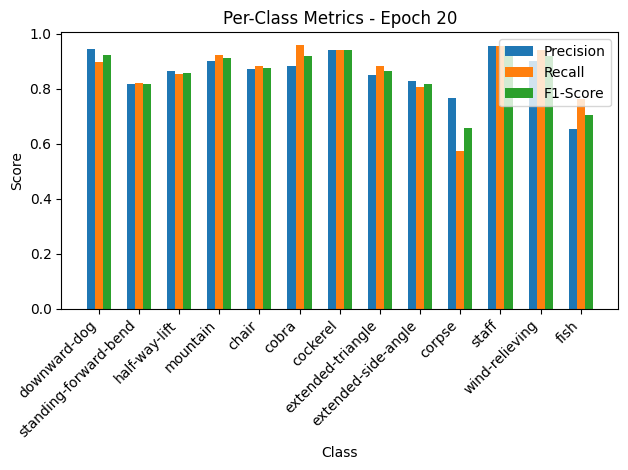


Epoch 21/50 Summary:
Train Loss: 0.4204 | Train Acc: 86.70% | Train Precision: 0.86 | Train Recall: 0.86 | Train F1: 0.86
Val Loss: 0.3685 | Val Acc: 89.73% | Val Precision: 0.92 | Val Recall: 0.88 | Val F1: 0.89

Epoch 22/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:01<00:00, 42.69it/s, loss=0.386, accuracy=88.1]


Per-Class Metrics for Epoch 21:
downward-dog: Precision=0.92, Recall=0.88, F1-Score=0.90
standing-forward-bend: Precision=0.94, Recall=0.85, F1-Score=0.89
half-way-lift: Precision=0.87, Recall=0.91, F1-Score=0.89
mountain: Precision=0.88, Recall=0.94, F1-Score=0.91
chair: Precision=0.89, Recall=0.87, F1-Score=0.88
cobra: Precision=0.90, Recall=0.96, F1-Score=0.93
cockerel: Precision=0.85, Recall=0.95, F1-Score=0.90
extended-triangle: Precision=0.92, Recall=0.86, F1-Score=0.89
extended-side-angle: Precision=0.81, Recall=0.90, F1-Score=0.86
corpse: Precision=0.76, Recall=0.65, F1-Score=0.70
staff: Precision=0.93, Recall=0.94, F1-Score=0.93
wind-relieving: Precision=0.94, Recall=0.94, F1-Score=0.94
fish: Precision=0.71, Recall=0.75, F1-Score=0.73


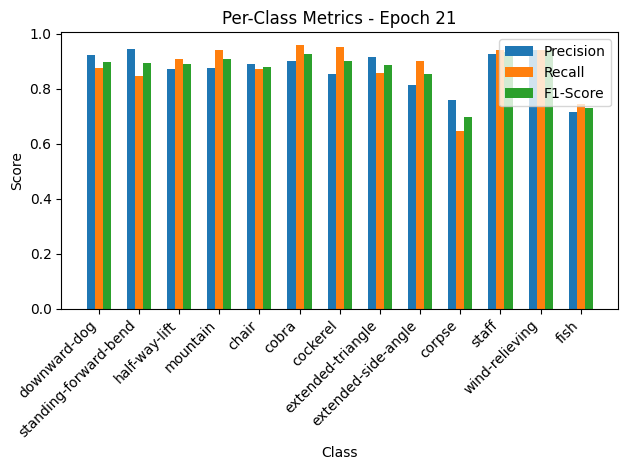

Validation: 100%|██████████| 10/10 [00:00<00:00, 168.09it/s, loss=0.374, accuracy=88.4]


Per-Class Metrics for Epoch 21:
downward-dog: Precision=0.92, Recall=0.88, F1-Score=0.90
standing-forward-bend: Precision=0.94, Recall=0.85, F1-Score=0.89
half-way-lift: Precision=0.87, Recall=0.91, F1-Score=0.89
mountain: Precision=0.88, Recall=0.94, F1-Score=0.91
chair: Precision=0.89, Recall=0.87, F1-Score=0.88
cobra: Precision=0.90, Recall=0.96, F1-Score=0.93
cockerel: Precision=0.85, Recall=0.95, F1-Score=0.90
extended-triangle: Precision=0.92, Recall=0.86, F1-Score=0.89
extended-side-angle: Precision=0.81, Recall=0.90, F1-Score=0.86
corpse: Precision=0.76, Recall=0.65, F1-Score=0.70
staff: Precision=0.93, Recall=0.94, F1-Score=0.93
wind-relieving: Precision=0.94, Recall=0.94, F1-Score=0.94
fish: Precision=0.71, Recall=0.75, F1-Score=0.73


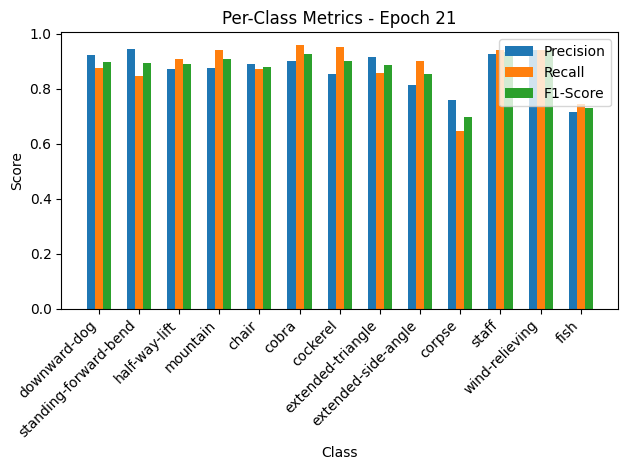


Epoch 22/50 Summary:
Train Loss: 0.3871 | Train Acc: 88.07% | Train Precision: 0.87 | Train Recall: 0.88 | Train F1: 0.87
Val Loss: 0.4101 | Val Acc: 88.36% | Val Precision: 0.90 | Val Recall: 0.88 | Val F1: 0.88

Epoch 23/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:02<00:00, 37.83it/s, loss=0.255, accuracy=92.8]


Per-Class Metrics for Epoch 22:
downward-dog: Precision=0.96, Recall=0.94, F1-Score=0.95
standing-forward-bend: Precision=0.97, Recall=0.85, F1-Score=0.90
half-way-lift: Precision=0.90, Recall=0.93, F1-Score=0.92
mountain: Precision=0.90, Recall=0.97, F1-Score=0.93
chair: Precision=0.93, Recall=0.92, F1-Score=0.93
cobra: Precision=0.93, Recall=0.97, F1-Score=0.95
cockerel: Precision=0.95, Recall=1.00, F1-Score=0.97
extended-triangle: Precision=0.99, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.96, F1-Score=0.96
corpse: Precision=0.81, Recall=0.84, F1-Score=0.83
staff: Precision=0.96, Recall=1.00, F1-Score=0.98
wind-relieving: Precision=0.96, Recall=0.97, F1-Score=0.96
fish: Precision=0.83, Recall=0.78, F1-Score=0.80


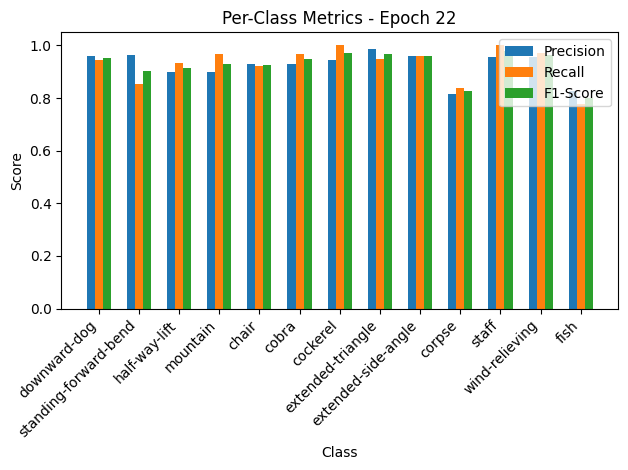

Validation: 100%|██████████| 10/10 [00:00<00:00, 153.75it/s, loss=0.22, accuracy=93.8]


Per-Class Metrics for Epoch 22:
downward-dog: Precision=0.96, Recall=0.94, F1-Score=0.95
standing-forward-bend: Precision=0.97, Recall=0.85, F1-Score=0.90
half-way-lift: Precision=0.90, Recall=0.93, F1-Score=0.92
mountain: Precision=0.90, Recall=0.97, F1-Score=0.93
chair: Precision=0.93, Recall=0.92, F1-Score=0.93
cobra: Precision=0.93, Recall=0.97, F1-Score=0.95
cockerel: Precision=0.95, Recall=1.00, F1-Score=0.97
extended-triangle: Precision=0.99, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.96, F1-Score=0.96
corpse: Precision=0.81, Recall=0.84, F1-Score=0.83
staff: Precision=0.96, Recall=1.00, F1-Score=0.98
wind-relieving: Precision=0.96, Recall=0.97, F1-Score=0.96
fish: Precision=0.83, Recall=0.78, F1-Score=0.80


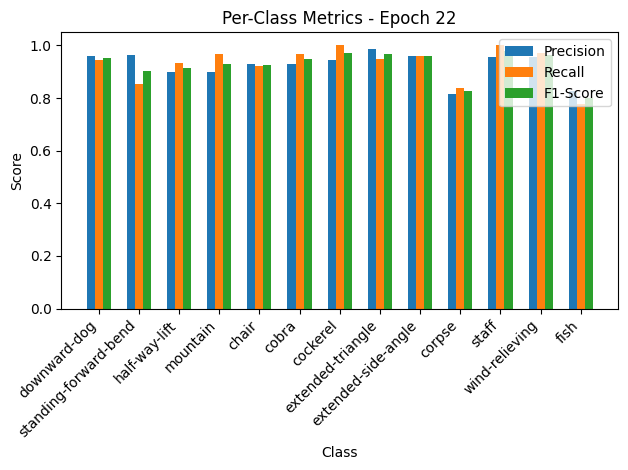


Epoch 23/50 Summary:
Train Loss: 0.2558 | Train Acc: 92.81% | Train Precision: 0.92 | Train Recall: 0.93 | Train F1: 0.93
Val Loss: 0.2412 | Val Acc: 93.84% | Val Precision: 0.95 | Val Recall: 0.94 | Val F1: 0.95
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_1.pth
Checkpoint saved at epoch 23
New best model saved! Validation Loss: 0.2412

Epoch 24/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:02<00:00, 32.76it/s, loss=0.231, accuracy=93.3]


Per-Class Metrics for Epoch 23:
downward-dog: Precision=0.96, Recall=0.93, F1-Score=0.94
standing-forward-bend: Precision=0.94, Recall=0.89, F1-Score=0.91
half-way-lift: Precision=0.91, Recall=0.93, F1-Score=0.92
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.93, Recall=0.93, F1-Score=0.93
cobra: Precision=0.92, Recall=0.96, F1-Score=0.94
cockerel: Precision=0.94, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.97, Recall=0.95, F1-Score=0.96
extended-side-angle: Precision=0.95, Recall=0.97, F1-Score=0.96
corpse: Precision=0.86, Recall=0.84, F1-Score=0.85
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.96, Recall=0.99, F1-Score=0.97
fish: Precision=0.85, Recall=0.85, F1-Score=0.85


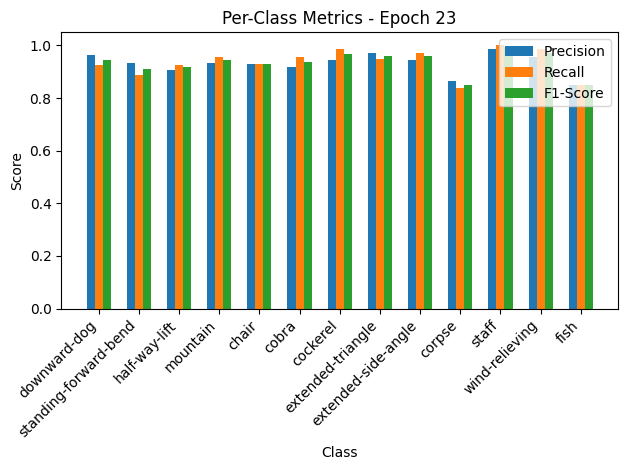

Validation: 100%|██████████| 10/10 [00:00<00:00, 176.27it/s, loss=0.199, accuracy=94.5]


Per-Class Metrics for Epoch 23:
downward-dog: Precision=0.96, Recall=0.93, F1-Score=0.94
standing-forward-bend: Precision=0.94, Recall=0.89, F1-Score=0.91
half-way-lift: Precision=0.91, Recall=0.93, F1-Score=0.92
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.93, Recall=0.93, F1-Score=0.93
cobra: Precision=0.92, Recall=0.96, F1-Score=0.94
cockerel: Precision=0.94, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.97, Recall=0.95, F1-Score=0.96
extended-side-angle: Precision=0.95, Recall=0.97, F1-Score=0.96
corpse: Precision=0.86, Recall=0.84, F1-Score=0.85
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.96, Recall=0.99, F1-Score=0.97
fish: Precision=0.85, Recall=0.85, F1-Score=0.85


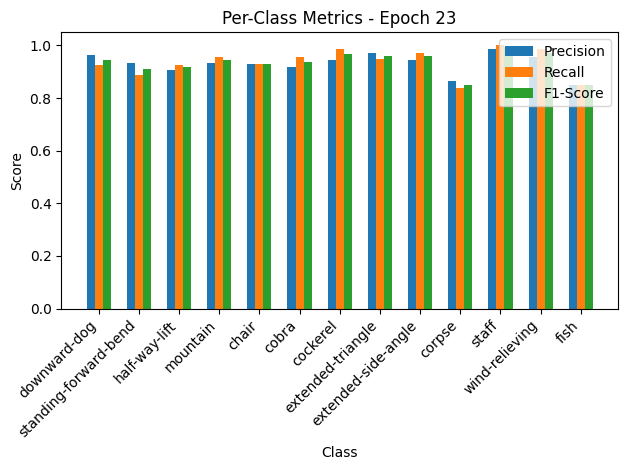


Epoch 24/50 Summary:
Train Loss: 0.2317 | Train Acc: 93.35% | Train Precision: 0.93 | Train Recall: 0.94 | Train F1: 0.93
Val Loss: 0.2176 | Val Acc: 94.52% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_1.pth
Checkpoint saved at epoch 24
New best model saved! Validation Loss: 0.2176

Epoch 25/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:01<00:00, 42.01it/s, loss=0.224, accuracy=93.6]


Per-Class Metrics for Epoch 24:
downward-dog: Precision=0.96, Recall=0.93, F1-Score=0.95
standing-forward-bend: Precision=0.94, Recall=0.88, F1-Score=0.91
half-way-lift: Precision=0.90, Recall=0.92, F1-Score=0.91
mountain: Precision=0.94, Recall=0.97, F1-Score=0.96
chair: Precision=0.95, Recall=0.95, F1-Score=0.95
cobra: Precision=0.92, Recall=0.99, F1-Score=0.95
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.94, Recall=0.94, F1-Score=0.94
extended-side-angle: Precision=0.93, Recall=0.93, F1-Score=0.93
corpse: Precision=0.89, Recall=0.85, F1-Score=0.87
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.96, Recall=0.96, F1-Score=0.96
fish: Precision=0.86, Recall=0.88, F1-Score=0.87


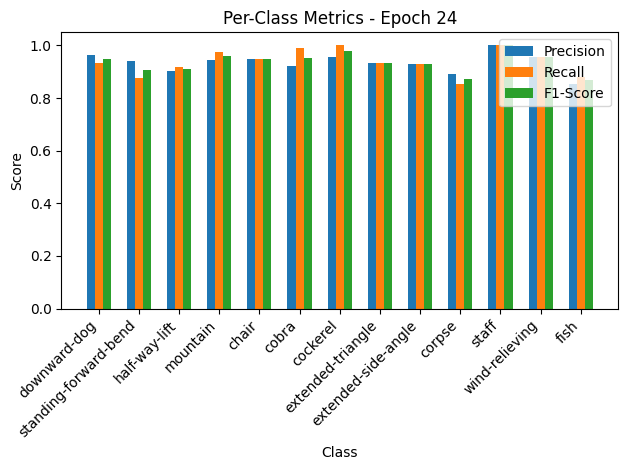

Validation: 100%|██████████| 10/10 [00:00<00:00, 141.34it/s, loss=0.186, accuracy=95.2]


Per-Class Metrics for Epoch 24:
downward-dog: Precision=0.96, Recall=0.93, F1-Score=0.95
standing-forward-bend: Precision=0.94, Recall=0.88, F1-Score=0.91
half-way-lift: Precision=0.90, Recall=0.92, F1-Score=0.91
mountain: Precision=0.94, Recall=0.97, F1-Score=0.96
chair: Precision=0.95, Recall=0.95, F1-Score=0.95
cobra: Precision=0.92, Recall=0.99, F1-Score=0.95
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.94, Recall=0.94, F1-Score=0.94
extended-side-angle: Precision=0.93, Recall=0.93, F1-Score=0.93
corpse: Precision=0.89, Recall=0.85, F1-Score=0.87
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.96, Recall=0.96, F1-Score=0.96
fish: Precision=0.86, Recall=0.88, F1-Score=0.87


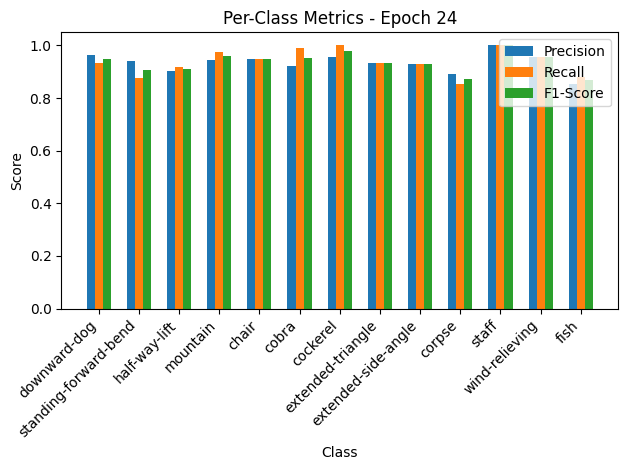


Epoch 25/50 Summary:
Train Loss: 0.2250 | Train Acc: 93.58% | Train Precision: 0.93 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.2034 | Val Acc: 95.21% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.94
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_1.pth
Checkpoint saved at epoch 25
New best model saved! Validation Loss: 0.2034

Epoch 26/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:01<00:00, 41.22it/s, loss=0.211, accuracy=93.6]


Per-Class Metrics for Epoch 25:
downward-dog: Precision=0.97, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.94, Recall=0.91, F1-Score=0.93
half-way-lift: Precision=0.93, Recall=0.91, F1-Score=0.92
mountain: Precision=0.92, Recall=0.96, F1-Score=0.94
chair: Precision=0.94, Recall=0.92, F1-Score=0.93
cobra: Precision=0.92, Recall=0.98, F1-Score=0.95
cockerel: Precision=0.95, Recall=1.00, F1-Score=0.97
extended-triangle: Precision=0.96, Recall=0.96, F1-Score=0.96
extended-side-angle: Precision=0.96, Recall=0.97, F1-Score=0.97
corpse: Precision=0.84, Recall=0.79, F1-Score=0.82
staff: Precision=0.99, Recall=0.97, F1-Score=0.98
wind-relieving: Precision=0.96, Recall=0.99, F1-Score=0.97
fish: Precision=0.84, Recall=0.84, F1-Score=0.84


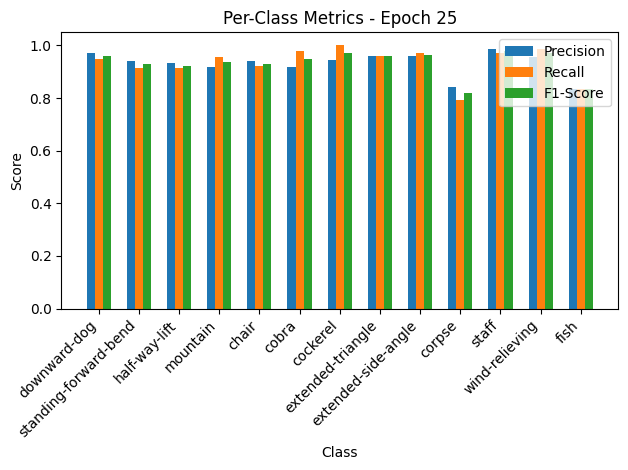

Validation: 100%|██████████| 10/10 [00:00<00:00, 170.17it/s, loss=0.19, accuracy=93.8]


Per-Class Metrics for Epoch 25:
downward-dog: Precision=0.97, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.94, Recall=0.91, F1-Score=0.93
half-way-lift: Precision=0.93, Recall=0.91, F1-Score=0.92
mountain: Precision=0.92, Recall=0.96, F1-Score=0.94
chair: Precision=0.94, Recall=0.92, F1-Score=0.93
cobra: Precision=0.92, Recall=0.98, F1-Score=0.95
cockerel: Precision=0.95, Recall=1.00, F1-Score=0.97
extended-triangle: Precision=0.96, Recall=0.96, F1-Score=0.96
extended-side-angle: Precision=0.96, Recall=0.97, F1-Score=0.97
corpse: Precision=0.84, Recall=0.79, F1-Score=0.82
staff: Precision=0.99, Recall=0.97, F1-Score=0.98
wind-relieving: Precision=0.96, Recall=0.99, F1-Score=0.97
fish: Precision=0.84, Recall=0.84, F1-Score=0.84


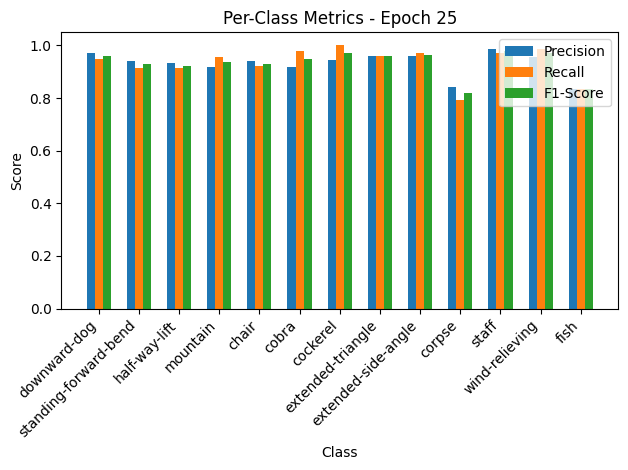


Epoch 26/50 Summary:
Train Loss: 0.2113 | Train Acc: 93.58% | Train Precision: 0.93 | Train Recall: 0.93 | Train F1: 0.93
Val Loss: 0.2086 | Val Acc: 93.84% | Val Precision: 0.94 | Val Recall: 0.94 | Val F1: 0.94

Epoch 27/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:02<00:00, 39.21it/s, loss=0.223, accuracy=93.3]


Per-Class Metrics for Epoch 26:
downward-dog: Precision=0.95, Recall=0.95, F1-Score=0.95
standing-forward-bend: Precision=0.93, Recall=0.86, F1-Score=0.89
half-way-lift: Precision=0.90, Recall=0.92, F1-Score=0.91
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.96, Recall=0.94, F1-Score=0.95
cobra: Precision=0.94, Recall=0.97, F1-Score=0.95
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.95, F1-Score=0.96
extended-side-angle: Precision=0.97, Recall=0.97, F1-Score=0.97
corpse: Precision=0.90, Recall=0.79, F1-Score=0.84
staff: Precision=0.97, Recall=0.97, F1-Score=0.97
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.78, Recall=0.88, F1-Score=0.83


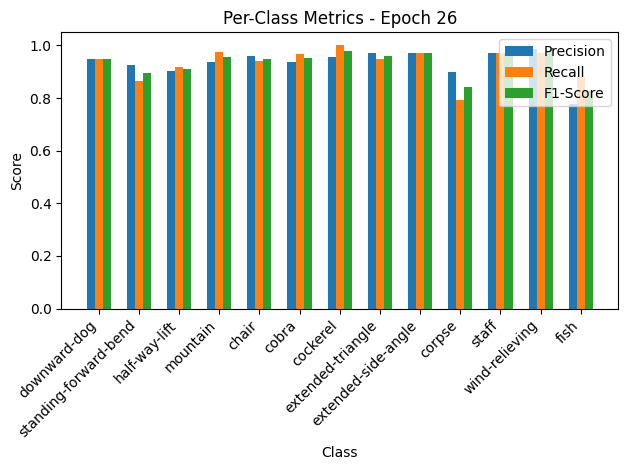

Validation: 100%|██████████| 10/10 [00:00<00:00, 135.31it/s, loss=0.197, accuracy=95.9]


Per-Class Metrics for Epoch 26:
downward-dog: Precision=0.95, Recall=0.95, F1-Score=0.95
standing-forward-bend: Precision=0.93, Recall=0.86, F1-Score=0.89
half-way-lift: Precision=0.90, Recall=0.92, F1-Score=0.91
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.96, Recall=0.94, F1-Score=0.95
cobra: Precision=0.94, Recall=0.97, F1-Score=0.95
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.95, F1-Score=0.96
extended-side-angle: Precision=0.97, Recall=0.97, F1-Score=0.97
corpse: Precision=0.90, Recall=0.79, F1-Score=0.84
staff: Precision=0.97, Recall=0.97, F1-Score=0.97
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.78, Recall=0.88, F1-Score=0.83


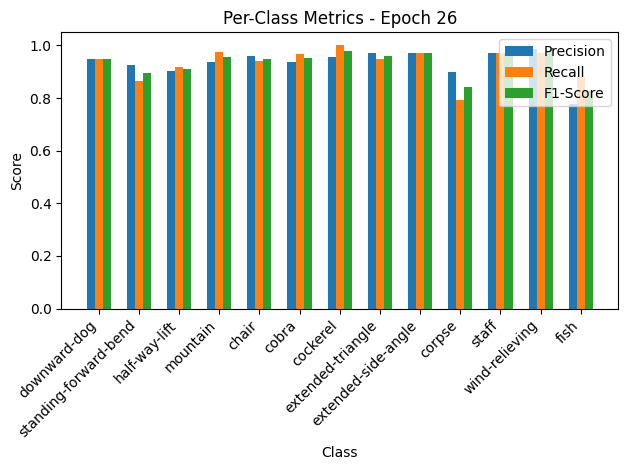


Epoch 27/50 Summary:
Train Loss: 0.2232 | Train Acc: 93.35% | Train Precision: 0.93 | Train Recall: 0.93 | Train F1: 0.93
Val Loss: 0.2157 | Val Acc: 95.89% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 28/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:02<00:00, 31.34it/s, loss=0.232, accuracy=93]


Per-Class Metrics for Epoch 27:
downward-dog: Precision=0.96, Recall=0.93, F1-Score=0.94
standing-forward-bend: Precision=0.93, Recall=0.89, F1-Score=0.91
half-way-lift: Precision=0.93, Recall=0.91, F1-Score=0.92
mountain: Precision=0.92, Recall=0.97, F1-Score=0.95
chair: Precision=0.94, Recall=0.94, F1-Score=0.94
cobra: Precision=0.93, Recall=0.98, F1-Score=0.95
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=0.96, F1-Score=0.95
extended-side-angle: Precision=0.96, Recall=0.94, F1-Score=0.95
corpse: Precision=0.87, Recall=0.76, F1-Score=0.81
staff: Precision=0.96, Recall=0.99, F1-Score=0.97
wind-relieving: Precision=0.97, Recall=0.96, F1-Score=0.96
fish: Precision=0.77, Recall=0.87, F1-Score=0.82


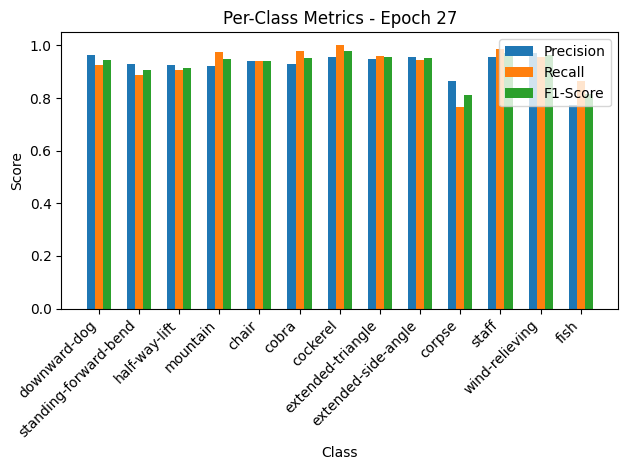

Validation: 100%|██████████| 10/10 [00:00<00:00, 152.33it/s, loss=0.183, accuracy=95.9]


Per-Class Metrics for Epoch 27:
downward-dog: Precision=0.96, Recall=0.93, F1-Score=0.94
standing-forward-bend: Precision=0.93, Recall=0.89, F1-Score=0.91
half-way-lift: Precision=0.93, Recall=0.91, F1-Score=0.92
mountain: Precision=0.92, Recall=0.97, F1-Score=0.95
chair: Precision=0.94, Recall=0.94, F1-Score=0.94
cobra: Precision=0.93, Recall=0.98, F1-Score=0.95
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=0.96, F1-Score=0.95
extended-side-angle: Precision=0.96, Recall=0.94, F1-Score=0.95
corpse: Precision=0.87, Recall=0.76, F1-Score=0.81
staff: Precision=0.96, Recall=0.99, F1-Score=0.97
wind-relieving: Precision=0.97, Recall=0.96, F1-Score=0.96
fish: Precision=0.77, Recall=0.87, F1-Score=0.82


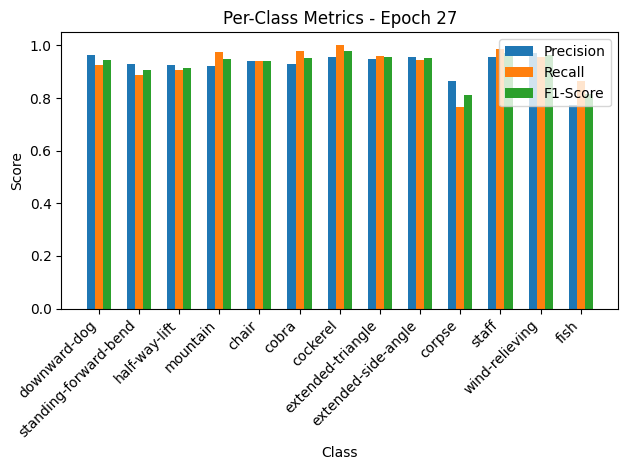


Epoch 28/50 Summary:
Train Loss: 0.2325 | Train Acc: 92.97% | Train Precision: 0.93 | Train Recall: 0.93 | Train F1: 0.93
Val Loss: 0.2003 | Val Acc: 95.89% | Val Precision: 0.96 | Val Recall: 0.95 | Val F1: 0.96
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_1.pth
Checkpoint saved at epoch 28
New best model saved! Validation Loss: 0.2003

Epoch 29/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:02<00:00, 40.14it/s, loss=0.218, accuracy=93.7]


Per-Class Metrics for Epoch 28:
downward-dog: Precision=0.97, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.90, F1-Score=0.92
half-way-lift: Precision=0.93, Recall=0.93, F1-Score=0.93
mountain: Precision=0.94, Recall=0.97, F1-Score=0.96
chair: Precision=0.95, Recall=0.95, F1-Score=0.95
cobra: Precision=0.95, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.91, Recall=0.94, F1-Score=0.92
extended-side-angle: Precision=0.93, Recall=0.89, F1-Score=0.91
corpse: Precision=0.85, Recall=0.76, F1-Score=0.81
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.96, Recall=0.99, F1-Score=0.97
fish: Precision=0.80, Recall=0.85, F1-Score=0.83


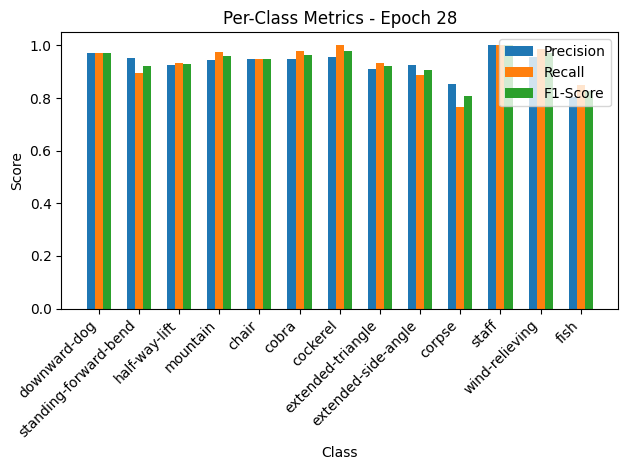

Validation: 100%|██████████| 10/10 [00:00<00:00, 161.16it/s, loss=0.143, accuracy=97.3]


Per-Class Metrics for Epoch 28:
downward-dog: Precision=0.97, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.90, F1-Score=0.92
half-way-lift: Precision=0.93, Recall=0.93, F1-Score=0.93
mountain: Precision=0.94, Recall=0.97, F1-Score=0.96
chair: Precision=0.95, Recall=0.95, F1-Score=0.95
cobra: Precision=0.95, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.91, Recall=0.94, F1-Score=0.92
extended-side-angle: Precision=0.93, Recall=0.89, F1-Score=0.91
corpse: Precision=0.85, Recall=0.76, F1-Score=0.81
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.96, Recall=0.99, F1-Score=0.97
fish: Precision=0.80, Recall=0.85, F1-Score=0.83


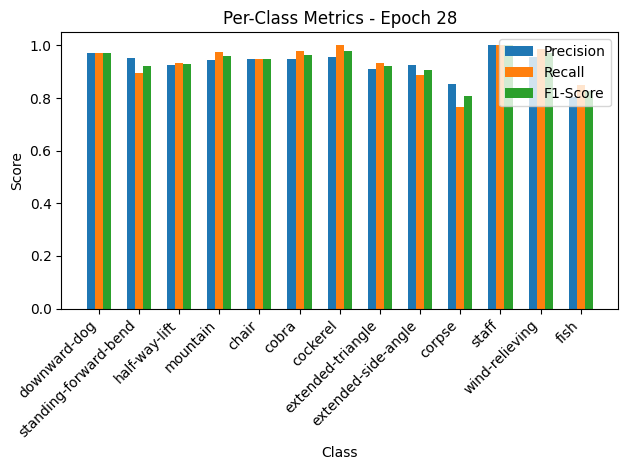


Epoch 29/50 Summary:
Train Loss: 0.2189 | Train Acc: 93.73% | Train Precision: 0.93 | Train Recall: 0.93 | Train F1: 0.93
Val Loss: 0.1568 | Val Acc: 97.26% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_1.pth
Checkpoint saved at epoch 29
New best model saved! Validation Loss: 0.1568

Epoch 30/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:01<00:00, 41.05it/s, loss=0.206, accuracy=94.3]


Per-Class Metrics for Epoch 29:
downward-dog: Precision=0.95, Recall=0.96, F1-Score=0.96
standing-forward-bend: Precision=0.97, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.93, Recall=0.94, F1-Score=0.93
mountain: Precision=0.94, Recall=0.97, F1-Score=0.96
chair: Precision=0.94, Recall=0.95, F1-Score=0.95
cobra: Precision=0.95, Recall=0.97, F1-Score=0.96
cockerel: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-triangle: Precision=0.96, Recall=0.95, F1-Score=0.95
extended-side-angle: Precision=0.95, Recall=0.96, F1-Score=0.95
corpse: Precision=0.87, Recall=0.81, F1-Score=0.84
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.94, Recall=0.99, F1-Score=0.96
fish: Precision=0.84, Recall=0.88, F1-Score=0.86


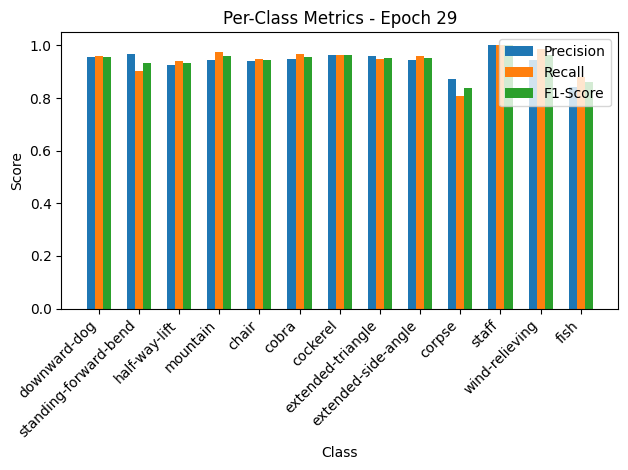

Validation: 100%|██████████| 10/10 [00:00<00:00, 168.09it/s, loss=0.214, accuracy=95.9]


Per-Class Metrics for Epoch 29:
downward-dog: Precision=0.95, Recall=0.96, F1-Score=0.96
standing-forward-bend: Precision=0.97, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.93, Recall=0.94, F1-Score=0.93
mountain: Precision=0.94, Recall=0.97, F1-Score=0.96
chair: Precision=0.94, Recall=0.95, F1-Score=0.95
cobra: Precision=0.95, Recall=0.97, F1-Score=0.96
cockerel: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-triangle: Precision=0.96, Recall=0.95, F1-Score=0.95
extended-side-angle: Precision=0.95, Recall=0.96, F1-Score=0.95
corpse: Precision=0.87, Recall=0.81, F1-Score=0.84
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.94, Recall=0.99, F1-Score=0.96
fish: Precision=0.84, Recall=0.88, F1-Score=0.86


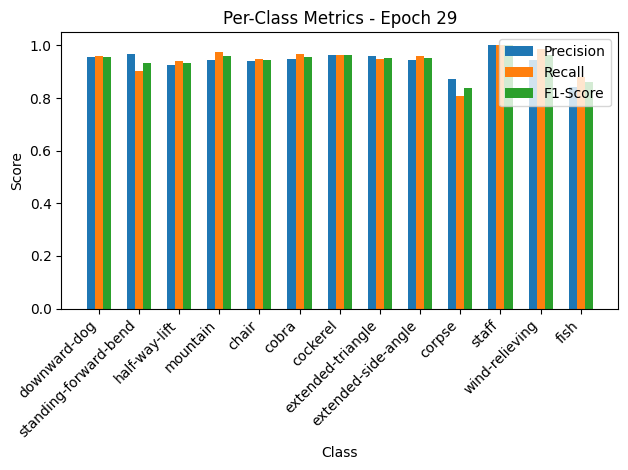


Epoch 30/50 Summary:
Train Loss: 0.2066 | Train Acc: 94.27% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.2349 | Val Acc: 95.89% | Val Precision: 0.96 | Val Recall: 0.95 | Val F1: 0.95

Epoch 31/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:01<00:00, 41.37it/s, loss=0.211, accuracy=93.3]


Per-Class Metrics for Epoch 30:
downward-dog: Precision=0.98, Recall=0.94, F1-Score=0.96
standing-forward-bend: Precision=0.91, Recall=0.91, F1-Score=0.91
half-way-lift: Precision=0.93, Recall=0.91, F1-Score=0.92
mountain: Precision=0.95, Recall=0.95, F1-Score=0.95
chair: Precision=0.92, Recall=0.95, F1-Score=0.94
cobra: Precision=0.93, Recall=0.97, F1-Score=0.95
cockerel: Precision=0.96, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.94, Recall=0.99, F1-Score=0.96
extended-side-angle: Precision=0.99, Recall=0.93, F1-Score=0.96
corpse: Precision=0.82, Recall=0.81, F1-Score=0.81
staff: Precision=0.97, Recall=0.99, F1-Score=0.98
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.81, Recall=0.81, F1-Score=0.81


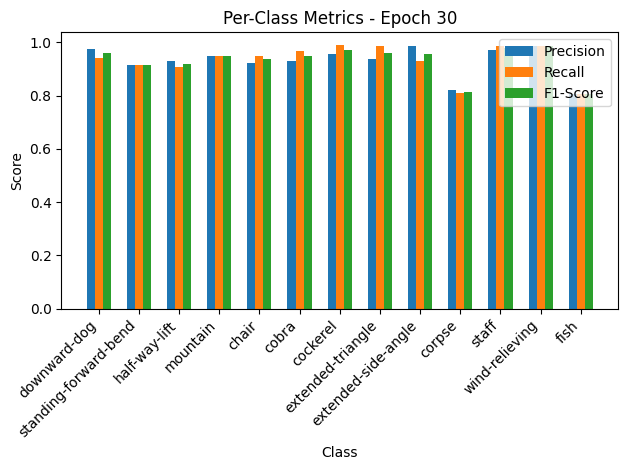

Validation: 100%|██████████| 10/10 [00:00<00:00, 143.16it/s, loss=0.16, accuracy=94.5]


Per-Class Metrics for Epoch 30:
downward-dog: Precision=0.98, Recall=0.94, F1-Score=0.96
standing-forward-bend: Precision=0.91, Recall=0.91, F1-Score=0.91
half-way-lift: Precision=0.93, Recall=0.91, F1-Score=0.92
mountain: Precision=0.95, Recall=0.95, F1-Score=0.95
chair: Precision=0.92, Recall=0.95, F1-Score=0.94
cobra: Precision=0.93, Recall=0.97, F1-Score=0.95
cockerel: Precision=0.96, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.94, Recall=0.99, F1-Score=0.96
extended-side-angle: Precision=0.99, Recall=0.93, F1-Score=0.96
corpse: Precision=0.82, Recall=0.81, F1-Score=0.81
staff: Precision=0.97, Recall=0.99, F1-Score=0.98
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.81, Recall=0.81, F1-Score=0.81


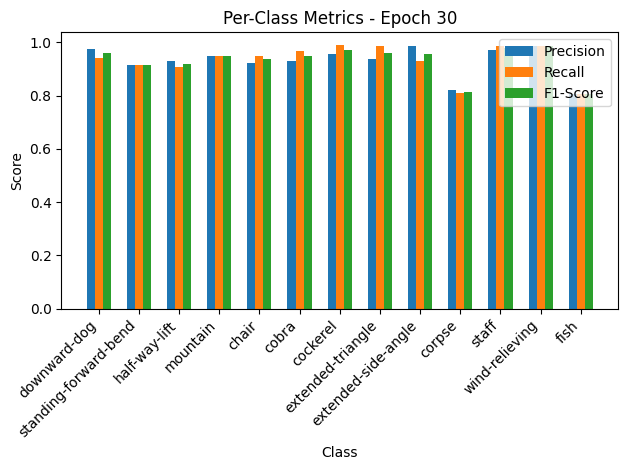


Epoch 31/50 Summary:
Train Loss: 0.2120 | Train Acc: 93.35% | Train Precision: 0.93 | Train Recall: 0.93 | Train F1: 0.93
Val Loss: 0.1755 | Val Acc: 94.52% | Val Precision: 0.96 | Val Recall: 0.95 | Val F1: 0.95

Epoch 32/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:02<00:00, 36.05it/s, loss=0.217, accuracy=93.3]


Per-Class Metrics for Epoch 31:
downward-dog: Precision=0.96, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.95, Recall=0.88, F1-Score=0.91
half-way-lift: Precision=0.89, Recall=0.94, F1-Score=0.92
mountain: Precision=0.94, Recall=0.99, F1-Score=0.96
chair: Precision=0.97, Recall=0.92, F1-Score=0.94
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.93, Recall=0.99, F1-Score=0.96
extended-triangle: Precision=0.97, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.97, F1-Score=0.97
corpse: Precision=0.78, Recall=0.78, F1-Score=0.78
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=0.97, F1-Score=0.97
fish: Precision=0.78, Recall=0.76, F1-Score=0.77


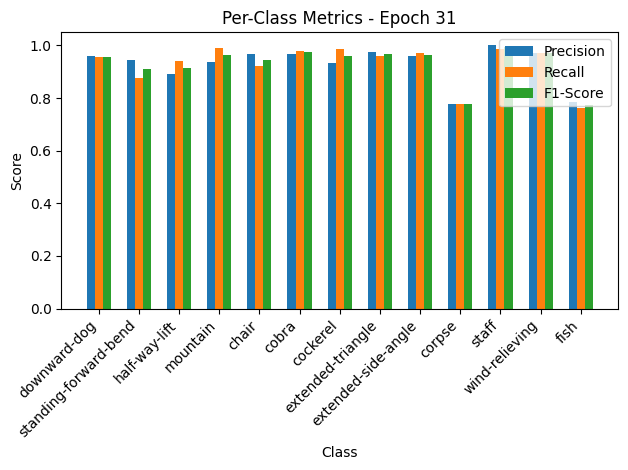

Validation: 100%|██████████| 10/10 [00:00<00:00, 110.28it/s, loss=0.174, accuracy=95.9]


Per-Class Metrics for Epoch 31:
downward-dog: Precision=0.96, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.95, Recall=0.88, F1-Score=0.91
half-way-lift: Precision=0.89, Recall=0.94, F1-Score=0.92
mountain: Precision=0.94, Recall=0.99, F1-Score=0.96
chair: Precision=0.97, Recall=0.92, F1-Score=0.94
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.93, Recall=0.99, F1-Score=0.96
extended-triangle: Precision=0.97, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.97, F1-Score=0.97
corpse: Precision=0.78, Recall=0.78, F1-Score=0.78
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=0.97, F1-Score=0.97
fish: Precision=0.78, Recall=0.76, F1-Score=0.77


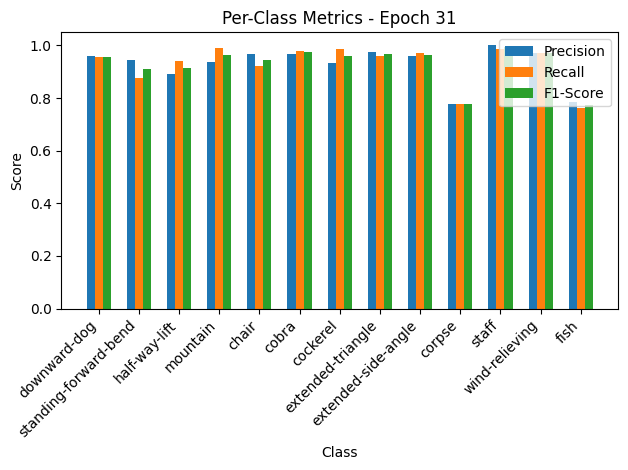


Epoch 32/50 Summary:
Train Loss: 0.2172 | Train Acc: 93.27% | Train Precision: 0.93 | Train Recall: 0.93 | Train F1: 0.93
Val Loss: 0.1903 | Val Acc: 95.89% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 33/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:02<00:00, 39.36it/s, loss=0.207, accuracy=94]


Per-Class Metrics for Epoch 32:
downward-dog: Precision=0.97, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.98, Recall=0.90, F1-Score=0.94
half-way-lift: Precision=0.92, Recall=0.95, F1-Score=0.93
mountain: Precision=0.93, Recall=0.98, F1-Score=0.96
chair: Precision=0.95, Recall=0.89, F1-Score=0.92
cobra: Precision=0.92, Recall=0.98, F1-Score=0.95
cockerel: Precision=0.92, Recall=0.99, F1-Score=0.96
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=0.97, F1-Score=0.97
corpse: Precision=0.86, Recall=0.81, F1-Score=0.83
staff: Precision=0.97, Recall=0.99, F1-Score=0.98
wind-relieving: Precision=0.94, Recall=0.99, F1-Score=0.96
fish: Precision=0.83, Recall=0.85, F1-Score=0.84


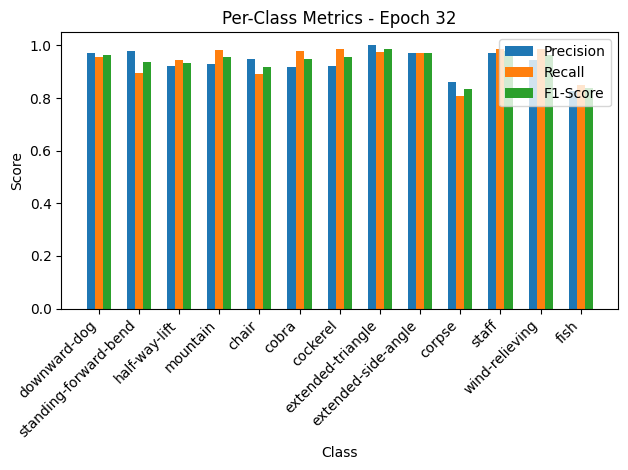

Validation: 100%|██████████| 10/10 [00:00<00:00, 174.89it/s, loss=0.144, accuracy=96.6]


Per-Class Metrics for Epoch 32:
downward-dog: Precision=0.97, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.98, Recall=0.90, F1-Score=0.94
half-way-lift: Precision=0.92, Recall=0.95, F1-Score=0.93
mountain: Precision=0.93, Recall=0.98, F1-Score=0.96
chair: Precision=0.95, Recall=0.89, F1-Score=0.92
cobra: Precision=0.92, Recall=0.98, F1-Score=0.95
cockerel: Precision=0.92, Recall=0.99, F1-Score=0.96
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=0.97, F1-Score=0.97
corpse: Precision=0.86, Recall=0.81, F1-Score=0.83
staff: Precision=0.97, Recall=0.99, F1-Score=0.98
wind-relieving: Precision=0.94, Recall=0.99, F1-Score=0.96
fish: Precision=0.83, Recall=0.85, F1-Score=0.84


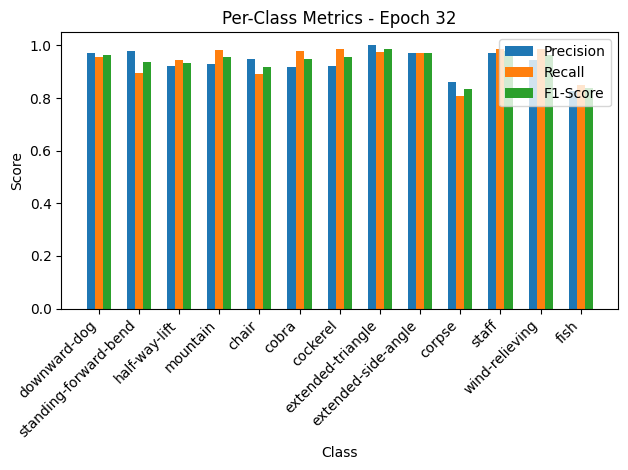


Epoch 33/50 Summary:
Train Loss: 0.2079 | Train Acc: 94.04% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.1577 | Val Acc: 96.58% | Val Precision: 0.98 | Val Recall: 0.97 | Val F1: 0.97

Epoch 34/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:01<00:00, 42.88it/s, loss=0.194, accuracy=94.6]


Per-Class Metrics for Epoch 33:
downward-dog: Precision=0.98, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.97, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.90, Recall=0.95, F1-Score=0.93
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.94, Recall=0.95, F1-Score=0.95
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.94, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.97, Recall=0.94, F1-Score=0.95
extended-side-angle: Precision=0.93, Recall=0.97, F1-Score=0.95
corpse: Precision=0.93, Recall=0.79, F1-Score=0.86
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.82, Recall=0.94, F1-Score=0.88


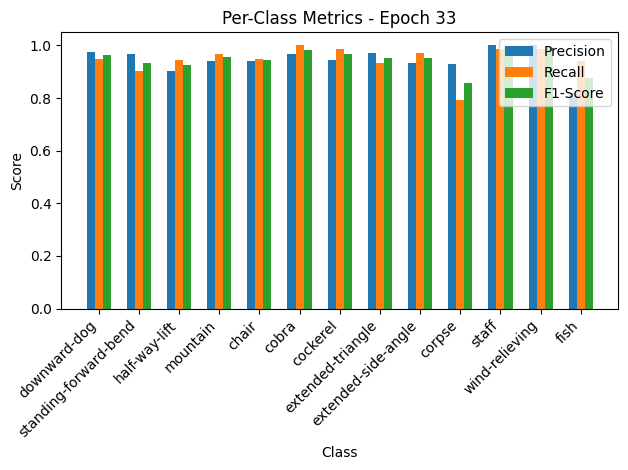

Validation: 100%|██████████| 10/10 [00:00<00:00, 174.75it/s, loss=0.161, accuracy=95.2]


Per-Class Metrics for Epoch 33:
downward-dog: Precision=0.98, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.97, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.90, Recall=0.95, F1-Score=0.93
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.94, Recall=0.95, F1-Score=0.95
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.94, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.97, Recall=0.94, F1-Score=0.95
extended-side-angle: Precision=0.93, Recall=0.97, F1-Score=0.95
corpse: Precision=0.93, Recall=0.79, F1-Score=0.86
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.82, Recall=0.94, F1-Score=0.88


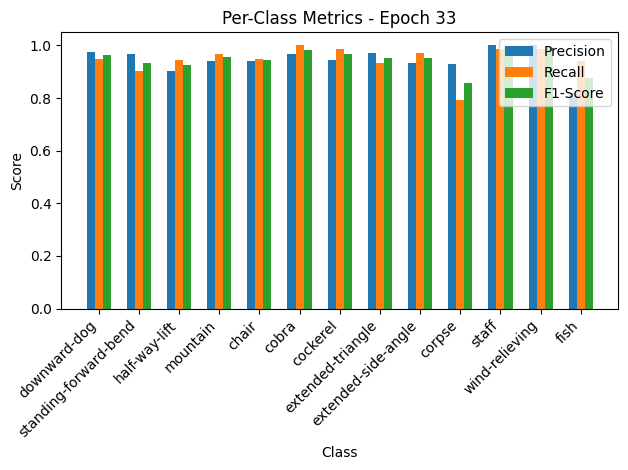


Epoch 34/50 Summary:
Train Loss: 0.1944 | Train Acc: 94.65% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.1761 | Val Acc: 95.21% | Val Precision: 0.96 | Val Recall: 0.95 | Val F1: 0.95

Epoch 35/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:01<00:00, 43.17it/s, loss=0.205, accuracy=94.4]


Per-Class Metrics for Epoch 34:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.98, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.94, Recall=0.96, F1-Score=0.95
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.95, Recall=0.95, F1-Score=0.95
cobra: Precision=0.96, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.96, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.95, Recall=0.96, F1-Score=0.95
extended-side-angle: Precision=0.96, Recall=0.93, F1-Score=0.94
corpse: Precision=0.85, Recall=0.74, F1-Score=0.79
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.77, Recall=0.88, F1-Score=0.82


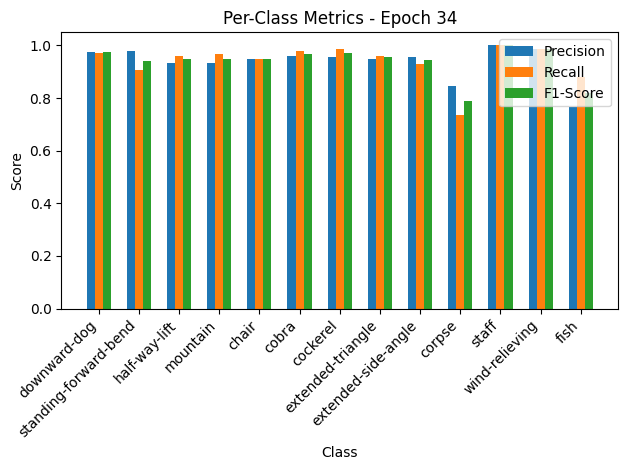

Validation: 100%|██████████| 10/10 [00:00<00:00, 165.10it/s, loss=0.148, accuracy=95.9]


Per-Class Metrics for Epoch 34:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.98, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.94, Recall=0.96, F1-Score=0.95
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.95, Recall=0.95, F1-Score=0.95
cobra: Precision=0.96, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.96, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.95, Recall=0.96, F1-Score=0.95
extended-side-angle: Precision=0.96, Recall=0.93, F1-Score=0.94
corpse: Precision=0.85, Recall=0.74, F1-Score=0.79
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.77, Recall=0.88, F1-Score=0.82


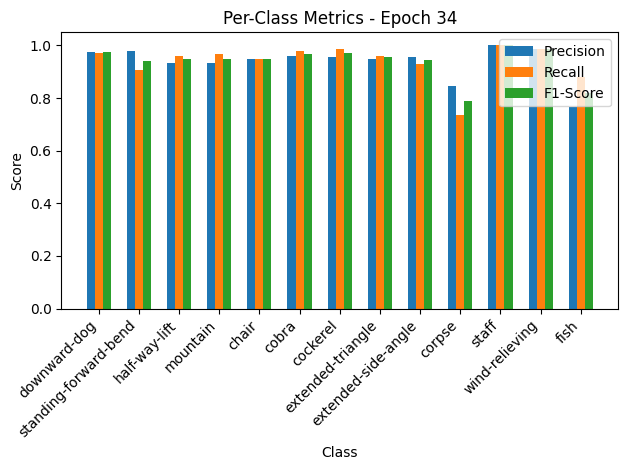


Epoch 35/50 Summary:
Train Loss: 0.2057 | Train Acc: 94.42% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.1627 | Val Acc: 95.89% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 36/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:02<00:00, 34.52it/s, loss=0.184, accuracy=95.3]


Per-Class Metrics for Epoch 35:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.91, F1-Score=0.93
half-way-lift: Precision=0.94, Recall=0.93, F1-Score=0.93
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.96, Recall=0.94, F1-Score=0.95
cobra: Precision=0.95, Recall=1.00, F1-Score=0.97
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.93, Recall=0.82, F1-Score=0.88
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.97, Recall=0.97, F1-Score=0.97
fish: Precision=0.84, Recall=0.96, F1-Score=0.90


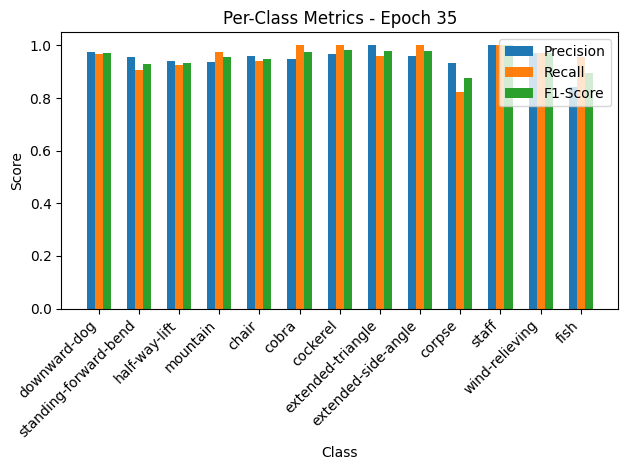

Validation: 100%|██████████| 10/10 [00:00<00:00, 133.66it/s, loss=0.148, accuracy=95.9]


Per-Class Metrics for Epoch 35:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.91, F1-Score=0.93
half-way-lift: Precision=0.94, Recall=0.93, F1-Score=0.93
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.96, Recall=0.94, F1-Score=0.95
cobra: Precision=0.95, Recall=1.00, F1-Score=0.97
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.93, Recall=0.82, F1-Score=0.88
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.97, Recall=0.97, F1-Score=0.97
fish: Precision=0.84, Recall=0.96, F1-Score=0.90


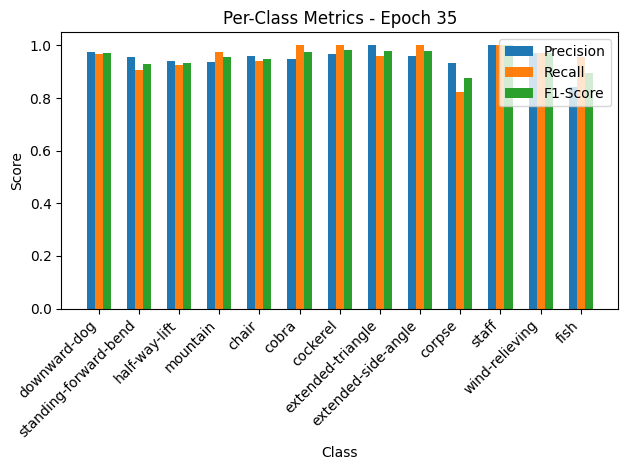


Epoch 36/50 Summary:
Train Loss: 0.1851 | Train Acc: 95.34% | Train Precision: 0.95 | Train Recall: 0.96 | Train F1: 0.95
Val Loss: 0.1624 | Val Acc: 95.89% | Val Precision: 0.96 | Val Recall: 0.95 | Val F1: 0.95

Epoch 37/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:02<00:00, 37.43it/s, loss=0.169, accuracy=95.3]


Per-Class Metrics for Epoch 36:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.94, Recall=0.96, F1-Score=0.95
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.95, Recall=0.95, F1-Score=0.95
cobra: Precision=0.95, Recall=1.00, F1-Score=0.97
cockerel: Precision=0.98, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.96, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.97, Recall=0.93, F1-Score=0.95
corpse: Precision=0.92, Recall=0.81, F1-Score=0.86
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.96, Recall=1.00, F1-Score=0.98
fish: Precision=0.82, Recall=0.90, F1-Score=0.86


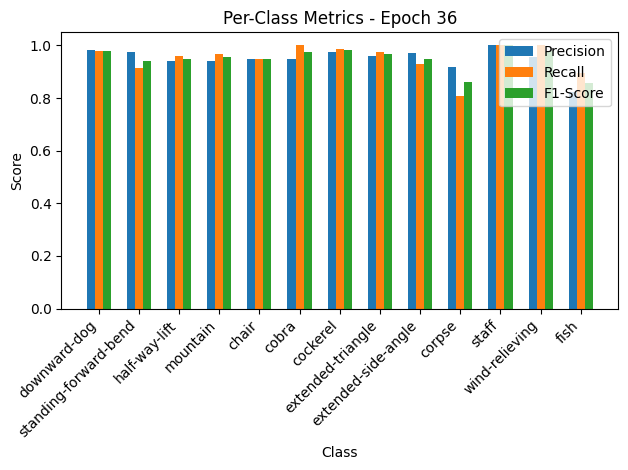

Validation: 100%|██████████| 10/10 [00:00<00:00, 172.73it/s, loss=0.156, accuracy=96.6]


Per-Class Metrics for Epoch 36:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.94, Recall=0.96, F1-Score=0.95
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.95, Recall=0.95, F1-Score=0.95
cobra: Precision=0.95, Recall=1.00, F1-Score=0.97
cockerel: Precision=0.98, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.96, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.97, Recall=0.93, F1-Score=0.95
corpse: Precision=0.92, Recall=0.81, F1-Score=0.86
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.96, Recall=1.00, F1-Score=0.98
fish: Precision=0.82, Recall=0.90, F1-Score=0.86


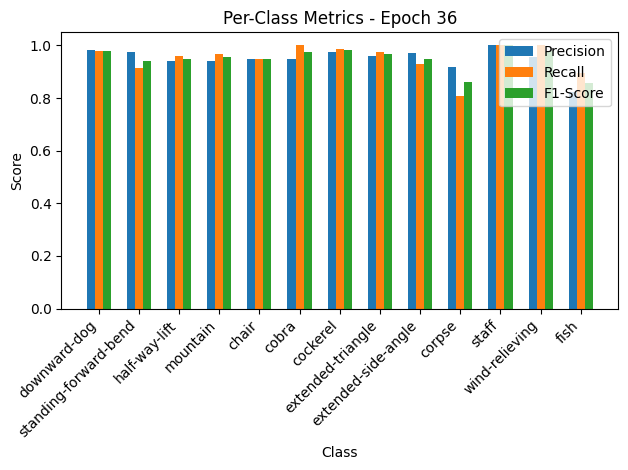


Epoch 37/50 Summary:
Train Loss: 0.1691 | Train Acc: 95.34% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.1706 | Val Acc: 96.58% | Val Precision: 0.97 | Val Recall: 0.96 | Val F1: 0.96

Epoch 38/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:01<00:00, 43.05it/s, loss=0.166, accuracy=95]


Per-Class Metrics for Epoch 37:
downward-dog: Precision=0.97, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.90, F1-Score=0.92
half-way-lift: Precision=0.92, Recall=0.93, F1-Score=0.93
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.95, Recall=0.94, F1-Score=0.95
cobra: Precision=0.98, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.93, Recall=0.82, F1-Score=0.88
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.94, Recall=0.99, F1-Score=0.96
fish: Precision=0.86, Recall=0.91, F1-Score=0.88


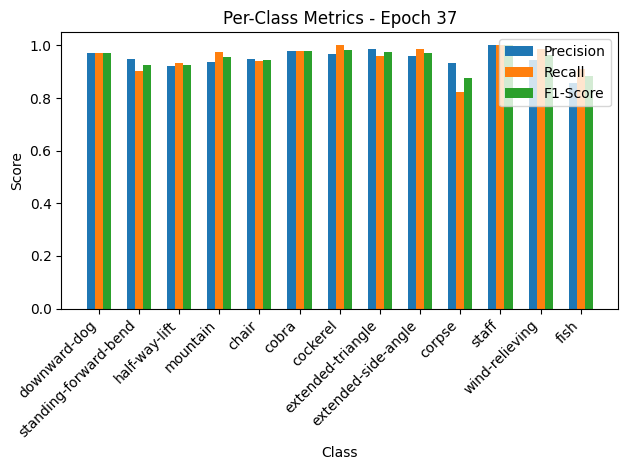

Validation: 100%|██████████| 10/10 [00:00<00:00, 176.18it/s, loss=0.158, accuracy=96.6]


Per-Class Metrics for Epoch 37:
downward-dog: Precision=0.97, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.90, F1-Score=0.92
half-way-lift: Precision=0.92, Recall=0.93, F1-Score=0.93
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.95, Recall=0.94, F1-Score=0.95
cobra: Precision=0.98, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.93, Recall=0.82, F1-Score=0.88
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.94, Recall=0.99, F1-Score=0.96
fish: Precision=0.86, Recall=0.91, F1-Score=0.88


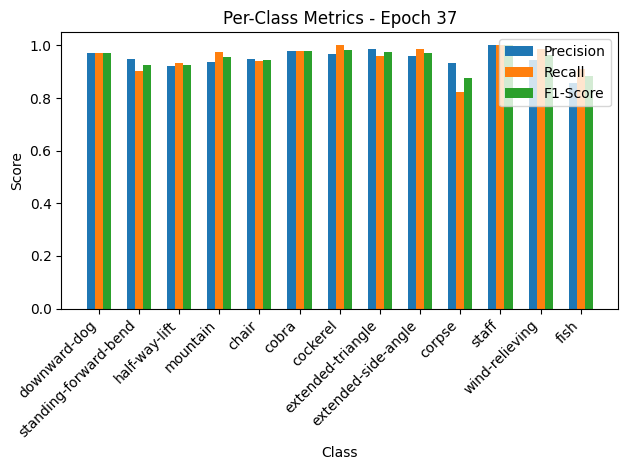


Epoch 38/50 Summary:
Train Loss: 0.1660 | Train Acc: 95.03% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.1728 | Val Acc: 96.58% | Val Precision: 0.97 | Val Recall: 0.96 | Val F1: 0.96

Epoch 39/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:01<00:00, 42.22it/s, loss=0.166, accuracy=95.6]


Per-Class Metrics for Epoch 38:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.94, Recall=0.94, F1-Score=0.94
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.84, Recall=0.91, F1-Score=0.87
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.90, Recall=0.82, F1-Score=0.86


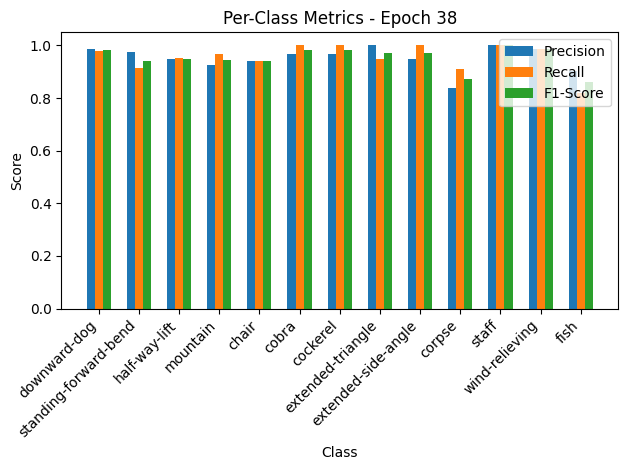

Validation: 100%|██████████| 10/10 [00:00<00:00, 158.19it/s, loss=0.155, accuracy=95.9]


Per-Class Metrics for Epoch 38:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.94, Recall=0.94, F1-Score=0.94
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.84, Recall=0.91, F1-Score=0.87
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.90, Recall=0.82, F1-Score=0.86


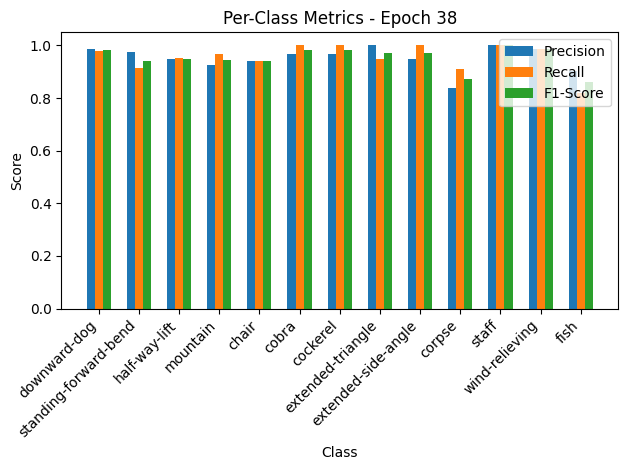


Epoch 39/50 Summary:
Train Loss: 0.1667 | Train Acc: 95.57% | Train Precision: 0.95 | Train Recall: 0.96 | Train F1: 0.95
Val Loss: 0.1700 | Val Acc: 95.89% | Val Precision: 0.96 | Val Recall: 0.95 | Val F1: 0.95

Epoch 40/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:02<00:00, 40.54it/s, loss=0.163, accuracy=95.6]


Per-Class Metrics for Epoch 39:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.97, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.93, Recall=0.95, F1-Score=0.94
mountain: Precision=0.94, Recall=0.98, F1-Score=0.96
chair: Precision=0.97, Recall=0.94, F1-Score=0.95
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.97, Recall=0.97, F1-Score=0.97
corpse: Precision=0.93, Recall=0.84, F1-Score=0.88
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.97, Recall=0.97, F1-Score=0.97
fish: Precision=0.85, Recall=0.93, F1-Score=0.89


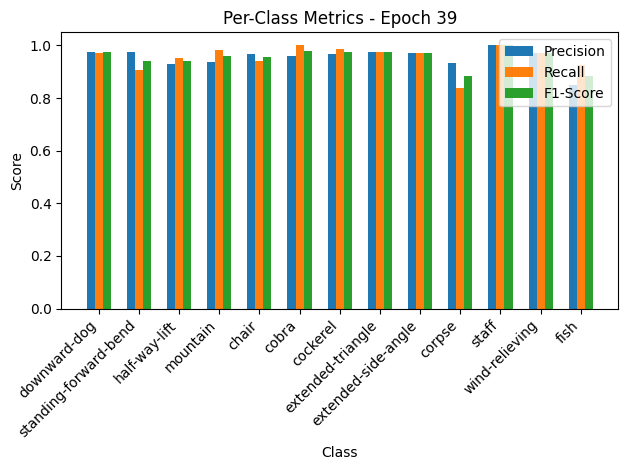

Validation: 100%|██████████| 10/10 [00:00<00:00, 163.07it/s, loss=0.15, accuracy=96.6]


Per-Class Metrics for Epoch 39:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.97, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.93, Recall=0.95, F1-Score=0.94
mountain: Precision=0.94, Recall=0.98, F1-Score=0.96
chair: Precision=0.97, Recall=0.94, F1-Score=0.95
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.97, Recall=0.97, F1-Score=0.97
corpse: Precision=0.93, Recall=0.84, F1-Score=0.88
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.97, Recall=0.97, F1-Score=0.97
fish: Precision=0.85, Recall=0.93, F1-Score=0.89


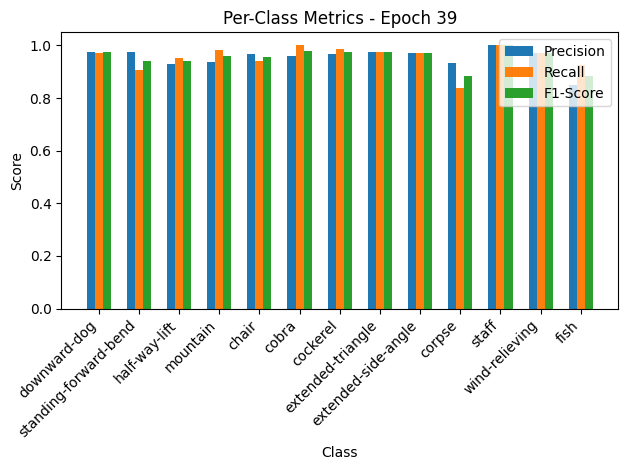


Epoch 40/50 Summary:
Train Loss: 0.1631 | Train Acc: 95.57% | Train Precision: 0.95 | Train Recall: 0.96 | Train F1: 0.95
Val Loss: 0.1641 | Val Acc: 96.58% | Val Precision: 0.97 | Val Recall: 0.96 | Val F1: 0.96

Epoch 41/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:02<00:00, 38.28it/s, loss=0.167, accuracy=95]


Per-Class Metrics for Epoch 40:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.96, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.93, F1-Score=0.94
mountain: Precision=0.94, Recall=0.98, F1-Score=0.96
chair: Precision=0.96, Recall=0.95, F1-Score=0.96
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=0.96, F1-Score=0.95
extended-side-angle: Precision=0.95, Recall=0.96, F1-Score=0.95
corpse: Precision=0.89, Recall=0.79, F1-Score=0.84
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.96, Recall=0.99, F1-Score=0.97
fish: Precision=0.83, Recall=0.88, F1-Score=0.86


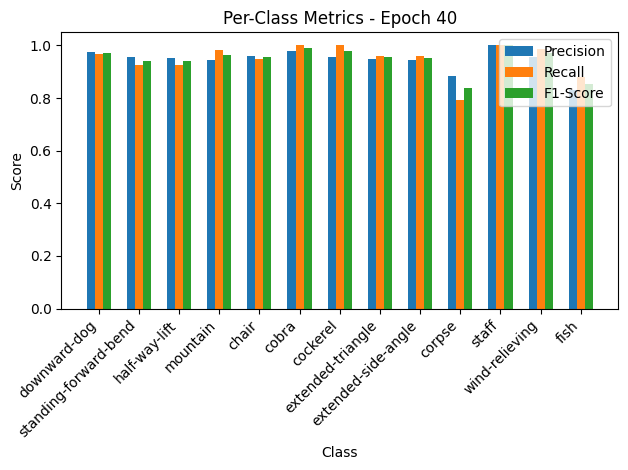

Validation: 100%|██████████| 10/10 [00:00<00:00, 125.09it/s, loss=0.152, accuracy=95.9]


Per-Class Metrics for Epoch 40:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.96, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.93, F1-Score=0.94
mountain: Precision=0.94, Recall=0.98, F1-Score=0.96
chair: Precision=0.96, Recall=0.95, F1-Score=0.96
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=0.96, F1-Score=0.95
extended-side-angle: Precision=0.95, Recall=0.96, F1-Score=0.95
corpse: Precision=0.89, Recall=0.79, F1-Score=0.84
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.96, Recall=0.99, F1-Score=0.97
fish: Precision=0.83, Recall=0.88, F1-Score=0.86


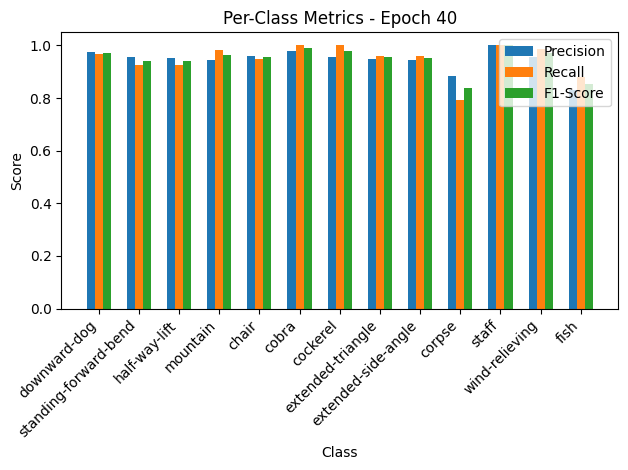


Epoch 41/50 Summary:
Train Loss: 0.1679 | Train Acc: 95.03% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.1664 | Val Acc: 95.89% | Val Precision: 0.96 | Val Recall: 0.95 | Val F1: 0.95

Epoch 42/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:02<00:00, 39.72it/s, loss=0.164, accuracy=95.4]


Per-Class Metrics for Epoch 41:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.98, Recall=0.90, F1-Score=0.94
half-way-lift: Precision=0.91, Recall=0.95, F1-Score=0.93
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.95, Recall=0.94, F1-Score=0.95
cobra: Precision=0.97, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.95, Recall=1.00, F1-Score=0.97
extended-triangle: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.99, F1-Score=0.99
corpse: Precision=0.91, Recall=0.87, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.88, Recall=0.90, F1-Score=0.89


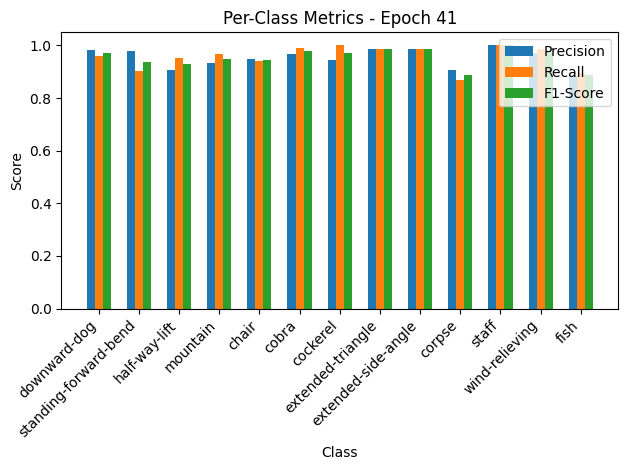

Validation: 100%|██████████| 10/10 [00:00<00:00, 172.93it/s, loss=0.143, accuracy=97.3]


Per-Class Metrics for Epoch 41:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.98, Recall=0.90, F1-Score=0.94
half-way-lift: Precision=0.91, Recall=0.95, F1-Score=0.93
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.95, Recall=0.94, F1-Score=0.95
cobra: Precision=0.97, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.95, Recall=1.00, F1-Score=0.97
extended-triangle: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.99, F1-Score=0.99
corpse: Precision=0.91, Recall=0.87, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.88, Recall=0.90, F1-Score=0.89


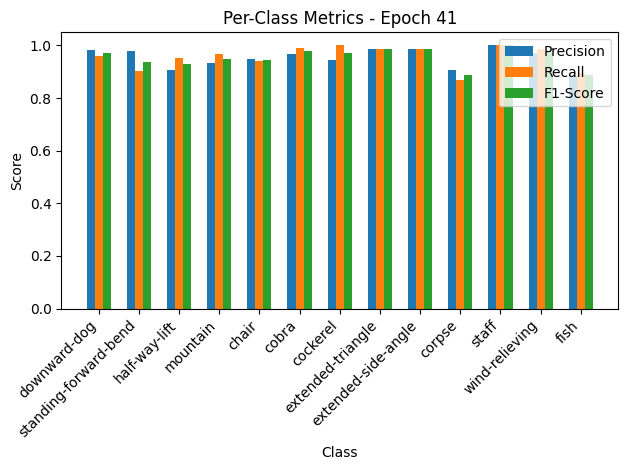


Epoch 42/50 Summary:
Train Loss: 0.1643 | Train Acc: 95.41% | Train Precision: 0.95 | Train Recall: 0.96 | Train F1: 0.95
Val Loss: 0.1566 | Val Acc: 97.26% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_1.pth
Checkpoint saved at epoch 42
New best model saved! Validation Loss: 0.1566

Epoch 43/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:02<00:00, 40.80it/s, loss=0.155, accuracy=96.1]


Per-Class Metrics for Epoch 42:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.99, Recall=0.91, F1-Score=0.95
half-way-lift: Precision=0.94, Recall=0.97, F1-Score=0.95
mountain: Precision=0.93, Recall=0.98, F1-Score=0.96
chair: Precision=0.97, Recall=0.94, F1-Score=0.95
cobra: Precision=0.96, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.94, Recall=0.85, F1-Score=0.89
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.86, Recall=0.94, F1-Score=0.90


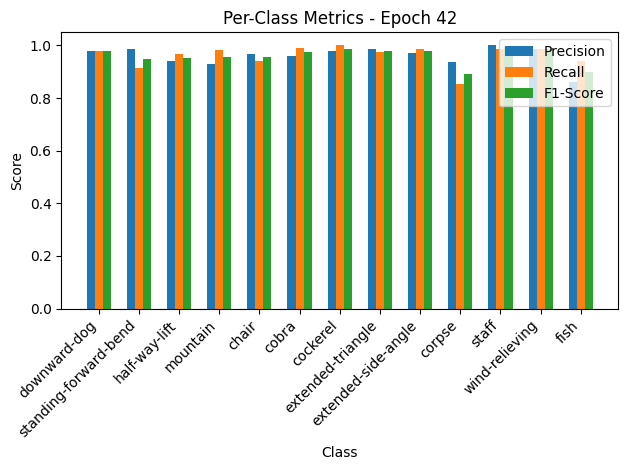

Validation: 100%|██████████| 10/10 [00:00<00:00, 175.79it/s, loss=0.145, accuracy=95.9]


Per-Class Metrics for Epoch 42:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.99, Recall=0.91, F1-Score=0.95
half-way-lift: Precision=0.94, Recall=0.97, F1-Score=0.95
mountain: Precision=0.93, Recall=0.98, F1-Score=0.96
chair: Precision=0.97, Recall=0.94, F1-Score=0.95
cobra: Precision=0.96, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.94, Recall=0.85, F1-Score=0.89
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.86, Recall=0.94, F1-Score=0.90


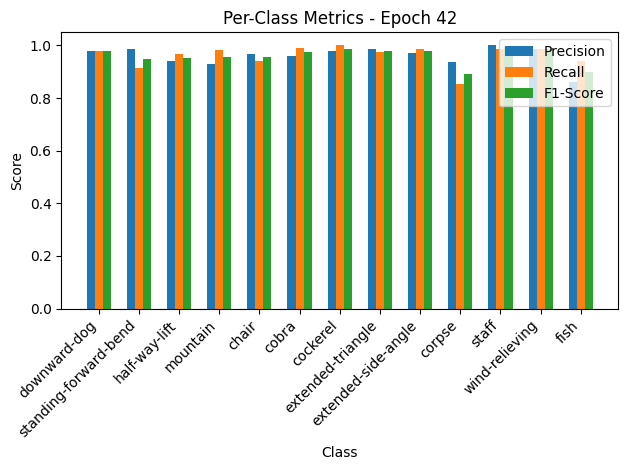


Epoch 43/50 Summary:
Train Loss: 0.1557 | Train Acc: 96.10% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.1593 | Val Acc: 95.89% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 44/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:01<00:00, 42.45it/s, loss=0.177, accuracy=94.6]


Per-Class Metrics for Epoch 43:
downward-dog: Precision=0.97, Recall=0.99, F1-Score=0.98
standing-forward-bend: Precision=0.98, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.94, Recall=0.96, F1-Score=0.95
mountain: Precision=0.93, Recall=0.96, F1-Score=0.94
chair: Precision=0.93, Recall=0.93, F1-Score=0.93
cobra: Precision=0.98, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.97, F1-Score=0.97
corpse: Precision=0.85, Recall=0.76, F1-Score=0.81
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.78, Recall=0.84, F1-Score=0.81


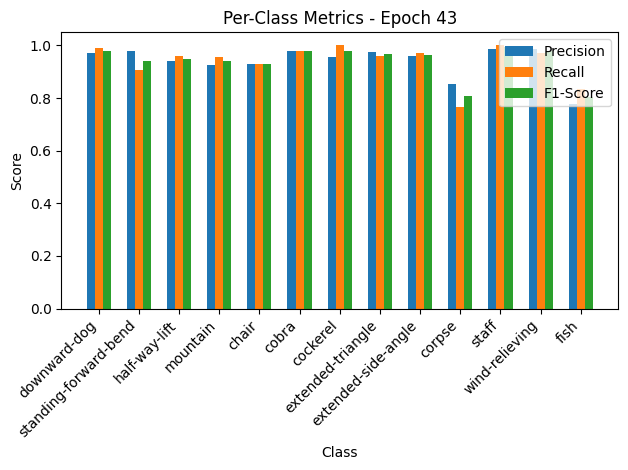

Validation: 100%|██████████| 10/10 [00:00<00:00, 168.70it/s, loss=0.154, accuracy=96.6]


Per-Class Metrics for Epoch 43:
downward-dog: Precision=0.97, Recall=0.99, F1-Score=0.98
standing-forward-bend: Precision=0.98, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.94, Recall=0.96, F1-Score=0.95
mountain: Precision=0.93, Recall=0.96, F1-Score=0.94
chair: Precision=0.93, Recall=0.93, F1-Score=0.93
cobra: Precision=0.98, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.97, F1-Score=0.97
corpse: Precision=0.85, Recall=0.76, F1-Score=0.81
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.78, Recall=0.84, F1-Score=0.81


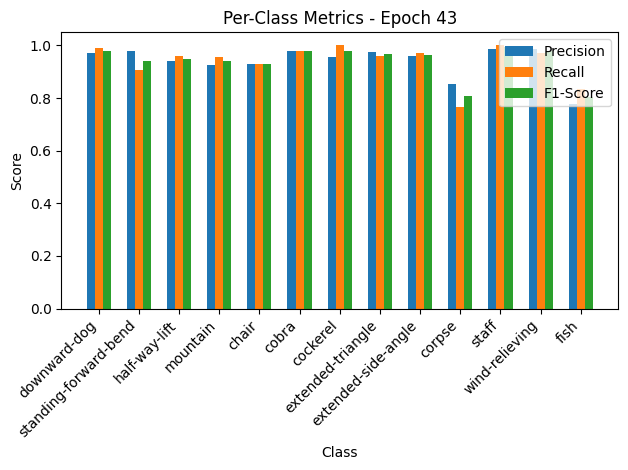


Epoch 44/50 Summary:
Train Loss: 0.1779 | Train Acc: 94.57% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.1687 | Val Acc: 96.58% | Val Precision: 0.97 | Val Recall: 0.96 | Val F1: 0.96

Epoch 45/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:02<00:00, 35.09it/s, loss=0.158, accuracy=95.9]


Per-Class Metrics for Epoch 44:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.98, Recall=0.93, F1-Score=0.95
half-way-lift: Precision=0.95, Recall=0.97, F1-Score=0.96
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.94, Recall=0.95, F1-Score=0.95
cobra: Precision=0.97, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.97, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.97, F1-Score=0.97
corpse: Precision=0.92, Recall=0.82, F1-Score=0.87
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.84, Recall=0.91, F1-Score=0.87


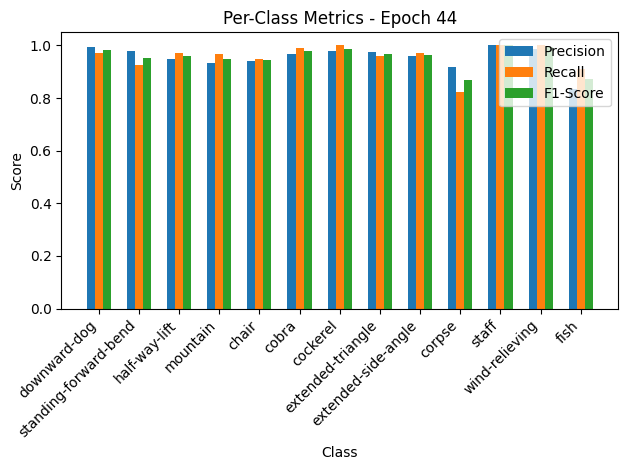

Validation: 100%|██████████| 10/10 [00:00<00:00, 152.41it/s, loss=0.15, accuracy=95.2]


Per-Class Metrics for Epoch 44:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.98, Recall=0.93, F1-Score=0.95
half-way-lift: Precision=0.95, Recall=0.97, F1-Score=0.96
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.94, Recall=0.95, F1-Score=0.95
cobra: Precision=0.97, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.97, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.97, F1-Score=0.97
corpse: Precision=0.92, Recall=0.82, F1-Score=0.87
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.84, Recall=0.91, F1-Score=0.87


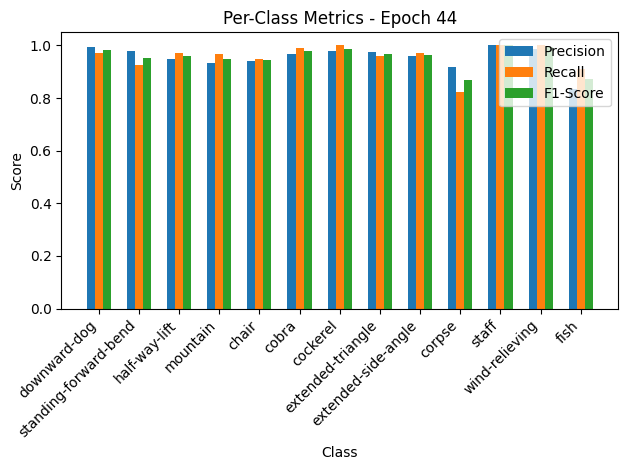


Epoch 45/50 Summary:
Train Loss: 0.1587 | Train Acc: 95.87% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.1640 | Val Acc: 95.21% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 46/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:02<00:00, 38.29it/s, loss=0.155, accuracy=95.9]


Per-Class Metrics for Epoch 45:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.98, Recall=0.92, F1-Score=0.95
half-way-lift: Precision=0.93, Recall=0.96, F1-Score=0.94
mountain: Precision=0.94, Recall=0.98, F1-Score=0.96
chair: Precision=0.97, Recall=0.94, F1-Score=0.95
cobra: Precision=0.97, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.94, Recall=0.99, F1-Score=0.96
extended-side-angle: Precision=0.99, Recall=0.93, F1-Score=0.96
corpse: Precision=0.95, Recall=0.84, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.85, Recall=0.96, F1-Score=0.90


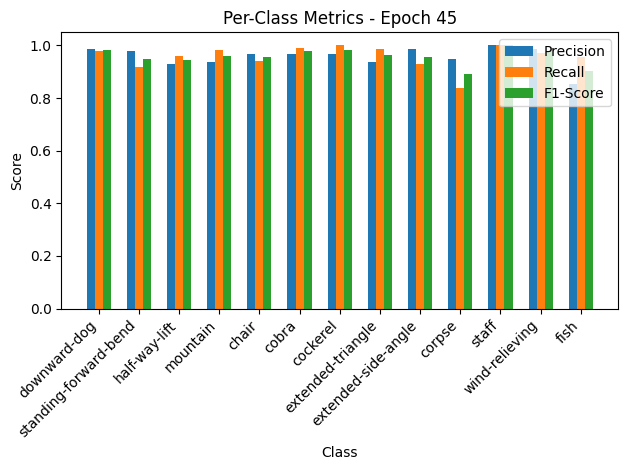

Validation: 100%|██████████| 10/10 [00:00<00:00, 156.10it/s, loss=0.154, accuracy=95.9]


Per-Class Metrics for Epoch 45:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.98, Recall=0.92, F1-Score=0.95
half-way-lift: Precision=0.93, Recall=0.96, F1-Score=0.94
mountain: Precision=0.94, Recall=0.98, F1-Score=0.96
chair: Precision=0.97, Recall=0.94, F1-Score=0.95
cobra: Precision=0.97, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.94, Recall=0.99, F1-Score=0.96
extended-side-angle: Precision=0.99, Recall=0.93, F1-Score=0.96
corpse: Precision=0.95, Recall=0.84, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.85, Recall=0.96, F1-Score=0.90


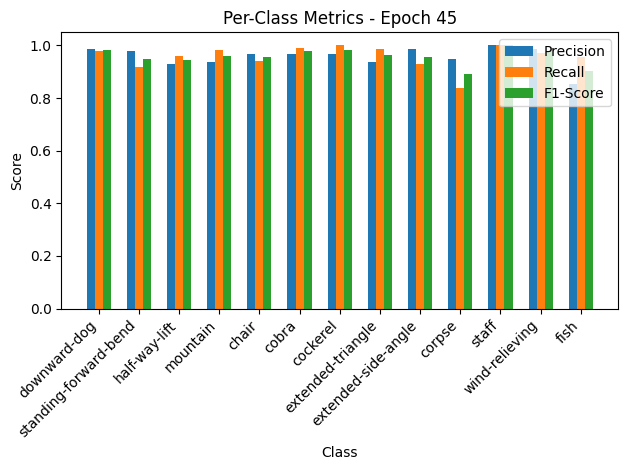


Epoch 46/50 Summary:
Train Loss: 0.1555 | Train Acc: 95.87% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.1684 | Val Acc: 95.89% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 47/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:01<00:00, 41.86it/s, loss=0.155, accuracy=96.1]


Per-Class Metrics for Epoch 46:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.91, F1-Score=0.95
half-way-lift: Precision=0.94, Recall=0.96, F1-Score=0.95
mountain: Precision=0.94, Recall=0.98, F1-Score=0.96
chair: Precision=0.97, Recall=0.96, F1-Score=0.97
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.97, F1-Score=0.97
corpse: Precision=0.93, Recall=0.84, F1-Score=0.88
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.86, Recall=0.94, F1-Score=0.90


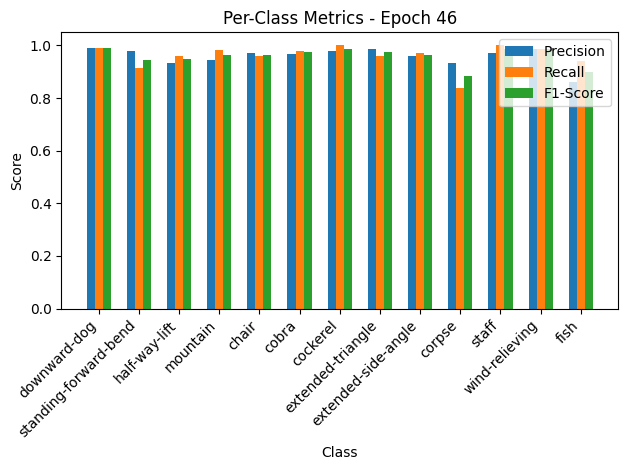

Validation: 100%|██████████| 10/10 [00:00<00:00, 168.08it/s, loss=0.171, accuracy=96.6]


Per-Class Metrics for Epoch 46:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.91, F1-Score=0.95
half-way-lift: Precision=0.94, Recall=0.96, F1-Score=0.95
mountain: Precision=0.94, Recall=0.98, F1-Score=0.96
chair: Precision=0.97, Recall=0.96, F1-Score=0.97
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.97, F1-Score=0.97
corpse: Precision=0.93, Recall=0.84, F1-Score=0.88
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.86, Recall=0.94, F1-Score=0.90


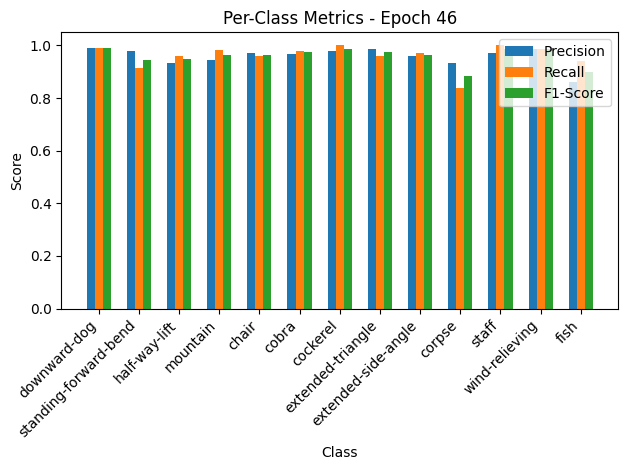


Epoch 47/50 Summary:
Train Loss: 0.1559 | Train Acc: 96.10% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.1869 | Val Acc: 96.58% | Val Precision: 0.97 | Val Recall: 0.96 | Val F1: 0.96

Epoch 48/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:01<00:00, 42.07it/s, loss=0.165, accuracy=95.6]


Per-Class Metrics for Epoch 47:
downward-dog: Precision=0.97, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.93, Recall=0.95, F1-Score=0.94
mountain: Precision=0.94, Recall=0.98, F1-Score=0.96
chair: Precision=0.97, Recall=0.93, F1-Score=0.95
cobra: Precision=0.98, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-side-angle: Precision=0.99, Recall=0.97, F1-Score=0.98
corpse: Precision=0.86, Recall=0.90, F1-Score=0.88
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.89, Recall=0.84, F1-Score=0.86


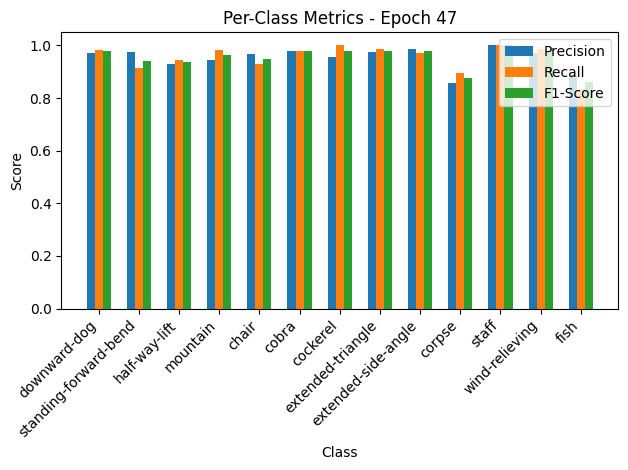

Validation: 100%|██████████| 10/10 [00:00<00:00, 179.06it/s, loss=0.157, accuracy=96.6]


Per-Class Metrics for Epoch 47:
downward-dog: Precision=0.97, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.93, Recall=0.95, F1-Score=0.94
mountain: Precision=0.94, Recall=0.98, F1-Score=0.96
chair: Precision=0.97, Recall=0.93, F1-Score=0.95
cobra: Precision=0.98, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-side-angle: Precision=0.99, Recall=0.97, F1-Score=0.98
corpse: Precision=0.86, Recall=0.90, F1-Score=0.88
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.89, Recall=0.84, F1-Score=0.86


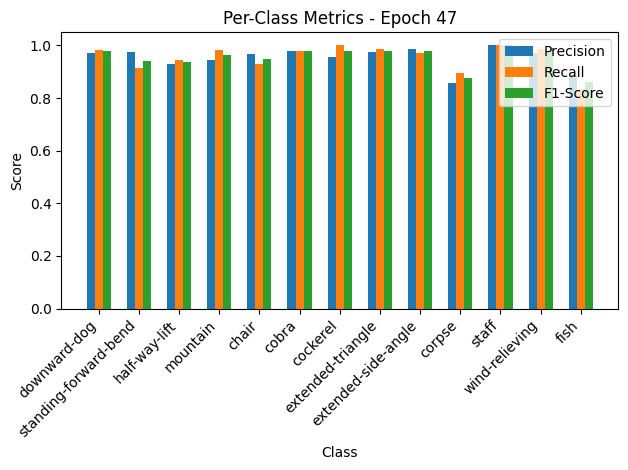


Epoch 48/50 Summary:
Train Loss: 0.1654 | Train Acc: 95.57% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.1718 | Val Acc: 96.58% | Val Precision: 0.97 | Val Recall: 0.96 | Val F1: 0.96

Epoch 49/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:02<00:00, 36.38it/s, loss=0.148, accuracy=96.2]


Per-Class Metrics for Epoch 48:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.91, F1-Score=0.95
half-way-lift: Precision=0.94, Recall=0.98, F1-Score=0.96
mountain: Precision=0.93, Recall=0.99, F1-Score=0.96
chair: Precision=0.98, Recall=0.94, F1-Score=0.96
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.98, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-side-angle: Precision=0.99, Recall=0.97, F1-Score=0.98
corpse: Precision=0.92, Recall=0.82, F1-Score=0.87
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.96, Recall=1.00, F1-Score=0.98
fish: Precision=0.85, Recall=0.91, F1-Score=0.88


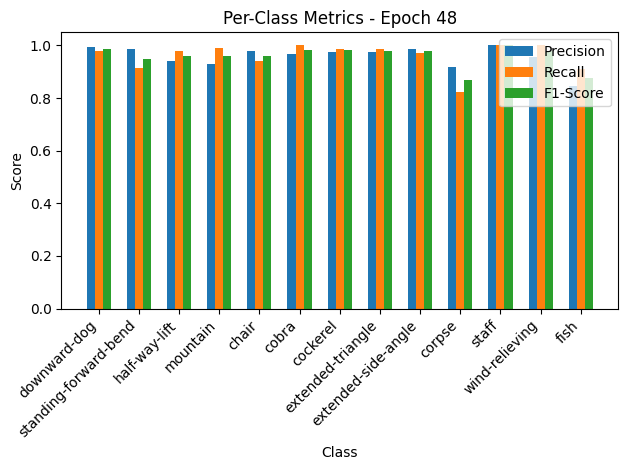

Validation: 100%|██████████| 10/10 [00:00<00:00, 139.06it/s, loss=0.175, accuracy=95.9]


Per-Class Metrics for Epoch 48:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.91, F1-Score=0.95
half-way-lift: Precision=0.94, Recall=0.98, F1-Score=0.96
mountain: Precision=0.93, Recall=0.99, F1-Score=0.96
chair: Precision=0.98, Recall=0.94, F1-Score=0.96
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.98, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-side-angle: Precision=0.99, Recall=0.97, F1-Score=0.98
corpse: Precision=0.92, Recall=0.82, F1-Score=0.87
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.96, Recall=1.00, F1-Score=0.98
fish: Precision=0.85, Recall=0.91, F1-Score=0.88


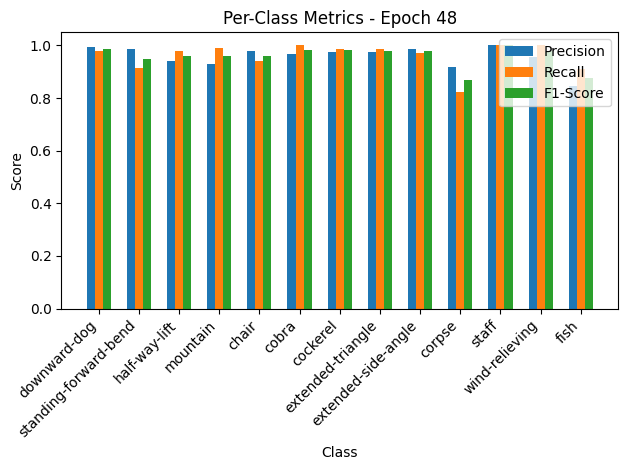


Epoch 49/50 Summary:
Train Loss: 0.1489 | Train Acc: 96.18% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.1920 | Val Acc: 95.89% | Val Precision: 0.96 | Val Recall: 0.95 | Val F1: 0.95

Epoch 50/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:02<00:00, 33.36it/s, loss=0.166, accuracy=95.3]


Per-Class Metrics for Epoch 49:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.98, Recall=0.93, F1-Score=0.95
half-way-lift: Precision=0.94, Recall=0.96, F1-Score=0.95
mountain: Precision=0.93, Recall=0.98, F1-Score=0.96
chair: Precision=0.97, Recall=0.94, F1-Score=0.95
cobra: Precision=0.98, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.95, Recall=1.00, F1-Score=0.97
extended-triangle: Precision=0.95, Recall=0.96, F1-Score=0.95
extended-side-angle: Precision=0.96, Recall=0.94, F1-Score=0.95
corpse: Precision=0.89, Recall=0.81, F1-Score=0.85
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.82, Recall=0.88, F1-Score=0.85


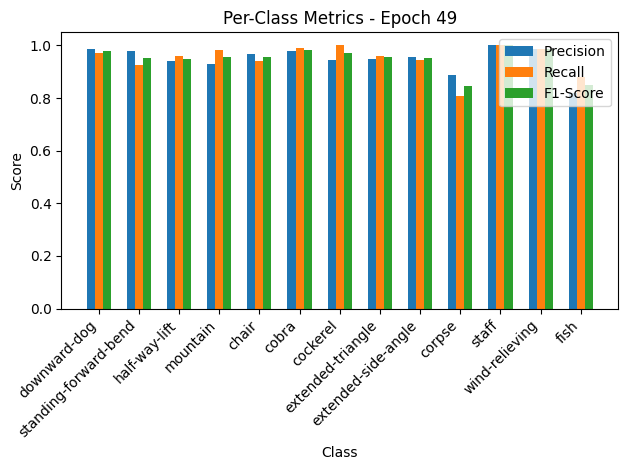

Validation: 100%|██████████| 10/10 [00:00<00:00, 173.13it/s, loss=0.145, accuracy=95.9]


Per-Class Metrics for Epoch 49:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.98, Recall=0.93, F1-Score=0.95
half-way-lift: Precision=0.94, Recall=0.96, F1-Score=0.95
mountain: Precision=0.93, Recall=0.98, F1-Score=0.96
chair: Precision=0.97, Recall=0.94, F1-Score=0.95
cobra: Precision=0.98, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.95, Recall=1.00, F1-Score=0.97
extended-triangle: Precision=0.95, Recall=0.96, F1-Score=0.95
extended-side-angle: Precision=0.96, Recall=0.94, F1-Score=0.95
corpse: Precision=0.89, Recall=0.81, F1-Score=0.85
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.82, Recall=0.88, F1-Score=0.85


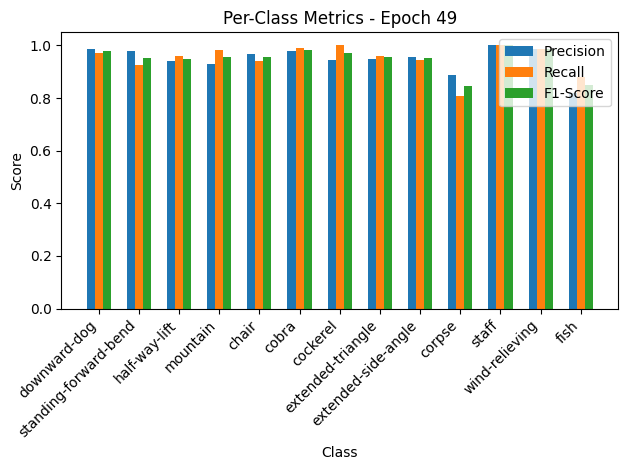


Epoch 50/50 Summary:
Train Loss: 0.1667 | Train Acc: 95.34% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.1589 | Val Acc: 95.89% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96


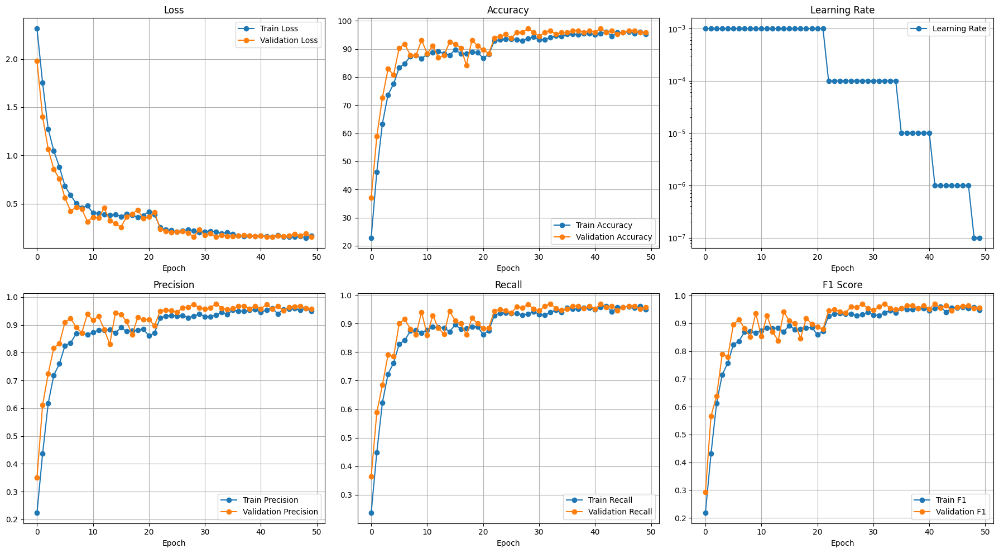

Testing: 100%|██████████| 23/23 [00:00<00:00, 124.27it/s]


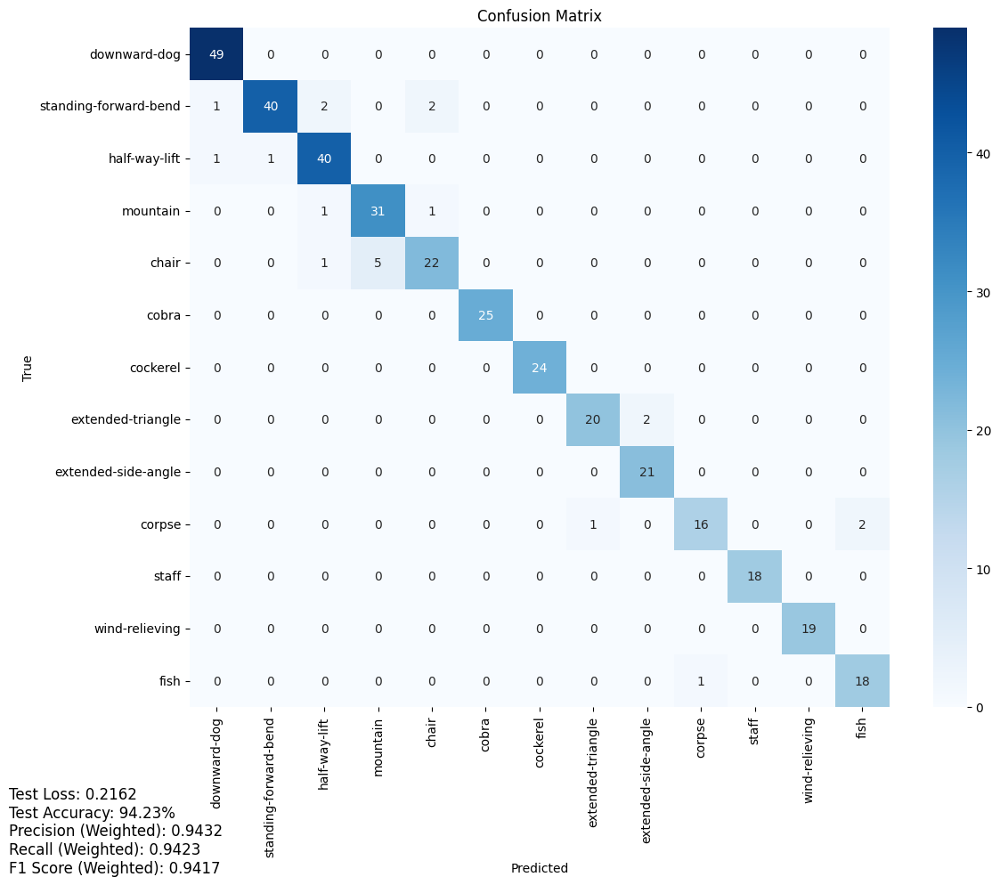

Test Loss: 0.2162
Test Accuracy: 94.23%
Precision (Weighted): 0.9432
Recall (Weighted): 0.9423
F1 Score (Weighted): 0.9417


Testing: 100%|██████████| 23/23 [00:00<00:00, 139.57it/s]


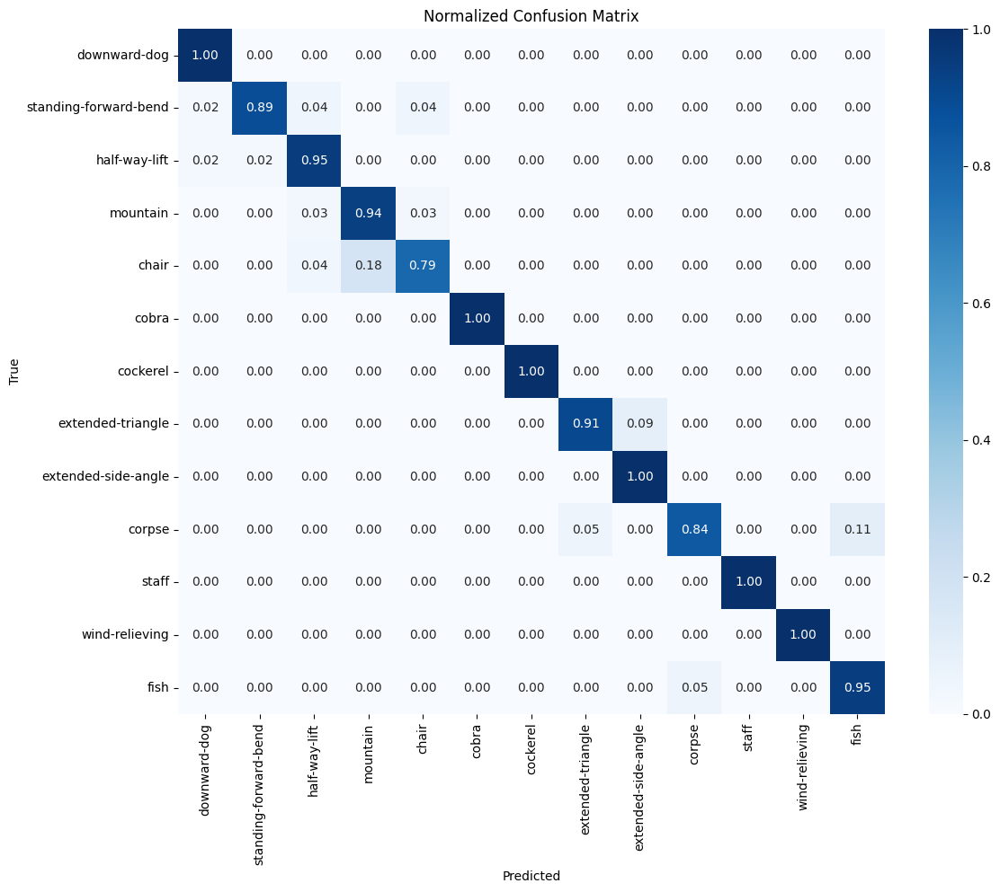

Test Loss: 0.2162
Test Accuracy: 94.23%
Precision (Macro): 0.9456
Recall (Macro): 0.9435
F1 Score (Macro): 0.9435
Saved checkpoint for fold 2
Fold 3/5
Loading cached criterion for fold 2
batch_norm.weight: 99
batch_norm.bias: 99
conv1.0.weight: 288
conv1.0.bias: 32
conv1.1.weight: 32
conv1.1.bias: 32
blk1.conv1.weight: 6144
blk1.conv1.bias: 64
blk1.bn1.weight: 64
blk1.bn1.bias: 64
blk1.conv2.weight: 12288
blk1.conv2.bias: 64
blk1.bn2.weight: 64
blk1.bn2.bias: 64
blk1.shortcut.0.weight: 2048
blk1.shortcut.0.bias: 64
blk1.shortcut.1.weight: 64
blk1.shortcut.1.bias: 64
blk2.conv1.weight: 24576
blk2.conv1.bias: 128
blk2.bn1.weight: 128
blk2.bn1.bias: 128
blk2.conv2.weight: 49152
blk2.conv2.bias: 128
blk2.bn2.weight: 128
blk2.bn2.bias: 128
blk2.shortcut.0.weight: 8192
blk2.shortcut.0.bias: 128
blk2.shortcut.1.weight: 128
blk2.shortcut.1.bias: 128
blk3.conv1.weight: 98304
blk3.conv1.bias: 256
blk3.bn1.weight: 256
blk3.bn1.bias: 256
blk3.conv2.weight: 196608
blk3.conv2.bias: 256
blk3.bn2.weig

Training: 100%|██████████| 82/82 [00:02<00:00, 39.49it/s, loss=2.25, accuracy=26.8]


Per-Class Metrics for Epoch 0:
downward-dog: Precision=0.43, Recall=0.20, F1-Score=0.28
standing-forward-bend: Precision=0.30, Recall=0.24, F1-Score=0.27
half-way-lift: Precision=0.20, Recall=0.18, F1-Score=0.19
mountain: Precision=0.22, Recall=0.43, F1-Score=0.29
chair: Precision=0.17, Recall=0.07, F1-Score=0.10
cobra: Precision=0.22, Recall=0.02, F1-Score=0.04
cockerel: Precision=0.47, Recall=0.56, F1-Score=0.51
extended-triangle: Precision=0.38, Recall=0.30, F1-Score=0.34
extended-side-angle: Precision=0.27, Recall=0.45, F1-Score=0.34
corpse: Precision=0.24, Recall=0.31, F1-Score=0.27
staff: Precision=0.41, Recall=0.36, F1-Score=0.38
wind-relieving: Precision=0.16, Recall=0.46, F1-Score=0.24
fish: Precision=0.15, Recall=0.12, F1-Score=0.13


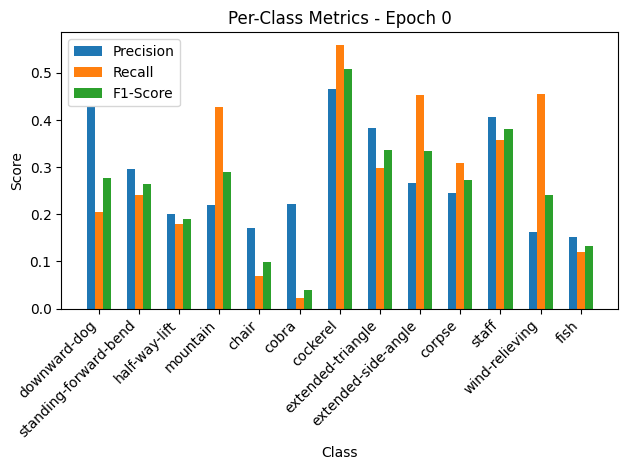

Validation: 100%|██████████| 10/10 [00:00<00:00, 148.88it/s, loss=1.6, accuracy=46.6]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 0:
downward-dog: Precision=0.43, Recall=0.20, F1-Score=0.28
standing-forward-bend: Precision=0.30, Recall=0.24, F1-Score=0.27
half-way-lift: Precision=0.20, Recall=0.18, F1-Score=0.19
mountain: Precision=0.22, Recall=0.43, F1-Score=0.29
chair: Precision=0.17, Recall=0.07, F1-Score=0.10
cobra: Precision=0.22, Recall=0.02, F1-Score=0.04
cockerel: Precision=0.47, Recall=0.56, F1-Score=0.51
extended-triangle: Precision=0.38, Recall=0.30, F1-Score=0.34
extended-side-angle: Precision=0.27, Recall=0.45, F1-Score=0.34
corpse: Precision=0.24, Recall=0.31, F1-Score=0.27
staff: Precision=0.41, Recall=0.36, F1-Score=0.38
wind-relieving: Precision=0.16, Recall=0.46, F1-Score=0.24
fish: Precision=0.15, Recall=0.12, F1-Score=0.13


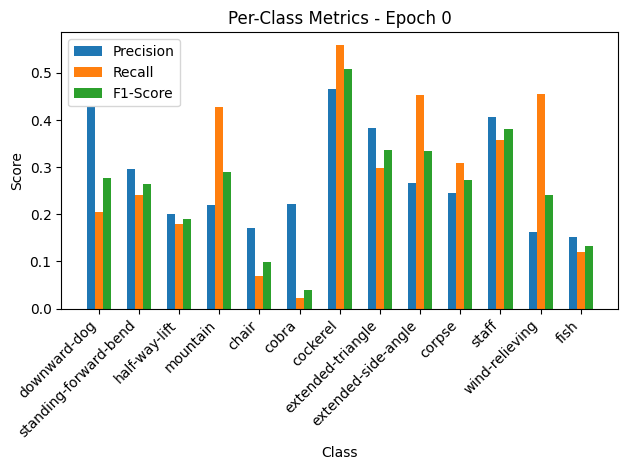


Epoch 1/50 Summary:
Train Loss: 2.2614 | Train Acc: 26.76% | Train Precision: 0.28 | Train Recall: 0.28 | Train F1: 0.26
Val Loss: 1.7492 | Val Acc: 46.58% | Val Precision: 0.49 | Val Recall: 0.46 | Val F1: 0.38
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_2.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_2.pth
Checkpoint saved at epoch 1
New best model saved! Validation Loss: 1.7492

Epoch 2/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 36.43it/s, loss=1.66, accuracy=52.4]


Per-Class Metrics for Epoch 1:
downward-dog: Precision=0.77, Recall=0.55, F1-Score=0.64
standing-forward-bend: Precision=0.52, Recall=0.34, F1-Score=0.41
half-way-lift: Precision=0.57, Recall=0.79, F1-Score=0.66
mountain: Precision=0.52, Recall=0.51, F1-Score=0.52
chair: Precision=0.43, Recall=0.40, F1-Score=0.41
cobra: Precision=0.50, Recall=0.24, F1-Score=0.32
cockerel: Precision=0.59, Recall=0.80, F1-Score=0.68
extended-triangle: Precision=0.45, Recall=0.64, F1-Score=0.52
extended-side-angle: Precision=0.39, Recall=0.40, F1-Score=0.39
corpse: Precision=0.55, Recall=0.40, F1-Score=0.46
staff: Precision=0.33, Recall=0.48, F1-Score=0.39
wind-relieving: Precision=0.71, Recall=0.78, F1-Score=0.74
fish: Precision=0.36, Recall=0.49, F1-Score=0.42


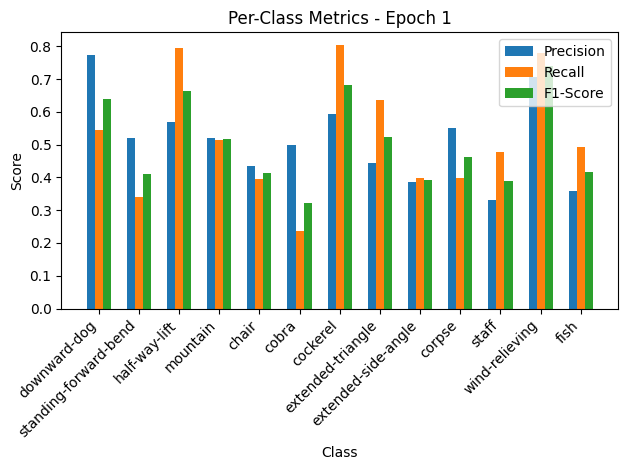

Validation: 100%|██████████| 10/10 [00:00<00:00, 166.75it/s, loss=1.34, accuracy=58.2]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 1:
downward-dog: Precision=0.77, Recall=0.55, F1-Score=0.64
standing-forward-bend: Precision=0.52, Recall=0.34, F1-Score=0.41
half-way-lift: Precision=0.57, Recall=0.79, F1-Score=0.66
mountain: Precision=0.52, Recall=0.51, F1-Score=0.52
chair: Precision=0.43, Recall=0.40, F1-Score=0.41
cobra: Precision=0.50, Recall=0.24, F1-Score=0.32
cockerel: Precision=0.59, Recall=0.80, F1-Score=0.68
extended-triangle: Precision=0.45, Recall=0.64, F1-Score=0.52
extended-side-angle: Precision=0.39, Recall=0.40, F1-Score=0.39
corpse: Precision=0.55, Recall=0.40, F1-Score=0.46
staff: Precision=0.33, Recall=0.48, F1-Score=0.39
wind-relieving: Precision=0.71, Recall=0.78, F1-Score=0.74
fish: Precision=0.36, Recall=0.49, F1-Score=0.42


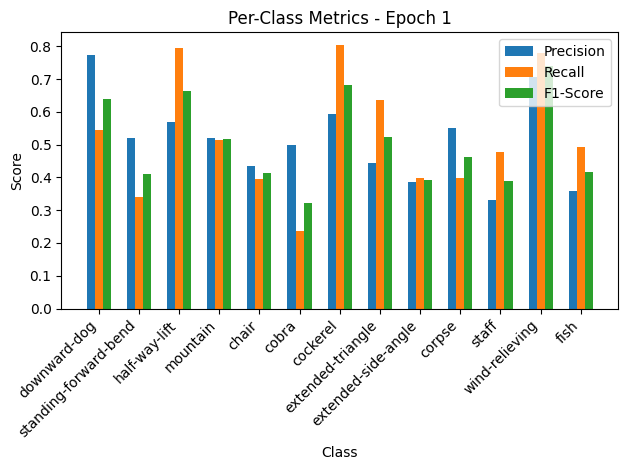


Epoch 2/50 Summary:
Train Loss: 1.6648 | Train Acc: 52.45% | Train Precision: 0.51 | Train Recall: 0.52 | Train F1: 0.51
Val Loss: 1.4724 | Val Acc: 58.22% | Val Precision: 0.49 | Val Recall: 0.55 | Val F1: 0.46
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_2.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_2.pth
Checkpoint saved at epoch 2
New best model saved! Validation Loss: 1.4724

Epoch 3/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 35.22it/s, loss=1.36, accuracy=58.3]


Per-Class Metrics for Epoch 2:
downward-dog: Precision=0.81, Recall=0.76, F1-Score=0.79
standing-forward-bend: Precision=0.60, Recall=0.48, F1-Score=0.53
half-way-lift: Precision=0.70, Recall=0.80, F1-Score=0.75
mountain: Precision=0.53, Recall=0.75, F1-Score=0.62
chair: Precision=0.76, Recall=0.31, F1-Score=0.44
cobra: Precision=0.23, Recall=0.06, F1-Score=0.10
cockerel: Precision=0.66, Recall=0.78, F1-Score=0.72
extended-triangle: Precision=0.51, Recall=0.83, F1-Score=0.63
extended-side-angle: Precision=0.49, Recall=0.36, F1-Score=0.41
corpse: Precision=0.37, Recall=0.54, F1-Score=0.44
staff: Precision=0.38, Recall=0.31, F1-Score=0.34
wind-relieving: Precision=0.70, Recall=0.75, F1-Score=0.72
fish: Precision=0.38, Recall=0.57, F1-Score=0.46


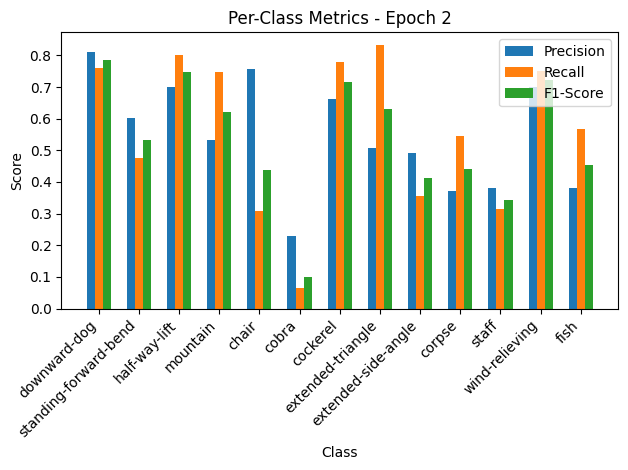

Validation: 100%|██████████| 10/10 [00:00<00:00, 165.35it/s, loss=1.01, accuracy=75.3]


Per-Class Metrics for Epoch 2:
downward-dog: Precision=0.81, Recall=0.76, F1-Score=0.79
standing-forward-bend: Precision=0.60, Recall=0.48, F1-Score=0.53
half-way-lift: Precision=0.70, Recall=0.80, F1-Score=0.75
mountain: Precision=0.53, Recall=0.75, F1-Score=0.62
chair: Precision=0.76, Recall=0.31, F1-Score=0.44
cobra: Precision=0.23, Recall=0.06, F1-Score=0.10
cockerel: Precision=0.66, Recall=0.78, F1-Score=0.72
extended-triangle: Precision=0.51, Recall=0.83, F1-Score=0.63
extended-side-angle: Precision=0.49, Recall=0.36, F1-Score=0.41
corpse: Precision=0.37, Recall=0.54, F1-Score=0.44
staff: Precision=0.38, Recall=0.31, F1-Score=0.34
wind-relieving: Precision=0.70, Recall=0.75, F1-Score=0.72
fish: Precision=0.38, Recall=0.57, F1-Score=0.46


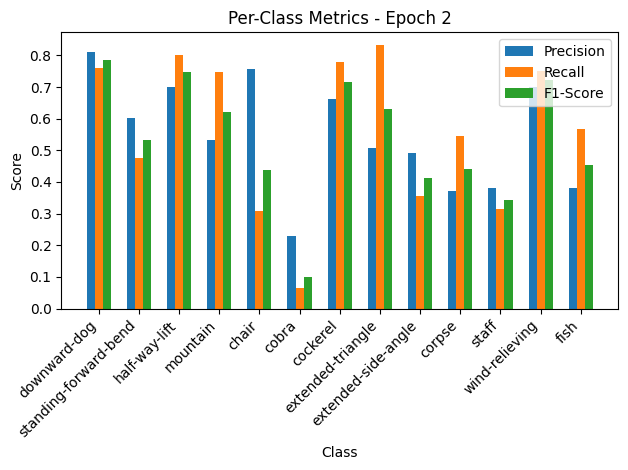


Epoch 3/50 Summary:
Train Loss: 1.3662 | Train Acc: 58.26% | Train Precision: 0.55 | Train Recall: 0.56 | Train F1: 0.53
Val Loss: 1.1065 | Val Acc: 75.34% | Val Precision: 0.76 | Val Recall: 0.76 | Val F1: 0.75
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_2.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_2.pth
Checkpoint saved at epoch 3
New best model saved! Validation Loss: 1.1065

Epoch 4/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:01<00:00, 41.52it/s, loss=1.12, accuracy=65.1]


Per-Class Metrics for Epoch 3:
downward-dog: Precision=0.85, Recall=0.81, F1-Score=0.83
standing-forward-bend: Precision=0.77, Recall=0.49, F1-Score=0.60
half-way-lift: Precision=0.69, Recall=0.87, F1-Score=0.77
mountain: Precision=0.60, Recall=0.79, F1-Score=0.68
chair: Precision=0.71, Recall=0.41, F1-Score=0.52
cobra: Precision=0.52, Recall=0.44, F1-Score=0.48
cockerel: Precision=0.76, Recall=0.88, F1-Score=0.82
extended-triangle: Precision=0.49, Recall=0.61, F1-Score=0.55
extended-side-angle: Precision=0.49, Recall=0.42, F1-Score=0.46
corpse: Precision=0.43, Recall=0.34, F1-Score=0.38
staff: Precision=0.54, Recall=0.54, F1-Score=0.54
wind-relieving: Precision=0.76, Recall=0.91, F1-Score=0.83
fish: Precision=0.52, Recall=0.70, F1-Score=0.59


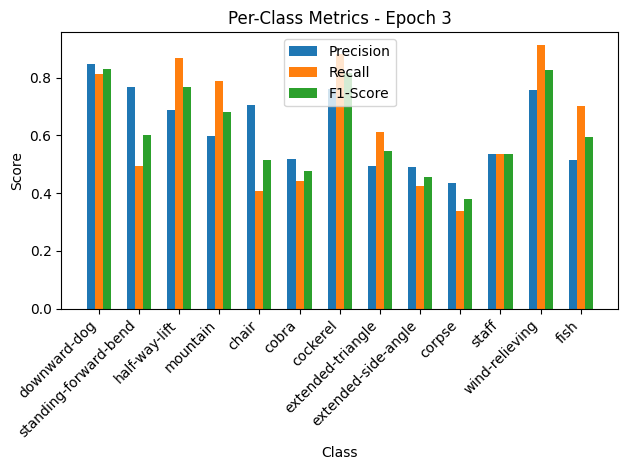

Validation: 100%|██████████| 10/10 [00:00<00:00, 136.04it/s, loss=0.86, accuracy=76.7]


Per-Class Metrics for Epoch 3:
downward-dog: Precision=0.85, Recall=0.81, F1-Score=0.83
standing-forward-bend: Precision=0.77, Recall=0.49, F1-Score=0.60
half-way-lift: Precision=0.69, Recall=0.87, F1-Score=0.77
mountain: Precision=0.60, Recall=0.79, F1-Score=0.68
chair: Precision=0.71, Recall=0.41, F1-Score=0.52
cobra: Precision=0.52, Recall=0.44, F1-Score=0.48
cockerel: Precision=0.76, Recall=0.88, F1-Score=0.82
extended-triangle: Precision=0.49, Recall=0.61, F1-Score=0.55
extended-side-angle: Precision=0.49, Recall=0.42, F1-Score=0.46
corpse: Precision=0.43, Recall=0.34, F1-Score=0.38
staff: Precision=0.54, Recall=0.54, F1-Score=0.54
wind-relieving: Precision=0.76, Recall=0.91, F1-Score=0.83
fish: Precision=0.52, Recall=0.70, F1-Score=0.59


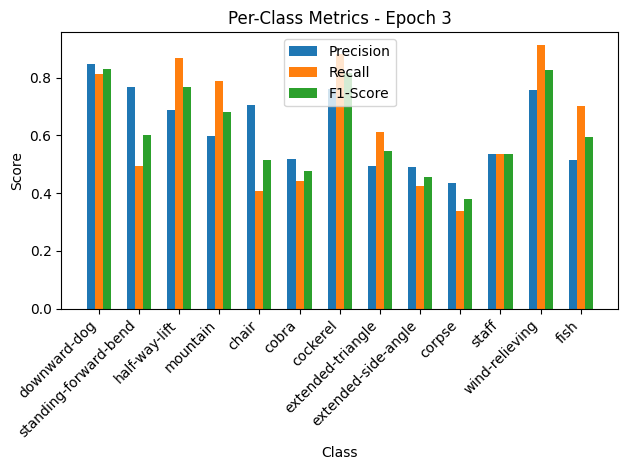


Epoch 4/50 Summary:
Train Loss: 1.1250 | Train Acc: 65.14% | Train Precision: 0.62 | Train Recall: 0.63 | Train F1: 0.62
Val Loss: 0.9424 | Val Acc: 76.71% | Val Precision: 0.77 | Val Recall: 0.76 | Val F1: 0.74
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_2.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_2.pth
Checkpoint saved at epoch 4
New best model saved! Validation Loss: 0.9424

Epoch 5/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 40.43it/s, loss=0.97, accuracy=70.8]


Per-Class Metrics for Epoch 4:
downward-dog: Precision=0.92, Recall=0.85, F1-Score=0.88
standing-forward-bend: Precision=0.83, Recall=0.60, F1-Score=0.70
half-way-lift: Precision=0.79, Recall=0.89, F1-Score=0.83
mountain: Precision=0.72, Recall=0.86, F1-Score=0.78
chair: Precision=0.78, Recall=0.70, F1-Score=0.74
cobra: Precision=0.61, Recall=0.57, F1-Score=0.59
cockerel: Precision=0.79, Recall=0.87, F1-Score=0.83
extended-triangle: Precision=0.41, Recall=0.43, F1-Score=0.42
extended-side-angle: Precision=0.43, Recall=0.49, F1-Score=0.46
corpse: Precision=0.59, Recall=0.50, F1-Score=0.54
staff: Precision=0.70, Recall=0.63, F1-Score=0.66
wind-relieving: Precision=0.82, Recall=0.90, F1-Score=0.86
fish: Precision=0.43, Recall=0.58, F1-Score=0.50


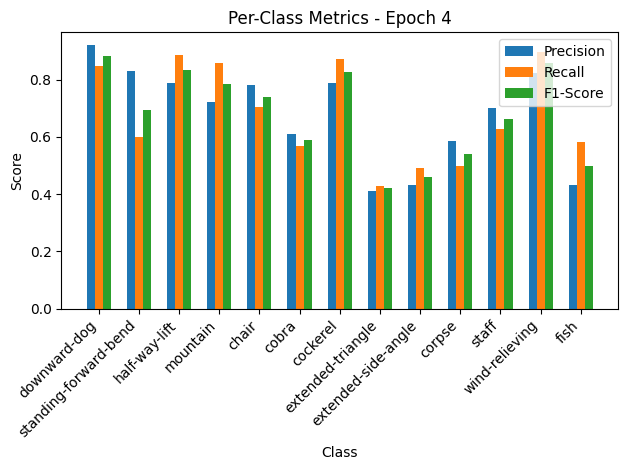

Validation: 100%|██████████| 10/10 [00:00<00:00, 170.72it/s, loss=0.881, accuracy=76]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 4:
downward-dog: Precision=0.92, Recall=0.85, F1-Score=0.88
standing-forward-bend: Precision=0.83, Recall=0.60, F1-Score=0.70
half-way-lift: Precision=0.79, Recall=0.89, F1-Score=0.83
mountain: Precision=0.72, Recall=0.86, F1-Score=0.78
chair: Precision=0.78, Recall=0.70, F1-Score=0.74
cobra: Precision=0.61, Recall=0.57, F1-Score=0.59
cockerel: Precision=0.79, Recall=0.87, F1-Score=0.83
extended-triangle: Precision=0.41, Recall=0.43, F1-Score=0.42
extended-side-angle: Precision=0.43, Recall=0.49, F1-Score=0.46
corpse: Precision=0.59, Recall=0.50, F1-Score=0.54
staff: Precision=0.70, Recall=0.63, F1-Score=0.66
wind-relieving: Precision=0.82, Recall=0.90, F1-Score=0.86
fish: Precision=0.43, Recall=0.58, F1-Score=0.50


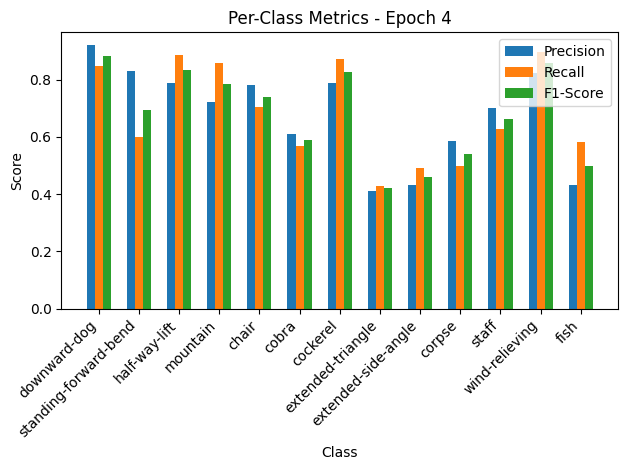


Epoch 5/50 Summary:
Train Loss: 0.9728 | Train Acc: 70.80% | Train Precision: 0.68 | Train Recall: 0.68 | Train F1: 0.68
Val Loss: 0.9651 | Val Acc: 76.03% | Val Precision: 0.73 | Val Recall: 0.74 | Val F1: 0.69

Epoch 6/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 35.63it/s, loss=0.869, accuracy=76.8]


Per-Class Metrics for Epoch 5:
downward-dog: Precision=0.94, Recall=0.91, F1-Score=0.92
standing-forward-bend: Precision=0.94, Recall=0.71, F1-Score=0.81
half-way-lift: Precision=0.79, Recall=0.94, F1-Score=0.86
mountain: Precision=0.78, Recall=0.89, F1-Score=0.83
chair: Precision=0.82, Recall=0.73, F1-Score=0.77
cobra: Precision=0.55, Recall=0.54, F1-Score=0.54
cockerel: Precision=0.83, Recall=0.88, F1-Score=0.85
extended-triangle: Precision=0.63, Recall=0.62, F1-Score=0.63
extended-side-angle: Precision=0.62, Recall=0.66, F1-Score=0.64
corpse: Precision=0.67, Recall=0.68, F1-Score=0.67
staff: Precision=0.71, Recall=0.61, F1-Score=0.66
wind-relieving: Precision=0.83, Recall=0.88, F1-Score=0.86
fish: Precision=0.51, Recall=0.57, F1-Score=0.54


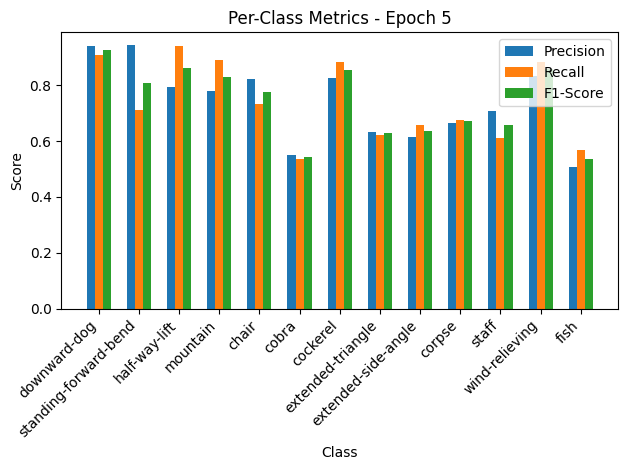

Validation: 100%|██████████| 10/10 [00:00<00:00, 112.92it/s, loss=0.777, accuracy=71.2]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 5:
downward-dog: Precision=0.94, Recall=0.91, F1-Score=0.92
standing-forward-bend: Precision=0.94, Recall=0.71, F1-Score=0.81
half-way-lift: Precision=0.79, Recall=0.94, F1-Score=0.86
mountain: Precision=0.78, Recall=0.89, F1-Score=0.83
chair: Precision=0.82, Recall=0.73, F1-Score=0.77
cobra: Precision=0.55, Recall=0.54, F1-Score=0.54
cockerel: Precision=0.83, Recall=0.88, F1-Score=0.85
extended-triangle: Precision=0.63, Recall=0.62, F1-Score=0.63
extended-side-angle: Precision=0.62, Recall=0.66, F1-Score=0.64
corpse: Precision=0.67, Recall=0.68, F1-Score=0.67
staff: Precision=0.71, Recall=0.61, F1-Score=0.66
wind-relieving: Precision=0.83, Recall=0.88, F1-Score=0.86
fish: Precision=0.51, Recall=0.57, F1-Score=0.54


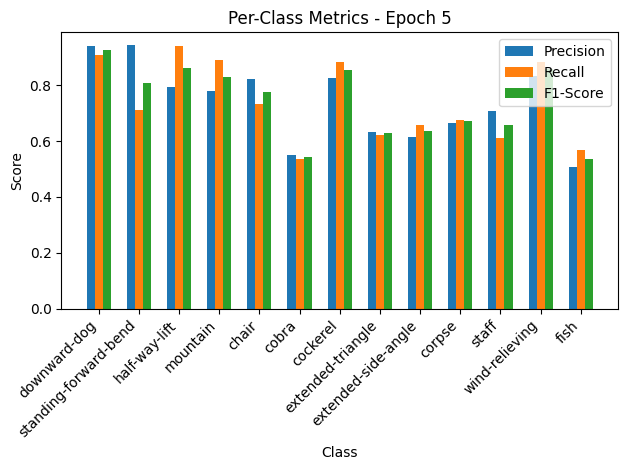


Epoch 6/50 Summary:
Train Loss: 0.8719 | Train Acc: 76.76% | Train Precision: 0.74 | Train Recall: 0.74 | Train F1: 0.74
Val Loss: 0.8510 | Val Acc: 71.23% | Val Precision: 0.68 | Val Recall: 0.70 | Val F1: 0.65
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_2.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_2.pth
Checkpoint saved at epoch 6
New best model saved! Validation Loss: 0.8510

Epoch 7/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 35.43it/s, loss=0.776, accuracy=79.2]


Per-Class Metrics for Epoch 6:
downward-dog: Precision=0.93, Recall=0.89, F1-Score=0.91
standing-forward-bend: Precision=0.92, Recall=0.74, F1-Score=0.82
half-way-lift: Precision=0.81, Recall=0.91, F1-Score=0.86
mountain: Precision=0.85, Recall=0.90, F1-Score=0.87
chair: Precision=0.82, Recall=0.84, F1-Score=0.83
cobra: Precision=0.82, Recall=0.49, F1-Score=0.62
cockerel: Precision=0.84, Recall=0.86, F1-Score=0.85
extended-triangle: Precision=0.62, Recall=0.79, F1-Score=0.70
extended-side-angle: Precision=0.66, Recall=0.51, F1-Score=0.57
corpse: Precision=0.67, Recall=0.63, F1-Score=0.65
staff: Precision=0.71, Recall=0.87, F1-Score=0.78
wind-relieving: Precision=0.86, Recall=0.94, F1-Score=0.90
fish: Precision=0.51, Recall=0.69, F1-Score=0.59


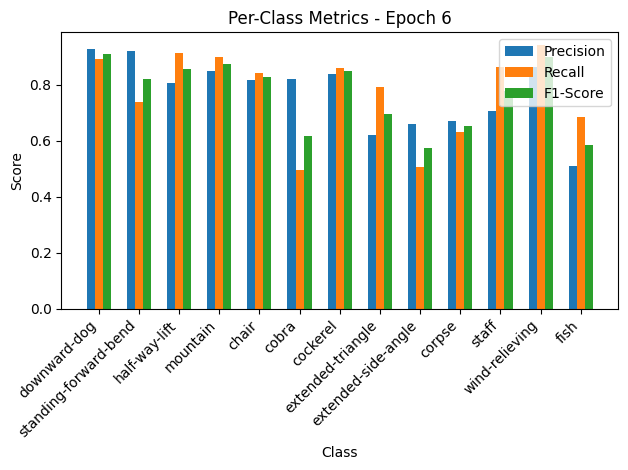

Validation: 100%|██████████| 10/10 [00:00<00:00, 175.44it/s, loss=0.702, accuracy=79.5]


Per-Class Metrics for Epoch 6:
downward-dog: Precision=0.93, Recall=0.89, F1-Score=0.91
standing-forward-bend: Precision=0.92, Recall=0.74, F1-Score=0.82
half-way-lift: Precision=0.81, Recall=0.91, F1-Score=0.86
mountain: Precision=0.85, Recall=0.90, F1-Score=0.87
chair: Precision=0.82, Recall=0.84, F1-Score=0.83
cobra: Precision=0.82, Recall=0.49, F1-Score=0.62
cockerel: Precision=0.84, Recall=0.86, F1-Score=0.85
extended-triangle: Precision=0.62, Recall=0.79, F1-Score=0.70
extended-side-angle: Precision=0.66, Recall=0.51, F1-Score=0.57
corpse: Precision=0.67, Recall=0.63, F1-Score=0.65
staff: Precision=0.71, Recall=0.87, F1-Score=0.78
wind-relieving: Precision=0.86, Recall=0.94, F1-Score=0.90
fish: Precision=0.51, Recall=0.69, F1-Score=0.59


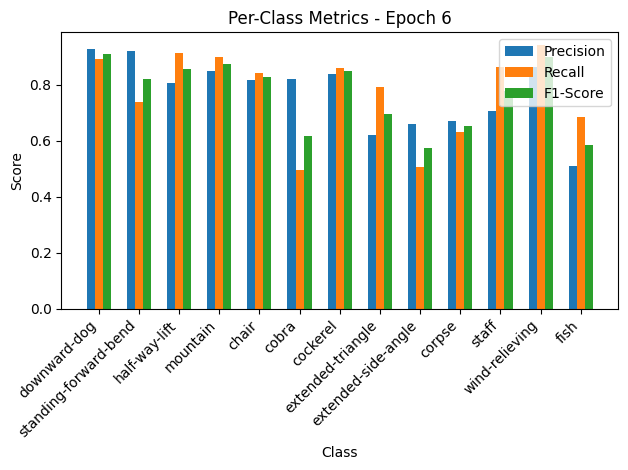


Epoch 7/50 Summary:
Train Loss: 0.7785 | Train Acc: 79.20% | Train Precision: 0.77 | Train Recall: 0.77 | Train F1: 0.77
Val Loss: 0.7695 | Val Acc: 79.45% | Val Precision: 0.82 | Val Recall: 0.77 | Val F1: 0.77
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_2.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_2.pth
Checkpoint saved at epoch 7
New best model saved! Validation Loss: 0.7695

Epoch 8/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:01<00:00, 41.30it/s, loss=0.678, accuracy=81.9]


Per-Class Metrics for Epoch 7:
downward-dog: Precision=0.93, Recall=0.91, F1-Score=0.92
standing-forward-bend: Precision=0.89, Recall=0.73, F1-Score=0.80
half-way-lift: Precision=0.81, Recall=0.92, F1-Score=0.86
mountain: Precision=0.80, Recall=0.76, F1-Score=0.78
chair: Precision=0.75, Recall=0.83, F1-Score=0.79
cobra: Precision=0.83, Recall=0.75, F1-Score=0.79
cockerel: Precision=0.88, Recall=0.88, F1-Score=0.88
extended-triangle: Precision=0.81, Recall=0.75, F1-Score=0.78
extended-side-angle: Precision=0.73, Recall=0.79, F1-Score=0.76
corpse: Precision=0.66, Recall=0.66, F1-Score=0.66
staff: Precision=0.84, Recall=0.85, F1-Score=0.84
wind-relieving: Precision=0.90, Recall=0.96, F1-Score=0.93
fish: Precision=0.66, Recall=0.75, F1-Score=0.70


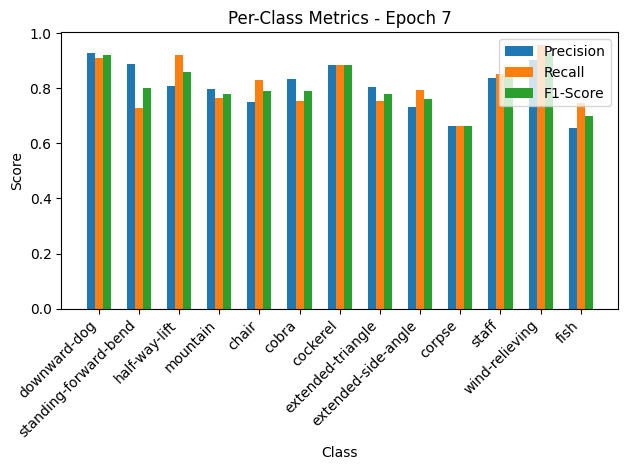

Validation: 100%|██████████| 10/10 [00:00<00:00, 176.65it/s, loss=0.549, accuracy=82.9]


Per-Class Metrics for Epoch 7:
downward-dog: Precision=0.93, Recall=0.91, F1-Score=0.92
standing-forward-bend: Precision=0.89, Recall=0.73, F1-Score=0.80
half-way-lift: Precision=0.81, Recall=0.92, F1-Score=0.86
mountain: Precision=0.80, Recall=0.76, F1-Score=0.78
chair: Precision=0.75, Recall=0.83, F1-Score=0.79
cobra: Precision=0.83, Recall=0.75, F1-Score=0.79
cockerel: Precision=0.88, Recall=0.88, F1-Score=0.88
extended-triangle: Precision=0.81, Recall=0.75, F1-Score=0.78
extended-side-angle: Precision=0.73, Recall=0.79, F1-Score=0.76
corpse: Precision=0.66, Recall=0.66, F1-Score=0.66
staff: Precision=0.84, Recall=0.85, F1-Score=0.84
wind-relieving: Precision=0.90, Recall=0.96, F1-Score=0.93
fish: Precision=0.66, Recall=0.75, F1-Score=0.70


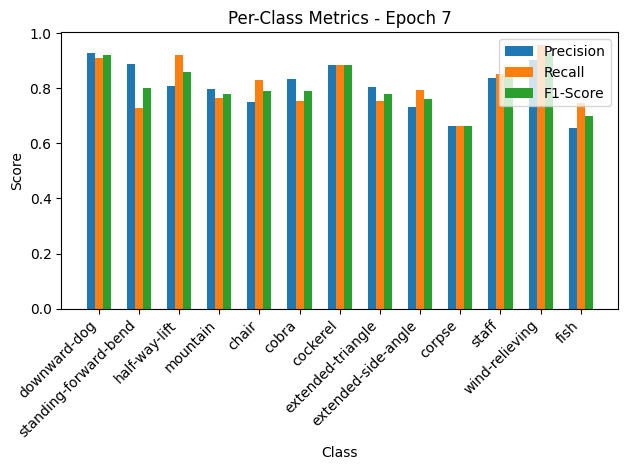


Epoch 8/50 Summary:
Train Loss: 0.6798 | Train Acc: 81.88% | Train Precision: 0.81 | Train Recall: 0.81 | Train F1: 0.81
Val Loss: 0.6012 | Val Acc: 82.88% | Val Precision: 0.86 | Val Recall: 0.83 | Val F1: 0.81
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_2.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_2.pth
Checkpoint saved at epoch 8
New best model saved! Validation Loss: 0.6012

Epoch 9/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:01<00:00, 41.46it/s, loss=0.557, accuracy=86.3]


Per-Class Metrics for Epoch 8:
downward-dog: Precision=0.95, Recall=0.91, F1-Score=0.93
standing-forward-bend: Precision=0.94, Recall=0.73, F1-Score=0.82
half-way-lift: Precision=0.78, Recall=0.91, F1-Score=0.84
mountain: Precision=0.84, Recall=0.91, F1-Score=0.87
chair: Precision=0.81, Recall=0.82, F1-Score=0.82
cobra: Precision=0.91, Recall=0.84, F1-Score=0.87
cockerel: Precision=0.94, Recall=0.98, F1-Score=0.96
extended-triangle: Precision=0.85, Recall=0.83, F1-Score=0.84
extended-side-angle: Precision=0.84, Recall=0.88, F1-Score=0.86
corpse: Precision=0.78, Recall=0.78, F1-Score=0.78
staff: Precision=0.86, Recall=0.91, F1-Score=0.88
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.70, Recall=0.76, F1-Score=0.73


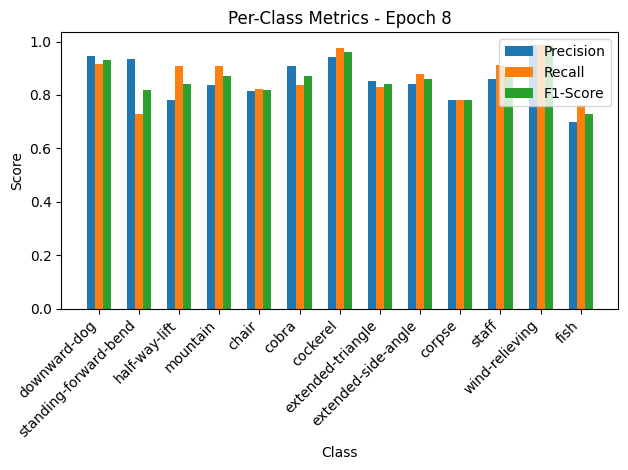

Validation: 100%|██████████| 10/10 [00:00<00:00, 168.31it/s, loss=0.511, accuracy=85.6]


Per-Class Metrics for Epoch 8:
downward-dog: Precision=0.95, Recall=0.91, F1-Score=0.93
standing-forward-bend: Precision=0.94, Recall=0.73, F1-Score=0.82
half-way-lift: Precision=0.78, Recall=0.91, F1-Score=0.84
mountain: Precision=0.84, Recall=0.91, F1-Score=0.87
chair: Precision=0.81, Recall=0.82, F1-Score=0.82
cobra: Precision=0.91, Recall=0.84, F1-Score=0.87
cockerel: Precision=0.94, Recall=0.98, F1-Score=0.96
extended-triangle: Precision=0.85, Recall=0.83, F1-Score=0.84
extended-side-angle: Precision=0.84, Recall=0.88, F1-Score=0.86
corpse: Precision=0.78, Recall=0.78, F1-Score=0.78
staff: Precision=0.86, Recall=0.91, F1-Score=0.88
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.70, Recall=0.76, F1-Score=0.73


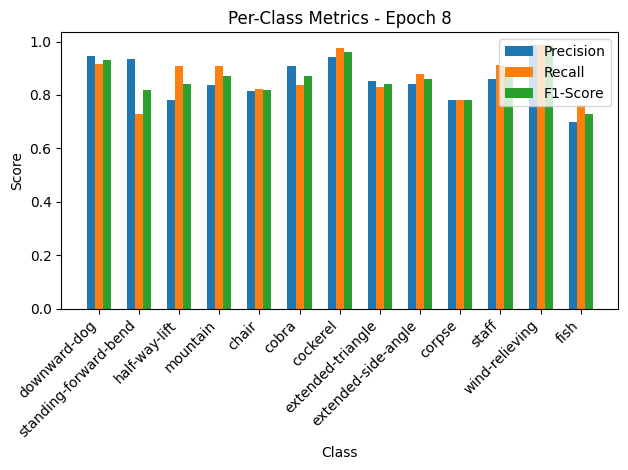


Epoch 9/50 Summary:
Train Loss: 0.5583 | Train Acc: 86.31% | Train Precision: 0.86 | Train Recall: 0.86 | Train F1: 0.86
Val Loss: 0.5598 | Val Acc: 85.62% | Val Precision: 0.87 | Val Recall: 0.86 | Val F1: 0.85
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_2.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_2.pth
Checkpoint saved at epoch 9
New best model saved! Validation Loss: 0.5598

Epoch 10/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 36.22it/s, loss=0.527, accuracy=85.9]


Per-Class Metrics for Epoch 9:
downward-dog: Precision=0.98, Recall=0.90, F1-Score=0.93
standing-forward-bend: Precision=0.94, Recall=0.79, F1-Score=0.86
half-way-lift: Precision=0.81, Recall=0.96, F1-Score=0.88
mountain: Precision=0.86, Recall=0.89, F1-Score=0.88
chair: Precision=0.86, Recall=0.83, F1-Score=0.84
cobra: Precision=0.89, Recall=0.89, F1-Score=0.89
cockerel: Precision=0.84, Recall=0.93, F1-Score=0.88
extended-triangle: Precision=0.81, Recall=0.79, F1-Score=0.80
extended-side-angle: Precision=0.79, Recall=0.82, F1-Score=0.81
corpse: Precision=0.71, Recall=0.69, F1-Score=0.70
staff: Precision=0.87, Recall=0.91, F1-Score=0.89
wind-relieving: Precision=0.95, Recall=0.90, F1-Score=0.92
fish: Precision=0.69, Recall=0.73, F1-Score=0.71


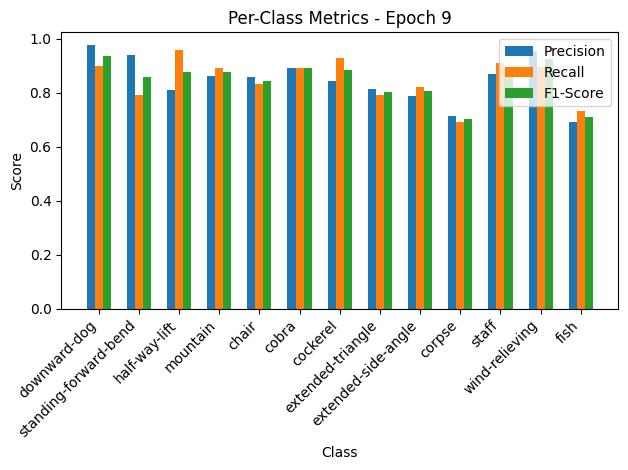

Validation: 100%|██████████| 10/10 [00:00<00:00, 108.04it/s, loss=0.407, accuracy=89.7]


Per-Class Metrics for Epoch 9:
downward-dog: Precision=0.98, Recall=0.90, F1-Score=0.93
standing-forward-bend: Precision=0.94, Recall=0.79, F1-Score=0.86
half-way-lift: Precision=0.81, Recall=0.96, F1-Score=0.88
mountain: Precision=0.86, Recall=0.89, F1-Score=0.88
chair: Precision=0.86, Recall=0.83, F1-Score=0.84
cobra: Precision=0.89, Recall=0.89, F1-Score=0.89
cockerel: Precision=0.84, Recall=0.93, F1-Score=0.88
extended-triangle: Precision=0.81, Recall=0.79, F1-Score=0.80
extended-side-angle: Precision=0.79, Recall=0.82, F1-Score=0.81
corpse: Precision=0.71, Recall=0.69, F1-Score=0.70
staff: Precision=0.87, Recall=0.91, F1-Score=0.89
wind-relieving: Precision=0.95, Recall=0.90, F1-Score=0.92
fish: Precision=0.69, Recall=0.73, F1-Score=0.71


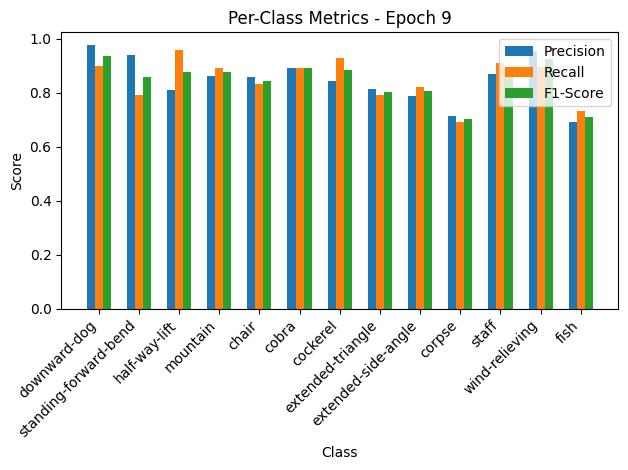


Epoch 10/50 Summary:
Train Loss: 0.5282 | Train Acc: 85.86% | Train Precision: 0.85 | Train Recall: 0.85 | Train F1: 0.85
Val Loss: 0.4465 | Val Acc: 89.73% | Val Precision: 0.92 | Val Recall: 0.91 | Val F1: 0.90
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_2.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_2.pth
Checkpoint saved at epoch 10
New best model saved! Validation Loss: 0.4465

Epoch 11/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 36.41it/s, loss=0.467, accuracy=87.1]


Per-Class Metrics for Epoch 10:
downward-dog: Precision=0.97, Recall=0.89, F1-Score=0.93
standing-forward-bend: Precision=0.93, Recall=0.77, F1-Score=0.84
half-way-lift: Precision=0.80, Recall=0.96, F1-Score=0.87
mountain: Precision=0.84, Recall=0.92, F1-Score=0.88
chair: Precision=0.87, Recall=0.79, F1-Score=0.83
cobra: Precision=0.92, Recall=0.90, F1-Score=0.91
cockerel: Precision=0.90, Recall=0.97, F1-Score=0.93
extended-triangle: Precision=0.83, Recall=0.88, F1-Score=0.86
extended-side-angle: Precision=0.84, Recall=0.81, F1-Score=0.83
corpse: Precision=0.82, Recall=0.75, F1-Score=0.78
staff: Precision=0.83, Recall=0.90, F1-Score=0.86
wind-relieving: Precision=0.96, Recall=0.97, F1-Score=0.96
fish: Precision=0.74, Recall=0.79, F1-Score=0.76


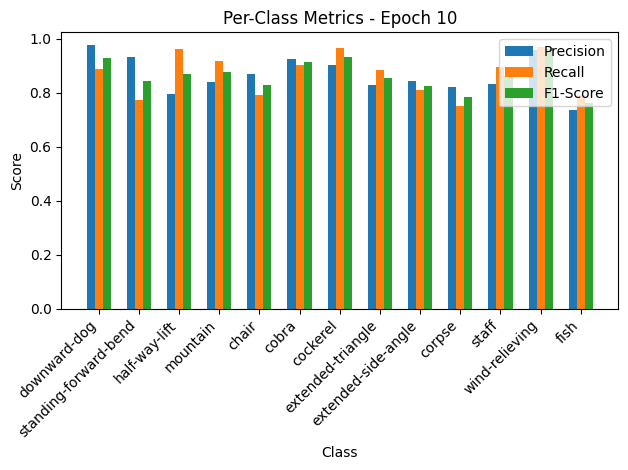

Validation: 100%|██████████| 10/10 [00:00<00:00, 172.06it/s, loss=0.386, accuracy=87.7]


Per-Class Metrics for Epoch 10:
downward-dog: Precision=0.97, Recall=0.89, F1-Score=0.93
standing-forward-bend: Precision=0.93, Recall=0.77, F1-Score=0.84
half-way-lift: Precision=0.80, Recall=0.96, F1-Score=0.87
mountain: Precision=0.84, Recall=0.92, F1-Score=0.88
chair: Precision=0.87, Recall=0.79, F1-Score=0.83
cobra: Precision=0.92, Recall=0.90, F1-Score=0.91
cockerel: Precision=0.90, Recall=0.97, F1-Score=0.93
extended-triangle: Precision=0.83, Recall=0.88, F1-Score=0.86
extended-side-angle: Precision=0.84, Recall=0.81, F1-Score=0.83
corpse: Precision=0.82, Recall=0.75, F1-Score=0.78
staff: Precision=0.83, Recall=0.90, F1-Score=0.86
wind-relieving: Precision=0.96, Recall=0.97, F1-Score=0.96
fish: Precision=0.74, Recall=0.79, F1-Score=0.76


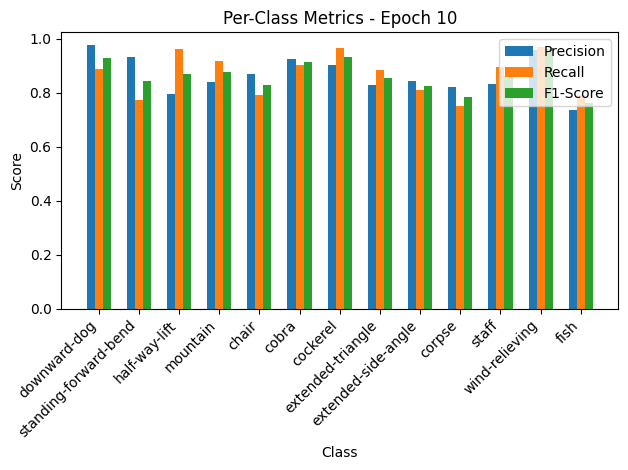


Epoch 11/50 Summary:
Train Loss: 0.4686 | Train Acc: 87.08% | Train Precision: 0.87 | Train Recall: 0.87 | Train F1: 0.87
Val Loss: 0.4230 | Val Acc: 87.67% | Val Precision: 0.90 | Val Recall: 0.89 | Val F1: 0.88
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_2.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_2.pth
Checkpoint saved at epoch 11
New best model saved! Validation Loss: 0.4230

Epoch 12/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:01<00:00, 41.39it/s, loss=0.499, accuracy=87.2]


Per-Class Metrics for Epoch 11:
downward-dog: Precision=0.95, Recall=0.89, F1-Score=0.92
standing-forward-bend: Precision=0.94, Recall=0.78, F1-Score=0.86
half-way-lift: Precision=0.82, Recall=0.93, F1-Score=0.87
mountain: Precision=0.83, Recall=0.92, F1-Score=0.87
chair: Precision=0.84, Recall=0.76, F1-Score=0.80
cobra: Precision=0.89, Recall=0.91, F1-Score=0.90
cockerel: Precision=0.87, Recall=0.91, F1-Score=0.89
extended-triangle: Precision=0.89, Recall=0.88, F1-Score=0.89
extended-side-angle: Precision=0.85, Recall=0.85, F1-Score=0.85
corpse: Precision=0.85, Recall=0.76, F1-Score=0.81
staff: Precision=0.87, Recall=0.93, F1-Score=0.90
wind-relieving: Precision=0.93, Recall=0.97, F1-Score=0.95
fish: Precision=0.78, Recall=0.85, F1-Score=0.81


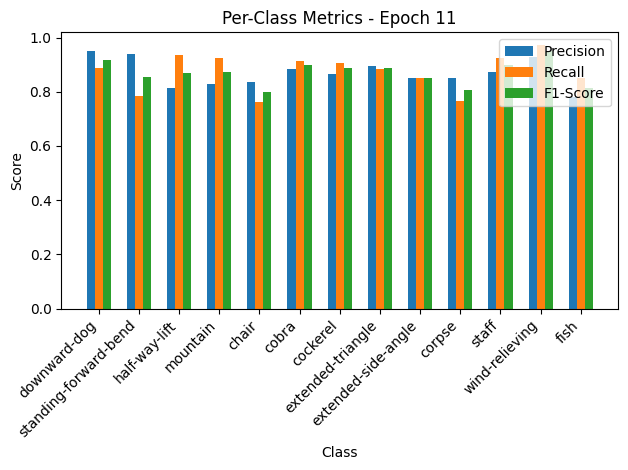

Validation: 100%|██████████| 10/10 [00:00<00:00, 178.03it/s, loss=0.411, accuracy=87.7]


Per-Class Metrics for Epoch 11:
downward-dog: Precision=0.95, Recall=0.89, F1-Score=0.92
standing-forward-bend: Precision=0.94, Recall=0.78, F1-Score=0.86
half-way-lift: Precision=0.82, Recall=0.93, F1-Score=0.87
mountain: Precision=0.83, Recall=0.92, F1-Score=0.87
chair: Precision=0.84, Recall=0.76, F1-Score=0.80
cobra: Precision=0.89, Recall=0.91, F1-Score=0.90
cockerel: Precision=0.87, Recall=0.91, F1-Score=0.89
extended-triangle: Precision=0.89, Recall=0.88, F1-Score=0.89
extended-side-angle: Precision=0.85, Recall=0.85, F1-Score=0.85
corpse: Precision=0.85, Recall=0.76, F1-Score=0.81
staff: Precision=0.87, Recall=0.93, F1-Score=0.90
wind-relieving: Precision=0.93, Recall=0.97, F1-Score=0.95
fish: Precision=0.78, Recall=0.85, F1-Score=0.81


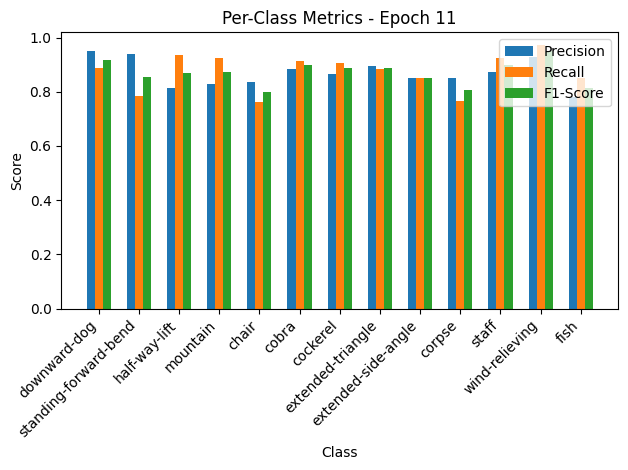


Epoch 12/50 Summary:
Train Loss: 0.5001 | Train Acc: 87.23% | Train Precision: 0.87 | Train Recall: 0.87 | Train F1: 0.87
Val Loss: 0.4500 | Val Acc: 87.67% | Val Precision: 0.91 | Val Recall: 0.87 | Val F1: 0.86

Epoch 13/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:01<00:00, 43.56it/s, loss=0.421, accuracy=87.9]


Per-Class Metrics for Epoch 12:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=0.93, Recall=0.78, F1-Score=0.85
half-way-lift: Precision=0.82, Recall=0.90, F1-Score=0.86
mountain: Precision=0.84, Recall=0.92, F1-Score=0.88
chair: Precision=0.83, Recall=0.82, F1-Score=0.83
cobra: Precision=0.89, Recall=0.90, F1-Score=0.90
cockerel: Precision=0.91, Recall=0.95, F1-Score=0.93
extended-triangle: Precision=0.89, Recall=0.92, F1-Score=0.90
extended-side-angle: Precision=0.88, Recall=0.90, F1-Score=0.89
corpse: Precision=0.75, Recall=0.78, F1-Score=0.76
staff: Precision=0.94, Recall=0.97, F1-Score=0.96
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.77, Recall=0.73, F1-Score=0.75


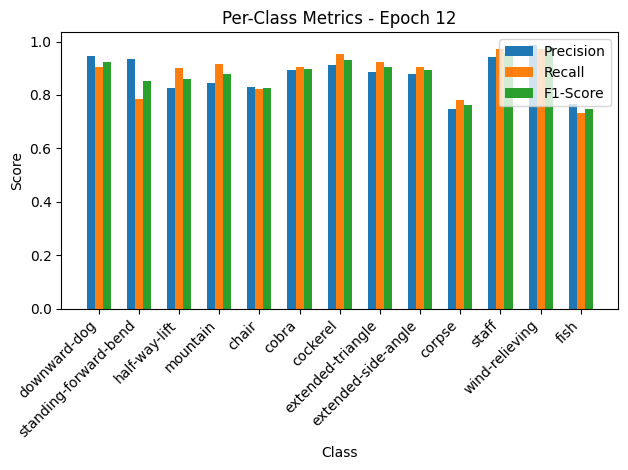

Validation: 100%|██████████| 10/10 [00:00<00:00, 184.54it/s, loss=0.364, accuracy=85.6]


Per-Class Metrics for Epoch 12:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=0.93, Recall=0.78, F1-Score=0.85
half-way-lift: Precision=0.82, Recall=0.90, F1-Score=0.86
mountain: Precision=0.84, Recall=0.92, F1-Score=0.88
chair: Precision=0.83, Recall=0.82, F1-Score=0.83
cobra: Precision=0.89, Recall=0.90, F1-Score=0.90
cockerel: Precision=0.91, Recall=0.95, F1-Score=0.93
extended-triangle: Precision=0.89, Recall=0.92, F1-Score=0.90
extended-side-angle: Precision=0.88, Recall=0.90, F1-Score=0.89
corpse: Precision=0.75, Recall=0.78, F1-Score=0.76
staff: Precision=0.94, Recall=0.97, F1-Score=0.96
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.77, Recall=0.73, F1-Score=0.75


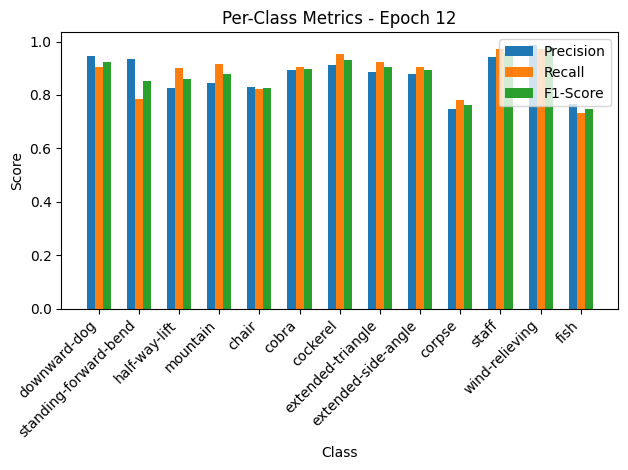


Epoch 13/50 Summary:
Train Loss: 0.4224 | Train Acc: 87.92% | Train Precision: 0.88 | Train Recall: 0.88 | Train F1: 0.88
Val Loss: 0.3984 | Val Acc: 85.62% | Val Precision: 0.89 | Val Recall: 0.89 | Val F1: 0.87
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_2.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_2.pth
Checkpoint saved at epoch 13
New best model saved! Validation Loss: 0.3984

Epoch 14/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 38.63it/s, loss=0.421, accuracy=87.9]


Per-Class Metrics for Epoch 13:
downward-dog: Precision=0.93, Recall=0.89, F1-Score=0.91
standing-forward-bend: Precision=0.98, Recall=0.76, F1-Score=0.86
half-way-lift: Precision=0.80, Recall=0.95, F1-Score=0.87
mountain: Precision=0.89, Recall=0.92, F1-Score=0.90
chair: Precision=0.85, Recall=0.89, F1-Score=0.87
cobra: Precision=0.90, Recall=0.91, F1-Score=0.91
cockerel: Precision=0.94, Recall=0.94, F1-Score=0.94
extended-triangle: Precision=0.87, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.85, Recall=0.84, F1-Score=0.84
corpse: Precision=0.78, Recall=0.75, F1-Score=0.77
staff: Precision=0.90, Recall=0.97, F1-Score=0.94
wind-relieving: Precision=0.96, Recall=0.96, F1-Score=0.96
fish: Precision=0.74, Recall=0.76, F1-Score=0.75


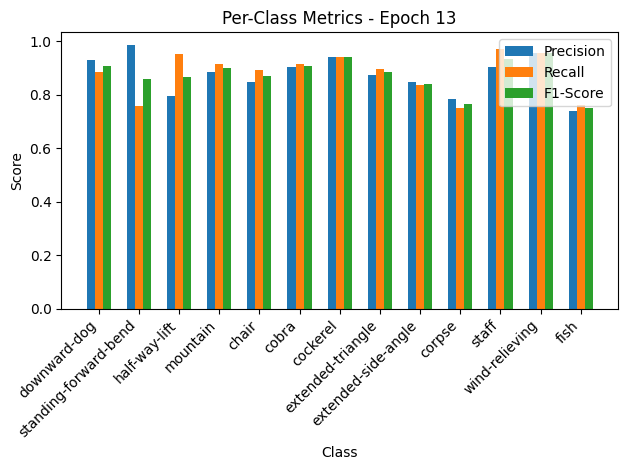

Validation: 100%|██████████| 10/10 [00:00<00:00, 153.76it/s, loss=0.413, accuracy=86.3]


Per-Class Metrics for Epoch 13:
downward-dog: Precision=0.93, Recall=0.89, F1-Score=0.91
standing-forward-bend: Precision=0.98, Recall=0.76, F1-Score=0.86
half-way-lift: Precision=0.80, Recall=0.95, F1-Score=0.87
mountain: Precision=0.89, Recall=0.92, F1-Score=0.90
chair: Precision=0.85, Recall=0.89, F1-Score=0.87
cobra: Precision=0.90, Recall=0.91, F1-Score=0.91
cockerel: Precision=0.94, Recall=0.94, F1-Score=0.94
extended-triangle: Precision=0.87, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.85, Recall=0.84, F1-Score=0.84
corpse: Precision=0.78, Recall=0.75, F1-Score=0.77
staff: Precision=0.90, Recall=0.97, F1-Score=0.94
wind-relieving: Precision=0.96, Recall=0.96, F1-Score=0.96
fish: Precision=0.74, Recall=0.76, F1-Score=0.75


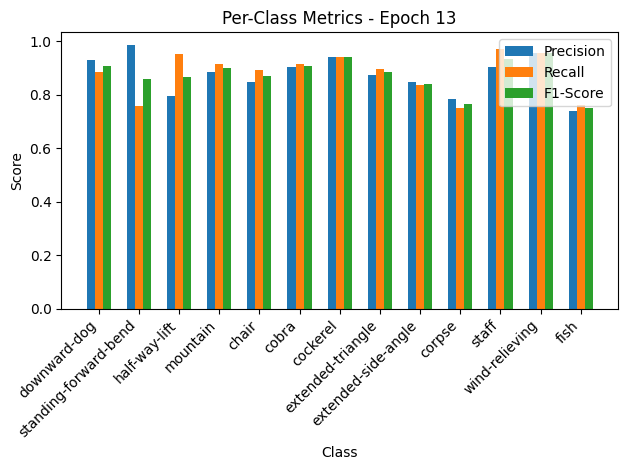


Epoch 14/50 Summary:
Train Loss: 0.4221 | Train Acc: 87.92% | Train Precision: 0.88 | Train Recall: 0.88 | Train F1: 0.88
Val Loss: 0.4529 | Val Acc: 86.30% | Val Precision: 0.90 | Val Recall: 0.87 | Val F1: 0.87

Epoch 15/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 31.28it/s, loss=0.377, accuracy=88.8]


Per-Class Metrics for Epoch 14:
downward-dog: Precision=0.95, Recall=0.88, F1-Score=0.91
standing-forward-bend: Precision=0.91, Recall=0.79, F1-Score=0.84
half-way-lift: Precision=0.82, Recall=0.93, F1-Score=0.87
mountain: Precision=0.83, Recall=0.92, F1-Score=0.88
chair: Precision=0.90, Recall=0.82, F1-Score=0.86
cobra: Precision=0.89, Recall=0.98, F1-Score=0.93
cockerel: Precision=0.88, Recall=0.94, F1-Score=0.91
extended-triangle: Precision=0.93, Recall=0.91, F1-Score=0.92
extended-side-angle: Precision=0.91, Recall=0.92, F1-Score=0.91
corpse: Precision=0.84, Recall=0.76, F1-Score=0.80
staff: Precision=0.96, Recall=0.97, F1-Score=0.96
wind-relieving: Precision=0.94, Recall=0.93, F1-Score=0.93
fish: Precision=0.80, Recall=0.84, F1-Score=0.82


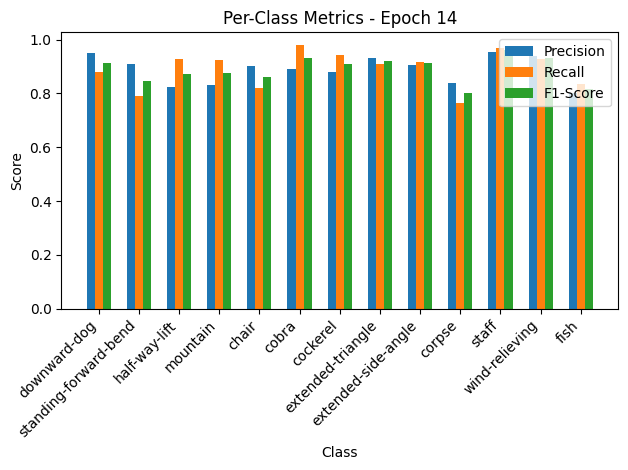

Validation: 100%|██████████| 10/10 [00:00<00:00, 140.51it/s, loss=0.386, accuracy=85.6]


Per-Class Metrics for Epoch 14:
downward-dog: Precision=0.95, Recall=0.88, F1-Score=0.91
standing-forward-bend: Precision=0.91, Recall=0.79, F1-Score=0.84
half-way-lift: Precision=0.82, Recall=0.93, F1-Score=0.87
mountain: Precision=0.83, Recall=0.92, F1-Score=0.88
chair: Precision=0.90, Recall=0.82, F1-Score=0.86
cobra: Precision=0.89, Recall=0.98, F1-Score=0.93
cockerel: Precision=0.88, Recall=0.94, F1-Score=0.91
extended-triangle: Precision=0.93, Recall=0.91, F1-Score=0.92
extended-side-angle: Precision=0.91, Recall=0.92, F1-Score=0.91
corpse: Precision=0.84, Recall=0.76, F1-Score=0.80
staff: Precision=0.96, Recall=0.97, F1-Score=0.96
wind-relieving: Precision=0.94, Recall=0.93, F1-Score=0.93
fish: Precision=0.80, Recall=0.84, F1-Score=0.82


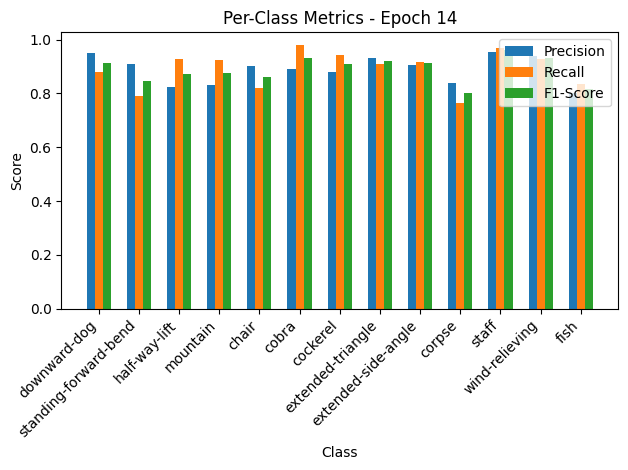


Epoch 15/50 Summary:
Train Loss: 0.3779 | Train Acc: 88.76% | Train Precision: 0.89 | Train Recall: 0.89 | Train F1: 0.89
Val Loss: 0.4227 | Val Acc: 85.62% | Val Precision: 0.88 | Val Recall: 0.85 | Val F1: 0.85

Epoch 16/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 39.51it/s, loss=0.378, accuracy=89]


Per-Class Metrics for Epoch 15:
downward-dog: Precision=0.92, Recall=0.89, F1-Score=0.90
standing-forward-bend: Precision=0.93, Recall=0.80, F1-Score=0.86
half-way-lift: Precision=0.81, Recall=0.92, F1-Score=0.86
mountain: Precision=0.86, Recall=0.93, F1-Score=0.90
chair: Precision=0.89, Recall=0.84, F1-Score=0.86
cobra: Precision=0.91, Recall=0.92, F1-Score=0.91
cockerel: Precision=0.94, Recall=0.95, F1-Score=0.95
extended-triangle: Precision=0.92, Recall=0.95, F1-Score=0.94
extended-side-angle: Precision=0.94, Recall=0.90, F1-Score=0.92
corpse: Precision=0.79, Recall=0.79, F1-Score=0.79
staff: Precision=0.93, Recall=0.99, F1-Score=0.96
wind-relieving: Precision=0.98, Recall=0.94, F1-Score=0.96
fish: Precision=0.78, Recall=0.79, F1-Score=0.79


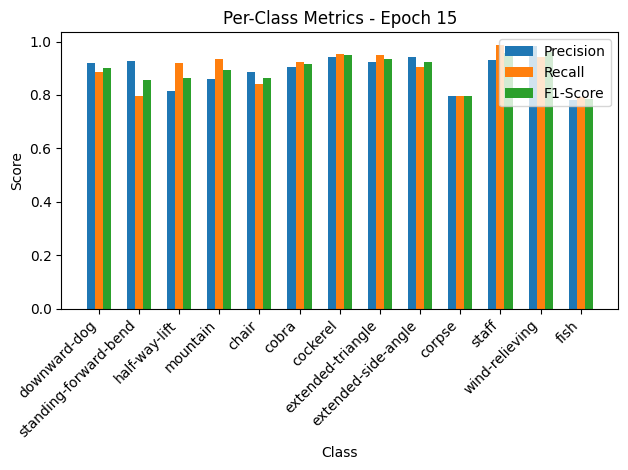

Validation: 100%|██████████| 10/10 [00:00<00:00, 182.38it/s, loss=0.289, accuracy=87]


Per-Class Metrics for Epoch 15:
downward-dog: Precision=0.92, Recall=0.89, F1-Score=0.90
standing-forward-bend: Precision=0.93, Recall=0.80, F1-Score=0.86
half-way-lift: Precision=0.81, Recall=0.92, F1-Score=0.86
mountain: Precision=0.86, Recall=0.93, F1-Score=0.90
chair: Precision=0.89, Recall=0.84, F1-Score=0.86
cobra: Precision=0.91, Recall=0.92, F1-Score=0.91
cockerel: Precision=0.94, Recall=0.95, F1-Score=0.95
extended-triangle: Precision=0.92, Recall=0.95, F1-Score=0.94
extended-side-angle: Precision=0.94, Recall=0.90, F1-Score=0.92
corpse: Precision=0.79, Recall=0.79, F1-Score=0.79
staff: Precision=0.93, Recall=0.99, F1-Score=0.96
wind-relieving: Precision=0.98, Recall=0.94, F1-Score=0.96
fish: Precision=0.78, Recall=0.79, F1-Score=0.79


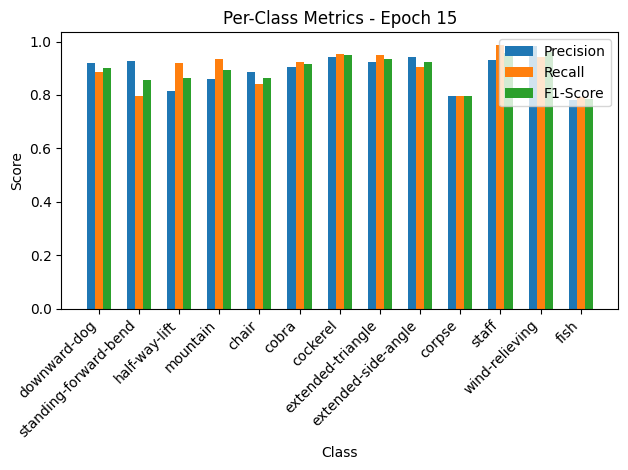


Epoch 16/50 Summary:
Train Loss: 0.3793 | Train Acc: 88.99% | Train Precision: 0.89 | Train Recall: 0.89 | Train F1: 0.89
Val Loss: 0.3163 | Val Acc: 86.99% | Val Precision: 0.89 | Val Recall: 0.88 | Val F1: 0.87
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_2.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_2.pth
Checkpoint saved at epoch 16
New best model saved! Validation Loss: 0.3163

Epoch 17/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:01<00:00, 42.27it/s, loss=0.368, accuracy=89.6]


Per-Class Metrics for Epoch 16:
downward-dog: Precision=0.96, Recall=0.91, F1-Score=0.94
standing-forward-bend: Precision=0.92, Recall=0.80, F1-Score=0.86
half-way-lift: Precision=0.87, Recall=0.91, F1-Score=0.89
mountain: Precision=0.89, Recall=0.91, F1-Score=0.90
chair: Precision=0.83, Recall=0.88, F1-Score=0.86
cobra: Precision=0.89, Recall=0.96, F1-Score=0.92
cockerel: Precision=0.90, Recall=0.99, F1-Score=0.94
extended-triangle: Precision=0.95, Recall=0.91, F1-Score=0.93
extended-side-angle: Precision=0.87, Recall=0.93, F1-Score=0.90
corpse: Precision=0.78, Recall=0.84, F1-Score=0.81
staff: Precision=0.97, Recall=0.99, F1-Score=0.98
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.79, Recall=0.69, F1-Score=0.74


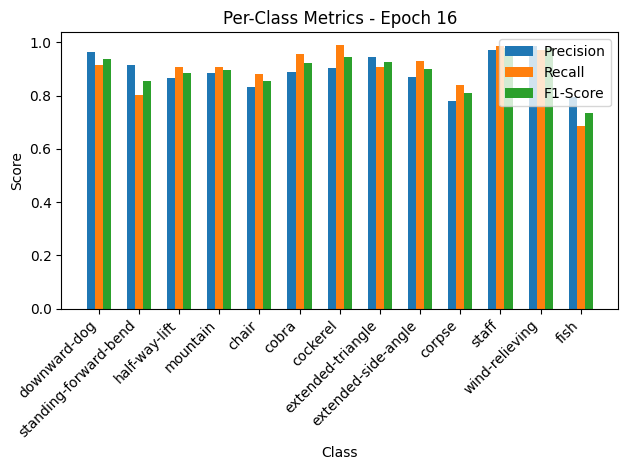

Validation: 100%|██████████| 10/10 [00:00<00:00, 164.17it/s, loss=0.314, accuracy=87.7]


Per-Class Metrics for Epoch 16:
downward-dog: Precision=0.96, Recall=0.91, F1-Score=0.94
standing-forward-bend: Precision=0.92, Recall=0.80, F1-Score=0.86
half-way-lift: Precision=0.87, Recall=0.91, F1-Score=0.89
mountain: Precision=0.89, Recall=0.91, F1-Score=0.90
chair: Precision=0.83, Recall=0.88, F1-Score=0.86
cobra: Precision=0.89, Recall=0.96, F1-Score=0.92
cockerel: Precision=0.90, Recall=0.99, F1-Score=0.94
extended-triangle: Precision=0.95, Recall=0.91, F1-Score=0.93
extended-side-angle: Precision=0.87, Recall=0.93, F1-Score=0.90
corpse: Precision=0.78, Recall=0.84, F1-Score=0.81
staff: Precision=0.97, Recall=0.99, F1-Score=0.98
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.79, Recall=0.69, F1-Score=0.74


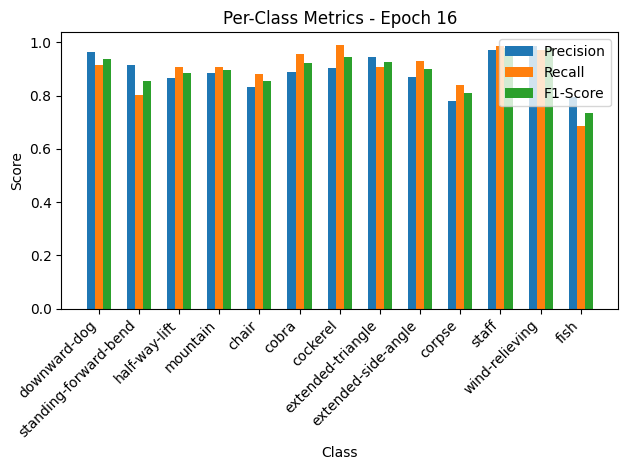


Epoch 17/50 Summary:
Train Loss: 0.3687 | Train Acc: 89.60% | Train Precision: 0.89 | Train Recall: 0.90 | Train F1: 0.89
Val Loss: 0.3436 | Val Acc: 87.67% | Val Precision: 0.90 | Val Recall: 0.89 | Val F1: 0.88

Epoch 18/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:01<00:00, 41.21it/s, loss=0.38, accuracy=89.1]


Per-Class Metrics for Epoch 17:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=0.97, Recall=0.79, F1-Score=0.87
half-way-lift: Precision=0.83, Recall=0.95, F1-Score=0.89
mountain: Precision=0.89, Recall=0.93, F1-Score=0.91
chair: Precision=0.87, Recall=0.86, F1-Score=0.87
cobra: Precision=0.88, Recall=0.90, F1-Score=0.89
cockerel: Precision=0.88, Recall=0.94, F1-Score=0.91
extended-triangle: Precision=0.92, Recall=0.91, F1-Score=0.92
extended-side-angle: Precision=0.89, Recall=0.90, F1-Score=0.90
corpse: Precision=0.79, Recall=0.79, F1-Score=0.79
staff: Precision=0.90, Recall=0.96, F1-Score=0.93
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.80, Recall=0.76, F1-Score=0.78


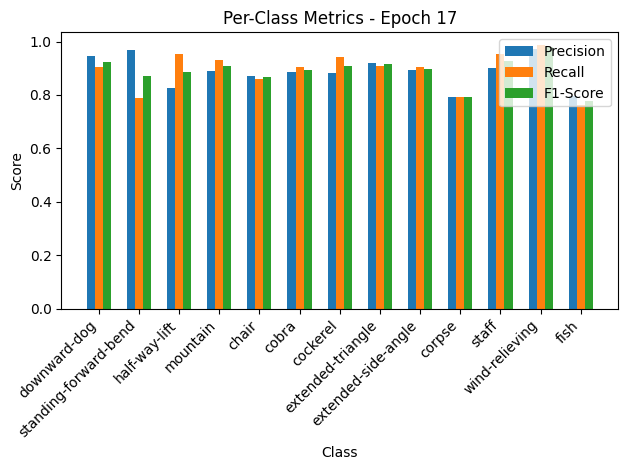

Validation: 100%|██████████| 10/10 [00:00<00:00, 158.14it/s, loss=0.299, accuracy=89]


Per-Class Metrics for Epoch 17:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=0.97, Recall=0.79, F1-Score=0.87
half-way-lift: Precision=0.83, Recall=0.95, F1-Score=0.89
mountain: Precision=0.89, Recall=0.93, F1-Score=0.91
chair: Precision=0.87, Recall=0.86, F1-Score=0.87
cobra: Precision=0.88, Recall=0.90, F1-Score=0.89
cockerel: Precision=0.88, Recall=0.94, F1-Score=0.91
extended-triangle: Precision=0.92, Recall=0.91, F1-Score=0.92
extended-side-angle: Precision=0.89, Recall=0.90, F1-Score=0.90
corpse: Precision=0.79, Recall=0.79, F1-Score=0.79
staff: Precision=0.90, Recall=0.96, F1-Score=0.93
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.80, Recall=0.76, F1-Score=0.78


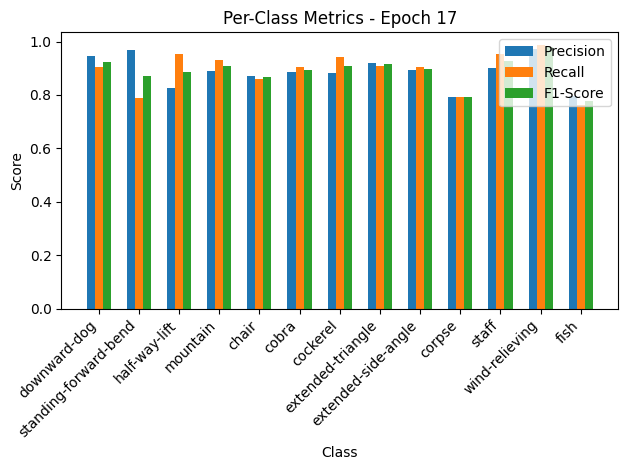


Epoch 18/50 Summary:
Train Loss: 0.3807 | Train Acc: 89.14% | Train Precision: 0.89 | Train Recall: 0.89 | Train F1: 0.89
Val Loss: 0.3278 | Val Acc: 89.04% | Val Precision: 0.90 | Val Recall: 0.90 | Val F1: 0.89

Epoch 19/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 33.33it/s, loss=0.334, accuracy=90.6]


Per-Class Metrics for Epoch 18:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=0.90, Recall=0.83, F1-Score=0.86
half-way-lift: Precision=0.87, Recall=0.91, F1-Score=0.89
mountain: Precision=0.90, Recall=0.95, F1-Score=0.93
chair: Precision=0.92, Recall=0.91, F1-Score=0.92
cobra: Precision=0.90, Recall=0.97, F1-Score=0.93
cockerel: Precision=0.90, Recall=0.98, F1-Score=0.94
extended-triangle: Precision=0.93, Recall=0.86, F1-Score=0.89
extended-side-angle: Precision=0.87, Recall=0.95, F1-Score=0.91
corpse: Precision=0.83, Recall=0.87, F1-Score=0.85
staff: Precision=0.98, Recall=0.93, F1-Score=0.95
wind-relieving: Precision=0.97, Recall=0.93, F1-Score=0.95
fish: Precision=0.84, Recall=0.85, F1-Score=0.84


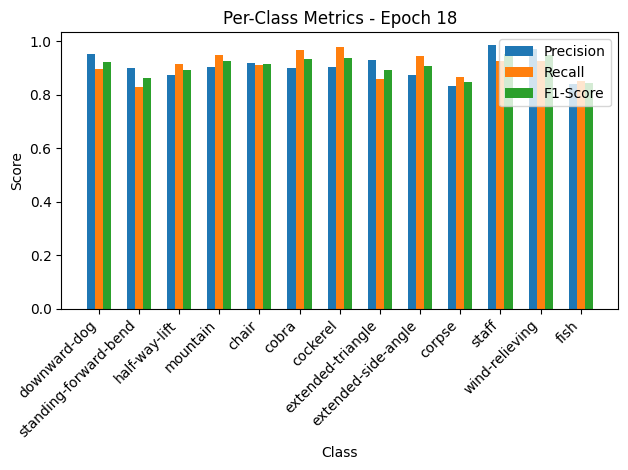

Validation: 100%|██████████| 10/10 [00:00<00:00, 146.79it/s, loss=0.381, accuracy=87]


Per-Class Metrics for Epoch 18:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=0.90, Recall=0.83, F1-Score=0.86
half-way-lift: Precision=0.87, Recall=0.91, F1-Score=0.89
mountain: Precision=0.90, Recall=0.95, F1-Score=0.93
chair: Precision=0.92, Recall=0.91, F1-Score=0.92
cobra: Precision=0.90, Recall=0.97, F1-Score=0.93
cockerel: Precision=0.90, Recall=0.98, F1-Score=0.94
extended-triangle: Precision=0.93, Recall=0.86, F1-Score=0.89
extended-side-angle: Precision=0.87, Recall=0.95, F1-Score=0.91
corpse: Precision=0.83, Recall=0.87, F1-Score=0.85
staff: Precision=0.98, Recall=0.93, F1-Score=0.95
wind-relieving: Precision=0.97, Recall=0.93, F1-Score=0.95
fish: Precision=0.84, Recall=0.85, F1-Score=0.84


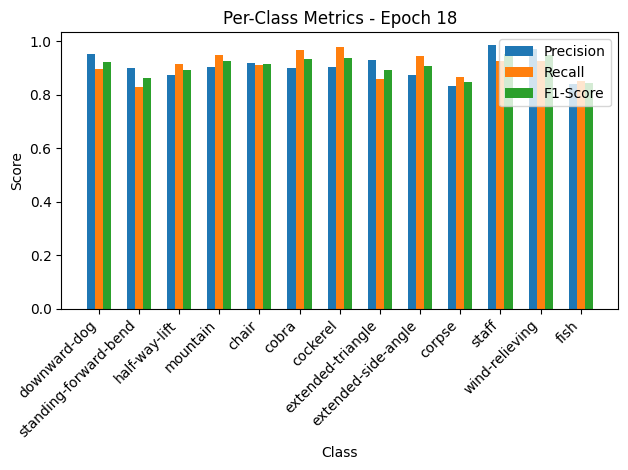


Epoch 19/50 Summary:
Train Loss: 0.3345 | Train Acc: 90.60% | Train Precision: 0.91 | Train Recall: 0.91 | Train F1: 0.91
Val Loss: 0.4176 | Val Acc: 86.99% | Val Precision: 0.90 | Val Recall: 0.87 | Val F1: 0.86

Epoch 20/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 40.48it/s, loss=0.383, accuracy=89.2]


Per-Class Metrics for Epoch 19:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=0.92, Recall=0.83, F1-Score=0.88
half-way-lift: Precision=0.87, Recall=0.93, F1-Score=0.90
mountain: Precision=0.89, Recall=0.97, F1-Score=0.93
chair: Precision=0.92, Recall=0.87, F1-Score=0.89
cobra: Precision=0.91, Recall=0.94, F1-Score=0.92
cockerel: Precision=0.90, Recall=0.92, F1-Score=0.91
extended-triangle: Precision=0.92, Recall=0.95, F1-Score=0.94
extended-side-angle: Precision=0.92, Recall=0.90, F1-Score=0.91
corpse: Precision=0.73, Recall=0.66, F1-Score=0.69
staff: Precision=0.91, Recall=0.96, F1-Score=0.93
wind-relieving: Precision=0.97, Recall=0.93, F1-Score=0.95
fish: Precision=0.70, Recall=0.78, F1-Score=0.74


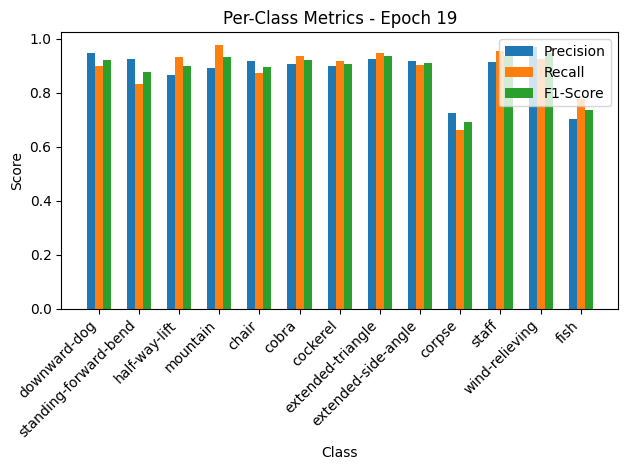

Validation: 100%|██████████| 10/10 [00:00<00:00, 179.31it/s, loss=0.302, accuracy=91.8]


Per-Class Metrics for Epoch 19:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=0.92, Recall=0.83, F1-Score=0.88
half-way-lift: Precision=0.87, Recall=0.93, F1-Score=0.90
mountain: Precision=0.89, Recall=0.97, F1-Score=0.93
chair: Precision=0.92, Recall=0.87, F1-Score=0.89
cobra: Precision=0.91, Recall=0.94, F1-Score=0.92
cockerel: Precision=0.90, Recall=0.92, F1-Score=0.91
extended-triangle: Precision=0.92, Recall=0.95, F1-Score=0.94
extended-side-angle: Precision=0.92, Recall=0.90, F1-Score=0.91
corpse: Precision=0.73, Recall=0.66, F1-Score=0.69
staff: Precision=0.91, Recall=0.96, F1-Score=0.93
wind-relieving: Precision=0.97, Recall=0.93, F1-Score=0.95
fish: Precision=0.70, Recall=0.78, F1-Score=0.74


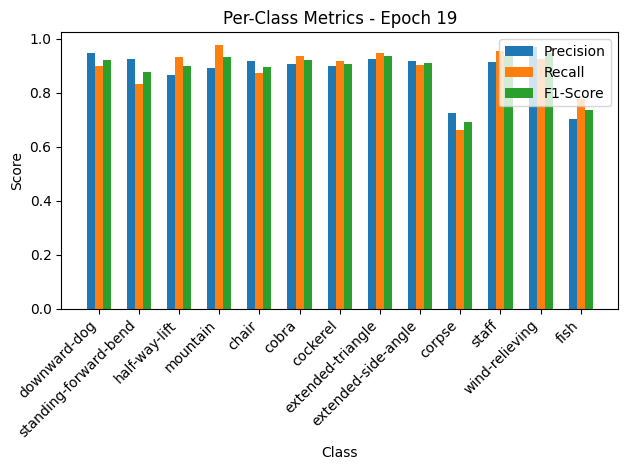


Epoch 20/50 Summary:
Train Loss: 0.3843 | Train Acc: 89.22% | Train Precision: 0.88 | Train Recall: 0.89 | Train F1: 0.89
Val Loss: 0.3311 | Val Acc: 91.78% | Val Precision: 0.93 | Val Recall: 0.93 | Val F1: 0.93

Epoch 21/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:01<00:00, 42.05it/s, loss=0.4, accuracy=88.1]


Per-Class Metrics for Epoch 20:
downward-dog: Precision=0.96, Recall=0.88, F1-Score=0.92
standing-forward-bend: Precision=0.92, Recall=0.84, F1-Score=0.88
half-way-lift: Precision=0.84, Recall=0.94, F1-Score=0.89
mountain: Precision=0.87, Recall=0.92, F1-Score=0.89
chair: Precision=0.83, Recall=0.85, F1-Score=0.84
cobra: Precision=0.89, Recall=0.89, F1-Score=0.89
cockerel: Precision=0.93, Recall=0.95, F1-Score=0.94
extended-triangle: Precision=0.86, Recall=0.91, F1-Score=0.89
extended-side-angle: Precision=0.92, Recall=0.84, F1-Score=0.88
corpse: Precision=0.76, Recall=0.76, F1-Score=0.76
staff: Precision=0.84, Recall=0.91, F1-Score=0.87
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.77, Recall=0.76, F1-Score=0.77


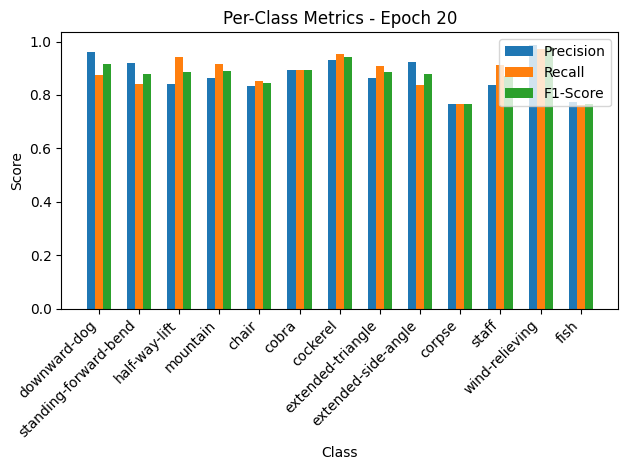

Validation: 100%|██████████| 10/10 [00:00<00:00, 167.20it/s, loss=0.337, accuracy=89.7]


Per-Class Metrics for Epoch 20:
downward-dog: Precision=0.96, Recall=0.88, F1-Score=0.92
standing-forward-bend: Precision=0.92, Recall=0.84, F1-Score=0.88
half-way-lift: Precision=0.84, Recall=0.94, F1-Score=0.89
mountain: Precision=0.87, Recall=0.92, F1-Score=0.89
chair: Precision=0.83, Recall=0.85, F1-Score=0.84
cobra: Precision=0.89, Recall=0.89, F1-Score=0.89
cockerel: Precision=0.93, Recall=0.95, F1-Score=0.94
extended-triangle: Precision=0.86, Recall=0.91, F1-Score=0.89
extended-side-angle: Precision=0.92, Recall=0.84, F1-Score=0.88
corpse: Precision=0.76, Recall=0.76, F1-Score=0.76
staff: Precision=0.84, Recall=0.91, F1-Score=0.87
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.77, Recall=0.76, F1-Score=0.77


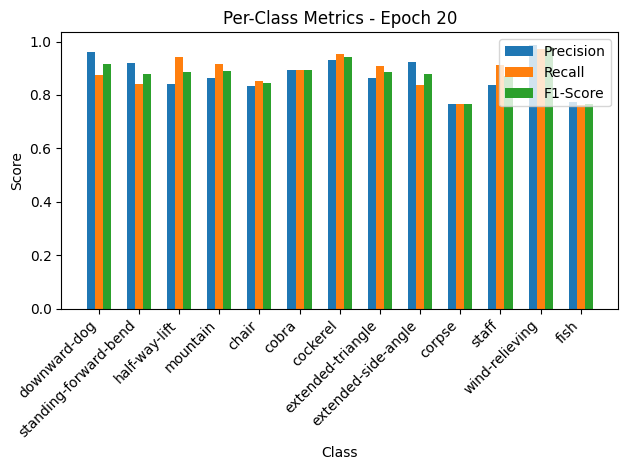


Epoch 21/50 Summary:
Train Loss: 0.4013 | Train Acc: 88.15% | Train Precision: 0.88 | Train Recall: 0.88 | Train F1: 0.88
Val Loss: 0.3694 | Val Acc: 89.73% | Val Precision: 0.92 | Val Recall: 0.92 | Val F1: 0.91

Epoch 22/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:01<00:00, 41.00it/s, loss=0.366, accuracy=89.9]


Per-Class Metrics for Epoch 21:
downward-dog: Precision=0.95, Recall=0.93, F1-Score=0.94
standing-forward-bend: Precision=0.94, Recall=0.83, F1-Score=0.88
half-way-lift: Precision=0.89, Recall=0.92, F1-Score=0.90
mountain: Precision=0.86, Recall=0.96, F1-Score=0.90
chair: Precision=0.88, Recall=0.83, F1-Score=0.85
cobra: Precision=0.91, Recall=0.98, F1-Score=0.94
cockerel: Precision=0.87, Recall=0.94, F1-Score=0.91
extended-triangle: Precision=0.92, Recall=0.84, F1-Score=0.88
extended-side-angle: Precision=0.84, Recall=0.90, F1-Score=0.87
corpse: Precision=0.85, Recall=0.82, F1-Score=0.84
staff: Precision=0.97, Recall=0.94, F1-Score=0.95
wind-relieving: Precision=0.97, Recall=0.93, F1-Score=0.95
fish: Precision=0.81, Recall=0.84, F1-Score=0.82


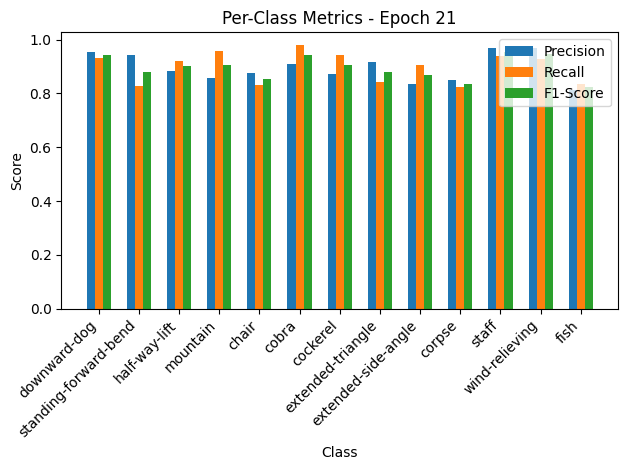

Validation: 100%|██████████| 10/10 [00:00<00:00, 142.89it/s, loss=0.379, accuracy=84.2]


Per-Class Metrics for Epoch 21:
downward-dog: Precision=0.95, Recall=0.93, F1-Score=0.94
standing-forward-bend: Precision=0.94, Recall=0.83, F1-Score=0.88
half-way-lift: Precision=0.89, Recall=0.92, F1-Score=0.90
mountain: Precision=0.86, Recall=0.96, F1-Score=0.90
chair: Precision=0.88, Recall=0.83, F1-Score=0.85
cobra: Precision=0.91, Recall=0.98, F1-Score=0.94
cockerel: Precision=0.87, Recall=0.94, F1-Score=0.91
extended-triangle: Precision=0.92, Recall=0.84, F1-Score=0.88
extended-side-angle: Precision=0.84, Recall=0.90, F1-Score=0.87
corpse: Precision=0.85, Recall=0.82, F1-Score=0.84
staff: Precision=0.97, Recall=0.94, F1-Score=0.95
wind-relieving: Precision=0.97, Recall=0.93, F1-Score=0.95
fish: Precision=0.81, Recall=0.84, F1-Score=0.82


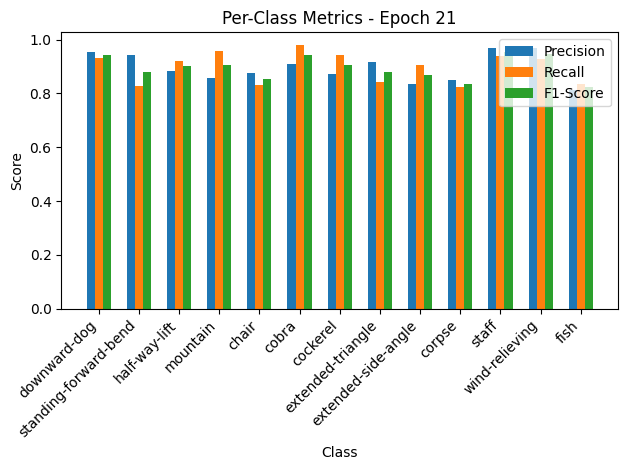


Epoch 22/50 Summary:
Train Loss: 0.3667 | Train Acc: 89.91% | Train Precision: 0.90 | Train Recall: 0.90 | Train F1: 0.90
Val Loss: 0.4156 | Val Acc: 84.25% | Val Precision: 0.87 | Val Recall: 0.84 | Val F1: 0.83

Epoch 23/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:01<00:00, 41.13it/s, loss=0.267, accuracy=92.6]


Per-Class Metrics for Epoch 22:
downward-dog: Precision=0.97, Recall=0.93, F1-Score=0.95
standing-forward-bend: Precision=0.95, Recall=0.87, F1-Score=0.91
half-way-lift: Precision=0.90, Recall=0.95, F1-Score=0.92
mountain: Precision=0.90, Recall=0.97, F1-Score=0.94
chair: Precision=0.94, Recall=0.89, F1-Score=0.91
cobra: Precision=0.89, Recall=0.99, F1-Score=0.94
cockerel: Precision=0.95, Recall=0.95, F1-Score=0.95
extended-triangle: Precision=0.99, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.93, Recall=0.97, F1-Score=0.95
corpse: Precision=0.80, Recall=0.84, F1-Score=0.82
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.96, Recall=0.96, F1-Score=0.96
fish: Precision=0.82, Recall=0.75, F1-Score=0.78


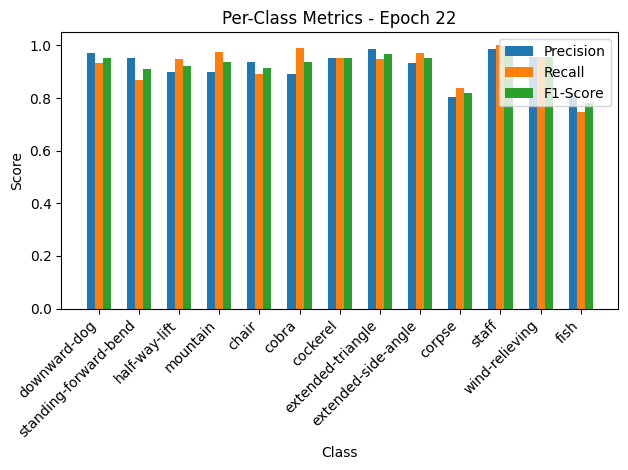

Validation: 100%|██████████| 10/10 [00:00<00:00, 179.87it/s, loss=0.235, accuracy=91.8]


Per-Class Metrics for Epoch 22:
downward-dog: Precision=0.97, Recall=0.93, F1-Score=0.95
standing-forward-bend: Precision=0.95, Recall=0.87, F1-Score=0.91
half-way-lift: Precision=0.90, Recall=0.95, F1-Score=0.92
mountain: Precision=0.90, Recall=0.97, F1-Score=0.94
chair: Precision=0.94, Recall=0.89, F1-Score=0.91
cobra: Precision=0.89, Recall=0.99, F1-Score=0.94
cockerel: Precision=0.95, Recall=0.95, F1-Score=0.95
extended-triangle: Precision=0.99, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.93, Recall=0.97, F1-Score=0.95
corpse: Precision=0.80, Recall=0.84, F1-Score=0.82
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.96, Recall=0.96, F1-Score=0.96
fish: Precision=0.82, Recall=0.75, F1-Score=0.78


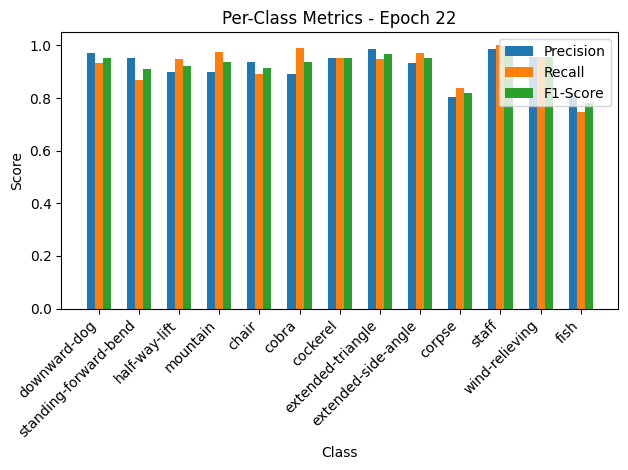


Epoch 23/50 Summary:
Train Loss: 0.2677 | Train Acc: 92.58% | Train Precision: 0.92 | Train Recall: 0.92 | Train F1: 0.92
Val Loss: 0.2576 | Val Acc: 91.78% | Val Precision: 0.94 | Val Recall: 0.93 | Val F1: 0.93
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_2.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_2.pth
Checkpoint saved at epoch 23
New best model saved! Validation Loss: 0.2576

Epoch 24/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:02<00:00, 37.91it/s, loss=0.236, accuracy=93]


Per-Class Metrics for Epoch 23:
downward-dog: Precision=0.99, Recall=0.94, F1-Score=0.96
standing-forward-bend: Precision=0.93, Recall=0.86, F1-Score=0.90
half-way-lift: Precision=0.88, Recall=0.94, F1-Score=0.91
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.88, Recall=0.89, F1-Score=0.89
cobra: Precision=0.93, Recall=0.97, F1-Score=0.95
cockerel: Precision=0.98, Recall=0.95, F1-Score=0.96
extended-triangle: Precision=0.96, Recall=0.95, F1-Score=0.95
extended-side-angle: Precision=0.92, Recall=0.96, F1-Score=0.94
corpse: Precision=0.95, Recall=0.78, F1-Score=0.85
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.79, Recall=0.93, F1-Score=0.86


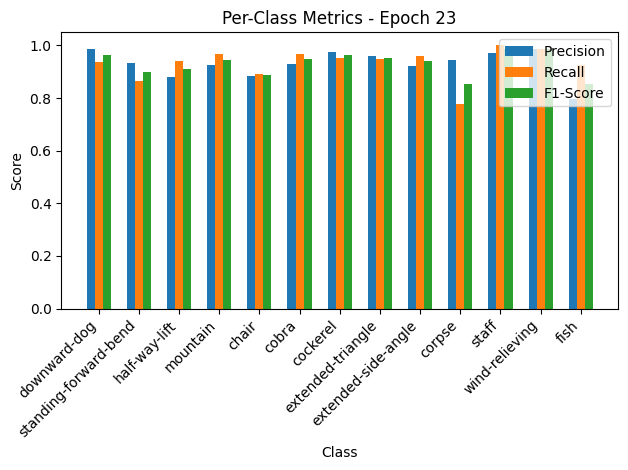

Validation: 100%|██████████| 10/10 [00:00<00:00, 161.22it/s, loss=0.239, accuracy=91.8]


Per-Class Metrics for Epoch 23:
downward-dog: Precision=0.99, Recall=0.94, F1-Score=0.96
standing-forward-bend: Precision=0.93, Recall=0.86, F1-Score=0.90
half-way-lift: Precision=0.88, Recall=0.94, F1-Score=0.91
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.88, Recall=0.89, F1-Score=0.89
cobra: Precision=0.93, Recall=0.97, F1-Score=0.95
cockerel: Precision=0.98, Recall=0.95, F1-Score=0.96
extended-triangle: Precision=0.96, Recall=0.95, F1-Score=0.95
extended-side-angle: Precision=0.92, Recall=0.96, F1-Score=0.94
corpse: Precision=0.95, Recall=0.78, F1-Score=0.85
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.79, Recall=0.93, F1-Score=0.86


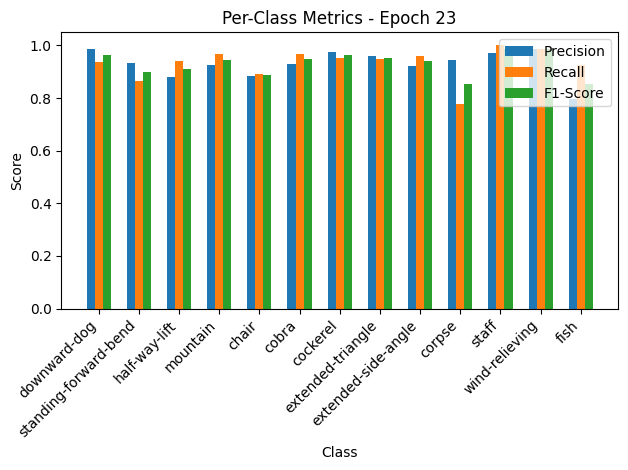


Epoch 24/50 Summary:
Train Loss: 0.2366 | Train Acc: 92.97% | Train Precision: 0.93 | Train Recall: 0.93 | Train F1: 0.93
Val Loss: 0.2619 | Val Acc: 91.78% | Val Precision: 0.94 | Val Recall: 0.93 | Val F1: 0.93

Epoch 25/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:01<00:00, 41.40it/s, loss=0.226, accuracy=93.9]


Per-Class Metrics for Epoch 24:
downward-dog: Precision=0.99, Recall=0.93, F1-Score=0.96
standing-forward-bend: Precision=0.93, Recall=0.88, F1-Score=0.91
half-way-lift: Precision=0.90, Recall=0.95, F1-Score=0.92
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.91, Recall=0.92, F1-Score=0.92
cobra: Precision=0.93, Recall=0.98, F1-Score=0.95
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.94, F1-Score=0.95
extended-side-angle: Precision=0.92, Recall=0.97, F1-Score=0.95
corpse: Precision=0.92, Recall=0.85, F1-Score=0.89
staff: Precision=0.98, Recall=0.97, F1-Score=0.98
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.87, Recall=0.90, F1-Score=0.88


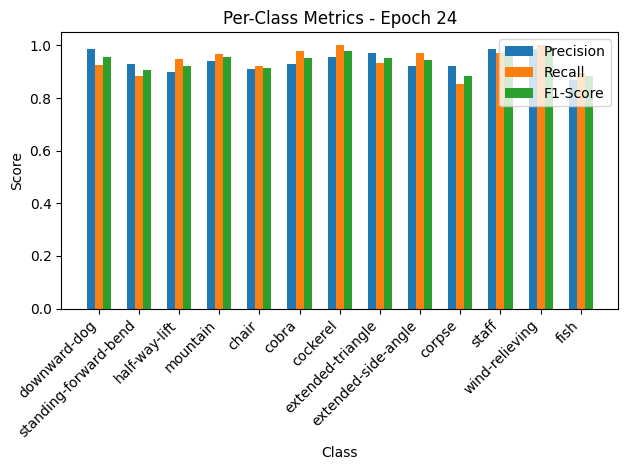

Validation: 100%|██████████| 10/10 [00:00<00:00, 155.30it/s, loss=0.246, accuracy=90.4]


Per-Class Metrics for Epoch 24:
downward-dog: Precision=0.99, Recall=0.93, F1-Score=0.96
standing-forward-bend: Precision=0.93, Recall=0.88, F1-Score=0.91
half-way-lift: Precision=0.90, Recall=0.95, F1-Score=0.92
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.91, Recall=0.92, F1-Score=0.92
cobra: Precision=0.93, Recall=0.98, F1-Score=0.95
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.94, F1-Score=0.95
extended-side-angle: Precision=0.92, Recall=0.97, F1-Score=0.95
corpse: Precision=0.92, Recall=0.85, F1-Score=0.89
staff: Precision=0.98, Recall=0.97, F1-Score=0.98
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.87, Recall=0.90, F1-Score=0.88


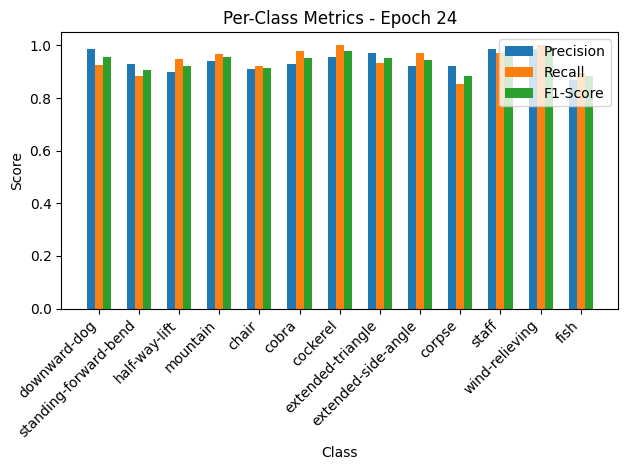


Epoch 25/50 Summary:
Train Loss: 0.2272 | Train Acc: 93.88% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.2698 | Val Acc: 90.41% | Val Precision: 0.92 | Val Recall: 0.91 | Val F1: 0.91

Epoch 26/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:01<00:00, 43.22it/s, loss=0.2, accuracy=94.5]


Per-Class Metrics for Epoch 25:
downward-dog: Precision=0.97, Recall=0.94, F1-Score=0.95
standing-forward-bend: Precision=0.95, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.92, Recall=0.95, F1-Score=0.93
mountain: Precision=0.94, Recall=0.98, F1-Score=0.96
chair: Precision=0.96, Recall=0.93, F1-Score=0.94
cobra: Precision=0.92, Recall=0.98, F1-Score=0.95
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.96, Recall=0.95, F1-Score=0.95
extended-side-angle: Precision=0.95, Recall=0.95, F1-Score=0.95
corpse: Precision=0.95, Recall=0.81, F1-Score=0.87
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=1.00, F1-Score=0.99
fish: Precision=0.82, Recall=0.94, F1-Score=0.88


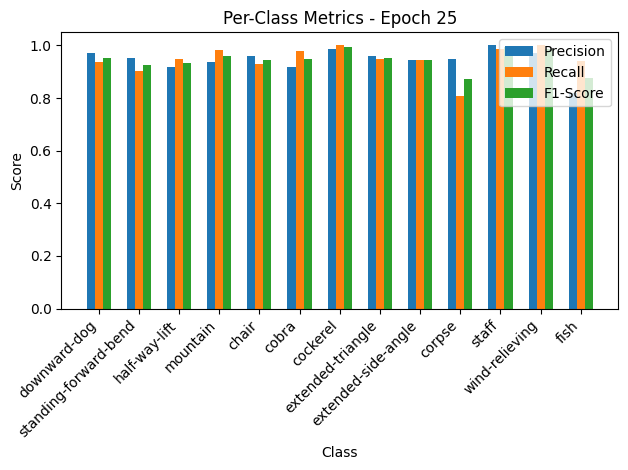

Validation: 100%|██████████| 10/10 [00:00<00:00, 178.35it/s, loss=0.239, accuracy=91.1]


Per-Class Metrics for Epoch 25:
downward-dog: Precision=0.97, Recall=0.94, F1-Score=0.95
standing-forward-bend: Precision=0.95, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.92, Recall=0.95, F1-Score=0.93
mountain: Precision=0.94, Recall=0.98, F1-Score=0.96
chair: Precision=0.96, Recall=0.93, F1-Score=0.94
cobra: Precision=0.92, Recall=0.98, F1-Score=0.95
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.96, Recall=0.95, F1-Score=0.95
extended-side-angle: Precision=0.95, Recall=0.95, F1-Score=0.95
corpse: Precision=0.95, Recall=0.81, F1-Score=0.87
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=1.00, F1-Score=0.99
fish: Precision=0.82, Recall=0.94, F1-Score=0.88


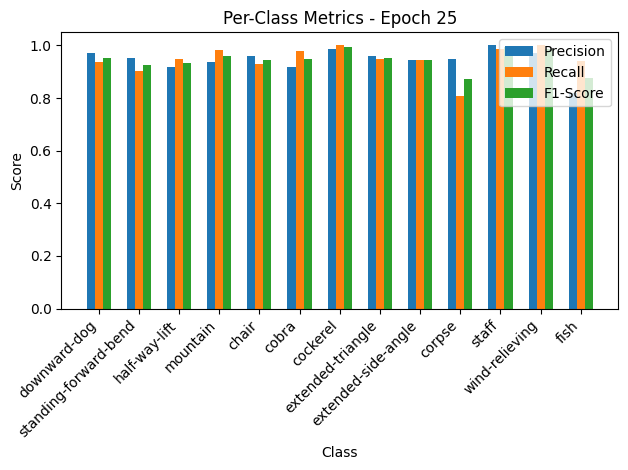


Epoch 26/50 Summary:
Train Loss: 0.2009 | Train Acc: 94.50% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.94
Val Loss: 0.2621 | Val Acc: 91.10% | Val Precision: 0.93 | Val Recall: 0.92 | Val F1: 0.92

Epoch 27/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:02<00:00, 38.71it/s, loss=0.201, accuracy=94.3]


Per-Class Metrics for Epoch 26:
downward-dog: Precision=0.98, Recall=0.93, F1-Score=0.95
standing-forward-bend: Precision=0.94, Recall=0.91, F1-Score=0.93
half-way-lift: Precision=0.91, Recall=0.92, F1-Score=0.91
mountain: Precision=0.96, Recall=0.98, F1-Score=0.97
chair: Precision=0.94, Recall=0.95, F1-Score=0.95
cobra: Precision=0.91, Recall=0.96, F1-Score=0.93
cockerel: Precision=0.98, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.99, F1-Score=0.97
corpse: Precision=0.89, Recall=0.81, F1-Score=0.85
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.85, Recall=0.91, F1-Score=0.88


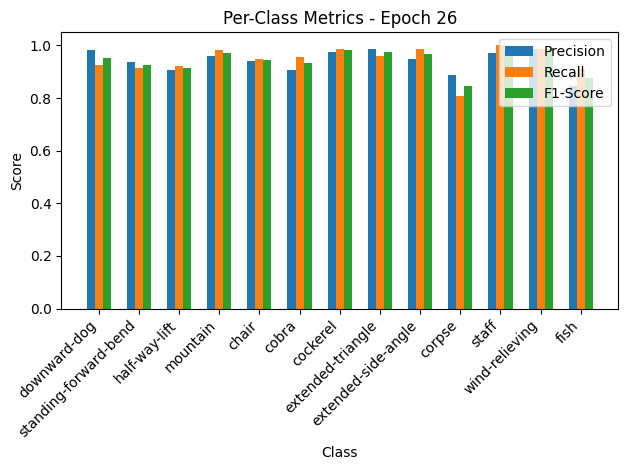

Validation: 100%|██████████| 10/10 [00:00<00:00, 180.60it/s, loss=0.24, accuracy=91.8]


Per-Class Metrics for Epoch 26:
downward-dog: Precision=0.98, Recall=0.93, F1-Score=0.95
standing-forward-bend: Precision=0.94, Recall=0.91, F1-Score=0.93
half-way-lift: Precision=0.91, Recall=0.92, F1-Score=0.91
mountain: Precision=0.96, Recall=0.98, F1-Score=0.97
chair: Precision=0.94, Recall=0.95, F1-Score=0.95
cobra: Precision=0.91, Recall=0.96, F1-Score=0.93
cockerel: Precision=0.98, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.99, F1-Score=0.97
corpse: Precision=0.89, Recall=0.81, F1-Score=0.85
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.85, Recall=0.91, F1-Score=0.88


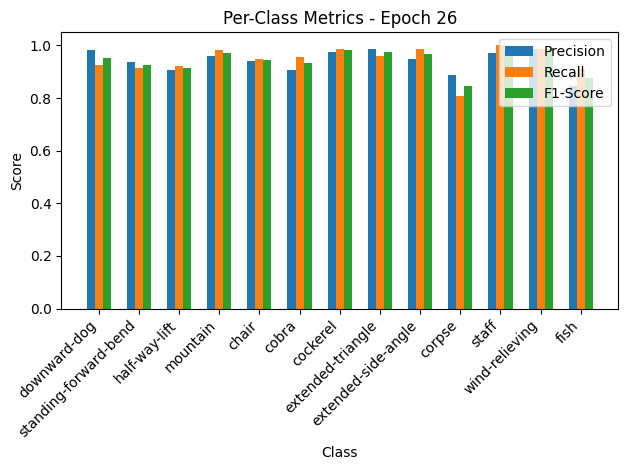


Epoch 27/50 Summary:
Train Loss: 0.2018 | Train Acc: 94.27% | Train Precision: 0.94 | Train Recall: 0.95 | Train F1: 0.94
Val Loss: 0.2633 | Val Acc: 91.78% | Val Precision: 0.94 | Val Recall: 0.93 | Val F1: 0.93

Epoch 28/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:02<00:00, 35.34it/s, loss=0.22, accuracy=93.3]


Per-Class Metrics for Epoch 27:
downward-dog: Precision=0.99, Recall=0.94, F1-Score=0.96
standing-forward-bend: Precision=0.95, Recall=0.90, F1-Score=0.92
half-way-lift: Precision=0.90, Recall=0.92, F1-Score=0.91
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.90, Recall=0.91, F1-Score=0.91
cobra: Precision=0.93, Recall=0.98, F1-Score=0.95
cockerel: Precision=0.95, Recall=0.97, F1-Score=0.96
extended-triangle: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.82, Recall=0.85, F1-Score=0.83
staff: Precision=0.98, Recall=0.97, F1-Score=0.98
wind-relieving: Precision=0.96, Recall=1.00, F1-Score=0.98
fish: Precision=0.84, Recall=0.78, F1-Score=0.81


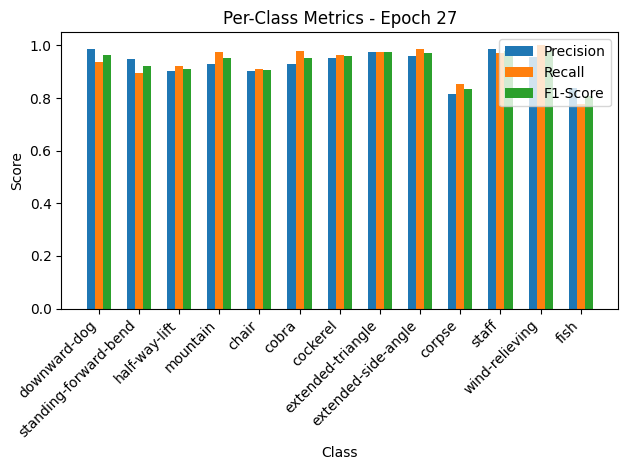

Validation: 100%|██████████| 10/10 [00:00<00:00, 126.73it/s, loss=0.196, accuracy=93.8]


Per-Class Metrics for Epoch 27:
downward-dog: Precision=0.99, Recall=0.94, F1-Score=0.96
standing-forward-bend: Precision=0.95, Recall=0.90, F1-Score=0.92
half-way-lift: Precision=0.90, Recall=0.92, F1-Score=0.91
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.90, Recall=0.91, F1-Score=0.91
cobra: Precision=0.93, Recall=0.98, F1-Score=0.95
cockerel: Precision=0.95, Recall=0.97, F1-Score=0.96
extended-triangle: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.82, Recall=0.85, F1-Score=0.83
staff: Precision=0.98, Recall=0.97, F1-Score=0.98
wind-relieving: Precision=0.96, Recall=1.00, F1-Score=0.98
fish: Precision=0.84, Recall=0.78, F1-Score=0.81


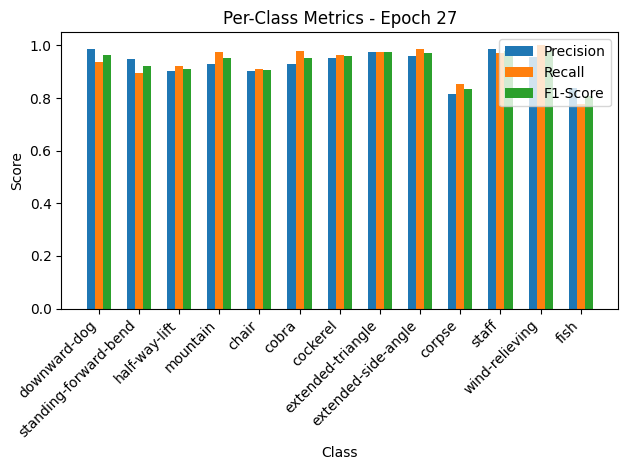


Epoch 28/50 Summary:
Train Loss: 0.2205 | Train Acc: 93.35% | Train Precision: 0.93 | Train Recall: 0.93 | Train F1: 0.93
Val Loss: 0.2148 | Val Acc: 93.84% | Val Precision: 0.94 | Val Recall: 0.94 | Val F1: 0.93
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_2.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_2.pth
Checkpoint saved at epoch 28
New best model saved! Validation Loss: 0.2148

Epoch 29/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:02<00:00, 39.40it/s, loss=0.204, accuracy=93.9]


Per-Class Metrics for Epoch 28:
downward-dog: Precision=0.97, Recall=0.94, F1-Score=0.96
standing-forward-bend: Precision=0.93, Recall=0.92, F1-Score=0.92
half-way-lift: Precision=0.93, Recall=0.92, F1-Score=0.93
mountain: Precision=0.93, Recall=0.95, F1-Score=0.94
chair: Precision=0.93, Recall=0.91, F1-Score=0.92
cobra: Precision=0.92, Recall=0.96, F1-Score=0.94
cockerel: Precision=0.98, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.99, F1-Score=0.97
corpse: Precision=0.92, Recall=0.81, F1-Score=0.86
staff: Precision=0.96, Recall=0.99, F1-Score=0.97
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.81, Recall=0.91, F1-Score=0.86


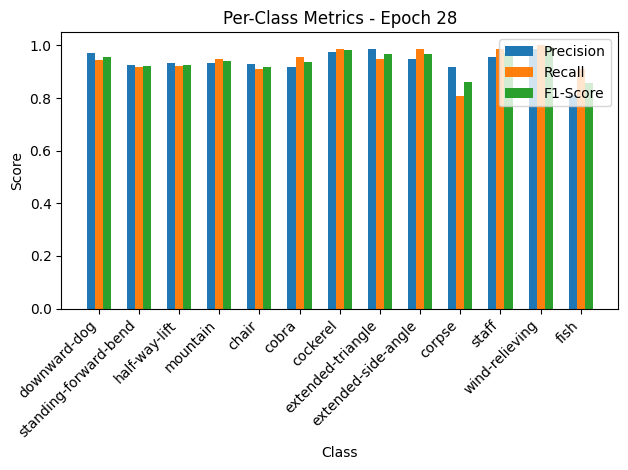

Validation: 100%|██████████| 10/10 [00:00<00:00, 157.26it/s, loss=0.2, accuracy=93.8]


Per-Class Metrics for Epoch 28:
downward-dog: Precision=0.97, Recall=0.94, F1-Score=0.96
standing-forward-bend: Precision=0.93, Recall=0.92, F1-Score=0.92
half-way-lift: Precision=0.93, Recall=0.92, F1-Score=0.93
mountain: Precision=0.93, Recall=0.95, F1-Score=0.94
chair: Precision=0.93, Recall=0.91, F1-Score=0.92
cobra: Precision=0.92, Recall=0.96, F1-Score=0.94
cockerel: Precision=0.98, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.99, F1-Score=0.97
corpse: Precision=0.92, Recall=0.81, F1-Score=0.86
staff: Precision=0.96, Recall=0.99, F1-Score=0.97
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.81, Recall=0.91, F1-Score=0.86


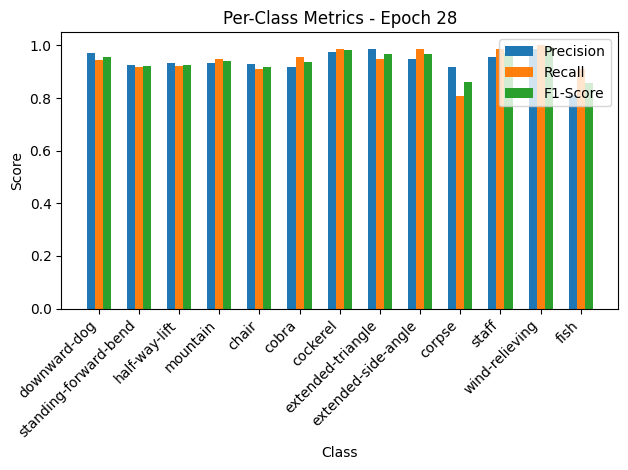


Epoch 29/50 Summary:
Train Loss: 0.2042 | Train Acc: 93.88% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.2193 | Val Acc: 93.84% | Val Precision: 0.94 | Val Recall: 0.94 | Val F1: 0.93

Epoch 30/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:01<00:00, 43.03it/s, loss=0.211, accuracy=94.3]


Per-Class Metrics for Epoch 29:
downward-dog: Precision=0.99, Recall=0.94, F1-Score=0.97
standing-forward-bend: Precision=0.94, Recall=0.91, F1-Score=0.92
half-way-lift: Precision=0.92, Recall=0.94, F1-Score=0.93
mountain: Precision=0.94, Recall=0.97, F1-Score=0.96
chair: Precision=0.96, Recall=0.93, F1-Score=0.94
cobra: Precision=0.93, Recall=0.98, F1-Score=0.95
cockerel: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.95, F1-Score=0.96
extended-side-angle: Precision=0.95, Recall=0.99, F1-Score=0.97
corpse: Precision=0.84, Recall=0.85, F1-Score=0.85
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.86, Recall=0.85, F1-Score=0.86


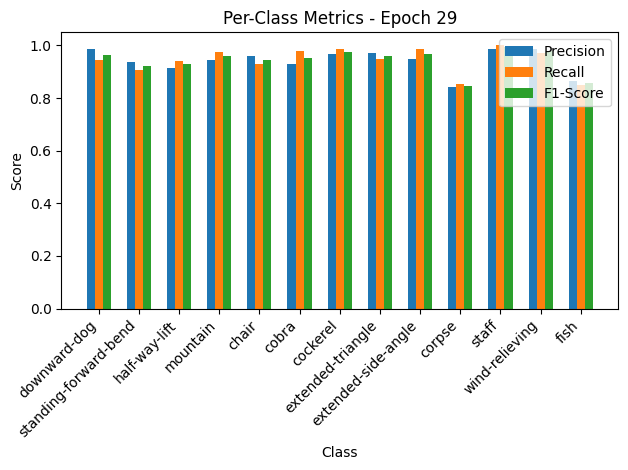

Validation: 100%|██████████| 10/10 [00:00<00:00, 183.23it/s, loss=0.233, accuracy=91.1]


Per-Class Metrics for Epoch 29:
downward-dog: Precision=0.99, Recall=0.94, F1-Score=0.97
standing-forward-bend: Precision=0.94, Recall=0.91, F1-Score=0.92
half-way-lift: Precision=0.92, Recall=0.94, F1-Score=0.93
mountain: Precision=0.94, Recall=0.97, F1-Score=0.96
chair: Precision=0.96, Recall=0.93, F1-Score=0.94
cobra: Precision=0.93, Recall=0.98, F1-Score=0.95
cockerel: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.95, F1-Score=0.96
extended-side-angle: Precision=0.95, Recall=0.99, F1-Score=0.97
corpse: Precision=0.84, Recall=0.85, F1-Score=0.85
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.86, Recall=0.85, F1-Score=0.86


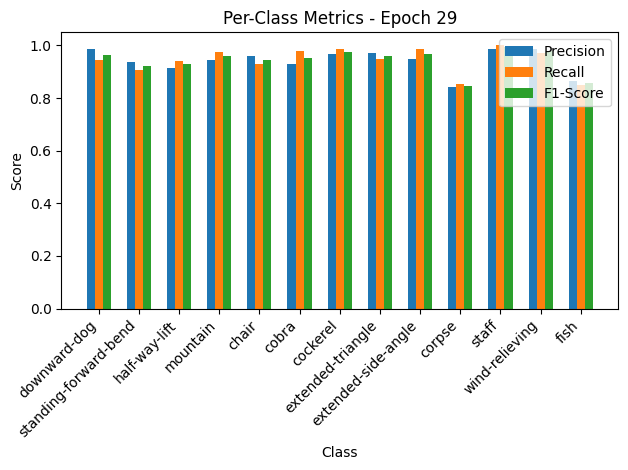


Epoch 30/50 Summary:
Train Loss: 0.2113 | Train Acc: 94.34% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.2558 | Val Acc: 91.10% | Val Precision: 0.93 | Val Recall: 0.91 | Val F1: 0.91

Epoch 31/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:02<00:00, 37.62it/s, loss=0.224, accuracy=93.7]


Per-Class Metrics for Epoch 30:
downward-dog: Precision=0.96, Recall=0.93, F1-Score=0.95
standing-forward-bend: Precision=0.94, Recall=0.89, F1-Score=0.91
half-way-lift: Precision=0.91, Recall=0.93, F1-Score=0.92
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.94, Recall=0.92, F1-Score=0.93
cobra: Precision=0.94, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.96, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.94, Recall=0.95, F1-Score=0.94
extended-side-angle: Precision=0.96, Recall=0.90, F1-Score=0.93
corpse: Precision=0.91, Recall=0.85, F1-Score=0.88
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.97, Recall=1.00, F1-Score=0.99
fish: Precision=0.86, Recall=0.91, F1-Score=0.88


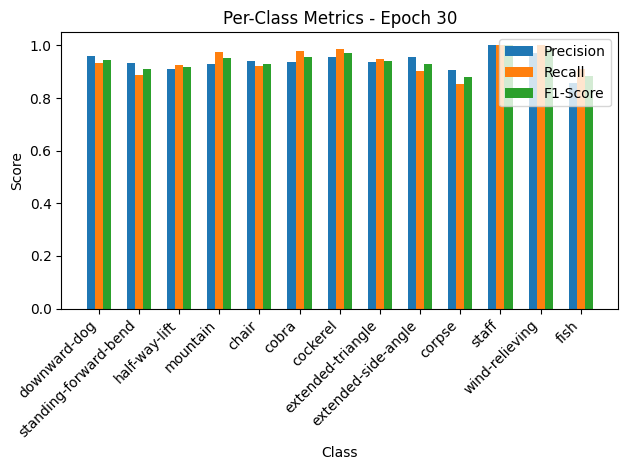

Validation: 100%|██████████| 10/10 [00:00<00:00, 157.35it/s, loss=0.192, accuracy=94.5]


Per-Class Metrics for Epoch 30:
downward-dog: Precision=0.96, Recall=0.93, F1-Score=0.95
standing-forward-bend: Precision=0.94, Recall=0.89, F1-Score=0.91
half-way-lift: Precision=0.91, Recall=0.93, F1-Score=0.92
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.94, Recall=0.92, F1-Score=0.93
cobra: Precision=0.94, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.96, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.94, Recall=0.95, F1-Score=0.94
extended-side-angle: Precision=0.96, Recall=0.90, F1-Score=0.93
corpse: Precision=0.91, Recall=0.85, F1-Score=0.88
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.97, Recall=1.00, F1-Score=0.99
fish: Precision=0.86, Recall=0.91, F1-Score=0.88


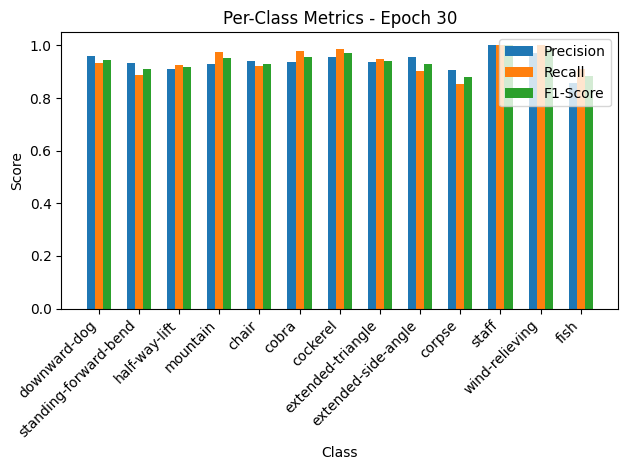


Epoch 31/50 Summary:
Train Loss: 0.2251 | Train Acc: 93.73% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.2102 | Val Acc: 94.52% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.94
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_2.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_2.pth
Checkpoint saved at epoch 31
New best model saved! Validation Loss: 0.2102

Epoch 32/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:02<00:00, 35.18it/s, loss=0.184, accuracy=95]


Per-Class Metrics for Epoch 31:
downward-dog: Precision=0.98, Recall=0.94, F1-Score=0.96
standing-forward-bend: Precision=0.97, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.93, Recall=0.97, F1-Score=0.95
mountain: Precision=0.94, Recall=0.96, F1-Score=0.95
chair: Precision=0.92, Recall=0.94, F1-Score=0.93
cobra: Precision=0.93, Recall=0.97, F1-Score=0.95
cockerel: Precision=0.98, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.97, F1-Score=0.96
corpse: Precision=0.88, Recall=0.90, F1-Score=0.89
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.89, Recall=0.87, F1-Score=0.88


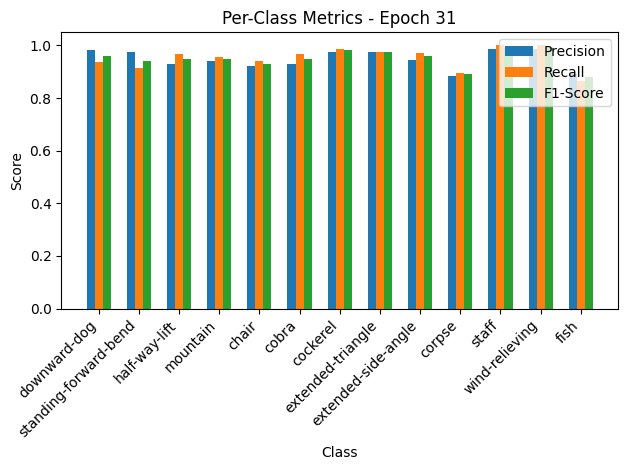

Validation: 100%|██████████| 10/10 [00:00<00:00, 174.54it/s, loss=0.214, accuracy=93.2]


Per-Class Metrics for Epoch 31:
downward-dog: Precision=0.98, Recall=0.94, F1-Score=0.96
standing-forward-bend: Precision=0.97, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.93, Recall=0.97, F1-Score=0.95
mountain: Precision=0.94, Recall=0.96, F1-Score=0.95
chair: Precision=0.92, Recall=0.94, F1-Score=0.93
cobra: Precision=0.93, Recall=0.97, F1-Score=0.95
cockerel: Precision=0.98, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.97, F1-Score=0.96
corpse: Precision=0.88, Recall=0.90, F1-Score=0.89
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.89, Recall=0.87, F1-Score=0.88


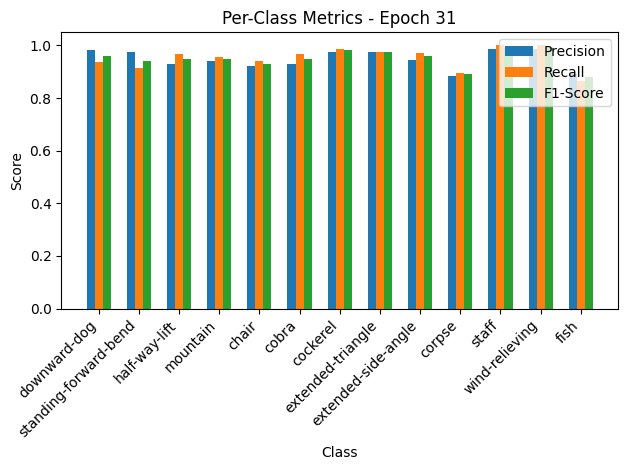


Epoch 32/50 Summary:
Train Loss: 0.1845 | Train Acc: 95.03% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.2347 | Val Acc: 93.15% | Val Precision: 0.94 | Val Recall: 0.94 | Val F1: 0.94

Epoch 33/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:02<00:00, 38.00it/s, loss=0.202, accuracy=94]


Per-Class Metrics for Epoch 32:
downward-dog: Precision=0.99, Recall=0.93, F1-Score=0.96
standing-forward-bend: Precision=0.92, Recall=0.93, F1-Score=0.92
half-way-lift: Precision=0.92, Recall=0.92, F1-Score=0.92
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.95, Recall=0.91, F1-Score=0.93
cobra: Precision=0.91, Recall=0.99, F1-Score=0.95
cockerel: Precision=0.98, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.95, F1-Score=0.96
extended-side-angle: Precision=0.93, Recall=0.96, F1-Score=0.95
corpse: Precision=0.90, Recall=0.79, F1-Score=0.84
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.81, Recall=0.90, F1-Score=0.85


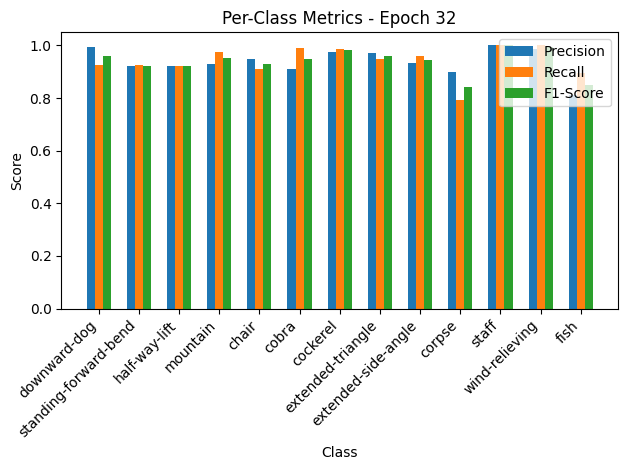

Validation: 100%|██████████| 10/10 [00:00<00:00, 134.54it/s, loss=0.224, accuracy=93.2]


Per-Class Metrics for Epoch 32:
downward-dog: Precision=0.99, Recall=0.93, F1-Score=0.96
standing-forward-bend: Precision=0.92, Recall=0.93, F1-Score=0.92
half-way-lift: Precision=0.92, Recall=0.92, F1-Score=0.92
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.95, Recall=0.91, F1-Score=0.93
cobra: Precision=0.91, Recall=0.99, F1-Score=0.95
cockerel: Precision=0.98, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.95, F1-Score=0.96
extended-side-angle: Precision=0.93, Recall=0.96, F1-Score=0.95
corpse: Precision=0.90, Recall=0.79, F1-Score=0.84
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.81, Recall=0.90, F1-Score=0.85


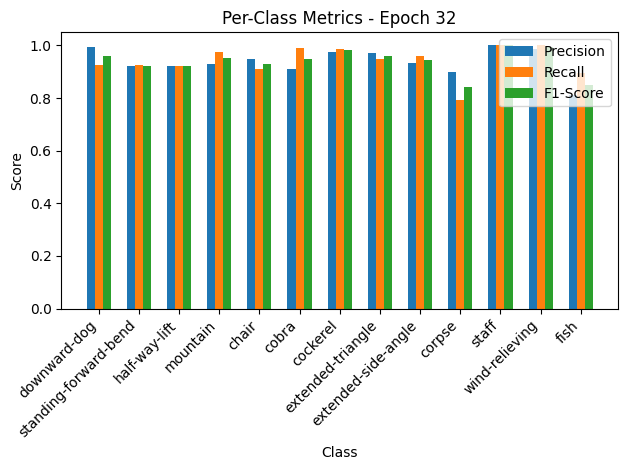


Epoch 33/50 Summary:
Train Loss: 0.2031 | Train Acc: 93.96% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.2459 | Val Acc: 93.15% | Val Precision: 0.94 | Val Recall: 0.93 | Val F1: 0.93

Epoch 34/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:02<00:00, 37.23it/s, loss=0.188, accuracy=94.6]


Per-Class Metrics for Epoch 33:
downward-dog: Precision=0.98, Recall=0.94, F1-Score=0.96
standing-forward-bend: Precision=0.97, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.91, Recall=0.95, F1-Score=0.93
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.94, Recall=0.92, F1-Score=0.93
cobra: Precision=0.94, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.88, Recall=0.85, F1-Score=0.87
staff: Precision=0.99, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.84, Recall=0.87, F1-Score=0.85


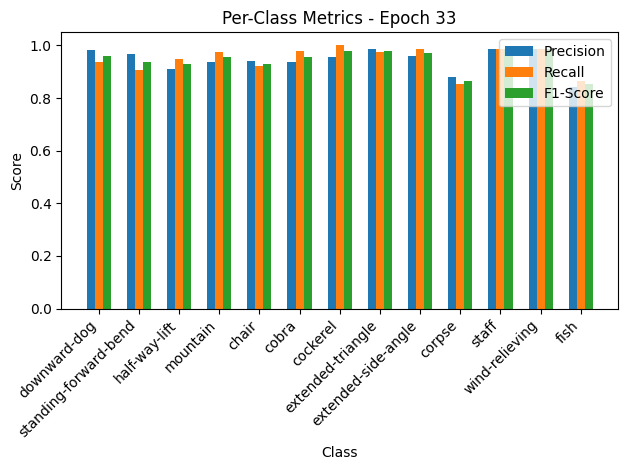

Validation: 100%|██████████| 10/10 [00:00<00:00, 169.56it/s, loss=0.212, accuracy=91.8]


Per-Class Metrics for Epoch 33:
downward-dog: Precision=0.98, Recall=0.94, F1-Score=0.96
standing-forward-bend: Precision=0.97, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.91, Recall=0.95, F1-Score=0.93
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.94, Recall=0.92, F1-Score=0.93
cobra: Precision=0.94, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.88, Recall=0.85, F1-Score=0.87
staff: Precision=0.99, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.84, Recall=0.87, F1-Score=0.85


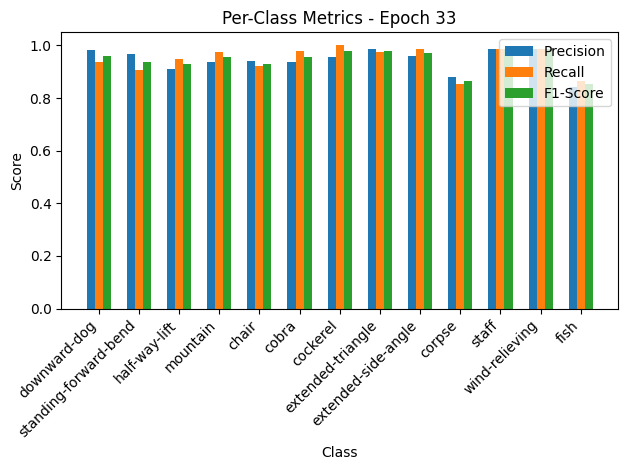


Epoch 34/50 Summary:
Train Loss: 0.1886 | Train Acc: 94.57% | Train Precision: 0.94 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.2323 | Val Acc: 91.78% | Val Precision: 0.94 | Val Recall: 0.93 | Val F1: 0.93

Epoch 35/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:01<00:00, 41.52it/s, loss=0.203, accuracy=94.1]


Per-Class Metrics for Epoch 34:
downward-dog: Precision=0.97, Recall=0.94, F1-Score=0.96
standing-forward-bend: Precision=0.94, Recall=0.91, F1-Score=0.92
half-way-lift: Precision=0.92, Recall=0.93, F1-Score=0.92
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.95, Recall=0.93, F1-Score=0.94
cobra: Precision=0.93, Recall=0.96, F1-Score=0.94
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.95, F1-Score=0.96
extended-side-angle: Precision=0.95, Recall=0.96, F1-Score=0.95
corpse: Precision=0.90, Recall=0.81, F1-Score=0.85
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.86, Recall=0.91, F1-Score=0.88


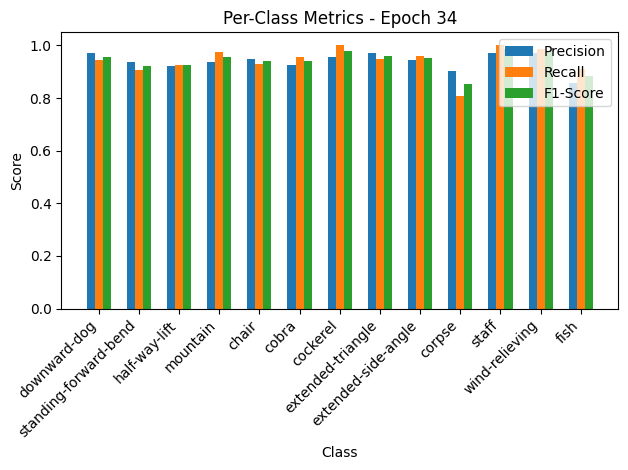

Validation: 100%|██████████| 10/10 [00:00<00:00, 163.34it/s, loss=0.217, accuracy=91.8]


Per-Class Metrics for Epoch 34:
downward-dog: Precision=0.97, Recall=0.94, F1-Score=0.96
standing-forward-bend: Precision=0.94, Recall=0.91, F1-Score=0.92
half-way-lift: Precision=0.92, Recall=0.93, F1-Score=0.92
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.95, Recall=0.93, F1-Score=0.94
cobra: Precision=0.93, Recall=0.96, F1-Score=0.94
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.95, F1-Score=0.96
extended-side-angle: Precision=0.95, Recall=0.96, F1-Score=0.95
corpse: Precision=0.90, Recall=0.81, F1-Score=0.85
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.86, Recall=0.91, F1-Score=0.88


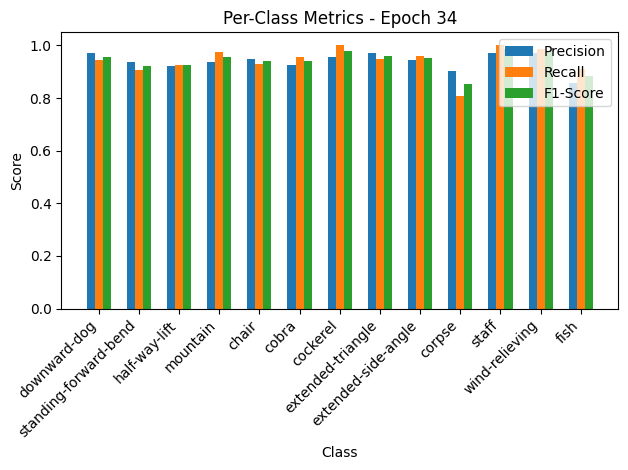


Epoch 35/50 Summary:
Train Loss: 0.2033 | Train Acc: 94.11% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.2379 | Val Acc: 91.78% | Val Precision: 0.93 | Val Recall: 0.93 | Val F1: 0.93

Epoch 36/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:02<00:00, 40.22it/s, loss=0.198, accuracy=94]


Per-Class Metrics for Epoch 35:
downward-dog: Precision=0.97, Recall=0.94, F1-Score=0.95
standing-forward-bend: Precision=0.95, Recall=0.88, F1-Score=0.92
half-way-lift: Precision=0.89, Recall=0.95, F1-Score=0.92
mountain: Precision=0.93, Recall=0.96, F1-Score=0.94
chair: Precision=0.95, Recall=0.92, F1-Score=0.93
cobra: Precision=0.93, Recall=0.98, F1-Score=0.95
cockerel: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.95, Recall=0.97, F1-Score=0.96
extended-side-angle: Precision=0.97, Recall=0.95, F1-Score=0.96
corpse: Precision=0.88, Recall=0.85, F1-Score=0.87
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.97, Recall=1.00, F1-Score=0.99
fish: Precision=0.85, Recall=0.85, F1-Score=0.85


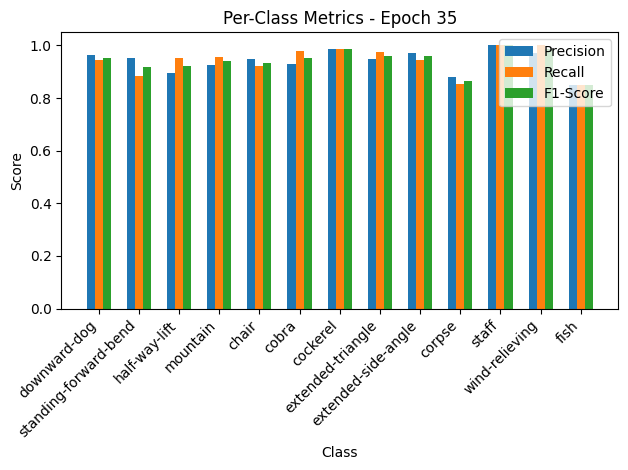

Validation: 100%|██████████| 10/10 [00:00<00:00, 159.95it/s, loss=0.264, accuracy=91.1]


Per-Class Metrics for Epoch 35:
downward-dog: Precision=0.97, Recall=0.94, F1-Score=0.95
standing-forward-bend: Precision=0.95, Recall=0.88, F1-Score=0.92
half-way-lift: Precision=0.89, Recall=0.95, F1-Score=0.92
mountain: Precision=0.93, Recall=0.96, F1-Score=0.94
chair: Precision=0.95, Recall=0.92, F1-Score=0.93
cobra: Precision=0.93, Recall=0.98, F1-Score=0.95
cockerel: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.95, Recall=0.97, F1-Score=0.96
extended-side-angle: Precision=0.97, Recall=0.95, F1-Score=0.96
corpse: Precision=0.88, Recall=0.85, F1-Score=0.87
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.97, Recall=1.00, F1-Score=0.99
fish: Precision=0.85, Recall=0.85, F1-Score=0.85


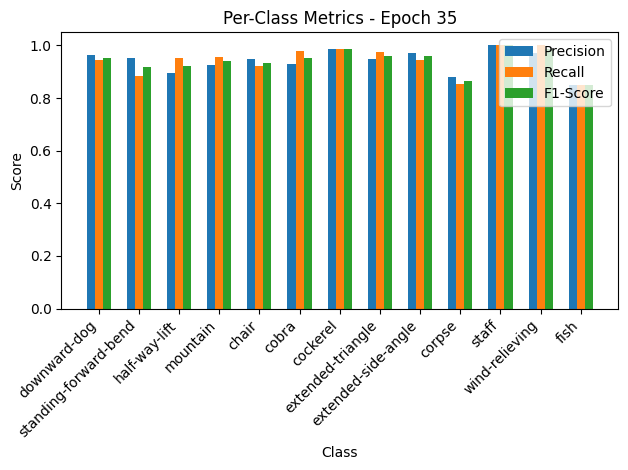


Epoch 36/50 Summary:
Train Loss: 0.1990 | Train Acc: 94.04% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.2896 | Val Acc: 91.10% | Val Precision: 0.93 | Val Recall: 0.93 | Val F1: 0.92

Epoch 37/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:02<00:00, 35.30it/s, loss=0.192, accuracy=94.9]


Per-Class Metrics for Epoch 36:
downward-dog: Precision=0.98, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.96, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.93, Recall=0.96, F1-Score=0.94
mountain: Precision=0.91, Recall=0.98, F1-Score=0.95
chair: Precision=0.96, Recall=0.91, F1-Score=0.93
cobra: Precision=0.93, Recall=0.97, F1-Score=0.95
cockerel: Precision=0.95, Recall=0.97, F1-Score=0.96
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.97, F1-Score=0.97
corpse: Precision=0.89, Recall=0.87, F1-Score=0.88
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.88, Recall=0.90, F1-Score=0.89


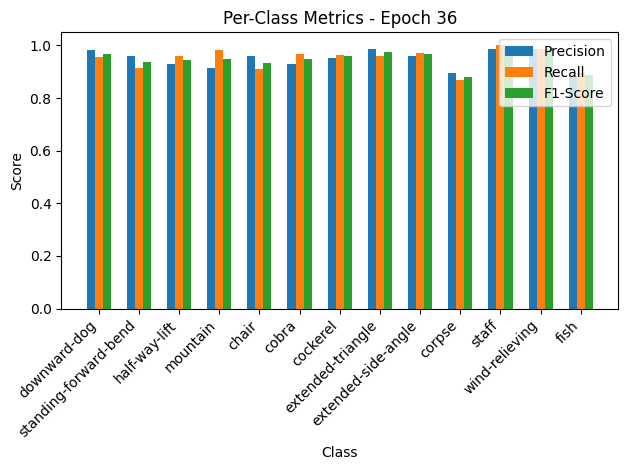

Validation: 100%|██████████| 10/10 [00:00<00:00, 125.10it/s, loss=0.246, accuracy=91.8]


Per-Class Metrics for Epoch 36:
downward-dog: Precision=0.98, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.96, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.93, Recall=0.96, F1-Score=0.94
mountain: Precision=0.91, Recall=0.98, F1-Score=0.95
chair: Precision=0.96, Recall=0.91, F1-Score=0.93
cobra: Precision=0.93, Recall=0.97, F1-Score=0.95
cockerel: Precision=0.95, Recall=0.97, F1-Score=0.96
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.97, F1-Score=0.97
corpse: Precision=0.89, Recall=0.87, F1-Score=0.88
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.88, Recall=0.90, F1-Score=0.89


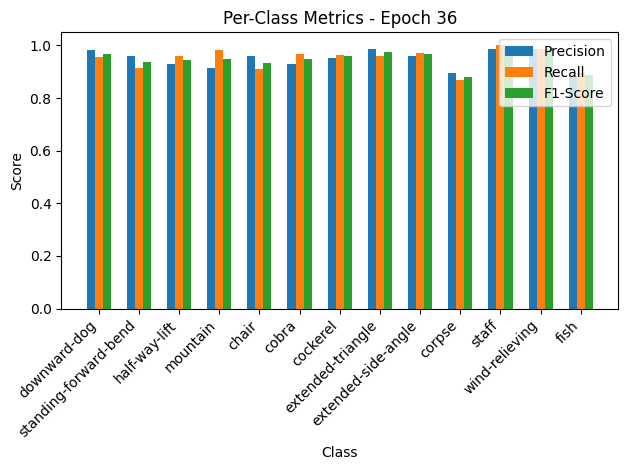


Epoch 37/50 Summary:
Train Loss: 0.1924 | Train Acc: 94.88% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.2699 | Val Acc: 91.78% | Val Precision: 0.94 | Val Recall: 0.93 | Val F1: 0.93

Epoch 38/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:02<00:00, 40.20it/s, loss=0.179, accuracy=95]


Per-Class Metrics for Epoch 37:
downward-dog: Precision=0.97, Recall=0.94, F1-Score=0.95
standing-forward-bend: Precision=0.95, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.93, Recall=0.95, F1-Score=0.94
mountain: Precision=0.93, Recall=0.98, F1-Score=0.96
chair: Precision=0.96, Recall=0.93, F1-Score=0.94
cobra: Precision=0.91, Recall=0.98, F1-Score=0.94
cockerel: Precision=0.97, Recall=0.98, F1-Score=0.97
extended-triangle: Precision=0.96, Recall=0.99, F1-Score=0.97
extended-side-angle: Precision=0.99, Recall=0.96, F1-Score=0.97
corpse: Precision=0.97, Recall=0.84, F1-Score=0.90
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=1.00, F1-Score=0.99
fish: Precision=0.88, Recall=0.94, F1-Score=0.91


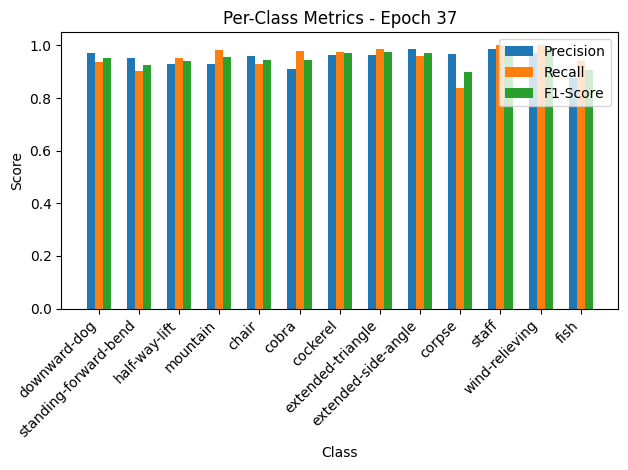

Validation: 100%|██████████| 10/10 [00:00<00:00, 175.10it/s, loss=0.223, accuracy=93.2]


Per-Class Metrics for Epoch 37:
downward-dog: Precision=0.97, Recall=0.94, F1-Score=0.95
standing-forward-bend: Precision=0.95, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.93, Recall=0.95, F1-Score=0.94
mountain: Precision=0.93, Recall=0.98, F1-Score=0.96
chair: Precision=0.96, Recall=0.93, F1-Score=0.94
cobra: Precision=0.91, Recall=0.98, F1-Score=0.94
cockerel: Precision=0.97, Recall=0.98, F1-Score=0.97
extended-triangle: Precision=0.96, Recall=0.99, F1-Score=0.97
extended-side-angle: Precision=0.99, Recall=0.96, F1-Score=0.97
corpse: Precision=0.97, Recall=0.84, F1-Score=0.90
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=1.00, F1-Score=0.99
fish: Precision=0.88, Recall=0.94, F1-Score=0.91


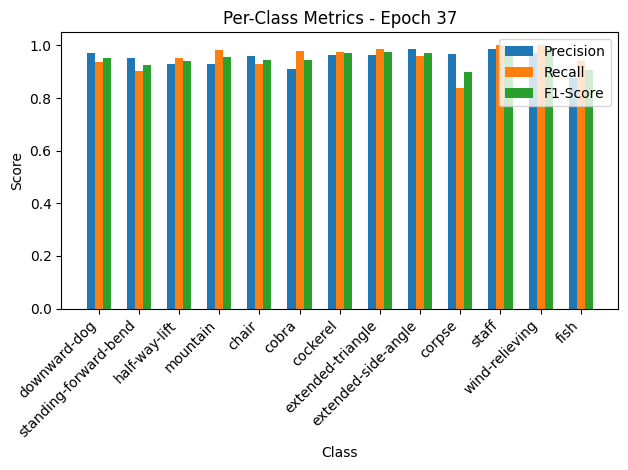


Epoch 38/50 Summary:
Train Loss: 0.1796 | Train Acc: 94.95% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.2444 | Val Acc: 93.15% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.94

Epoch 39/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:01<00:00, 42.45it/s, loss=0.179, accuracy=95.2]


Per-Class Metrics for Epoch 38:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.97, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.92, Recall=0.96, F1-Score=0.94
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.95, Recall=0.93, F1-Score=0.94
cobra: Precision=0.95, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.93, Recall=0.96, F1-Score=0.94
extended-side-angle: Precision=0.96, Recall=0.93, F1-Score=0.94
corpse: Precision=0.95, Recall=0.85, F1-Score=0.90
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=1.00, F1-Score=0.99
fish: Precision=0.87, Recall=0.93, F1-Score=0.90


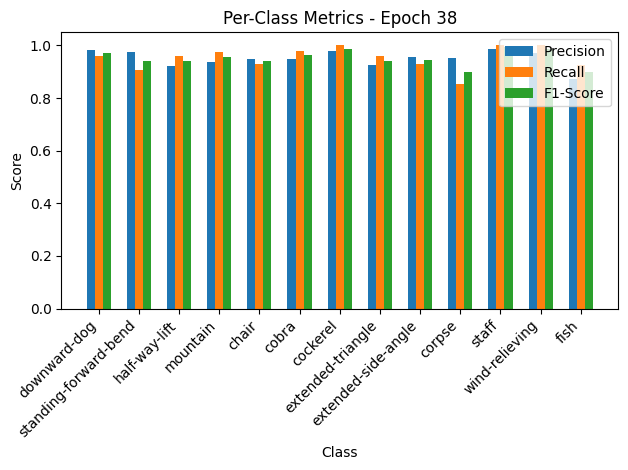

Validation: 100%|██████████| 10/10 [00:00<00:00, 173.75it/s, loss=0.218, accuracy=93.2]


Per-Class Metrics for Epoch 38:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.97, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.92, Recall=0.96, F1-Score=0.94
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.95, Recall=0.93, F1-Score=0.94
cobra: Precision=0.95, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.93, Recall=0.96, F1-Score=0.94
extended-side-angle: Precision=0.96, Recall=0.93, F1-Score=0.94
corpse: Precision=0.95, Recall=0.85, F1-Score=0.90
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=1.00, F1-Score=0.99
fish: Precision=0.87, Recall=0.93, F1-Score=0.90


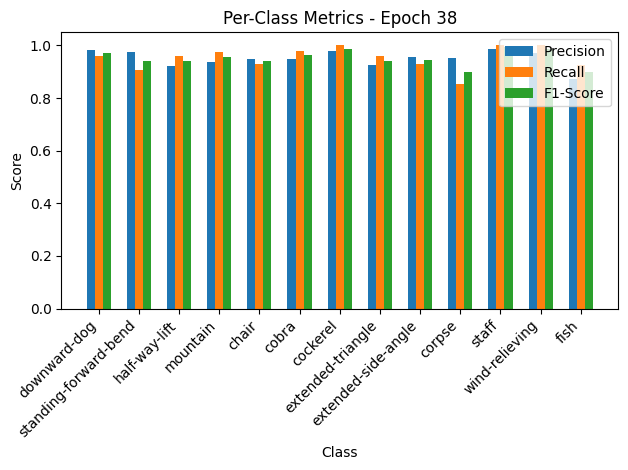


Epoch 39/50 Summary:
Train Loss: 0.1792 | Train Acc: 95.18% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.2387 | Val Acc: 93.15% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.94

Epoch 40/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:01<00:00, 42.02it/s, loss=0.173, accuracy=94.8]


Per-Class Metrics for Epoch 39:
downward-dog: Precision=0.98, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.95, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.92, Recall=0.95, F1-Score=0.93
mountain: Precision=0.93, Recall=0.98, F1-Score=0.96
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=0.94, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.89, Recall=0.87, F1-Score=0.88
staff: Precision=0.99, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=1.00, F1-Score=0.99
fish: Precision=0.88, Recall=0.87, F1-Score=0.87


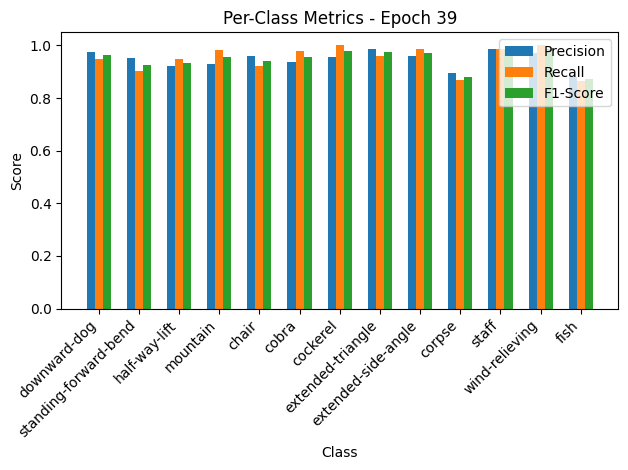

Validation: 100%|██████████| 10/10 [00:00<00:00, 161.55it/s, loss=0.222, accuracy=93.2]


Per-Class Metrics for Epoch 39:
downward-dog: Precision=0.98, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.95, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.92, Recall=0.95, F1-Score=0.93
mountain: Precision=0.93, Recall=0.98, F1-Score=0.96
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=0.94, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.89, Recall=0.87, F1-Score=0.88
staff: Precision=0.99, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=1.00, F1-Score=0.99
fish: Precision=0.88, Recall=0.87, F1-Score=0.87


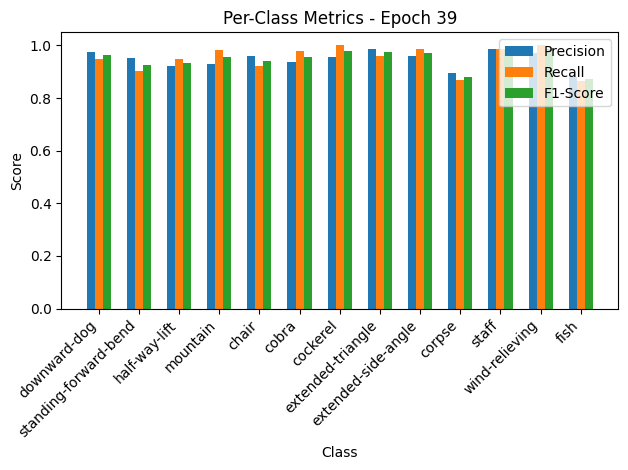


Epoch 40/50 Summary:
Train Loss: 0.1732 | Train Acc: 94.80% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.2438 | Val Acc: 93.15% | Val Precision: 0.94 | Val Recall: 0.94 | Val F1: 0.94

Epoch 41/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:02<00:00, 37.05it/s, loss=0.175, accuracy=95.7]


Per-Class Metrics for Epoch 40:
downward-dog: Precision=0.99, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.94, Recall=0.92, F1-Score=0.93
half-way-lift: Precision=0.94, Recall=0.95, F1-Score=0.95
mountain: Precision=0.96, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.96, F1-Score=0.96
cobra: Precision=0.94, Recall=0.97, F1-Score=0.95
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.91, Recall=0.91, F1-Score=0.91
staff: Precision=0.99, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.91, Recall=0.91, F1-Score=0.91


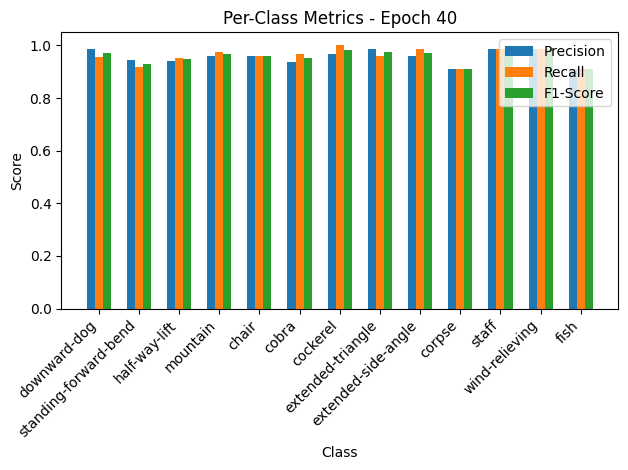

Validation: 100%|██████████| 10/10 [00:00<00:00, 133.94it/s, loss=0.221, accuracy=93.2]


Per-Class Metrics for Epoch 40:
downward-dog: Precision=0.99, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.94, Recall=0.92, F1-Score=0.93
half-way-lift: Precision=0.94, Recall=0.95, F1-Score=0.95
mountain: Precision=0.96, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.96, F1-Score=0.96
cobra: Precision=0.94, Recall=0.97, F1-Score=0.95
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.91, Recall=0.91, F1-Score=0.91
staff: Precision=0.99, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.91, Recall=0.91, F1-Score=0.91


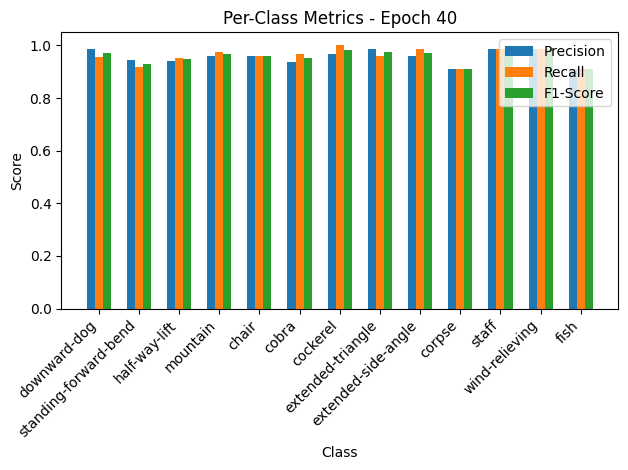


Epoch 41/50 Summary:
Train Loss: 0.1754 | Train Acc: 95.72% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.2424 | Val Acc: 93.15% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.94

Epoch 42/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:02<00:00, 34.56it/s, loss=0.16, accuracy=96]


Per-Class Metrics for Epoch 41:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.97, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.94, Recall=0.97, F1-Score=0.95
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.97, Recall=0.93, F1-Score=0.95
cobra: Precision=0.93, Recall=0.98, F1-Score=0.95
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.97, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.97, F1-Score=0.97
corpse: Precision=0.94, Recall=0.94, F1-Score=0.94
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.94, F1-Score=0.94


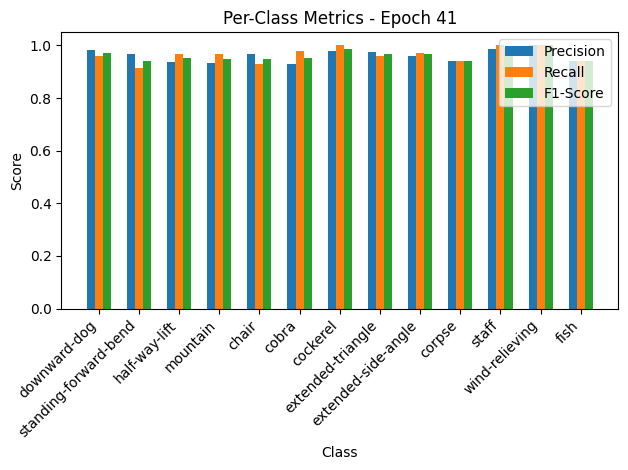

Validation: 100%|██████████| 10/10 [00:00<00:00, 180.06it/s, loss=0.243, accuracy=90.4]


Per-Class Metrics for Epoch 41:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.97, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.94, Recall=0.97, F1-Score=0.95
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.97, Recall=0.93, F1-Score=0.95
cobra: Precision=0.93, Recall=0.98, F1-Score=0.95
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.97, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.97, F1-Score=0.97
corpse: Precision=0.94, Recall=0.94, F1-Score=0.94
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.94, F1-Score=0.94


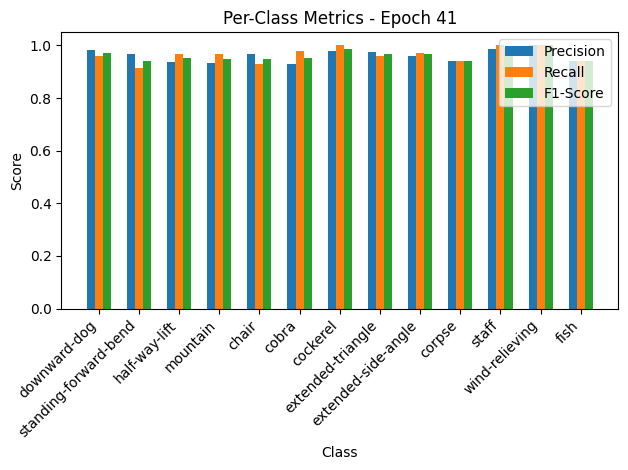


Epoch 42/50 Summary:
Train Loss: 0.1603 | Train Acc: 96.02% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.2661 | Val Acc: 90.41% | Val Precision: 0.92 | Val Recall: 0.91 | Val F1: 0.91

Epoch 43/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:02<00:00, 39.37it/s, loss=0.172, accuracy=95.1]


Per-Class Metrics for Epoch 42:
downward-dog: Precision=0.97, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.96, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.93, Recall=0.93, F1-Score=0.93
mountain: Precision=0.94, Recall=0.99, F1-Score=0.97
chair: Precision=0.98, Recall=0.94, F1-Score=0.96
cobra: Precision=0.94, Recall=0.97, F1-Score=0.95
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.96, Recall=0.96, F1-Score=0.96
extended-side-angle: Precision=0.95, Recall=0.97, F1-Score=0.96
corpse: Precision=0.89, Recall=0.85, F1-Score=0.87
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=0.97, F1-Score=0.97
fish: Precision=0.86, Recall=0.90, F1-Score=0.88


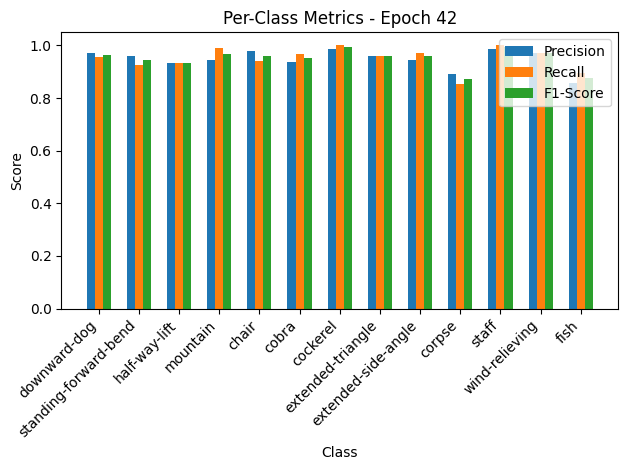

Validation: 100%|██████████| 10/10 [00:00<00:00, 153.66it/s, loss=0.208, accuracy=93.2]


Per-Class Metrics for Epoch 42:
downward-dog: Precision=0.97, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.96, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.93, Recall=0.93, F1-Score=0.93
mountain: Precision=0.94, Recall=0.99, F1-Score=0.97
chair: Precision=0.98, Recall=0.94, F1-Score=0.96
cobra: Precision=0.94, Recall=0.97, F1-Score=0.95
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.96, Recall=0.96, F1-Score=0.96
extended-side-angle: Precision=0.95, Recall=0.97, F1-Score=0.96
corpse: Precision=0.89, Recall=0.85, F1-Score=0.87
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=0.97, F1-Score=0.97
fish: Precision=0.86, Recall=0.90, F1-Score=0.88


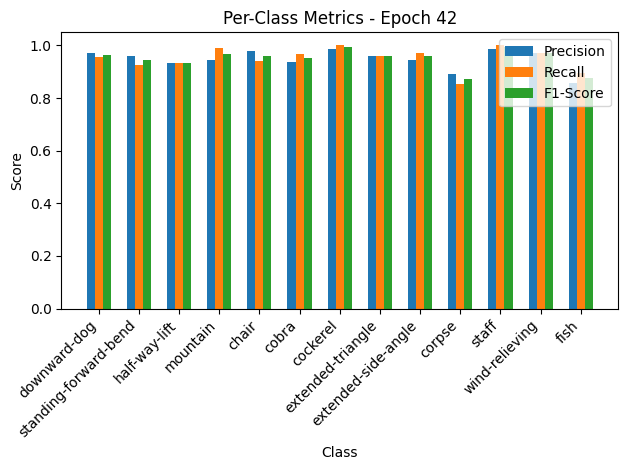


Epoch 43/50 Summary:
Train Loss: 0.1724 | Train Acc: 95.11% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.2277 | Val Acc: 93.15% | Val Precision: 0.95 | Val Recall: 0.94 | Val F1: 0.94

Epoch 44/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:01<00:00, 41.58it/s, loss=0.162, accuracy=95.8]


Per-Class Metrics for Epoch 43:
downward-dog: Precision=0.99, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.94, Recall=0.91, F1-Score=0.93
half-way-lift: Precision=0.93, Recall=0.95, F1-Score=0.94
mountain: Precision=0.96, Recall=0.98, F1-Score=0.97
chair: Precision=0.95, Recall=0.95, F1-Score=0.95
cobra: Precision=0.95, Recall=0.97, F1-Score=0.96
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.97, Recall=0.88, F1-Score=0.92
staff: Precision=0.99, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=1.00, F1-Score=0.99
fish: Precision=0.89, Recall=0.94, F1-Score=0.91


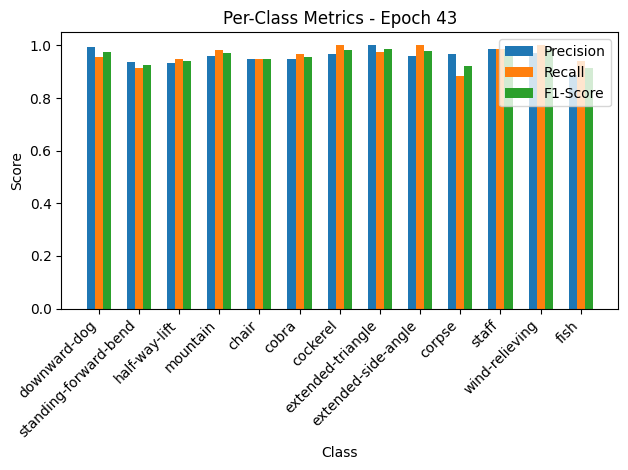

Validation: 100%|██████████| 10/10 [00:00<00:00, 162.59it/s, loss=0.224, accuracy=92.5]


Per-Class Metrics for Epoch 43:
downward-dog: Precision=0.99, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.94, Recall=0.91, F1-Score=0.93
half-way-lift: Precision=0.93, Recall=0.95, F1-Score=0.94
mountain: Precision=0.96, Recall=0.98, F1-Score=0.97
chair: Precision=0.95, Recall=0.95, F1-Score=0.95
cobra: Precision=0.95, Recall=0.97, F1-Score=0.96
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.97, Recall=0.88, F1-Score=0.92
staff: Precision=0.99, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=1.00, F1-Score=0.99
fish: Precision=0.89, Recall=0.94, F1-Score=0.91


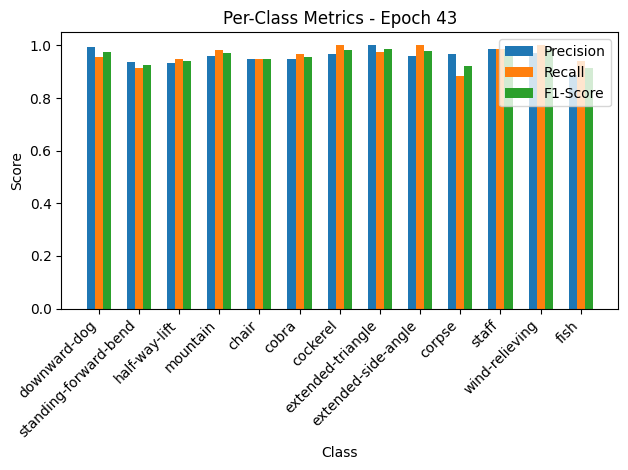


Epoch 44/50 Summary:
Train Loss: 0.1628 | Train Acc: 95.80% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.2451 | Val Acc: 92.47% | Val Precision: 0.94 | Val Recall: 0.93 | Val F1: 0.93

Epoch 45/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:02<00:00, 39.71it/s, loss=0.157, accuracy=95.8]


Per-Class Metrics for Epoch 44:
downward-dog: Precision=0.98, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.96, Recall=0.94, F1-Score=0.95
half-way-lift: Precision=0.95, Recall=0.97, F1-Score=0.96
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.97, Recall=0.94, F1-Score=0.95
cobra: Precision=0.94, Recall=0.97, F1-Score=0.95
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.96, Recall=0.96, F1-Score=0.96
extended-side-angle: Precision=0.96, Recall=0.96, F1-Score=0.96
corpse: Precision=0.95, Recall=0.88, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.88, Recall=0.94, F1-Score=0.91


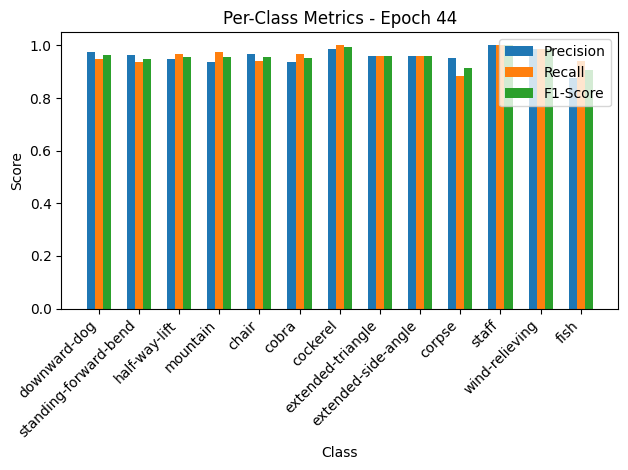

Validation: 100%|██████████| 10/10 [00:00<00:00, 133.84it/s, loss=0.212, accuracy=93.2]


Per-Class Metrics for Epoch 44:
downward-dog: Precision=0.98, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.96, Recall=0.94, F1-Score=0.95
half-way-lift: Precision=0.95, Recall=0.97, F1-Score=0.96
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.97, Recall=0.94, F1-Score=0.95
cobra: Precision=0.94, Recall=0.97, F1-Score=0.95
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.96, Recall=0.96, F1-Score=0.96
extended-side-angle: Precision=0.96, Recall=0.96, F1-Score=0.96
corpse: Precision=0.95, Recall=0.88, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.88, Recall=0.94, F1-Score=0.91


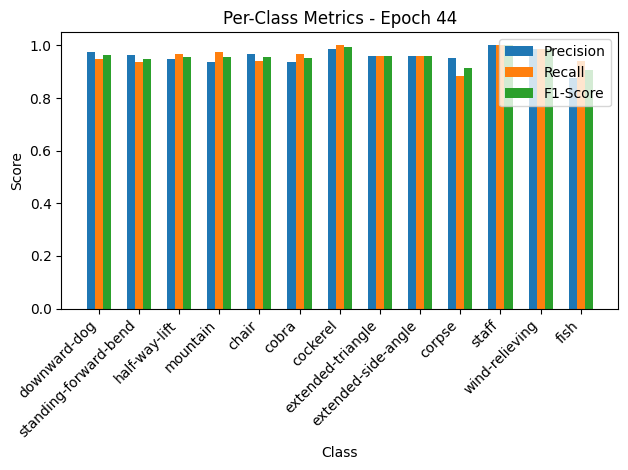


Epoch 45/50 Summary:
Train Loss: 0.1575 | Train Acc: 95.80% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.2325 | Val Acc: 93.15% | Val Precision: 0.95 | Val Recall: 0.94 | Val F1: 0.94

Epoch 46/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:02<00:00, 36.63it/s, loss=0.157, accuracy=95.7]


Per-Class Metrics for Epoch 45:
downward-dog: Precision=0.98, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.96, Recall=0.92, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.96, Recall=0.95, F1-Score=0.96
cobra: Precision=0.94, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.94, Recall=0.85, F1-Score=0.89
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.86, Recall=0.96, F1-Score=0.91


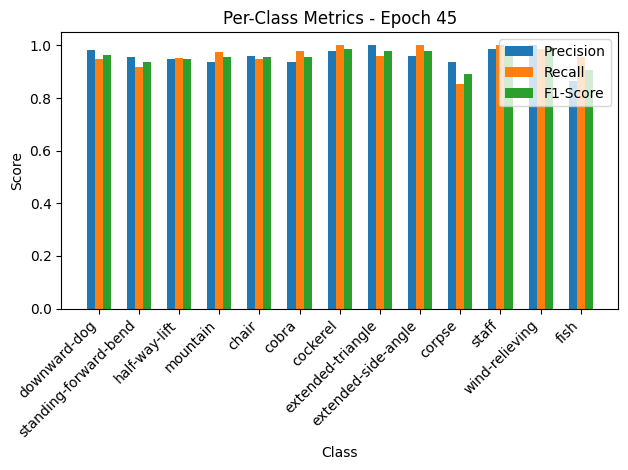

Validation: 100%|██████████| 10/10 [00:00<00:00, 177.33it/s, loss=0.218, accuracy=92.5]


Per-Class Metrics for Epoch 45:
downward-dog: Precision=0.98, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.96, Recall=0.92, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.96, Recall=0.95, F1-Score=0.96
cobra: Precision=0.94, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.94, Recall=0.85, F1-Score=0.89
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.86, Recall=0.96, F1-Score=0.91


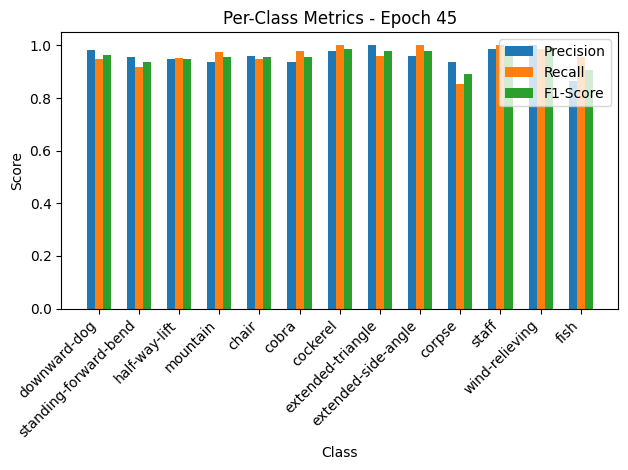


Epoch 46/50 Summary:
Train Loss: 0.1575 | Train Acc: 95.72% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.2390 | Val Acc: 92.47% | Val Precision: 0.94 | Val Recall: 0.93 | Val F1: 0.93

Epoch 47/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:02<00:00, 40.89it/s, loss=0.168, accuracy=95.8]


Per-Class Metrics for Epoch 46:
downward-dog: Precision=0.99, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.98, Recall=0.92, F1-Score=0.95
half-way-lift: Precision=0.93, Recall=0.97, F1-Score=0.95
mountain: Precision=0.93, Recall=0.99, F1-Score=0.96
chair: Precision=0.98, Recall=0.91, F1-Score=0.94
cobra: Precision=0.94, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.99, F1-Score=0.97
corpse: Precision=0.90, Recall=0.93, F1-Score=0.91
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.92, Recall=0.90, F1-Score=0.91


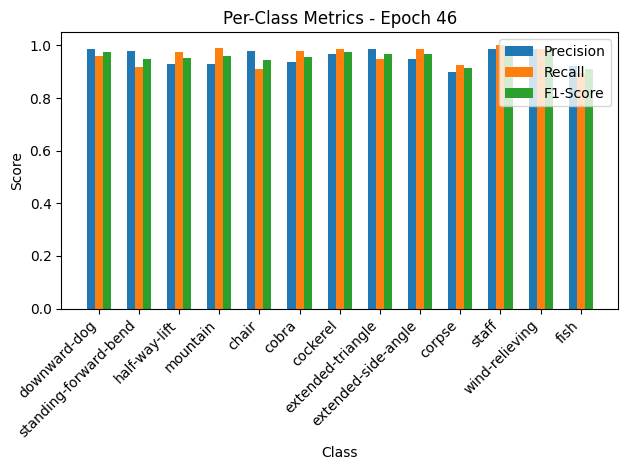

Validation: 100%|██████████| 10/10 [00:00<00:00, 157.53it/s, loss=0.227, accuracy=91.8]


Per-Class Metrics for Epoch 46:
downward-dog: Precision=0.99, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.98, Recall=0.92, F1-Score=0.95
half-way-lift: Precision=0.93, Recall=0.97, F1-Score=0.95
mountain: Precision=0.93, Recall=0.99, F1-Score=0.96
chair: Precision=0.98, Recall=0.91, F1-Score=0.94
cobra: Precision=0.94, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.99, F1-Score=0.97
corpse: Precision=0.90, Recall=0.93, F1-Score=0.91
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.92, Recall=0.90, F1-Score=0.91


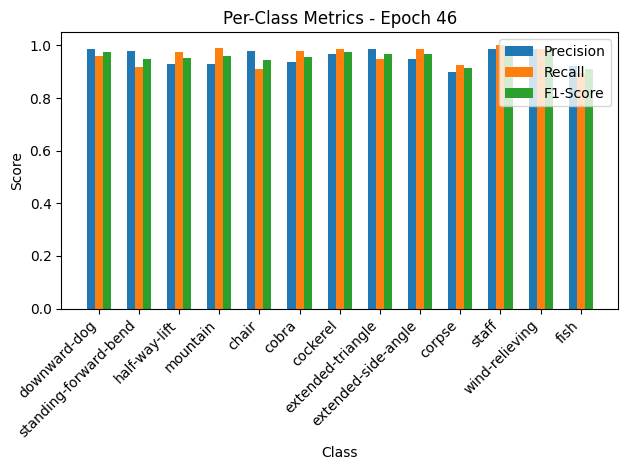


Epoch 47/50 Summary:
Train Loss: 0.1683 | Train Acc: 95.80% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.2488 | Val Acc: 91.78% | Val Precision: 0.94 | Val Recall: 0.92 | Val F1: 0.93

Epoch 48/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:01<00:00, 41.36it/s, loss=0.167, accuracy=95.6]


Per-Class Metrics for Epoch 47:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.96, Recall=0.92, F1-Score=0.94
half-way-lift: Precision=0.93, Recall=0.95, F1-Score=0.94
mountain: Precision=0.94, Recall=0.98, F1-Score=0.96
chair: Precision=0.95, Recall=0.93, F1-Score=0.94
cobra: Precision=0.95, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.94, Recall=0.87, F1-Score=0.90
staff: Precision=0.98, Recall=0.97, F1-Score=0.98
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.87, Recall=0.93, F1-Score=0.90


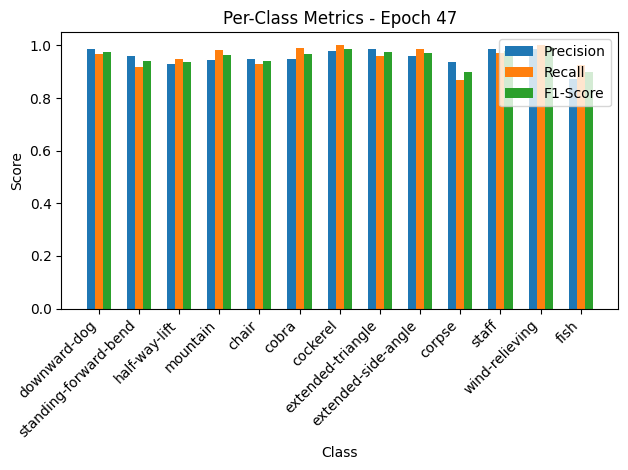

Validation: 100%|██████████| 10/10 [00:00<00:00, 167.59it/s, loss=0.215, accuracy=93.2]


Per-Class Metrics for Epoch 47:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.96, Recall=0.92, F1-Score=0.94
half-way-lift: Precision=0.93, Recall=0.95, F1-Score=0.94
mountain: Precision=0.94, Recall=0.98, F1-Score=0.96
chair: Precision=0.95, Recall=0.93, F1-Score=0.94
cobra: Precision=0.95, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.94, Recall=0.87, F1-Score=0.90
staff: Precision=0.98, Recall=0.97, F1-Score=0.98
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.87, Recall=0.93, F1-Score=0.90


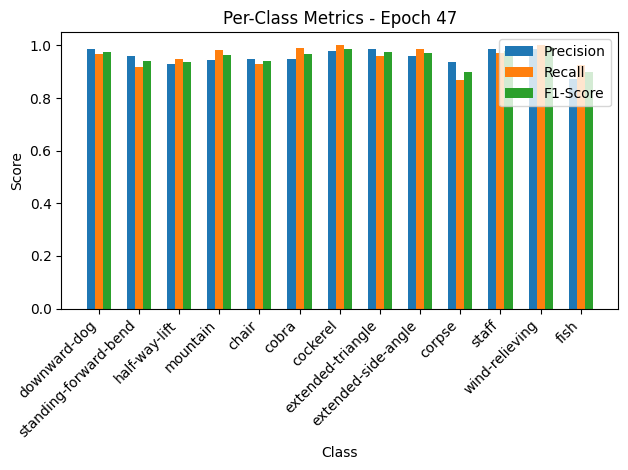


Epoch 48/50 Summary:
Train Loss: 0.1675 | Train Acc: 95.64% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.2359 | Val Acc: 93.15% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.94

Epoch 49/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:01<00:00, 42.04it/s, loss=0.177, accuracy=95.2]


Per-Class Metrics for Epoch 48:
downward-dog: Precision=0.98, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.96, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.93, Recall=0.94, F1-Score=0.94
mountain: Precision=0.94, Recall=0.97, F1-Score=0.96
chair: Precision=0.94, Recall=0.95, F1-Score=0.95
cobra: Precision=0.95, Recall=0.95, F1-Score=0.95
cockerel: Precision=0.95, Recall=1.00, F1-Score=0.97
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.97, F1-Score=0.97
corpse: Precision=0.95, Recall=0.90, F1-Score=0.92
staff: Precision=0.94, Recall=1.00, F1-Score=0.97
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.89, Recall=0.93, F1-Score=0.91


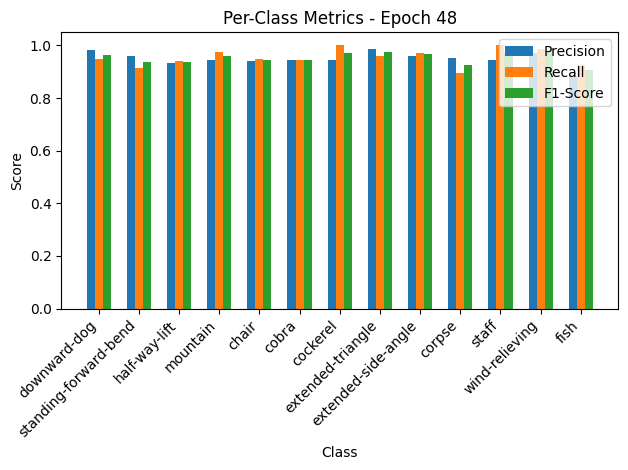

Validation: 100%|██████████| 10/10 [00:00<00:00, 134.85it/s, loss=0.209, accuracy=93.8]


Per-Class Metrics for Epoch 48:
downward-dog: Precision=0.98, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.96, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.93, Recall=0.94, F1-Score=0.94
mountain: Precision=0.94, Recall=0.97, F1-Score=0.96
chair: Precision=0.94, Recall=0.95, F1-Score=0.95
cobra: Precision=0.95, Recall=0.95, F1-Score=0.95
cockerel: Precision=0.95, Recall=1.00, F1-Score=0.97
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.97, F1-Score=0.97
corpse: Precision=0.95, Recall=0.90, F1-Score=0.92
staff: Precision=0.94, Recall=1.00, F1-Score=0.97
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.89, Recall=0.93, F1-Score=0.91


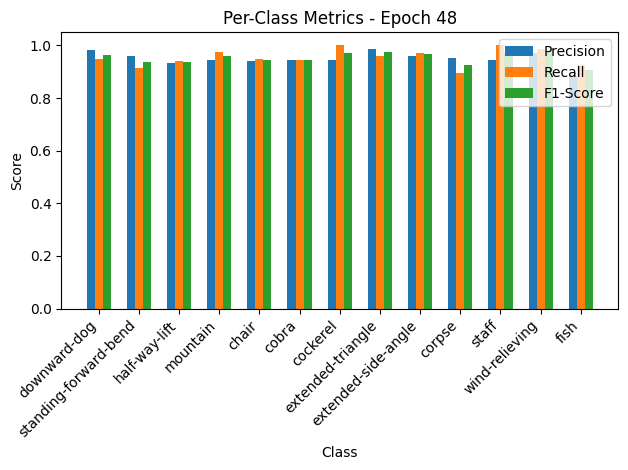


Epoch 49/50 Summary:
Train Loss: 0.1778 | Train Acc: 95.18% | Train Precision: 0.95 | Train Recall: 0.96 | Train F1: 0.95
Val Loss: 0.2287 | Val Acc: 93.84% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 50/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:02<00:00, 37.17it/s, loss=0.176, accuracy=95.3]


Per-Class Metrics for Epoch 49:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.97, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.94, Recall=0.96, F1-Score=0.95
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.96, Recall=0.95, F1-Score=0.96
cobra: Precision=0.95, Recall=0.95, F1-Score=0.95
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.97, F1-Score=0.97
corpse: Precision=0.88, Recall=0.90, F1-Score=0.89
staff: Precision=0.96, Recall=0.99, F1-Score=0.97
wind-relieving: Precision=0.97, Recall=1.00, F1-Score=0.99
fish: Precision=0.89, Recall=0.87, F1-Score=0.88


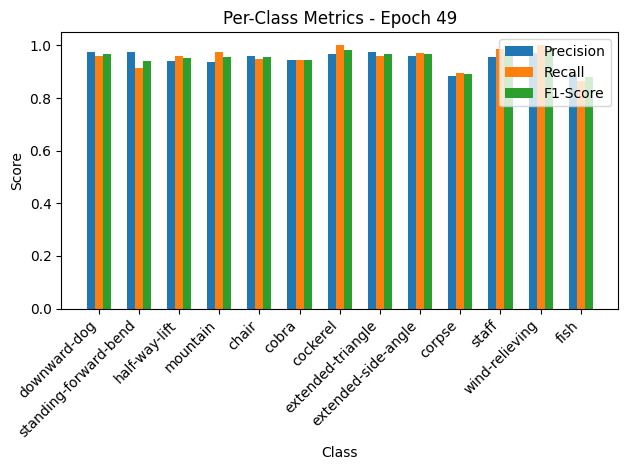

Validation: 100%|██████████| 10/10 [00:00<00:00, 147.83it/s, loss=0.211, accuracy=93.2]


Per-Class Metrics for Epoch 49:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.97, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.94, Recall=0.96, F1-Score=0.95
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.96, Recall=0.95, F1-Score=0.96
cobra: Precision=0.95, Recall=0.95, F1-Score=0.95
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.97, F1-Score=0.97
corpse: Precision=0.88, Recall=0.90, F1-Score=0.89
staff: Precision=0.96, Recall=0.99, F1-Score=0.97
wind-relieving: Precision=0.97, Recall=1.00, F1-Score=0.99
fish: Precision=0.89, Recall=0.87, F1-Score=0.88


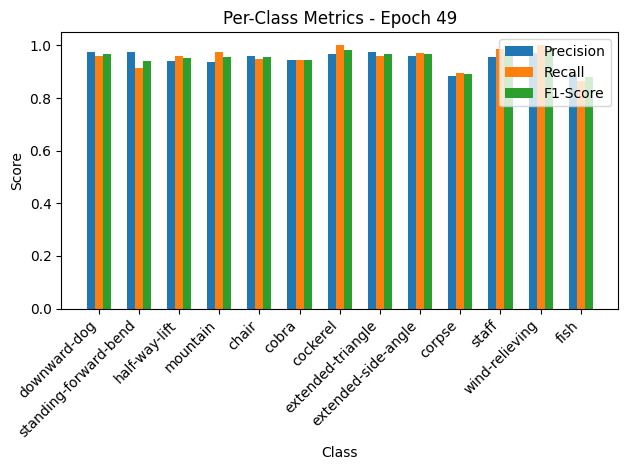


Epoch 50/50 Summary:
Train Loss: 0.1764 | Train Acc: 95.26% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.2310 | Val Acc: 93.15% | Val Precision: 0.95 | Val Recall: 0.94 | Val F1: 0.94


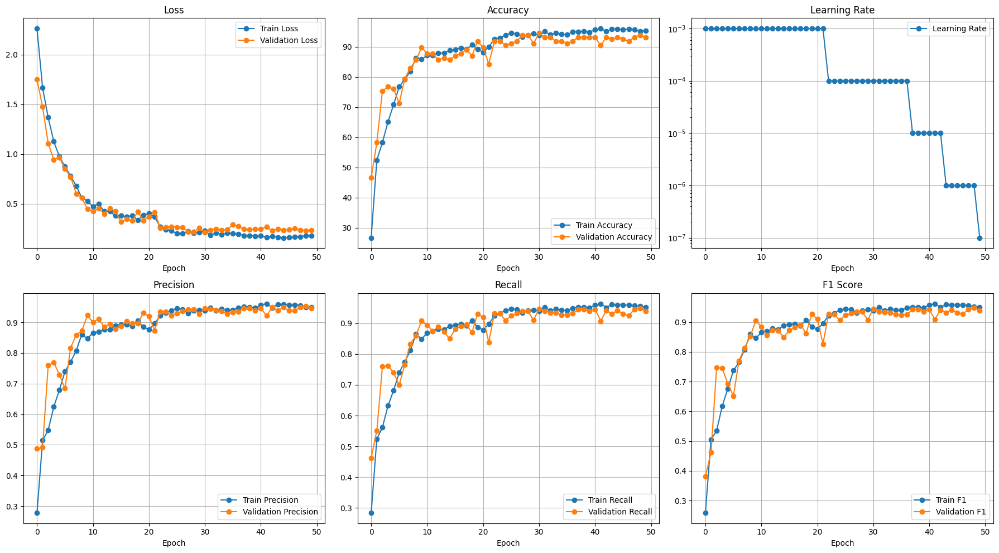

Testing: 100%|██████████| 23/23 [00:00<00:00, 115.88it/s]


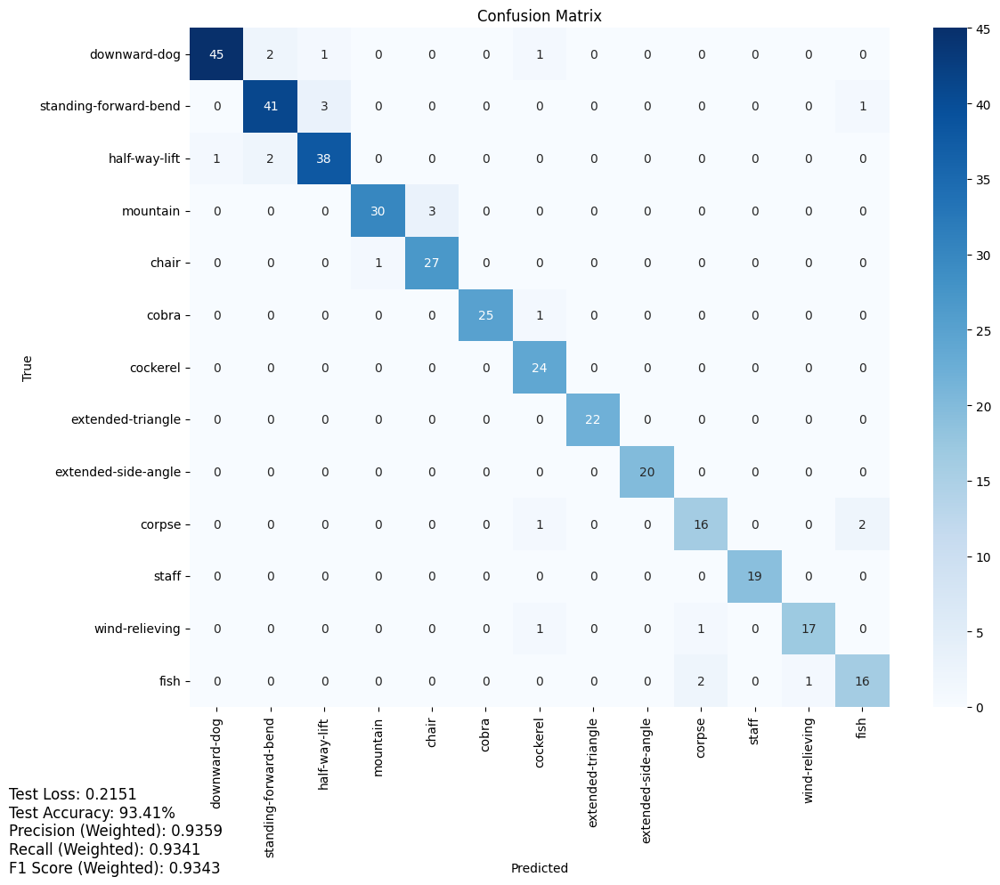

Test Loss: 0.2151
Test Accuracy: 93.41%
Precision (Weighted): 0.9359
Recall (Weighted): 0.9341
F1 Score (Weighted): 0.9343


Testing: 100%|██████████| 23/23 [00:00<00:00, 150.31it/s]


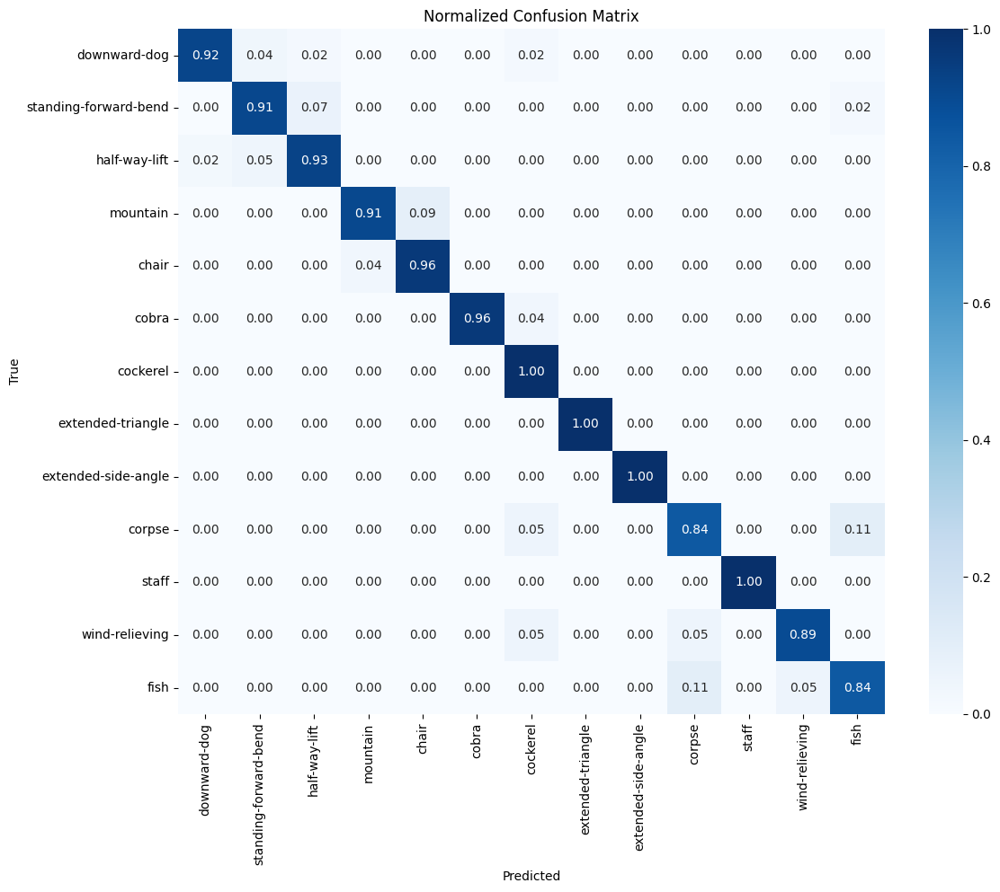

Test Loss: 0.2151
Test Accuracy: 93.41%
Precision (Macro): 0.9344
Recall (Macro): 0.9362
F1 Score (Macro): 0.9346
Saved checkpoint for fold 3
Fold 4/5
Loading cached criterion for fold 3
batch_norm.weight: 99
batch_norm.bias: 99
conv1.0.weight: 288
conv1.0.bias: 32
conv1.1.weight: 32
conv1.1.bias: 32
blk1.conv1.weight: 6144
blk1.conv1.bias: 64
blk1.bn1.weight: 64
blk1.bn1.bias: 64
blk1.conv2.weight: 12288
blk1.conv2.bias: 64
blk1.bn2.weight: 64
blk1.bn2.bias: 64
blk1.shortcut.0.weight: 2048
blk1.shortcut.0.bias: 64
blk1.shortcut.1.weight: 64
blk1.shortcut.1.bias: 64
blk2.conv1.weight: 24576
blk2.conv1.bias: 128
blk2.bn1.weight: 128
blk2.bn1.bias: 128
blk2.conv2.weight: 49152
blk2.conv2.bias: 128
blk2.bn2.weight: 128
blk2.bn2.bias: 128
blk2.shortcut.0.weight: 8192
blk2.shortcut.0.bias: 128
blk2.shortcut.1.weight: 128
blk2.shortcut.1.bias: 128
blk3.conv1.weight: 98304
blk3.conv1.bias: 256
blk3.bn1.weight: 256
blk3.bn1.bias: 256
blk3.conv2.weight: 196608
blk3.conv2.bias: 256
blk3.bn2.weig

Training: 100%|██████████| 82/82 [00:02<00:00, 39.57it/s, loss=2.33, accuracy=23.3]


Per-Class Metrics for Epoch 0:
downward-dog: Precision=0.27, Recall=0.19, F1-Score=0.22
standing-forward-bend: Precision=0.15, Recall=0.10, F1-Score=0.12
half-way-lift: Precision=0.23, Recall=0.18, F1-Score=0.20
mountain: Precision=0.26, Recall=0.41, F1-Score=0.32
chair: Precision=0.12, Recall=0.06, F1-Score=0.08
cobra: Precision=0.28, Recall=0.14, F1-Score=0.19
cockerel: Precision=0.33, Recall=0.51, F1-Score=0.40
extended-triangle: Precision=0.27, Recall=0.47, F1-Score=0.35
extended-side-angle: Precision=0.27, Recall=0.29, F1-Score=0.28
corpse: Precision=0.18, Recall=0.31, F1-Score=0.23
staff: Precision=0.26, Recall=0.21, F1-Score=0.23
wind-relieving: Precision=0.21, Recall=0.34, F1-Score=0.26
fish: Precision=0.02, Recall=0.01, F1-Score=0.02


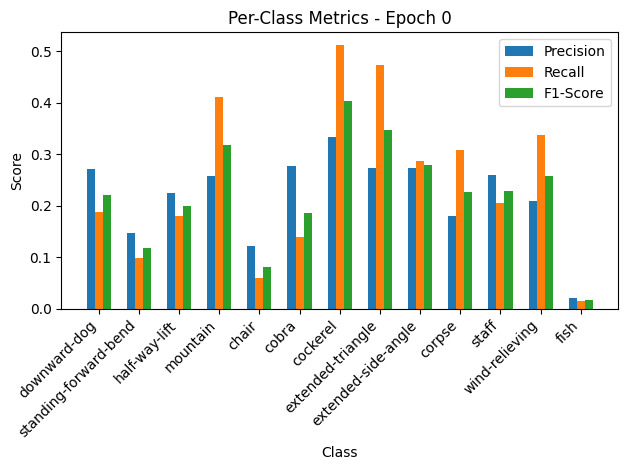

Validation: 100%|██████████| 10/10 [00:00<00:00, 153.16it/s, loss=1.79, accuracy=37.7]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 0:
downward-dog: Precision=0.27, Recall=0.19, F1-Score=0.22
standing-forward-bend: Precision=0.15, Recall=0.10, F1-Score=0.12
half-way-lift: Precision=0.23, Recall=0.18, F1-Score=0.20
mountain: Precision=0.26, Recall=0.41, F1-Score=0.32
chair: Precision=0.12, Recall=0.06, F1-Score=0.08
cobra: Precision=0.28, Recall=0.14, F1-Score=0.19
cockerel: Precision=0.33, Recall=0.51, F1-Score=0.40
extended-triangle: Precision=0.27, Recall=0.47, F1-Score=0.35
extended-side-angle: Precision=0.27, Recall=0.29, F1-Score=0.28
corpse: Precision=0.18, Recall=0.31, F1-Score=0.23
staff: Precision=0.26, Recall=0.21, F1-Score=0.23
wind-relieving: Precision=0.21, Recall=0.34, F1-Score=0.26
fish: Precision=0.02, Recall=0.01, F1-Score=0.02


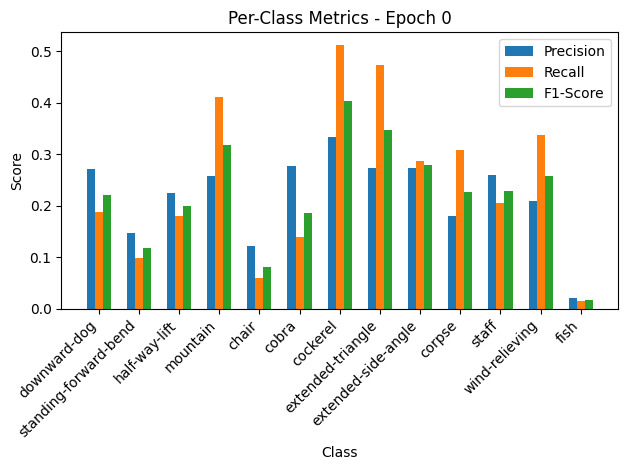


Epoch 1/50 Summary:
Train Loss: 2.3309 | Train Acc: 23.30% | Train Precision: 0.22 | Train Recall: 0.25 | Train F1: 0.22
Val Loss: 1.9607 | Val Acc: 37.67% | Val Precision: 0.42 | Val Recall: 0.40 | Val F1: 0.37
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_3.pth
Checkpoint saved at epoch 1
New best model saved! Validation Loss: 1.9607

Epoch 2/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 38.07it/s, loss=1.77, accuracy=47.5]


Per-Class Metrics for Epoch 1:
downward-dog: Precision=0.64, Recall=0.49, F1-Score=0.56
standing-forward-bend: Precision=0.62, Recall=0.46, F1-Score=0.52
half-way-lift: Precision=0.52, Recall=0.69, F1-Score=0.59
mountain: Precision=0.50, Recall=0.60, F1-Score=0.54
chair: Precision=0.19, Recall=0.14, F1-Score=0.16
cobra: Precision=0.39, Recall=0.39, F1-Score=0.39
cockerel: Precision=0.55, Recall=0.60, F1-Score=0.58
extended-triangle: Precision=0.46, Recall=0.65, F1-Score=0.54
extended-side-angle: Precision=0.36, Recall=0.33, F1-Score=0.35
corpse: Precision=0.38, Recall=0.40, F1-Score=0.39
staff: Precision=0.45, Recall=0.31, F1-Score=0.37
wind-relieving: Precision=0.46, Recall=0.75, F1-Score=0.57
fish: Precision=0.23, Recall=0.16, F1-Score=0.19


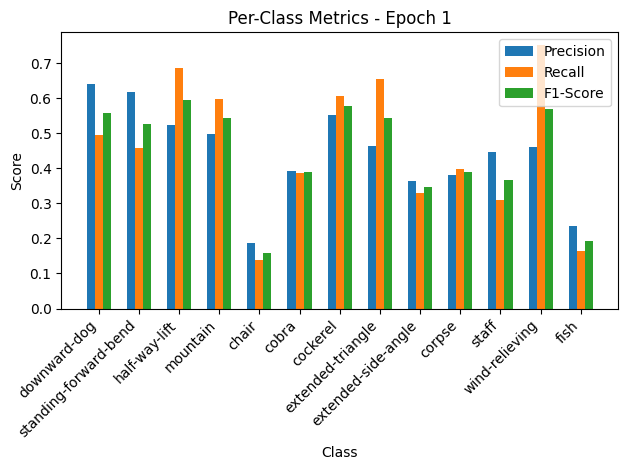

Validation: 100%|██████████| 10/10 [00:00<00:00, 178.41it/s, loss=1.34, accuracy=60.3]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 1:
downward-dog: Precision=0.64, Recall=0.49, F1-Score=0.56
standing-forward-bend: Precision=0.62, Recall=0.46, F1-Score=0.52
half-way-lift: Precision=0.52, Recall=0.69, F1-Score=0.59
mountain: Precision=0.50, Recall=0.60, F1-Score=0.54
chair: Precision=0.19, Recall=0.14, F1-Score=0.16
cobra: Precision=0.39, Recall=0.39, F1-Score=0.39
cockerel: Precision=0.55, Recall=0.60, F1-Score=0.58
extended-triangle: Precision=0.46, Recall=0.65, F1-Score=0.54
extended-side-angle: Precision=0.36, Recall=0.33, F1-Score=0.35
corpse: Precision=0.38, Recall=0.40, F1-Score=0.39
staff: Precision=0.45, Recall=0.31, F1-Score=0.37
wind-relieving: Precision=0.46, Recall=0.75, F1-Score=0.57
fish: Precision=0.23, Recall=0.16, F1-Score=0.19


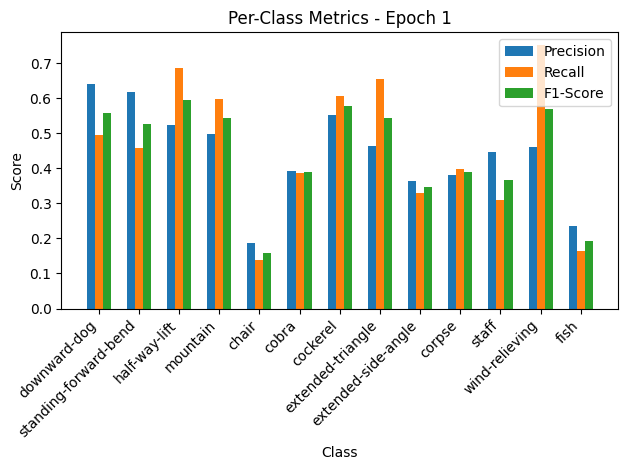


Epoch 2/50 Summary:
Train Loss: 1.7768 | Train Acc: 47.52% | Train Precision: 0.44 | Train Recall: 0.46 | Train F1: 0.44
Val Loss: 1.4673 | Val Acc: 60.27% | Val Precision: 0.60 | Val Recall: 0.55 | Val F1: 0.52
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_3.pth
Checkpoint saved at epoch 2
New best model saved! Validation Loss: 1.4673

Epoch 3/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 34.36it/s, loss=1.39, accuracy=61.3]


Per-Class Metrics for Epoch 2:
downward-dog: Precision=0.90, Recall=0.73, F1-Score=0.80
standing-forward-bend: Precision=0.82, Recall=0.60, F1-Score=0.70
half-way-lift: Precision=0.65, Recall=0.92, F1-Score=0.76
mountain: Precision=0.57, Recall=0.69, F1-Score=0.62
chair: Precision=0.47, Recall=0.28, F1-Score=0.35
cobra: Precision=0.60, Recall=0.54, F1-Score=0.57
cockerel: Precision=0.66, Recall=0.85, F1-Score=0.74
extended-triangle: Precision=0.43, Recall=0.77, F1-Score=0.55
extended-side-angle: Precision=0.39, Recall=0.15, F1-Score=0.22
corpse: Precision=0.42, Recall=0.49, F1-Score=0.45
staff: Precision=0.57, Recall=0.41, F1-Score=0.48
wind-relieving: Precision=0.60, Recall=0.76, F1-Score=0.67
fish: Precision=0.41, Recall=0.31, F1-Score=0.36


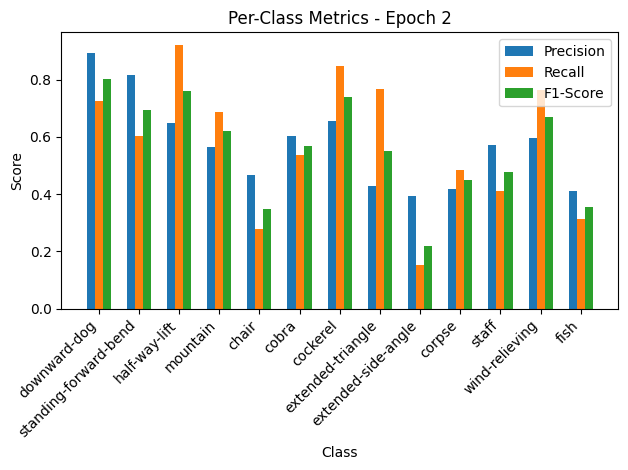

Validation: 100%|██████████| 10/10 [00:00<00:00, 168.06it/s, loss=1.04, accuracy=67.8]


Per-Class Metrics for Epoch 2:
downward-dog: Precision=0.90, Recall=0.73, F1-Score=0.80
standing-forward-bend: Precision=0.82, Recall=0.60, F1-Score=0.70
half-way-lift: Precision=0.65, Recall=0.92, F1-Score=0.76
mountain: Precision=0.57, Recall=0.69, F1-Score=0.62
chair: Precision=0.47, Recall=0.28, F1-Score=0.35
cobra: Precision=0.60, Recall=0.54, F1-Score=0.57
cockerel: Precision=0.66, Recall=0.85, F1-Score=0.74
extended-triangle: Precision=0.43, Recall=0.77, F1-Score=0.55
extended-side-angle: Precision=0.39, Recall=0.15, F1-Score=0.22
corpse: Precision=0.42, Recall=0.49, F1-Score=0.45
staff: Precision=0.57, Recall=0.41, F1-Score=0.48
wind-relieving: Precision=0.60, Recall=0.76, F1-Score=0.67
fish: Precision=0.41, Recall=0.31, F1-Score=0.36


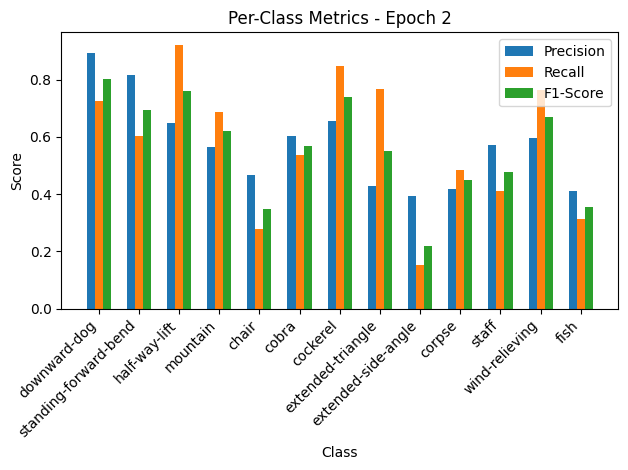


Epoch 3/50 Summary:
Train Loss: 1.3918 | Train Acc: 61.27% | Train Precision: 0.57 | Train Recall: 0.58 | Train F1: 0.56
Val Loss: 1.1446 | Val Acc: 67.81% | Val Precision: 0.69 | Val Recall: 0.66 | Val F1: 0.64
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_3.pth
Checkpoint saved at epoch 3
New best model saved! Validation Loss: 1.1446

Epoch 4/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 39.66it/s, loss=1.15, accuracy=69.4]


Per-Class Metrics for Epoch 3:
downward-dog: Precision=0.92, Recall=0.87, F1-Score=0.89
standing-forward-bend: Precision=0.95, Recall=0.65, F1-Score=0.77
half-way-lift: Precision=0.75, Recall=0.93, F1-Score=0.83
mountain: Precision=0.62, Recall=0.87, F1-Score=0.73
chair: Precision=0.71, Recall=0.45, F1-Score=0.55
cobra: Precision=0.65, Recall=0.61, F1-Score=0.63
cockerel: Precision=0.69, Recall=0.86, F1-Score=0.76
extended-triangle: Precision=0.50, Recall=0.56, F1-Score=0.53
extended-side-angle: Precision=0.49, Recall=0.42, F1-Score=0.46
corpse: Precision=0.49, Recall=0.41, F1-Score=0.45
staff: Precision=0.65, Recall=0.62, F1-Score=0.63
wind-relieving: Precision=0.70, Recall=0.74, F1-Score=0.72
fish: Precision=0.48, Recall=0.57, F1-Score=0.52


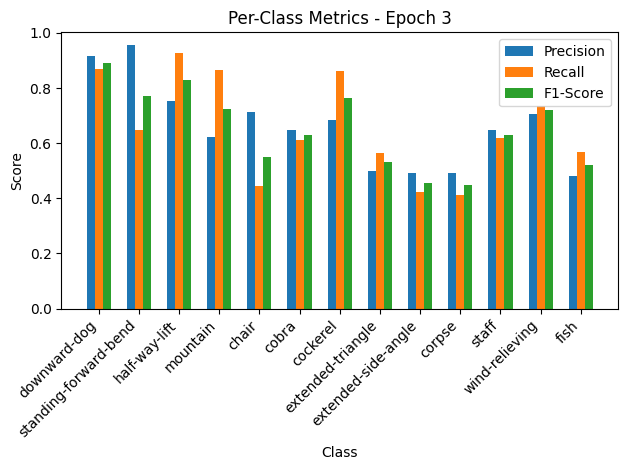

Validation: 100%|██████████| 10/10 [00:00<00:00, 153.49it/s, loss=0.855, accuracy=78.8]


Per-Class Metrics for Epoch 3:
downward-dog: Precision=0.92, Recall=0.87, F1-Score=0.89
standing-forward-bend: Precision=0.95, Recall=0.65, F1-Score=0.77
half-way-lift: Precision=0.75, Recall=0.93, F1-Score=0.83
mountain: Precision=0.62, Recall=0.87, F1-Score=0.73
chair: Precision=0.71, Recall=0.45, F1-Score=0.55
cobra: Precision=0.65, Recall=0.61, F1-Score=0.63
cockerel: Precision=0.69, Recall=0.86, F1-Score=0.76
extended-triangle: Precision=0.50, Recall=0.56, F1-Score=0.53
extended-side-angle: Precision=0.49, Recall=0.42, F1-Score=0.46
corpse: Precision=0.49, Recall=0.41, F1-Score=0.45
staff: Precision=0.65, Recall=0.62, F1-Score=0.63
wind-relieving: Precision=0.70, Recall=0.74, F1-Score=0.72
fish: Precision=0.48, Recall=0.57, F1-Score=0.52


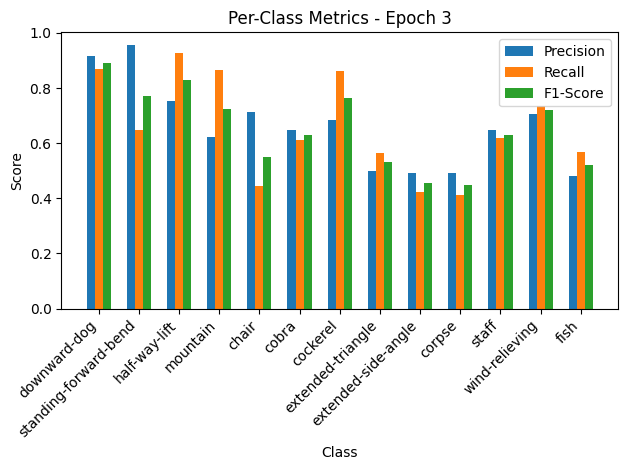


Epoch 4/50 Summary:
Train Loss: 1.1516 | Train Acc: 69.44% | Train Precision: 0.66 | Train Recall: 0.66 | Train F1: 0.65
Val Loss: 0.9368 | Val Acc: 78.77% | Val Precision: 0.78 | Val Recall: 0.77 | Val F1: 0.76
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_3.pth
Checkpoint saved at epoch 4
New best model saved! Validation Loss: 0.9368

Epoch 5/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:01<00:00, 41.32it/s, loss=0.94, accuracy=74.9]


Per-Class Metrics for Epoch 4:
downward-dog: Precision=0.91, Recall=0.88, F1-Score=0.89
standing-forward-bend: Precision=0.86, Recall=0.77, F1-Score=0.81
half-way-lift: Precision=0.79, Recall=0.84, F1-Score=0.82
mountain: Precision=0.73, Recall=0.80, F1-Score=0.76
chair: Precision=0.74, Recall=0.72, F1-Score=0.73
cobra: Precision=0.84, Recall=0.83, F1-Score=0.83
cockerel: Precision=0.77, Recall=0.88, F1-Score=0.82
extended-triangle: Precision=0.52, Recall=0.64, F1-Score=0.57
extended-side-angle: Precision=0.46, Recall=0.33, F1-Score=0.38
corpse: Precision=0.59, Recall=0.40, F1-Score=0.47
staff: Precision=0.78, Recall=0.78, F1-Score=0.78
wind-relieving: Precision=0.86, Recall=0.87, F1-Score=0.86
fish: Precision=0.49, Recall=0.64, F1-Score=0.56


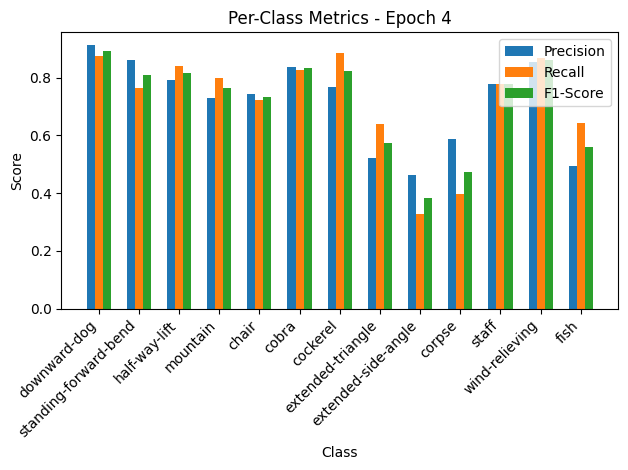

Validation: 100%|██████████| 10/10 [00:00<00:00, 157.57it/s, loss=0.663, accuracy=81.5]


Per-Class Metrics for Epoch 4:
downward-dog: Precision=0.91, Recall=0.88, F1-Score=0.89
standing-forward-bend: Precision=0.86, Recall=0.77, F1-Score=0.81
half-way-lift: Precision=0.79, Recall=0.84, F1-Score=0.82
mountain: Precision=0.73, Recall=0.80, F1-Score=0.76
chair: Precision=0.74, Recall=0.72, F1-Score=0.73
cobra: Precision=0.84, Recall=0.83, F1-Score=0.83
cockerel: Precision=0.77, Recall=0.88, F1-Score=0.82
extended-triangle: Precision=0.52, Recall=0.64, F1-Score=0.57
extended-side-angle: Precision=0.46, Recall=0.33, F1-Score=0.38
corpse: Precision=0.59, Recall=0.40, F1-Score=0.47
staff: Precision=0.78, Recall=0.78, F1-Score=0.78
wind-relieving: Precision=0.86, Recall=0.87, F1-Score=0.86
fish: Precision=0.49, Recall=0.64, F1-Score=0.56


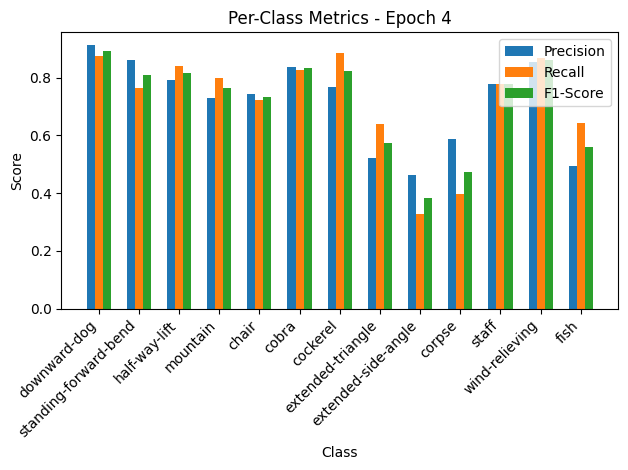


Epoch 5/50 Summary:
Train Loss: 0.9418 | Train Acc: 74.94% | Train Precision: 0.72 | Train Recall: 0.72 | Train F1: 0.72
Val Loss: 0.7261 | Val Acc: 81.51% | Val Precision: 0.83 | Val Recall: 0.81 | Val F1: 0.80
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_3.pth
Checkpoint saved at epoch 5
New best model saved! Validation Loss: 0.7261

Epoch 6/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:01<00:00, 41.30it/s, loss=0.769, accuracy=80.7]


Per-Class Metrics for Epoch 5:
downward-dog: Precision=0.95, Recall=0.85, F1-Score=0.90
standing-forward-bend: Precision=0.96, Recall=0.73, F1-Score=0.83
half-way-lift: Precision=0.76, Recall=0.95, F1-Score=0.84
mountain: Precision=0.81, Recall=0.80, F1-Score=0.81
chair: Precision=0.78, Recall=0.81, F1-Score=0.80
cobra: Precision=0.91, Recall=0.92, F1-Score=0.91
cockerel: Precision=0.78, Recall=0.97, F1-Score=0.86
extended-triangle: Precision=0.59, Recall=0.64, F1-Score=0.61
extended-side-angle: Precision=0.59, Recall=0.55, F1-Score=0.57
corpse: Precision=0.70, Recall=0.69, F1-Score=0.70
staff: Precision=0.84, Recall=0.85, F1-Score=0.85
wind-relieving: Precision=0.94, Recall=0.93, F1-Score=0.93
fish: Precision=0.70, Recall=0.63, F1-Score=0.66


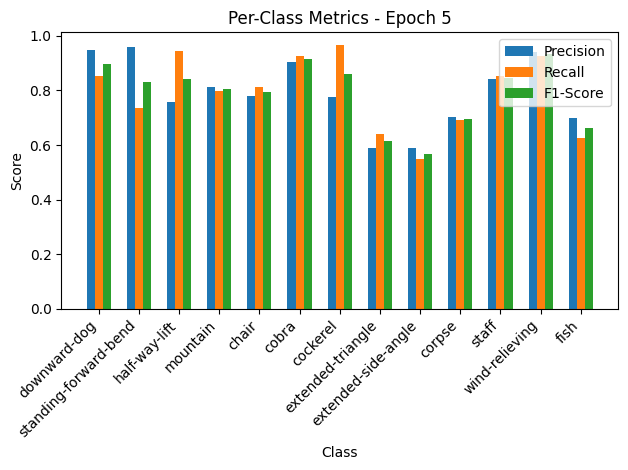

Validation: 100%|██████████| 10/10 [00:00<00:00, 148.07it/s, loss=0.61, accuracy=78.1]


Per-Class Metrics for Epoch 5:
downward-dog: Precision=0.95, Recall=0.85, F1-Score=0.90
standing-forward-bend: Precision=0.96, Recall=0.73, F1-Score=0.83
half-way-lift: Precision=0.76, Recall=0.95, F1-Score=0.84
mountain: Precision=0.81, Recall=0.80, F1-Score=0.81
chair: Precision=0.78, Recall=0.81, F1-Score=0.80
cobra: Precision=0.91, Recall=0.92, F1-Score=0.91
cockerel: Precision=0.78, Recall=0.97, F1-Score=0.86
extended-triangle: Precision=0.59, Recall=0.64, F1-Score=0.61
extended-side-angle: Precision=0.59, Recall=0.55, F1-Score=0.57
corpse: Precision=0.70, Recall=0.69, F1-Score=0.70
staff: Precision=0.84, Recall=0.85, F1-Score=0.85
wind-relieving: Precision=0.94, Recall=0.93, F1-Score=0.93
fish: Precision=0.70, Recall=0.63, F1-Score=0.66


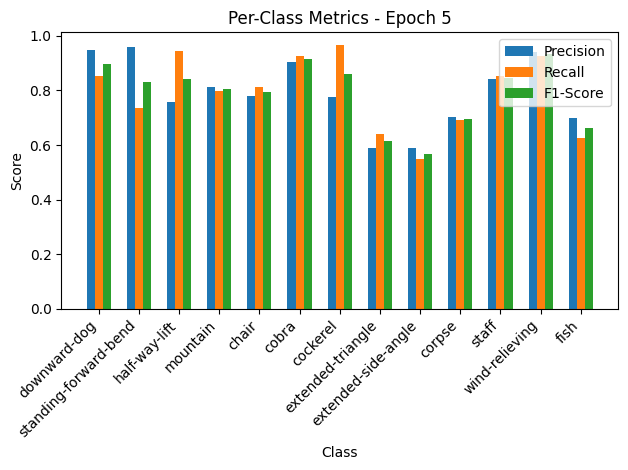


Epoch 6/50 Summary:
Train Loss: 0.7703 | Train Acc: 80.75% | Train Precision: 0.79 | Train Recall: 0.79 | Train F1: 0.79
Val Loss: 0.6680 | Val Acc: 78.08% | Val Precision: 0.81 | Val Recall: 0.77 | Val F1: 0.75
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_3.pth
Checkpoint saved at epoch 6
New best model saved! Validation Loss: 0.6680

Epoch 7/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 33.71it/s, loss=0.667, accuracy=81.8]


Per-Class Metrics for Epoch 6:
downward-dog: Precision=0.94, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=0.95, Recall=0.77, F1-Score=0.85
half-way-lift: Precision=0.78, Recall=0.91, F1-Score=0.84
mountain: Precision=0.80, Recall=0.83, F1-Score=0.81
chair: Precision=0.83, Recall=0.76, F1-Score=0.79
cobra: Precision=0.92, Recall=0.91, F1-Score=0.92
cockerel: Precision=0.81, Recall=0.94, F1-Score=0.87
extended-triangle: Precision=0.61, Recall=0.69, F1-Score=0.65
extended-side-angle: Precision=0.63, Recall=0.58, F1-Score=0.60
corpse: Precision=0.73, Recall=0.72, F1-Score=0.73
staff: Precision=0.85, Recall=0.85, F1-Score=0.85
wind-relieving: Precision=0.89, Recall=0.91, F1-Score=0.90
fish: Precision=0.68, Recall=0.67, F1-Score=0.68


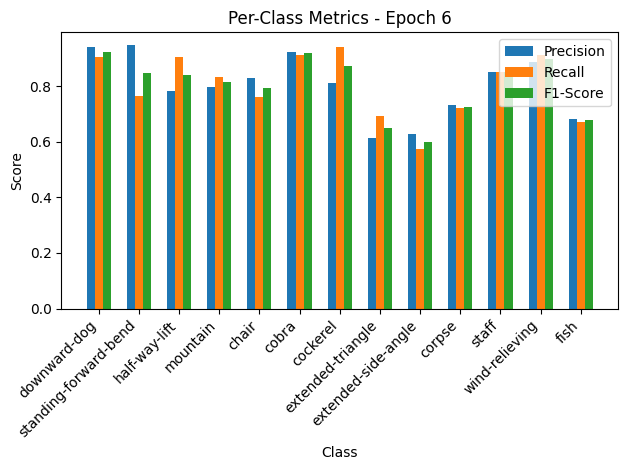

Validation: 100%|██████████| 10/10 [00:00<00:00, 142.81it/s, loss=0.528, accuracy=85.6]


Per-Class Metrics for Epoch 6:
downward-dog: Precision=0.94, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=0.95, Recall=0.77, F1-Score=0.85
half-way-lift: Precision=0.78, Recall=0.91, F1-Score=0.84
mountain: Precision=0.80, Recall=0.83, F1-Score=0.81
chair: Precision=0.83, Recall=0.76, F1-Score=0.79
cobra: Precision=0.92, Recall=0.91, F1-Score=0.92
cockerel: Precision=0.81, Recall=0.94, F1-Score=0.87
extended-triangle: Precision=0.61, Recall=0.69, F1-Score=0.65
extended-side-angle: Precision=0.63, Recall=0.58, F1-Score=0.60
corpse: Precision=0.73, Recall=0.72, F1-Score=0.73
staff: Precision=0.85, Recall=0.85, F1-Score=0.85
wind-relieving: Precision=0.89, Recall=0.91, F1-Score=0.90
fish: Precision=0.68, Recall=0.67, F1-Score=0.68


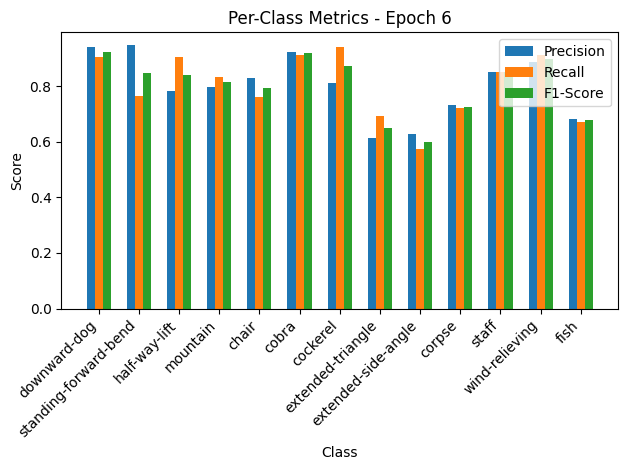


Epoch 7/50 Summary:
Train Loss: 0.6680 | Train Acc: 81.82% | Train Precision: 0.80 | Train Recall: 0.80 | Train F1: 0.80
Val Loss: 0.5785 | Val Acc: 85.62% | Val Precision: 0.86 | Val Recall: 0.85 | Val F1: 0.84
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_3.pth
Checkpoint saved at epoch 7
New best model saved! Validation Loss: 0.5785

Epoch 8/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 37.80it/s, loss=0.589, accuracy=85.5]


Per-Class Metrics for Epoch 7:
downward-dog: Precision=0.99, Recall=0.88, F1-Score=0.93
standing-forward-bend: Precision=0.96, Recall=0.81, F1-Score=0.88
half-way-lift: Precision=0.81, Recall=0.96, F1-Score=0.88
mountain: Precision=0.85, Recall=0.84, F1-Score=0.84
chair: Precision=0.82, Recall=0.82, F1-Score=0.82
cobra: Precision=0.89, Recall=0.97, F1-Score=0.93
cockerel: Precision=0.87, Recall=0.94, F1-Score=0.91
extended-triangle: Precision=0.82, Recall=0.79, F1-Score=0.81
extended-side-angle: Precision=0.77, Recall=0.79, F1-Score=0.78
corpse: Precision=0.73, Recall=0.69, F1-Score=0.71
staff: Precision=0.86, Recall=0.87, F1-Score=0.86
wind-relieving: Precision=0.91, Recall=0.91, F1-Score=0.91
fish: Precision=0.64, Recall=0.70, F1-Score=0.67


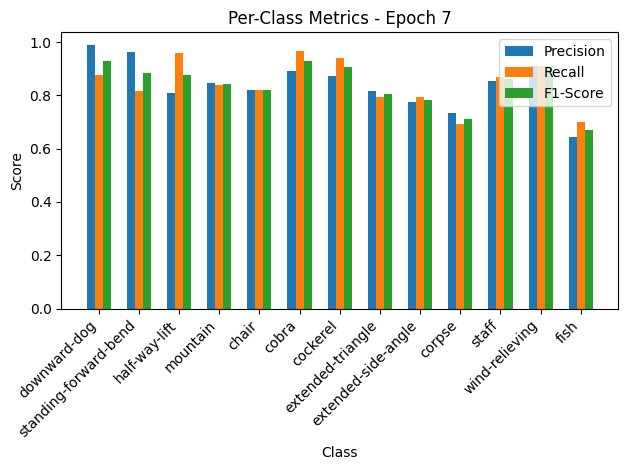

Validation: 100%|██████████| 10/10 [00:00<00:00, 169.74it/s, loss=0.399, accuracy=87.7]


Per-Class Metrics for Epoch 7:
downward-dog: Precision=0.99, Recall=0.88, F1-Score=0.93
standing-forward-bend: Precision=0.96, Recall=0.81, F1-Score=0.88
half-way-lift: Precision=0.81, Recall=0.96, F1-Score=0.88
mountain: Precision=0.85, Recall=0.84, F1-Score=0.84
chair: Precision=0.82, Recall=0.82, F1-Score=0.82
cobra: Precision=0.89, Recall=0.97, F1-Score=0.93
cockerel: Precision=0.87, Recall=0.94, F1-Score=0.91
extended-triangle: Precision=0.82, Recall=0.79, F1-Score=0.81
extended-side-angle: Precision=0.77, Recall=0.79, F1-Score=0.78
corpse: Precision=0.73, Recall=0.69, F1-Score=0.71
staff: Precision=0.86, Recall=0.87, F1-Score=0.86
wind-relieving: Precision=0.91, Recall=0.91, F1-Score=0.91
fish: Precision=0.64, Recall=0.70, F1-Score=0.67


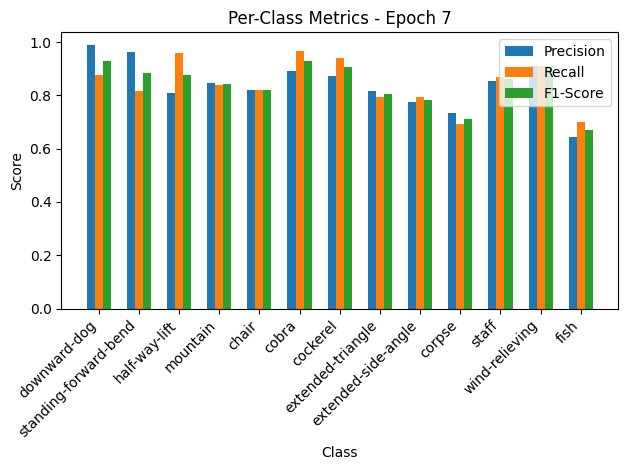


Epoch 8/50 Summary:
Train Loss: 0.5899 | Train Acc: 85.49% | Train Precision: 0.84 | Train Recall: 0.84 | Train F1: 0.84
Val Loss: 0.4371 | Val Acc: 87.67% | Val Precision: 0.89 | Val Recall: 0.86 | Val F1: 0.85
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_3.pth
Checkpoint saved at epoch 8
New best model saved! Validation Loss: 0.4371

Epoch 9/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 40.08it/s, loss=0.506, accuracy=86.4]


Per-Class Metrics for Epoch 8:
downward-dog: Precision=0.96, Recall=0.88, F1-Score=0.92
standing-forward-bend: Precision=0.95, Recall=0.78, F1-Score=0.86
half-way-lift: Precision=0.78, Recall=0.95, F1-Score=0.86
mountain: Precision=0.85, Recall=0.87, F1-Score=0.86
chair: Precision=0.88, Recall=0.86, F1-Score=0.87
cobra: Precision=0.95, Recall=0.97, F1-Score=0.96
cockerel: Precision=0.91, Recall=0.92, F1-Score=0.91
extended-triangle: Precision=0.85, Recall=0.77, F1-Score=0.81
extended-side-angle: Precision=0.76, Recall=0.86, F1-Score=0.81
corpse: Precision=0.74, Recall=0.71, F1-Score=0.72
staff: Precision=0.90, Recall=0.97, F1-Score=0.94
wind-relieving: Precision=0.94, Recall=0.96, F1-Score=0.95
fish: Precision=0.67, Recall=0.70, F1-Score=0.69


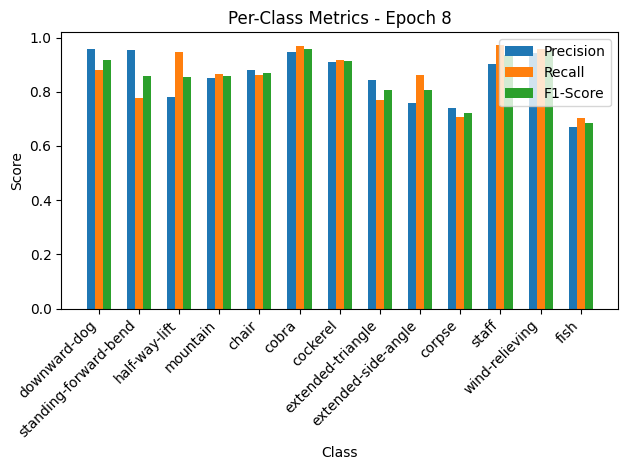

Validation: 100%|██████████| 10/10 [00:00<00:00, 186.24it/s, loss=0.37, accuracy=89]


Per-Class Metrics for Epoch 8:
downward-dog: Precision=0.96, Recall=0.88, F1-Score=0.92
standing-forward-bend: Precision=0.95, Recall=0.78, F1-Score=0.86
half-way-lift: Precision=0.78, Recall=0.95, F1-Score=0.86
mountain: Precision=0.85, Recall=0.87, F1-Score=0.86
chair: Precision=0.88, Recall=0.86, F1-Score=0.87
cobra: Precision=0.95, Recall=0.97, F1-Score=0.96
cockerel: Precision=0.91, Recall=0.92, F1-Score=0.91
extended-triangle: Precision=0.85, Recall=0.77, F1-Score=0.81
extended-side-angle: Precision=0.76, Recall=0.86, F1-Score=0.81
corpse: Precision=0.74, Recall=0.71, F1-Score=0.72
staff: Precision=0.90, Recall=0.97, F1-Score=0.94
wind-relieving: Precision=0.94, Recall=0.96, F1-Score=0.95
fish: Precision=0.67, Recall=0.70, F1-Score=0.69


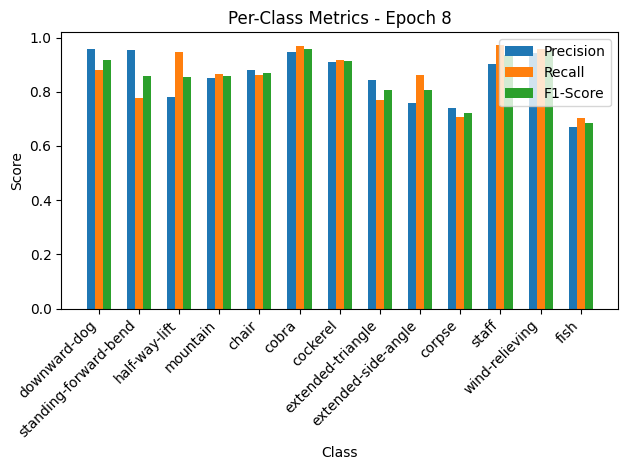


Epoch 9/50 Summary:
Train Loss: 0.5076 | Train Acc: 86.40% | Train Precision: 0.86 | Train Recall: 0.86 | Train F1: 0.86
Val Loss: 0.4052 | Val Acc: 89.04% | Val Precision: 0.91 | Val Recall: 0.89 | Val F1: 0.88
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_3.pth
Checkpoint saved at epoch 9
New best model saved! Validation Loss: 0.4052

Epoch 10/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 39.94it/s, loss=0.505, accuracy=87.2]


Per-Class Metrics for Epoch 9:
downward-dog: Precision=0.94, Recall=0.91, F1-Score=0.93
standing-forward-bend: Precision=0.92, Recall=0.76, F1-Score=0.83
half-way-lift: Precision=0.80, Recall=0.95, F1-Score=0.87
mountain: Precision=0.87, Recall=0.87, F1-Score=0.87
chair: Precision=0.88, Recall=0.89, F1-Score=0.89
cobra: Precision=0.95, Recall=0.92, F1-Score=0.93
cockerel: Precision=0.92, Recall=0.97, F1-Score=0.94
extended-triangle: Precision=0.82, Recall=0.90, F1-Score=0.86
extended-side-angle: Precision=0.88, Recall=0.84, F1-Score=0.86
corpse: Precision=0.73, Recall=0.63, F1-Score=0.68
staff: Precision=0.90, Recall=0.97, F1-Score=0.94
wind-relieving: Precision=0.92, Recall=0.96, F1-Score=0.94
fish: Precision=0.71, Recall=0.72, F1-Score=0.71


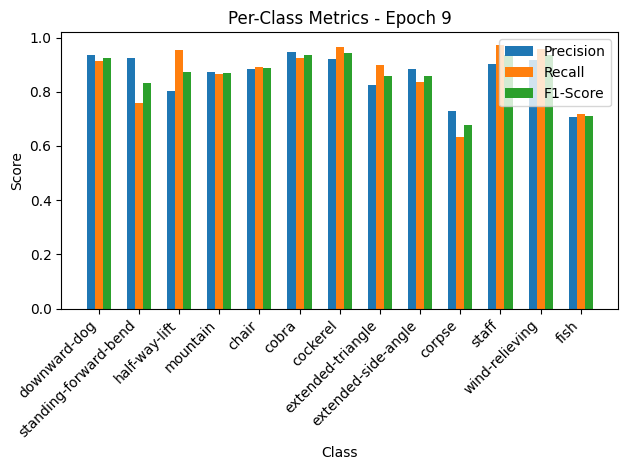

Validation: 100%|██████████| 10/10 [00:00<00:00, 164.02it/s, loss=0.355, accuracy=93.2]


Per-Class Metrics for Epoch 9:
downward-dog: Precision=0.94, Recall=0.91, F1-Score=0.93
standing-forward-bend: Precision=0.92, Recall=0.76, F1-Score=0.83
half-way-lift: Precision=0.80, Recall=0.95, F1-Score=0.87
mountain: Precision=0.87, Recall=0.87, F1-Score=0.87
chair: Precision=0.88, Recall=0.89, F1-Score=0.89
cobra: Precision=0.95, Recall=0.92, F1-Score=0.93
cockerel: Precision=0.92, Recall=0.97, F1-Score=0.94
extended-triangle: Precision=0.82, Recall=0.90, F1-Score=0.86
extended-side-angle: Precision=0.88, Recall=0.84, F1-Score=0.86
corpse: Precision=0.73, Recall=0.63, F1-Score=0.68
staff: Precision=0.90, Recall=0.97, F1-Score=0.94
wind-relieving: Precision=0.92, Recall=0.96, F1-Score=0.94
fish: Precision=0.71, Recall=0.72, F1-Score=0.71


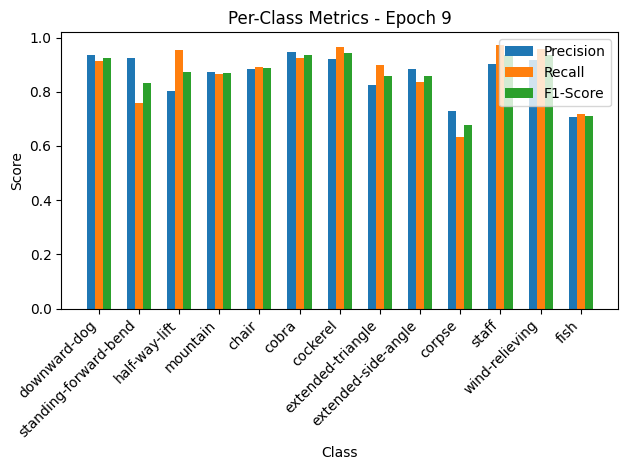


Epoch 10/50 Summary:
Train Loss: 0.5060 | Train Acc: 87.24% | Train Precision: 0.87 | Train Recall: 0.87 | Train F1: 0.86
Val Loss: 0.3891 | Val Acc: 93.15% | Val Precision: 0.94 | Val Recall: 0.93 | Val F1: 0.93
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_3.pth
Checkpoint saved at epoch 10
New best model saved! Validation Loss: 0.3891

Epoch 11/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 35.53it/s, loss=0.455, accuracy=88.2]


Per-Class Metrics for Epoch 10:
downward-dog: Precision=0.94, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=0.96, Recall=0.78, F1-Score=0.86
half-way-lift: Precision=0.81, Recall=0.93, F1-Score=0.86
mountain: Precision=0.88, Recall=0.89, F1-Score=0.88
chair: Precision=0.84, Recall=0.89, F1-Score=0.87
cobra: Precision=0.94, Recall=0.97, F1-Score=0.95
cockerel: Precision=0.87, Recall=0.91, F1-Score=0.89
extended-triangle: Precision=0.85, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.87, Recall=0.82, F1-Score=0.85
corpse: Precision=0.85, Recall=0.75, F1-Score=0.80
staff: Precision=0.90, Recall=0.94, F1-Score=0.92
wind-relieving: Precision=0.96, Recall=0.99, F1-Score=0.97
fish: Precision=0.79, Recall=0.82, F1-Score=0.80


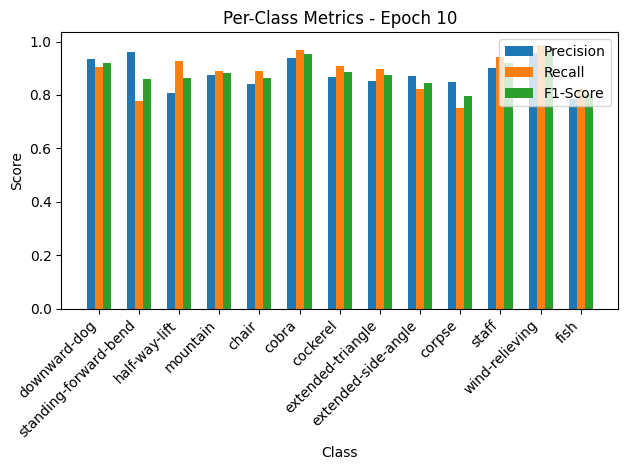

Validation: 100%|██████████| 10/10 [00:00<00:00, 181.92it/s, loss=0.329, accuracy=87.7]


Per-Class Metrics for Epoch 10:
downward-dog: Precision=0.94, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=0.96, Recall=0.78, F1-Score=0.86
half-way-lift: Precision=0.81, Recall=0.93, F1-Score=0.86
mountain: Precision=0.88, Recall=0.89, F1-Score=0.88
chair: Precision=0.84, Recall=0.89, F1-Score=0.87
cobra: Precision=0.94, Recall=0.97, F1-Score=0.95
cockerel: Precision=0.87, Recall=0.91, F1-Score=0.89
extended-triangle: Precision=0.85, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.87, Recall=0.82, F1-Score=0.85
corpse: Precision=0.85, Recall=0.75, F1-Score=0.80
staff: Precision=0.90, Recall=0.94, F1-Score=0.92
wind-relieving: Precision=0.96, Recall=0.99, F1-Score=0.97
fish: Precision=0.79, Recall=0.82, F1-Score=0.80


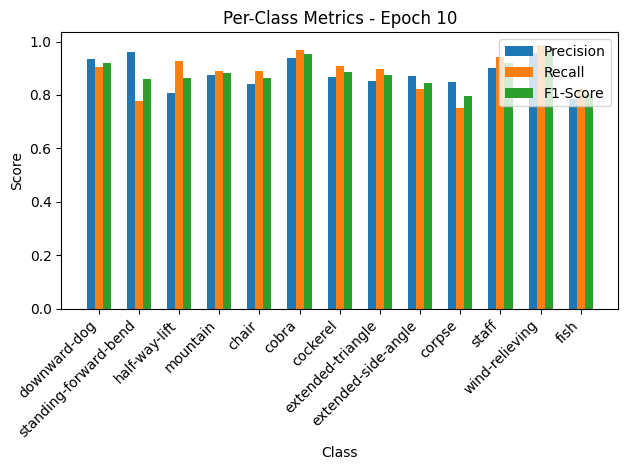


Epoch 11/50 Summary:
Train Loss: 0.4564 | Train Acc: 88.24% | Train Precision: 0.88 | Train Recall: 0.88 | Train F1: 0.88
Val Loss: 0.3600 | Val Acc: 87.67% | Val Precision: 0.91 | Val Recall: 0.89 | Val F1: 0.88
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_3.pth
Checkpoint saved at epoch 11
New best model saved! Validation Loss: 0.3600

Epoch 12/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 38.13it/s, loss=0.442, accuracy=87.5]


Per-Class Metrics for Epoch 11:
downward-dog: Precision=0.97, Recall=0.87, F1-Score=0.92
standing-forward-bend: Precision=0.96, Recall=0.80, F1-Score=0.87
half-way-lift: Precision=0.80, Recall=0.95, F1-Score=0.87
mountain: Precision=0.89, Recall=0.88, F1-Score=0.89
chair: Precision=0.85, Recall=0.87, F1-Score=0.86
cobra: Precision=0.94, Recall=0.94, F1-Score=0.94
cockerel: Precision=0.89, Recall=0.97, F1-Score=0.93
extended-triangle: Precision=0.88, Recall=0.85, F1-Score=0.86
extended-side-angle: Precision=0.83, Recall=0.92, F1-Score=0.87
corpse: Precision=0.77, Recall=0.69, F1-Score=0.73
staff: Precision=0.87, Recall=0.96, F1-Score=0.91
wind-relieving: Precision=0.93, Recall=0.93, F1-Score=0.93
fish: Precision=0.69, Recall=0.73, F1-Score=0.71


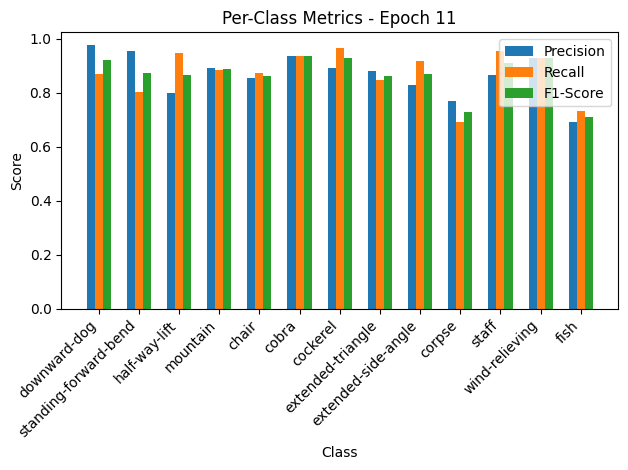

Validation: 100%|██████████| 10/10 [00:00<00:00, 147.57it/s, loss=0.339, accuracy=90.4]


Per-Class Metrics for Epoch 11:
downward-dog: Precision=0.97, Recall=0.87, F1-Score=0.92
standing-forward-bend: Precision=0.96, Recall=0.80, F1-Score=0.87
half-way-lift: Precision=0.80, Recall=0.95, F1-Score=0.87
mountain: Precision=0.89, Recall=0.88, F1-Score=0.89
chair: Precision=0.85, Recall=0.87, F1-Score=0.86
cobra: Precision=0.94, Recall=0.94, F1-Score=0.94
cockerel: Precision=0.89, Recall=0.97, F1-Score=0.93
extended-triangle: Precision=0.88, Recall=0.85, F1-Score=0.86
extended-side-angle: Precision=0.83, Recall=0.92, F1-Score=0.87
corpse: Precision=0.77, Recall=0.69, F1-Score=0.73
staff: Precision=0.87, Recall=0.96, F1-Score=0.91
wind-relieving: Precision=0.93, Recall=0.93, F1-Score=0.93
fish: Precision=0.69, Recall=0.73, F1-Score=0.71


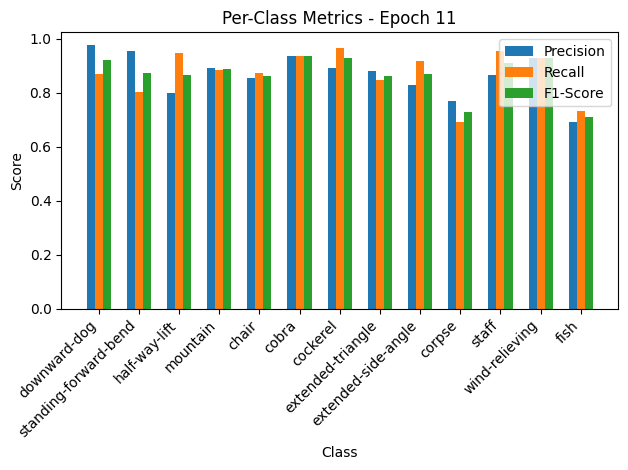


Epoch 12/50 Summary:
Train Loss: 0.4430 | Train Acc: 87.47% | Train Precision: 0.87 | Train Recall: 0.87 | Train F1: 0.87
Val Loss: 0.3714 | Val Acc: 90.41% | Val Precision: 0.91 | Val Recall: 0.90 | Val F1: 0.90

Epoch 13/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:01<00:00, 41.51it/s, loss=0.465, accuracy=86.2]


Per-Class Metrics for Epoch 12:
downward-dog: Precision=0.96, Recall=0.89, F1-Score=0.92
standing-forward-bend: Precision=0.93, Recall=0.77, F1-Score=0.84
half-way-lift: Precision=0.81, Recall=0.94, F1-Score=0.87
mountain: Precision=0.83, Recall=0.90, F1-Score=0.86
chair: Precision=0.84, Recall=0.79, F1-Score=0.82
cobra: Precision=0.92, Recall=0.94, F1-Score=0.93
cockerel: Precision=0.83, Recall=0.92, F1-Score=0.87
extended-triangle: Precision=0.89, Recall=0.94, F1-Score=0.91
extended-side-angle: Precision=0.92, Recall=0.89, F1-Score=0.90
corpse: Precision=0.71, Recall=0.68, F1-Score=0.69
staff: Precision=0.84, Recall=0.93, F1-Score=0.88
wind-relieving: Precision=0.94, Recall=0.88, F1-Score=0.91
fish: Precision=0.69, Recall=0.69, F1-Score=0.69


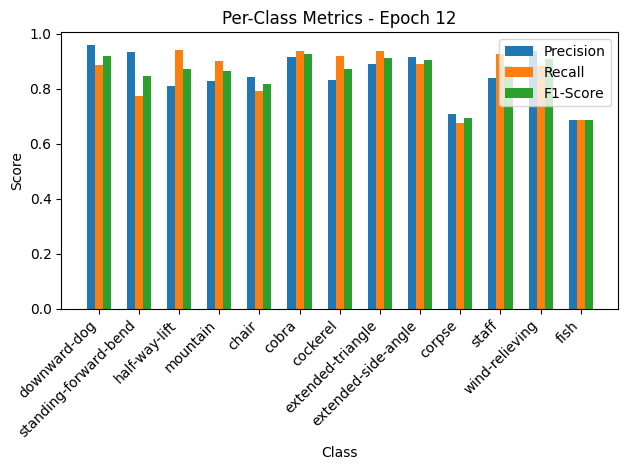

Validation: 100%|██████████| 10/10 [00:00<00:00, 178.40it/s, loss=0.451, accuracy=88.4]


Per-Class Metrics for Epoch 12:
downward-dog: Precision=0.96, Recall=0.89, F1-Score=0.92
standing-forward-bend: Precision=0.93, Recall=0.77, F1-Score=0.84
half-way-lift: Precision=0.81, Recall=0.94, F1-Score=0.87
mountain: Precision=0.83, Recall=0.90, F1-Score=0.86
chair: Precision=0.84, Recall=0.79, F1-Score=0.82
cobra: Precision=0.92, Recall=0.94, F1-Score=0.93
cockerel: Precision=0.83, Recall=0.92, F1-Score=0.87
extended-triangle: Precision=0.89, Recall=0.94, F1-Score=0.91
extended-side-angle: Precision=0.92, Recall=0.89, F1-Score=0.90
corpse: Precision=0.71, Recall=0.68, F1-Score=0.69
staff: Precision=0.84, Recall=0.93, F1-Score=0.88
wind-relieving: Precision=0.94, Recall=0.88, F1-Score=0.91
fish: Precision=0.69, Recall=0.69, F1-Score=0.69


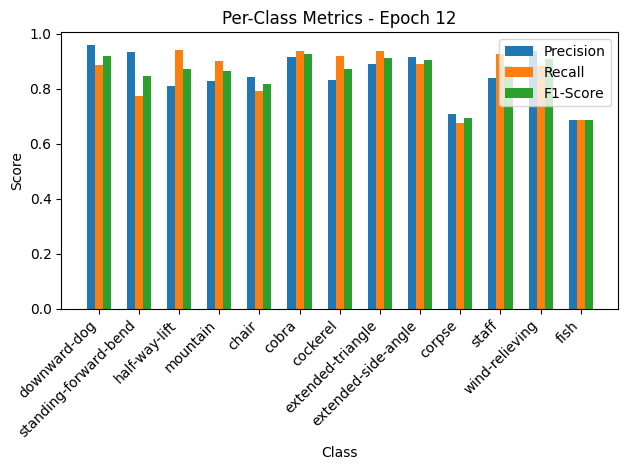


Epoch 13/50 Summary:
Train Loss: 0.4660 | Train Acc: 86.17% | Train Precision: 0.85 | Train Recall: 0.86 | Train F1: 0.85
Val Loss: 0.4947 | Val Acc: 88.36% | Val Precision: 0.91 | Val Recall: 0.89 | Val F1: 0.89

Epoch 14/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 39.17it/s, loss=0.397, accuracy=89.2]


Per-Class Metrics for Epoch 13:
downward-dog: Precision=0.97, Recall=0.90, F1-Score=0.94
standing-forward-bend: Precision=0.95, Recall=0.81, F1-Score=0.87
half-way-lift: Precision=0.83, Recall=0.95, F1-Score=0.89
mountain: Precision=0.89, Recall=0.87, F1-Score=0.88
chair: Precision=0.84, Recall=0.90, F1-Score=0.87
cobra: Precision=0.95, Recall=0.96, F1-Score=0.95
cockerel: Precision=0.91, Recall=1.00, F1-Score=0.95
extended-triangle: Precision=0.89, Recall=0.87, F1-Score=0.88
extended-side-angle: Precision=0.88, Recall=0.89, F1-Score=0.88
corpse: Precision=0.86, Recall=0.65, F1-Score=0.74
staff: Precision=0.94, Recall=0.97, F1-Score=0.96
wind-relieving: Precision=0.97, Recall=0.93, F1-Score=0.95
fish: Precision=0.70, Recall=0.88, F1-Score=0.78


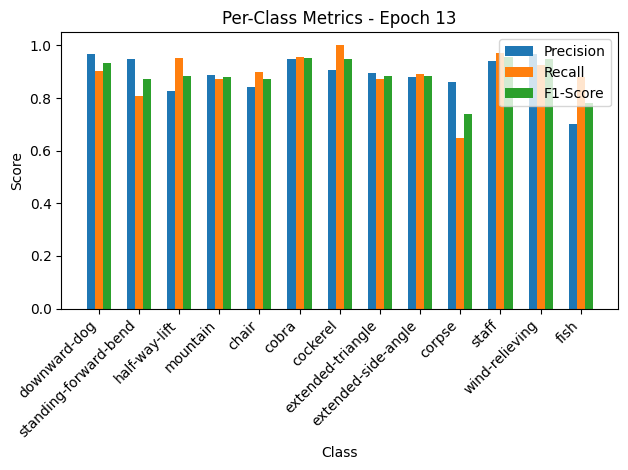

Validation: 100%|██████████| 10/10 [00:00<00:00, 185.71it/s, loss=0.367, accuracy=85.6]


Per-Class Metrics for Epoch 13:
downward-dog: Precision=0.97, Recall=0.90, F1-Score=0.94
standing-forward-bend: Precision=0.95, Recall=0.81, F1-Score=0.87
half-way-lift: Precision=0.83, Recall=0.95, F1-Score=0.89
mountain: Precision=0.89, Recall=0.87, F1-Score=0.88
chair: Precision=0.84, Recall=0.90, F1-Score=0.87
cobra: Precision=0.95, Recall=0.96, F1-Score=0.95
cockerel: Precision=0.91, Recall=1.00, F1-Score=0.95
extended-triangle: Precision=0.89, Recall=0.87, F1-Score=0.88
extended-side-angle: Precision=0.88, Recall=0.89, F1-Score=0.88
corpse: Precision=0.86, Recall=0.65, F1-Score=0.74
staff: Precision=0.94, Recall=0.97, F1-Score=0.96
wind-relieving: Precision=0.97, Recall=0.93, F1-Score=0.95
fish: Precision=0.70, Recall=0.88, F1-Score=0.78


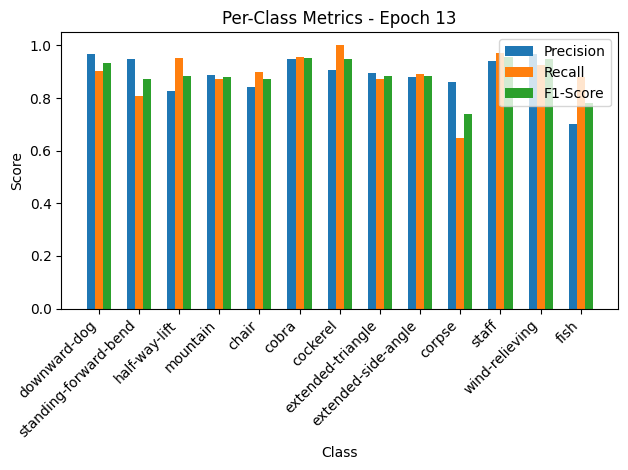


Epoch 14/50 Summary:
Train Loss: 0.3982 | Train Acc: 89.23% | Train Precision: 0.89 | Train Recall: 0.89 | Train F1: 0.89
Val Loss: 0.4024 | Val Acc: 85.62% | Val Precision: 0.87 | Val Recall: 0.86 | Val F1: 0.85

Epoch 15/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 36.91it/s, loss=0.394, accuracy=88.2]


Per-Class Metrics for Epoch 14:
downward-dog: Precision=0.94, Recall=0.87, F1-Score=0.91
standing-forward-bend: Precision=0.96, Recall=0.81, F1-Score=0.88
half-way-lift: Precision=0.81, Recall=0.92, F1-Score=0.86
mountain: Precision=0.89, Recall=0.86, F1-Score=0.87
chair: Precision=0.80, Recall=0.88, F1-Score=0.84
cobra: Precision=0.95, Recall=0.96, F1-Score=0.95
cockerel: Precision=0.89, Recall=0.97, F1-Score=0.93
extended-triangle: Precision=0.91, Recall=0.92, F1-Score=0.92
extended-side-angle: Precision=0.90, Recall=0.90, F1-Score=0.90
corpse: Precision=0.82, Recall=0.68, F1-Score=0.74
staff: Precision=0.88, Recall=0.99, F1-Score=0.93
wind-relieving: Precision=0.95, Recall=0.93, F1-Score=0.94
fish: Precision=0.71, Recall=0.81, F1-Score=0.76


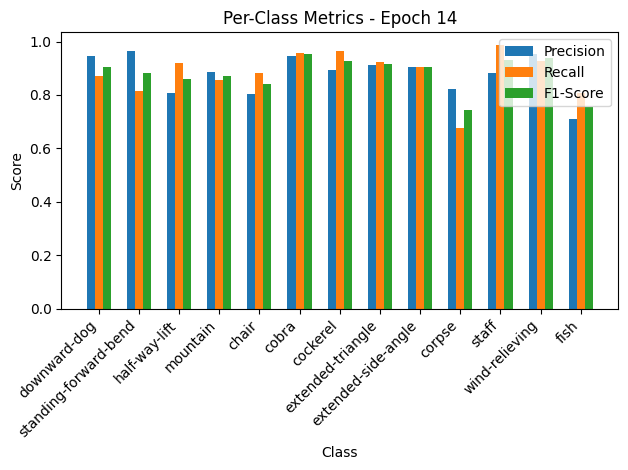

Validation: 100%|██████████| 10/10 [00:00<00:00, 127.60it/s, loss=0.364, accuracy=86.3]


Per-Class Metrics for Epoch 14:
downward-dog: Precision=0.94, Recall=0.87, F1-Score=0.91
standing-forward-bend: Precision=0.96, Recall=0.81, F1-Score=0.88
half-way-lift: Precision=0.81, Recall=0.92, F1-Score=0.86
mountain: Precision=0.89, Recall=0.86, F1-Score=0.87
chair: Precision=0.80, Recall=0.88, F1-Score=0.84
cobra: Precision=0.95, Recall=0.96, F1-Score=0.95
cockerel: Precision=0.89, Recall=0.97, F1-Score=0.93
extended-triangle: Precision=0.91, Recall=0.92, F1-Score=0.92
extended-side-angle: Precision=0.90, Recall=0.90, F1-Score=0.90
corpse: Precision=0.82, Recall=0.68, F1-Score=0.74
staff: Precision=0.88, Recall=0.99, F1-Score=0.93
wind-relieving: Precision=0.95, Recall=0.93, F1-Score=0.94
fish: Precision=0.71, Recall=0.81, F1-Score=0.76


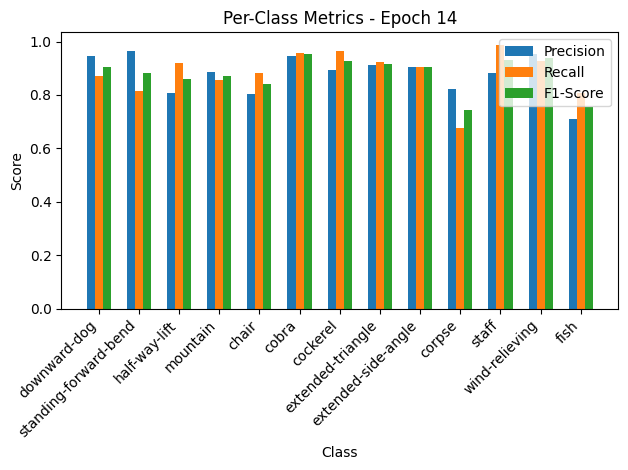


Epoch 15/50 Summary:
Train Loss: 0.3945 | Train Acc: 88.16% | Train Precision: 0.88 | Train Recall: 0.88 | Train F1: 0.88
Val Loss: 0.3984 | Val Acc: 86.30% | Val Precision: 0.89 | Val Recall: 0.87 | Val F1: 0.84

Epoch 16/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 33.99it/s, loss=0.352, accuracy=89.5]


Per-Class Metrics for Epoch 15:
downward-dog: Precision=0.95, Recall=0.88, F1-Score=0.91
standing-forward-bend: Precision=0.99, Recall=0.81, F1-Score=0.89
half-way-lift: Precision=0.81, Recall=0.97, F1-Score=0.88
mountain: Precision=0.86, Recall=0.92, F1-Score=0.89
chair: Precision=0.91, Recall=0.86, F1-Score=0.88
cobra: Precision=0.94, Recall=0.96, F1-Score=0.95
cockerel: Precision=0.92, Recall=0.95, F1-Score=0.94
extended-triangle: Precision=0.93, Recall=0.90, F1-Score=0.92
extended-side-angle: Precision=0.87, Recall=0.95, F1-Score=0.91
corpse: Precision=0.79, Recall=0.74, F1-Score=0.76
staff: Precision=0.91, Recall=0.99, F1-Score=0.94
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.75, Recall=0.76, F1-Score=0.76


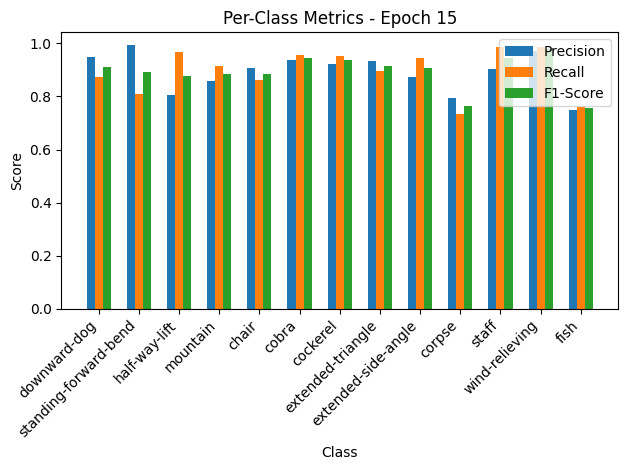

Validation: 100%|██████████| 10/10 [00:00<00:00, 181.72it/s, loss=0.284, accuracy=89.7]


Per-Class Metrics for Epoch 15:
downward-dog: Precision=0.95, Recall=0.88, F1-Score=0.91
standing-forward-bend: Precision=0.99, Recall=0.81, F1-Score=0.89
half-way-lift: Precision=0.81, Recall=0.97, F1-Score=0.88
mountain: Precision=0.86, Recall=0.92, F1-Score=0.89
chair: Precision=0.91, Recall=0.86, F1-Score=0.88
cobra: Precision=0.94, Recall=0.96, F1-Score=0.95
cockerel: Precision=0.92, Recall=0.95, F1-Score=0.94
extended-triangle: Precision=0.93, Recall=0.90, F1-Score=0.92
extended-side-angle: Precision=0.87, Recall=0.95, F1-Score=0.91
corpse: Precision=0.79, Recall=0.74, F1-Score=0.76
staff: Precision=0.91, Recall=0.99, F1-Score=0.94
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.75, Recall=0.76, F1-Score=0.76


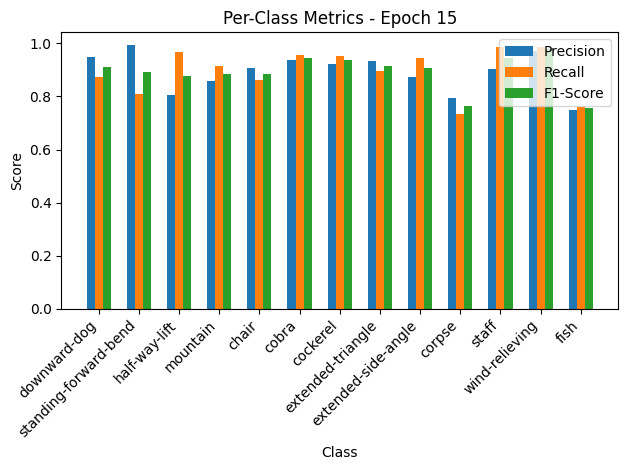


Epoch 16/50 Summary:
Train Loss: 0.3524 | Train Acc: 89.46% | Train Precision: 0.89 | Train Recall: 0.90 | Train F1: 0.89
Val Loss: 0.3107 | Val Acc: 89.73% | Val Precision: 0.91 | Val Recall: 0.89 | Val F1: 0.89
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_3.pth
Checkpoint saved at epoch 16
New best model saved! Validation Loss: 0.3107

Epoch 17/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 40.98it/s, loss=0.378, accuracy=88.3]


Per-Class Metrics for Epoch 16:
downward-dog: Precision=0.94, Recall=0.92, F1-Score=0.93
standing-forward-bend: Precision=0.93, Recall=0.80, F1-Score=0.86
half-way-lift: Precision=0.81, Recall=0.91, F1-Score=0.86
mountain: Precision=0.86, Recall=0.91, F1-Score=0.88
chair: Precision=0.91, Recall=0.86, F1-Score=0.88
cobra: Precision=0.95, Recall=0.94, F1-Score=0.94
cockerel: Precision=0.93, Recall=0.98, F1-Score=0.95
extended-triangle: Precision=0.90, Recall=0.88, F1-Score=0.89
extended-side-angle: Precision=0.88, Recall=0.88, F1-Score=0.88
corpse: Precision=0.79, Recall=0.76, F1-Score=0.78
staff: Precision=0.91, Recall=0.93, F1-Score=0.92
wind-relieving: Precision=0.93, Recall=0.93, F1-Score=0.93
fish: Precision=0.73, Recall=0.76, F1-Score=0.74


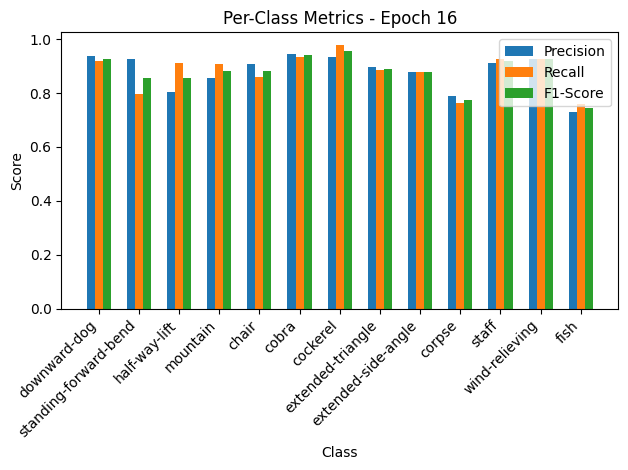

Validation: 100%|██████████| 10/10 [00:00<00:00, 174.89it/s, loss=0.357, accuracy=85.6]


Per-Class Metrics for Epoch 16:
downward-dog: Precision=0.94, Recall=0.92, F1-Score=0.93
standing-forward-bend: Precision=0.93, Recall=0.80, F1-Score=0.86
half-way-lift: Precision=0.81, Recall=0.91, F1-Score=0.86
mountain: Precision=0.86, Recall=0.91, F1-Score=0.88
chair: Precision=0.91, Recall=0.86, F1-Score=0.88
cobra: Precision=0.95, Recall=0.94, F1-Score=0.94
cockerel: Precision=0.93, Recall=0.98, F1-Score=0.95
extended-triangle: Precision=0.90, Recall=0.88, F1-Score=0.89
extended-side-angle: Precision=0.88, Recall=0.88, F1-Score=0.88
corpse: Precision=0.79, Recall=0.76, F1-Score=0.78
staff: Precision=0.91, Recall=0.93, F1-Score=0.92
wind-relieving: Precision=0.93, Recall=0.93, F1-Score=0.93
fish: Precision=0.73, Recall=0.76, F1-Score=0.74


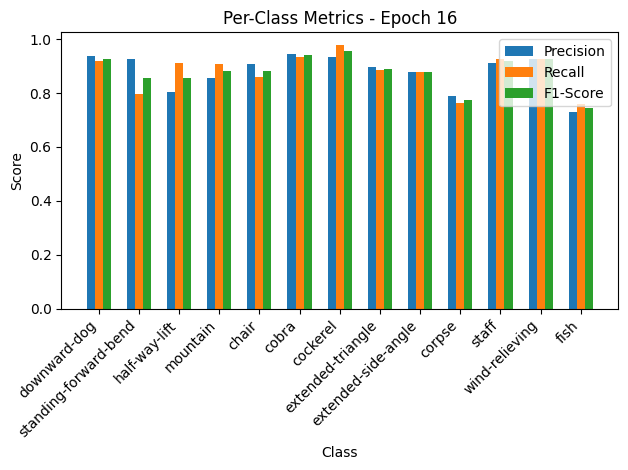


Epoch 17/50 Summary:
Train Loss: 0.3792 | Train Acc: 88.31% | Train Precision: 0.88 | Train Recall: 0.88 | Train F1: 0.88
Val Loss: 0.3908 | Val Acc: 85.62% | Val Precision: 0.88 | Val Recall: 0.87 | Val F1: 0.86

Epoch 18/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:01<00:00, 41.66it/s, loss=0.359, accuracy=89.8]


Per-Class Metrics for Epoch 17:
downward-dog: Precision=0.99, Recall=0.91, F1-Score=0.95
standing-forward-bend: Precision=0.97, Recall=0.83, F1-Score=0.89
half-way-lift: Precision=0.81, Recall=0.96, F1-Score=0.88
mountain: Precision=0.90, Recall=0.93, F1-Score=0.92
chair: Precision=0.91, Recall=0.89, F1-Score=0.90
cobra: Precision=0.95, Recall=0.96, F1-Score=0.95
cockerel: Precision=0.87, Recall=0.98, F1-Score=0.92
extended-triangle: Precision=0.96, Recall=0.83, F1-Score=0.89
extended-side-angle: Precision=0.90, Recall=0.95, F1-Score=0.92
corpse: Precision=0.78, Recall=0.75, F1-Score=0.77
staff: Precision=0.88, Recall=0.97, F1-Score=0.92
wind-relieving: Precision=0.94, Recall=0.91, F1-Score=0.93
fish: Precision=0.75, Recall=0.76, F1-Score=0.76


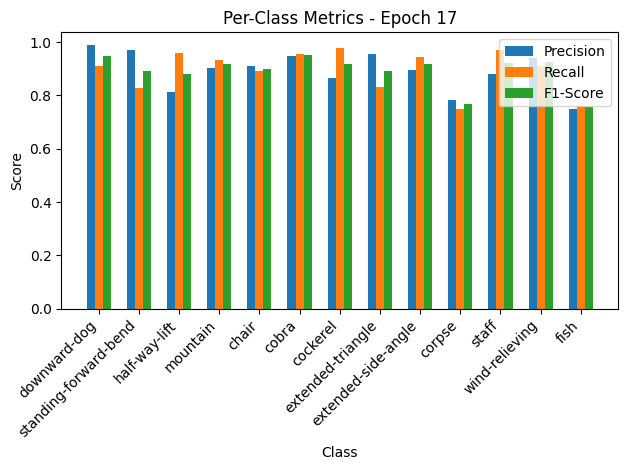

Validation: 100%|██████████| 10/10 [00:00<00:00, 145.74it/s, loss=0.357, accuracy=84.9]


Per-Class Metrics for Epoch 17:
downward-dog: Precision=0.99, Recall=0.91, F1-Score=0.95
standing-forward-bend: Precision=0.97, Recall=0.83, F1-Score=0.89
half-way-lift: Precision=0.81, Recall=0.96, F1-Score=0.88
mountain: Precision=0.90, Recall=0.93, F1-Score=0.92
chair: Precision=0.91, Recall=0.89, F1-Score=0.90
cobra: Precision=0.95, Recall=0.96, F1-Score=0.95
cockerel: Precision=0.87, Recall=0.98, F1-Score=0.92
extended-triangle: Precision=0.96, Recall=0.83, F1-Score=0.89
extended-side-angle: Precision=0.90, Recall=0.95, F1-Score=0.92
corpse: Precision=0.78, Recall=0.75, F1-Score=0.77
staff: Precision=0.88, Recall=0.97, F1-Score=0.92
wind-relieving: Precision=0.94, Recall=0.91, F1-Score=0.93
fish: Precision=0.75, Recall=0.76, F1-Score=0.76


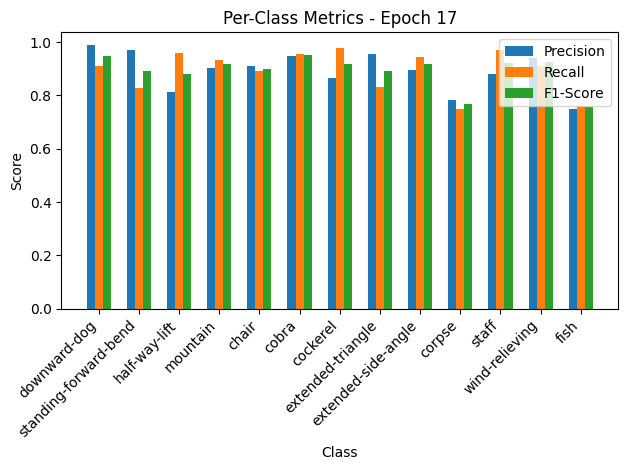


Epoch 18/50 Summary:
Train Loss: 0.3601 | Train Acc: 89.84% | Train Precision: 0.89 | Train Recall: 0.89 | Train F1: 0.89
Val Loss: 0.3908 | Val Acc: 84.93% | Val Precision: 0.86 | Val Recall: 0.85 | Val F1: 0.84

Epoch 19/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 40.37it/s, loss=0.362, accuracy=89.3]


Per-Class Metrics for Epoch 18:
downward-dog: Precision=0.96, Recall=0.92, F1-Score=0.94
standing-forward-bend: Precision=0.94, Recall=0.84, F1-Score=0.89
half-way-lift: Precision=0.83, Recall=0.93, F1-Score=0.88
mountain: Precision=0.91, Recall=0.94, F1-Score=0.93
chair: Precision=0.86, Recall=0.88, F1-Score=0.87
cobra: Precision=0.92, Recall=0.90, F1-Score=0.91
cockerel: Precision=0.90, Recall=0.97, F1-Score=0.93
extended-triangle: Precision=0.94, Recall=0.92, F1-Score=0.93
extended-side-angle: Precision=0.93, Recall=0.93, F1-Score=0.93
corpse: Precision=0.76, Recall=0.76, F1-Score=0.76
staff: Precision=0.86, Recall=0.88, F1-Score=0.87
wind-relieving: Precision=0.93, Recall=0.91, F1-Score=0.92
fish: Precision=0.75, Recall=0.73, F1-Score=0.74


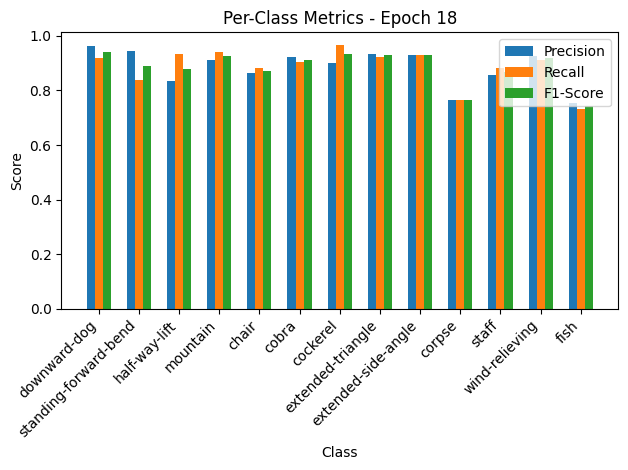

Validation: 100%|██████████| 10/10 [00:00<00:00, 167.80it/s, loss=0.465, accuracy=82.9]


Per-Class Metrics for Epoch 18:
downward-dog: Precision=0.96, Recall=0.92, F1-Score=0.94
standing-forward-bend: Precision=0.94, Recall=0.84, F1-Score=0.89
half-way-lift: Precision=0.83, Recall=0.93, F1-Score=0.88
mountain: Precision=0.91, Recall=0.94, F1-Score=0.93
chair: Precision=0.86, Recall=0.88, F1-Score=0.87
cobra: Precision=0.92, Recall=0.90, F1-Score=0.91
cockerel: Precision=0.90, Recall=0.97, F1-Score=0.93
extended-triangle: Precision=0.94, Recall=0.92, F1-Score=0.93
extended-side-angle: Precision=0.93, Recall=0.93, F1-Score=0.93
corpse: Precision=0.76, Recall=0.76, F1-Score=0.76
staff: Precision=0.86, Recall=0.88, F1-Score=0.87
wind-relieving: Precision=0.93, Recall=0.91, F1-Score=0.92
fish: Precision=0.75, Recall=0.73, F1-Score=0.74


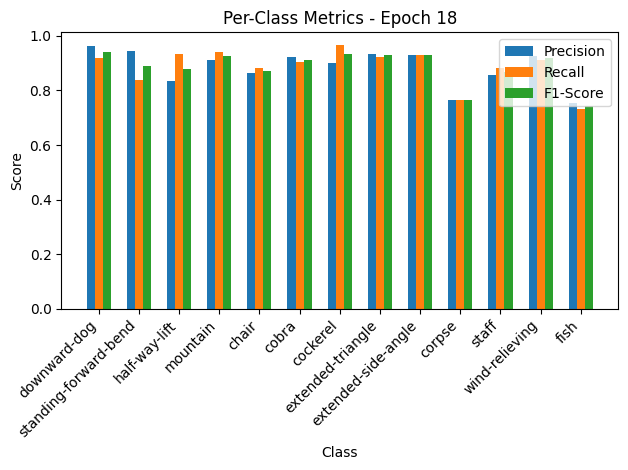


Epoch 19/50 Summary:
Train Loss: 0.3629 | Train Acc: 89.30% | Train Precision: 0.89 | Train Recall: 0.89 | Train F1: 0.89
Val Loss: 0.5096 | Val Acc: 82.88% | Val Precision: 0.85 | Val Recall: 0.83 | Val F1: 0.81

Epoch 20/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 35.78it/s, loss=0.351, accuracy=89.7]


Per-Class Metrics for Epoch 19:
downward-dog: Precision=0.96, Recall=0.90, F1-Score=0.93
standing-forward-bend: Precision=0.89, Recall=0.83, F1-Score=0.86
half-way-lift: Precision=0.85, Recall=0.93, F1-Score=0.89
mountain: Precision=0.92, Recall=0.92, F1-Score=0.92
chair: Precision=0.88, Recall=0.89, F1-Score=0.89
cobra: Precision=0.97, Recall=0.96, F1-Score=0.96
cockerel: Precision=0.90, Recall=0.97, F1-Score=0.93
extended-triangle: Precision=0.95, Recall=0.92, F1-Score=0.94
extended-side-angle: Precision=0.92, Recall=0.96, F1-Score=0.94
corpse: Precision=0.82, Recall=0.69, F1-Score=0.75
staff: Precision=0.88, Recall=0.97, F1-Score=0.92
wind-relieving: Precision=0.94, Recall=0.93, F1-Score=0.93
fish: Precision=0.73, Recall=0.81, F1-Score=0.77


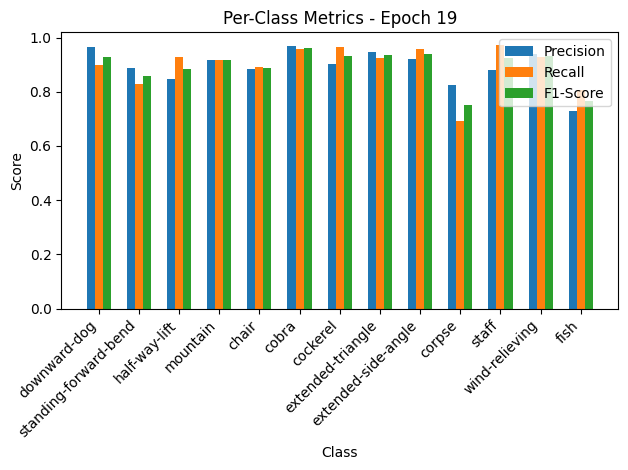

Validation: 100%|██████████| 10/10 [00:00<00:00, 93.38it/s, loss=0.282, accuracy=89.7]


Per-Class Metrics for Epoch 19:
downward-dog: Precision=0.96, Recall=0.90, F1-Score=0.93
standing-forward-bend: Precision=0.89, Recall=0.83, F1-Score=0.86
half-way-lift: Precision=0.85, Recall=0.93, F1-Score=0.89
mountain: Precision=0.92, Recall=0.92, F1-Score=0.92
chair: Precision=0.88, Recall=0.89, F1-Score=0.89
cobra: Precision=0.97, Recall=0.96, F1-Score=0.96
cockerel: Precision=0.90, Recall=0.97, F1-Score=0.93
extended-triangle: Precision=0.95, Recall=0.92, F1-Score=0.94
extended-side-angle: Precision=0.92, Recall=0.96, F1-Score=0.94
corpse: Precision=0.82, Recall=0.69, F1-Score=0.75
staff: Precision=0.88, Recall=0.97, F1-Score=0.92
wind-relieving: Precision=0.94, Recall=0.93, F1-Score=0.93
fish: Precision=0.73, Recall=0.81, F1-Score=0.77


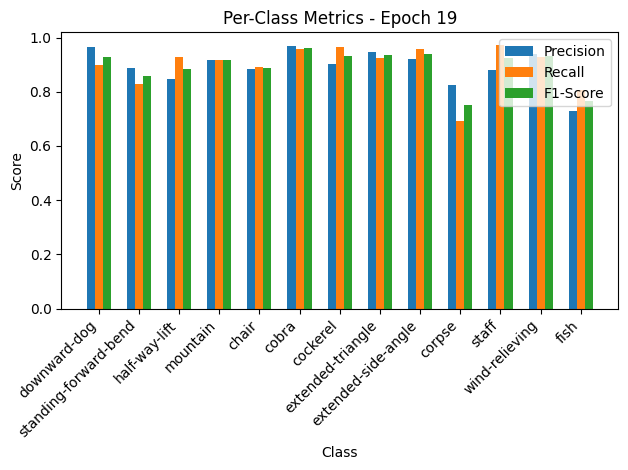


Epoch 20/50 Summary:
Train Loss: 0.3521 | Train Acc: 89.69% | Train Precision: 0.89 | Train Recall: 0.90 | Train F1: 0.89
Val Loss: 0.3092 | Val Acc: 89.73% | Val Precision: 0.90 | Val Recall: 0.90 | Val F1: 0.90
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_3.pth
Checkpoint saved at epoch 20
New best model saved! Validation Loss: 0.3092

Epoch 21/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 38.00it/s, loss=0.355, accuracy=89.7]


Per-Class Metrics for Epoch 20:
downward-dog: Precision=0.96, Recall=0.93, F1-Score=0.95
standing-forward-bend: Precision=0.94, Recall=0.87, F1-Score=0.90
half-way-lift: Precision=0.86, Recall=0.93, F1-Score=0.89
mountain: Precision=0.90, Recall=0.91, F1-Score=0.90
chair: Precision=0.88, Recall=0.88, F1-Score=0.88
cobra: Precision=0.93, Recall=0.96, F1-Score=0.94
cockerel: Precision=0.93, Recall=0.93, F1-Score=0.93
extended-triangle: Precision=0.89, Recall=0.87, F1-Score=0.88
extended-side-angle: Precision=0.89, Recall=0.88, F1-Score=0.88
corpse: Precision=0.72, Recall=0.76, F1-Score=0.74
staff: Precision=0.92, Recall=0.97, F1-Score=0.94
wind-relieving: Precision=0.97, Recall=0.93, F1-Score=0.95
fish: Precision=0.76, Recall=0.75, F1-Score=0.75


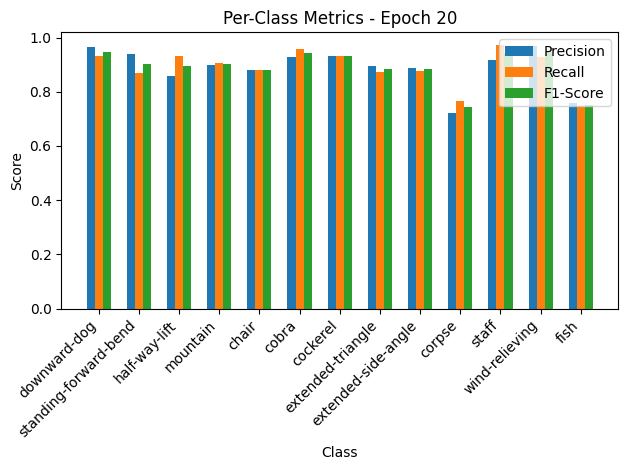

Validation: 100%|██████████| 10/10 [00:00<00:00, 156.46it/s, loss=0.337, accuracy=86.3]


Per-Class Metrics for Epoch 20:
downward-dog: Precision=0.96, Recall=0.93, F1-Score=0.95
standing-forward-bend: Precision=0.94, Recall=0.87, F1-Score=0.90
half-way-lift: Precision=0.86, Recall=0.93, F1-Score=0.89
mountain: Precision=0.90, Recall=0.91, F1-Score=0.90
chair: Precision=0.88, Recall=0.88, F1-Score=0.88
cobra: Precision=0.93, Recall=0.96, F1-Score=0.94
cockerel: Precision=0.93, Recall=0.93, F1-Score=0.93
extended-triangle: Precision=0.89, Recall=0.87, F1-Score=0.88
extended-side-angle: Precision=0.89, Recall=0.88, F1-Score=0.88
corpse: Precision=0.72, Recall=0.76, F1-Score=0.74
staff: Precision=0.92, Recall=0.97, F1-Score=0.94
wind-relieving: Precision=0.97, Recall=0.93, F1-Score=0.95
fish: Precision=0.76, Recall=0.75, F1-Score=0.75


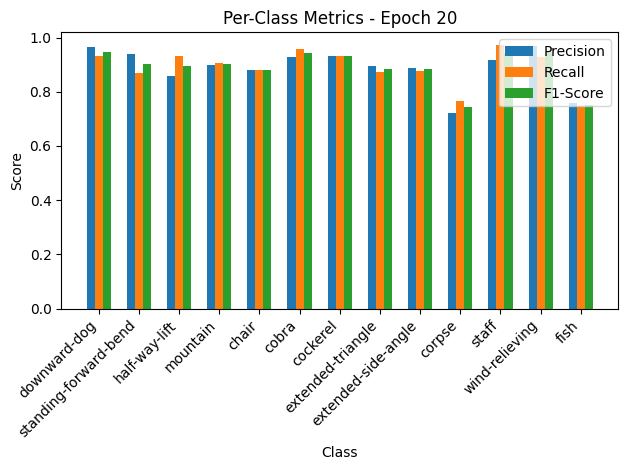


Epoch 21/50 Summary:
Train Loss: 0.3556 | Train Acc: 89.69% | Train Precision: 0.89 | Train Recall: 0.89 | Train F1: 0.89
Val Loss: 0.3698 | Val Acc: 86.30% | Val Precision: 0.89 | Val Recall: 0.86 | Val F1: 0.85

Epoch 22/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:01<00:00, 41.75it/s, loss=0.355, accuracy=89.9]


Per-Class Metrics for Epoch 21:
downward-dog: Precision=0.96, Recall=0.91, F1-Score=0.94
standing-forward-bend: Precision=0.96, Recall=0.84, F1-Score=0.90
half-way-lift: Precision=0.84, Recall=0.94, F1-Score=0.89
mountain: Precision=0.90, Recall=0.93, F1-Score=0.92
chair: Precision=0.89, Recall=0.91, F1-Score=0.90
cobra: Precision=0.93, Recall=0.96, F1-Score=0.94
cockerel: Precision=0.94, Recall=0.97, F1-Score=0.95
extended-triangle: Precision=0.93, Recall=0.90, F1-Score=0.92
extended-side-angle: Precision=0.89, Recall=0.92, F1-Score=0.91
corpse: Precision=0.81, Recall=0.71, F1-Score=0.76
staff: Precision=0.92, Recall=0.96, F1-Score=0.94
wind-relieving: Precision=0.88, Recall=0.94, F1-Score=0.91
fish: Precision=0.72, Recall=0.75, F1-Score=0.74


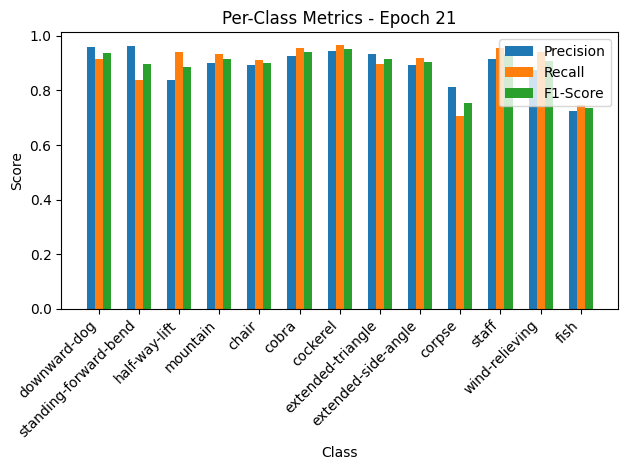

Validation: 100%|██████████| 10/10 [00:00<00:00, 154.17it/s, loss=0.307, accuracy=89.7]


Per-Class Metrics for Epoch 21:
downward-dog: Precision=0.96, Recall=0.91, F1-Score=0.94
standing-forward-bend: Precision=0.96, Recall=0.84, F1-Score=0.90
half-way-lift: Precision=0.84, Recall=0.94, F1-Score=0.89
mountain: Precision=0.90, Recall=0.93, F1-Score=0.92
chair: Precision=0.89, Recall=0.91, F1-Score=0.90
cobra: Precision=0.93, Recall=0.96, F1-Score=0.94
cockerel: Precision=0.94, Recall=0.97, F1-Score=0.95
extended-triangle: Precision=0.93, Recall=0.90, F1-Score=0.92
extended-side-angle: Precision=0.89, Recall=0.92, F1-Score=0.91
corpse: Precision=0.81, Recall=0.71, F1-Score=0.76
staff: Precision=0.92, Recall=0.96, F1-Score=0.94
wind-relieving: Precision=0.88, Recall=0.94, F1-Score=0.91
fish: Precision=0.72, Recall=0.75, F1-Score=0.74


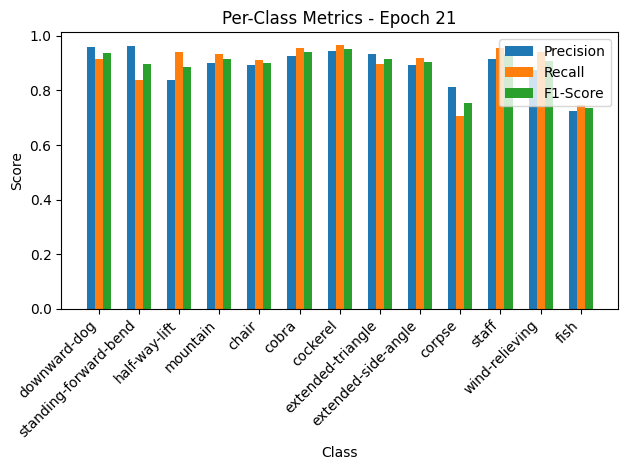


Epoch 22/50 Summary:
Train Loss: 0.3562 | Train Acc: 89.92% | Train Precision: 0.89 | Train Recall: 0.89 | Train F1: 0.89
Val Loss: 0.3362 | Val Acc: 89.73% | Val Precision: 0.92 | Val Recall: 0.90 | Val F1: 0.90

Epoch 23/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:01<00:00, 41.69it/s, loss=0.356, accuracy=89.4]


Per-Class Metrics for Epoch 22:
downward-dog: Precision=0.94, Recall=0.93, F1-Score=0.94
standing-forward-bend: Precision=0.92, Recall=0.79, F1-Score=0.85
half-way-lift: Precision=0.85, Recall=0.92, F1-Score=0.88
mountain: Precision=0.84, Recall=0.92, F1-Score=0.88
chair: Precision=0.90, Recall=0.88, F1-Score=0.89
cobra: Precision=0.97, Recall=0.96, F1-Score=0.96
cockerel: Precision=0.92, Recall=0.95, F1-Score=0.94
extended-triangle: Precision=0.91, Recall=0.88, F1-Score=0.90
extended-side-angle: Precision=0.89, Recall=0.90, F1-Score=0.90
corpse: Precision=0.80, Recall=0.84, F1-Score=0.82
staff: Precision=0.90, Recall=0.97, F1-Score=0.94
wind-relieving: Precision=0.95, Recall=0.90, F1-Score=0.92
fish: Precision=0.79, Recall=0.78, F1-Score=0.78


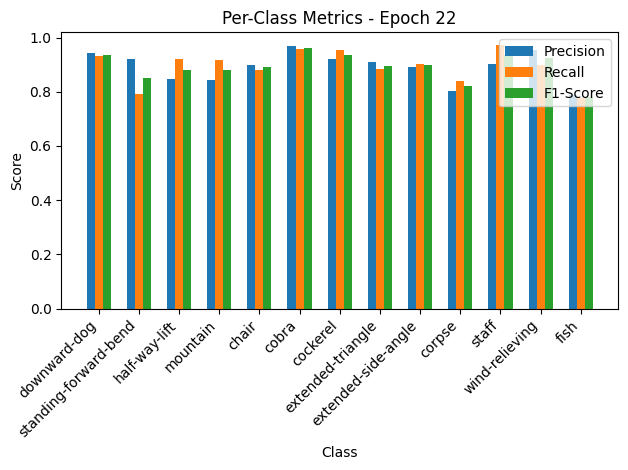

Validation: 100%|██████████| 10/10 [00:00<00:00, 153.26it/s, loss=0.36, accuracy=86.3]


Per-Class Metrics for Epoch 22:
downward-dog: Precision=0.94, Recall=0.93, F1-Score=0.94
standing-forward-bend: Precision=0.92, Recall=0.79, F1-Score=0.85
half-way-lift: Precision=0.85, Recall=0.92, F1-Score=0.88
mountain: Precision=0.84, Recall=0.92, F1-Score=0.88
chair: Precision=0.90, Recall=0.88, F1-Score=0.89
cobra: Precision=0.97, Recall=0.96, F1-Score=0.96
cockerel: Precision=0.92, Recall=0.95, F1-Score=0.94
extended-triangle: Precision=0.91, Recall=0.88, F1-Score=0.90
extended-side-angle: Precision=0.89, Recall=0.90, F1-Score=0.90
corpse: Precision=0.80, Recall=0.84, F1-Score=0.82
staff: Precision=0.90, Recall=0.97, F1-Score=0.94
wind-relieving: Precision=0.95, Recall=0.90, F1-Score=0.92
fish: Precision=0.79, Recall=0.78, F1-Score=0.78


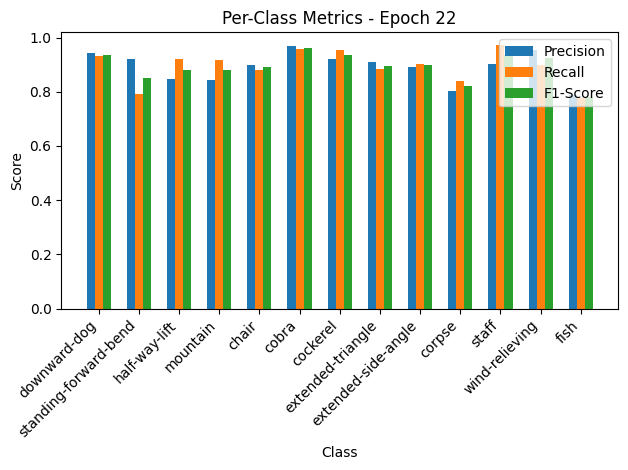


Epoch 23/50 Summary:
Train Loss: 0.3565 | Train Acc: 89.38% | Train Precision: 0.89 | Train Recall: 0.89 | Train F1: 0.89
Val Loss: 0.3947 | Val Acc: 86.30% | Val Precision: 0.88 | Val Recall: 0.87 | Val F1: 0.86

Epoch 24/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 37.09it/s, loss=0.36, accuracy=88.5]


Per-Class Metrics for Epoch 23:
downward-dog: Precision=0.92, Recall=0.89, F1-Score=0.90
standing-forward-bend: Precision=0.94, Recall=0.83, F1-Score=0.88
half-way-lift: Precision=0.82, Recall=0.92, F1-Score=0.87
mountain: Precision=0.90, Recall=0.87, F1-Score=0.89
chair: Precision=0.83, Recall=0.87, F1-Score=0.85
cobra: Precision=0.89, Recall=0.91, F1-Score=0.90
cockerel: Precision=0.93, Recall=0.92, F1-Score=0.92
extended-triangle: Precision=0.92, Recall=0.92, F1-Score=0.92
extended-side-angle: Precision=0.91, Recall=0.93, F1-Score=0.92
corpse: Precision=0.82, Recall=0.82, F1-Score=0.82
staff: Precision=0.88, Recall=0.88, F1-Score=0.88
wind-relieving: Precision=0.94, Recall=0.94, F1-Score=0.94
fish: Precision=0.80, Recall=0.79, F1-Score=0.80


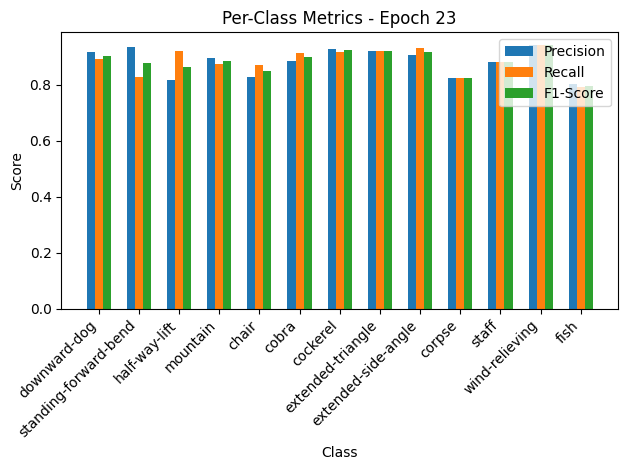

Validation: 100%|██████████| 10/10 [00:00<00:00, 135.83it/s, loss=0.345, accuracy=87.7]


Per-Class Metrics for Epoch 23:
downward-dog: Precision=0.92, Recall=0.89, F1-Score=0.90
standing-forward-bend: Precision=0.94, Recall=0.83, F1-Score=0.88
half-way-lift: Precision=0.82, Recall=0.92, F1-Score=0.87
mountain: Precision=0.90, Recall=0.87, F1-Score=0.89
chair: Precision=0.83, Recall=0.87, F1-Score=0.85
cobra: Precision=0.89, Recall=0.91, F1-Score=0.90
cockerel: Precision=0.93, Recall=0.92, F1-Score=0.92
extended-triangle: Precision=0.92, Recall=0.92, F1-Score=0.92
extended-side-angle: Precision=0.91, Recall=0.93, F1-Score=0.92
corpse: Precision=0.82, Recall=0.82, F1-Score=0.82
staff: Precision=0.88, Recall=0.88, F1-Score=0.88
wind-relieving: Precision=0.94, Recall=0.94, F1-Score=0.94
fish: Precision=0.80, Recall=0.79, F1-Score=0.80


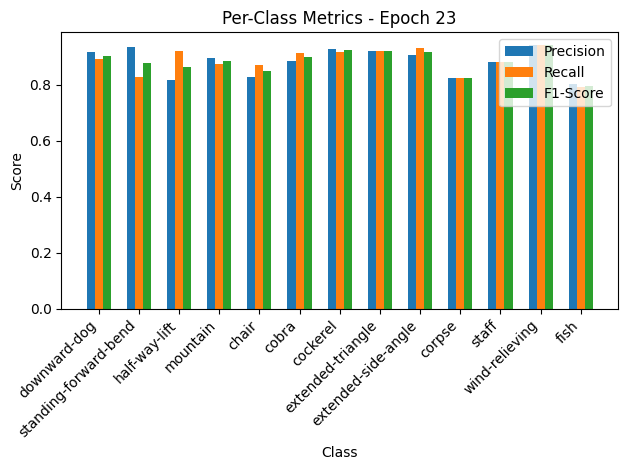


Epoch 24/50 Summary:
Train Loss: 0.3612 | Train Acc: 88.46% | Train Precision: 0.88 | Train Recall: 0.89 | Train F1: 0.88
Val Loss: 0.3777 | Val Acc: 87.67% | Val Precision: 0.90 | Val Recall: 0.88 | Val F1: 0.87

Epoch 25/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 37.78it/s, loss=0.364, accuracy=89.8]


Per-Class Metrics for Epoch 24:
downward-dog: Precision=0.94, Recall=0.91, F1-Score=0.93
standing-forward-bend: Precision=0.94, Recall=0.83, F1-Score=0.88
half-way-lift: Precision=0.84, Recall=0.94, F1-Score=0.89
mountain: Precision=0.91, Recall=0.90, F1-Score=0.90
chair: Precision=0.88, Recall=0.91, F1-Score=0.90
cobra: Precision=0.93, Recall=0.96, F1-Score=0.94
cockerel: Precision=0.86, Recall=0.94, F1-Score=0.90
extended-triangle: Precision=0.95, Recall=0.96, F1-Score=0.96
extended-side-angle: Precision=0.96, Recall=0.92, F1-Score=0.94
corpse: Precision=0.82, Recall=0.74, F1-Score=0.78
staff: Precision=0.89, Recall=0.94, F1-Score=0.91
wind-relieving: Precision=0.95, Recall=0.93, F1-Score=0.94
fish: Precision=0.75, Recall=0.76, F1-Score=0.76


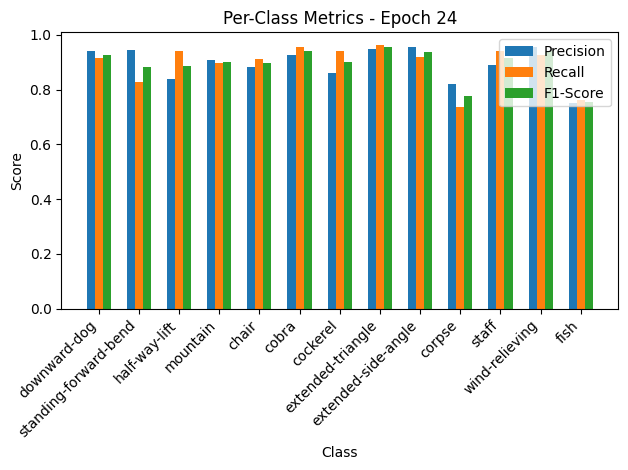

Validation: 100%|██████████| 10/10 [00:00<00:00, 179.25it/s, loss=0.415, accuracy=86.3]


Per-Class Metrics for Epoch 24:
downward-dog: Precision=0.94, Recall=0.91, F1-Score=0.93
standing-forward-bend: Precision=0.94, Recall=0.83, F1-Score=0.88
half-way-lift: Precision=0.84, Recall=0.94, F1-Score=0.89
mountain: Precision=0.91, Recall=0.90, F1-Score=0.90
chair: Precision=0.88, Recall=0.91, F1-Score=0.90
cobra: Precision=0.93, Recall=0.96, F1-Score=0.94
cockerel: Precision=0.86, Recall=0.94, F1-Score=0.90
extended-triangle: Precision=0.95, Recall=0.96, F1-Score=0.96
extended-side-angle: Precision=0.96, Recall=0.92, F1-Score=0.94
corpse: Precision=0.82, Recall=0.74, F1-Score=0.78
staff: Precision=0.89, Recall=0.94, F1-Score=0.91
wind-relieving: Precision=0.95, Recall=0.93, F1-Score=0.94
fish: Precision=0.75, Recall=0.76, F1-Score=0.76


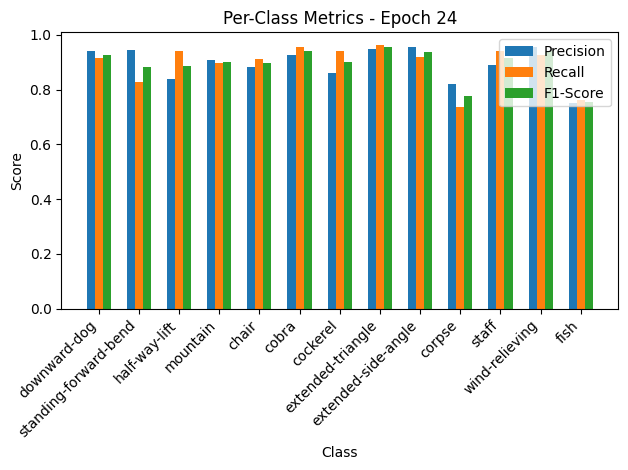


Epoch 25/50 Summary:
Train Loss: 0.3653 | Train Acc: 89.76% | Train Precision: 0.89 | Train Recall: 0.89 | Train F1: 0.89
Val Loss: 0.4546 | Val Acc: 86.30% | Val Precision: 0.89 | Val Recall: 0.86 | Val F1: 0.85

Epoch 26/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:01<00:00, 41.56it/s, loss=0.349, accuracy=89.9]


Per-Class Metrics for Epoch 25:
downward-dog: Precision=0.97, Recall=0.93, F1-Score=0.95
standing-forward-bend: Precision=0.94, Recall=0.83, F1-Score=0.88
half-way-lift: Precision=0.82, Recall=0.93, F1-Score=0.87
mountain: Precision=0.92, Recall=0.92, F1-Score=0.92
chair: Precision=0.90, Recall=0.89, F1-Score=0.90
cobra: Precision=0.94, Recall=0.96, F1-Score=0.95
cockerel: Precision=0.92, Recall=0.97, F1-Score=0.94
extended-triangle: Precision=0.94, Recall=0.92, F1-Score=0.93
extended-side-angle: Precision=0.92, Recall=0.90, F1-Score=0.91
corpse: Precision=0.78, Recall=0.74, F1-Score=0.76
staff: Precision=0.90, Recall=0.97, F1-Score=0.94
wind-relieving: Precision=0.93, Recall=0.93, F1-Score=0.93
fish: Precision=0.74, Recall=0.76, F1-Score=0.75


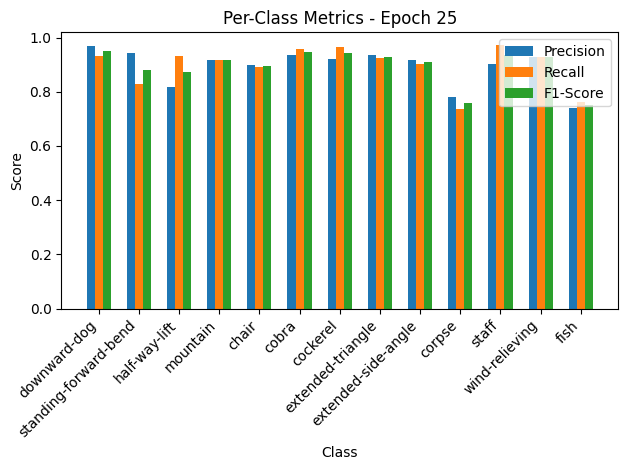

Validation: 100%|██████████| 10/10 [00:00<00:00, 180.79it/s, loss=0.337, accuracy=87.7]


Per-Class Metrics for Epoch 25:
downward-dog: Precision=0.97, Recall=0.93, F1-Score=0.95
standing-forward-bend: Precision=0.94, Recall=0.83, F1-Score=0.88
half-way-lift: Precision=0.82, Recall=0.93, F1-Score=0.87
mountain: Precision=0.92, Recall=0.92, F1-Score=0.92
chair: Precision=0.90, Recall=0.89, F1-Score=0.90
cobra: Precision=0.94, Recall=0.96, F1-Score=0.95
cockerel: Precision=0.92, Recall=0.97, F1-Score=0.94
extended-triangle: Precision=0.94, Recall=0.92, F1-Score=0.93
extended-side-angle: Precision=0.92, Recall=0.90, F1-Score=0.91
corpse: Precision=0.78, Recall=0.74, F1-Score=0.76
staff: Precision=0.90, Recall=0.97, F1-Score=0.94
wind-relieving: Precision=0.93, Recall=0.93, F1-Score=0.93
fish: Precision=0.74, Recall=0.76, F1-Score=0.75


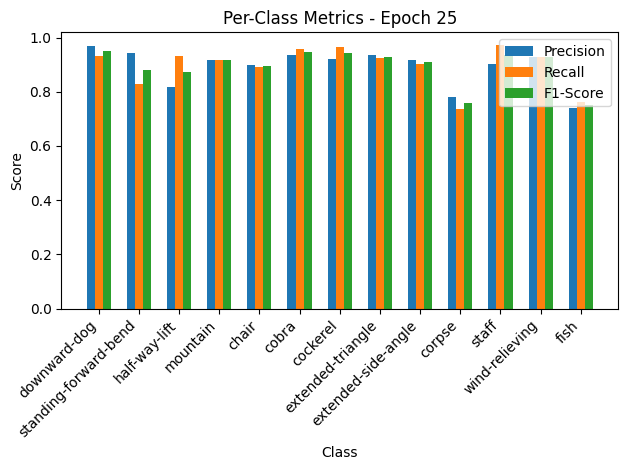


Epoch 26/50 Summary:
Train Loss: 0.3497 | Train Acc: 89.92% | Train Precision: 0.89 | Train Recall: 0.90 | Train F1: 0.89
Val Loss: 0.3698 | Val Acc: 87.67% | Val Precision: 0.91 | Val Recall: 0.88 | Val F1: 0.88

Epoch 27/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:02<00:00, 39.73it/s, loss=0.274, accuracy=92]


Per-Class Metrics for Epoch 26:
downward-dog: Precision=0.98, Recall=0.91, F1-Score=0.94
standing-forward-bend: Precision=0.94, Recall=0.83, F1-Score=0.88
half-way-lift: Precision=0.79, Recall=0.94, F1-Score=0.86
mountain: Precision=0.94, Recall=0.95, F1-Score=0.95
chair: Precision=0.97, Recall=0.89, F1-Score=0.93
cobra: Precision=0.96, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.92, Recall=1.00, F1-Score=0.96
extended-triangle: Precision=0.97, Recall=0.94, F1-Score=0.95
extended-side-angle: Precision=0.91, Recall=0.96, F1-Score=0.93
corpse: Precision=0.86, Recall=0.84, F1-Score=0.85
staff: Precision=0.93, Recall=0.97, F1-Score=0.95
wind-relieving: Precision=0.96, Recall=0.99, F1-Score=0.97
fish: Precision=0.86, Recall=0.82, F1-Score=0.84


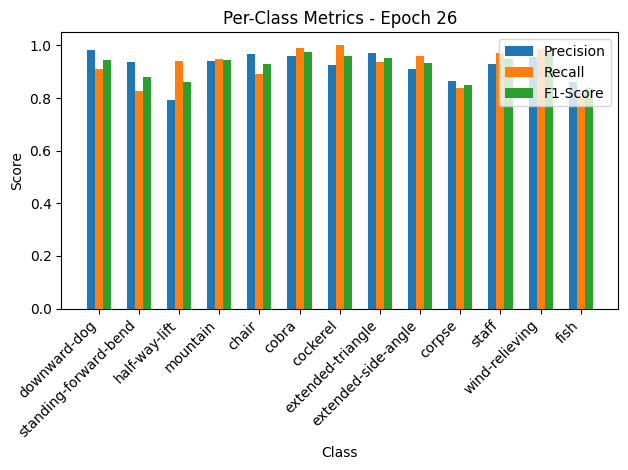

Validation: 100%|██████████| 10/10 [00:00<00:00, 165.49it/s, loss=0.22, accuracy=92.5]


Per-Class Metrics for Epoch 26:
downward-dog: Precision=0.98, Recall=0.91, F1-Score=0.94
standing-forward-bend: Precision=0.94, Recall=0.83, F1-Score=0.88
half-way-lift: Precision=0.79, Recall=0.94, F1-Score=0.86
mountain: Precision=0.94, Recall=0.95, F1-Score=0.95
chair: Precision=0.97, Recall=0.89, F1-Score=0.93
cobra: Precision=0.96, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.92, Recall=1.00, F1-Score=0.96
extended-triangle: Precision=0.97, Recall=0.94, F1-Score=0.95
extended-side-angle: Precision=0.91, Recall=0.96, F1-Score=0.93
corpse: Precision=0.86, Recall=0.84, F1-Score=0.85
staff: Precision=0.93, Recall=0.97, F1-Score=0.95
wind-relieving: Precision=0.96, Recall=0.99, F1-Score=0.97
fish: Precision=0.86, Recall=0.82, F1-Score=0.84


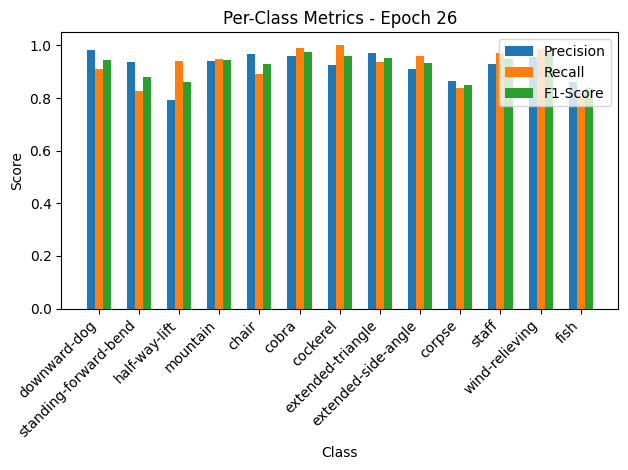


Epoch 27/50 Summary:
Train Loss: 0.2742 | Train Acc: 91.98% | Train Precision: 0.92 | Train Recall: 0.92 | Train F1: 0.92
Val Loss: 0.2413 | Val Acc: 92.47% | Val Precision: 0.94 | Val Recall: 0.94 | Val F1: 0.93
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_3.pth
Checkpoint saved at epoch 27
New best model saved! Validation Loss: 0.2413

Epoch 28/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:02<00:00, 37.28it/s, loss=0.235, accuracy=92.6]


Per-Class Metrics for Epoch 27:
downward-dog: Precision=0.98, Recall=0.93, F1-Score=0.95
standing-forward-bend: Precision=0.98, Recall=0.86, F1-Score=0.92
half-way-lift: Precision=0.85, Recall=0.98, F1-Score=0.91
mountain: Precision=0.93, Recall=0.95, F1-Score=0.94
chair: Precision=0.95, Recall=0.92, F1-Score=0.93
cobra: Precision=0.98, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.93, Recall=0.95, F1-Score=0.94
extended-triangle: Precision=0.95, Recall=0.95, F1-Score=0.95
extended-side-angle: Precision=0.95, Recall=0.96, F1-Score=0.95
corpse: Precision=0.83, Recall=0.74, F1-Score=0.78
staff: Precision=0.94, Recall=1.00, F1-Score=0.97
wind-relieving: Precision=0.91, Recall=0.94, F1-Score=0.93
fish: Precision=0.78, Recall=0.84, F1-Score=0.81


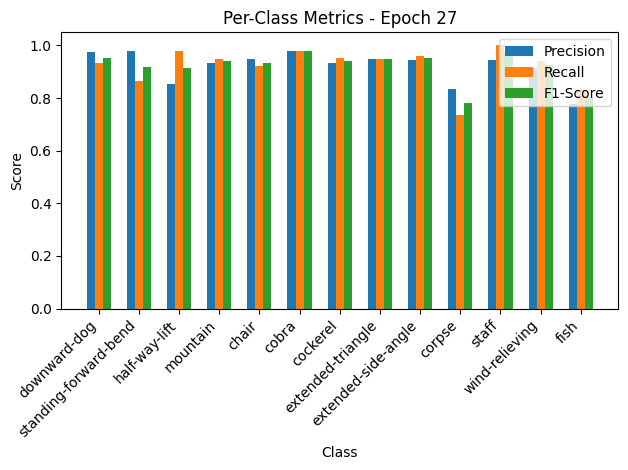

Validation: 100%|██████████| 10/10 [00:00<00:00, 180.75it/s, loss=0.206, accuracy=93.2]


Per-Class Metrics for Epoch 27:
downward-dog: Precision=0.98, Recall=0.93, F1-Score=0.95
standing-forward-bend: Precision=0.98, Recall=0.86, F1-Score=0.92
half-way-lift: Precision=0.85, Recall=0.98, F1-Score=0.91
mountain: Precision=0.93, Recall=0.95, F1-Score=0.94
chair: Precision=0.95, Recall=0.92, F1-Score=0.93
cobra: Precision=0.98, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.93, Recall=0.95, F1-Score=0.94
extended-triangle: Precision=0.95, Recall=0.95, F1-Score=0.95
extended-side-angle: Precision=0.95, Recall=0.96, F1-Score=0.95
corpse: Precision=0.83, Recall=0.74, F1-Score=0.78
staff: Precision=0.94, Recall=1.00, F1-Score=0.97
wind-relieving: Precision=0.91, Recall=0.94, F1-Score=0.93
fish: Precision=0.78, Recall=0.84, F1-Score=0.81


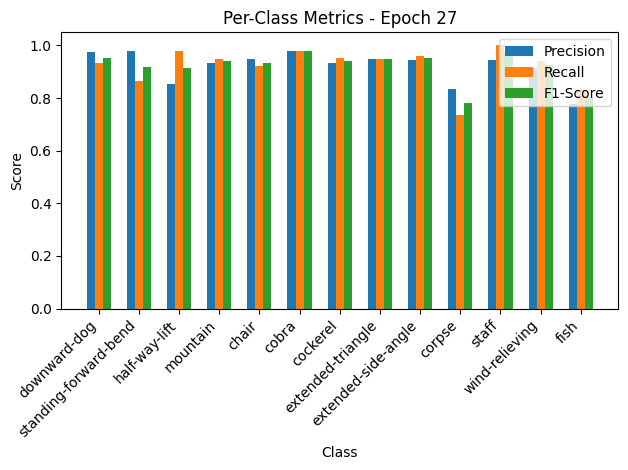


Epoch 28/50 Summary:
Train Loss: 0.2352 | Train Acc: 92.59% | Train Precision: 0.92 | Train Recall: 0.92 | Train F1: 0.92
Val Loss: 0.2252 | Val Acc: 93.15% | Val Precision: 0.94 | Val Recall: 0.93 | Val F1: 0.92
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_3.pth
Checkpoint saved at epoch 28
New best model saved! Validation Loss: 0.2252

Epoch 29/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:02<00:00, 33.98it/s, loss=0.217, accuracy=93.4]


Per-Class Metrics for Epoch 28:
downward-dog: Precision=0.98, Recall=0.94, F1-Score=0.96
standing-forward-bend: Precision=0.97, Recall=0.88, F1-Score=0.92
half-way-lift: Precision=0.87, Recall=0.96, F1-Score=0.91
mountain: Precision=0.96, Recall=0.97, F1-Score=0.96
chair: Precision=0.94, Recall=0.94, F1-Score=0.94
cobra: Precision=0.98, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.94, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.97, Recall=0.94, F1-Score=0.95
extended-side-angle: Precision=0.95, Recall=0.97, F1-Score=0.96
corpse: Precision=0.82, Recall=0.79, F1-Score=0.81
staff: Precision=0.94, Recall=0.97, F1-Score=0.96
wind-relieving: Precision=0.97, Recall=0.97, F1-Score=0.97
fish: Precision=0.80, Recall=0.82, F1-Score=0.81


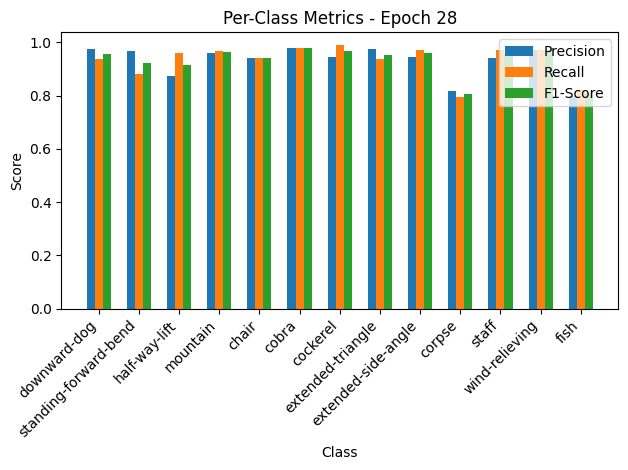

Validation: 100%|██████████| 10/10 [00:00<00:00, 160.14it/s, loss=0.21, accuracy=93.2]


Per-Class Metrics for Epoch 28:
downward-dog: Precision=0.98, Recall=0.94, F1-Score=0.96
standing-forward-bend: Precision=0.97, Recall=0.88, F1-Score=0.92
half-way-lift: Precision=0.87, Recall=0.96, F1-Score=0.91
mountain: Precision=0.96, Recall=0.97, F1-Score=0.96
chair: Precision=0.94, Recall=0.94, F1-Score=0.94
cobra: Precision=0.98, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.94, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.97, Recall=0.94, F1-Score=0.95
extended-side-angle: Precision=0.95, Recall=0.97, F1-Score=0.96
corpse: Precision=0.82, Recall=0.79, F1-Score=0.81
staff: Precision=0.94, Recall=0.97, F1-Score=0.96
wind-relieving: Precision=0.97, Recall=0.97, F1-Score=0.97
fish: Precision=0.80, Recall=0.82, F1-Score=0.81


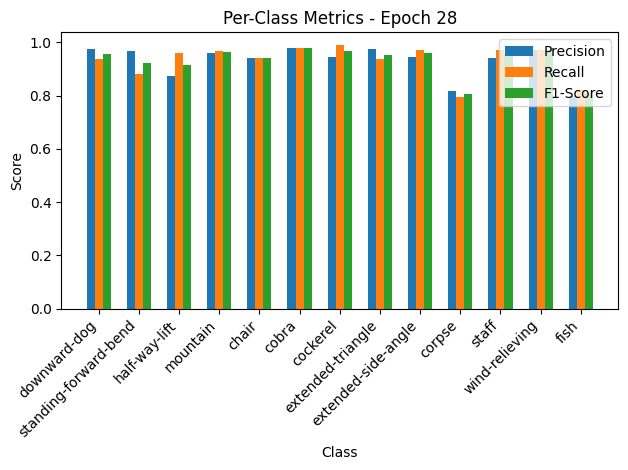


Epoch 29/50 Summary:
Train Loss: 0.2178 | Train Acc: 93.43% | Train Precision: 0.93 | Train Recall: 0.93 | Train F1: 0.93
Val Loss: 0.2303 | Val Acc: 93.15% | Val Precision: 0.94 | Val Recall: 0.93 | Val F1: 0.92

Epoch 30/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:02<00:00, 36.53it/s, loss=0.22, accuracy=93.8]


Per-Class Metrics for Epoch 29:
downward-dog: Precision=0.97, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.97, Recall=0.88, F1-Score=0.93
half-way-lift: Precision=0.88, Recall=0.94, F1-Score=0.91
mountain: Precision=0.94, Recall=0.98, F1-Score=0.96
chair: Precision=0.98, Recall=0.93, F1-Score=0.95
cobra: Precision=0.99, Recall=0.97, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.94, F1-Score=0.95
extended-side-angle: Precision=0.93, Recall=0.97, F1-Score=0.95
corpse: Precision=0.85, Recall=0.82, F1-Score=0.84
staff: Precision=0.92, Recall=1.00, F1-Score=0.96
wind-relieving: Precision=0.97, Recall=0.97, F1-Score=0.97
fish: Precision=0.82, Recall=0.82, F1-Score=0.82


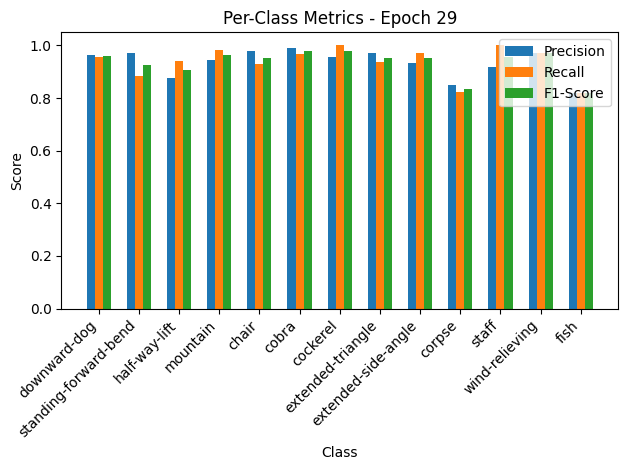

Validation: 100%|██████████| 10/10 [00:00<00:00, 183.02it/s, loss=0.182, accuracy=95.2]


Per-Class Metrics for Epoch 29:
downward-dog: Precision=0.97, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.97, Recall=0.88, F1-Score=0.93
half-way-lift: Precision=0.88, Recall=0.94, F1-Score=0.91
mountain: Precision=0.94, Recall=0.98, F1-Score=0.96
chair: Precision=0.98, Recall=0.93, F1-Score=0.95
cobra: Precision=0.99, Recall=0.97, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.94, F1-Score=0.95
extended-side-angle: Precision=0.93, Recall=0.97, F1-Score=0.95
corpse: Precision=0.85, Recall=0.82, F1-Score=0.84
staff: Precision=0.92, Recall=1.00, F1-Score=0.96
wind-relieving: Precision=0.97, Recall=0.97, F1-Score=0.97
fish: Precision=0.82, Recall=0.82, F1-Score=0.82


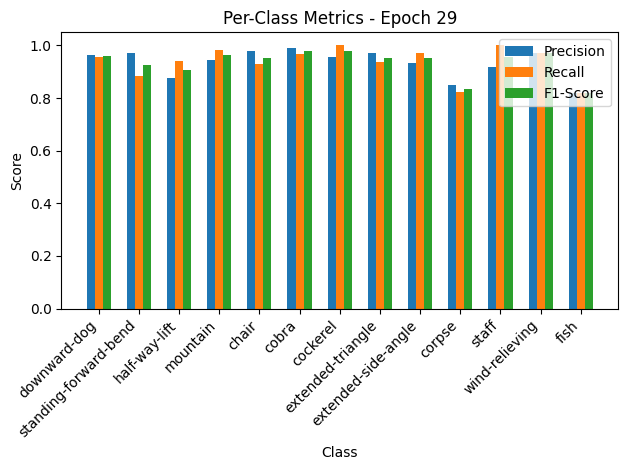


Epoch 30/50 Summary:
Train Loss: 0.2202 | Train Acc: 93.81% | Train Precision: 0.93 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.1992 | Val Acc: 95.21% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.95
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_3.pth
Checkpoint saved at epoch 30
New best model saved! Validation Loss: 0.1992

Epoch 31/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:02<00:00, 39.37it/s, loss=0.219, accuracy=94]


Per-Class Metrics for Epoch 30:
downward-dog: Precision=0.97, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.97, Recall=0.88, F1-Score=0.92
half-way-lift: Precision=0.89, Recall=0.96, F1-Score=0.92
mountain: Precision=0.96, Recall=0.94, F1-Score=0.95
chair: Precision=0.93, Recall=0.95, F1-Score=0.94
cobra: Precision=0.97, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.92, F1-Score=0.95
extended-side-angle: Precision=0.92, Recall=0.99, F1-Score=0.95
corpse: Precision=0.86, Recall=0.79, F1-Score=0.82
staff: Precision=0.96, Recall=1.00, F1-Score=0.98
wind-relieving: Precision=0.98, Recall=0.96, F1-Score=0.97
fish: Precision=0.82, Recall=0.88, F1-Score=0.85


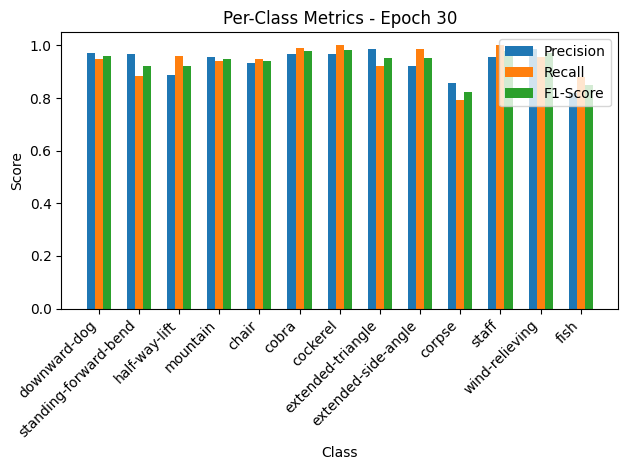

Validation: 100%|██████████| 10/10 [00:00<00:00, 183.40it/s, loss=0.189, accuracy=93.2]


Per-Class Metrics for Epoch 30:
downward-dog: Precision=0.97, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.97, Recall=0.88, F1-Score=0.92
half-way-lift: Precision=0.89, Recall=0.96, F1-Score=0.92
mountain: Precision=0.96, Recall=0.94, F1-Score=0.95
chair: Precision=0.93, Recall=0.95, F1-Score=0.94
cobra: Precision=0.97, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.92, F1-Score=0.95
extended-side-angle: Precision=0.92, Recall=0.99, F1-Score=0.95
corpse: Precision=0.86, Recall=0.79, F1-Score=0.82
staff: Precision=0.96, Recall=1.00, F1-Score=0.98
wind-relieving: Precision=0.98, Recall=0.96, F1-Score=0.97
fish: Precision=0.82, Recall=0.88, F1-Score=0.85


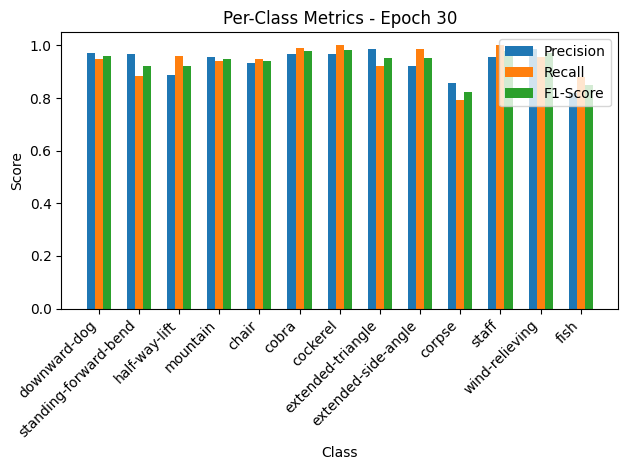


Epoch 31/50 Summary:
Train Loss: 0.2198 | Train Acc: 93.96% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.2076 | Val Acc: 93.15% | Val Precision: 0.94 | Val Recall: 0.94 | Val F1: 0.94

Epoch 32/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:02<00:00, 35.51it/s, loss=0.198, accuracy=94.3]


Per-Class Metrics for Epoch 31:
downward-dog: Precision=0.98, Recall=0.94, F1-Score=0.96
standing-forward-bend: Precision=0.98, Recall=0.90, F1-Score=0.94
half-way-lift: Precision=0.89, Recall=0.97, F1-Score=0.93
mountain: Precision=0.95, Recall=0.98, F1-Score=0.97
chair: Precision=0.97, Recall=0.93, F1-Score=0.95
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.94, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.95, Recall=0.97, F1-Score=0.96
extended-side-angle: Precision=0.97, Recall=0.95, F1-Score=0.96
corpse: Precision=0.84, Recall=0.84, F1-Score=0.84
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=0.97, F1-Score=0.97
fish: Precision=0.82, Recall=0.82, F1-Score=0.82


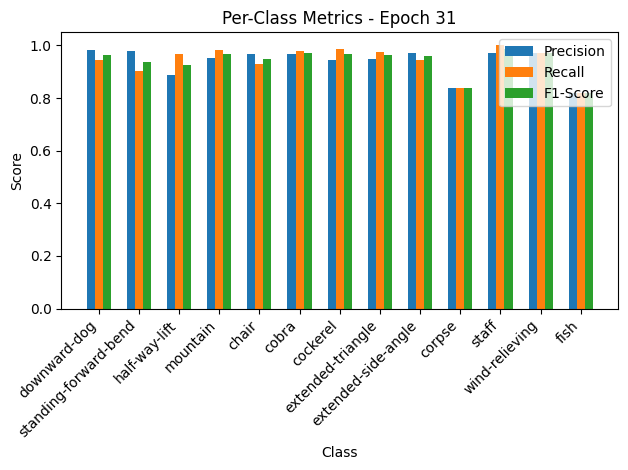

Validation: 100%|██████████| 10/10 [00:00<00:00, 184.61it/s, loss=0.167, accuracy=94.5]


Per-Class Metrics for Epoch 31:
downward-dog: Precision=0.98, Recall=0.94, F1-Score=0.96
standing-forward-bend: Precision=0.98, Recall=0.90, F1-Score=0.94
half-way-lift: Precision=0.89, Recall=0.97, F1-Score=0.93
mountain: Precision=0.95, Recall=0.98, F1-Score=0.97
chair: Precision=0.97, Recall=0.93, F1-Score=0.95
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.94, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.95, Recall=0.97, F1-Score=0.96
extended-side-angle: Precision=0.97, Recall=0.95, F1-Score=0.96
corpse: Precision=0.84, Recall=0.84, F1-Score=0.84
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=0.97, F1-Score=0.97
fish: Precision=0.82, Recall=0.82, F1-Score=0.82


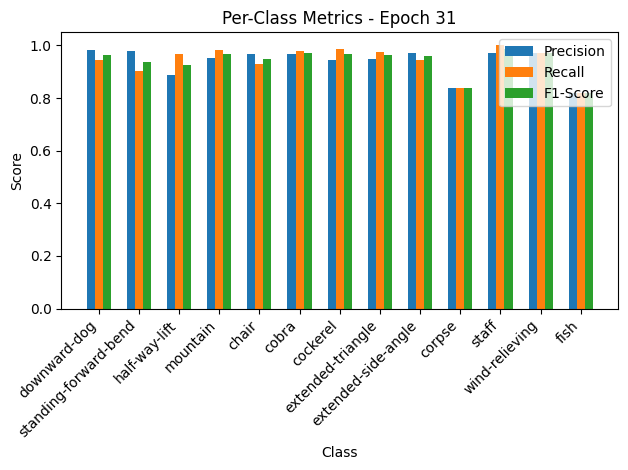


Epoch 32/50 Summary:
Train Loss: 0.1987 | Train Acc: 94.35% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.1830 | Val Acc: 94.52% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.94
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_3.pth
Checkpoint saved at epoch 32
New best model saved! Validation Loss: 0.1830

Epoch 33/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:02<00:00, 33.05it/s, loss=0.208, accuracy=94.3]


Per-Class Metrics for Epoch 32:
downward-dog: Precision=0.99, Recall=0.94, F1-Score=0.96
standing-forward-bend: Precision=0.96, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.90, Recall=0.97, F1-Score=0.93
mountain: Precision=0.94, Recall=0.96, F1-Score=0.95
chair: Precision=0.94, Recall=0.93, F1-Score=0.94
cobra: Precision=0.96, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.95, Recall=1.00, F1-Score=0.97
extended-triangle: Precision=0.97, Recall=0.95, F1-Score=0.96
extended-side-angle: Precision=0.95, Recall=0.99, F1-Score=0.97
corpse: Precision=0.89, Recall=0.82, F1-Score=0.85
staff: Precision=0.94, Recall=0.97, F1-Score=0.96
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.85, Recall=0.87, F1-Score=0.86


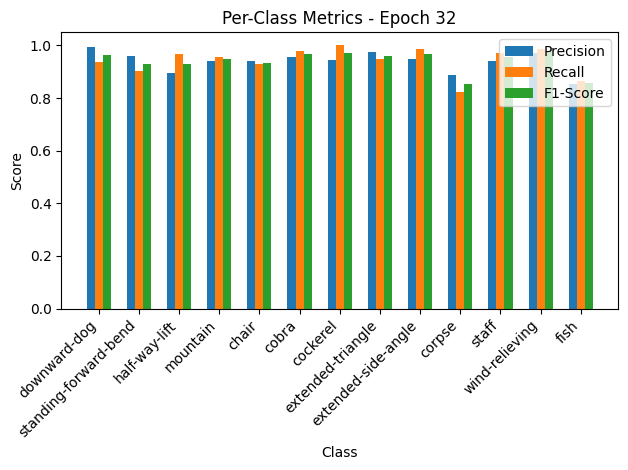

Validation: 100%|██████████| 10/10 [00:00<00:00, 155.40it/s, loss=0.163, accuracy=94.5]


Per-Class Metrics for Epoch 32:
downward-dog: Precision=0.99, Recall=0.94, F1-Score=0.96
standing-forward-bend: Precision=0.96, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.90, Recall=0.97, F1-Score=0.93
mountain: Precision=0.94, Recall=0.96, F1-Score=0.95
chair: Precision=0.94, Recall=0.93, F1-Score=0.94
cobra: Precision=0.96, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.95, Recall=1.00, F1-Score=0.97
extended-triangle: Precision=0.97, Recall=0.95, F1-Score=0.96
extended-side-angle: Precision=0.95, Recall=0.99, F1-Score=0.97
corpse: Precision=0.89, Recall=0.82, F1-Score=0.85
staff: Precision=0.94, Recall=0.97, F1-Score=0.96
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.85, Recall=0.87, F1-Score=0.86


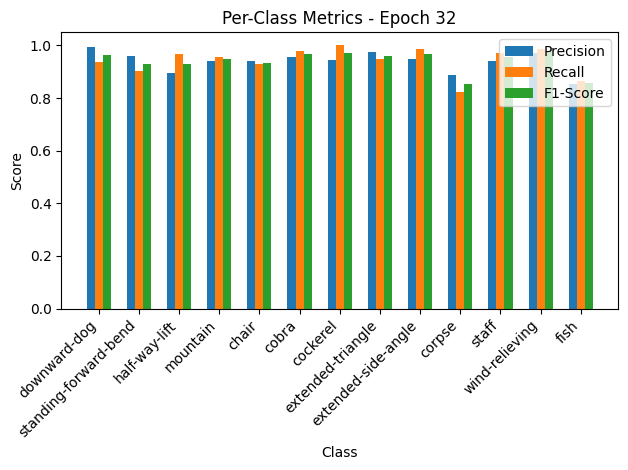


Epoch 33/50 Summary:
Train Loss: 0.2085 | Train Acc: 94.27% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.1785 | Val Acc: 94.52% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_3.pth
Checkpoint saved at epoch 33
New best model saved! Validation Loss: 0.1785

Epoch 34/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:02<00:00, 38.94it/s, loss=0.193, accuracy=94.9]


Per-Class Metrics for Epoch 33:
downward-dog: Precision=0.99, Recall=0.94, F1-Score=0.97
standing-forward-bend: Precision=0.97, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.89, Recall=0.97, F1-Score=0.93
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.97, Recall=0.96, F1-Score=0.97
cobra: Precision=0.95, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.93, Recall=1.00, F1-Score=0.97
extended-triangle: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.97, Recall=0.96, F1-Score=0.97
corpse: Precision=0.87, Recall=0.90, F1-Score=0.88
staff: Precision=0.94, Recall=0.97, F1-Score=0.96
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.91, Recall=0.87, F1-Score=0.89


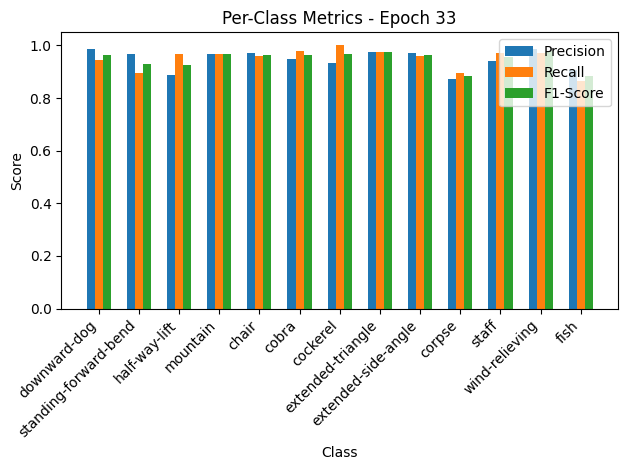

Validation: 100%|██████████| 10/10 [00:00<00:00, 163.47it/s, loss=0.169, accuracy=92.5]


Per-Class Metrics for Epoch 33:
downward-dog: Precision=0.99, Recall=0.94, F1-Score=0.97
standing-forward-bend: Precision=0.97, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.89, Recall=0.97, F1-Score=0.93
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.97, Recall=0.96, F1-Score=0.97
cobra: Precision=0.95, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.93, Recall=1.00, F1-Score=0.97
extended-triangle: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.97, Recall=0.96, F1-Score=0.97
corpse: Precision=0.87, Recall=0.90, F1-Score=0.88
staff: Precision=0.94, Recall=0.97, F1-Score=0.96
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.91, Recall=0.87, F1-Score=0.89


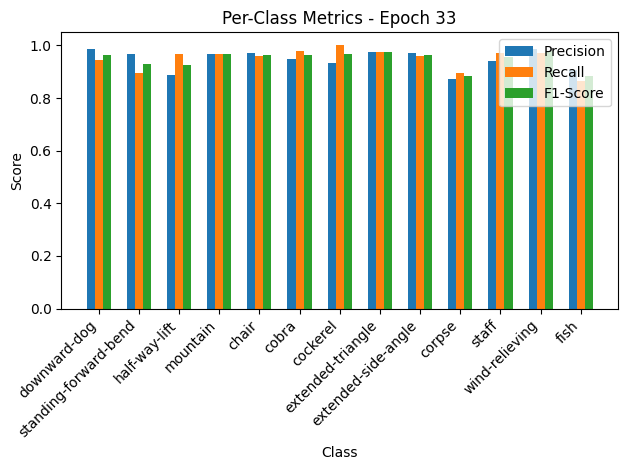


Epoch 34/50 Summary:
Train Loss: 0.1932 | Train Acc: 94.88% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.1851 | Val Acc: 92.47% | Val Precision: 0.93 | Val Recall: 0.93 | Val F1: 0.93

Epoch 35/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:01<00:00, 41.02it/s, loss=0.188, accuracy=94.5]


Per-Class Metrics for Epoch 34:
downward-dog: Precision=0.99, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.91, F1-Score=0.93
half-way-lift: Precision=0.92, Recall=0.95, F1-Score=0.93
mountain: Precision=0.92, Recall=0.97, F1-Score=0.95
chair: Precision=0.98, Recall=0.92, F1-Score=0.95
cobra: Precision=0.98, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.96, Recall=0.94, F1-Score=0.95
extended-side-angle: Precision=0.93, Recall=0.97, F1-Score=0.95
corpse: Precision=0.89, Recall=0.82, F1-Score=0.85
staff: Precision=0.94, Recall=1.00, F1-Score=0.97
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.84, Recall=0.88, F1-Score=0.86


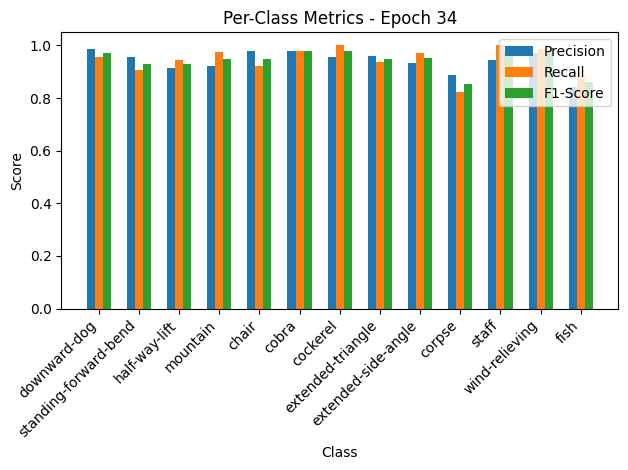

Validation: 100%|██████████| 10/10 [00:00<00:00, 179.18it/s, loss=0.184, accuracy=92.5]


Per-Class Metrics for Epoch 34:
downward-dog: Precision=0.99, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.91, F1-Score=0.93
half-way-lift: Precision=0.92, Recall=0.95, F1-Score=0.93
mountain: Precision=0.92, Recall=0.97, F1-Score=0.95
chair: Precision=0.98, Recall=0.92, F1-Score=0.95
cobra: Precision=0.98, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.96, Recall=0.94, F1-Score=0.95
extended-side-angle: Precision=0.93, Recall=0.97, F1-Score=0.95
corpse: Precision=0.89, Recall=0.82, F1-Score=0.85
staff: Precision=0.94, Recall=1.00, F1-Score=0.97
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.84, Recall=0.88, F1-Score=0.86


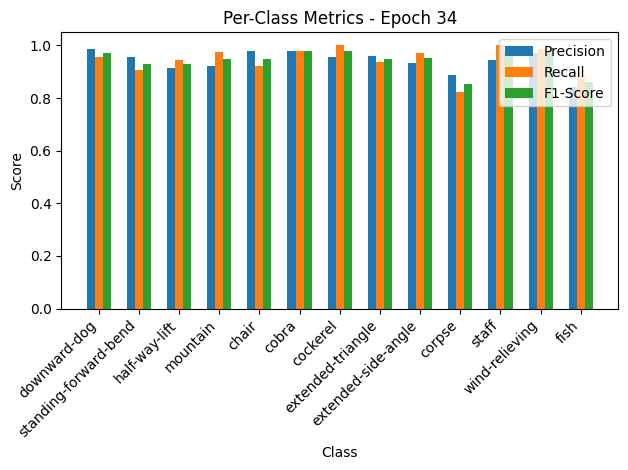


Epoch 35/50 Summary:
Train Loss: 0.1888 | Train Acc: 94.50% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.2015 | Val Acc: 92.47% | Val Precision: 0.94 | Val Recall: 0.93 | Val F1: 0.93

Epoch 36/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:02<00:00, 37.59it/s, loss=0.186, accuracy=95]


Per-Class Metrics for Epoch 35:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.98, Recall=0.90, F1-Score=0.94
half-way-lift: Precision=0.89, Recall=0.98, F1-Score=0.93
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.97, Recall=0.93, F1-Score=0.95
cobra: Precision=0.96, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.95, Recall=1.00, F1-Score=0.97
extended-triangle: Precision=0.95, Recall=0.97, F1-Score=0.96
extended-side-angle: Precision=0.96, Recall=0.95, F1-Score=0.95
corpse: Precision=0.92, Recall=0.81, F1-Score=0.86
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.85, Recall=0.91, F1-Score=0.88


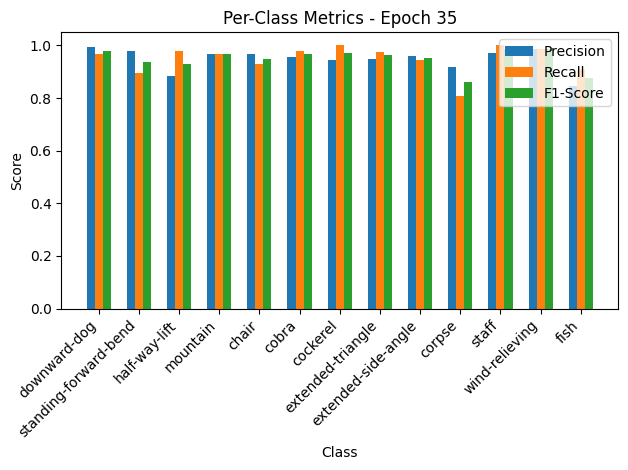

Validation: 100%|██████████| 10/10 [00:00<00:00, 181.82it/s, loss=0.17, accuracy=95.2]


Per-Class Metrics for Epoch 35:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.98, Recall=0.90, F1-Score=0.94
half-way-lift: Precision=0.89, Recall=0.98, F1-Score=0.93
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.97, Recall=0.93, F1-Score=0.95
cobra: Precision=0.96, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.95, Recall=1.00, F1-Score=0.97
extended-triangle: Precision=0.95, Recall=0.97, F1-Score=0.96
extended-side-angle: Precision=0.96, Recall=0.95, F1-Score=0.95
corpse: Precision=0.92, Recall=0.81, F1-Score=0.86
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.85, Recall=0.91, F1-Score=0.88


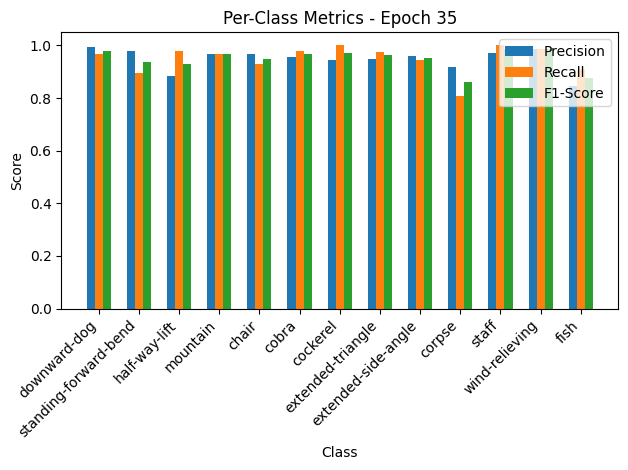


Epoch 36/50 Summary:
Train Loss: 0.1861 | Train Acc: 95.03% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.1861 | Val Acc: 95.21% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.95

Epoch 37/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:02<00:00, 32.90it/s, loss=0.184, accuracy=95]


Per-Class Metrics for Epoch 36:
downward-dog: Precision=0.99, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.97, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.90, Recall=0.95, F1-Score=0.93
mountain: Precision=0.94, Recall=0.97, F1-Score=0.96
chair: Precision=0.96, Recall=0.93, F1-Score=0.94
cobra: Precision=0.97, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.88, Recall=0.84, F1-Score=0.86
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=0.97, F1-Score=0.97
fish: Precision=0.84, Recall=0.87, F1-Score=0.85


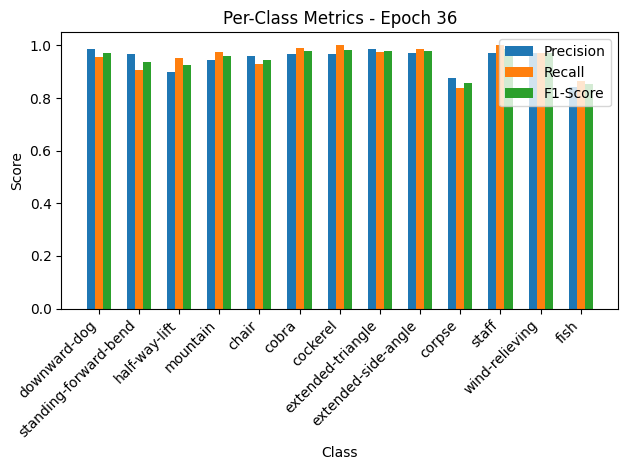

Validation: 100%|██████████| 10/10 [00:00<00:00, 124.32it/s, loss=0.157, accuracy=95.9]


Per-Class Metrics for Epoch 36:
downward-dog: Precision=0.99, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.97, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.90, Recall=0.95, F1-Score=0.93
mountain: Precision=0.94, Recall=0.97, F1-Score=0.96
chair: Precision=0.96, Recall=0.93, F1-Score=0.94
cobra: Precision=0.97, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.88, Recall=0.84, F1-Score=0.86
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=0.97, F1-Score=0.97
fish: Precision=0.84, Recall=0.87, F1-Score=0.85


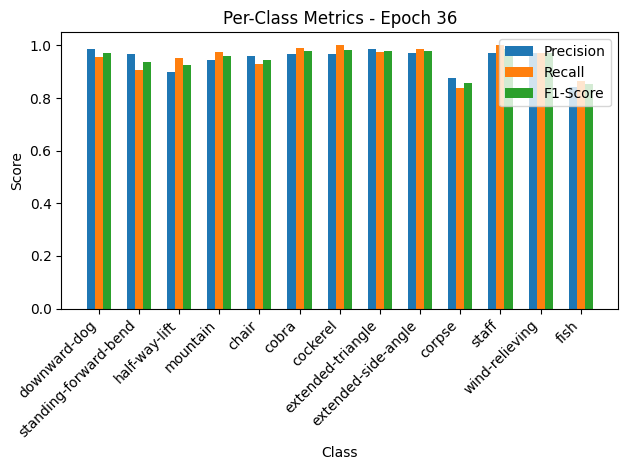


Epoch 37/50 Summary:
Train Loss: 0.1848 | Train Acc: 94.96% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.1722 | Val Acc: 95.89% | Val Precision: 0.96 | Val Recall: 0.97 | Val F1: 0.96
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_3.pth
Checkpoint saved at epoch 37
New best model saved! Validation Loss: 0.1722

Epoch 38/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:02<00:00, 39.79it/s, loss=0.195, accuracy=94.3]


Per-Class Metrics for Epoch 37:
downward-dog: Precision=0.97, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.88, Recall=0.94, F1-Score=0.91
mountain: Precision=0.96, Recall=0.96, F1-Score=0.96
chair: Precision=0.97, Recall=0.91, F1-Score=0.94
cobra: Precision=0.96, Recall=0.97, F1-Score=0.96
cockerel: Precision=0.93, Recall=0.98, F1-Score=0.95
extended-triangle: Precision=0.95, Recall=0.96, F1-Score=0.96
extended-side-angle: Precision=0.96, Recall=0.95, F1-Score=0.95
corpse: Precision=0.94, Recall=0.87, F1-Score=0.90
staff: Precision=0.94, Recall=0.99, F1-Score=0.96
wind-relieving: Precision=1.00, Recall=0.97, F1-Score=0.99
fish: Precision=0.86, Recall=0.93, F1-Score=0.89


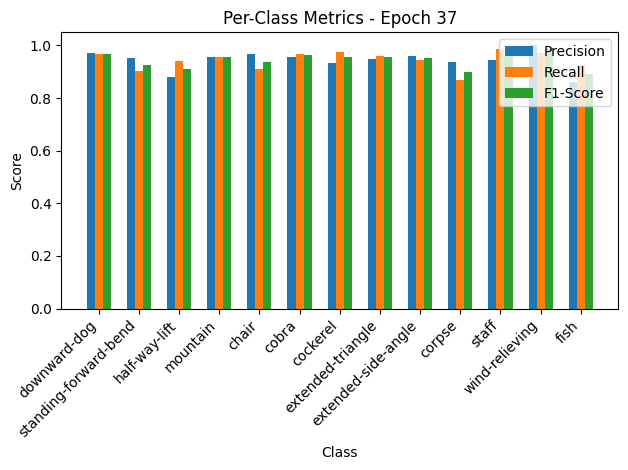

Validation: 100%|██████████| 10/10 [00:00<00:00, 182.33it/s, loss=0.214, accuracy=92.5]


Per-Class Metrics for Epoch 37:
downward-dog: Precision=0.97, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.88, Recall=0.94, F1-Score=0.91
mountain: Precision=0.96, Recall=0.96, F1-Score=0.96
chair: Precision=0.97, Recall=0.91, F1-Score=0.94
cobra: Precision=0.96, Recall=0.97, F1-Score=0.96
cockerel: Precision=0.93, Recall=0.98, F1-Score=0.95
extended-triangle: Precision=0.95, Recall=0.96, F1-Score=0.96
extended-side-angle: Precision=0.96, Recall=0.95, F1-Score=0.95
corpse: Precision=0.94, Recall=0.87, F1-Score=0.90
staff: Precision=0.94, Recall=0.99, F1-Score=0.96
wind-relieving: Precision=1.00, Recall=0.97, F1-Score=0.99
fish: Precision=0.86, Recall=0.93, F1-Score=0.89


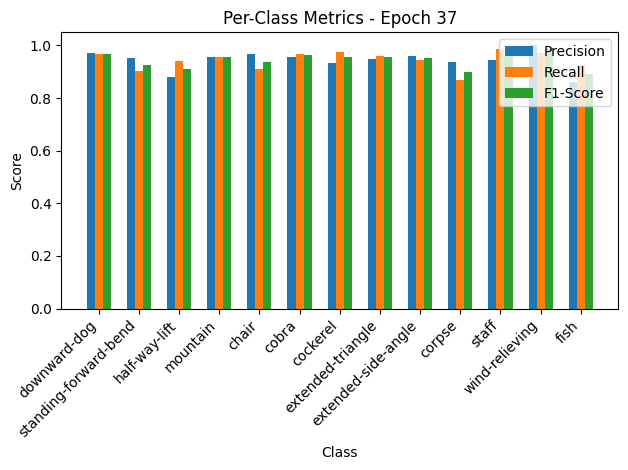


Epoch 38/50 Summary:
Train Loss: 0.1959 | Train Acc: 94.35% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.2345 | Val Acc: 92.47% | Val Precision: 0.94 | Val Recall: 0.92 | Val F1: 0.92

Epoch 39/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:01<00:00, 42.42it/s, loss=0.192, accuracy=95.5]


Per-Class Metrics for Epoch 38:
downward-dog: Precision=0.97, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.98, Recall=0.90, F1-Score=0.94
half-way-lift: Precision=0.91, Recall=0.96, F1-Score=0.94
mountain: Precision=0.96, Recall=0.97, F1-Score=0.97
chair: Precision=0.98, Recall=0.95, F1-Score=0.96
cobra: Precision=0.99, Recall=0.99, F1-Score=0.99
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.99, F1-Score=0.97
corpse: Precision=0.88, Recall=0.88, F1-Score=0.88
staff: Precision=0.94, Recall=1.00, F1-Score=0.97
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.89, Recall=0.87, F1-Score=0.88


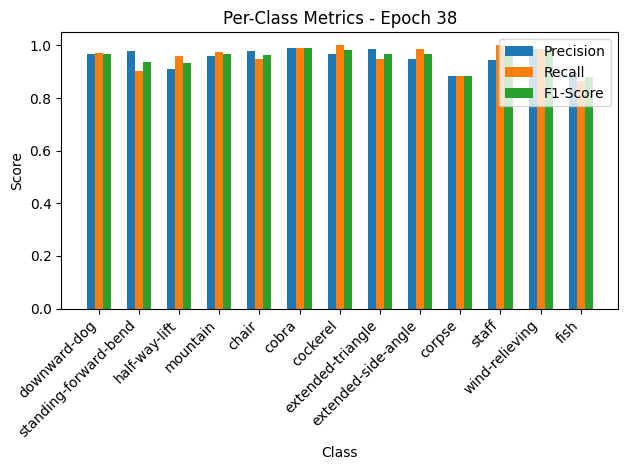

Validation: 100%|██████████| 10/10 [00:00<00:00, 181.35it/s, loss=0.168, accuracy=94.5]


Per-Class Metrics for Epoch 38:
downward-dog: Precision=0.97, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.98, Recall=0.90, F1-Score=0.94
half-way-lift: Precision=0.91, Recall=0.96, F1-Score=0.94
mountain: Precision=0.96, Recall=0.97, F1-Score=0.97
chair: Precision=0.98, Recall=0.95, F1-Score=0.96
cobra: Precision=0.99, Recall=0.99, F1-Score=0.99
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.99, F1-Score=0.97
corpse: Precision=0.88, Recall=0.88, F1-Score=0.88
staff: Precision=0.94, Recall=1.00, F1-Score=0.97
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.89, Recall=0.87, F1-Score=0.88


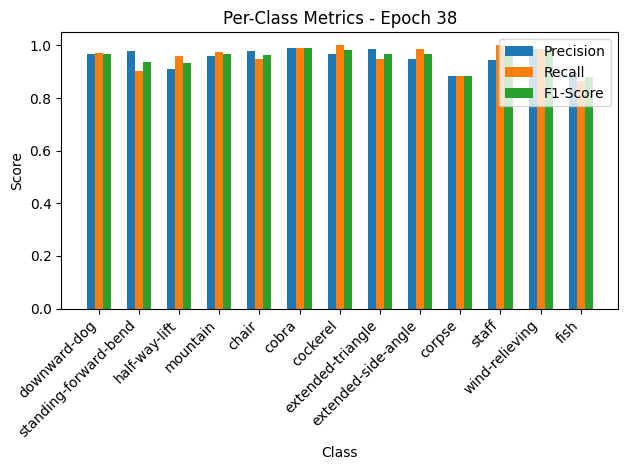


Epoch 39/50 Summary:
Train Loss: 0.1922 | Train Acc: 95.49% | Train Precision: 0.95 | Train Recall: 0.96 | Train F1: 0.95
Val Loss: 0.1841 | Val Acc: 94.52% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 40/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:01<00:00, 41.68it/s, loss=0.166, accuracy=95]


Per-Class Metrics for Epoch 39:
downward-dog: Precision=0.99, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.94, Recall=0.90, F1-Score=0.92
half-way-lift: Precision=0.90, Recall=0.94, F1-Score=0.92
mountain: Precision=0.94, Recall=0.97, F1-Score=0.96
chair: Precision=0.97, Recall=0.92, F1-Score=0.94
cobra: Precision=0.95, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.92, Recall=0.87, F1-Score=0.89
staff: Precision=0.96, Recall=1.00, F1-Score=0.98
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.88, Recall=0.91, F1-Score=0.90


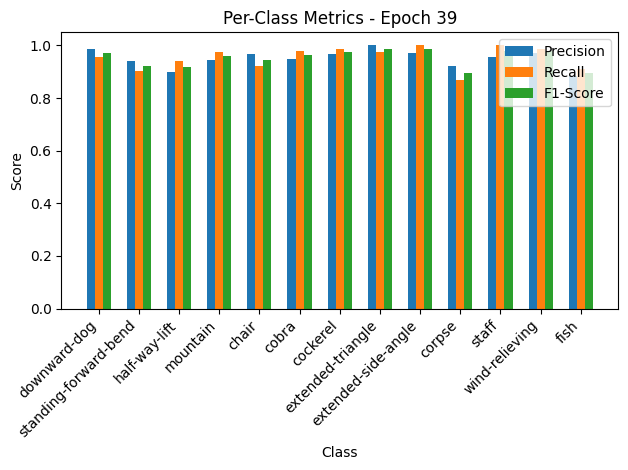

Validation: 100%|██████████| 10/10 [00:00<00:00, 157.81it/s, loss=0.185, accuracy=91.8]


Per-Class Metrics for Epoch 39:
downward-dog: Precision=0.99, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.94, Recall=0.90, F1-Score=0.92
half-way-lift: Precision=0.90, Recall=0.94, F1-Score=0.92
mountain: Precision=0.94, Recall=0.97, F1-Score=0.96
chair: Precision=0.97, Recall=0.92, F1-Score=0.94
cobra: Precision=0.95, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.92, Recall=0.87, F1-Score=0.89
staff: Precision=0.96, Recall=1.00, F1-Score=0.98
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.88, Recall=0.91, F1-Score=0.90


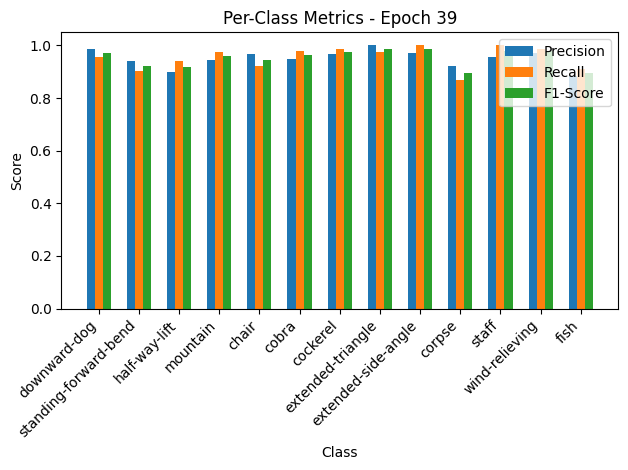


Epoch 40/50 Summary:
Train Loss: 0.1666 | Train Acc: 95.03% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.2030 | Val Acc: 91.78% | Val Precision: 0.92 | Val Recall: 0.92 | Val F1: 0.91

Epoch 41/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:02<00:00, 40.71it/s, loss=0.2, accuracy=94.2]


Per-Class Metrics for Epoch 40:
downward-dog: Precision=0.97, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.96, Recall=0.86, F1-Score=0.91
half-way-lift: Precision=0.88, Recall=0.96, F1-Score=0.92
mountain: Precision=0.95, Recall=0.97, F1-Score=0.96
chair: Precision=0.95, Recall=0.94, F1-Score=0.95
cobra: Precision=0.96, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.95, F1-Score=0.96
extended-side-angle: Precision=0.95, Recall=0.97, F1-Score=0.96
corpse: Precision=0.91, Recall=0.90, F1-Score=0.90
staff: Precision=0.94, Recall=0.97, F1-Score=0.96
wind-relieving: Precision=0.97, Recall=0.96, F1-Score=0.96
fish: Precision=0.88, Recall=0.88, F1-Score=0.88


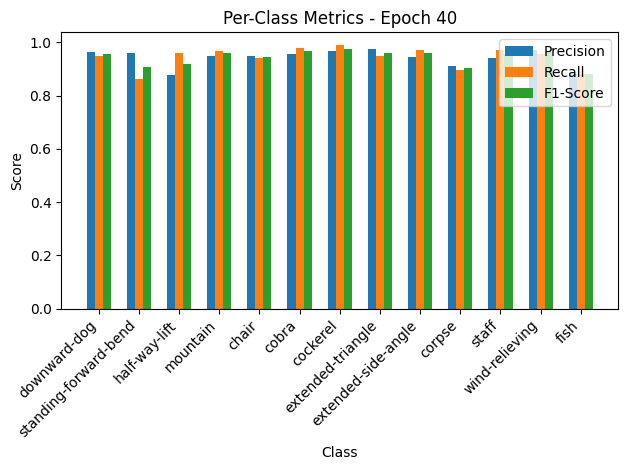

Validation: 100%|██████████| 10/10 [00:00<00:00, 179.14it/s, loss=0.165, accuracy=94.5]


Per-Class Metrics for Epoch 40:
downward-dog: Precision=0.97, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.96, Recall=0.86, F1-Score=0.91
half-way-lift: Precision=0.88, Recall=0.96, F1-Score=0.92
mountain: Precision=0.95, Recall=0.97, F1-Score=0.96
chair: Precision=0.95, Recall=0.94, F1-Score=0.95
cobra: Precision=0.96, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.95, F1-Score=0.96
extended-side-angle: Precision=0.95, Recall=0.97, F1-Score=0.96
corpse: Precision=0.91, Recall=0.90, F1-Score=0.90
staff: Precision=0.94, Recall=0.97, F1-Score=0.96
wind-relieving: Precision=0.97, Recall=0.96, F1-Score=0.96
fish: Precision=0.88, Recall=0.88, F1-Score=0.88


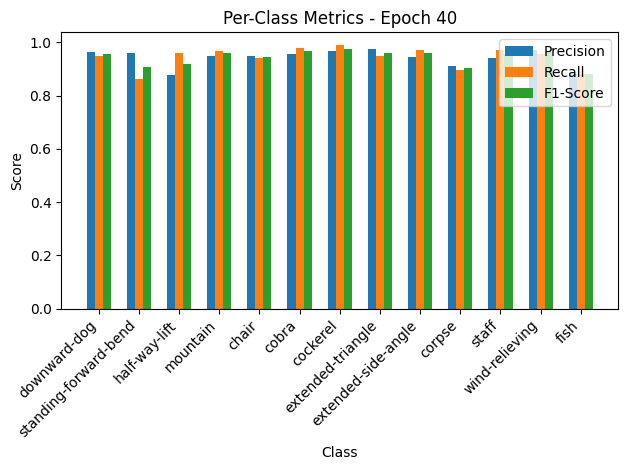


Epoch 41/50 Summary:
Train Loss: 0.2000 | Train Acc: 94.19% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.1811 | Val Acc: 94.52% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.94

Epoch 42/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:02<00:00, 37.19it/s, loss=0.214, accuracy=93.8]


Per-Class Metrics for Epoch 41:
downward-dog: Precision=0.98, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.96, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.90, Recall=0.96, F1-Score=0.93
mountain: Precision=0.93, Recall=0.96, F1-Score=0.94
chair: Precision=0.95, Recall=0.92, F1-Score=0.93
cobra: Precision=0.96, Recall=0.96, F1-Score=0.96
cockerel: Precision=0.93, Recall=1.00, F1-Score=0.97
extended-triangle: Precision=0.99, Recall=0.92, F1-Score=0.95
extended-side-angle: Precision=0.94, Recall=1.00, F1-Score=0.97
corpse: Precision=0.89, Recall=0.75, F1-Score=0.82
staff: Precision=0.96, Recall=0.99, F1-Score=0.97
wind-relieving: Precision=0.97, Recall=0.96, F1-Score=0.96
fish: Precision=0.80, Recall=0.91, F1-Score=0.85


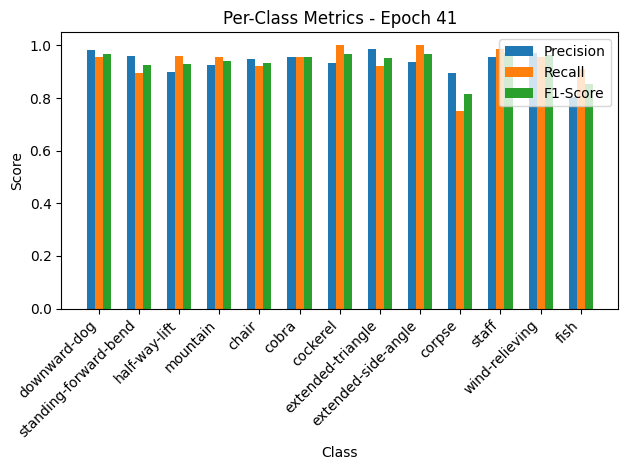

Validation: 100%|██████████| 10/10 [00:00<00:00, 180.76it/s, loss=0.166, accuracy=93.8]


Per-Class Metrics for Epoch 41:
downward-dog: Precision=0.98, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.96, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.90, Recall=0.96, F1-Score=0.93
mountain: Precision=0.93, Recall=0.96, F1-Score=0.94
chair: Precision=0.95, Recall=0.92, F1-Score=0.93
cobra: Precision=0.96, Recall=0.96, F1-Score=0.96
cockerel: Precision=0.93, Recall=1.00, F1-Score=0.97
extended-triangle: Precision=0.99, Recall=0.92, F1-Score=0.95
extended-side-angle: Precision=0.94, Recall=1.00, F1-Score=0.97
corpse: Precision=0.89, Recall=0.75, F1-Score=0.82
staff: Precision=0.96, Recall=0.99, F1-Score=0.97
wind-relieving: Precision=0.97, Recall=0.96, F1-Score=0.96
fish: Precision=0.80, Recall=0.91, F1-Score=0.85


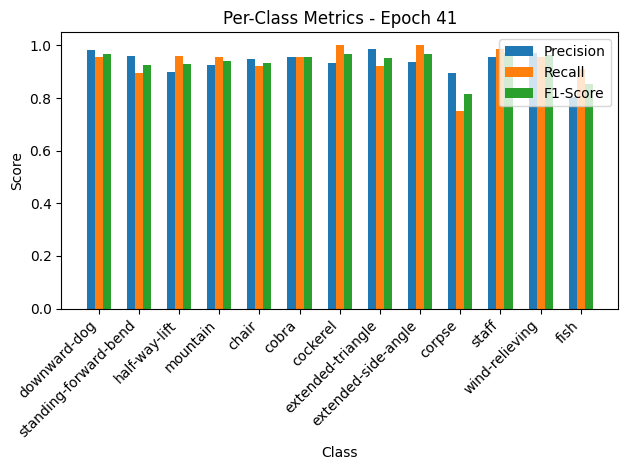


Epoch 42/50 Summary:
Train Loss: 0.2142 | Train Acc: 93.81% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.93
Val Loss: 0.1822 | Val Acc: 93.84% | Val Precision: 0.94 | Val Recall: 0.94 | Val F1: 0.93

Epoch 43/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:01<00:00, 42.06it/s, loss=0.176, accuracy=95.1]


Per-Class Metrics for Epoch 42:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.90, F1-Score=0.92
half-way-lift: Precision=0.90, Recall=0.94, F1-Score=0.92
mountain: Precision=0.95, Recall=0.97, F1-Score=0.96
chair: Precision=0.95, Recall=0.94, F1-Score=0.95
cobra: Precision=0.98, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=0.97, F1-Score=0.96
extended-side-angle: Precision=0.97, Recall=0.96, F1-Score=0.97
corpse: Precision=0.95, Recall=0.88, F1-Score=0.92
staff: Precision=0.96, Recall=0.97, F1-Score=0.96
wind-relieving: Precision=0.96, Recall=0.97, F1-Score=0.96
fish: Precision=0.90, Recall=0.94, F1-Score=0.92


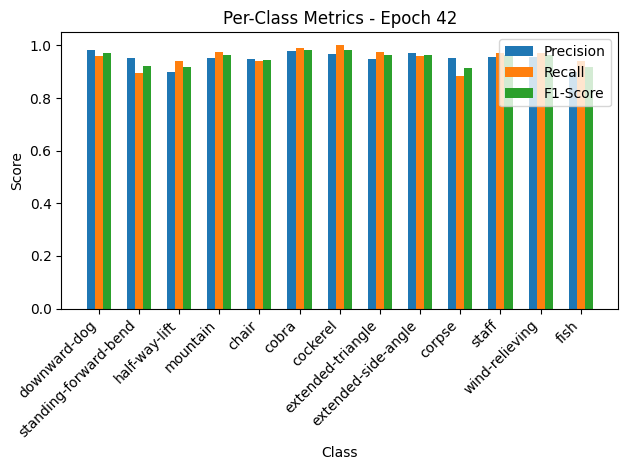

Validation: 100%|██████████| 10/10 [00:00<00:00, 173.61it/s, loss=0.222, accuracy=93.8]


Per-Class Metrics for Epoch 42:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.90, F1-Score=0.92
half-way-lift: Precision=0.90, Recall=0.94, F1-Score=0.92
mountain: Precision=0.95, Recall=0.97, F1-Score=0.96
chair: Precision=0.95, Recall=0.94, F1-Score=0.95
cobra: Precision=0.98, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=0.97, F1-Score=0.96
extended-side-angle: Precision=0.97, Recall=0.96, F1-Score=0.97
corpse: Precision=0.95, Recall=0.88, F1-Score=0.92
staff: Precision=0.96, Recall=0.97, F1-Score=0.96
wind-relieving: Precision=0.96, Recall=0.97, F1-Score=0.96
fish: Precision=0.90, Recall=0.94, F1-Score=0.92


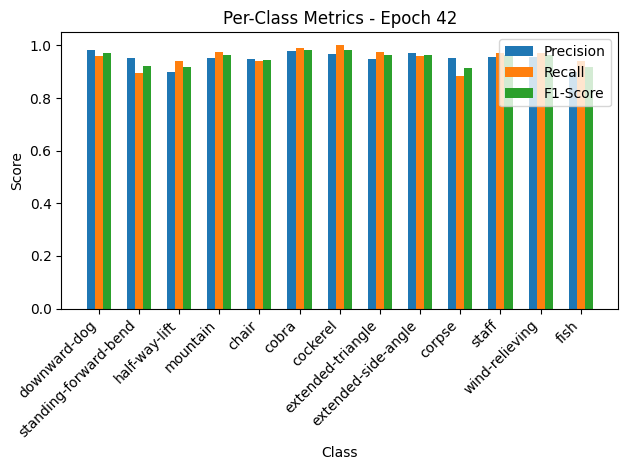


Epoch 43/50 Summary:
Train Loss: 0.1763 | Train Acc: 95.11% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.2435 | Val Acc: 93.84% | Val Precision: 0.95 | Val Recall: 0.94 | Val F1: 0.94

Epoch 44/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:02<00:00, 40.10it/s, loss=0.164, accuracy=95.5]


Per-Class Metrics for Epoch 43:
downward-dog: Precision=0.98, Recall=0.94, F1-Score=0.96
standing-forward-bend: Precision=0.98, Recall=0.91, F1-Score=0.95
half-way-lift: Precision=0.91, Recall=0.97, F1-Score=0.94
mountain: Precision=0.97, Recall=0.98, F1-Score=0.97
chair: Precision=0.98, Recall=0.96, F1-Score=0.97
cobra: Precision=0.95, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.96, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.97, Recall=0.95, F1-Score=0.96
extended-side-angle: Precision=0.95, Recall=0.97, F1-Score=0.96
corpse: Precision=0.90, Recall=0.88, F1-Score=0.89
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.96, F1-Score=0.98
fish: Precision=0.88, Recall=0.91, F1-Score=0.90


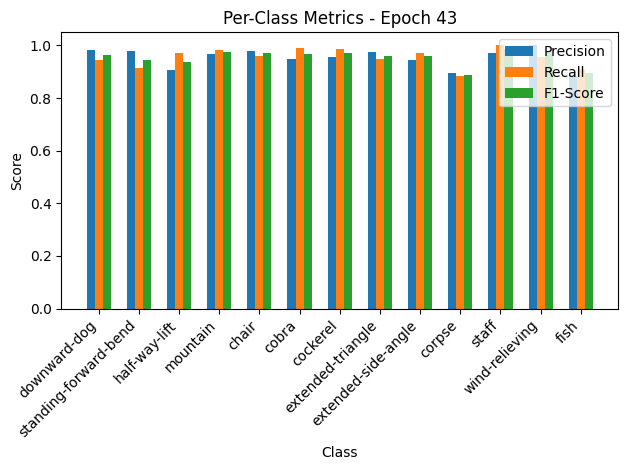

Validation: 100%|██████████| 10/10 [00:00<00:00, 166.13it/s, loss=0.161, accuracy=95.9]


Per-Class Metrics for Epoch 43:
downward-dog: Precision=0.98, Recall=0.94, F1-Score=0.96
standing-forward-bend: Precision=0.98, Recall=0.91, F1-Score=0.95
half-way-lift: Precision=0.91, Recall=0.97, F1-Score=0.94
mountain: Precision=0.97, Recall=0.98, F1-Score=0.97
chair: Precision=0.98, Recall=0.96, F1-Score=0.97
cobra: Precision=0.95, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.96, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.97, Recall=0.95, F1-Score=0.96
extended-side-angle: Precision=0.95, Recall=0.97, F1-Score=0.96
corpse: Precision=0.90, Recall=0.88, F1-Score=0.89
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.96, F1-Score=0.98
fish: Precision=0.88, Recall=0.91, F1-Score=0.90


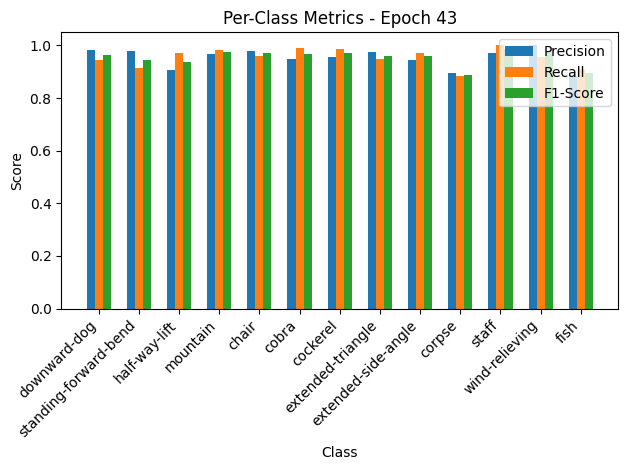


Epoch 44/50 Summary:
Train Loss: 0.1640 | Train Acc: 95.49% | Train Precision: 0.95 | Train Recall: 0.96 | Train F1: 0.95
Val Loss: 0.1769 | Val Acc: 95.89% | Val Precision: 0.96 | Val Recall: 0.97 | Val F1: 0.96

Epoch 45/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:02<00:00, 39.99it/s, loss=0.162, accuracy=95.6]


Per-Class Metrics for Epoch 44:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.96, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.90, Recall=0.95, F1-Score=0.93
mountain: Precision=0.96, Recall=0.96, F1-Score=0.96
chair: Precision=0.97, Recall=0.95, F1-Score=0.96
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.95, Recall=0.88, F1-Score=0.92
staff: Precision=0.93, Recall=1.00, F1-Score=0.96
wind-relieving: Precision=0.96, Recall=0.99, F1-Score=0.97
fish: Precision=0.90, Recall=0.93, F1-Score=0.91


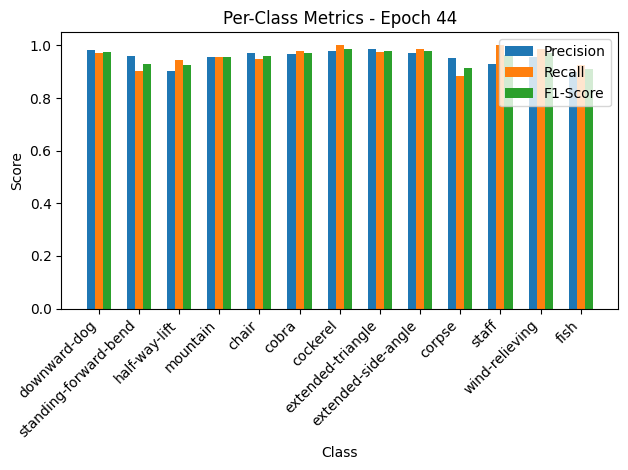

Validation: 100%|██████████| 10/10 [00:00<00:00, 131.76it/s, loss=0.168, accuracy=94.5]


Per-Class Metrics for Epoch 44:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.96, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.90, Recall=0.95, F1-Score=0.93
mountain: Precision=0.96, Recall=0.96, F1-Score=0.96
chair: Precision=0.97, Recall=0.95, F1-Score=0.96
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.95, Recall=0.88, F1-Score=0.92
staff: Precision=0.93, Recall=1.00, F1-Score=0.96
wind-relieving: Precision=0.96, Recall=0.99, F1-Score=0.97
fish: Precision=0.90, Recall=0.93, F1-Score=0.91


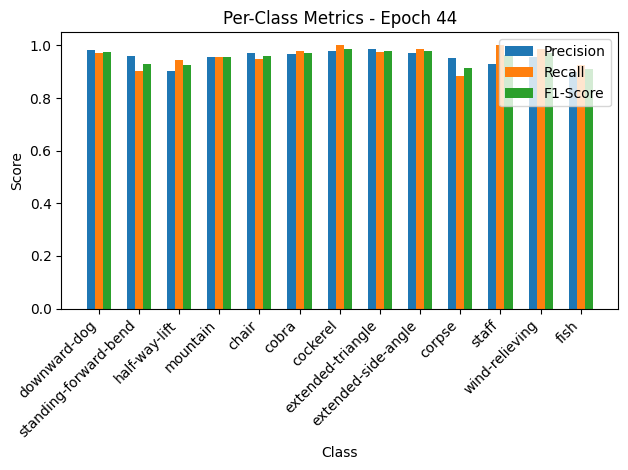


Epoch 45/50 Summary:
Train Loss: 0.1622 | Train Acc: 95.57% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.1836 | Val Acc: 94.52% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.94

Epoch 46/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:02<00:00, 34.16it/s, loss=0.166, accuracy=95.6]


Per-Class Metrics for Epoch 45:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.99, Recall=0.90, F1-Score=0.94
half-way-lift: Precision=0.90, Recall=0.97, F1-Score=0.94
mountain: Precision=0.97, Recall=0.98, F1-Score=0.97
chair: Precision=0.97, Recall=0.95, F1-Score=0.96
cobra: Precision=0.95, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.96, Recall=0.96, F1-Score=0.96
extended-side-angle: Precision=0.96, Recall=0.95, F1-Score=0.95
corpse: Precision=0.90, Recall=0.94, F1-Score=0.92
staff: Precision=0.94, Recall=0.99, F1-Score=0.96
wind-relieving: Precision=0.97, Recall=0.94, F1-Score=0.96
fish: Precision=0.91, Recall=0.88, F1-Score=0.89


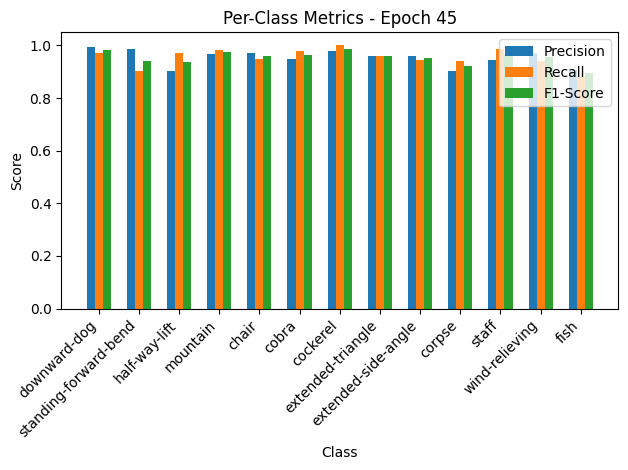

Validation: 100%|██████████| 10/10 [00:00<00:00, 138.66it/s, loss=0.161, accuracy=94.5]


Per-Class Metrics for Epoch 45:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.99, Recall=0.90, F1-Score=0.94
half-way-lift: Precision=0.90, Recall=0.97, F1-Score=0.94
mountain: Precision=0.97, Recall=0.98, F1-Score=0.97
chair: Precision=0.97, Recall=0.95, F1-Score=0.96
cobra: Precision=0.95, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.96, Recall=0.96, F1-Score=0.96
extended-side-angle: Precision=0.96, Recall=0.95, F1-Score=0.95
corpse: Precision=0.90, Recall=0.94, F1-Score=0.92
staff: Precision=0.94, Recall=0.99, F1-Score=0.96
wind-relieving: Precision=0.97, Recall=0.94, F1-Score=0.96
fish: Precision=0.91, Recall=0.88, F1-Score=0.89


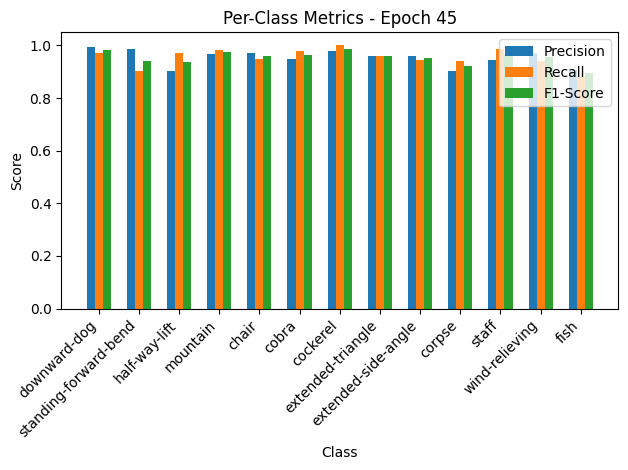


Epoch 46/50 Summary:
Train Loss: 0.1662 | Train Acc: 95.57% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.1767 | Val Acc: 94.52% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.94

Epoch 47/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:02<00:00, 40.58it/s, loss=0.155, accuracy=95.9]


Per-Class Metrics for Epoch 46:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.99, Recall=0.90, F1-Score=0.94
half-way-lift: Precision=0.91, Recall=0.98, F1-Score=0.95
mountain: Precision=0.96, Recall=0.97, F1-Score=0.96
chair: Precision=0.96, Recall=0.94, F1-Score=0.95
cobra: Precision=0.98, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.95, Recall=0.98, F1-Score=0.97
extended-triangle: Precision=0.96, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.96, F1-Score=0.96
corpse: Precision=0.94, Recall=0.94, F1-Score=0.94
staff: Precision=0.96, Recall=1.00, F1-Score=0.98
wind-relieving: Precision=0.97, Recall=1.00, F1-Score=0.99
fish: Precision=0.94, Recall=0.90, F1-Score=0.92


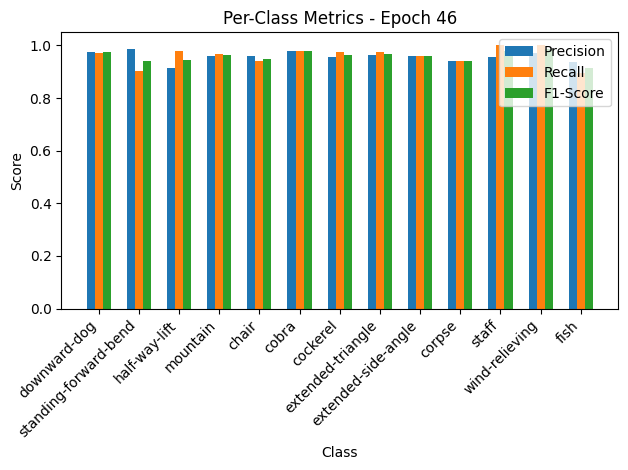

Validation: 100%|██████████| 10/10 [00:00<00:00, 172.85it/s, loss=0.156, accuracy=95.9]


Per-Class Metrics for Epoch 46:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.99, Recall=0.90, F1-Score=0.94
half-way-lift: Precision=0.91, Recall=0.98, F1-Score=0.95
mountain: Precision=0.96, Recall=0.97, F1-Score=0.96
chair: Precision=0.96, Recall=0.94, F1-Score=0.95
cobra: Precision=0.98, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.95, Recall=0.98, F1-Score=0.97
extended-triangle: Precision=0.96, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.96, F1-Score=0.96
corpse: Precision=0.94, Recall=0.94, F1-Score=0.94
staff: Precision=0.96, Recall=1.00, F1-Score=0.98
wind-relieving: Precision=0.97, Recall=1.00, F1-Score=0.99
fish: Precision=0.94, Recall=0.90, F1-Score=0.92


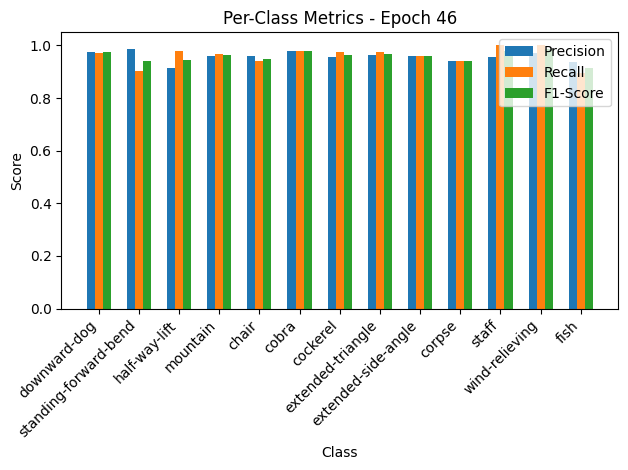


Epoch 47/50 Summary:
Train Loss: 0.1555 | Train Acc: 95.87% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.1714 | Val Acc: 95.89% | Val Precision: 0.96 | Val Recall: 0.97 | Val F1: 0.96
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_3.pth
Checkpoint saved at epoch 47
New best model saved! Validation Loss: 0.1714

Epoch 48/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:01<00:00, 41.36it/s, loss=0.157, accuracy=96.1]


Per-Class Metrics for Epoch 47:
downward-dog: Precision=1.00, Recall=0.95, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.90, Recall=0.97, F1-Score=0.94
mountain: Precision=0.96, Recall=0.97, F1-Score=0.97
chair: Precision=0.98, Recall=0.94, F1-Score=0.96
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.96, Recall=0.96, F1-Score=0.96
extended-side-angle: Precision=0.96, Recall=0.96, F1-Score=0.96
corpse: Precision=0.93, Recall=0.97, F1-Score=0.95
staff: Precision=0.94, Recall=1.00, F1-Score=0.97
wind-relieving: Precision=0.97, Recall=1.00, F1-Score=0.99
fish: Precision=0.98, Recall=0.90, F1-Score=0.94


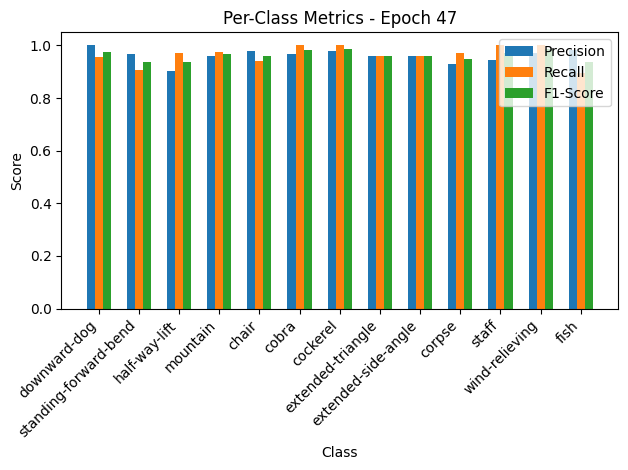

Validation: 100%|██████████| 10/10 [00:00<00:00, 141.71it/s, loss=0.156, accuracy=93.8]


Per-Class Metrics for Epoch 47:
downward-dog: Precision=1.00, Recall=0.95, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.90, Recall=0.97, F1-Score=0.94
mountain: Precision=0.96, Recall=0.97, F1-Score=0.97
chair: Precision=0.98, Recall=0.94, F1-Score=0.96
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.96, Recall=0.96, F1-Score=0.96
extended-side-angle: Precision=0.96, Recall=0.96, F1-Score=0.96
corpse: Precision=0.93, Recall=0.97, F1-Score=0.95
staff: Precision=0.94, Recall=1.00, F1-Score=0.97
wind-relieving: Precision=0.97, Recall=1.00, F1-Score=0.99
fish: Precision=0.98, Recall=0.90, F1-Score=0.94


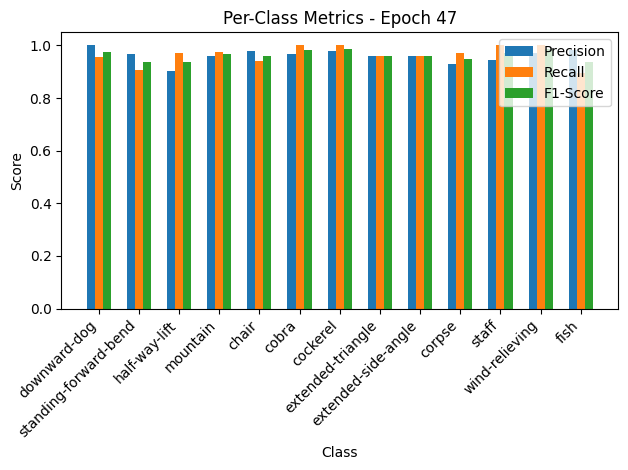


Epoch 48/50 Summary:
Train Loss: 0.1570 | Train Acc: 96.10% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.1704 | Val Acc: 93.84% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.94
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_3.pth
Checkpoint saved at epoch 48
New best model saved! Validation Loss: 0.1704

Epoch 49/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:02<00:00, 40.33it/s, loss=0.15, accuracy=96.2]


Per-Class Metrics for Epoch 48:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.98, Recall=0.92, F1-Score=0.95
half-way-lift: Precision=0.91, Recall=0.97, F1-Score=0.94
mountain: Precision=0.97, Recall=0.96, F1-Score=0.96
chair: Precision=0.96, Recall=0.95, F1-Score=0.96
cobra: Precision=0.98, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.93, Recall=0.93, F1-Score=0.93
staff: Precision=0.94, Recall=1.00, F1-Score=0.97
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.93, Recall=0.93, F1-Score=0.93


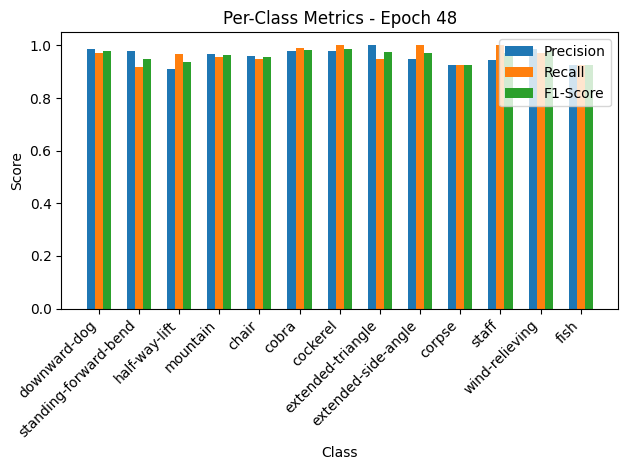

Validation: 100%|██████████| 10/10 [00:00<00:00, 175.89it/s, loss=0.157, accuracy=95.2]


Per-Class Metrics for Epoch 48:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.98, Recall=0.92, F1-Score=0.95
half-way-lift: Precision=0.91, Recall=0.97, F1-Score=0.94
mountain: Precision=0.97, Recall=0.96, F1-Score=0.96
chair: Precision=0.96, Recall=0.95, F1-Score=0.96
cobra: Precision=0.98, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.93, Recall=0.93, F1-Score=0.93
staff: Precision=0.94, Recall=1.00, F1-Score=0.97
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.93, Recall=0.93, F1-Score=0.93


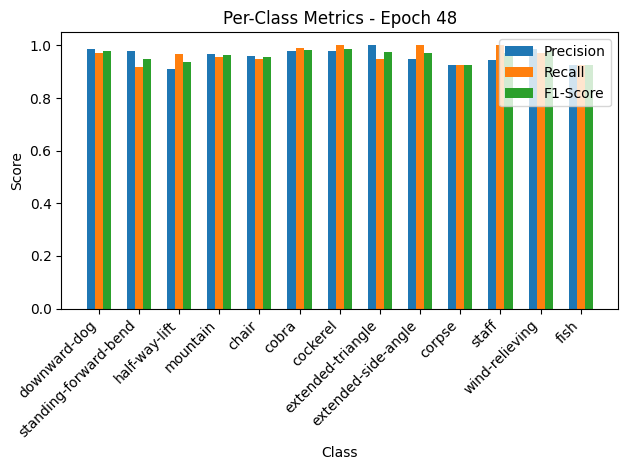


Epoch 49/50 Summary:
Train Loss: 0.1505 | Train Acc: 96.18% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.1719 | Val Acc: 95.21% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.95

Epoch 50/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:02<00:00, 37.09it/s, loss=0.153, accuracy=96]


Per-Class Metrics for Epoch 49:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.99, Recall=0.92, F1-Score=0.96
half-way-lift: Precision=0.91, Recall=0.97, F1-Score=0.94
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.94, Recall=0.96, F1-Score=0.95
cobra: Precision=0.99, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.98, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.99, F1-Score=0.97
corpse: Precision=0.97, Recall=0.88, F1-Score=0.92
staff: Precision=0.96, Recall=0.99, F1-Score=0.97
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.89, Recall=0.94, F1-Score=0.91


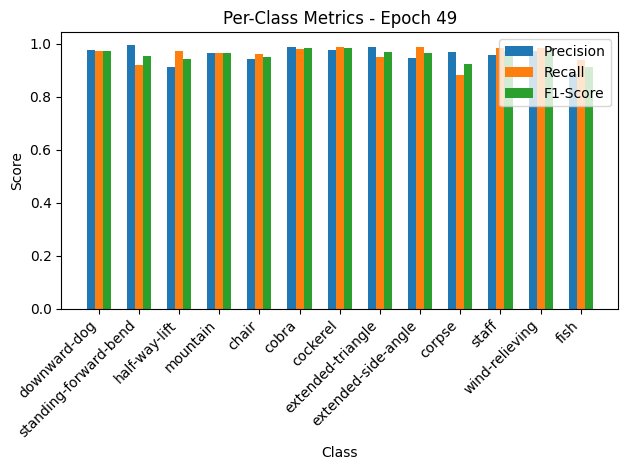

Validation: 100%|██████████| 10/10 [00:00<00:00, 162.71it/s, loss=0.155, accuracy=95.9]


Per-Class Metrics for Epoch 49:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.99, Recall=0.92, F1-Score=0.96
half-way-lift: Precision=0.91, Recall=0.97, F1-Score=0.94
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.94, Recall=0.96, F1-Score=0.95
cobra: Precision=0.99, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.98, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.99, F1-Score=0.97
corpse: Precision=0.97, Recall=0.88, F1-Score=0.92
staff: Precision=0.96, Recall=0.99, F1-Score=0.97
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.89, Recall=0.94, F1-Score=0.91


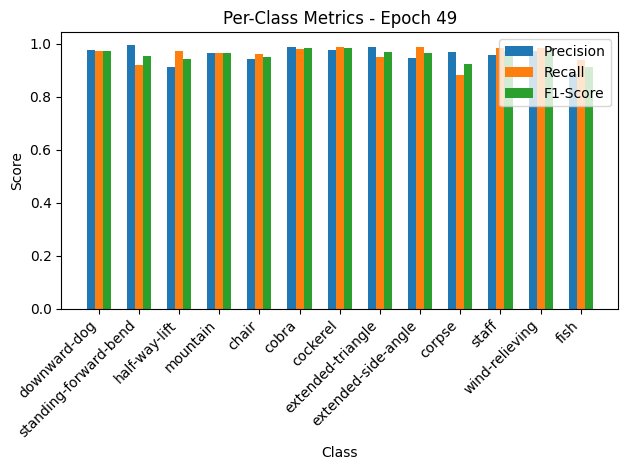


Epoch 50/50 Summary:
Train Loss: 0.1533 | Train Acc: 96.03% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.1700 | Val Acc: 95.89% | Val Precision: 0.96 | Val Recall: 0.97 | Val F1: 0.96
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_3.pth
Checkpoint saved at epoch 50
New best model saved! Validation Loss: 0.1700


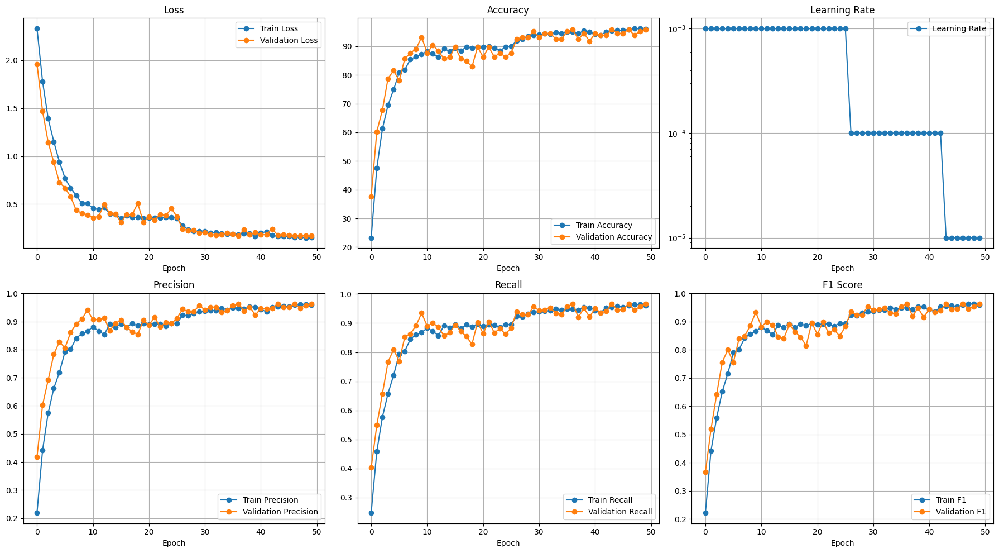

Testing: 100%|██████████| 23/23 [00:00<00:00, 112.53it/s]


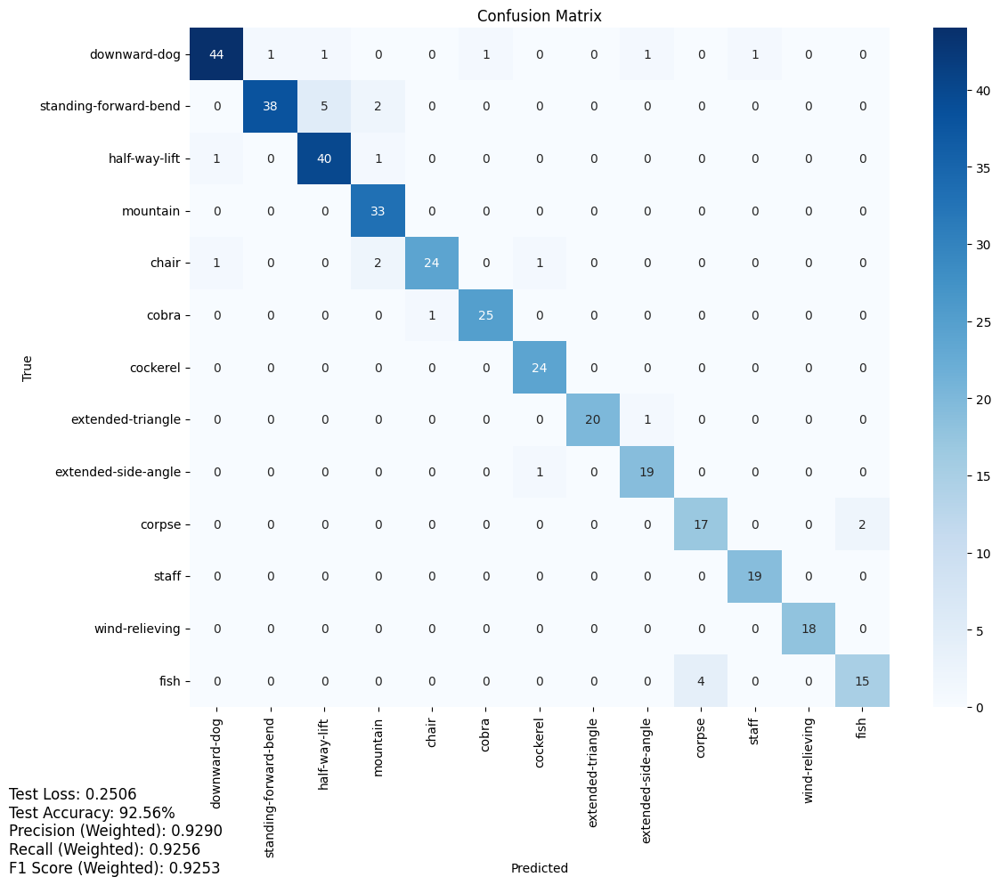

Test Loss: 0.2506
Test Accuracy: 92.56%
Precision (Weighted): 0.9290
Recall (Weighted): 0.9256
F1 Score (Weighted): 0.9253


Testing: 100%|██████████| 23/23 [00:00<00:00, 129.27it/s]


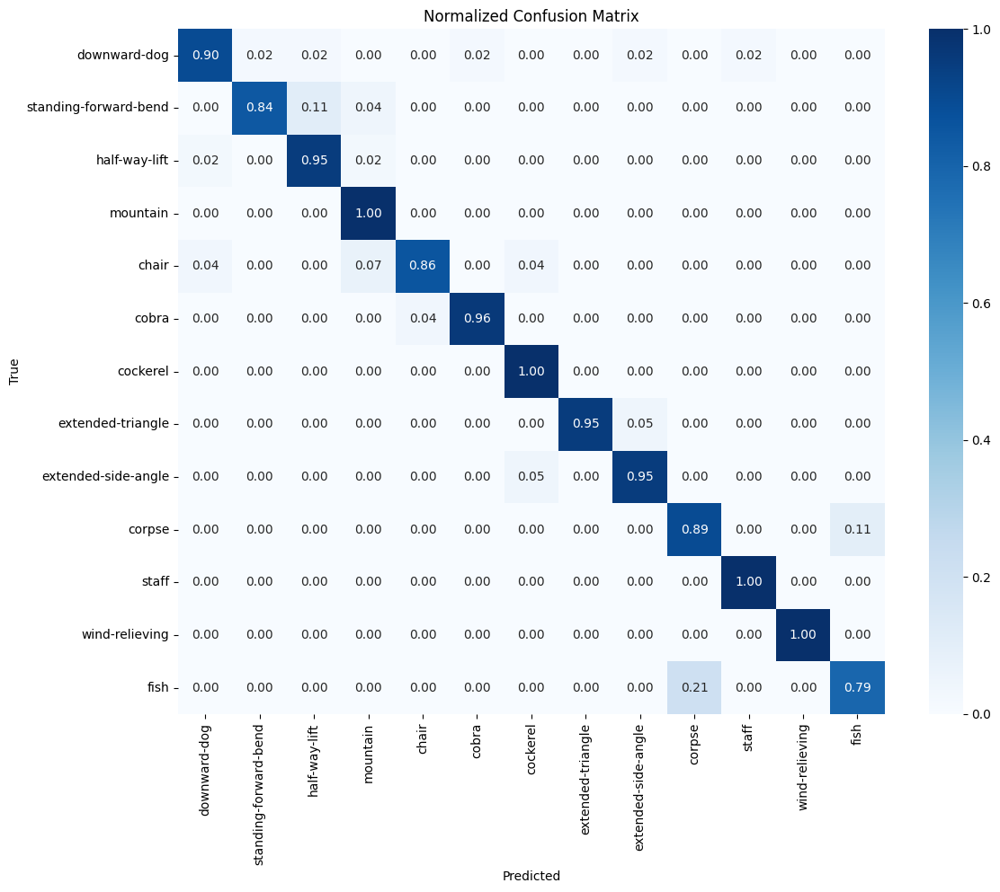

Test Loss: 0.2506
Test Accuracy: 92.56%
Precision (Macro): 0.9277
Recall (Macro): 0.9308
F1 Score (Macro): 0.9275
Saved checkpoint for fold 4
Fold 5/5
Loading cached criterion for fold 4
batch_norm.weight: 99
batch_norm.bias: 99
conv1.0.weight: 288
conv1.0.bias: 32
conv1.1.weight: 32
conv1.1.bias: 32
blk1.conv1.weight: 6144
blk1.conv1.bias: 64
blk1.bn1.weight: 64
blk1.bn1.bias: 64
blk1.conv2.weight: 12288
blk1.conv2.bias: 64
blk1.bn2.weight: 64
blk1.bn2.bias: 64
blk1.shortcut.0.weight: 2048
blk1.shortcut.0.bias: 64
blk1.shortcut.1.weight: 64
blk1.shortcut.1.bias: 64
blk2.conv1.weight: 24576
blk2.conv1.bias: 128
blk2.bn1.weight: 128
blk2.bn1.bias: 128
blk2.conv2.weight: 49152
blk2.conv2.bias: 128
blk2.bn2.weight: 128
blk2.bn2.bias: 128
blk2.shortcut.0.weight: 8192
blk2.shortcut.0.bias: 128
blk2.shortcut.1.weight: 128
blk2.shortcut.1.bias: 128
blk3.conv1.weight: 98304
blk3.conv1.bias: 256
blk3.bn1.weight: 256
blk3.bn1.bias: 256
blk3.conv2.weight: 196608
blk3.conv2.bias: 256
blk3.bn2.weig

Training: 100%|██████████| 82/82 [00:01<00:00, 41.11it/s, loss=2.24, accuracy=28.6]


Per-Class Metrics for Epoch 0:
downward-dog: Precision=0.36, Recall=0.16, F1-Score=0.22
standing-forward-bend: Precision=0.29, Recall=0.30, F1-Score=0.29
half-way-lift: Precision=0.37, Recall=0.36, F1-Score=0.36
mountain: Precision=0.44, Recall=0.23, F1-Score=0.30
chair: Precision=0.30, Recall=0.32, F1-Score=0.31
cobra: Precision=0.27, Recall=0.32, F1-Score=0.29
cockerel: Precision=0.36, Recall=0.55, F1-Score=0.44
extended-triangle: Precision=0.26, Recall=0.44, F1-Score=0.32
extended-side-angle: Precision=0.14, Recall=0.27, F1-Score=0.19
corpse: Precision=0.23, Recall=0.10, F1-Score=0.14
staff: Precision=0.19, Recall=0.19, F1-Score=0.19
wind-relieving: Precision=0.26, Recall=0.47, F1-Score=0.34
fish: Precision=0.12, Recall=0.04, F1-Score=0.07


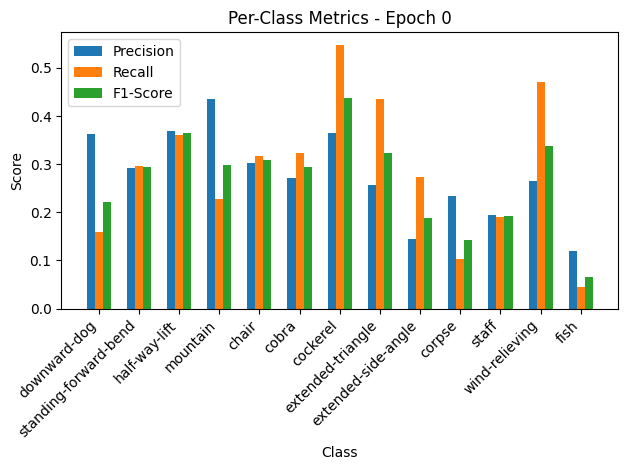

Validation: 100%|██████████| 10/10 [00:00<00:00, 178.15it/s, loss=1.69, accuracy=47.3]


Per-Class Metrics for Epoch 0:
downward-dog: Precision=0.36, Recall=0.16, F1-Score=0.22
standing-forward-bend: Precision=0.29, Recall=0.30, F1-Score=0.29
half-way-lift: Precision=0.37, Recall=0.36, F1-Score=0.36
mountain: Precision=0.44, Recall=0.23, F1-Score=0.30
chair: Precision=0.30, Recall=0.32, F1-Score=0.31
cobra: Precision=0.27, Recall=0.32, F1-Score=0.29
cockerel: Precision=0.36, Recall=0.55, F1-Score=0.44
extended-triangle: Precision=0.26, Recall=0.44, F1-Score=0.32
extended-side-angle: Precision=0.14, Recall=0.27, F1-Score=0.19
corpse: Precision=0.23, Recall=0.10, F1-Score=0.14
staff: Precision=0.19, Recall=0.19, F1-Score=0.19
wind-relieving: Precision=0.26, Recall=0.47, F1-Score=0.34
fish: Precision=0.12, Recall=0.04, F1-Score=0.07


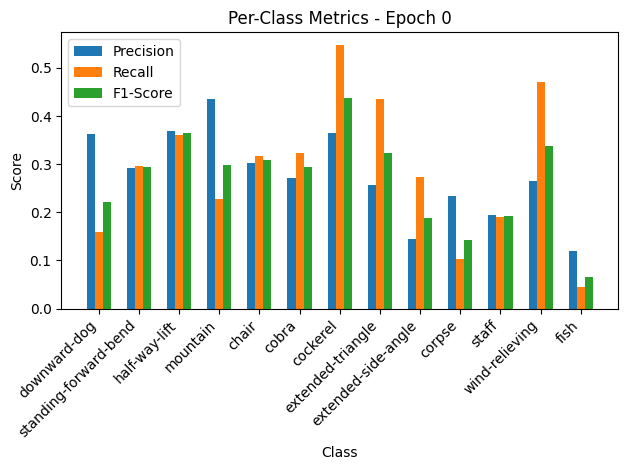


Epoch 1/50 Summary:
Train Loss: 2.2451 | Train Acc: 28.65% | Train Precision: 0.28 | Train Recall: 0.29 | Train F1: 0.27
Val Loss: 1.8472 | Val Acc: 47.26% | Val Precision: 0.56 | Val Recall: 0.49 | Val F1: 0.45
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_4.pth
Checkpoint saved at epoch 1
New best model saved! Validation Loss: 1.8472

Epoch 2/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 40.38it/s, loss=1.63, accuracy=50.1]


Per-Class Metrics for Epoch 1:
downward-dog: Precision=0.88, Recall=0.33, F1-Score=0.48
standing-forward-bend: Precision=0.62, Recall=0.48, F1-Score=0.54
half-way-lift: Precision=0.52, Recall=0.72, F1-Score=0.61
mountain: Precision=0.58, Recall=0.73, F1-Score=0.65
chair: Precision=0.45, Recall=0.42, F1-Score=0.43
cobra: Precision=0.40, Recall=0.34, F1-Score=0.37
cockerel: Precision=0.58, Recall=0.78, F1-Score=0.66
extended-triangle: Precision=0.43, Recall=0.72, F1-Score=0.54
extended-side-angle: Precision=0.31, Recall=0.30, F1-Score=0.31
corpse: Precision=0.23, Recall=0.44, F1-Score=0.31
staff: Precision=0.50, Recall=0.16, F1-Score=0.24
wind-relieving: Precision=0.59, Recall=0.79, F1-Score=0.68
fish: Precision=0.36, Recall=0.18, F1-Score=0.24


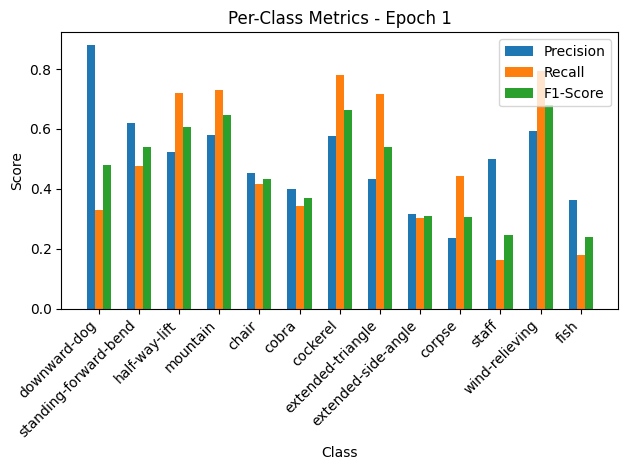

Validation: 100%|██████████| 10/10 [00:00<00:00, 165.94it/s, loss=1.14, accuracy=65.8]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 1:
downward-dog: Precision=0.88, Recall=0.33, F1-Score=0.48
standing-forward-bend: Precision=0.62, Recall=0.48, F1-Score=0.54
half-way-lift: Precision=0.52, Recall=0.72, F1-Score=0.61
mountain: Precision=0.58, Recall=0.73, F1-Score=0.65
chair: Precision=0.45, Recall=0.42, F1-Score=0.43
cobra: Precision=0.40, Recall=0.34, F1-Score=0.37
cockerel: Precision=0.58, Recall=0.78, F1-Score=0.66
extended-triangle: Precision=0.43, Recall=0.72, F1-Score=0.54
extended-side-angle: Precision=0.31, Recall=0.30, F1-Score=0.31
corpse: Precision=0.23, Recall=0.44, F1-Score=0.31
staff: Precision=0.50, Recall=0.16, F1-Score=0.24
wind-relieving: Precision=0.59, Recall=0.79, F1-Score=0.68
fish: Precision=0.36, Recall=0.18, F1-Score=0.24


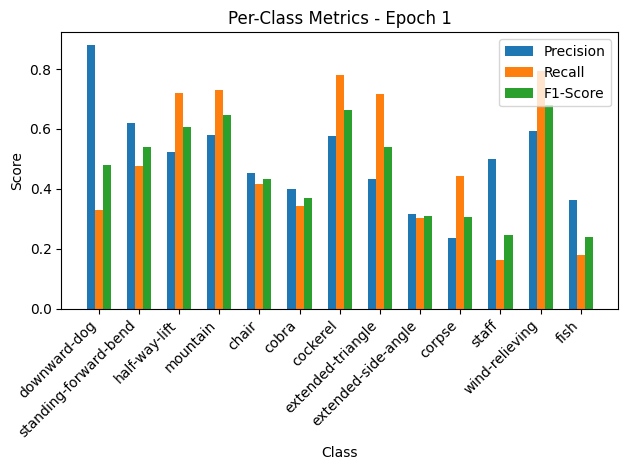


Epoch 2/50 Summary:
Train Loss: 1.6297 | Train Acc: 50.11% | Train Precision: 0.50 | Train Recall: 0.49 | Train F1: 0.47
Val Loss: 1.2468 | Val Acc: 65.75% | Val Precision: 0.67 | Val Recall: 0.67 | Val F1: 0.62
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_4.pth
Checkpoint saved at epoch 2
New best model saved! Validation Loss: 1.2468

Epoch 3/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 35.88it/s, loss=1.17, accuracy=69.3]


Per-Class Metrics for Epoch 2:
downward-dog: Precision=0.89, Recall=0.79, F1-Score=0.84
standing-forward-bend: Precision=0.93, Recall=0.57, F1-Score=0.71
half-way-lift: Precision=0.66, Recall=0.92, F1-Score=0.77
mountain: Precision=0.72, Recall=0.86, F1-Score=0.78
chair: Precision=0.74, Recall=0.63, F1-Score=0.68
cobra: Precision=0.64, Recall=0.53, F1-Score=0.58
cockerel: Precision=0.75, Recall=0.79, F1-Score=0.77
extended-triangle: Precision=0.61, Recall=0.45, F1-Score=0.52
extended-side-angle: Precision=0.50, Recall=0.70, F1-Score=0.58
corpse: Precision=0.49, Recall=0.29, F1-Score=0.37
staff: Precision=0.62, Recall=0.82, F1-Score=0.70
wind-relieving: Precision=0.74, Recall=0.76, F1-Score=0.75
fish: Precision=0.45, Recall=0.60, F1-Score=0.52


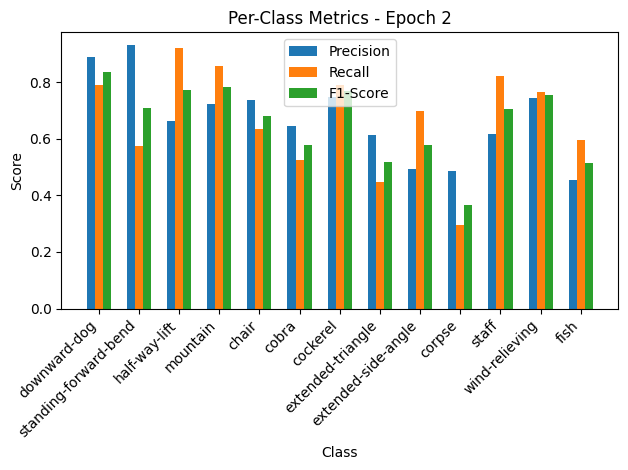

Validation: 100%|██████████| 10/10 [00:00<00:00, 146.28it/s, loss=0.806, accuracy=82.2]


Per-Class Metrics for Epoch 2:
downward-dog: Precision=0.89, Recall=0.79, F1-Score=0.84
standing-forward-bend: Precision=0.93, Recall=0.57, F1-Score=0.71
half-way-lift: Precision=0.66, Recall=0.92, F1-Score=0.77
mountain: Precision=0.72, Recall=0.86, F1-Score=0.78
chair: Precision=0.74, Recall=0.63, F1-Score=0.68
cobra: Precision=0.64, Recall=0.53, F1-Score=0.58
cockerel: Precision=0.75, Recall=0.79, F1-Score=0.77
extended-triangle: Precision=0.61, Recall=0.45, F1-Score=0.52
extended-side-angle: Precision=0.50, Recall=0.70, F1-Score=0.58
corpse: Precision=0.49, Recall=0.29, F1-Score=0.37
staff: Precision=0.62, Recall=0.82, F1-Score=0.70
wind-relieving: Precision=0.74, Recall=0.76, F1-Score=0.75
fish: Precision=0.45, Recall=0.60, F1-Score=0.52


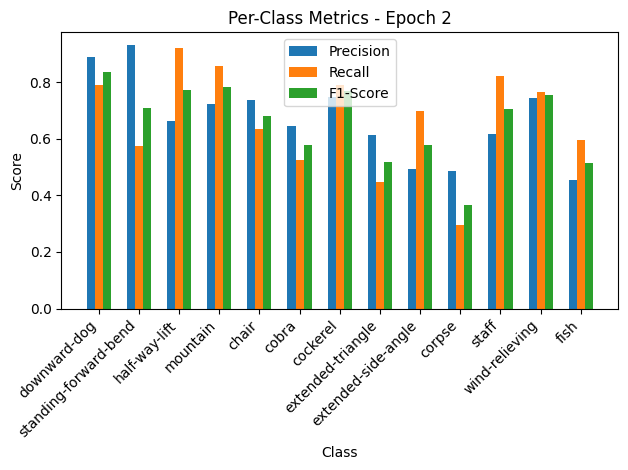


Epoch 3/50 Summary:
Train Loss: 1.1726 | Train Acc: 69.29% | Train Precision: 0.67 | Train Recall: 0.67 | Train F1: 0.66
Val Loss: 0.8835 | Val Acc: 82.19% | Val Precision: 0.87 | Val Recall: 0.83 | Val F1: 0.81
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_4.pth
Checkpoint saved at epoch 3
New best model saved! Validation Loss: 0.8835

Epoch 4/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 39.45it/s, loss=0.858, accuracy=80.9]


Per-Class Metrics for Epoch 3:
downward-dog: Precision=0.95, Recall=0.88, F1-Score=0.91
standing-forward-bend: Precision=0.93, Recall=0.69, F1-Score=0.79
half-way-lift: Precision=0.74, Recall=0.93, F1-Score=0.83
mountain: Precision=0.81, Recall=0.90, F1-Score=0.85
chair: Precision=0.81, Recall=0.78, F1-Score=0.80
cobra: Precision=0.86, Recall=0.86, F1-Score=0.86
cockerel: Precision=0.85, Recall=0.85, F1-Score=0.85
extended-triangle: Precision=0.65, Recall=0.83, F1-Score=0.73
extended-side-angle: Precision=0.76, Recall=0.52, F1-Score=0.62
corpse: Precision=0.68, Recall=0.63, F1-Score=0.66
staff: Precision=0.77, Recall=0.84, F1-Score=0.80
wind-relieving: Precision=0.88, Recall=0.96, F1-Score=0.92
fish: Precision=0.66, Recall=0.69, F1-Score=0.67


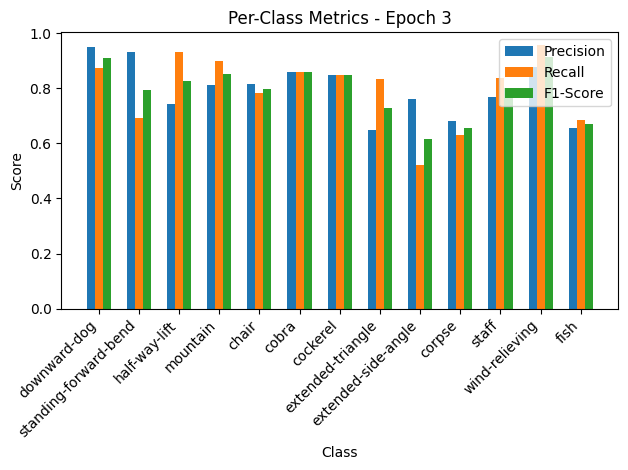

Validation: 100%|██████████| 10/10 [00:00<00:00, 166.06it/s, loss=0.672, accuracy=83.6]


Per-Class Metrics for Epoch 3:
downward-dog: Precision=0.95, Recall=0.88, F1-Score=0.91
standing-forward-bend: Precision=0.93, Recall=0.69, F1-Score=0.79
half-way-lift: Precision=0.74, Recall=0.93, F1-Score=0.83
mountain: Precision=0.81, Recall=0.90, F1-Score=0.85
chair: Precision=0.81, Recall=0.78, F1-Score=0.80
cobra: Precision=0.86, Recall=0.86, F1-Score=0.86
cockerel: Precision=0.85, Recall=0.85, F1-Score=0.85
extended-triangle: Precision=0.65, Recall=0.83, F1-Score=0.73
extended-side-angle: Precision=0.76, Recall=0.52, F1-Score=0.62
corpse: Precision=0.68, Recall=0.63, F1-Score=0.66
staff: Precision=0.77, Recall=0.84, F1-Score=0.80
wind-relieving: Precision=0.88, Recall=0.96, F1-Score=0.92
fish: Precision=0.66, Recall=0.69, F1-Score=0.67


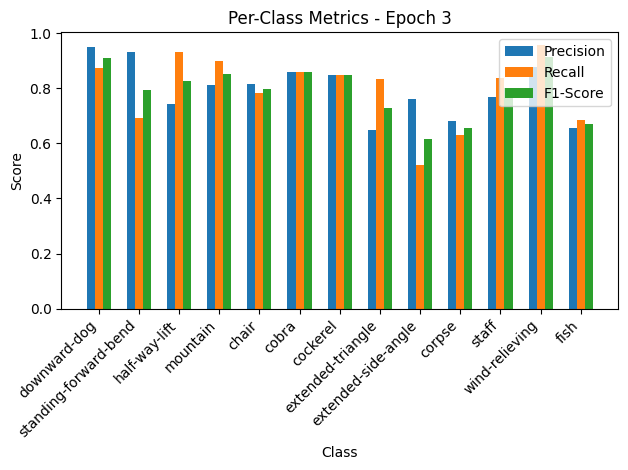


Epoch 4/50 Summary:
Train Loss: 0.8596 | Train Acc: 80.90% | Train Precision: 0.80 | Train Recall: 0.80 | Train F1: 0.79
Val Loss: 0.7362 | Val Acc: 83.56% | Val Precision: 0.86 | Val Recall: 0.84 | Val F1: 0.83
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_4.pth
Checkpoint saved at epoch 4
New best model saved! Validation Loss: 0.7362

Epoch 5/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 39.99it/s, loss=0.733, accuracy=81.7]


Per-Class Metrics for Epoch 4:
downward-dog: Precision=0.97, Recall=0.90, F1-Score=0.93
standing-forward-bend: Precision=0.94, Recall=0.73, F1-Score=0.83
half-way-lift: Precision=0.78, Recall=0.89, F1-Score=0.83
mountain: Precision=0.81, Recall=0.92, F1-Score=0.87
chair: Precision=0.82, Recall=0.79, F1-Score=0.81
cobra: Precision=0.89, Recall=0.90, F1-Score=0.90
cockerel: Precision=0.82, Recall=0.87, F1-Score=0.84
extended-triangle: Precision=0.71, Recall=0.69, F1-Score=0.70
extended-side-angle: Precision=0.67, Recall=0.73, F1-Score=0.70
corpse: Precision=0.65, Recall=0.49, F1-Score=0.55
staff: Precision=0.81, Recall=0.97, F1-Score=0.89
wind-relieving: Precision=0.86, Recall=0.84, F1-Score=0.85
fish: Precision=0.59, Recall=0.70, F1-Score=0.64


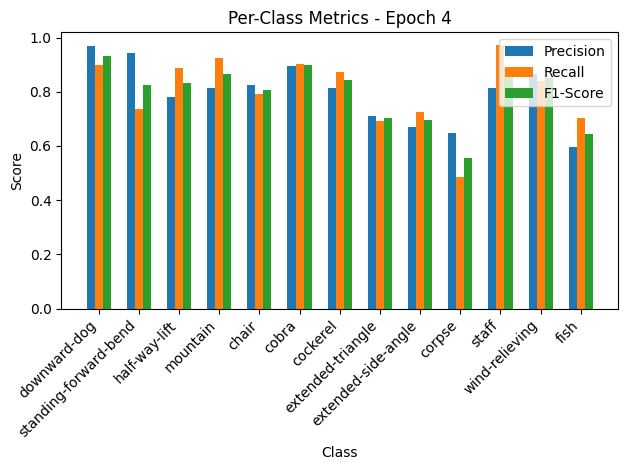

Validation: 100%|██████████| 10/10 [00:00<00:00, 159.16it/s, loss=0.613, accuracy=84.9]


Per-Class Metrics for Epoch 4:
downward-dog: Precision=0.97, Recall=0.90, F1-Score=0.93
standing-forward-bend: Precision=0.94, Recall=0.73, F1-Score=0.83
half-way-lift: Precision=0.78, Recall=0.89, F1-Score=0.83
mountain: Precision=0.81, Recall=0.92, F1-Score=0.87
chair: Precision=0.82, Recall=0.79, F1-Score=0.81
cobra: Precision=0.89, Recall=0.90, F1-Score=0.90
cockerel: Precision=0.82, Recall=0.87, F1-Score=0.84
extended-triangle: Precision=0.71, Recall=0.69, F1-Score=0.70
extended-side-angle: Precision=0.67, Recall=0.73, F1-Score=0.70
corpse: Precision=0.65, Recall=0.49, F1-Score=0.55
staff: Precision=0.81, Recall=0.97, F1-Score=0.89
wind-relieving: Precision=0.86, Recall=0.84, F1-Score=0.85
fish: Precision=0.59, Recall=0.70, F1-Score=0.64


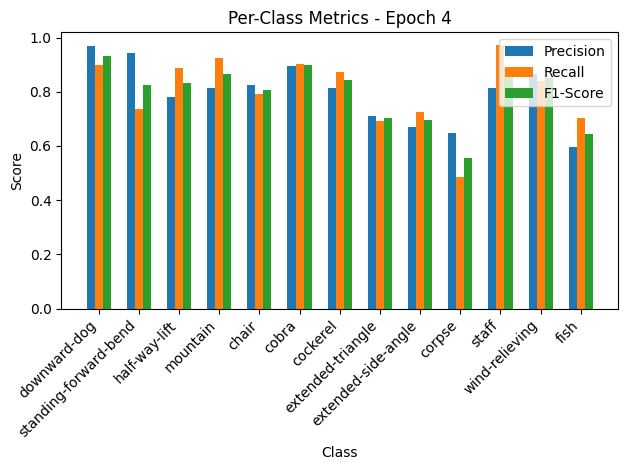


Epoch 5/50 Summary:
Train Loss: 0.7348 | Train Acc: 81.67% | Train Precision: 0.80 | Train Recall: 0.80 | Train F1: 0.80
Val Loss: 0.6722 | Val Acc: 84.93% | Val Precision: 0.90 | Val Recall: 0.84 | Val F1: 0.83
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_4.pth
Checkpoint saved at epoch 5
New best model saved! Validation Loss: 0.6722

Epoch 6/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 40.71it/s, loss=0.643, accuracy=83]


Per-Class Metrics for Epoch 5:
downward-dog: Precision=0.92, Recall=0.90, F1-Score=0.91
standing-forward-bend: Precision=0.90, Recall=0.70, F1-Score=0.79
half-way-lift: Precision=0.78, Recall=0.91, F1-Score=0.84
mountain: Precision=0.80, Recall=0.87, F1-Score=0.83
chair: Precision=0.77, Recall=0.78, F1-Score=0.78
cobra: Precision=0.93, Recall=0.94, F1-Score=0.93
cockerel: Precision=0.89, Recall=0.95, F1-Score=0.92
extended-triangle: Precision=0.76, Recall=0.82, F1-Score=0.79
extended-side-angle: Precision=0.76, Recall=0.74, F1-Score=0.75
corpse: Precision=0.61, Recall=0.69, F1-Score=0.65
staff: Precision=0.94, Recall=0.87, F1-Score=0.90
wind-relieving: Precision=0.95, Recall=0.93, F1-Score=0.94
fish: Precision=0.66, Recall=0.58, F1-Score=0.62


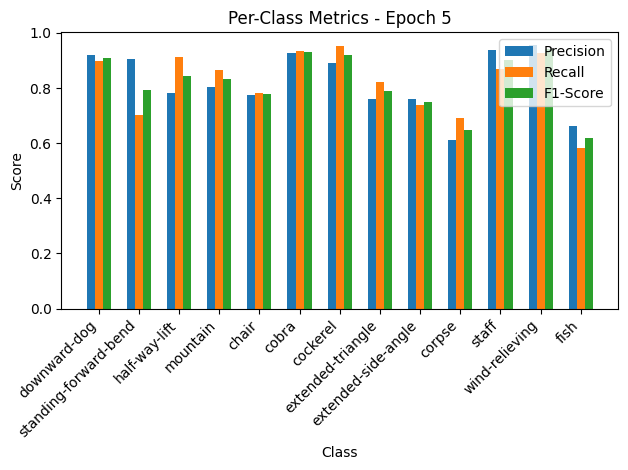

Validation: 100%|██████████| 10/10 [00:00<00:00, 167.98it/s, loss=0.473, accuracy=87]


Per-Class Metrics for Epoch 5:
downward-dog: Precision=0.92, Recall=0.90, F1-Score=0.91
standing-forward-bend: Precision=0.90, Recall=0.70, F1-Score=0.79
half-way-lift: Precision=0.78, Recall=0.91, F1-Score=0.84
mountain: Precision=0.80, Recall=0.87, F1-Score=0.83
chair: Precision=0.77, Recall=0.78, F1-Score=0.78
cobra: Precision=0.93, Recall=0.94, F1-Score=0.93
cockerel: Precision=0.89, Recall=0.95, F1-Score=0.92
extended-triangle: Precision=0.76, Recall=0.82, F1-Score=0.79
extended-side-angle: Precision=0.76, Recall=0.74, F1-Score=0.75
corpse: Precision=0.61, Recall=0.69, F1-Score=0.65
staff: Precision=0.94, Recall=0.87, F1-Score=0.90
wind-relieving: Precision=0.95, Recall=0.93, F1-Score=0.94
fish: Precision=0.66, Recall=0.58, F1-Score=0.62


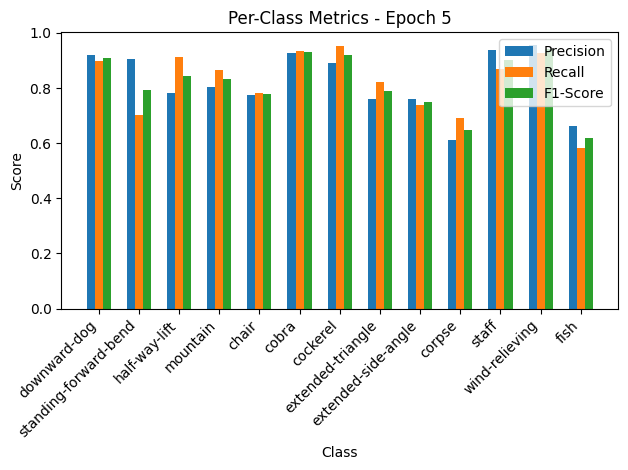


Epoch 6/50 Summary:
Train Loss: 0.6441 | Train Acc: 82.96% | Train Precision: 0.82 | Train Recall: 0.82 | Train F1: 0.82
Val Loss: 0.5182 | Val Acc: 86.99% | Val Precision: 0.89 | Val Recall: 0.88 | Val F1: 0.87
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_4.pth
Checkpoint saved at epoch 6
New best model saved! Validation Loss: 0.5182

Epoch 7/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 37.72it/s, loss=0.498, accuracy=86.6]


Per-Class Metrics for Epoch 6:
downward-dog: Precision=0.93, Recall=0.93, F1-Score=0.93
standing-forward-bend: Precision=0.91, Recall=0.72, F1-Score=0.81
half-way-lift: Precision=0.80, Recall=0.91, F1-Score=0.85
mountain: Precision=0.86, Recall=0.89, F1-Score=0.88
chair: Precision=0.86, Recall=0.89, F1-Score=0.87
cobra: Precision=0.94, Recall=0.96, F1-Score=0.95
cockerel: Precision=0.90, Recall=0.95, F1-Score=0.93
extended-triangle: Precision=0.80, Recall=0.87, F1-Score=0.83
extended-side-angle: Precision=0.82, Recall=0.74, F1-Score=0.78
corpse: Precision=0.74, Recall=0.71, F1-Score=0.72
staff: Precision=0.93, Recall=0.97, F1-Score=0.95
wind-relieving: Precision=0.97, Recall=0.97, F1-Score=0.97
fish: Precision=0.73, Recall=0.72, F1-Score=0.72


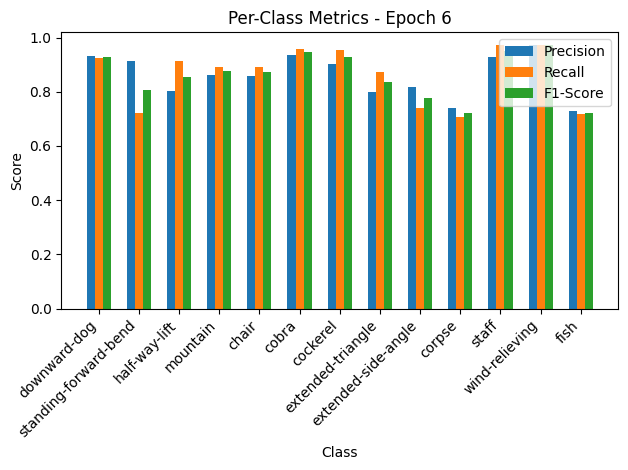

Validation: 100%|██████████| 10/10 [00:00<00:00, 152.33it/s, loss=0.393, accuracy=88.4]


Per-Class Metrics for Epoch 6:
downward-dog: Precision=0.93, Recall=0.93, F1-Score=0.93
standing-forward-bend: Precision=0.91, Recall=0.72, F1-Score=0.81
half-way-lift: Precision=0.80, Recall=0.91, F1-Score=0.85
mountain: Precision=0.86, Recall=0.89, F1-Score=0.88
chair: Precision=0.86, Recall=0.89, F1-Score=0.87
cobra: Precision=0.94, Recall=0.96, F1-Score=0.95
cockerel: Precision=0.90, Recall=0.95, F1-Score=0.93
extended-triangle: Precision=0.80, Recall=0.87, F1-Score=0.83
extended-side-angle: Precision=0.82, Recall=0.74, F1-Score=0.78
corpse: Precision=0.74, Recall=0.71, F1-Score=0.72
staff: Precision=0.93, Recall=0.97, F1-Score=0.95
wind-relieving: Precision=0.97, Recall=0.97, F1-Score=0.97
fish: Precision=0.73, Recall=0.72, F1-Score=0.72


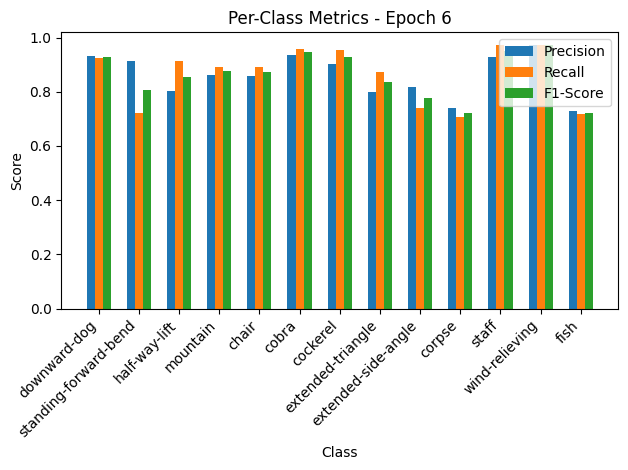


Epoch 7/50 Summary:
Train Loss: 0.4988 | Train Acc: 86.63% | Train Precision: 0.86 | Train Recall: 0.86 | Train F1: 0.86
Val Loss: 0.4306 | Val Acc: 88.36% | Val Precision: 0.91 | Val Recall: 0.89 | Val F1: 0.88
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_4.pth
Checkpoint saved at epoch 7
New best model saved! Validation Loss: 0.4306

Epoch 8/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 36.74it/s, loss=0.46, accuracy=86.7]


Per-Class Metrics for Epoch 7:
downward-dog: Precision=0.97, Recall=0.88, F1-Score=0.92
standing-forward-bend: Precision=0.91, Recall=0.75, F1-Score=0.82
half-way-lift: Precision=0.78, Recall=0.93, F1-Score=0.85
mountain: Precision=0.86, Recall=0.92, F1-Score=0.89
chair: Precision=0.83, Recall=0.85, F1-Score=0.84
cobra: Precision=0.94, Recall=0.96, F1-Score=0.95
cockerel: Precision=0.90, Recall=0.95, F1-Score=0.93
extended-triangle: Precision=0.85, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.89, Recall=0.79, F1-Score=0.84
corpse: Precision=0.71, Recall=0.75, F1-Score=0.73
staff: Precision=0.90, Recall=0.97, F1-Score=0.94
wind-relieving: Precision=0.95, Recall=0.93, F1-Score=0.94
fish: Precision=0.73, Recall=0.67, F1-Score=0.70


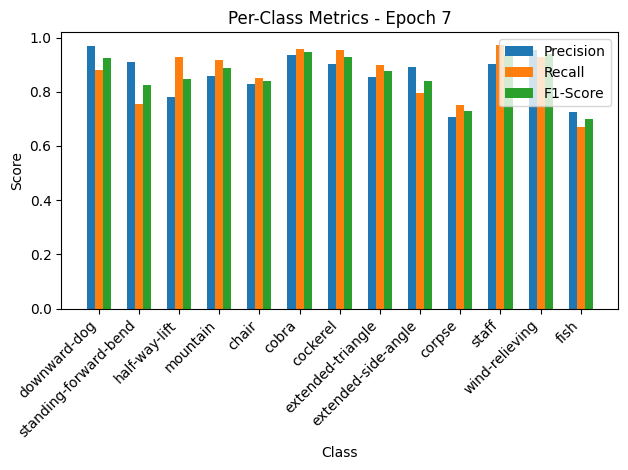

Validation: 100%|██████████| 10/10 [00:00<00:00, 174.41it/s, loss=0.389, accuracy=87.7]


Per-Class Metrics for Epoch 7:
downward-dog: Precision=0.97, Recall=0.88, F1-Score=0.92
standing-forward-bend: Precision=0.91, Recall=0.75, F1-Score=0.82
half-way-lift: Precision=0.78, Recall=0.93, F1-Score=0.85
mountain: Precision=0.86, Recall=0.92, F1-Score=0.89
chair: Precision=0.83, Recall=0.85, F1-Score=0.84
cobra: Precision=0.94, Recall=0.96, F1-Score=0.95
cockerel: Precision=0.90, Recall=0.95, F1-Score=0.93
extended-triangle: Precision=0.85, Recall=0.90, F1-Score=0.88
extended-side-angle: Precision=0.89, Recall=0.79, F1-Score=0.84
corpse: Precision=0.71, Recall=0.75, F1-Score=0.73
staff: Precision=0.90, Recall=0.97, F1-Score=0.94
wind-relieving: Precision=0.95, Recall=0.93, F1-Score=0.94
fish: Precision=0.73, Recall=0.67, F1-Score=0.70


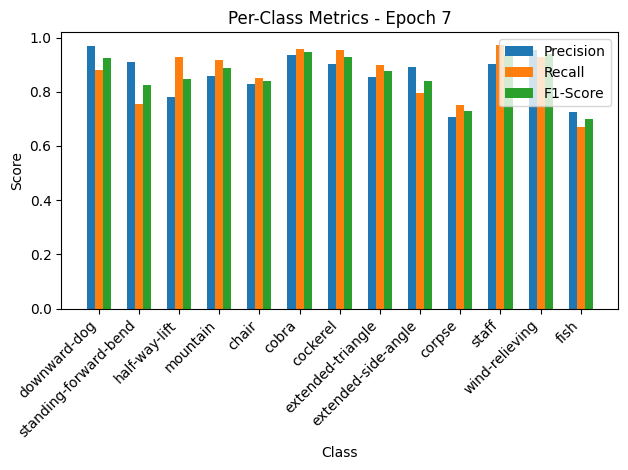


Epoch 8/50 Summary:
Train Loss: 0.4609 | Train Acc: 86.71% | Train Precision: 0.86 | Train Recall: 0.87 | Train F1: 0.86
Val Loss: 0.4261 | Val Acc: 87.67% | Val Precision: 0.90 | Val Recall: 0.89 | Val F1: 0.88
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_4.pth
Checkpoint saved at epoch 8
New best model saved! Validation Loss: 0.4261

Epoch 9/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 40.52it/s, loss=0.458, accuracy=86]


Per-Class Metrics for Epoch 8:
downward-dog: Precision=0.93, Recall=0.89, F1-Score=0.91
standing-forward-bend: Precision=0.89, Recall=0.77, F1-Score=0.82
half-way-lift: Precision=0.83, Recall=0.90, F1-Score=0.86
mountain: Precision=0.80, Recall=0.82, F1-Score=0.81
chair: Precision=0.81, Recall=0.82, F1-Score=0.81
cobra: Precision=0.90, Recall=0.95, F1-Score=0.92
cockerel: Precision=0.91, Recall=0.94, F1-Score=0.93
extended-triangle: Precision=0.84, Recall=0.90, F1-Score=0.87
extended-side-angle: Precision=0.86, Recall=0.82, F1-Score=0.84
corpse: Precision=0.78, Recall=0.68, F1-Score=0.72
staff: Precision=0.93, Recall=0.97, F1-Score=0.95
wind-relieving: Precision=0.96, Recall=0.96, F1-Score=0.96
fish: Precision=0.72, Recall=0.79, F1-Score=0.75


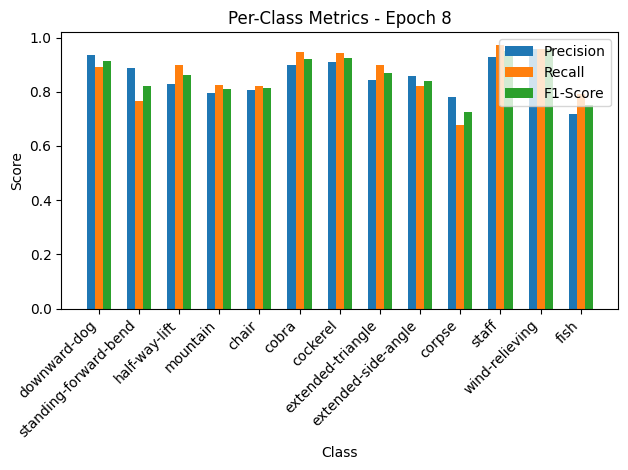

Validation: 100%|██████████| 10/10 [00:00<00:00, 173.98it/s, loss=0.364, accuracy=87]


Per-Class Metrics for Epoch 8:
downward-dog: Precision=0.93, Recall=0.89, F1-Score=0.91
standing-forward-bend: Precision=0.89, Recall=0.77, F1-Score=0.82
half-way-lift: Precision=0.83, Recall=0.90, F1-Score=0.86
mountain: Precision=0.80, Recall=0.82, F1-Score=0.81
chair: Precision=0.81, Recall=0.82, F1-Score=0.81
cobra: Precision=0.90, Recall=0.95, F1-Score=0.92
cockerel: Precision=0.91, Recall=0.94, F1-Score=0.93
extended-triangle: Precision=0.84, Recall=0.90, F1-Score=0.87
extended-side-angle: Precision=0.86, Recall=0.82, F1-Score=0.84
corpse: Precision=0.78, Recall=0.68, F1-Score=0.72
staff: Precision=0.93, Recall=0.97, F1-Score=0.95
wind-relieving: Precision=0.96, Recall=0.96, F1-Score=0.96
fish: Precision=0.72, Recall=0.79, F1-Score=0.75


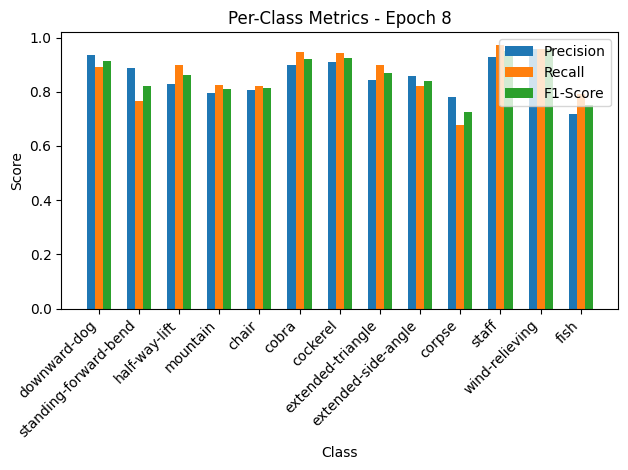


Epoch 9/50 Summary:
Train Loss: 0.4593 | Train Acc: 86.02% | Train Precision: 0.86 | Train Recall: 0.86 | Train F1: 0.86
Val Loss: 0.3989 | Val Acc: 86.99% | Val Precision: 0.89 | Val Recall: 0.89 | Val F1: 0.87
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_4.pth
Checkpoint saved at epoch 9
New best model saved! Validation Loss: 0.3989

Epoch 10/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 38.71it/s, loss=0.445, accuracy=86.8]


Per-Class Metrics for Epoch 9:
downward-dog: Precision=0.97, Recall=0.91, F1-Score=0.94
standing-forward-bend: Precision=0.93, Recall=0.74, F1-Score=0.82
half-way-lift: Precision=0.79, Recall=0.92, F1-Score=0.85
mountain: Precision=0.86, Recall=0.82, F1-Score=0.84
chair: Precision=0.75, Recall=0.87, F1-Score=0.80
cobra: Precision=0.91, Recall=0.96, F1-Score=0.93
cockerel: Precision=0.90, Recall=0.94, F1-Score=0.92
extended-triangle: Precision=0.94, Recall=0.94, F1-Score=0.94
extended-side-angle: Precision=0.91, Recall=0.92, F1-Score=0.91
corpse: Precision=0.71, Recall=0.74, F1-Score=0.72
staff: Precision=0.93, Recall=0.96, F1-Score=0.94
wind-relieving: Precision=0.94, Recall=0.93, F1-Score=0.93
fish: Precision=0.72, Recall=0.66, F1-Score=0.69


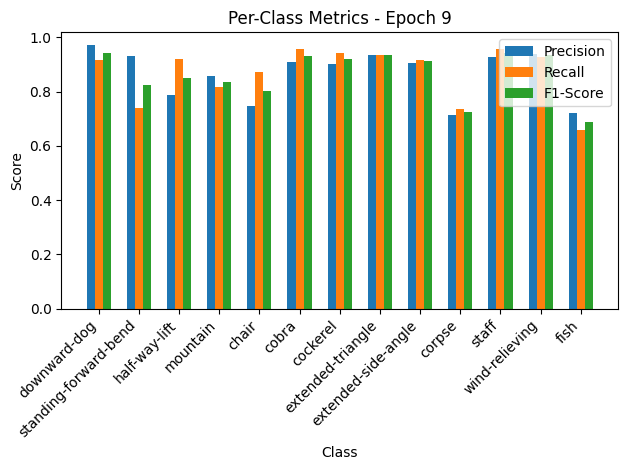

Validation: 100%|██████████| 10/10 [00:00<00:00, 150.24it/s, loss=0.359, accuracy=91.1]


Per-Class Metrics for Epoch 9:
downward-dog: Precision=0.97, Recall=0.91, F1-Score=0.94
standing-forward-bend: Precision=0.93, Recall=0.74, F1-Score=0.82
half-way-lift: Precision=0.79, Recall=0.92, F1-Score=0.85
mountain: Precision=0.86, Recall=0.82, F1-Score=0.84
chair: Precision=0.75, Recall=0.87, F1-Score=0.80
cobra: Precision=0.91, Recall=0.96, F1-Score=0.93
cockerel: Precision=0.90, Recall=0.94, F1-Score=0.92
extended-triangle: Precision=0.94, Recall=0.94, F1-Score=0.94
extended-side-angle: Precision=0.91, Recall=0.92, F1-Score=0.91
corpse: Precision=0.71, Recall=0.74, F1-Score=0.72
staff: Precision=0.93, Recall=0.96, F1-Score=0.94
wind-relieving: Precision=0.94, Recall=0.93, F1-Score=0.93
fish: Precision=0.72, Recall=0.66, F1-Score=0.69


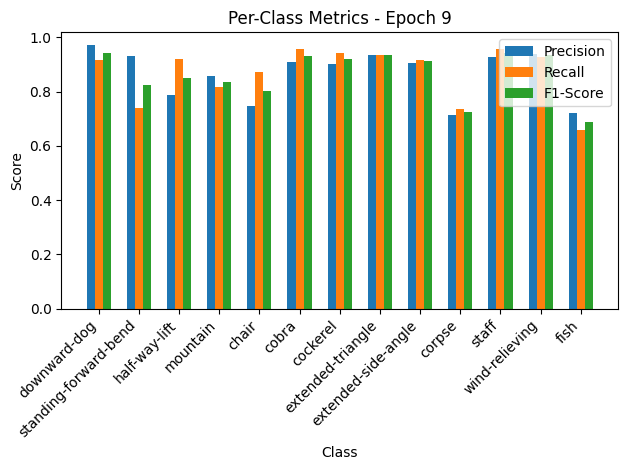


Epoch 10/50 Summary:
Train Loss: 0.4460 | Train Acc: 86.78% | Train Precision: 0.87 | Train Recall: 0.87 | Train F1: 0.86
Val Loss: 0.3935 | Val Acc: 91.10% | Val Precision: 0.93 | Val Recall: 0.94 | Val F1: 0.93
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_4.pth
Checkpoint saved at epoch 10
New best model saved! Validation Loss: 0.3935

Epoch 11/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 38.34it/s, loss=0.438, accuracy=85.7]


Per-Class Metrics for Epoch 10:
downward-dog: Precision=0.97, Recall=0.90, F1-Score=0.93
standing-forward-bend: Precision=0.91, Recall=0.72, F1-Score=0.81
half-way-lift: Precision=0.79, Recall=0.91, F1-Score=0.85
mountain: Precision=0.83, Recall=0.84, F1-Score=0.84
chair: Precision=0.77, Recall=0.86, F1-Score=0.81
cobra: Precision=0.92, Recall=0.94, F1-Score=0.93
cockerel: Precision=0.89, Recall=0.95, F1-Score=0.92
extended-triangle: Precision=0.84, Recall=0.86, F1-Score=0.85
extended-side-angle: Precision=0.82, Recall=0.81, F1-Score=0.81
corpse: Precision=0.77, Recall=0.65, F1-Score=0.70
staff: Precision=0.94, Recall=0.99, F1-Score=0.96
wind-relieving: Precision=0.97, Recall=0.93, F1-Score=0.95
fish: Precision=0.68, Recall=0.81, F1-Score=0.74


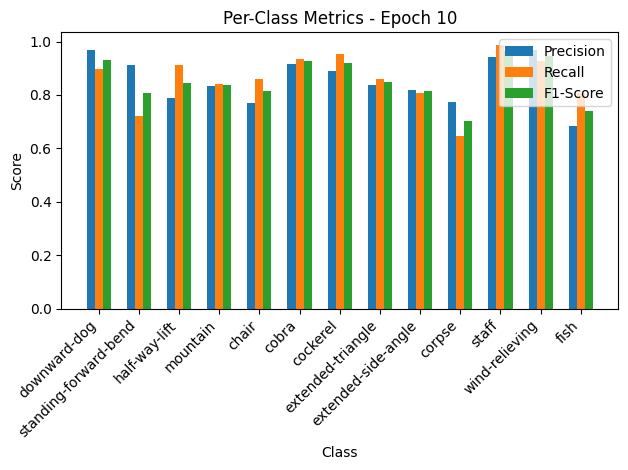

Validation: 100%|██████████| 10/10 [00:00<00:00, 178.95it/s, loss=0.32, accuracy=90.4]


Per-Class Metrics for Epoch 10:
downward-dog: Precision=0.97, Recall=0.90, F1-Score=0.93
standing-forward-bend: Precision=0.91, Recall=0.72, F1-Score=0.81
half-way-lift: Precision=0.79, Recall=0.91, F1-Score=0.85
mountain: Precision=0.83, Recall=0.84, F1-Score=0.84
chair: Precision=0.77, Recall=0.86, F1-Score=0.81
cobra: Precision=0.92, Recall=0.94, F1-Score=0.93
cockerel: Precision=0.89, Recall=0.95, F1-Score=0.92
extended-triangle: Precision=0.84, Recall=0.86, F1-Score=0.85
extended-side-angle: Precision=0.82, Recall=0.81, F1-Score=0.81
corpse: Precision=0.77, Recall=0.65, F1-Score=0.70
staff: Precision=0.94, Recall=0.99, F1-Score=0.96
wind-relieving: Precision=0.97, Recall=0.93, F1-Score=0.95
fish: Precision=0.68, Recall=0.81, F1-Score=0.74


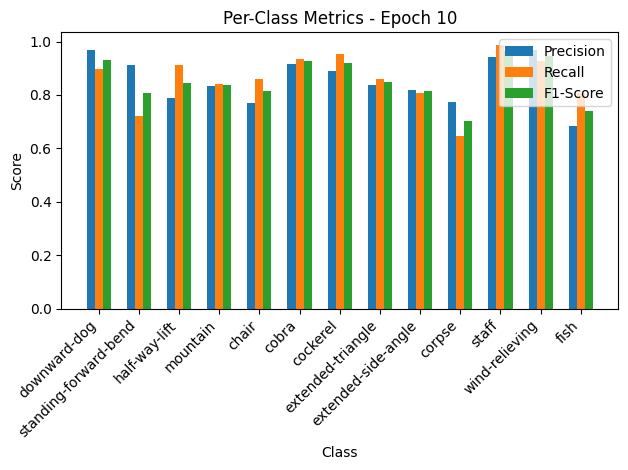


Epoch 11/50 Summary:
Train Loss: 0.4388 | Train Acc: 85.71% | Train Precision: 0.85 | Train Recall: 0.86 | Train F1: 0.85
Val Loss: 0.3501 | Val Acc: 90.41% | Val Precision: 0.92 | Val Recall: 0.92 | Val F1: 0.91
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_4.pth
Checkpoint saved at epoch 11
New best model saved! Validation Loss: 0.3501

Epoch 12/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 38.02it/s, loss=0.408, accuracy=87.3]


Per-Class Metrics for Epoch 11:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.93
standing-forward-bend: Precision=0.91, Recall=0.77, F1-Score=0.83
half-way-lift: Precision=0.80, Recall=0.93, F1-Score=0.86
mountain: Precision=0.85, Recall=0.93, F1-Score=0.89
chair: Precision=0.88, Recall=0.81, F1-Score=0.85
cobra: Precision=0.91, Recall=0.94, F1-Score=0.92
cockerel: Precision=0.92, Recall=0.97, F1-Score=0.94
extended-triangle: Precision=0.95, Recall=0.92, F1-Score=0.94
extended-side-angle: Precision=0.86, Recall=0.92, F1-Score=0.89
corpse: Precision=0.75, Recall=0.63, F1-Score=0.69
staff: Precision=0.96, Recall=0.96, F1-Score=0.96
wind-relieving: Precision=0.91, Recall=0.88, F1-Score=0.90
fish: Precision=0.65, Recall=0.76, F1-Score=0.70


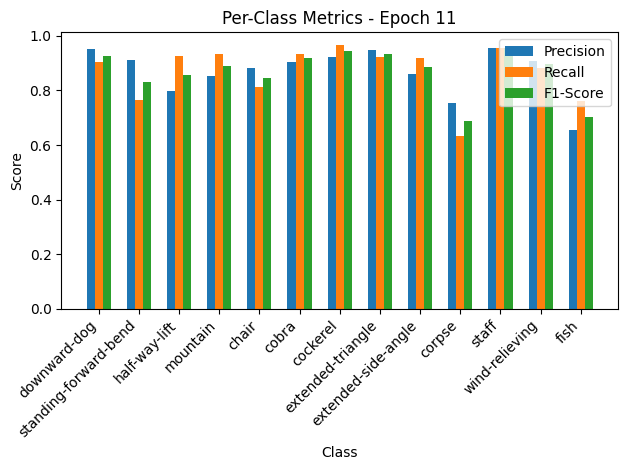

Validation: 100%|██████████| 10/10 [00:00<00:00, 119.12it/s, loss=0.306, accuracy=91.1]


Per-Class Metrics for Epoch 11:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.93
standing-forward-bend: Precision=0.91, Recall=0.77, F1-Score=0.83
half-way-lift: Precision=0.80, Recall=0.93, F1-Score=0.86
mountain: Precision=0.85, Recall=0.93, F1-Score=0.89
chair: Precision=0.88, Recall=0.81, F1-Score=0.85
cobra: Precision=0.91, Recall=0.94, F1-Score=0.92
cockerel: Precision=0.92, Recall=0.97, F1-Score=0.94
extended-triangle: Precision=0.95, Recall=0.92, F1-Score=0.94
extended-side-angle: Precision=0.86, Recall=0.92, F1-Score=0.89
corpse: Precision=0.75, Recall=0.63, F1-Score=0.69
staff: Precision=0.96, Recall=0.96, F1-Score=0.96
wind-relieving: Precision=0.91, Recall=0.88, F1-Score=0.90
fish: Precision=0.65, Recall=0.76, F1-Score=0.70


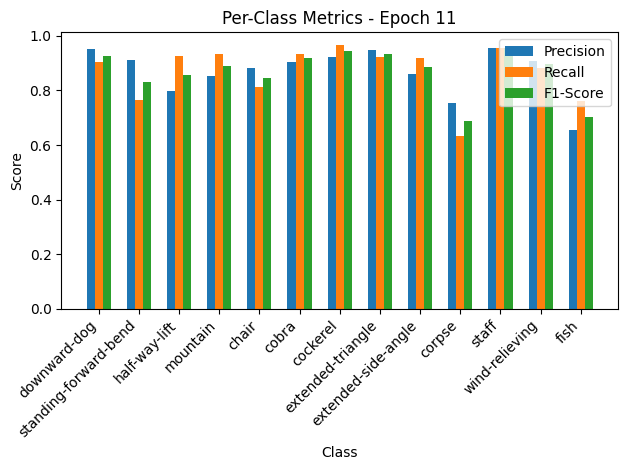


Epoch 12/50 Summary:
Train Loss: 0.4085 | Train Acc: 87.32% | Train Precision: 0.87 | Train Recall: 0.87 | Train F1: 0.87
Val Loss: 0.3356 | Val Acc: 91.10% | Val Precision: 0.93 | Val Recall: 0.91 | Val F1: 0.90
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_4.pth
Checkpoint saved at epoch 12
New best model saved! Validation Loss: 0.3356

Epoch 13/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 39.66it/s, loss=0.338, accuracy=89.5]


Per-Class Metrics for Epoch 12:
downward-dog: Precision=0.96, Recall=0.93, F1-Score=0.94
standing-forward-bend: Precision=0.93, Recall=0.77, F1-Score=0.84
half-way-lift: Precision=0.79, Recall=0.89, F1-Score=0.83
mountain: Precision=0.90, Recall=0.92, F1-Score=0.91
chair: Precision=0.84, Recall=0.92, F1-Score=0.88
cobra: Precision=0.96, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.94, Recall=0.97, F1-Score=0.95
extended-triangle: Precision=0.96, Recall=0.88, F1-Score=0.92
extended-side-angle: Precision=0.88, Recall=0.95, F1-Score=0.91
corpse: Precision=0.77, Recall=0.79, F1-Score=0.78
staff: Precision=0.96, Recall=0.97, F1-Score=0.96
wind-relieving: Precision=0.94, Recall=0.96, F1-Score=0.95
fish: Precision=0.81, Recall=0.76, F1-Score=0.78


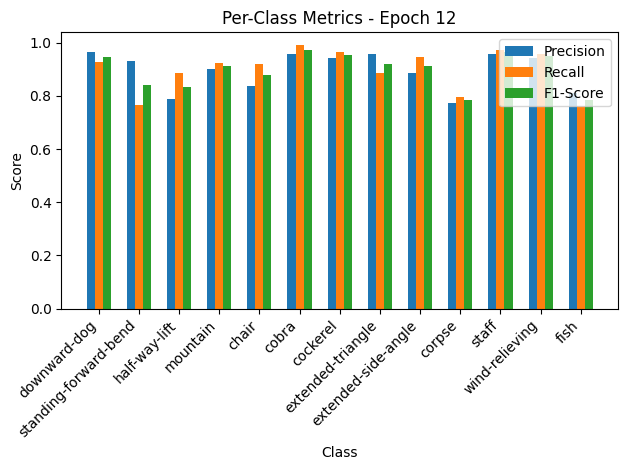

Validation: 100%|██████████| 10/10 [00:00<00:00, 179.97it/s, loss=0.313, accuracy=91.1]


Per-Class Metrics for Epoch 12:
downward-dog: Precision=0.96, Recall=0.93, F1-Score=0.94
standing-forward-bend: Precision=0.93, Recall=0.77, F1-Score=0.84
half-way-lift: Precision=0.79, Recall=0.89, F1-Score=0.83
mountain: Precision=0.90, Recall=0.92, F1-Score=0.91
chair: Precision=0.84, Recall=0.92, F1-Score=0.88
cobra: Precision=0.96, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.94, Recall=0.97, F1-Score=0.95
extended-triangle: Precision=0.96, Recall=0.88, F1-Score=0.92
extended-side-angle: Precision=0.88, Recall=0.95, F1-Score=0.91
corpse: Precision=0.77, Recall=0.79, F1-Score=0.78
staff: Precision=0.96, Recall=0.97, F1-Score=0.96
wind-relieving: Precision=0.94, Recall=0.96, F1-Score=0.95
fish: Precision=0.81, Recall=0.76, F1-Score=0.78


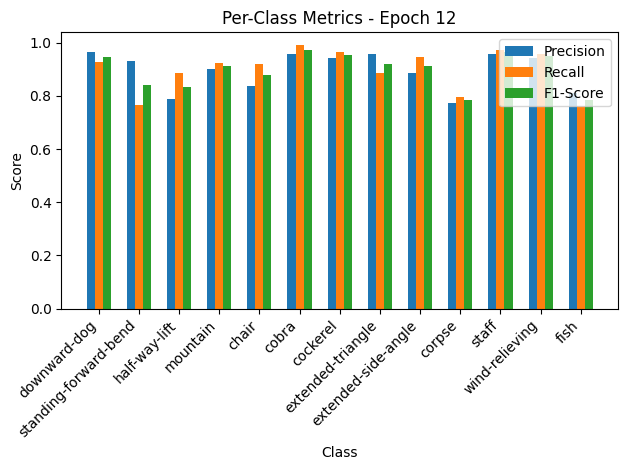


Epoch 13/50 Summary:
Train Loss: 0.3389 | Train Acc: 89.53% | Train Precision: 0.90 | Train Recall: 0.90 | Train F1: 0.90
Val Loss: 0.3427 | Val Acc: 91.10% | Val Precision: 0.92 | Val Recall: 0.92 | Val F1: 0.92

Epoch 14/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:01<00:00, 43.11it/s, loss=0.397, accuracy=87.6]


Per-Class Metrics for Epoch 13:
downward-dog: Precision=0.93, Recall=0.92, F1-Score=0.93
standing-forward-bend: Precision=0.95, Recall=0.78, F1-Score=0.85
half-way-lift: Precision=0.81, Recall=0.90, F1-Score=0.85
mountain: Precision=0.89, Recall=0.92, F1-Score=0.90
chair: Precision=0.84, Recall=0.85, F1-Score=0.85
cobra: Precision=0.91, Recall=0.92, F1-Score=0.91
cockerel: Precision=0.89, Recall=0.88, F1-Score=0.89
extended-triangle: Precision=0.87, Recall=0.94, F1-Score=0.90
extended-side-angle: Precision=0.90, Recall=0.86, F1-Score=0.88
corpse: Precision=0.85, Recall=0.66, F1-Score=0.74
staff: Precision=0.86, Recall=0.96, F1-Score=0.90
wind-relieving: Precision=0.93, Recall=0.94, F1-Score=0.93
fish: Precision=0.71, Recall=0.85, F1-Score=0.78


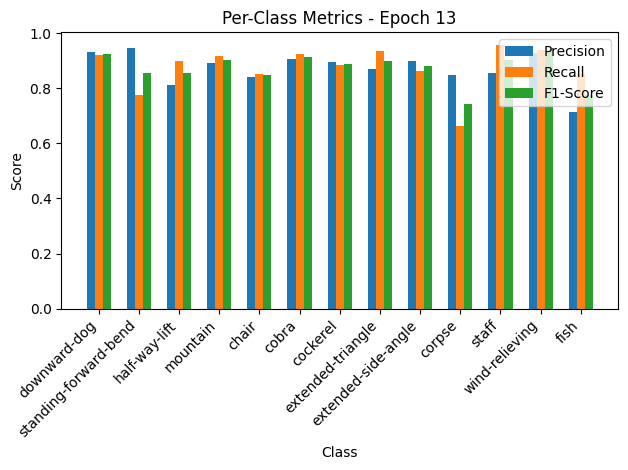

Validation: 100%|██████████| 10/10 [00:00<00:00, 182.49it/s, loss=0.411, accuracy=84.9]


Per-Class Metrics for Epoch 13:
downward-dog: Precision=0.93, Recall=0.92, F1-Score=0.93
standing-forward-bend: Precision=0.95, Recall=0.78, F1-Score=0.85
half-way-lift: Precision=0.81, Recall=0.90, F1-Score=0.85
mountain: Precision=0.89, Recall=0.92, F1-Score=0.90
chair: Precision=0.84, Recall=0.85, F1-Score=0.85
cobra: Precision=0.91, Recall=0.92, F1-Score=0.91
cockerel: Precision=0.89, Recall=0.88, F1-Score=0.89
extended-triangle: Precision=0.87, Recall=0.94, F1-Score=0.90
extended-side-angle: Precision=0.90, Recall=0.86, F1-Score=0.88
corpse: Precision=0.85, Recall=0.66, F1-Score=0.74
staff: Precision=0.86, Recall=0.96, F1-Score=0.90
wind-relieving: Precision=0.93, Recall=0.94, F1-Score=0.93
fish: Precision=0.71, Recall=0.85, F1-Score=0.78


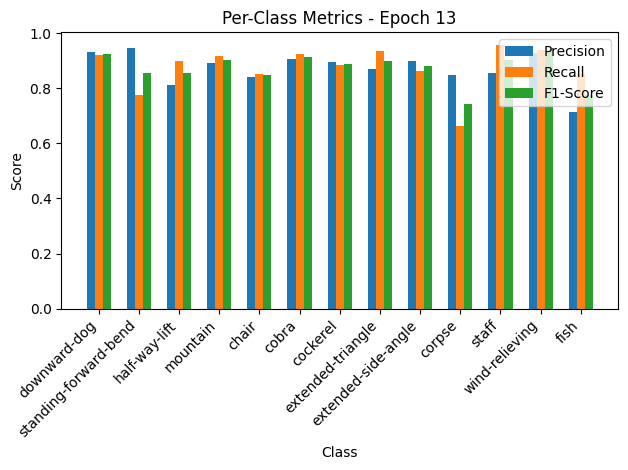


Epoch 14/50 Summary:
Train Loss: 0.3977 | Train Acc: 87.62% | Train Precision: 0.87 | Train Recall: 0.88 | Train F1: 0.87
Val Loss: 0.4503 | Val Acc: 84.93% | Val Precision: 0.89 | Val Recall: 0.85 | Val F1: 0.84

Epoch 15/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 37.60it/s, loss=0.369, accuracy=88.2]


Per-Class Metrics for Epoch 14:
downward-dog: Precision=0.94, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=0.91, Recall=0.80, F1-Score=0.85
half-way-lift: Precision=0.81, Recall=0.88, F1-Score=0.85
mountain: Precision=0.90, Recall=0.94, F1-Score=0.92
chair: Precision=0.88, Recall=0.90, F1-Score=0.89
cobra: Precision=0.93, Recall=0.97, F1-Score=0.95
cockerel: Precision=0.94, Recall=0.94, F1-Score=0.94
extended-triangle: Precision=0.92, Recall=0.88, F1-Score=0.90
extended-side-angle: Precision=0.85, Recall=0.92, F1-Score=0.88
corpse: Precision=0.71, Recall=0.68, F1-Score=0.69
staff: Precision=0.94, Recall=0.97, F1-Score=0.96
wind-relieving: Precision=0.97, Recall=0.96, F1-Score=0.96
fish: Precision=0.70, Recall=0.72, F1-Score=0.71


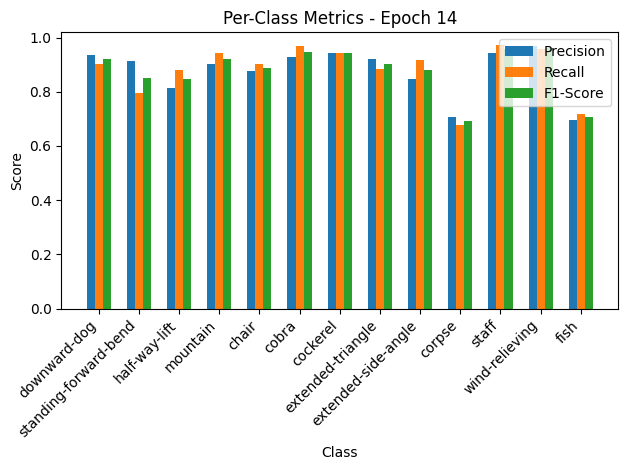

Validation: 100%|██████████| 10/10 [00:00<00:00, 149.26it/s, loss=0.307, accuracy=87]


Per-Class Metrics for Epoch 14:
downward-dog: Precision=0.94, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=0.91, Recall=0.80, F1-Score=0.85
half-way-lift: Precision=0.81, Recall=0.88, F1-Score=0.85
mountain: Precision=0.90, Recall=0.94, F1-Score=0.92
chair: Precision=0.88, Recall=0.90, F1-Score=0.89
cobra: Precision=0.93, Recall=0.97, F1-Score=0.95
cockerel: Precision=0.94, Recall=0.94, F1-Score=0.94
extended-triangle: Precision=0.92, Recall=0.88, F1-Score=0.90
extended-side-angle: Precision=0.85, Recall=0.92, F1-Score=0.88
corpse: Precision=0.71, Recall=0.68, F1-Score=0.69
staff: Precision=0.94, Recall=0.97, F1-Score=0.96
wind-relieving: Precision=0.97, Recall=0.96, F1-Score=0.96
fish: Precision=0.70, Recall=0.72, F1-Score=0.71


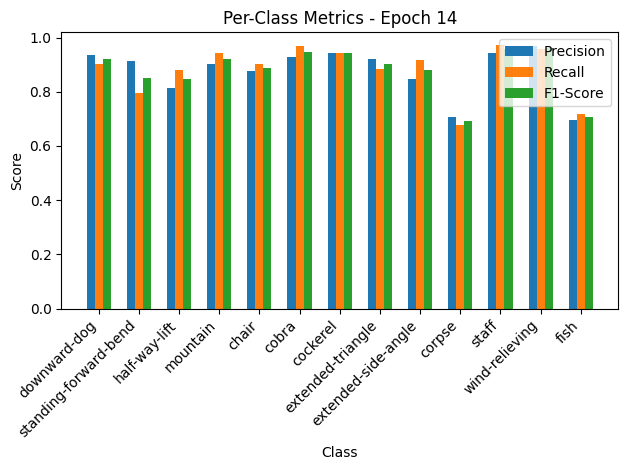


Epoch 15/50 Summary:
Train Loss: 0.3701 | Train Acc: 88.24% | Train Precision: 0.88 | Train Recall: 0.88 | Train F1: 0.88
Val Loss: 0.3367 | Val Acc: 86.99% | Val Precision: 0.90 | Val Recall: 0.90 | Val F1: 0.89

Epoch 16/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 36.23it/s, loss=0.362, accuracy=88.7]


Per-Class Metrics for Epoch 15:
downward-dog: Precision=0.94, Recall=0.91, F1-Score=0.93
standing-forward-bend: Precision=0.98, Recall=0.78, F1-Score=0.87
half-way-lift: Precision=0.80, Recall=0.91, F1-Score=0.85
mountain: Precision=0.91, Recall=0.89, F1-Score=0.90
chair: Precision=0.82, Recall=0.88, F1-Score=0.85
cobra: Precision=0.93, Recall=0.98, F1-Score=0.95
cockerel: Precision=0.85, Recall=0.93, F1-Score=0.89
extended-triangle: Precision=0.95, Recall=0.94, F1-Score=0.94
extended-side-angle: Precision=0.92, Recall=0.93, F1-Score=0.93
corpse: Precision=0.81, Recall=0.68, F1-Score=0.74
staff: Precision=0.93, Recall=0.94, F1-Score=0.93
wind-relieving: Precision=0.94, Recall=0.94, F1-Score=0.94
fish: Precision=0.74, Recall=0.82, F1-Score=0.78


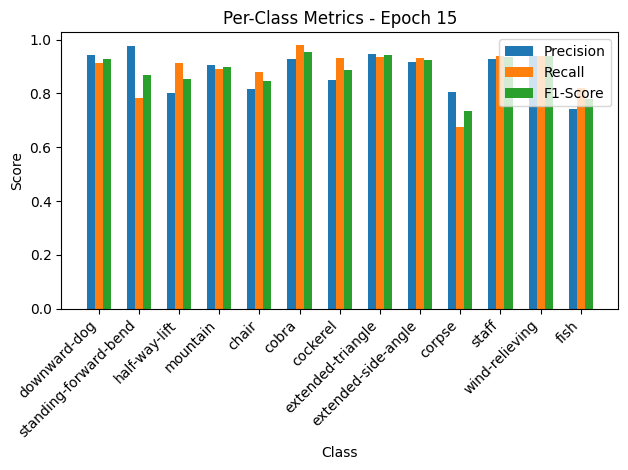

Validation: 100%|██████████| 10/10 [00:00<00:00, 141.73it/s, loss=0.432, accuracy=86.3]


Per-Class Metrics for Epoch 15:
downward-dog: Precision=0.94, Recall=0.91, F1-Score=0.93
standing-forward-bend: Precision=0.98, Recall=0.78, F1-Score=0.87
half-way-lift: Precision=0.80, Recall=0.91, F1-Score=0.85
mountain: Precision=0.91, Recall=0.89, F1-Score=0.90
chair: Precision=0.82, Recall=0.88, F1-Score=0.85
cobra: Precision=0.93, Recall=0.98, F1-Score=0.95
cockerel: Precision=0.85, Recall=0.93, F1-Score=0.89
extended-triangle: Precision=0.95, Recall=0.94, F1-Score=0.94
extended-side-angle: Precision=0.92, Recall=0.93, F1-Score=0.93
corpse: Precision=0.81, Recall=0.68, F1-Score=0.74
staff: Precision=0.93, Recall=0.94, F1-Score=0.93
wind-relieving: Precision=0.94, Recall=0.94, F1-Score=0.94
fish: Precision=0.74, Recall=0.82, F1-Score=0.78


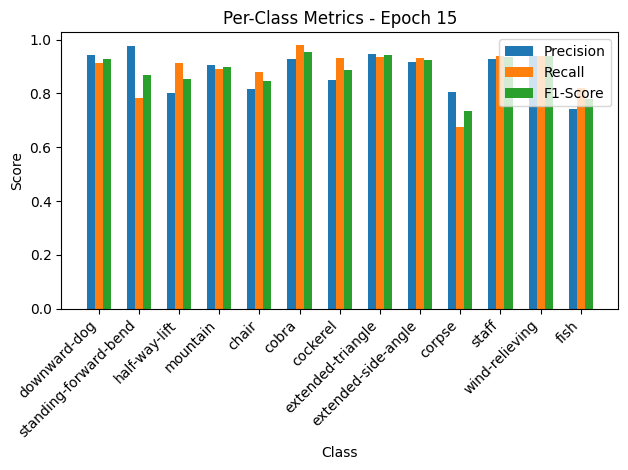


Epoch 16/50 Summary:
Train Loss: 0.3631 | Train Acc: 88.69% | Train Precision: 0.89 | Train Recall: 0.89 | Train F1: 0.88
Val Loss: 0.4730 | Val Acc: 86.30% | Val Precision: 0.88 | Val Recall: 0.87 | Val F1: 0.86

Epoch 17/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:02<00:00, 38.49it/s, loss=0.369, accuracy=88.2]


Per-Class Metrics for Epoch 16:
downward-dog: Precision=0.96, Recall=0.90, F1-Score=0.93
standing-forward-bend: Precision=0.93, Recall=0.77, F1-Score=0.84
half-way-lift: Precision=0.80, Recall=0.89, F1-Score=0.84
mountain: Precision=0.90, Recall=0.94, F1-Score=0.92
chair: Precision=0.88, Recall=0.90, F1-Score=0.89
cobra: Precision=0.94, Recall=0.94, F1-Score=0.94
cockerel: Precision=0.87, Recall=0.94, F1-Score=0.91
extended-triangle: Precision=0.93, Recall=0.87, F1-Score=0.90
extended-side-angle: Precision=0.85, Recall=0.93, F1-Score=0.89
corpse: Precision=0.79, Recall=0.66, F1-Score=0.72
staff: Precision=0.89, Recall=0.97, F1-Score=0.93
wind-relieving: Precision=0.97, Recall=0.96, F1-Score=0.96
fish: Precision=0.71, Recall=0.81, F1-Score=0.76


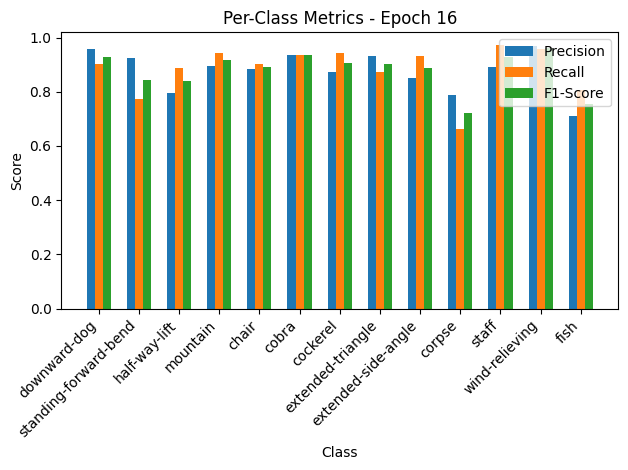

Validation: 100%|██████████| 10/10 [00:00<00:00, 139.05it/s, loss=0.321, accuracy=88.4]


Per-Class Metrics for Epoch 16:
downward-dog: Precision=0.96, Recall=0.90, F1-Score=0.93
standing-forward-bend: Precision=0.93, Recall=0.77, F1-Score=0.84
half-way-lift: Precision=0.80, Recall=0.89, F1-Score=0.84
mountain: Precision=0.90, Recall=0.94, F1-Score=0.92
chair: Precision=0.88, Recall=0.90, F1-Score=0.89
cobra: Precision=0.94, Recall=0.94, F1-Score=0.94
cockerel: Precision=0.87, Recall=0.94, F1-Score=0.91
extended-triangle: Precision=0.93, Recall=0.87, F1-Score=0.90
extended-side-angle: Precision=0.85, Recall=0.93, F1-Score=0.89
corpse: Precision=0.79, Recall=0.66, F1-Score=0.72
staff: Precision=0.89, Recall=0.97, F1-Score=0.93
wind-relieving: Precision=0.97, Recall=0.96, F1-Score=0.96
fish: Precision=0.71, Recall=0.81, F1-Score=0.76


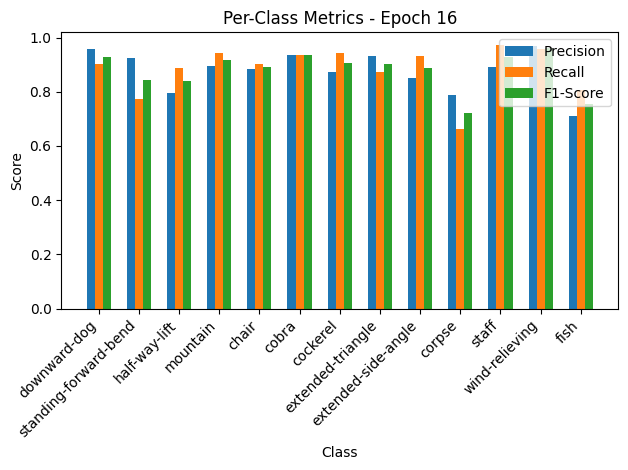


Epoch 17/50 Summary:
Train Loss: 0.3699 | Train Acc: 88.16% | Train Precision: 0.88 | Train Recall: 0.88 | Train F1: 0.88
Val Loss: 0.3518 | Val Acc: 88.36% | Val Precision: 0.90 | Val Recall: 0.89 | Val F1: 0.88

Epoch 18/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:01<00:00, 42.53it/s, loss=0.314, accuracy=90.8]


Per-Class Metrics for Epoch 17:
downward-dog: Precision=0.97, Recall=0.94, F1-Score=0.95
standing-forward-bend: Precision=0.92, Recall=0.83, F1-Score=0.87
half-way-lift: Precision=0.84, Recall=0.92, F1-Score=0.88
mountain: Precision=0.90, Recall=0.96, F1-Score=0.93
chair: Precision=0.90, Recall=0.89, F1-Score=0.90
cobra: Precision=0.94, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.94, Recall=0.98, F1-Score=0.96
extended-triangle: Precision=0.95, Recall=0.96, F1-Score=0.96
extended-side-angle: Precision=0.94, Recall=0.89, F1-Score=0.92
corpse: Precision=0.76, Recall=0.79, F1-Score=0.78
staff: Precision=0.97, Recall=0.99, F1-Score=0.98
wind-relieving: Precision=0.96, Recall=0.94, F1-Score=0.95
fish: Precision=0.77, Recall=0.72, F1-Score=0.74


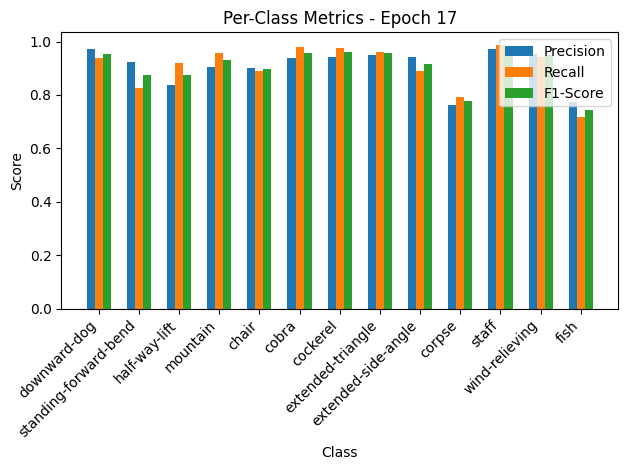

Validation: 100%|██████████| 10/10 [00:00<00:00, 163.36it/s, loss=0.311, accuracy=90.4]


Per-Class Metrics for Epoch 17:
downward-dog: Precision=0.97, Recall=0.94, F1-Score=0.95
standing-forward-bend: Precision=0.92, Recall=0.83, F1-Score=0.87
half-way-lift: Precision=0.84, Recall=0.92, F1-Score=0.88
mountain: Precision=0.90, Recall=0.96, F1-Score=0.93
chair: Precision=0.90, Recall=0.89, F1-Score=0.90
cobra: Precision=0.94, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.94, Recall=0.98, F1-Score=0.96
extended-triangle: Precision=0.95, Recall=0.96, F1-Score=0.96
extended-side-angle: Precision=0.94, Recall=0.89, F1-Score=0.92
corpse: Precision=0.76, Recall=0.79, F1-Score=0.78
staff: Precision=0.97, Recall=0.99, F1-Score=0.98
wind-relieving: Precision=0.96, Recall=0.94, F1-Score=0.95
fish: Precision=0.77, Recall=0.72, F1-Score=0.74


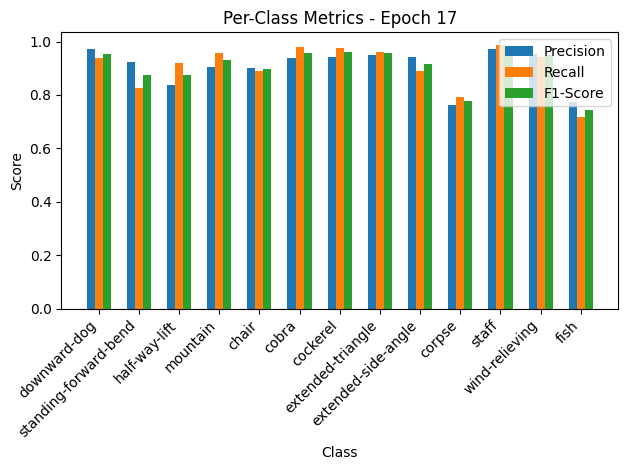


Epoch 18/50 Summary:
Train Loss: 0.3151 | Train Acc: 90.83% | Train Precision: 0.91 | Train Recall: 0.91 | Train F1: 0.91
Val Loss: 0.3411 | Val Acc: 90.41% | Val Precision: 0.92 | Val Recall: 0.92 | Val F1: 0.92

Epoch 19/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:01<00:00, 42.75it/s, loss=0.244, accuracy=92.3]


Per-Class Metrics for Epoch 18:
downward-dog: Precision=0.97, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.94, Recall=0.82, F1-Score=0.88
half-way-lift: Precision=0.84, Recall=0.92, F1-Score=0.88
mountain: Precision=0.90, Recall=0.94, F1-Score=0.92
chair: Precision=0.90, Recall=0.93, F1-Score=0.92
cobra: Precision=0.97, Recall=0.97, F1-Score=0.97
cockerel: Precision=0.96, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.96, Recall=0.95, F1-Score=0.95
extended-side-angle: Precision=0.95, Recall=0.95, F1-Score=0.95
corpse: Precision=0.88, Recall=0.76, F1-Score=0.82
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.93, F1-Score=0.96
fish: Precision=0.78, Recall=0.94, F1-Score=0.85


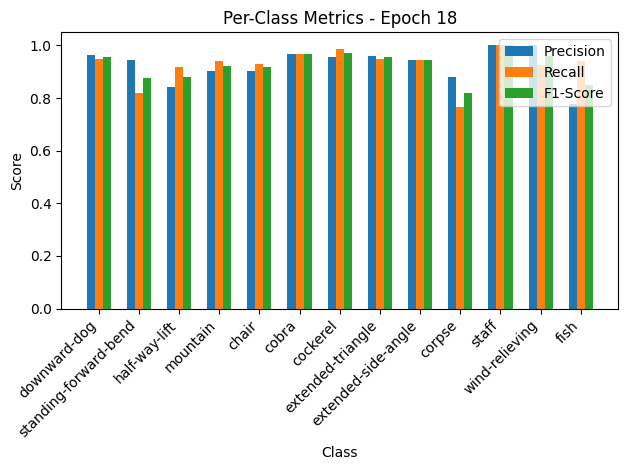

Validation: 100%|██████████| 10/10 [00:00<00:00, 151.79it/s, loss=0.196, accuracy=93.2]


Per-Class Metrics for Epoch 18:
downward-dog: Precision=0.97, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.94, Recall=0.82, F1-Score=0.88
half-way-lift: Precision=0.84, Recall=0.92, F1-Score=0.88
mountain: Precision=0.90, Recall=0.94, F1-Score=0.92
chair: Precision=0.90, Recall=0.93, F1-Score=0.92
cobra: Precision=0.97, Recall=0.97, F1-Score=0.97
cockerel: Precision=0.96, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.96, Recall=0.95, F1-Score=0.95
extended-side-angle: Precision=0.95, Recall=0.95, F1-Score=0.95
corpse: Precision=0.88, Recall=0.76, F1-Score=0.82
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.93, F1-Score=0.96
fish: Precision=0.78, Recall=0.94, F1-Score=0.85


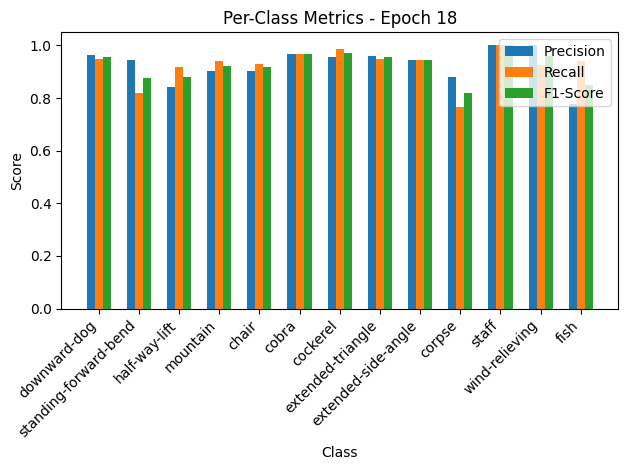


Epoch 19/50 Summary:
Train Loss: 0.2448 | Train Acc: 92.28% | Train Precision: 0.93 | Train Recall: 0.93 | Train F1: 0.92
Val Loss: 0.2151 | Val Acc: 93.15% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_4.pth
Checkpoint saved at epoch 19
New best model saved! Validation Loss: 0.2151

Epoch 20/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:02<00:00, 37.00it/s, loss=0.209, accuracy=92.8]


Per-Class Metrics for Epoch 19:
downward-dog: Precision=0.97, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.82, F1-Score=0.88
half-way-lift: Precision=0.85, Recall=0.93, F1-Score=0.89
mountain: Precision=0.93, Recall=0.96, F1-Score=0.94
chair: Precision=0.93, Recall=0.93, F1-Score=0.93
cobra: Precision=0.96, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.96, Recall=0.96, F1-Score=0.96
extended-side-angle: Precision=0.95, Recall=0.96, F1-Score=0.95
corpse: Precision=0.84, Recall=0.78, F1-Score=0.81
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=0.96, F1-Score=0.96
fish: Precision=0.80, Recall=0.85, F1-Score=0.83


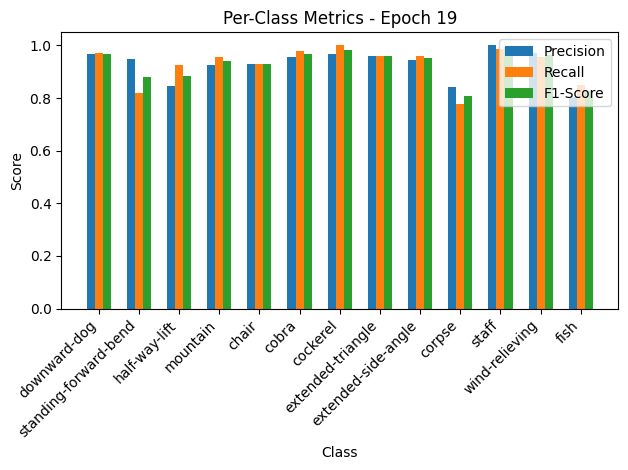

Validation: 100%|██████████| 10/10 [00:00<00:00, 124.40it/s, loss=0.182, accuracy=94.5]


Per-Class Metrics for Epoch 19:
downward-dog: Precision=0.97, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.82, F1-Score=0.88
half-way-lift: Precision=0.85, Recall=0.93, F1-Score=0.89
mountain: Precision=0.93, Recall=0.96, F1-Score=0.94
chair: Precision=0.93, Recall=0.93, F1-Score=0.93
cobra: Precision=0.96, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.96, Recall=0.96, F1-Score=0.96
extended-side-angle: Precision=0.95, Recall=0.96, F1-Score=0.95
corpse: Precision=0.84, Recall=0.78, F1-Score=0.81
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=0.96, F1-Score=0.96
fish: Precision=0.80, Recall=0.85, F1-Score=0.83


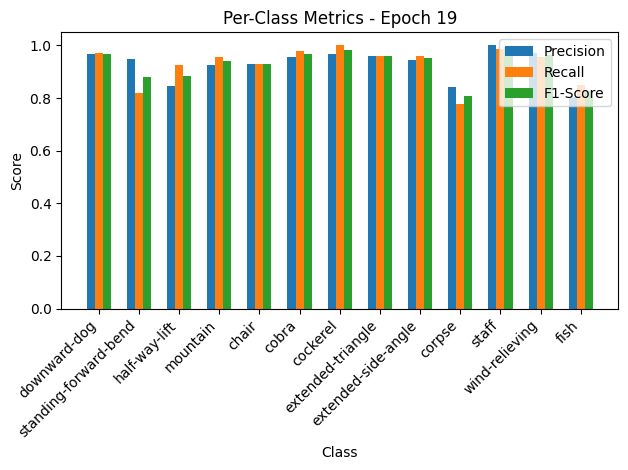


Epoch 20/50 Summary:
Train Loss: 0.2093 | Train Acc: 92.82% | Train Precision: 0.93 | Train Recall: 0.93 | Train F1: 0.93
Val Loss: 0.1997 | Val Acc: 94.52% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_4.pth
Checkpoint saved at epoch 20
New best model saved! Validation Loss: 0.1997

Epoch 21/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:02<00:00, 35.55it/s, loss=0.214, accuracy=93.2]


Per-Class Metrics for Epoch 20:
downward-dog: Precision=0.96, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.96, Recall=0.83, F1-Score=0.89
half-way-lift: Precision=0.87, Recall=0.93, F1-Score=0.90
mountain: Precision=0.93, Recall=0.94, F1-Score=0.94
chair: Precision=0.91, Recall=0.95, F1-Score=0.93
cobra: Precision=0.96, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.93, Recall=1.00, F1-Score=0.97
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.87, Recall=0.76, F1-Score=0.81
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.80, Recall=0.88, F1-Score=0.84


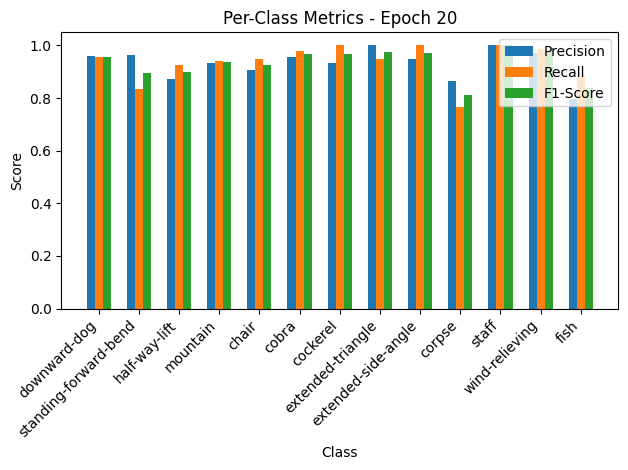

Validation: 100%|██████████| 10/10 [00:00<00:00, 172.56it/s, loss=0.175, accuracy=94.5]


Per-Class Metrics for Epoch 20:
downward-dog: Precision=0.96, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.96, Recall=0.83, F1-Score=0.89
half-way-lift: Precision=0.87, Recall=0.93, F1-Score=0.90
mountain: Precision=0.93, Recall=0.94, F1-Score=0.94
chair: Precision=0.91, Recall=0.95, F1-Score=0.93
cobra: Precision=0.96, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.93, Recall=1.00, F1-Score=0.97
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.87, Recall=0.76, F1-Score=0.81
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.80, Recall=0.88, F1-Score=0.84


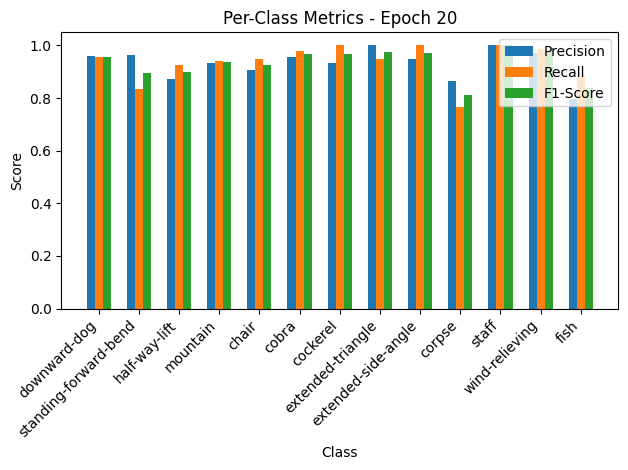


Epoch 21/50 Summary:
Train Loss: 0.2143 | Train Acc: 93.20% | Train Precision: 0.93 | Train Recall: 0.94 | Train F1: 0.93
Val Loss: 0.1919 | Val Acc: 94.52% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.95
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_4.pth
Checkpoint saved at epoch 21
New best model saved! Validation Loss: 0.1919

Epoch 22/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:02<00:00, 40.74it/s, loss=0.203, accuracy=94.2]


Per-Class Metrics for Epoch 21:
downward-dog: Precision=0.97, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.97, Recall=0.85, F1-Score=0.90
half-way-lift: Precision=0.88, Recall=0.94, F1-Score=0.91
mountain: Precision=0.95, Recall=0.97, F1-Score=0.96
chair: Precision=0.92, Recall=0.96, F1-Score=0.94
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.94, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-side-angle: Precision=0.99, Recall=0.96, F1-Score=0.97
corpse: Precision=0.88, Recall=0.87, F1-Score=0.87
staff: Precision=0.96, Recall=1.00, F1-Score=0.98
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.87, Recall=0.87, F1-Score=0.87


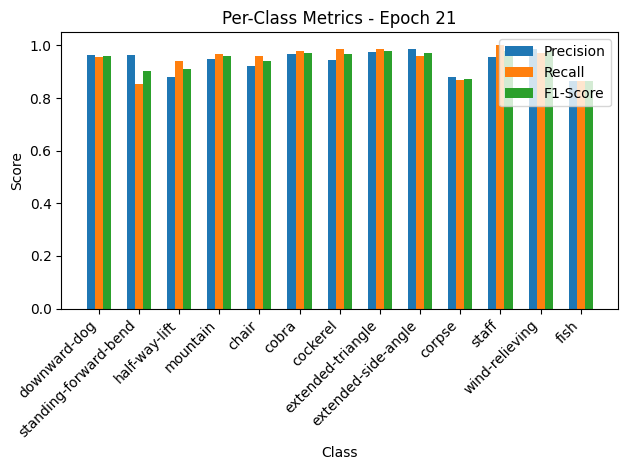

Validation: 100%|██████████| 10/10 [00:00<00:00, 148.26it/s, loss=0.194, accuracy=95.2]


Per-Class Metrics for Epoch 21:
downward-dog: Precision=0.97, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.97, Recall=0.85, F1-Score=0.90
half-way-lift: Precision=0.88, Recall=0.94, F1-Score=0.91
mountain: Precision=0.95, Recall=0.97, F1-Score=0.96
chair: Precision=0.92, Recall=0.96, F1-Score=0.94
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.94, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-side-angle: Precision=0.99, Recall=0.96, F1-Score=0.97
corpse: Precision=0.88, Recall=0.87, F1-Score=0.87
staff: Precision=0.96, Recall=1.00, F1-Score=0.98
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.87, Recall=0.87, F1-Score=0.87


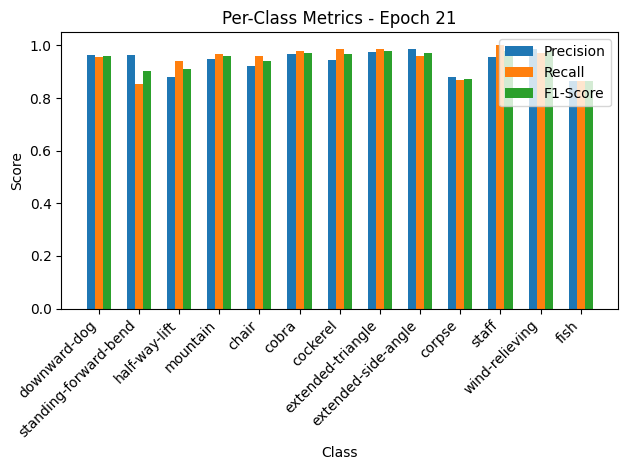


Epoch 22/50 Summary:
Train Loss: 0.2033 | Train Acc: 94.19% | Train Precision: 0.94 | Train Recall: 0.95 | Train F1: 0.94
Val Loss: 0.2128 | Val Acc: 95.21% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.96

Epoch 23/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:01<00:00, 41.11it/s, loss=0.198, accuracy=93.4]


Per-Class Metrics for Epoch 22:
downward-dog: Precision=0.95, Recall=0.96, F1-Score=0.96
standing-forward-bend: Precision=0.96, Recall=0.86, F1-Score=0.91
half-way-lift: Precision=0.87, Recall=0.92, F1-Score=0.89
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.93, Recall=0.93, F1-Score=0.93
cobra: Precision=0.96, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.95, Recall=0.98, F1-Score=0.97
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.85, Recall=0.81, F1-Score=0.83
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.82, Recall=0.84, F1-Score=0.83


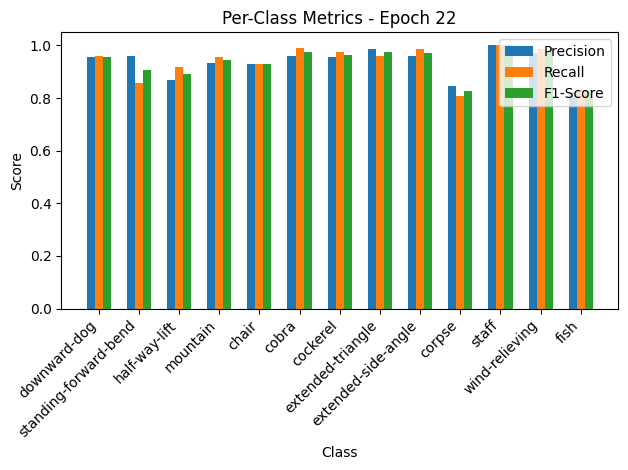

Validation: 100%|██████████| 10/10 [00:00<00:00, 174.25it/s, loss=0.185, accuracy=92.5]


Per-Class Metrics for Epoch 22:
downward-dog: Precision=0.95, Recall=0.96, F1-Score=0.96
standing-forward-bend: Precision=0.96, Recall=0.86, F1-Score=0.91
half-way-lift: Precision=0.87, Recall=0.92, F1-Score=0.89
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.93, Recall=0.93, F1-Score=0.93
cobra: Precision=0.96, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.95, Recall=0.98, F1-Score=0.97
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.85, Recall=0.81, F1-Score=0.83
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.82, Recall=0.84, F1-Score=0.83


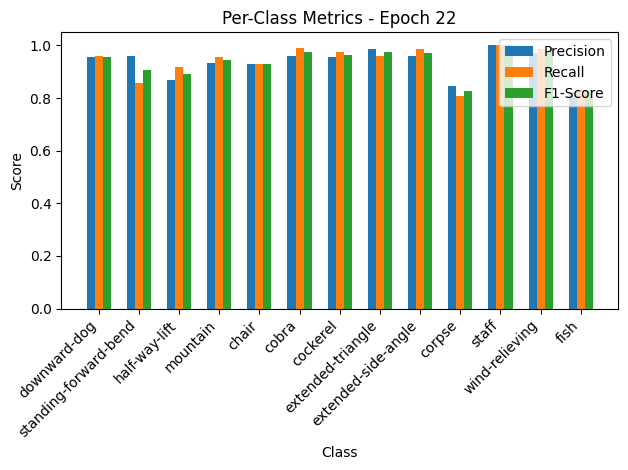


Epoch 23/50 Summary:
Train Loss: 0.1988 | Train Acc: 93.43% | Train Precision: 0.93 | Train Recall: 0.94 | Train F1: 0.93
Val Loss: 0.2032 | Val Acc: 92.47% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.94

Epoch 24/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:02<00:00, 36.69it/s, loss=0.207, accuracy=93.8]


Per-Class Metrics for Epoch 23:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.87, F1-Score=0.91
half-way-lift: Precision=0.90, Recall=0.93, F1-Score=0.92
mountain: Precision=0.93, Recall=0.95, F1-Score=0.94
chair: Precision=0.91, Recall=0.95, F1-Score=0.93
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.96, Recall=0.94, F1-Score=0.95
extended-side-angle: Precision=0.92, Recall=0.96, F1-Score=0.94
corpse: Precision=0.85, Recall=0.82, F1-Score=0.84
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.87, Recall=0.87, F1-Score=0.87


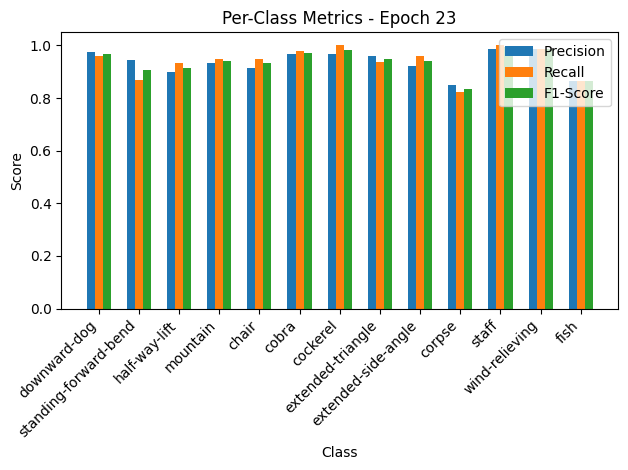

Validation: 100%|██████████| 10/10 [00:00<00:00, 144.77it/s, loss=0.194, accuracy=93.8]


Per-Class Metrics for Epoch 23:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.87, F1-Score=0.91
half-way-lift: Precision=0.90, Recall=0.93, F1-Score=0.92
mountain: Precision=0.93, Recall=0.95, F1-Score=0.94
chair: Precision=0.91, Recall=0.95, F1-Score=0.93
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.96, Recall=0.94, F1-Score=0.95
extended-side-angle: Precision=0.92, Recall=0.96, F1-Score=0.94
corpse: Precision=0.85, Recall=0.82, F1-Score=0.84
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.87, Recall=0.87, F1-Score=0.87


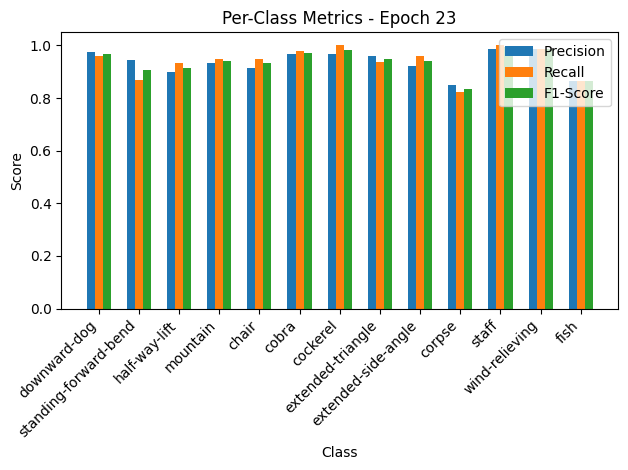


Epoch 24/50 Summary:
Train Loss: 0.2074 | Train Acc: 93.81% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.2127 | Val Acc: 93.84% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 25/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:02<00:00, 33.64it/s, loss=0.202, accuracy=94]


Per-Class Metrics for Epoch 24:
downward-dog: Precision=0.97, Recall=0.94, F1-Score=0.95
standing-forward-bend: Precision=0.93, Recall=0.90, F1-Score=0.91
half-way-lift: Precision=0.89, Recall=0.90, F1-Score=0.90
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.96, Recall=0.95, F1-Score=0.96
cobra: Precision=0.96, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.96, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.99, Recall=0.94, F1-Score=0.96
extended-side-angle: Precision=0.95, Recall=0.99, F1-Score=0.97
corpse: Precision=0.89, Recall=0.81, F1-Score=0.85
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.82, Recall=0.90, F1-Score=0.86


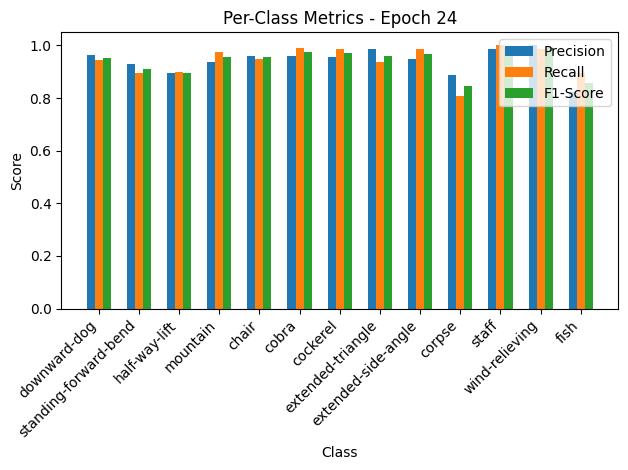

Validation: 100%|██████████| 10/10 [00:00<00:00, 150.87it/s, loss=0.189, accuracy=93.8]


Per-Class Metrics for Epoch 24:
downward-dog: Precision=0.97, Recall=0.94, F1-Score=0.95
standing-forward-bend: Precision=0.93, Recall=0.90, F1-Score=0.91
half-way-lift: Precision=0.89, Recall=0.90, F1-Score=0.90
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.96, Recall=0.95, F1-Score=0.96
cobra: Precision=0.96, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.96, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.99, Recall=0.94, F1-Score=0.96
extended-side-angle: Precision=0.95, Recall=0.99, F1-Score=0.97
corpse: Precision=0.89, Recall=0.81, F1-Score=0.85
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.82, Recall=0.90, F1-Score=0.86


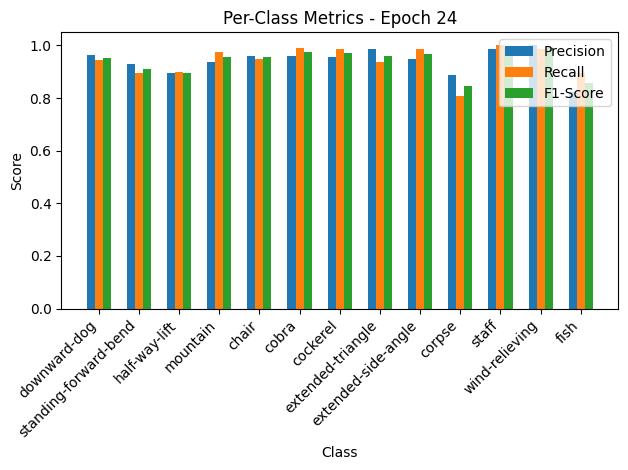


Epoch 25/50 Summary:
Train Loss: 0.2022 | Train Acc: 93.96% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.2067 | Val Acc: 93.84% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.95

Epoch 26/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:01<00:00, 41.25it/s, loss=0.212, accuracy=93.5]


Per-Class Metrics for Epoch 25:
downward-dog: Precision=0.95, Recall=0.95, F1-Score=0.95
standing-forward-bend: Precision=0.93, Recall=0.90, F1-Score=0.91
half-way-lift: Precision=0.91, Recall=0.91, F1-Score=0.91
mountain: Precision=0.92, Recall=0.97, F1-Score=0.95
chair: Precision=0.95, Recall=0.91, F1-Score=0.93
cobra: Precision=0.96, Recall=0.97, F1-Score=0.96
cockerel: Precision=0.93, Recall=0.98, F1-Score=0.95
extended-triangle: Precision=0.99, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.99, F1-Score=0.97
corpse: Precision=0.86, Recall=0.81, F1-Score=0.83
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.84, Recall=0.87, F1-Score=0.85


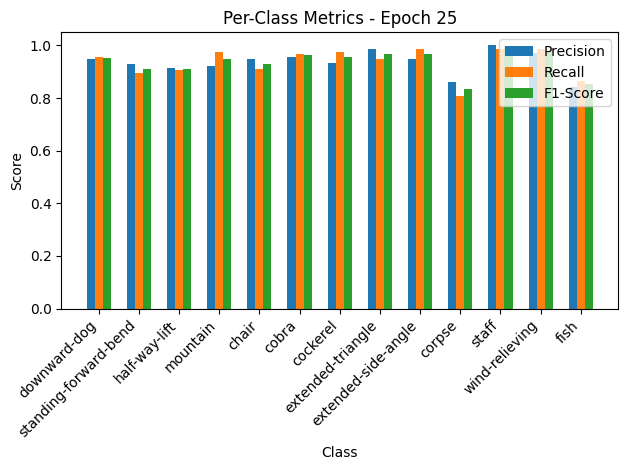

Validation: 100%|██████████| 10/10 [00:00<00:00, 184.98it/s, loss=0.196, accuracy=93.8]


Per-Class Metrics for Epoch 25:
downward-dog: Precision=0.95, Recall=0.95, F1-Score=0.95
standing-forward-bend: Precision=0.93, Recall=0.90, F1-Score=0.91
half-way-lift: Precision=0.91, Recall=0.91, F1-Score=0.91
mountain: Precision=0.92, Recall=0.97, F1-Score=0.95
chair: Precision=0.95, Recall=0.91, F1-Score=0.93
cobra: Precision=0.96, Recall=0.97, F1-Score=0.96
cockerel: Precision=0.93, Recall=0.98, F1-Score=0.95
extended-triangle: Precision=0.99, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.99, F1-Score=0.97
corpse: Precision=0.86, Recall=0.81, F1-Score=0.83
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.84, Recall=0.87, F1-Score=0.85


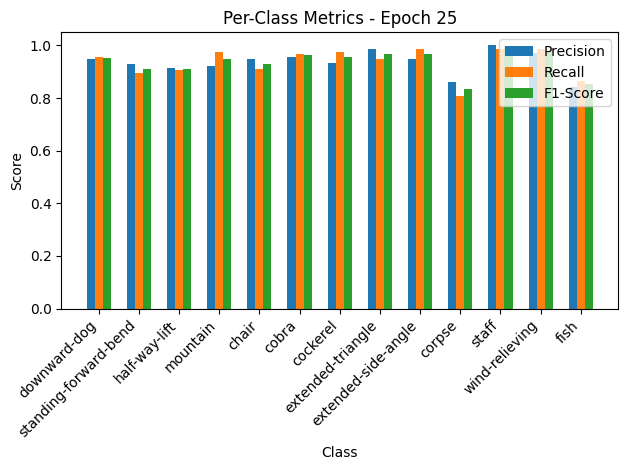


Epoch 26/50 Summary:
Train Loss: 0.2127 | Train Acc: 93.51% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.2143 | Val Acc: 93.84% | Val Precision: 0.96 | Val Recall: 0.95 | Val F1: 0.95

Epoch 27/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:01<00:00, 43.63it/s, loss=0.193, accuracy=94.3]


Per-Class Metrics for Epoch 26:
downward-dog: Precision=0.99, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.94, Recall=0.86, F1-Score=0.90
half-way-lift: Precision=0.87, Recall=0.94, F1-Score=0.90
mountain: Precision=0.95, Recall=0.97, F1-Score=0.96
chair: Precision=0.96, Recall=0.94, F1-Score=0.95
cobra: Precision=0.96, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.93, Recall=1.00, F1-Score=0.97
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.88, Recall=0.85, F1-Score=0.87
staff: Precision=0.99, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.87, Recall=0.88, F1-Score=0.87


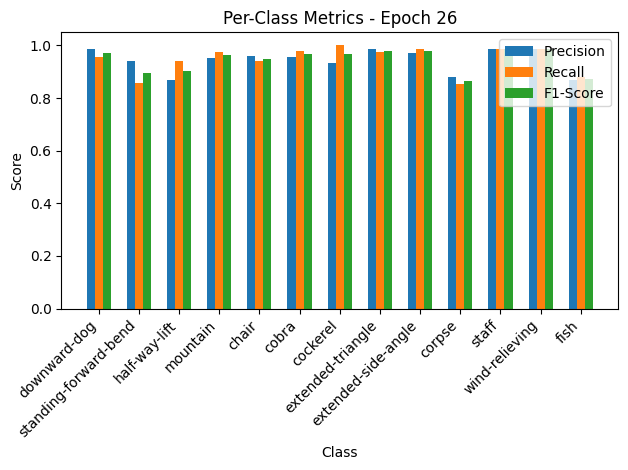

Validation: 100%|██████████| 10/10 [00:00<00:00, 181.54it/s, loss=0.202, accuracy=93.2]


Per-Class Metrics for Epoch 26:
downward-dog: Precision=0.99, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.94, Recall=0.86, F1-Score=0.90
half-way-lift: Precision=0.87, Recall=0.94, F1-Score=0.90
mountain: Precision=0.95, Recall=0.97, F1-Score=0.96
chair: Precision=0.96, Recall=0.94, F1-Score=0.95
cobra: Precision=0.96, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.93, Recall=1.00, F1-Score=0.97
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.88, Recall=0.85, F1-Score=0.87
staff: Precision=0.99, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.87, Recall=0.88, F1-Score=0.87


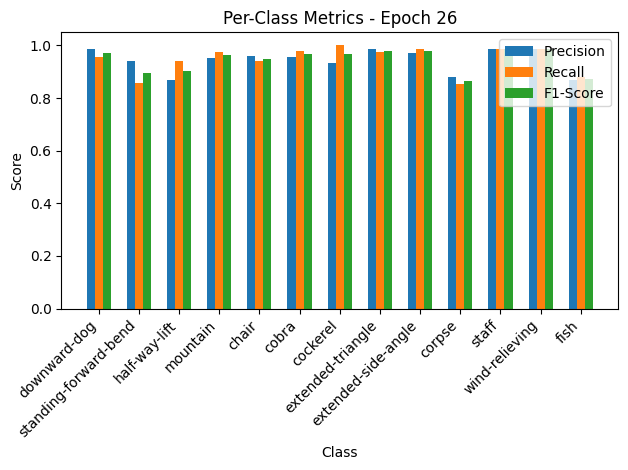


Epoch 27/50 Summary:
Train Loss: 0.1931 | Train Acc: 94.35% | Train Precision: 0.94 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.2212 | Val Acc: 93.15% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.94

Epoch 28/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:01<00:00, 42.73it/s, loss=0.188, accuracy=94.5]


Per-Class Metrics for Epoch 27:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.94, Recall=0.91, F1-Score=0.92
half-way-lift: Precision=0.92, Recall=0.89, F1-Score=0.91
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.92, Recall=0.96, F1-Score=0.94
cobra: Precision=0.98, Recall=0.97, F1-Score=0.97
cockerel: Precision=0.95, Recall=1.00, F1-Score=0.97
extended-triangle: Precision=0.96, Recall=0.96, F1-Score=0.96
extended-side-angle: Precision=0.96, Recall=0.97, F1-Score=0.97
corpse: Precision=0.84, Recall=0.90, F1-Score=0.87
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.97, F1-Score=0.99
fish: Precision=0.89, Recall=0.84, F1-Score=0.86


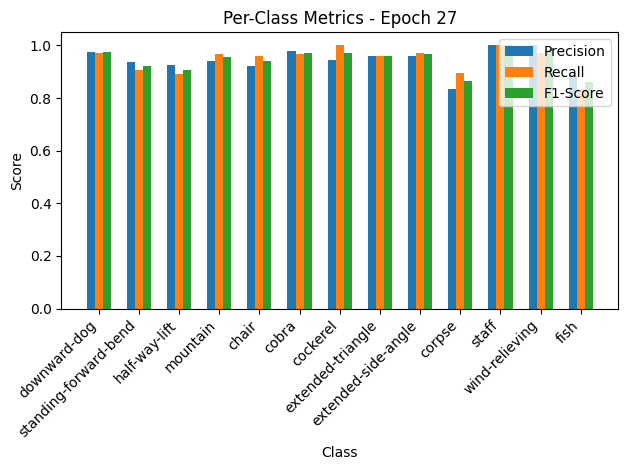

Validation: 100%|██████████| 10/10 [00:00<00:00, 137.75it/s, loss=0.19, accuracy=93.8]


Per-Class Metrics for Epoch 27:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.94, Recall=0.91, F1-Score=0.92
half-way-lift: Precision=0.92, Recall=0.89, F1-Score=0.91
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.92, Recall=0.96, F1-Score=0.94
cobra: Precision=0.98, Recall=0.97, F1-Score=0.97
cockerel: Precision=0.95, Recall=1.00, F1-Score=0.97
extended-triangle: Precision=0.96, Recall=0.96, F1-Score=0.96
extended-side-angle: Precision=0.96, Recall=0.97, F1-Score=0.97
corpse: Precision=0.84, Recall=0.90, F1-Score=0.87
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.97, F1-Score=0.99
fish: Precision=0.89, Recall=0.84, F1-Score=0.86


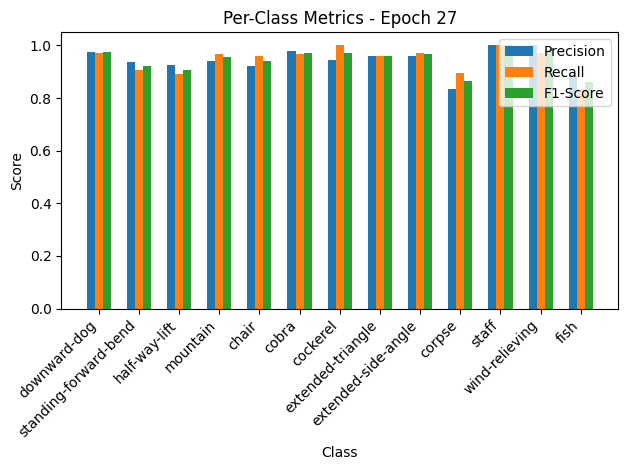


Epoch 28/50 Summary:
Train Loss: 0.1888 | Train Acc: 94.50% | Train Precision: 0.94 | Train Recall: 0.95 | Train F1: 0.94
Val Loss: 0.2084 | Val Acc: 93.84% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 29/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:02<00:00, 37.54it/s, loss=0.177, accuracy=94.5]


Per-Class Metrics for Epoch 28:
downward-dog: Precision=0.99, Recall=0.96, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.90, Recall=0.95, F1-Score=0.93
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.97, Recall=0.95, F1-Score=0.96
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.91, Recall=1.00, F1-Score=0.96
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.97, F1-Score=0.97
corpse: Precision=0.88, Recall=0.76, F1-Score=0.82
staff: Precision=0.99, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.81, Recall=0.90, F1-Score=0.85


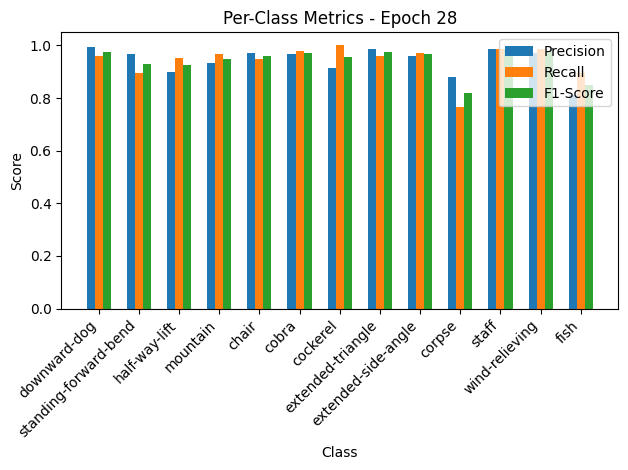

Validation: 100%|██████████| 10/10 [00:00<00:00, 135.62it/s, loss=0.192, accuracy=92.5]


Per-Class Metrics for Epoch 28:
downward-dog: Precision=0.99, Recall=0.96, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.90, Recall=0.95, F1-Score=0.93
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.97, Recall=0.95, F1-Score=0.96
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.91, Recall=1.00, F1-Score=0.96
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.97, F1-Score=0.97
corpse: Precision=0.88, Recall=0.76, F1-Score=0.82
staff: Precision=0.99, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.81, Recall=0.90, F1-Score=0.85


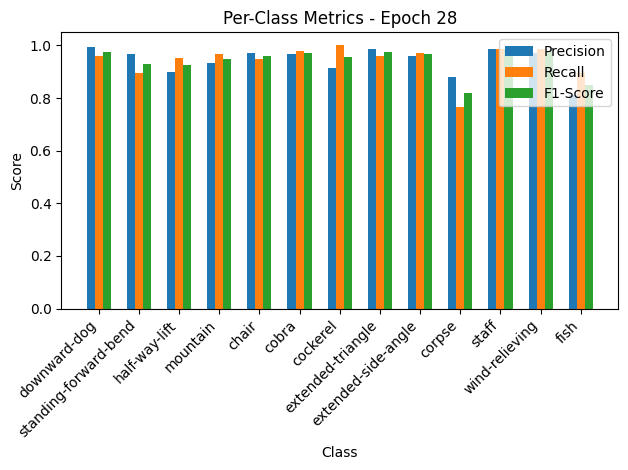


Epoch 29/50 Summary:
Train Loss: 0.1775 | Train Acc: 94.50% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.2104 | Val Acc: 92.47% | Val Precision: 0.94 | Val Recall: 0.94 | Val F1: 0.94

Epoch 30/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:02<00:00, 35.36it/s, loss=0.172, accuracy=94.7]


Per-Class Metrics for Epoch 29:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.90, F1-Score=0.92
half-way-lift: Precision=0.90, Recall=0.94, F1-Score=0.92
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.94, Recall=0.95, F1-Score=0.95
cobra: Precision=0.98, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.99, F1-Score=0.97
corpse: Precision=0.90, Recall=0.84, F1-Score=0.87
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.85, Recall=0.90, F1-Score=0.87


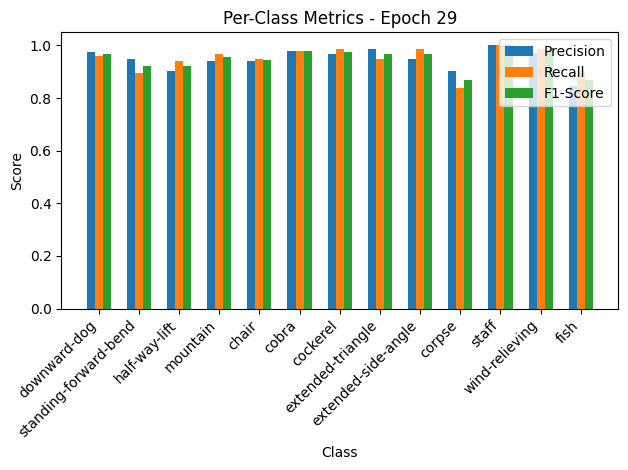

Validation: 100%|██████████| 10/10 [00:00<00:00, 170.63it/s, loss=0.178, accuracy=95.2]


Per-Class Metrics for Epoch 29:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.90, F1-Score=0.92
half-way-lift: Precision=0.90, Recall=0.94, F1-Score=0.92
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.94, Recall=0.95, F1-Score=0.95
cobra: Precision=0.98, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.99, F1-Score=0.97
corpse: Precision=0.90, Recall=0.84, F1-Score=0.87
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.85, Recall=0.90, F1-Score=0.87


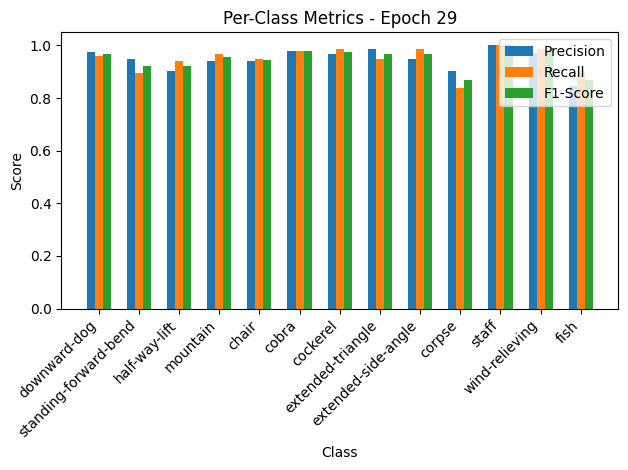


Epoch 30/50 Summary:
Train Loss: 0.1723 | Train Acc: 94.73% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.1946 | Val Acc: 95.21% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.96

Epoch 31/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:02<00:00, 39.33it/s, loss=0.178, accuracy=94.5]


Per-Class Metrics for Epoch 30:
downward-dog: Precision=0.98, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.96, Recall=0.88, F1-Score=0.92
half-way-lift: Precision=0.88, Recall=0.97, F1-Score=0.92
mountain: Precision=0.93, Recall=0.98, F1-Score=0.96
chair: Precision=0.97, Recall=0.93, F1-Score=0.95
cobra: Precision=0.96, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.98, Recall=0.98, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.96, F1-Score=0.96
corpse: Precision=0.88, Recall=0.82, F1-Score=0.85
staff: Precision=0.99, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.84, Recall=0.88, F1-Score=0.86


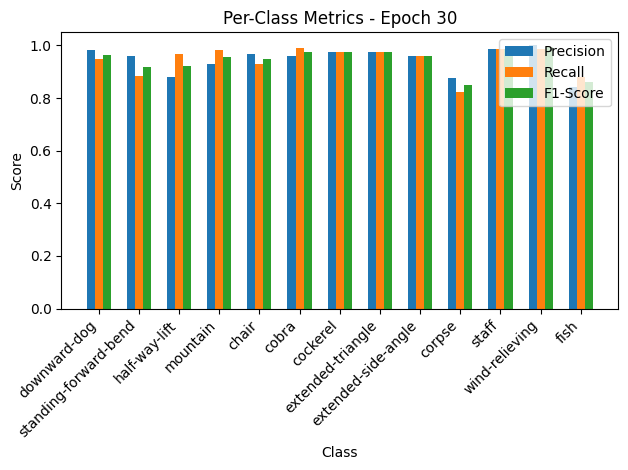

Validation: 100%|██████████| 10/10 [00:00<00:00, 175.29it/s, loss=0.184, accuracy=93.2]


Per-Class Metrics for Epoch 30:
downward-dog: Precision=0.98, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.96, Recall=0.88, F1-Score=0.92
half-way-lift: Precision=0.88, Recall=0.97, F1-Score=0.92
mountain: Precision=0.93, Recall=0.98, F1-Score=0.96
chair: Precision=0.97, Recall=0.93, F1-Score=0.95
cobra: Precision=0.96, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.98, Recall=0.98, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.96, F1-Score=0.96
corpse: Precision=0.88, Recall=0.82, F1-Score=0.85
staff: Precision=0.99, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.84, Recall=0.88, F1-Score=0.86


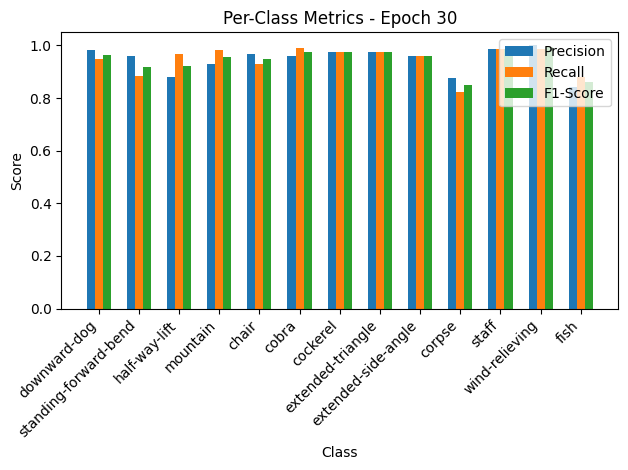


Epoch 31/50 Summary:
Train Loss: 0.1784 | Train Acc: 94.50% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.94
Val Loss: 0.2018 | Val Acc: 93.15% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 32/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:01<00:00, 41.21it/s, loss=0.171, accuracy=94.9]


Per-Class Metrics for Epoch 31:
downward-dog: Precision=0.97, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.97, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.90, Recall=0.95, F1-Score=0.93
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.96, Recall=0.94, F1-Score=0.95
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.93, Recall=1.00, F1-Score=0.97
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.88, Recall=0.87, F1-Score=0.87
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.87, Recall=0.87, F1-Score=0.87


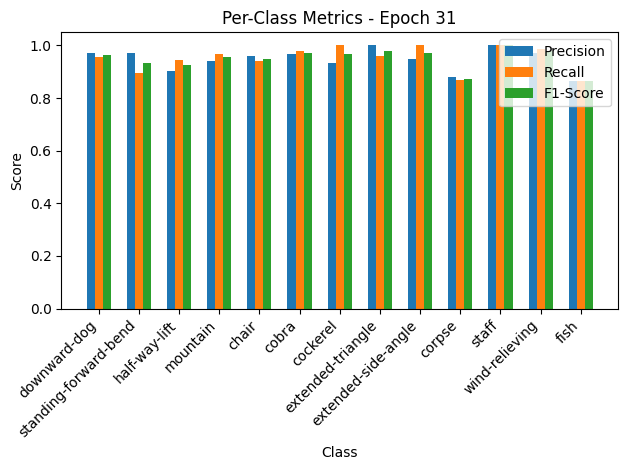

Validation: 100%|██████████| 10/10 [00:00<00:00, 172.19it/s, loss=0.182, accuracy=93.8]


Per-Class Metrics for Epoch 31:
downward-dog: Precision=0.97, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.97, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.90, Recall=0.95, F1-Score=0.93
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.96, Recall=0.94, F1-Score=0.95
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.93, Recall=1.00, F1-Score=0.97
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.88, Recall=0.87, F1-Score=0.87
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.87, Recall=0.87, F1-Score=0.87


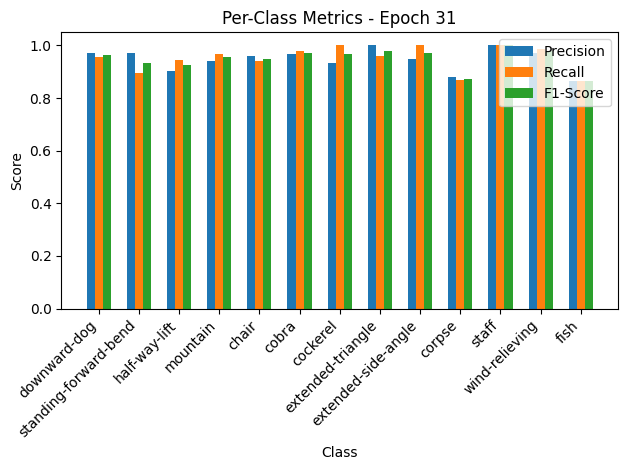


Epoch 32/50 Summary:
Train Loss: 0.1716 | Train Acc: 94.88% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.1990 | Val Acc: 93.84% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.95

Epoch 33/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:02<00:00, 40.56it/s, loss=0.189, accuracy=94.3]


Per-Class Metrics for Epoch 32:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.87, F1-Score=0.92
half-way-lift: Precision=0.88, Recall=0.95, F1-Score=0.91
mountain: Precision=0.94, Recall=0.97, F1-Score=0.96
chair: Precision=0.93, Recall=0.96, F1-Score=0.95
cobra: Precision=0.96, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.94, Recall=0.97, F1-Score=0.95
extended-triangle: Precision=0.99, Recall=0.92, F1-Score=0.95
extended-side-angle: Precision=0.92, Recall=0.96, F1-Score=0.94
corpse: Precision=0.89, Recall=0.84, F1-Score=0.86
staff: Precision=1.00, Recall=0.97, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.84, Recall=0.88, F1-Score=0.86


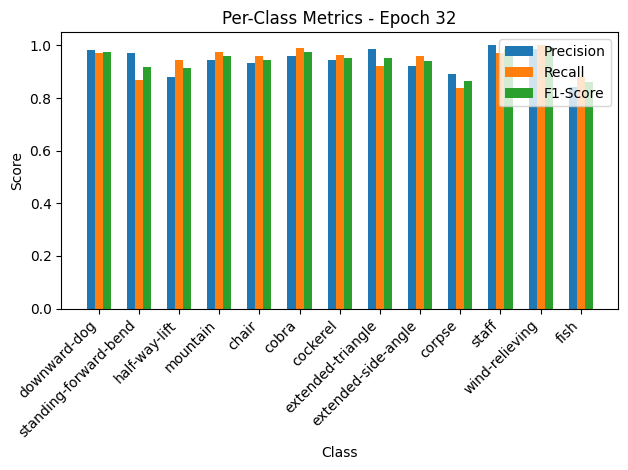

Validation: 100%|██████████| 10/10 [00:00<00:00, 139.45it/s, loss=0.198, accuracy=93.2]


Per-Class Metrics for Epoch 32:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.87, F1-Score=0.92
half-way-lift: Precision=0.88, Recall=0.95, F1-Score=0.91
mountain: Precision=0.94, Recall=0.97, F1-Score=0.96
chair: Precision=0.93, Recall=0.96, F1-Score=0.95
cobra: Precision=0.96, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.94, Recall=0.97, F1-Score=0.95
extended-triangle: Precision=0.99, Recall=0.92, F1-Score=0.95
extended-side-angle: Precision=0.92, Recall=0.96, F1-Score=0.94
corpse: Precision=0.89, Recall=0.84, F1-Score=0.86
staff: Precision=1.00, Recall=0.97, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.84, Recall=0.88, F1-Score=0.86


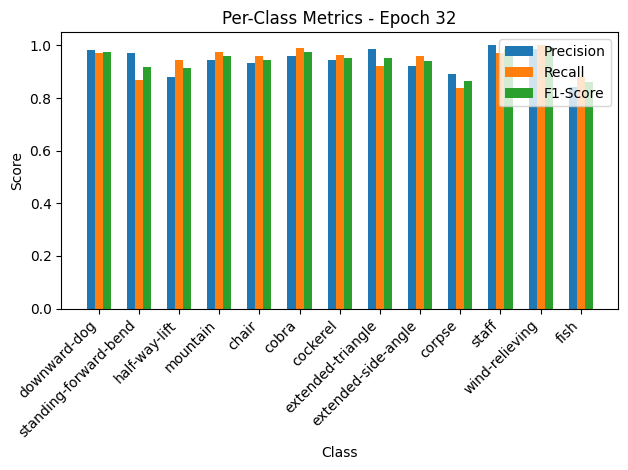


Epoch 33/50 Summary:
Train Loss: 0.1896 | Train Acc: 94.27% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.2169 | Val Acc: 93.15% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 34/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:01<00:00, 41.45it/s, loss=0.161, accuracy=95.2]


Per-Class Metrics for Epoch 33:
downward-dog: Precision=0.99, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.97, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.90, Recall=0.95, F1-Score=0.93
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.96, Recall=0.94, F1-Score=0.95
cobra: Precision=0.96, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.99, F1-Score=0.99
corpse: Precision=0.92, Recall=0.82, F1-Score=0.87
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.97, F1-Score=0.99
fish: Precision=0.83, Recall=0.94, F1-Score=0.88


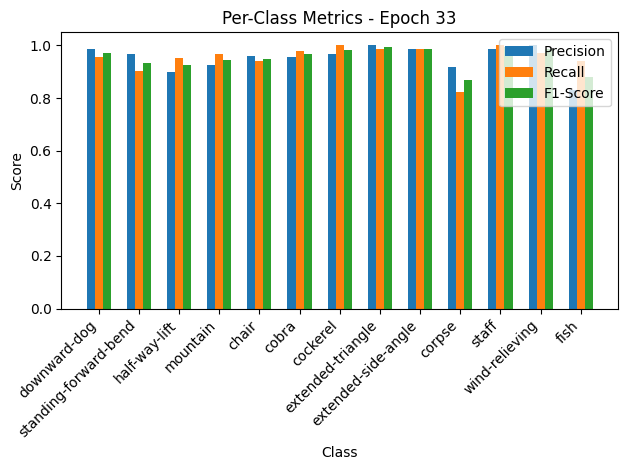

Validation: 100%|██████████| 10/10 [00:00<00:00, 134.78it/s, loss=0.194, accuracy=93.2]


Per-Class Metrics for Epoch 33:
downward-dog: Precision=0.99, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.97, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.90, Recall=0.95, F1-Score=0.93
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.96, Recall=0.94, F1-Score=0.95
cobra: Precision=0.96, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.99, F1-Score=0.99
corpse: Precision=0.92, Recall=0.82, F1-Score=0.87
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.97, F1-Score=0.99
fish: Precision=0.83, Recall=0.94, F1-Score=0.88


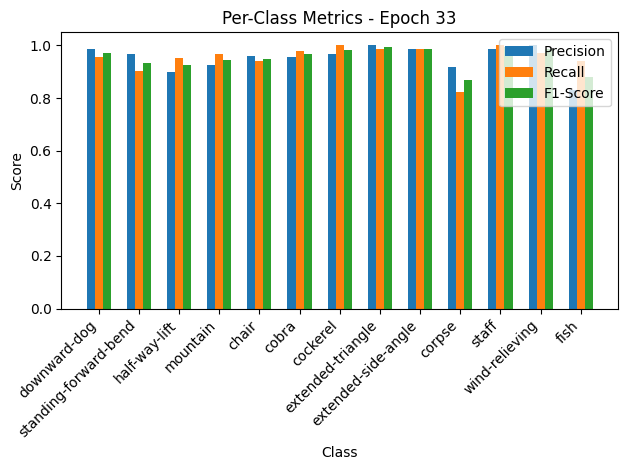


Epoch 34/50 Summary:
Train Loss: 0.1614 | Train Acc: 95.19% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.2127 | Val Acc: 93.15% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 35/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:01<00:00, 41.04it/s, loss=0.169, accuracy=94.7]


Per-Class Metrics for Epoch 34:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.94, Recall=0.90, F1-Score=0.92
half-way-lift: Precision=0.90, Recall=0.93, F1-Score=0.91
mountain: Precision=0.91, Recall=0.97, F1-Score=0.94
chair: Precision=0.96, Recall=0.93, F1-Score=0.94
cobra: Precision=0.98, Recall=0.97, F1-Score=0.97
cockerel: Precision=0.97, Recall=0.98, F1-Score=0.97
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.90, Recall=0.88, F1-Score=0.89
staff: Precision=0.97, Recall=0.99, F1-Score=0.98
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.88, Recall=0.90, F1-Score=0.89


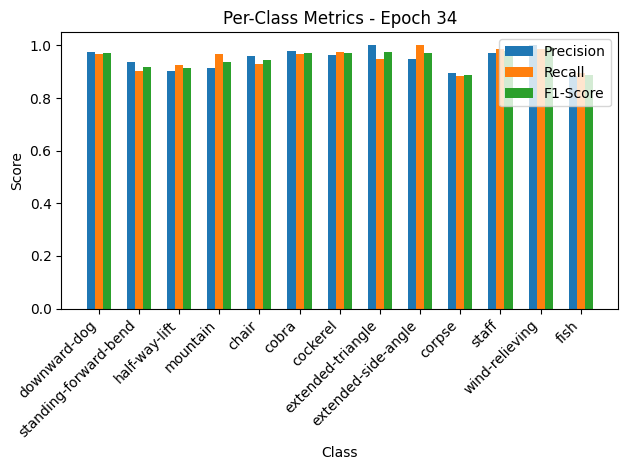

Validation: 100%|██████████| 10/10 [00:00<00:00, 169.41it/s, loss=0.189, accuracy=93.2]


Per-Class Metrics for Epoch 34:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.94, Recall=0.90, F1-Score=0.92
half-way-lift: Precision=0.90, Recall=0.93, F1-Score=0.91
mountain: Precision=0.91, Recall=0.97, F1-Score=0.94
chair: Precision=0.96, Recall=0.93, F1-Score=0.94
cobra: Precision=0.98, Recall=0.97, F1-Score=0.97
cockerel: Precision=0.97, Recall=0.98, F1-Score=0.97
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.90, Recall=0.88, F1-Score=0.89
staff: Precision=0.97, Recall=0.99, F1-Score=0.98
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.88, Recall=0.90, F1-Score=0.89


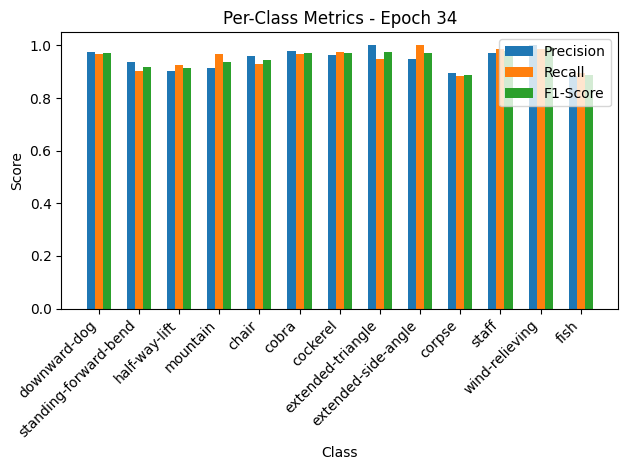


Epoch 35/50 Summary:
Train Loss: 0.1693 | Train Acc: 94.65% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.2073 | Val Acc: 93.15% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 36/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:01<00:00, 42.02it/s, loss=0.171, accuracy=94.1]


Per-Class Metrics for Epoch 35:
downward-dog: Precision=0.99, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.94, Recall=0.91, F1-Score=0.92
half-way-lift: Precision=0.91, Recall=0.93, F1-Score=0.92
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.98, Recall=0.95, F1-Score=0.96
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.96, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.97, Recall=0.97, F1-Score=0.97
corpse: Precision=0.80, Recall=0.81, F1-Score=0.80
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.96, F1-Score=0.98
fish: Precision=0.78, Recall=0.81, F1-Score=0.79


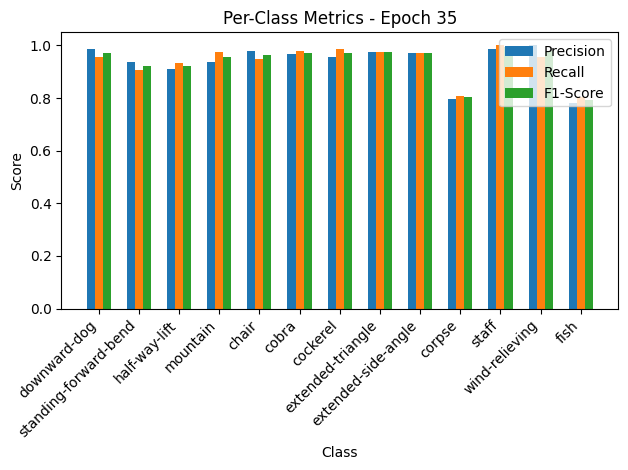

Validation: 100%|██████████| 10/10 [00:00<00:00, 173.51it/s, loss=0.184, accuracy=95.2]


Per-Class Metrics for Epoch 35:
downward-dog: Precision=0.99, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.94, Recall=0.91, F1-Score=0.92
half-way-lift: Precision=0.91, Recall=0.93, F1-Score=0.92
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.98, Recall=0.95, F1-Score=0.96
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.96, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.97, Recall=0.97, F1-Score=0.97
corpse: Precision=0.80, Recall=0.81, F1-Score=0.80
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.96, F1-Score=0.98
fish: Precision=0.78, Recall=0.81, F1-Score=0.79


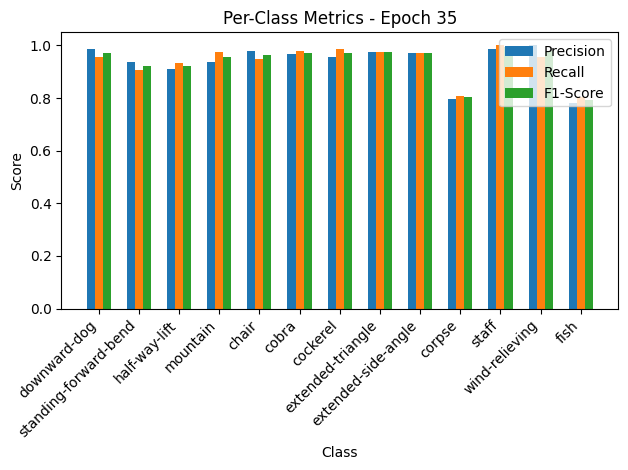


Epoch 36/50 Summary:
Train Loss: 0.1712 | Train Acc: 94.12% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.2013 | Val Acc: 95.21% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.96

Epoch 37/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:01<00:00, 41.38it/s, loss=0.164, accuracy=95.3]


Per-Class Metrics for Epoch 36:
downward-dog: Precision=0.98, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.91, F1-Score=0.93
half-way-lift: Precision=0.92, Recall=0.95, F1-Score=0.93
mountain: Precision=0.95, Recall=0.98, F1-Score=0.97
chair: Precision=0.98, Recall=0.96, F1-Score=0.97
cobra: Precision=0.97, Recall=0.97, F1-Score=0.97
cockerel: Precision=0.94, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.90, Recall=0.82, F1-Score=0.86
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.83, Recall=0.90, F1-Score=0.86


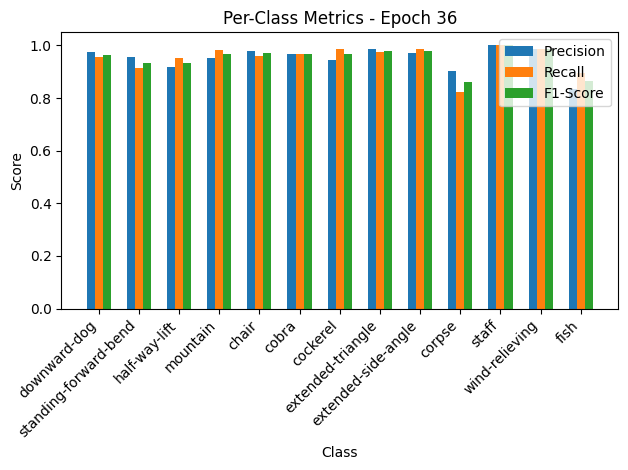

Validation: 100%|██████████| 10/10 [00:00<00:00, 181.48it/s, loss=0.182, accuracy=94.5]


Per-Class Metrics for Epoch 36:
downward-dog: Precision=0.98, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.91, F1-Score=0.93
half-way-lift: Precision=0.92, Recall=0.95, F1-Score=0.93
mountain: Precision=0.95, Recall=0.98, F1-Score=0.97
chair: Precision=0.98, Recall=0.96, F1-Score=0.97
cobra: Precision=0.97, Recall=0.97, F1-Score=0.97
cockerel: Precision=0.94, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.90, Recall=0.82, F1-Score=0.86
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.83, Recall=0.90, F1-Score=0.86


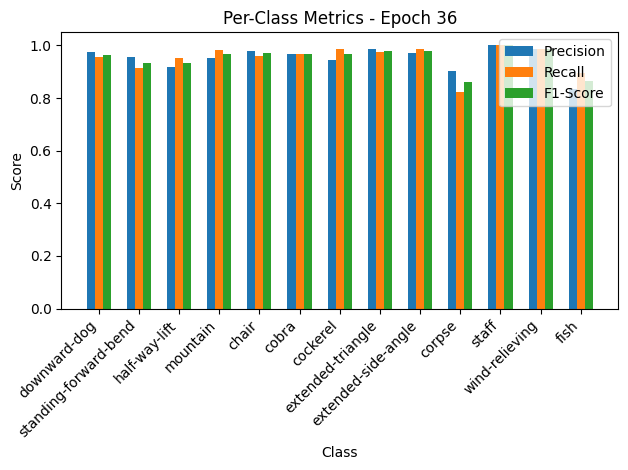


Epoch 37/50 Summary:
Train Loss: 0.1645 | Train Acc: 95.26% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.2000 | Val Acc: 94.52% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 38/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:02<00:00, 34.96it/s, loss=0.157, accuracy=95.8]


Per-Class Metrics for Epoch 37:
downward-dog: Precision=0.99, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.91, F1-Score=0.93
half-way-lift: Precision=0.91, Recall=0.95, F1-Score=0.93
mountain: Precision=0.94, Recall=0.99, F1-Score=0.97
chair: Precision=0.98, Recall=0.96, F1-Score=0.97
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.92, Recall=0.85, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.97, F1-Score=0.99
fish: Precision=0.85, Recall=0.93, F1-Score=0.89


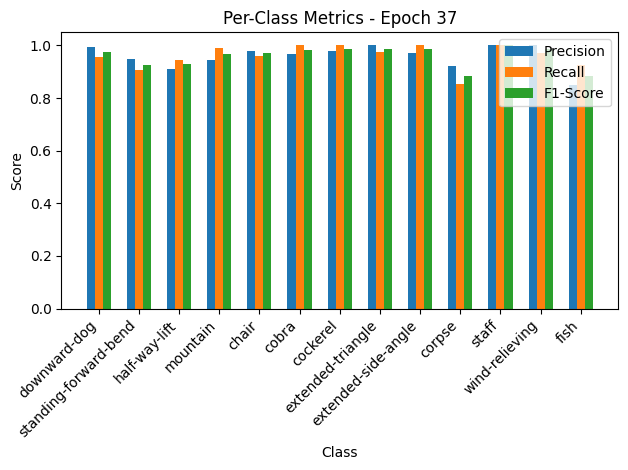

Validation: 100%|██████████| 10/10 [00:00<00:00, 147.90it/s, loss=0.183, accuracy=94.5]


Per-Class Metrics for Epoch 37:
downward-dog: Precision=0.99, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.91, F1-Score=0.93
half-way-lift: Precision=0.91, Recall=0.95, F1-Score=0.93
mountain: Precision=0.94, Recall=0.99, F1-Score=0.97
chair: Precision=0.98, Recall=0.96, F1-Score=0.97
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.92, Recall=0.85, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.97, F1-Score=0.99
fish: Precision=0.85, Recall=0.93, F1-Score=0.89


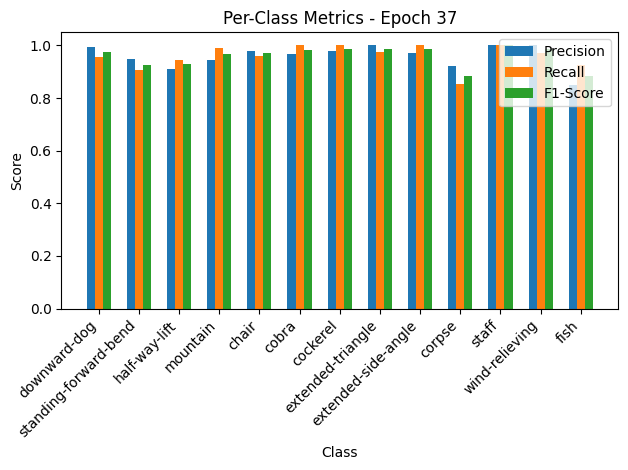


Epoch 38/50 Summary:
Train Loss: 0.1573 | Train Acc: 95.80% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.2003 | Val Acc: 94.52% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 39/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:02<00:00, 36.47it/s, loss=0.156, accuracy=96]


Per-Class Metrics for Epoch 38:
downward-dog: Precision=0.99, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.92, F1-Score=0.93
half-way-lift: Precision=0.92, Recall=0.95, F1-Score=0.94
mountain: Precision=0.95, Recall=0.97, F1-Score=0.96
chair: Precision=0.97, Recall=0.97, F1-Score=0.97
cobra: Precision=0.97, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.94, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.95, Recall=0.90, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.91, Recall=0.94, F1-Score=0.93


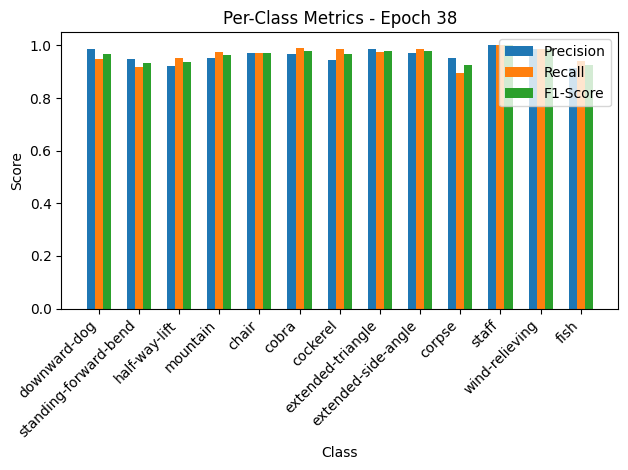

Validation: 100%|██████████| 10/10 [00:00<00:00, 159.16it/s, loss=0.18, accuracy=95.2]


Per-Class Metrics for Epoch 38:
downward-dog: Precision=0.99, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.92, F1-Score=0.93
half-way-lift: Precision=0.92, Recall=0.95, F1-Score=0.94
mountain: Precision=0.95, Recall=0.97, F1-Score=0.96
chair: Precision=0.97, Recall=0.97, F1-Score=0.97
cobra: Precision=0.97, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.94, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.95, Recall=0.90, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.91, Recall=0.94, F1-Score=0.93


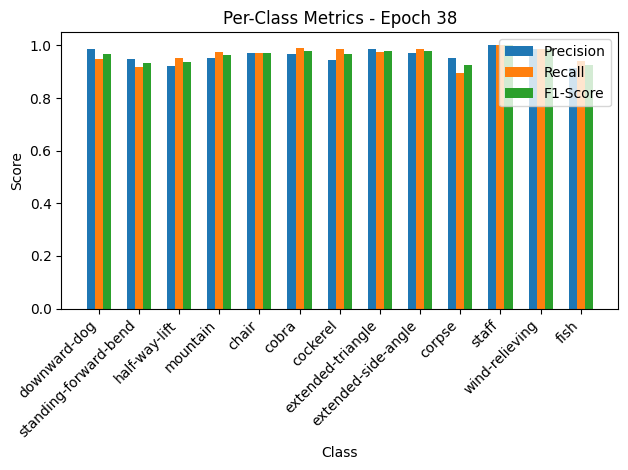


Epoch 39/50 Summary:
Train Loss: 0.1564 | Train Acc: 96.03% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.1972 | Val Acc: 95.21% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.96

Epoch 40/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:02<00:00, 40.41it/s, loss=0.154, accuracy=95.6]


Per-Class Metrics for Epoch 39:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.91, Recall=0.97, F1-Score=0.94
mountain: Precision=0.95, Recall=0.98, F1-Score=0.97
chair: Precision=0.97, Recall=0.96, F1-Score=0.97
cobra: Precision=0.97, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.99, F1-Score=0.99
corpse: Precision=0.87, Recall=0.81, F1-Score=0.84
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.82, Recall=0.88, F1-Score=0.85


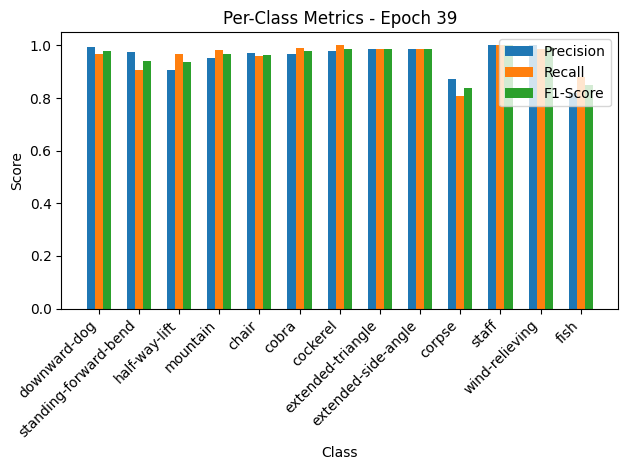

Validation: 100%|██████████| 10/10 [00:00<00:00, 162.04it/s, loss=0.182, accuracy=94.5]


Per-Class Metrics for Epoch 39:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.91, Recall=0.97, F1-Score=0.94
mountain: Precision=0.95, Recall=0.98, F1-Score=0.97
chair: Precision=0.97, Recall=0.96, F1-Score=0.97
cobra: Precision=0.97, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.99, F1-Score=0.99
corpse: Precision=0.87, Recall=0.81, F1-Score=0.84
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.82, Recall=0.88, F1-Score=0.85


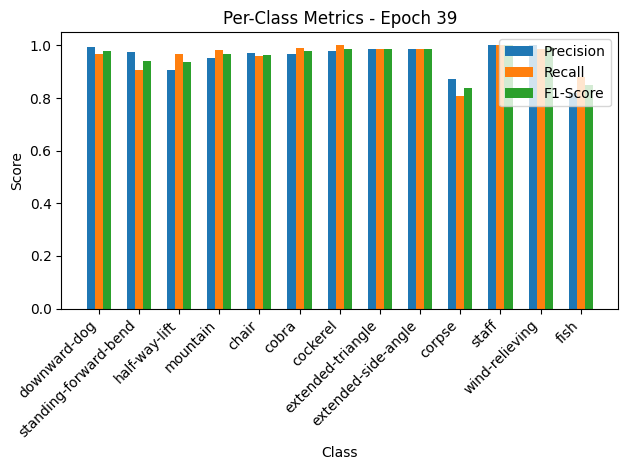


Epoch 40/50 Summary:
Train Loss: 0.1544 | Train Acc: 95.65% | Train Precision: 0.95 | Train Recall: 0.96 | Train F1: 0.95
Val Loss: 0.1990 | Val Acc: 94.52% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 41/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:02<00:00, 38.86it/s, loss=0.154, accuracy=95.9]


Per-Class Metrics for Epoch 40:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.92, Recall=0.95, F1-Score=0.93
mountain: Precision=0.94, Recall=0.97, F1-Score=0.96
chair: Precision=0.96, Recall=0.95, F1-Score=0.96
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.95, Recall=1.00, F1-Score=0.97
extended-triangle: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.99, F1-Score=0.99
corpse: Precision=0.91, Recall=0.90, F1-Score=0.90
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.90, Recall=0.90, F1-Score=0.90


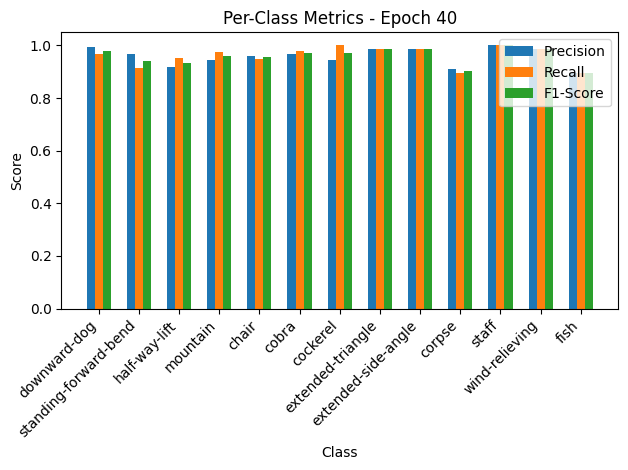

Validation: 100%|██████████| 10/10 [00:00<00:00, 163.46it/s, loss=0.188, accuracy=92.5]


Per-Class Metrics for Epoch 40:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.92, Recall=0.95, F1-Score=0.93
mountain: Precision=0.94, Recall=0.97, F1-Score=0.96
chair: Precision=0.96, Recall=0.95, F1-Score=0.96
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.95, Recall=1.00, F1-Score=0.97
extended-triangle: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.99, F1-Score=0.99
corpse: Precision=0.91, Recall=0.90, F1-Score=0.90
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.90, Recall=0.90, F1-Score=0.90


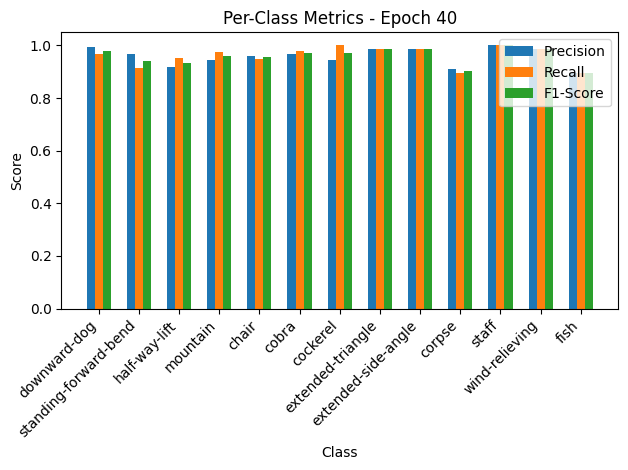


Epoch 41/50 Summary:
Train Loss: 0.1543 | Train Acc: 95.87% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.2056 | Val Acc: 92.47% | Val Precision: 0.94 | Val Recall: 0.94 | Val F1: 0.94

Epoch 42/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:02<00:00, 38.06it/s, loss=0.155, accuracy=95.4]


Per-Class Metrics for Epoch 41:
downward-dog: Precision=0.99, Recall=0.96, F1-Score=0.98
standing-forward-bend: Precision=0.96, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.91, Recall=0.95, F1-Score=0.93
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.93, Recall=0.94, F1-Score=0.94
cobra: Precision=0.97, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.93, Recall=1.00, F1-Score=0.97
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.97, Recall=0.87, F1-Score=0.91
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.89, Recall=0.96, F1-Score=0.92


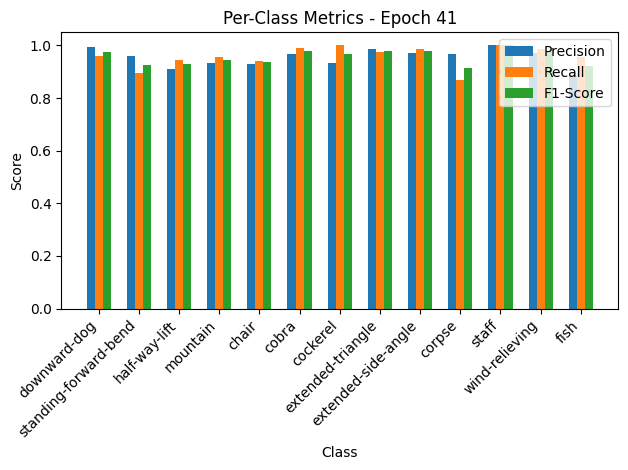

Validation: 100%|██████████| 10/10 [00:00<00:00, 137.59it/s, loss=0.188, accuracy=93.2]


Per-Class Metrics for Epoch 41:
downward-dog: Precision=0.99, Recall=0.96, F1-Score=0.98
standing-forward-bend: Precision=0.96, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.91, Recall=0.95, F1-Score=0.93
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.93, Recall=0.94, F1-Score=0.94
cobra: Precision=0.97, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.93, Recall=1.00, F1-Score=0.97
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.97, Recall=0.87, F1-Score=0.91
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.89, Recall=0.96, F1-Score=0.92


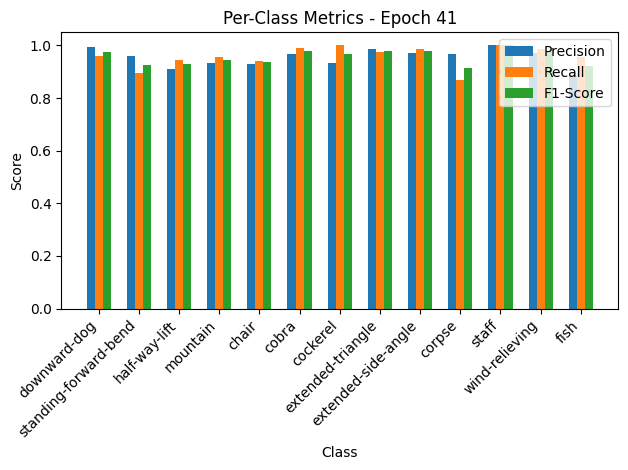


Epoch 42/50 Summary:
Train Loss: 0.1557 | Train Acc: 95.42% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.2060 | Val Acc: 93.15% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 43/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:02<00:00, 33.82it/s, loss=0.169, accuracy=95]


Per-Class Metrics for Epoch 42:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.89, F1-Score=0.93
half-way-lift: Precision=0.90, Recall=0.95, F1-Score=0.93
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.96, Recall=0.94, F1-Score=0.95
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-side-angle: Precision=0.99, Recall=0.96, F1-Score=0.97
corpse: Precision=0.89, Recall=0.85, F1-Score=0.87
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.86, Recall=0.90, F1-Score=0.88


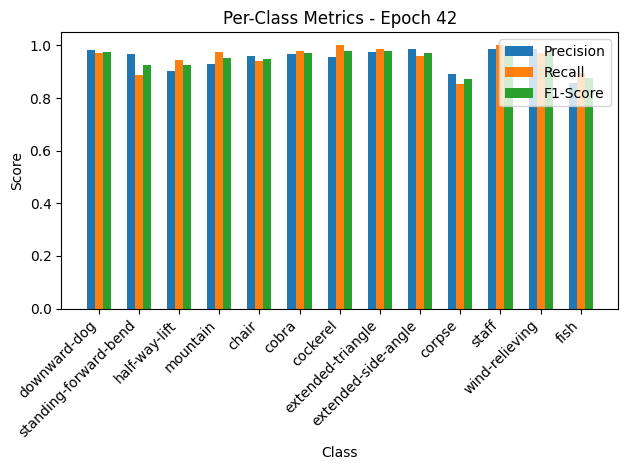

Validation: 100%|██████████| 10/10 [00:00<00:00, 171.54it/s, loss=0.173, accuracy=94.5]


Per-Class Metrics for Epoch 42:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.89, F1-Score=0.93
half-way-lift: Precision=0.90, Recall=0.95, F1-Score=0.93
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.96, Recall=0.94, F1-Score=0.95
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-side-angle: Precision=0.99, Recall=0.96, F1-Score=0.97
corpse: Precision=0.89, Recall=0.85, F1-Score=0.87
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.86, Recall=0.90, F1-Score=0.88


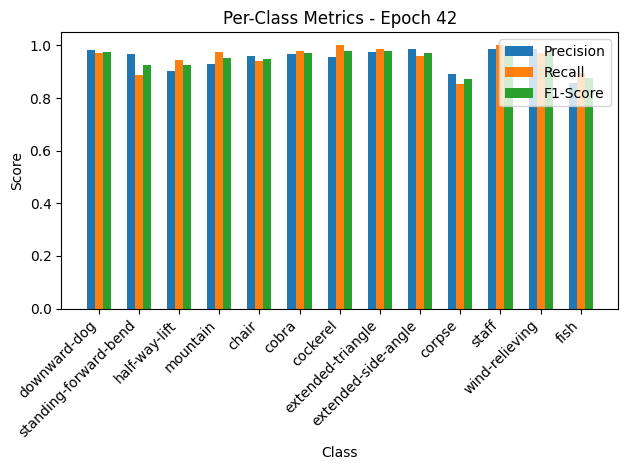


Epoch 43/50 Summary:
Train Loss: 0.1694 | Train Acc: 95.03% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.1897 | Val Acc: 94.52% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96
/content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/best_model_fold_4.pth
Checkpoint saved at epoch 43
New best model saved! Validation Loss: 0.1897

Epoch 44/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:02<00:00, 40.05it/s, loss=0.159, accuracy=95.3]


Per-Class Metrics for Epoch 43:
downward-dog: Precision=0.98, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.94, Recall=0.91, F1-Score=0.92
half-way-lift: Precision=0.92, Recall=0.94, F1-Score=0.93
mountain: Precision=0.94, Recall=0.98, F1-Score=0.96
chair: Precision=0.97, Recall=0.95, F1-Score=0.96
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.96, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.97, Recall=0.96, F1-Score=0.97
corpse: Precision=0.92, Recall=0.87, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.87, Recall=0.91, F1-Score=0.89


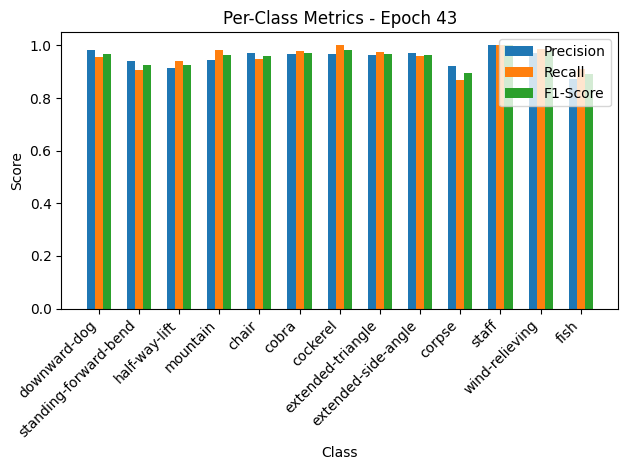

Validation: 100%|██████████| 10/10 [00:00<00:00, 183.64it/s, loss=0.184, accuracy=93.2]


Per-Class Metrics for Epoch 43:
downward-dog: Precision=0.98, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.94, Recall=0.91, F1-Score=0.92
half-way-lift: Precision=0.92, Recall=0.94, F1-Score=0.93
mountain: Precision=0.94, Recall=0.98, F1-Score=0.96
chair: Precision=0.97, Recall=0.95, F1-Score=0.96
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.96, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.97, Recall=0.96, F1-Score=0.97
corpse: Precision=0.92, Recall=0.87, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.87, Recall=0.91, F1-Score=0.89


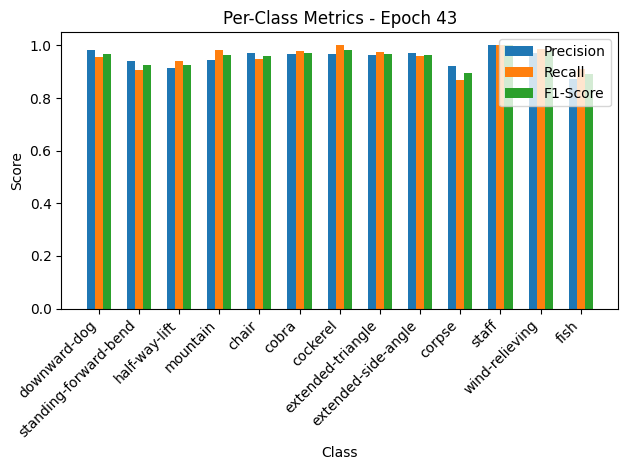


Epoch 44/50 Summary:
Train Loss: 0.1593 | Train Acc: 95.26% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.2022 | Val Acc: 93.15% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 45/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:01<00:00, 42.36it/s, loss=0.151, accuracy=96]


Per-Class Metrics for Epoch 44:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.92, F1-Score=0.94
half-way-lift: Precision=0.93, Recall=0.94, F1-Score=0.93
mountain: Precision=0.95, Recall=0.98, F1-Score=0.97
chair: Precision=0.93, Recall=0.96, F1-Score=0.95
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.97, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.95, F1-Score=0.95
corpse: Precision=0.94, Recall=0.88, F1-Score=0.91
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.90, Recall=0.94, F1-Score=0.92


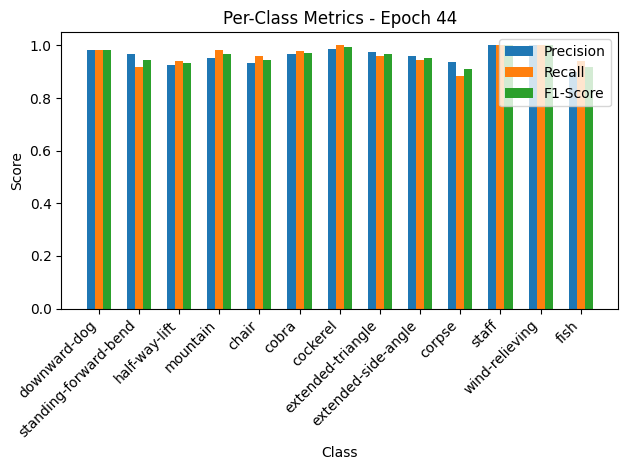

Validation: 100%|██████████| 10/10 [00:00<00:00, 170.98it/s, loss=0.182, accuracy=94.5]


Per-Class Metrics for Epoch 44:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.92, F1-Score=0.94
half-way-lift: Precision=0.93, Recall=0.94, F1-Score=0.93
mountain: Precision=0.95, Recall=0.98, F1-Score=0.97
chair: Precision=0.93, Recall=0.96, F1-Score=0.95
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.97, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.95, F1-Score=0.95
corpse: Precision=0.94, Recall=0.88, F1-Score=0.91
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.90, Recall=0.94, F1-Score=0.92


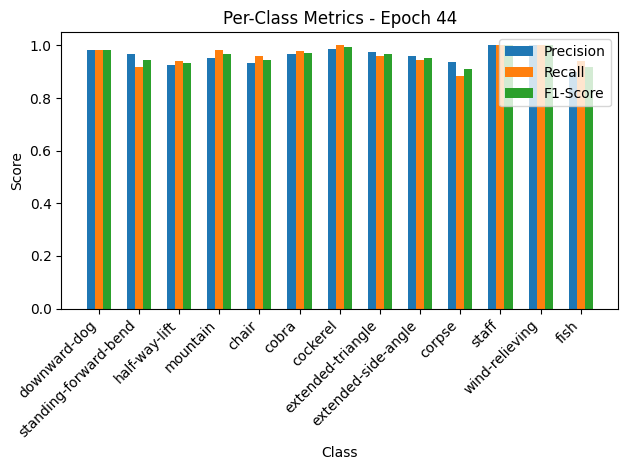


Epoch 45/50 Summary:
Train Loss: 0.1518 | Train Acc: 96.03% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.1999 | Val Acc: 94.52% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 46/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:02<00:00, 37.98it/s, loss=0.167, accuracy=95]


Per-Class Metrics for Epoch 45:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.96, Recall=0.89, F1-Score=0.92
half-way-lift: Precision=0.91, Recall=0.94, F1-Score=0.92
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.96, Recall=0.95, F1-Score=0.96
cobra: Precision=0.97, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.89, Recall=0.82, F1-Score=0.85
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.83, Recall=0.90, F1-Score=0.86


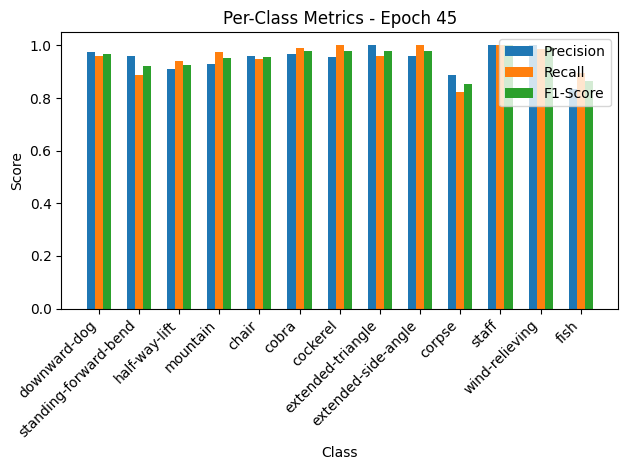

Validation: 100%|██████████| 10/10 [00:00<00:00, 141.18it/s, loss=0.182, accuracy=93.8]


Per-Class Metrics for Epoch 45:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.96, Recall=0.89, F1-Score=0.92
half-way-lift: Precision=0.91, Recall=0.94, F1-Score=0.92
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.96, Recall=0.95, F1-Score=0.96
cobra: Precision=0.97, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.89, Recall=0.82, F1-Score=0.85
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.83, Recall=0.90, F1-Score=0.86


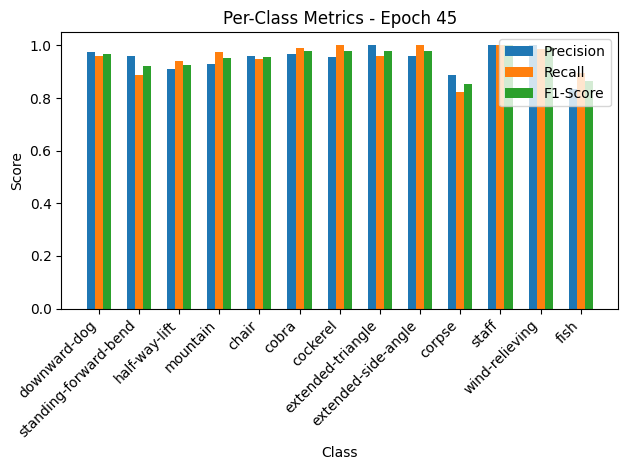


Epoch 46/50 Summary:
Train Loss: 0.1670 | Train Acc: 94.96% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.1994 | Val Acc: 93.84% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.95

Epoch 47/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:02<00:00, 37.11it/s, loss=0.162, accuracy=95.3]


Per-Class Metrics for Epoch 46:
downward-dog: Precision=0.99, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.94, Recall=0.91, F1-Score=0.93
half-way-lift: Precision=0.92, Recall=0.94, F1-Score=0.93
mountain: Precision=0.94, Recall=0.97, F1-Score=0.96
chair: Precision=0.96, Recall=0.94, F1-Score=0.95
cobra: Precision=0.98, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.97, Recall=0.97, F1-Score=0.97
corpse: Precision=0.91, Recall=0.87, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.97, Recall=1.00, F1-Score=0.99
fish: Precision=0.87, Recall=0.90, F1-Score=0.88


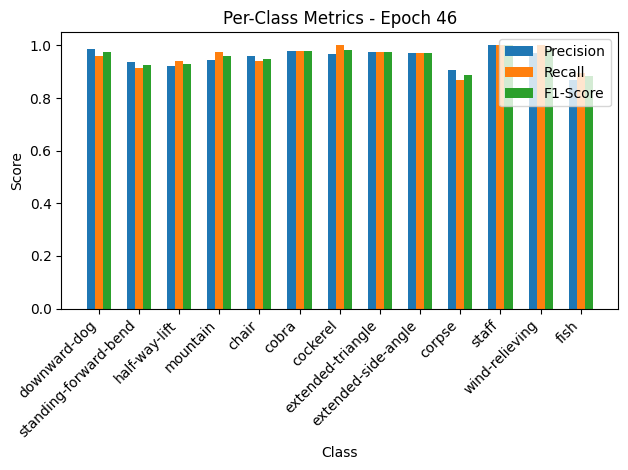

Validation: 100%|██████████| 10/10 [00:00<00:00, 96.01it/s, loss=0.182, accuracy=93.8]


Per-Class Metrics for Epoch 46:
downward-dog: Precision=0.99, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.94, Recall=0.91, F1-Score=0.93
half-way-lift: Precision=0.92, Recall=0.94, F1-Score=0.93
mountain: Precision=0.94, Recall=0.97, F1-Score=0.96
chair: Precision=0.96, Recall=0.94, F1-Score=0.95
cobra: Precision=0.98, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.97, Recall=0.97, F1-Score=0.97
corpse: Precision=0.91, Recall=0.87, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.97, Recall=1.00, F1-Score=0.99
fish: Precision=0.87, Recall=0.90, F1-Score=0.88


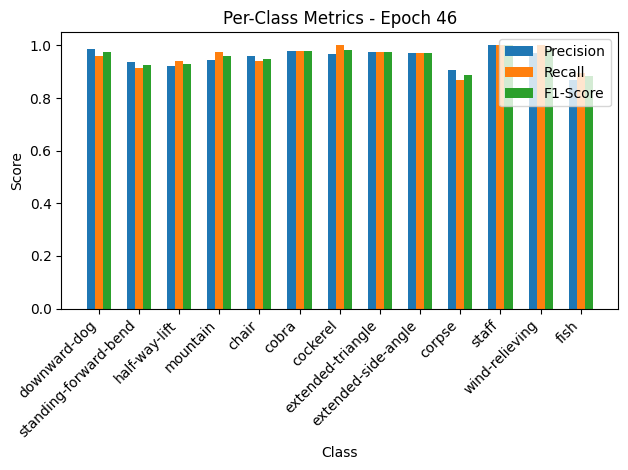


Epoch 47/50 Summary:
Train Loss: 0.1628 | Train Acc: 95.34% | Train Precision: 0.95 | Train Recall: 0.96 | Train F1: 0.95
Val Loss: 0.1994 | Val Acc: 93.84% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 48/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:02<00:00, 37.92it/s, loss=0.161, accuracy=95.3]


Per-Class Metrics for Epoch 47:
downward-dog: Precision=0.99, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.97, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.89, Recall=0.96, F1-Score=0.93
mountain: Precision=0.94, Recall=0.96, F1-Score=0.95
chair: Precision=0.96, Recall=0.96, F1-Score=0.96
cobra: Precision=0.97, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.84, Recall=0.85, F1-Score=0.85
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.97, F1-Score=0.99
fish: Precision=0.85, Recall=0.87, F1-Score=0.86


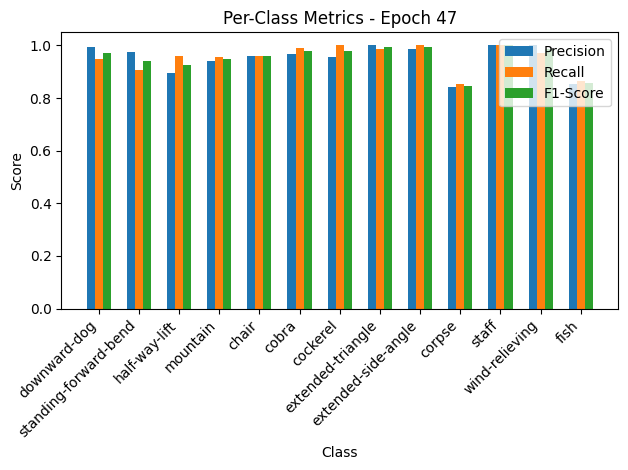

Validation: 100%|██████████| 10/10 [00:00<00:00, 178.23it/s, loss=0.181, accuracy=94.5]


Per-Class Metrics for Epoch 47:
downward-dog: Precision=0.99, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.97, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.89, Recall=0.96, F1-Score=0.93
mountain: Precision=0.94, Recall=0.96, F1-Score=0.95
chair: Precision=0.96, Recall=0.96, F1-Score=0.96
cobra: Precision=0.97, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=1.00, F1-Score=0.99
corpse: Precision=0.84, Recall=0.85, F1-Score=0.85
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.97, F1-Score=0.99
fish: Precision=0.85, Recall=0.87, F1-Score=0.86


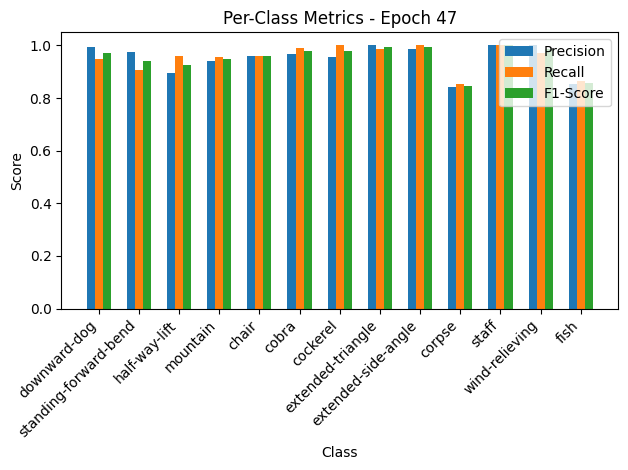


Epoch 48/50 Summary:
Train Loss: 0.1615 | Train Acc: 95.26% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.1986 | Val Acc: 94.52% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 49/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:02<00:00, 40.91it/s, loss=0.166, accuracy=95.4]


Per-Class Metrics for Epoch 48:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.94, Recall=0.91, F1-Score=0.93
half-way-lift: Precision=0.90, Recall=0.91, F1-Score=0.91
mountain: Precision=0.94, Recall=0.97, F1-Score=0.96
chair: Precision=0.97, Recall=0.95, F1-Score=0.96
cobra: Precision=0.97, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.92, Recall=0.87, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.87, Recall=0.93, F1-Score=0.90


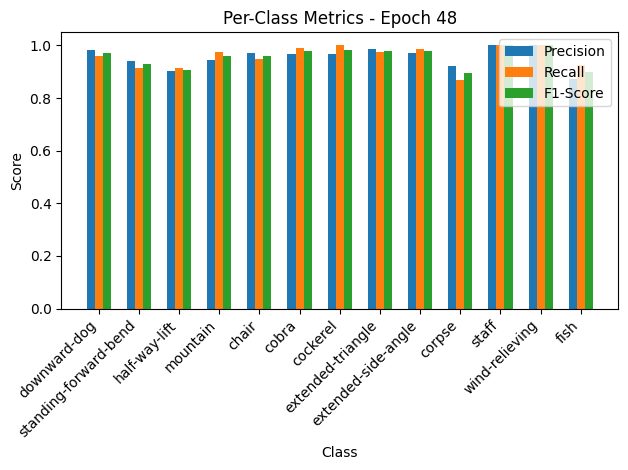

Validation: 100%|██████████| 10/10 [00:00<00:00, 155.06it/s, loss=0.18, accuracy=93.8]


Per-Class Metrics for Epoch 48:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.94, Recall=0.91, F1-Score=0.93
half-way-lift: Precision=0.90, Recall=0.91, F1-Score=0.91
mountain: Precision=0.94, Recall=0.97, F1-Score=0.96
chair: Precision=0.97, Recall=0.95, F1-Score=0.96
cobra: Precision=0.97, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.92, Recall=0.87, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.87, Recall=0.93, F1-Score=0.90


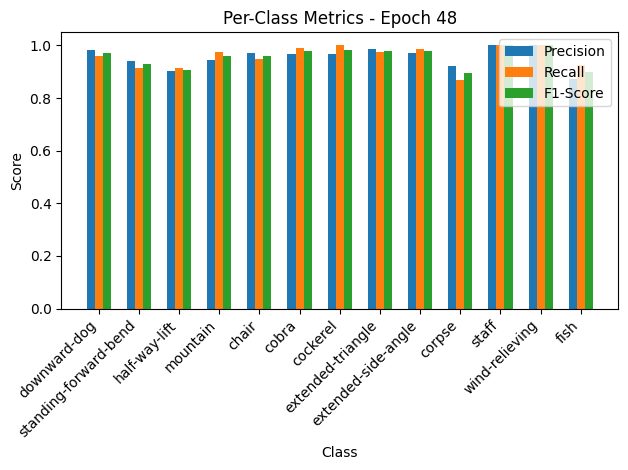


Epoch 49/50 Summary:
Train Loss: 0.1659 | Train Acc: 95.42% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.1971 | Val Acc: 93.84% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.95

Epoch 50/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:01<00:00, 41.39it/s, loss=0.163, accuracy=95.3]


Per-Class Metrics for Epoch 49:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.95, Recall=0.91, F1-Score=0.93
half-way-lift: Precision=0.91, Recall=0.95, F1-Score=0.93
mountain: Precision=0.94, Recall=0.97, F1-Score=0.96
chair: Precision=0.97, Recall=0.95, F1-Score=0.96
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.97, Recall=0.97, F1-Score=0.97
corpse: Precision=0.88, Recall=0.87, F1-Score=0.87
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.87, Recall=0.87, F1-Score=0.87


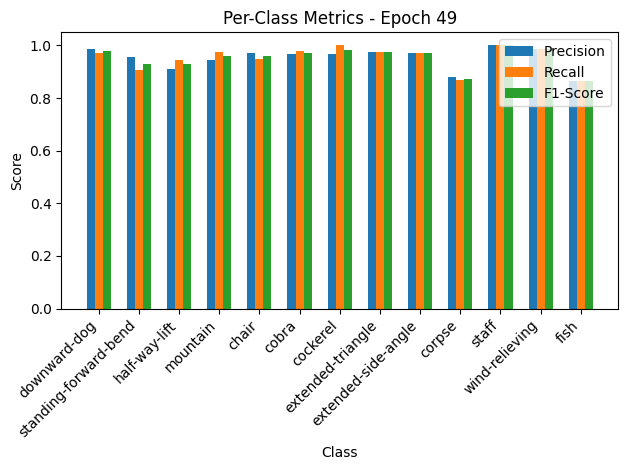

Validation: 100%|██████████| 10/10 [00:00<00:00, 124.85it/s, loss=0.181, accuracy=93.2]


Per-Class Metrics for Epoch 49:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.95, Recall=0.91, F1-Score=0.93
half-way-lift: Precision=0.91, Recall=0.95, F1-Score=0.93
mountain: Precision=0.94, Recall=0.97, F1-Score=0.96
chair: Precision=0.97, Recall=0.95, F1-Score=0.96
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.97, Recall=0.97, F1-Score=0.97
corpse: Precision=0.88, Recall=0.87, F1-Score=0.87
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.87, Recall=0.87, F1-Score=0.87


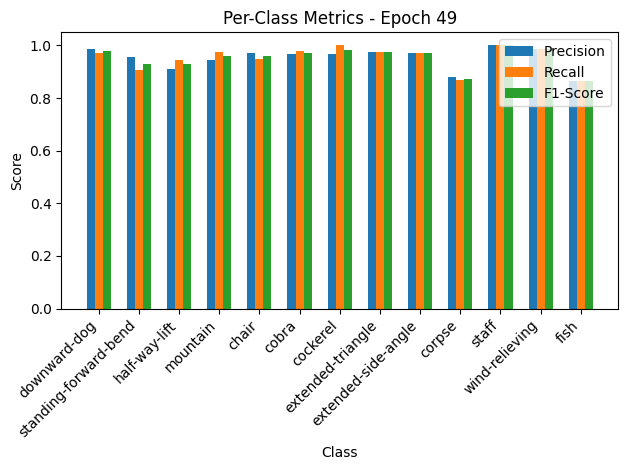


Epoch 50/50 Summary:
Train Loss: 0.1632 | Train Acc: 95.34% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.1986 | Val Acc: 93.15% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95


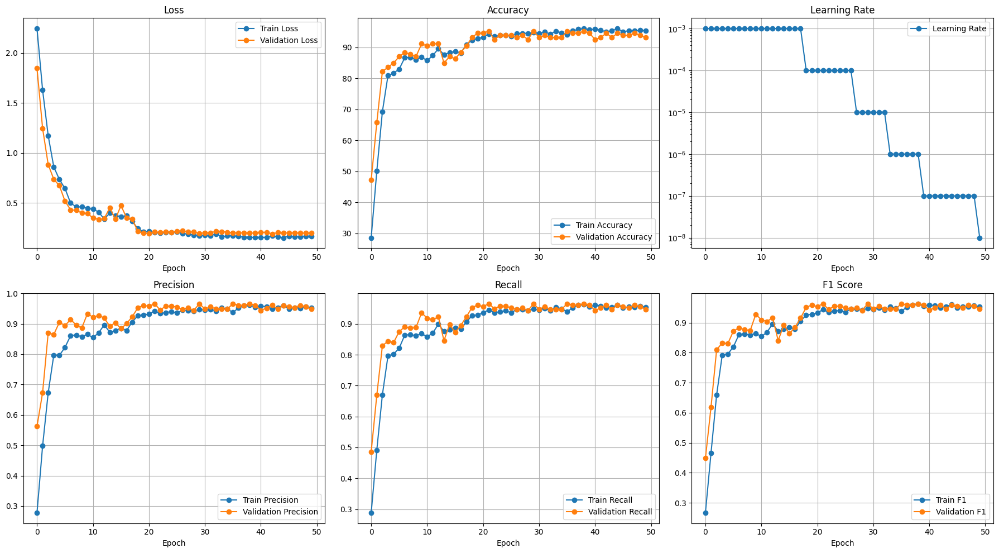

Testing: 100%|██████████| 23/23 [00:00<00:00, 128.18it/s]


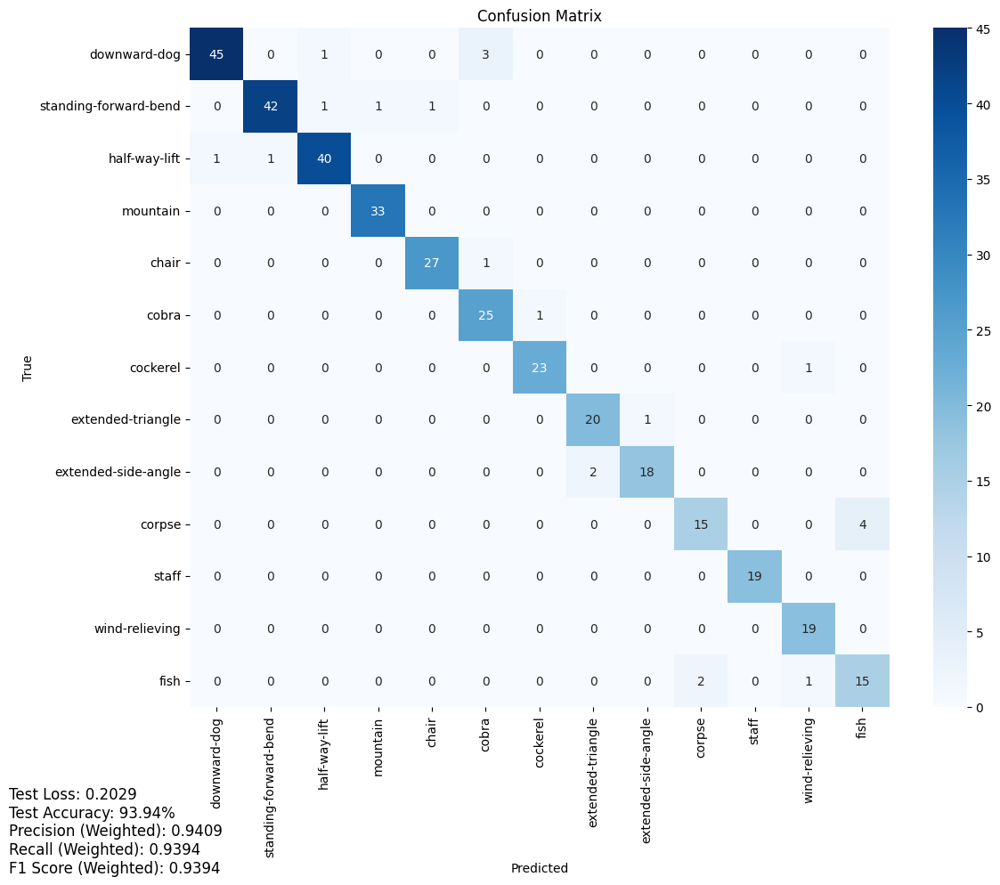

Test Loss: 0.2029
Test Accuracy: 93.94%
Precision (Weighted): 0.9409
Recall (Weighted): 0.9394
F1 Score (Weighted): 0.9394


Testing: 100%|██████████| 23/23 [00:00<00:00, 156.20it/s]


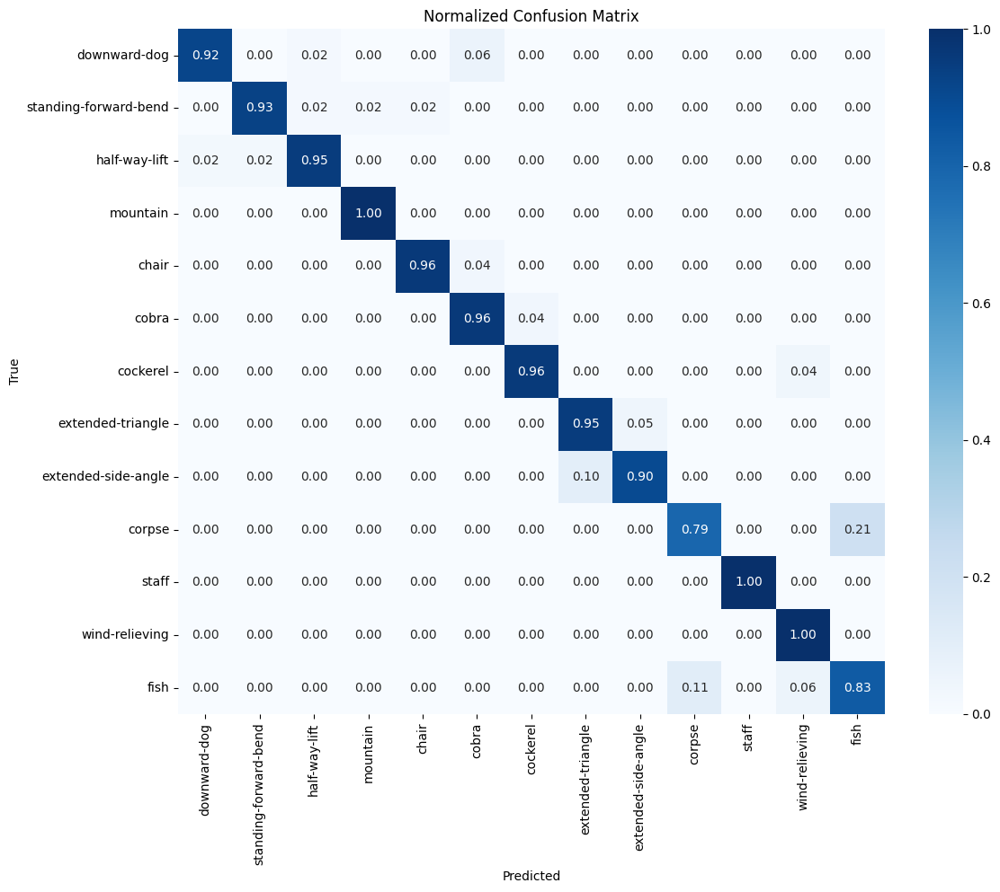

Test Loss: 0.2029
Test Accuracy: 93.94%
Precision (Macro): 0.9304
Recall (Macro): 0.9356
F1 Score (Macro): 0.9322
Saved checkpoint for fold 5


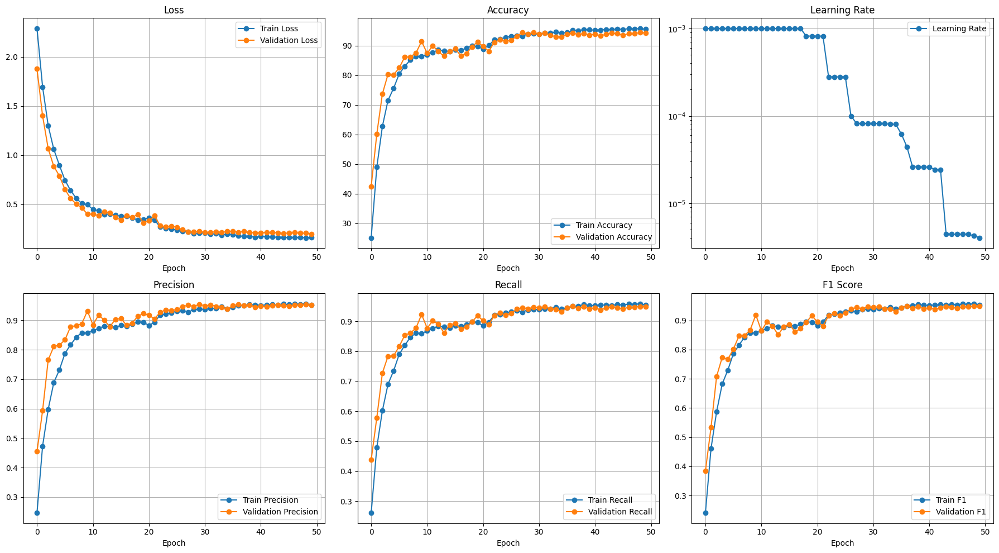

Saved test metrics plot to /content/gdrive/MyDrive/yoga_proj/NEW_TRAIN/HC_MAIN_1D_CNN_LSTM_2025-02-27_HC64_LR0.001_WD0.005_VS0.1/test_metrics_average.png


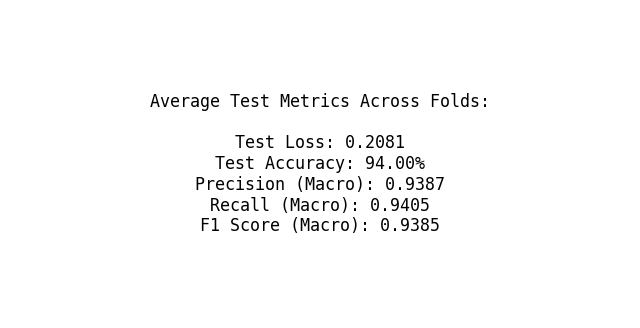

Training completed.
             loss   accuracy  precision    recall        f1
Fold 1   0.155819  95.879121   0.955238  0.956401  0.954634
Fold 2   0.216212  94.230769   0.945631  0.943457  0.943534
Fold 3   0.215075  93.406593   0.934436  0.936167  0.934560
Fold 4   0.250605  92.561983   0.927702  0.930774  0.927467
Fold 5   0.202941  93.939394   0.930439  0.935648  0.932195
Average  0.208131  94.003572   0.938689  0.940489  0.938478


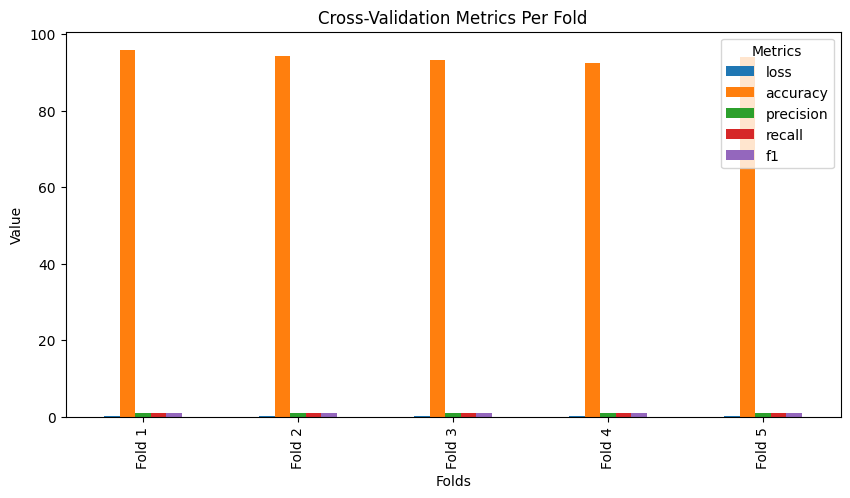

In [69]:
if __name__ == "__main__":
    main()

In [70]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
import seaborn as sns
import torch
import numpy as np
import os
from tqdm import tqdm
import csv

def find_sus(model, test_loader, criterion, class_names, spath=SAVE_PATH, fsave='confusion_matrix_all.png'):
    """
    Evaluate model on test set

    Args:
        model: PyTorch model
        test_loader: DataLoader for test data
        criterion: Loss function
        class_names: List of class names
        save_path: Directory to save the plot
        fsave: Filename for confusion matrix plot
    """
    csave = os.path.join(spath, fsave)
    sussave = os.path.join(spath, 'sus.csv')
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model = model.to(device)
    model.eval()

    test_loss = 0.0
    test_correct = 0
    test_total = 0
    all_predictions = []
    all_labels = []
    misclassified_data = []

    # Create progress bar
    test_loader_tqdm = tqdm(test_loader, desc="Testing")

    with torch.no_grad():
        for batch_idx, (inputs, labels) in enumerate(test_loader_tqdm):
            inputs = inputs.to(device)
            labels = labels.to(device)
            # Forward pass
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            test_loss += loss.item() * inputs.size(0)

            # Get predictions
            _, predicted = torch.max(outputs, 1)
            # Calculate accuracy
            test_correct += (predicted == labels).sum().item()
            test_total += labels.size(0)

            # Store predictions and labels for confusion matrix
            all_predictions.extend(predicted.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())

            # Check if the sample is misclassified
            misclassified_indices = (predicted != labels).nonzero(as_tuple=True)[0]
            for misclassified_idx in misclassified_indices:
                global_idx = batch_idx * inputs.size(0) + misclassified_idx.item()
                sequence_id = test_loader.dataset.idx_to_seq[global_idx]
                correct_label = class_names[labels[misclassified_idx].item()]
                prediction = class_names[predicted[misclassified_idx].item()]
                misclassified_data.append([sequence_id, correct_label, prediction])

    # Calculate metrics
    test_loss = test_loss / len(test_loader.dataset)
    accuracy = 100 * test_correct / test_total

    # Create confusion matrix
    cm = confusion_matrix(all_labels, all_predictions)

    # Plot confusion matrix
    plt.figure(figsize=(10, 8))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=pose_list, yticklabels=pose_list)
    plt.title('Confusion Matrix')
    plt.xlabel('Predicted')
    plt.ylabel('True')

    # Save the plot
    plt.savefig(csave)
    plt.show()
    plt.close()

    # Save misclassified data to CSV
    with open(sussave, mode='w', newline='') as file:
        writer = csv.writer(file)
        writer.writerow(['sequence_id', 'correct_label', 'prediction'])
        writer.writerows(misclassified_data)

    print(f'Test Loss: {test_loss:.4f}')
    print(f'Test Accuracy: {accuracy:.2f}%')

    return test_loss, accuracy

In [71]:
dataset = Yoga3DDataset(read_meta_data())
label_to_pose = {v:k for k,v in dataset.pose_to_label.items()}

model = STSAE_GCN(3, HIDDEN_CHANNELS, NUM_CLASSES, 20, NUM_BLOCKS)
# criterion = nn.CrossEntropyLoss()
all_labels = [dataset[i][1] for i in range(len(dataset))]
criterion = create_weighted_criterion(
        all_labels,
        num_classes= NUM_CLASSES,
        strategy='inverse'  # Try different strategies
    )
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

checkpoint_path = os.path.join(SAVE_PATH, 'best_model.pth')
# Plot the training curves
if checkpoint_path and os.path.exists(checkpoint_path):
        model, optimizer, start_epoch, history = load_checkpoint(
            model, optimizer, checkpoint_path
        )
        print(f"Resuming training from epoch {start_epoch}")
loader = DataLoader(dataset, batch_size=BATCH_SIZE, shuffle=False)
# plot_training_curves(history)
find_sus(model, loader, criterion, label_to_pose)

NameError: name 'STSAE_GCN' is not defined

In [ ]:
dataset = Yoga3DDataset(read_meta_data())
label_to_pose = {v:k for k,v in dataset.pose_to_label.items()}

model = STSAE_GCN(3, HIDDEN_CHANNELS, NUM_CLASSES, 20, NUM_BLOCKS)
# criterion = nn.CrossEntropyLoss()
all_labels = [dataset[i][1] for i in range(len(dataset))]
dataset, train_dataset, test_dataset = prepare_dataset()
criterion = create_weighted_criterion(
        all_labels,
        num_classes= NUM_CLASSES,
        strategy='effective_samples'  # Try different strategies
    )
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

checkpoint_path = os.path.join(SAVE_PATH, 'best_model.pth')
# Plot the training curves
if checkpoint_path and os.path.exists(checkpoint_path):
        model, optimizer, start_epoch, history = load_checkpoint(
            model, optimizer, checkpoint_path
        )
        print(f"Resuming training from epoch {start_epoch}")
loader = DataLoader(dataset, batch_size=BATCH_SIZE, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False)
evaluate_model(model, test_loader, criterion, pose_list, fsave= 'outward_confusion_matrix.png')
evaluate_model_normalized(model, test_loader, criterion, pose_list, fsave= 'outward_normalized_confusion_matrix.png')